In [21]:
from keras import layers
from keras import models

In [22]:
#load the files
train_dir="D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\imgs\\train\\"
test_dir="D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\imgs\\test\\"
validation_dir = "D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\imgs\\validation\\"

In [23]:
#Using ImageDataGenerator to read images from directories
from keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator(rescale=1./255) #Rescales all images by 1/255
test_datagen = ImageDataGenerator(rescale=1./255) #Rescales all images by 1/255
train_generator = train_datagen.flow_from_directory (train_dir,target_size=(150, 150),batch_size=20,class_mode='categorical') #resizes all images to 150*150
validation_generator = test_datagen.flow_from_directory (validation_dir,target_size=(150, 150),batch_size=20, class_mode='categorical')

Found 19519 images belonging to 10 classes.
Found 2905 images belonging to 10 classes.


In [4]:
#the network architecture
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu',input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(10, activation='softmax'))

In [5]:
#compilation
from keras import optimizers
model.compile(loss='categorical_crossentropy',optimizer=optimizers.RMSprop(lr=1e-4),metrics=['accuracy'])

In [6]:
#fit the model
history = model.fit_generator(
train_generator,
steps_per_epoch=100,
epochs=8,
validation_data=validation_generator,
validation_steps=50)

Epoch 1/8
100/100 [==============================] - 419s 4s/step - loss: 2.2342 - acc: 0.1850 - val_loss: 2.0890 - val_acc: 0.2754
Epoch 2/8
100/100 [==============================] - 386s 4s/step - loss: 1.7294 - acc: 0.4150 - val_loss: 1.3630 - val_acc: 0.5367
Epoch 3/8
100/100 [==============================] - 384s 4s/step - loss: 1.1687 - acc: 0.6160 - val_loss: 0.9450 - val_acc: 0.7260
Epoch 4/8
100/100 [==============================] - 409s 4s/step - loss: 0.8642 - acc: 0.7290 - val_loss: 0.6616 - val_acc: 0.8038
Epoch 5/8
100/100 [==============================] - 2269s 23s/step - loss: 0.5817 - acc: 0.8295 - val_loss: 0.4897 - val_acc: 0.8561
Epoch 6/8
100/100 [==============================] - 367s 4s/step - loss: 0.4494 - acc: 0.8604 - val_loss: 0.3796 - val_acc: 0.8905
Epoch 7/8
100/100 [==============================] - 372s 4s/step - loss: 0.3540 - acc: 0.8885 - val_loss: 0.2586 - val_acc: 0.9253
Epoch 8/8
100/100 [==============================] - 364s 4s/step - loss: 

In [7]:
#save the model
model.save('D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\2ndModel.h5')

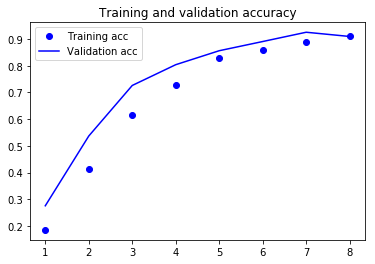

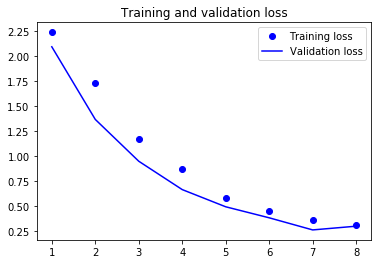

In [9]:
#display curves of loss and accuracy during training
import matplotlib.pyplot as plt
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)
plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show();

In [10]:
#Defining a new convnet that includes dropout

In [11]:
#the network architecture
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu',input_shape=(150, 150, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(10, activation='softmax'))

In [13]:
#compilation
from keras import optimizers
model.compile(loss='categorical_crossentropy',optimizer=optimizers.RMSprop(lr=1e-4),metrics=['accuracy'])

In [14]:
#Training the convnet using data-augmentation generators

In [15]:
train_datagen = ImageDataGenerator(
rescale=1./255,
rotation_range=40,
width_shift_range=0.2,
height_shift_range=0.2,
shear_range=0.2,
zoom_range=0.2,
horizontal_flip=True,)

In [16]:
test_datagen = ImageDataGenerator(rescale=1./255)#validation data should not be augmented

In [17]:
train_generator = train_datagen.flow_from_directory(
                    train_dir,
                    target_size=(150, 150),
                    batch_size=32,
                    class_mode='categorical')

Found 19519 images belonging to 10 classes.


In [18]:
validation_generator = test_datagen.flow_from_directory(
                        validation_dir,
                        target_size=(150, 150),
                        batch_size=32,
                        class_mode='categorical')

Found 2905 images belonging to 10 classes.


In [20]:
#fit the model
history = model.fit_generator(
            train_generator,
            steps_per_epoch=100,
            epochs=100,
            validation_data=validation_generator,
            validation_steps=50)

Epoch 1/100
100/100 [==============================] - 496s 5s/step - loss: 2.2705 - acc: 0.1422 - val_loss: 2.2348 - val_acc: 0.2059
Epoch 2/100
100/100 [==============================] - 508s 5s/step - loss: 2.2453 - acc: 0.1663 - val_loss: 2.2062 - val_acc: 0.1904
Epoch 3/100
100/100 [==============================] - 516s 5s/step - loss: 2.2116 - acc: 0.1919 - val_loss: 2.1078 - val_acc: 0.2503
Epoch 4/100
100/100 [==============================] - 514s 5s/step - loss: 2.1760 - acc: 0.1972 - val_loss: 2.0689 - val_acc: 0.2682
Epoch 5/100
100/100 [==============================] - 515s 5s/step - loss: 2.1535 - acc: 0.2128 - val_loss: 2.0042 - val_acc: 0.2826
Epoch 6/100
100/100 [==============================] - 517s 5s/step - loss: 2.1252 - acc: 0.2263 - val_loss: 1.9683 - val_acc: 0.3057
Epoch 7/100
100/100 [==============================] - 513s 5s/step - loss: 2.1157 - acc: 0.2319 - val_loss: 1.9016 - val_acc: 0.3597
Epoch 8/100
100/100 [==============================] - 518s 5s

Epoch 62/100
100/100 [==============================] - 518s 5s/step - loss: 1.3423 - acc: 0.5391 - val_loss: 0.8992 - val_acc: 0.6895
Epoch 63/100
100/100 [==============================] - 500s 5s/step - loss: 1.3610 - acc: 0.5261 - val_loss: 0.9250 - val_acc: 0.6843
Epoch 64/100
100/100 [==============================] - 510s 5s/step - loss: 1.3686 - acc: 0.5381 - val_loss: 0.9716 - val_acc: 0.6671
Epoch 65/100
100/100 [==============================] - 515s 5s/step - loss: 1.3371 - acc: 0.5419 - val_loss: 0.8080 - val_acc: 0.7215
Epoch 66/100
100/100 [==============================] - 517s 5s/step - loss: 1.3351 - acc: 0.5341 - val_loss: 1.0498 - val_acc: 0.6244
Epoch 67/100
100/100 [==============================] - 518s 5s/step - loss: 1.3429 - acc: 0.5441 - val_loss: 0.7830 - val_acc: 0.7408
Epoch 68/100
100/100 [==============================] - 517s 5s/step - loss: 1.3260 - acc: 0.5428 - val_loss: 0.8726 - val_acc: 0.7201
Epoch 69/100
100/100 [==============================] -

In [21]:
model.save('D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\3rdModel.h5')

In [4]:
#use pretrained model technique

In [5]:
#FAST FEATURE EXTRACTION WITHOUT DATA AUGMENTATION

In [9]:
#Extracting features using the pretrained convolutional base

In [106]:
import os
import numpy as np
from keras.preprocessing.image import ImageDataGenerator

In [107]:
#instantiate VGG16 convoutional base

In [108]:
from keras.applications import VGG16
conv_base = VGG16(weights='imagenet',include_top=False,input_shape=(150, 150, 3))

In [109]:
conv_base.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         (None, 150, 150, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0         
__________

In [110]:
datagen = ImageDataGenerator(rescale=1./255)
batch_size = 10

In [111]:
#We will use the ImageDataGenerator class to load the images and flow_from_directory function to generate batches of images and labels.

In [114]:
def extract_features(directory, sample_count):
    features = np.zeros(shape=(sample_count, 4, 4, 512))
    #print("features:")
    #print(features)
    labels = np.zeros(shape=(sample_count,10))
    #print("labels:")
    #print(labels)
    generator = datagen.flow_from_directory(
                directory,
                target_size=(150, 150),
                batch_size=batch_size,
                class_mode='categorical')
    i = 0
    for inputs_batch, labels_batch in generator:
        features_batch = conv_base.predict(inputs_batch)
        print("features_batch")
        print(features_batch)
        features[i * batch_size : (i + 1) * batch_size] = features_batch
        labels[i * batch_size : (i + 1) * batch_size] = labels_batch
        i += 1
        if i * batch_size >= sample_count:
            break
    return features, labels

In [115]:
train_features, train_labels = extract_features(train_dir, 19519)

Found 19519 images belonging to 10 classes.
features_batch
[[[[1.4922239  0.         0.         ... 0.         0.7273556
    0.        ]
   [1.5032781  0.         0.         ... 0.         0.33235887
    0.        ]
   [1.5076451  0.         0.         ... 0.         0.63222474
    0.        ]
   [1.0213366  0.         0.         ... 0.         0.70741075
    0.        ]]

  [[2.0000548  0.         0.2345585  ... 0.         0.5236092
    0.        ]
   [1.430781   0.         0.50504875 ... 0.         0.5200769
    0.        ]
   [1.749495   0.         1.0054029  ... 0.         0.27328336
    0.        ]
   [2.4002004  0.         0.15098643 ... 0.         0.
    0.        ]]

  [[2.159451   0.         0.08768958 ... 0.         0.58692974
    0.        ]
   [1.6839508  0.         0.8862696  ... 0.13875324 0.786427
    0.        ]
   [1.6669133  0.         1.3362277  ... 0.01015861 0.80222476
    0.        ]
   [2.5781107  0.         0.3663565  ... 0.         0.4423099
    0.        ]]

 

features_batch
[[[[2.59087181e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.35550106e-01 0.00000000e+00]
   [2.19127107e+00 0.00000000e+00 6.36082828e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.46926278e-01 ... 0.00000000e+00
    1.79838330e-01 0.00000000e+00]
   [3.25349271e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.62179887e-01 0.00000000e+00]]

  [[3.59592175e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.99470699e-01 0.00000000e+00]
   [3.00861049e+00 0.00000000e+00 1.27850032e+00 ... 0.00000000e+00
    5.91320992e-02 0.00000000e+00]
   [2.31547430e-01 0.00000000e+00 1.22454309e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [6.63440704e-01 0.00000000e+00 2.10178405e-01 ... 0.00000000e+00
    9.86383557e-02 0.00000000e+00]]

  [[2.97288728e+00 0.00000000e+00 2.26095229e-01 ... 0.00000000e+00
    8.12600374e-01 0.00000000e+00]
   [2.34673023e+00 0.00000000e+00 1.04326868e+00 ... 0

features_batch
[[[[6.88467085e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.02835631e+00 0.00000000e+00]
   [4.63777274e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.12792850e-01 0.00000000e+00]
   [9.63700294e-01 0.00000000e+00 1.83866352e-01 ... 0.00000000e+00
    6.58781648e-01 0.00000000e+00]
   [7.83660471e-01 0.00000000e+00 6.14347279e-01 ... 0.00000000e+00
    8.39729726e-01 0.00000000e+00]]

  [[1.47969162e+00 0.00000000e+00 6.03962660e-01 ... 0.00000000e+00
    8.39630902e-01 0.00000000e+00]
   [1.06619811e+00 0.00000000e+00 7.61126161e-01 ... 0.00000000e+00
    3.76928180e-01 0.00000000e+00]
   [1.14958954e+00 0.00000000e+00 4.65504050e-01 ... 0.00000000e+00
    2.49605149e-01 0.00000000e+00]
   [1.10185540e+00 0.00000000e+00 5.06038785e-01 ... 0.00000000e+00
    1.39357001e-01 0.00000000e+00]]

  [[1.63260353e+00 0.00000000e+00 5.50748646e-01 ... 0.00000000e+00
    1.03756392e+00 0.00000000e+00]
   [1.42647111e+00 0.00000000e+00 6.63481832e-01 ... 0

features_batch
[[[[2.0333686  0.         0.06261235 ... 0.         0.63787353
    0.        ]
   [1.8612447  0.         0.7267767  ... 0.         0.2639294
    0.        ]
   [0.60048485 0.         0.1538826  ... 0.         0.4909647
    0.        ]
   [0.19624501 0.         0.         ... 0.         0.36063084
    0.        ]]

  [[2.7472892  0.         0.7002112  ... 0.         0.7025914
    0.        ]
   [2.1937203  0.         2.0226212  ... 0.00822432 1.1837786
    0.        ]
   [0.6762626  0.         2.260528   ... 0.         0.9848251
    0.        ]
   [0.28009775 0.         1.3495662  ... 0.         0.28006306
    0.        ]]

  [[2.0858498  0.         0.72282785 ... 0.         0.92994237
    0.        ]
   [1.182843   0.         1.8117805  ... 0.070627   1.6887026
    0.        ]
   [1.0875994  0.         2.6082163  ... 0.         1.3882586
    0.        ]
   [1.3686019  0.         1.9722235  ... 0.         0.933102
    0.        ]]

  [[1.7867912  0.         0.06966481 ...

features_batch
[[[[0.36083084 0.         0.         ... 0.         0.7863514
    0.        ]
   [0.34484243 0.         0.21680975 ... 0.         0.35020623
    0.        ]
   [0.4363391  0.         0.         ... 0.         0.29048958
    0.        ]
   [0.78270185 0.         0.57756263 ... 0.         0.6630178
    0.        ]]

  [[0.884203   0.         1.280379   ... 0.         0.7400372
    0.        ]
   [0.2561152  0.         1.503701   ... 0.23028654 0.7854715
    0.        ]
   [0.5692237  0.         0.66790676 ... 0.34040162 0.51127815
    0.        ]
   [1.5191692  0.         0.86077607 ... 0.         0.43616396
    0.        ]]

  [[1.2130816  0.         0.9543607  ... 0.         0.862242
    0.        ]
   [0.4877435  0.         1.6738124  ... 0.64545673 1.2814542
    0.        ]
   [0.63583905 0.         1.9124181  ... 0.6382593  0.5357283
    0.        ]
   [1.1793098  0.         2.0295863  ... 0.2507588  0.35854518
    0.        ]]

  [[1.2835487  0.         0.7789822  ..

features_batch
[[[[0.3703714  0.         0.37770796 ... 0.         0.79250485
    0.        ]
   [0.53609884 0.         0.34361148 ... 0.         0.42132837
    0.        ]
   [0.90867186 0.         0.5399943  ... 0.         0.27516353
    0.        ]
   [1.1658666  0.         0.7984689  ... 0.         0.65380806
    0.        ]]

  [[0.9165524  0.         0.9180517  ... 0.         0.86792696
    0.        ]
   [0.76751786 0.         1.0243386  ... 0.         0.82245123
    0.        ]
   [1.3968319  0.         0.         ... 0.         0.28336567
    0.        ]
   [1.7068464  0.         0.31742698 ... 0.         0.
    0.        ]]

  [[1.3832561  0.         0.85477185 ... 0.         0.7542273
    0.        ]
   [0.71396863 0.         1.1805607  ... 0.         0.72798425
    0.        ]
   [0.9104096  0.         0.6691407  ... 0.         0.53410184
    0.        ]
   [1.1106719  0.         0.0944916  ... 0.         0.3766044
    0.        ]]

  [[1.0326796  0.         0.09463143 ... 

features_batch
[[[[0.6542709  0.         0.18475306 ... 0.         0.
    0.        ]
   [0.73112035 0.         0.         ... 0.         0.31460747
    0.        ]
   [0.7930716  0.         0.         ... 0.         0.7396224
    0.        ]
   [0.9768102  0.         0.         ... 0.         1.2608196
    0.        ]]

  [[0.9044894  0.         0.828771   ... 0.         0.03698868
    0.        ]
   [0.6541542  0.         0.84018785 ... 0.         0.5188881
    0.        ]
   [0.7768799  0.         0.81739455 ... 0.         0.19126642
    0.        ]
   [0.9939521  0.         0.44244212 ... 0.         0.05926138
    0.        ]]

  [[1.7979295  0.         0.58618295 ... 0.         0.618208
    0.        ]
   [1.6639767  0.         1.1170663  ... 0.         0.9131523
    0.        ]
   [1.179528   0.         1.6196842  ... 0.         0.50367266
    0.        ]
   [1.2118577  0.         0.57830524 ... 0.         0.21034196
    0.        ]]

  [[1.2655882  0.         0.         ... 0.  

features_batch
[[[[0.33426023 0.         0.         ... 0.         0.47424254
    0.        ]
   [0.378083   0.         0.         ... 0.         0.89755046
    0.        ]
   [0.39763358 0.         0.         ... 0.         0.91791505
    0.        ]
   [0.8908473  0.         0.         ... 0.         1.1983821
    0.        ]]

  [[1.79515    0.         0.7673718  ... 0.         0.
    0.        ]
   [1.0667205  0.         0.61453974 ... 0.         0.99782926
    0.        ]
   [0.         0.         0.17018193 ... 0.         0.9508047
    0.        ]
   [0.         0.         0.         ... 0.         0.5929462
    0.        ]]

  [[1.826464   0.         1.162447   ... 0.         0.37271956
    0.        ]
   [1.3593146  0.         0.8050647  ... 0.1547418  1.2190142
    0.        ]
   [0.         0.42465407 0.22655353 ... 0.05731403 1.0910666
    0.        ]
   [0.         0.28264004 0.44923657 ... 0.         0.58846635
    0.        ]]

  [[1.7956814  0.         0.967623   ... 0. 

features_batch
[[[[2.16604805e+00 0.00000000e+00 4.43364680e-02 ... 0.00000000e+00
    6.71670914e-01 0.00000000e+00]
   [1.91625321e+00 0.00000000e+00 6.68293297e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [4.17547673e-01 0.00000000e+00 1.42449737e-02 ... 0.00000000e+00
    1.21360302e-01 0.00000000e+00]
   [8.46836090e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.15546602e-01 0.00000000e+00]]

  [[2.54748607e+00 0.00000000e+00 6.57777429e-01 ... 0.00000000e+00
    8.72736394e-01 0.00000000e+00]
   [2.72249961e+00 0.00000000e+00 1.63607860e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.75144196e+00 0.00000000e+00 1.14208531e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [7.28347301e-01 0.00000000e+00 2.45476574e-01 ... 0.00000000e+00
    2.14581281e-01 0.00000000e+00]]

  [[2.65687037e+00 0.00000000e+00 8.58443737e-01 ... 0.00000000e+00
    8.28501105e-01 0.00000000e+00]
   [2.73081398e+00 0.00000000e+00 8.90633583e-01 ... 0

features_batch
[[[[0.69176704 0.         0.         ... 0.         0.78195894
    0.        ]
   [0.74650156 0.         0.         ... 0.         0.55646527
    0.        ]
   [0.84637433 0.         0.         ... 0.         0.38305357
    0.        ]
   [0.47744    0.         0.34777546 ... 0.         0.5675243
    0.        ]]

  [[1.641647   0.         0.         ... 0.         0.8184296
    0.        ]
   [2.1343412  0.         0.         ... 0.         0.40948194
    0.        ]
   [1.878871   0.         0.         ... 0.         0.
    0.        ]
   [1.3692846  0.         0.33529043 ... 0.         0.
    0.        ]]

  [[1.613351   0.         0.62907696 ... 0.         1.0667212
    0.        ]
   [1.8961263  0.         0.85007536 ... 0.22248825 0.7503444
    0.        ]
   [1.5140259  0.         0.         ... 0.         0.74261516
    0.        ]
   [1.4446461  0.         0.         ... 0.         0.39052418
    0.        ]]

  [[0.36723444 0.         0.6760073  ... 0.25730777

features_batch
[[[[0.59615684 0.         0.         ... 0.         0.51400834
    0.        ]
   [1.353397   0.         0.         ... 0.         0.88475287
    0.        ]
   [1.4711095  0.         0.         ... 0.         1.0701988
    0.        ]
   [0.981777   0.         0.         ... 0.         1.2462201
    0.        ]]

  [[1.1365261  0.         0.46661007 ... 0.         0.15723544
    0.        ]
   [1.0975163  0.         0.53671724 ... 0.         0.6934198
    0.        ]
   [1.188703   0.         0.7191558  ... 0.         0.91981506
    0.        ]
   [0.4122978  0.         0.         ... 0.         0.6771415
    0.        ]]

  [[1.2630216  0.         1.2334671  ... 0.         0.4093789
    0.        ]
   [0.4405369  0.         0.721913   ... 0.08889475 0.6478169
    0.        ]
   [0.         0.         1.5419126  ... 0.         1.1316721
    0.        ]
   [0.3985352  0.         0.8789073  ... 0.         0.751182
    0.        ]]

  [[1.3786128  0.         1.3013339  ...

features_batch
[[[[1.6707456  0.         0.         ... 0.         0.69833076
    0.        ]
   [1.4447527  0.         0.15145263 ... 0.         0.64168656
    0.        ]
   [1.2953708  0.         0.         ... 0.         0.6080895
    0.        ]
   [0.42212462 0.         0.         ... 0.         0.5202162
    0.        ]]

  [[2.465888   0.         0.6478054  ... 0.         0.4525171
    0.        ]
   [1.802562   0.         1.2615144  ... 0.         0.5041677
    0.        ]
   [1.0520697  0.         1.7362156  ... 0.0545794  0.9417515
    0.        ]
   [0.76853377 0.         1.34935    ... 0.         0.1950478
    0.        ]]

  [[1.5537237  0.         0.66936386 ... 0.         0.85291994
    0.        ]
   [1.0546079  0.         2.360158   ... 0.2977525  0.7418914
    0.        ]
   [0.         0.         3.587666   ... 0.4440929  0.8823092
    0.        ]
   [1.2025545  0.         2.0496886  ... 0.2054142  0.19140798
    0.        ]]

  [[1.2957509  0.         0.36718473 ..

features_batch
[[[[0.26440856 0.         0.         ... 0.         1.1127434
    0.        ]
   [1.1446812  0.         0.11948889 ... 0.         0.6692659
    0.        ]
   [1.920315   0.         0.         ... 0.         0.6711216
    0.        ]
   [1.1969755  0.         0.         ... 0.         0.7778187
    0.        ]]

  [[0.67925006 0.         0.69142854 ... 0.         0.9788939
    0.        ]
   [1.4883593  0.         0.8420527  ... 0.         0.4728755
    0.        ]
   [2.3903148  0.         0.         ... 0.         0.15564024
    0.        ]
   [2.137078   0.         0.126865   ... 0.         0.11768055
    0.        ]]

  [[0.789096   0.         0.72163546 ... 0.         1.2478327
    0.        ]
   [0.67313254 0.         0.54733604 ... 0.         0.8029148
    0.        ]
   [2.371616   0.         0.         ... 0.         0.5235276
    0.        ]
   [2.7487109  0.         0.         ... 0.         0.79814523
    0.        ]]

  [[1.0342162  0.         0.         ...

features_batch
[[[[1.11973    0.         0.         ... 0.         0.44044912
    0.        ]
   [0.66353047 0.         0.         ... 0.         1.0280143
    0.        ]
   [0.36462927 0.         0.         ... 0.         1.175242
    0.        ]
   [0.839533   0.         0.         ... 0.         1.2979339
    0.        ]]

  [[1.2189796  0.         0.         ... 0.         0.
    0.        ]
   [0.6822111  0.         1.3023266  ... 0.         0.19646844
    0.        ]
   [0.         0.         1.778389   ... 0.         0.23525152
    0.        ]
   [0.37847278 0.         0.04392594 ... 0.         0.22861448
    0.        ]]

  [[1.4434735  0.         1.3552418  ... 0.         0.45552874
    0.        ]
   [1.4227751  0.         1.5355585  ... 0.35967585 0.403219
    0.        ]
   [1.3572298  0.         2.2739978  ... 0.4591967  0.
    0.        ]
   [1.3818876  0.         1.4825425  ... 0.         0.03852201
    0.        ]]

  [[1.8097578  0.         0.86463916 ... 0.         0

features_batch
[[[[5.46697497e-01 0.00000000e+00 4.15498614e-02 ... 0.00000000e+00
    8.98451805e-01 0.00000000e+00]
   [5.65171897e-01 0.00000000e+00 8.25798392e-01 ... 0.00000000e+00
    4.08623993e-01 0.00000000e+00]
   [1.27870870e+00 0.00000000e+00 7.39377737e-03 ... 0.00000000e+00
    5.74155033e-01 0.00000000e+00]
   [1.39243782e+00 0.00000000e+00 3.09729397e-01 ... 0.00000000e+00
    5.55371523e-01 0.00000000e+00]]

  [[1.31273186e+00 0.00000000e+00 1.08280349e+00 ... 0.00000000e+00
    7.43097067e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.53180313e+00 ... 0.00000000e+00
    3.47088665e-01 0.00000000e+00]
   [1.03602529e+00 0.00000000e+00 9.57996309e-01 ... 0.00000000e+00
    4.11051512e-01 0.00000000e+00]
   [1.71711159e+00 0.00000000e+00 3.47747207e-01 ... 0.00000000e+00
    3.67547244e-01 0.00000000e+00]]

  [[1.41852736e+00 0.00000000e+00 8.37336123e-01 ... 0.00000000e+00
    6.91886485e-01 0.00000000e+00]
   [1.52423486e-01 0.00000000e+00 1.82887793e+00 ... 8

features_batch
[[[[0.130555   0.         0.         ... 0.         0.9260289
    0.        ]
   [0.53431934 0.         0.         ... 0.         0.43941936
    0.        ]
   [0.90729797 0.         0.         ... 0.         0.41715643
    0.        ]
   [0.90477633 0.         0.         ... 0.         0.58430654
    0.        ]]

  [[1.202856   0.         0.4928159  ... 0.         0.45157224
    0.        ]
   [0.8892983  0.         0.         ... 0.         0.
    0.        ]
   [1.1435187  0.         0.         ... 0.         0.04014611
    0.        ]
   [1.9028016  0.         0.1952044  ... 0.         0.
    0.        ]]

  [[2.4564247  0.         0.7340534  ... 0.         0.36173347
    0.        ]
   [2.2900841  0.         0.7452456  ... 0.19734141 0.
    0.        ]
   [1.6059661  0.         0.38052347 ... 0.         0.24683443
    0.        ]
   [1.3687636  0.         1.0233251  ... 0.         0.52108467
    0.        ]]

  [[2.227938   0.         0.3719581  ... 0.         0.64

features_batch
[[[[0.36764818 0.         0.         ... 0.         0.55051494
    0.        ]
   [0.77911305 0.         0.         ... 0.         0.7228684
    0.        ]
   [0.8003889  0.         0.         ... 0.         0.76782274
    0.        ]
   [1.151767   0.         0.         ... 0.         1.1523565
    0.        ]]

  [[0.73260546 0.         0.86602116 ... 0.         0.33269742
    0.        ]
   [0.5450491  0.         0.5894605  ... 0.         0.8212926
    0.        ]
   [0.59171414 0.         0.21585771 ... 0.         1.0551312
    0.        ]
   [0.70367146 0.         0.22855368 ... 0.         0.6274744
    0.        ]]

  [[1.4983299  0.         2.0343766  ... 0.503309   0.41645586
    0.        ]
   [0.45437658 0.         1.1846145  ... 0.07366827 0.12851465
    0.        ]
   [0.32055193 0.         1.7709022  ... 0.         0.34501368
    0.        ]
   [0.7059156  0.         1.6141703  ... 0.         0.31928712
    0.        ]]

  [[2.1399212  0.         1.910836  

features_batch
[[[[1.2725537  0.         0.         ... 0.         0.5366479
    0.        ]
   [0.78203964 0.         0.3534193  ... 0.         0.20825148
    0.        ]
   [0.         0.         0.19441733 ... 0.         0.34492677
    0.        ]
   [0.         0.         0.         ... 0.         0.14346617
    0.        ]]

  [[2.2875185  0.         0.40207565 ... 0.         0.53801614
    0.        ]
   [1.45051    0.         1.8349879  ... 0.         0.70983744
    0.        ]
   [0.22168276 0.         1.782038   ... 0.         0.76242363
    0.        ]
   [0.5183863  0.         0.7429042  ... 0.         0.4240716
    0.        ]]

  [[1.873277   0.         0.3562225  ... 0.         0.7198644
    0.        ]
   [1.5921948  0.         1.5328202  ... 0.         0.649073
    0.        ]
   [1.3984257  0.         1.6708336  ... 0.         0.18891919
    0.        ]
   [0.5764226  0.         1.3571393  ... 0.         0.44865996
    0.        ]]

  [[1.263593   0.         0.        

features_batch
[[[[0.49037614 0.         0.22348207 ... 0.         0.7196635
    0.        ]
   [0.6144937  0.         0.07913986 ... 0.         0.33974004
    0.        ]
   [1.5602978  0.         0.         ... 0.         0.46358252
    0.        ]
   [1.3985527  0.         0.9090564  ... 0.         0.6738814
    0.        ]]

  [[0.76549566 0.         1.2600636  ... 0.         0.8829231
    0.        ]
   [0.3928241  0.         1.1710665  ... 0.         0.97318393
    0.        ]
   [1.6334958  0.         0.         ... 0.         0.5927724
    0.        ]
   [1.5940232  0.         0.7698315  ... 0.         0.
    0.        ]]

  [[1.0901613  0.         1.207964   ... 0.         0.8378547
    0.        ]
   [0.12427733 0.         1.2969966  ... 0.22421888 1.1248978
    0.        ]
   [1.1288264  0.         0.64732206 ... 0.         0.7559248
    0.        ]
   [1.3944687  0.         0.29012534 ... 0.         0.17236742
    0.        ]]

  [[1.1241527  0.         0.06337821 ... 0.   

features_batch
[[[[0.34495807 0.         0.40919328 ... 0.         0.22506168
    0.        ]
   [0.79601675 0.         0.08667392 ... 0.         0.4992988
    0.        ]
   [1.4996325  0.         0.         ... 0.         1.2999549
    0.        ]
   [1.1630204  0.         0.         ... 0.         2.1052644
    0.        ]]

  [[0.32059616 0.         0.4009581  ... 0.         0.94115937
    0.        ]
   [0.5660789  0.         0.47297347 ... 0.15113974 0.62254703
    0.        ]
   [1.4650527  0.         0.03270018 ... 0.1778109  0.3468694
    0.        ]
   [1.4808561  0.         0.32659695 ... 0.         0.2807903
    0.        ]]

  [[0.         0.         0.         ... 0.09673513 1.3003271
    0.        ]
   [0.02999179 0.         0.02113348 ... 0.70034856 0.5184028
    0.        ]
   [1.5055951  0.         0.15674374 ... 0.6659204  0.41450444
    0.        ]
   [1.4088632  0.         0.17879614 ... 0.         0.5773611
    0.        ]]

  [[0.         0.         0.         ..

features_batch
[[[[1.54917270e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.43051922e-01 0.00000000e+00]
   [1.01382983e+00 0.00000000e+00 6.06782436e-02 ... 0.00000000e+00
    4.54289049e-01 0.00000000e+00]
   [1.53963232e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.24549866e+00 0.00000000e+00]
   [9.89205956e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.15657139e+00 0.00000000e+00]]

  [[0.00000000e+00 0.00000000e+00 1.37273431e-01 ... 0.00000000e+00
    9.03548956e-01 0.00000000e+00]
   [6.47942126e-01 0.00000000e+00 1.18585539e+00 ... 0.00000000e+00
    4.25397307e-01 0.00000000e+00]
   [1.07417715e+00 0.00000000e+00 8.62247944e-01 ... 0.00000000e+00
    4.92362678e-01 0.00000000e+00]
   [7.34350860e-01 4.33504939e-01 6.96528435e-01 ... 0.00000000e+00
    1.34172916e-01 0.00000000e+00]]

  [[5.71734190e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.44227028e+00 0.00000000e+00]
   [1.64540851e+00 0.00000000e+00 1.44201839e+00 ... 3

features_batch
[[[[2.5472152  0.         0.         ... 0.         0.55627245
    0.        ]
   [2.6438367  0.         0.56126684 ... 0.         0.25230217
    0.        ]
   [0.48078674 0.         0.76045513 ... 0.         0.27146092
    0.        ]
   [0.11657626 0.         0.         ... 0.         0.15902007
    0.        ]]

  [[2.9967542  0.         0.09684685 ... 0.         0.38776863
    0.        ]
   [2.8487413  0.         1.3181591  ... 0.2424142  0.78126556
    0.        ]
   [0.25963306 0.         1.5209332  ... 0.27404723 0.7548075
    0.        ]
   [0.2560255  0.2667092  0.5826423  ... 0.12467697 0.12700778
    0.        ]]

  [[2.3177972  0.         0.71233183 ... 0.         0.7243954
    0.        ]
   [1.6547832  0.         0.8702778  ... 0.02750534 0.4987812
    0.        ]
   [0.         0.         1.1966597  ... 0.29255384 0.30128044
    0.        ]
   [0.66006887 0.         1.3559623  ... 0.15849021 0.
    0.        ]]

  [[1.64352    0.         0.3103396  ... 0

features_batch
[[[[9.19462919e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.33919716e-01 0.00000000e+00]
   [8.27162564e-01 0.00000000e+00 2.24306196e-01 ... 0.00000000e+00
    4.44400877e-01 0.00000000e+00]
   [3.40066552e-01 0.00000000e+00 5.61074615e-01 ... 0.00000000e+00
    2.55280852e-01 0.00000000e+00]
   [8.15960228e-01 0.00000000e+00 9.45108533e-01 ... 0.00000000e+00
    5.42575657e-01 0.00000000e+00]]

  [[1.42709410e+00 0.00000000e+00 3.24751377e-01 ... 0.00000000e+00
    6.14352405e-01 0.00000000e+00]
   [7.92087913e-01 0.00000000e+00 7.95300364e-01 ... 0.00000000e+00
    4.09616232e-01 0.00000000e+00]
   [1.24985003e+00 0.00000000e+00 4.49199498e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.90829051e+00 0.00000000e+00 4.34060931e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.32688498e+00 0.00000000e+00 3.39671195e-01 ... 0.00000000e+00
    8.23757768e-01 0.00000000e+00]
   [4.17863429e-01 0.00000000e+00 9.24824715e-01 ... 0

features_batch
[[[[0.3165382  0.         0.         ... 0.         0.40218562
    0.        ]
   [0.6788595  0.         0.         ... 0.         0.4922165
    0.        ]
   [0.9637533  0.         0.         ... 0.         1.0619091
    0.        ]
   [1.1910394  0.         0.09800747 ... 0.         1.2125276
    0.        ]]

  [[1.0470858  0.         0.5402276  ... 0.         0.18330997
    0.        ]
   [0.58272517 0.         0.46502998 ... 0.         0.8111576
    0.        ]
   [0.8489047  0.         0.31049445 ... 0.         0.9282881
    0.        ]
   [1.0055041  0.         0.         ... 0.         0.45065632
    0.        ]]

  [[0.80595577 0.         2.2421553  ... 0.04200166 0.53654087
    0.        ]
   [0.2141053  0.         1.1195595  ... 0.08900024 0.6814698
    0.        ]
   [0.         0.         0.6534355  ... 0.         0.80614156
    0.        ]
   [0.6567054  0.         0.27057403 ... 0.         0.44078195
    0.        ]]

  [[1.3005054  0.         2.2235582  

features_batch
[[[[1.59512806e+00 0.00000000e+00 5.81376851e-02 ... 0.00000000e+00
    8.60664546e-01 0.00000000e+00]
   [9.23321426e-01 0.00000000e+00 1.47420794e-01 ... 0.00000000e+00
    9.58835125e-01 0.00000000e+00]
   [2.85585701e-01 0.00000000e+00 8.88326168e-02 ... 0.00000000e+00
    9.85912979e-01 0.00000000e+00]
   [1.39057219e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.31019843e-01 0.00000000e+00]]

  [[1.73987055e+00 0.00000000e+00 1.05116963e+00 ... 0.00000000e+00
    4.45230871e-01 0.00000000e+00]
   [9.92326140e-01 0.00000000e+00 1.08659601e+00 ... 0.00000000e+00
    1.03129685e+00 0.00000000e+00]
   [3.97072971e-01 0.00000000e+00 8.12647223e-01 ... 0.00000000e+00
    1.06563210e+00 0.00000000e+00]
   [7.96160758e-01 0.00000000e+00 3.29994798e-01 ... 0.00000000e+00
    3.15071970e-01 0.00000000e+00]]

  [[2.43630385e+00 0.00000000e+00 1.37929583e+00 ... 0.00000000e+00
    6.59336448e-01 0.00000000e+00]
   [2.16459036e+00 0.00000000e+00 1.34563732e+00 ... 0

features_batch
[[[[0.34839356 0.         0.         ... 0.         0.76876813
    0.        ]
   [1.355524   0.         0.13973057 ... 0.         0.65916705
    0.        ]
   [1.3654579  0.         0.25232658 ... 0.         0.92047167
    0.        ]
   [1.0500488  0.         0.7322221  ... 0.         0.8324982
    0.        ]]

  [[1.2912954  0.         0.13734281 ... 0.         0.5418776
    0.        ]
   [2.4789371  0.         0.77841085 ... 0.         0.35871986
    0.        ]
   [2.082662   0.         0.28934836 ... 0.         0.09459966
    0.        ]
   [1.5045499  0.         1.3656654  ... 0.         0.4193352
    0.        ]]

  [[1.4519905  0.         0.07296079 ... 0.         0.62273186
    0.        ]
   [1.5484638  0.         1.1373861  ... 0.         0.20618552
    0.        ]
   [0.88862246 0.         0.5959483  ... 0.         0.
    0.        ]
   [1.5118406  0.         0.90133274 ... 0.         0.5116992
    0.        ]]

  [[1.1414459  0.         0.06225035 ... 0.

features_batch
[[[[1.2313545  0.         0.         ... 0.         0.87917495
    0.        ]
   [1.7360033  0.         0.         ... 0.         0.6729296
    0.        ]
   [1.6885067  0.         0.         ... 0.         0.3616588
    0.        ]
   [1.100683   0.         0.3556521  ... 0.         0.61400384
    0.        ]]

  [[2.2450051  0.         0.         ... 0.         0.9623213
    0.        ]
   [2.9638515  0.         0.         ... 0.         0.9630971
    0.        ]
   [2.5423234  0.         0.         ... 0.         0.39659747
    0.        ]
   [1.5994636  0.         0.         ... 0.         0.07759577
    0.        ]]

  [[2.0574625  0.         0.44051662 ... 0.         1.1052661
    0.        ]
   [2.2167683  0.         0.8164966  ... 0.4940189  1.0689325
    0.        ]
   [1.2046986  0.         0.45582286 ... 0.46118227 0.52143383
    0.        ]
   [2.0636868  0.         0.         ... 0.         0.2698978
    0.        ]]

  [[1.3967687  0.         0.05287331 .

features_batch
[[[[0.9315281  0.         0.         ... 0.         0.80624217
    0.        ]
   [1.1535747  0.         0.         ... 0.         0.7407441
    0.        ]
   [1.3444575  0.         0.         ... 0.         0.34953448
    0.        ]
   [0.9362852  0.         0.         ... 0.         0.5208813
    0.        ]]

  [[2.3255975  0.         0.28900033 ... 0.         0.7475344
    0.        ]
   [2.5043814  0.         0.         ... 0.         0.3977643
    0.        ]
   [2.1979518  0.         0.         ... 0.         0.06816381
    0.        ]
   [1.8511856  0.         0.         ... 0.         0.
    0.        ]]

  [[2.5067656  0.         1.8155234  ... 0.21207824 0.71394116
    0.        ]
   [2.557094   0.         1.2789307  ... 0.286022   0.6089149
    0.        ]
   [1.6887445  0.         0.         ... 0.         0.72335184
    0.        ]
   [1.860055   0.         0.         ... 0.         0.38788226
    0.        ]]

  [[0.64700925 0.         1.5839713  ... 0.6

features_batch
[[[[3.1743782  0.         0.01665258 ... 0.         0.92322636
    0.        ]
   [2.2366147  0.         1.2034106  ... 0.         0.21426493
    0.        ]
   [0.17901313 0.         0.4950329  ... 0.         0.29009682
    0.        ]
   [0.10497023 0.         0.         ... 0.         0.32688853
    0.        ]]

  [[3.2080152  0.         0.40121895 ... 0.         0.8108229
    0.        ]
   [2.2239316  0.13711959 1.8378108  ... 0.4835288  0.75310487
    0.        ]
   [0.02701776 0.         2.199885   ... 0.7623819  0.8631865
    0.27666035]
   [0.         0.         1.1216202  ... 0.48394164 0.
    0.4154358 ]]

  [[2.535006   0.         0.50203025 ... 0.         0.9415691
    0.        ]
   [2.2631874  0.         1.6916473  ... 0.5743235  0.6170694
    0.        ]
   [0.         0.         3.0229445  ... 1.2088062  0.53915066
    0.00418654]
   [0.22083765 0.         2.17639    ... 1.2292917  0.21658435
    0.42282355]]

  [[2.7036567  0.         0.         ... 0.

features_batch
[[[[2.4214444e-01 0.0000000e+00 1.2606174e-01 ... 0.0000000e+00
    7.7156627e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 7.0817924e-01 ... 0.0000000e+00
    4.3019599e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 4.9358630e-01 ... 0.0000000e+00
    3.4446007e-01 0.0000000e+00]
   [5.8537281e-01 0.0000000e+00 7.9704356e-01 ... 0.0000000e+00
    7.5260693e-01 0.0000000e+00]]

  [[5.2814406e-01 0.0000000e+00 1.0156620e+00 ... 0.0000000e+00
    5.1145262e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.8591585e+00 ... 0.0000000e+00
    5.2680361e-01 0.0000000e+00]
   [7.0447457e-01 0.0000000e+00 1.2998211e-01 ... 0.0000000e+00
    3.2987195e-01 0.0000000e+00]
   [2.2731559e+00 0.0000000e+00 4.4953412e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[9.8871815e-01 0.0000000e+00 1.6226101e+00 ... 0.0000000e+00
    6.5018129e-01 0.0000000e+00]
   [2.5797170e-01 0.0000000e+00 3.8732944e+00 ... 0.0000000e+00
    6.2023598e-01 0.0000000e+00]
   [8.14209

features_batch
[[[[1.1984830e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3528125e-01 0.0000000e+00]
   [1.0433223e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.2774198e-01 0.0000000e+00]
   [1.5336572e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.2424980e-01 0.0000000e+00]
   [1.4746767e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.5566521e-01 0.0000000e+00]]

  [[2.2727916e+00 0.0000000e+00 3.3672333e-01 ... 0.0000000e+00
    7.7459186e-01 0.0000000e+00]
   [1.7191532e+00 0.0000000e+00 7.7550268e-01 ... 0.0000000e+00
    8.0043155e-01 0.0000000e+00]
   [2.2646897e+00 0.0000000e+00 8.0038047e-01 ... 0.0000000e+00
    7.4188793e-01 0.0000000e+00]
   [2.2960215e+00 0.0000000e+00 3.1507471e-01 ... 0.0000000e+00
    5.7910192e-01 0.0000000e+00]]

  [[2.2395277e+00 0.0000000e+00 2.3854145e-01 ... 0.0000000e+00
    1.1927042e+00 0.0000000e+00]
   [1.9829769e+00 0.0000000e+00 5.5893290e-01 ... 0.0000000e+00
    8.6613643e-01 0.0000000e+00]
   [1.01247

features_batch
[[[[7.95063555e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.00660408e+00 0.00000000e+00]
   [1.18006492e+00 0.00000000e+00 7.48602152e-02 ... 0.00000000e+00
    3.33400190e-01 0.00000000e+00]
   [6.87281072e-01 0.00000000e+00 6.33143783e-01 ... 0.00000000e+00
    4.54817027e-01 0.00000000e+00]
   [4.75163132e-01 0.00000000e+00 7.88407981e-01 ... 0.00000000e+00
    4.86399114e-01 0.00000000e+00]]

  [[1.45523560e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.32849050e+00 0.00000000e+00]
   [2.64795446e+00 0.00000000e+00 2.16108561e-03 ... 0.00000000e+00
    8.50566626e-01 0.00000000e+00]
   [1.93144274e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.92827797e-04 0.00000000e+00]
   [9.99025881e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.30241871e+00 0.00000000e+00 5.40598631e-01 ... 0.00000000e+00
    1.22380018e+00 0.00000000e+00]
   [1.60023725e+00 0.00000000e+00 7.18006730e-01 ... 0

features_batch
[[[[4.63255942e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.05404305e-01 0.00000000e+00]
   [8.49058509e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.02630711e+00 0.00000000e+00]
   [1.14997506e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.73049283e-01 0.00000000e+00]
   [1.06723499e+00 0.00000000e+00 3.73843312e-01 ... 0.00000000e+00
    6.18987501e-01 0.00000000e+00]]

  [[7.38832772e-01 0.00000000e+00 3.58256817e-01 ... 0.00000000e+00
    6.05264306e-01 0.00000000e+00]
   [9.33052003e-01 0.00000000e+00 9.09826517e-01 ... 0.00000000e+00
    1.06123555e+00 0.00000000e+00]
   [1.59669399e+00 0.00000000e+00 9.99617279e-02 ... 0.00000000e+00
    4.16263759e-01 0.00000000e+00]
   [2.20972157e+00 0.00000000e+00 5.58648765e-01 ... 0.00000000e+00
    3.66618216e-01 0.00000000e+00]]

  [[1.11836946e+00 0.00000000e+00 2.82317966e-01 ... 0.00000000e+00
    7.65375555e-01 0.00000000e+00]
   [1.27379656e+00 0.00000000e+00 1.17123270e+00 ... 0

features_batch
[[[[0.4614261  0.         0.         ... 0.         0.84243524
    0.        ]
   [0.2678051  0.         0.39144838 ... 0.         0.34845755
    0.        ]
   [1.5171952  0.         0.         ... 0.         0.7348714
    0.        ]
   [1.9178686  0.         0.54445153 ... 0.         1.111306
    0.        ]]

  [[0.82306725 0.         0.60924304 ... 0.         0.74721336
    0.        ]
   [0.07307619 0.         1.9326339  ... 0.         0.55005944
    0.        ]
   [1.8792835  0.         0.8868323  ... 0.         0.52077067
    0.        ]
   [3.2821884  0.         0.25169048 ... 0.         0.10106862
    0.        ]]

  [[0.9940039  0.         0.5125363  ... 0.         0.990626
    0.        ]
   [0.0946777  0.0289008  2.5314126  ... 0.         1.3640087
    0.        ]
   [1.2421749  0.01175416 1.8830695  ... 0.         1.0625259
    0.        ]
   [2.5639746  0.         0.38413578 ... 0.13850251 0.3886177
    0.        ]]

  [[1.4738613  0.         0.         ..

features_batch
[[[[3.13771605e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.34931636e-01 0.00000000e+00]
   [2.68555713e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.34408903e-01 0.00000000e+00]
   [3.02189350e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.02713430e-01 0.00000000e+00]
   [1.30362898e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.60363984e-01 0.00000000e+00]]

  [[3.78736854e+00 0.00000000e+00 3.35707605e-01 ... 0.00000000e+00
    6.34803236e-01 0.00000000e+00]
   [2.77969265e+00 0.00000000e+00 3.72055471e-01 ... 0.00000000e+00
    4.67994988e-01 0.00000000e+00]
   [0.00000000e+00 2.28354335e-02 1.84261703e+00 ... 0.00000000e+00
    7.13946283e-01 0.00000000e+00]
   [4.65547264e-01 0.00000000e+00 1.42821217e+00 ... 0.00000000e+00
    1.73100173e-01 0.00000000e+00]]

  [[1.44954860e+00 0.00000000e+00 1.92095101e-01 ... 0.00000000e+00
    8.16255510e-01 0.00000000e+00]
   [7.09033608e-01 1.28177285e-01 1.41447484e+00 ... 0

features_batch
[[[[1.6462287  0.         0.         ... 0.         0.8740767
    0.        ]
   [0.99730843 0.         2.3400326  ... 0.         0.31133425
    0.        ]
   [0.07576232 0.         1.8693514  ... 0.         0.6265254
    0.12978175]
   [0.81954294 0.         0.         ... 0.         0.3546649
    0.        ]]

  [[2.5038521  0.         0.50135785 ... 0.         0.8537768
    0.        ]
   [2.1046987  0.         3.316814   ... 0.         0.30476817
    0.        ]
   [0.8464198  0.         3.1164446  ... 0.         0.42709142
    0.        ]
   [0.06010266 0.         0.8368864  ... 0.         0.338369
    0.        ]]

  [[2.9485774  0.         0.7386345  ... 0.         0.8688045
    0.        ]
   [2.5680532  0.         1.6737394  ... 0.         0.
    0.        ]
   [1.1375988  0.         1.5503335  ... 0.         0.41859344
    0.        ]
   [1.2110668  0.         0.33790302 ... 0.         0.48658776
    0.        ]]

  [[3.1230524  0.         0.34811327 ... 0.   

features_batch
[[[[2.59485245e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.87462473e-01 0.00000000e+00]
   [6.01658225e-01 0.00000000e+00 5.89324713e-01 ... 0.00000000e+00
    4.60842669e-01 0.00000000e+00]
   [1.66032267e+00 0.00000000e+00 8.66933942e-01 ... 0.00000000e+00
    4.19717908e-01 0.00000000e+00]
   [1.83519089e+00 0.00000000e+00 9.92351174e-01 ... 0.00000000e+00
    8.55988622e-01 0.00000000e+00]]

  [[6.36359692e-01 0.00000000e+00 2.81981111e-01 ... 0.00000000e+00
    6.55777991e-01 0.00000000e+00]
   [1.41581953e+00 0.00000000e+00 5.29010355e-01 ... 0.00000000e+00
    5.42250395e-01 0.00000000e+00]
   [2.56021953e+00 0.00000000e+00 3.68168980e-01 ... 0.00000000e+00
    1.04945183e-01 0.00000000e+00]
   [2.90995288e+00 0.00000000e+00 5.16444206e-01 ... 0.00000000e+00
    3.81528080e-01 0.00000000e+00]]

  [[1.07613802e+00 0.00000000e+00 2.26023674e-01 ... 0.00000000e+00
    8.26602161e-01 0.00000000e+00]
   [1.26960266e+00 0.00000000e+00 5.33502698e-01 ... 0

features_batch
[[[[2.89891124e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.80042863e-01 0.00000000e+00]
   [3.16278172e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.57501602e-02 0.00000000e+00]
   [1.32262206e+00 0.00000000e+00 3.37148875e-01 ... 0.00000000e+00
    5.22271097e-01 0.00000000e+00]
   [1.57690263e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.76795828e-01 0.00000000e+00]]

  [[3.32914138e+00 0.00000000e+00 2.25356221e-02 ... 0.00000000e+00
    7.86593258e-01 0.00000000e+00]
   [3.13963985e+00 0.00000000e+00 9.31427360e-01 ... 0.00000000e+00
    1.91136211e-01 0.00000000e+00]
   [1.31787634e+00 0.00000000e+00 1.52742934e+00 ... 0.00000000e+00
    4.25591052e-01 0.00000000e+00]
   [1.15655112e+00 5.62579453e-01 3.54656488e-01 ... 0.00000000e+00
    5.13617337e-01 0.00000000e+00]]

  [[3.25052214e+00 0.00000000e+00 5.97442329e-01 ... 0.00000000e+00
    8.98170590e-01 0.00000000e+00]
   [3.26403975e+00 0.00000000e+00 9.57266092e-01 ... 0

features_batch
[[[[1.159318   0.         0.         ... 0.         0.5937443
    0.        ]
   [1.0916183  0.         0.05778039 ... 0.         0.36835247
    0.        ]
   [0.5978857  0.         0.         ... 0.         0.55041844
    0.        ]
   [0.21725081 0.         0.         ... 0.         0.48804495
    0.        ]]

  [[2.586772   0.         0.10919926 ... 0.         0.82299054
    0.        ]
   [1.9896941  0.         1.617737   ... 0.         1.3881378
    0.        ]
   [0.979015   0.         1.8591692  ... 0.         0.7661902
    0.        ]
   [0.56233346 0.         0.62058604 ... 0.         0.33539897
    0.        ]]

  [[2.0443397  0.         0.13526475 ... 0.         1.5094042
    0.        ]
   [1.6767939  0.         1.5049951  ... 0.         1.6953404
    0.        ]
   [1.5119964  0.         1.9113564  ... 0.         0.8190226
    0.        ]
   [0.78392035 0.         1.0967302  ... 0.0656223  0.37876186
    0.        ]]

  [[0.87491536 0.         0.28345802 

features_batch
[[[[0.27256465 0.         0.         ... 0.         0.77662015
    0.        ]
   [0.5176114  0.         0.11489126 ... 0.         0.46387985
    0.        ]
   [1.0555928  0.         0.10200247 ... 0.         0.574597
    0.        ]
   [1.2327598  0.         0.5048021  ... 0.         0.6273584
    0.        ]]

  [[0.97071195 0.         0.06178316 ... 0.         0.7006976
    0.        ]
   [0.5221693  0.         0.2625129  ... 0.         0.8039135
    0.        ]
   [1.4130362  0.         0.         ... 0.         0.44971615
    0.        ]
   [1.8783273  0.         0.3319111  ... 0.         0.30308503
    0.        ]]

  [[1.9130591  0.         0.         ... 0.         0.83398086
    0.        ]
   [0.89856106 0.         1.2359955  ... 0.48538104 0.9987418
    0.        ]
   [0.43832496 0.         1.2844093  ... 0.6241123  0.65888387
    0.        ]
   [1.3340163  0.         0.7531185  ... 0.         0.43176
    0.        ]]

  [[2.058351   0.         0.39094228 ...

features_batch
[[[[1.7459817  0.         0.         ... 0.         0.7805109
    0.        ]
   [0.860336   0.         1.7167349  ... 0.         0.235309
    0.        ]
   [0.         0.         1.0660772  ... 0.         0.28157318
    0.        ]
   [0.21846716 0.         0.         ... 0.         0.08714187
    0.        ]]

  [[2.4178674  0.         0.6871168  ... 0.         0.9073436
    0.        ]
   [1.8411887  0.02838564 2.9109204  ... 0.4423545  0.44061518
    0.0599384 ]
   [0.         0.40545988 2.1897798  ... 1.0695512  0.22739646
    0.01926847]
   [1.2411462  0.         1.1128585  ... 0.19923508 0.
    0.        ]]

  [[2.388484   0.         0.9157104  ... 0.         0.9596299
    0.        ]
   [1.7132702  0.         1.7332344  ... 0.17143235 0.04415083
    0.        ]
   [0.         0.         1.0532941  ... 0.9102966  0.12546402
    0.        ]
   [1.4943334  0.         1.0525761  ... 0.2377603  0.0145945
    0.        ]]

  [[2.4675822  0.         0.48713765 ... 0.  

features_batch
[[[[1.222994   0.         0.63433564 ... 0.         1.17594
    0.        ]
   [1.3890872  0.         0.         ... 0.         1.5889022
    0.        ]
   [1.1093099  0.         0.         ... 0.         1.234318
    0.        ]
   [1.128961   0.         0.         ... 0.         1.4202027
    0.        ]]

  [[2.2991385  0.         0.2145451  ... 0.         1.3285656
    0.        ]
   [1.5382613  0.         0.8526617  ... 0.         1.4272547
    0.        ]
   [0.60712147 0.24228418 0.66464007 ... 0.         0.9121025
    0.        ]
   [1.0301197  0.03834122 1.3005235  ... 0.         0.26770717
    0.        ]]

  [[2.1095014  0.         0.         ... 0.         1.3194654
    0.        ]
   [1.2881519  0.         1.1121726  ... 0.         0.6347823
    0.        ]
   [0.81622887 0.32339543 1.3773619  ... 0.         0.22371274
    0.        ]
   [1.165443   0.01150674 0.7306795  ... 0.         0.24781623
    0.        ]]

  [[1.0397683  0.         0.         ... 0.

features_batch
[[[[5.43815315e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.76846671e-01 0.00000000e+00]
   [3.38119090e-01 0.00000000e+00 4.60602015e-01 ... 0.00000000e+00
    3.34235221e-01 0.00000000e+00]
   [1.18303919e+00 0.00000000e+00 3.37136388e-02 ... 0.00000000e+00
    4.30681407e-01 0.00000000e+00]
   [1.44137430e+00 0.00000000e+00 1.95745230e-01 ... 0.00000000e+00
    8.25592697e-01 0.00000000e+00]]

  [[1.37496531e+00 0.00000000e+00 1.18508577e+00 ... 0.00000000e+00
    6.68030143e-01 0.00000000e+00]
   [2.38035321e-01 0.00000000e+00 1.79103327e+00 ... 0.00000000e+00
    3.54183197e-01 1.16932869e-01]
   [1.00102782e+00 0.00000000e+00 1.43993354e+00 ... 0.00000000e+00
    4.43987519e-01 9.14878547e-02]
   [1.95567036e+00 0.00000000e+00 2.24664539e-01 ... 0.00000000e+00
    2.55498677e-01 0.00000000e+00]]

  [[1.65610445e+00 0.00000000e+00 7.37890899e-01 ... 0.00000000e+00
    9.30695176e-01 0.00000000e+00]
   [9.48770881e-01 0.00000000e+00 2.10099888e+00 ... 3

features_batch
[[[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.1938432e-01 0.0000000e+00]
   [6.8426394e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.9847457e-01 0.0000000e+00]
   [9.7705376e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.1721691e-01 0.0000000e+00]
   [1.3356816e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0743827e+00 0.0000000e+00]]

  [[3.3632910e-01 0.0000000e+00 1.0126241e+00 ... 0.0000000e+00
    2.6744670e-01 0.0000000e+00]
   [1.0624107e-01 0.0000000e+00 7.2061753e-01 ... 0.0000000e+00
    7.3762590e-01 0.0000000e+00]
   [5.7693756e-01 0.0000000e+00 8.1894088e-01 ... 0.0000000e+00
    6.9371372e-01 0.0000000e+00]
   [5.0727558e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.9800301e-01 0.0000000e+00]]

  [[1.2970372e+00 0.0000000e+00 1.7179346e+00 ... 2.5646988e-01
    5.9092301e-01 0.0000000e+00]
   [5.5130506e-01 0.0000000e+00 9.0649223e-01 ... 3.9632514e-01
    5.5373853e-01 0.0000000e+00]
   [3.39559

features_batch
[[[[0.11900904 0.         0.         ... 0.         0.8725841
    0.        ]
   [1.1102571  0.         0.         ... 0.         0.47609895
    0.        ]
   [1.1438885  0.         0.         ... 0.         0.31621796
    0.        ]
   [1.0353158  0.         0.542925   ... 0.         0.41722965
    0.        ]]

  [[1.2454267  0.         0.15078178 ... 0.         0.69027096
    0.        ]
   [1.2024301  0.         1.0428774  ... 0.         0.48812556
    0.        ]
   [1.2311361  0.         0.38255894 ... 0.         0.46337938
    0.        ]
   [1.6929197  0.         0.29968458 ... 0.         0.43015933
    0.        ]]

  [[1.5793196  0.         0.33092746 ... 0.         0.59939706
    0.        ]
   [1.4082005  0.         2.1663892  ... 0.         0.278318
    0.        ]
   [1.3888506  0.         2.2015417  ... 0.         0.44180238
    0.        ]
   [1.7727344  0.         0.92638385 ... 0.         0.49817246
    0.        ]]

  [[0.97791195 0.         0.223898

features_batch
[[[[0.42201382 0.         0.         ... 0.         0.49017322
    0.        ]
   [1.0452013  0.         0.         ... 0.         0.8002282
    0.        ]
   [0.98538256 0.         0.         ... 0.         0.81433284
    0.        ]
   [0.5755286  0.         0.         ... 0.         0.9049318
    0.        ]]

  [[0.94470876 0.         0.5731919  ... 0.         0.3786003
    0.        ]
   [0.78409606 0.         0.48974854 ... 0.         0.91089886
    0.        ]
   [1.0622315  0.         0.56884027 ... 0.         0.8120032
    0.        ]
   [0.7132828  0.         0.         ... 0.         0.19464687
    0.        ]]

  [[0.7966342  0.         1.5472546  ... 0.21745753 0.721884
    0.        ]
   [0.21198368 0.         1.5162005  ... 0.2768287  0.60070294
    0.        ]
   [0.21217899 0.         1.516649   ... 0.         0.938208
    0.        ]
   [0.99928963 0.         0.27815062 ... 0.         0.5743278
    0.        ]]

  [[1.1861314  0.         1.7339823  ...

features_batch
[[[[1.0309412  0.         0.7824269  ... 0.         0.5558383
    0.        ]
   [0.614921   0.         0.9197497  ... 0.         0.9316289
    0.        ]
   [0.8842652  0.         0.         ... 0.         1.8020892
    0.        ]
   [0.92627734 0.         0.         ... 0.         2.2166636
    0.        ]]

  [[1.8774987  0.         0.5261602  ... 0.         0.43408966
    0.        ]
   [1.4695929  0.         1.3937491  ... 0.01575219 0.47413808
    0.        ]
   [0.897898   0.02806354 1.0476604  ... 0.         0.15393487
    0.        ]
   [0.9089619  0.10608238 0.422517   ... 0.         0.09708446
    0.        ]]

  [[1.333781   0.         0.         ... 0.         0.6892594
    0.        ]
   [1.2384642  0.         1.8613803  ... 0.02481128 0.45724544
    0.        ]
   [1.4020745  0.         1.4948461  ... 0.         0.44316936
    0.        ]
   [1.06247    0.         0.11233345 ... 0.         0.7523219
    0.        ]]

  [[0.09946346 0.         0.         

features_batch
[[[[0.5852021  0.         0.         ... 0.         0.8229475
    0.        ]
   [0.35721695 0.         0.7877916  ... 0.         0.5374203
    0.        ]
   [1.322253   0.         0.         ... 0.         0.566019
    0.        ]
   [1.8148233  0.         0.17591777 ... 0.         0.7401302
    0.        ]]

  [[1.3964033  0.         0.9172632  ... 0.         0.6924575
    0.        ]
   [0.62948096 0.         2.1382656  ... 0.         0.96416783
    0.        ]
   [1.1555774  0.         1.3877937  ... 0.         1.032055
    0.        ]
   [2.2556822  0.         0.2135799  ... 0.         0.7119359
    0.        ]]

  [[1.73092    0.         0.401861   ... 0.         0.76042986
    0.        ]
   [0.8825777  0.         1.7721238  ... 0.08860856 0.9966909
    0.        ]
   [0.4593452  0.         1.4605882  ... 0.         0.992628
    0.        ]
   [1.0300326  0.         1.5860476  ... 0.         0.53679025
    0.        ]]

  [[1.1834842  0.         0.7600297  ... 0.

features_batch
[[[[2.2029886e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.6787305e-01 0.0000000e+00]
   [8.8724238e-01 0.0000000e+00 1.4988309e-01 ... 0.0000000e+00
    3.9690900e-01 0.0000000e+00]
   [2.1617777e+00 0.0000000e+00 1.0843158e-02 ... 0.0000000e+00
    5.7431293e-01 0.0000000e+00]
   [2.2056494e+00 0.0000000e+00 3.4936243e-01 ... 0.0000000e+00
    1.1828024e+00 0.0000000e+00]]

  [[2.6595229e-01 0.0000000e+00 3.3692843e-01 ... 0.0000000e+00
    1.3405845e+00 0.0000000e+00]
   [1.7075487e+00 0.0000000e+00 5.1939428e-02 ... 0.0000000e+00
    1.2118690e+00 0.0000000e+00]
   [2.2187867e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.6706092e-02 0.0000000e+00]
   [2.4280970e+00 0.0000000e+00 1.5551442e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[9.8947811e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2857242e+00 0.0000000e+00]
   [1.6290585e+00 0.0000000e+00 4.0585408e-01 ... 1.1792962e-01
    1.2874308e+00 0.0000000e+00]
   [2.04824

features_batch
[[[[8.7188691e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0005108e+00 0.0000000e+00]
   [1.5175204e+00 0.0000000e+00 2.1237075e-02 ... 0.0000000e+00
    5.2469224e-01 0.0000000e+00]
   [2.5054090e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6830520e-01 0.0000000e+00]
   [1.9227355e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.5742832e-01 0.0000000e+00]]

  [[1.8671550e+00 0.0000000e+00 1.0739830e+00 ... 0.0000000e+00
    7.9732561e-01 0.0000000e+00]
   [1.3566920e+00 0.0000000e+00 1.1110442e+00 ... 0.0000000e+00
    5.0216889e-01 0.0000000e+00]
   [3.0413201e+00 0.0000000e+00 1.2453079e+00 ... 0.0000000e+00
    1.0406077e-01 0.0000000e+00]
   [2.3175189e+00 0.0000000e+00 6.3691974e-01 ... 0.0000000e+00
    1.2358189e-02 0.0000000e+00]]

  [[2.8020911e+00 0.0000000e+00 6.9650137e-01 ... 0.0000000e+00
    9.6565783e-01 0.0000000e+00]
   [1.9105598e+00 0.0000000e+00 1.5551217e+00 ... 0.0000000e+00
    7.4296820e-01 0.0000000e+00]
   [1.02111

features_batch
[[[[2.2872891  0.         0.20666018 ... 0.         1.0274204
    0.        ]
   [1.5765849  0.         0.5251076  ... 0.         0.8579562
    0.        ]
   [1.4899677  0.         0.         ... 0.         0.81240875
    0.        ]
   [1.2955784  0.         0.         ... 0.         0.3929577
    0.        ]]

  [[2.7836215  0.         0.57567906 ... 0.         0.8218193
    0.        ]
   [2.0949993  0.         1.7274282  ... 0.         0.8446491
    0.        ]
   [1.9737942  0.         1.4604981  ... 0.         1.0086386
    0.        ]
   [1.8505441  0.         0.26649442 ... 0.         0.3570877
    0.        ]]

  [[2.6011593  0.         0.34465232 ... 0.         1.1798959
    0.        ]
   [2.4429352  0.         1.4961616  ... 0.         0.7222823
    0.        ]
   [0.5677434  0.         2.0587587  ... 0.         0.8917882
    0.        ]
   [0.9937389  0.         2.6156487  ... 0.         0.04472607
    0.        ]]

  [[2.6679382  0.         0.         ... 

features_batch
[[[[1.00695157e+00 0.00000000e+00 7.13244081e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.16785872e+00 0.00000000e+00 7.85863280e-01 ... 0.00000000e+00
    3.79822135e-01 0.00000000e+00]
   [1.50198841e+00 0.00000000e+00 7.02507198e-02 ... 0.00000000e+00
    8.89225841e-01 0.00000000e+00]
   [1.03877270e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.66691971e+00 0.00000000e+00]]

  [[1.06889844e+00 0.00000000e+00 3.63746285e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.72528696e+00 0.00000000e+00 8.14354777e-01 ... 0.00000000e+00
    1.55082345e-02 0.00000000e+00]
   [2.00671434e+00 0.00000000e+00 3.11400026e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.58626187e+00 0.00000000e+00 3.53348434e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.38892961e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.74507856e-01 0.00000000e+00]
   [1.89442647e+00 0.00000000e+00 6.89430356e-01 ... 0

features_batch
[[[[6.16764188e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.86850786e-01 0.00000000e+00]
   [6.83625579e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.05363429e-01 0.00000000e+00]
   [5.81844747e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.09176302e-01 0.00000000e+00]
   [6.93867683e-01 0.00000000e+00 9.17659700e-02 ... 0.00000000e+00
    1.08435321e+00 0.00000000e+00]]

  [[1.72310448e+00 0.00000000e+00 1.52898967e-01 ... 0.00000000e+00
    1.48940355e-01 0.00000000e+00]
   [1.02688241e+00 0.00000000e+00 1.76305699e+00 ... 0.00000000e+00
    7.04853356e-01 0.00000000e+00]
   [3.88190776e-01 0.00000000e+00 1.36457276e+00 ... 0.00000000e+00
    7.18278646e-01 0.00000000e+00]
   [6.78606629e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.81353498e-01 0.00000000e+00]]

  [[1.67385828e+00 0.00000000e+00 4.39072341e-01 ... 0.00000000e+00
    5.09993672e-01 0.00000000e+00]
   [1.42432344e+00 0.00000000e+00 2.47751808e+00 ... 3

features_batch
[[[[0.         0.         0.         ... 0.         0.59918606
    0.        ]
   [0.17631695 0.         0.         ... 0.         0.65648276
    0.        ]
   [0.17914367 0.         0.         ... 0.         0.7655305
    0.        ]
   [0.4688948  0.         0.         ... 0.         1.3946717
    0.        ]]

  [[0.5045873  0.         0.79479855 ... 0.         0.26034194
    0.        ]
   [0.         0.         0.6582707  ... 0.00502064 0.9672545
    0.        ]
   [0.         0.         0.44320273 ... 0.         0.86053133
    0.        ]
   [0.         0.         0.         ... 0.         0.6386368
    0.        ]]

  [[1.0784067  0.         1.7702446  ... 0.49288818 0.6101645
    0.        ]
   [0.46036887 0.         1.5483761  ... 0.3682979  0.71714073
    0.        ]
   [0.61058795 0.         1.7823739  ... 0.06616694 0.63538533
    0.        ]
   [0.64694226 0.         1.2903156  ... 0.         0.5406765
    0.        ]]

  [[1.5781789  0.         1.5826623  

features_batch
[[[[0.5103488  0.         0.         ... 0.         0.53762627
    0.        ]
   [0.4987986  0.         0.         ... 0.         1.1897063
    0.        ]
   [0.3542472  0.         0.         ... 0.         1.2309339
    0.        ]
   [0.8793585  0.         0.         ... 0.         1.514571
    0.        ]]

  [[1.7120906  0.         0.9577203  ... 0.         0.76291114
    0.        ]
   [0.7878988  0.         1.1055063  ... 0.         0.40533346
    0.        ]
   [0.         0.         1.2247481  ... 0.         0.34057397
    0.        ]
   [0.16587165 0.         0.         ... 0.         0.62896353
    0.        ]]

  [[2.0986023  0.         1.5229111  ... 0.91846824 0.78298396
    0.        ]
   [1.5477976  0.         1.038073   ... 0.         0.67237526
    0.        ]
   [0.24972044 0.         1.4941568  ... 0.         0.
    0.        ]
   [0.41112998 0.         0.7722787  ... 0.         0.
    0.        ]]

  [[2.2552664  0.         0.16747317 ... 0.2919728 

features_batch
[[[[8.38903785e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.54512417e-01 0.00000000e+00]
   [7.96511829e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.24218357e-01 0.00000000e+00]
   [1.06865823e+00 0.00000000e+00 1.03625298e-01 ... 0.00000000e+00
    3.86887759e-01 0.00000000e+00]
   [1.17506695e+00 0.00000000e+00 6.86276257e-01 ... 0.00000000e+00
    7.44655013e-01 0.00000000e+00]]

  [[1.80554879e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.36595917e-01 0.00000000e+00]
   [1.92440999e+00 0.00000000e+00 7.43263245e-01 ... 0.00000000e+00
    3.59790057e-01 0.00000000e+00]
   [1.45053220e+00 0.00000000e+00 4.29533422e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.25035727e+00 0.00000000e+00 7.57110596e-01 ... 0.00000000e+00
    2.41959870e-01 0.00000000e+00]]

  [[1.53367388e+00 0.00000000e+00 1.45635337e-01 ... 0.00000000e+00
    8.55489612e-01 0.00000000e+00]
   [1.27979314e+00 0.00000000e+00 1.28091478e+00 ... 4

features_batch
[[[[1.2094076  0.         0.         ... 0.         0.59027624
    0.        ]
   [0.95688814 0.         0.26490432 ... 0.         0.9105481
    0.        ]
   [0.20021702 0.         0.6102165  ... 0.         1.2325653
    0.        ]
   [0.9951196  0.         0.         ... 0.         1.2652118
    0.        ]]

  [[2.083724   0.         0.         ... 0.         0.
    0.        ]
   [1.3925079  0.         1.0025427  ... 0.         0.42984575
    0.        ]
   [0.         0.         1.2704344  ... 0.         0.47334033
    0.        ]
   [0.2989789  0.         0.5015736  ... 0.         0.41760647
    0.        ]]

  [[1.9238149  0.         0.7425364  ... 0.16181624 0.5768763
    0.        ]
   [1.0744321  0.         0.7887373  ... 0.         0.7885118
    0.        ]
   [0.4041283  0.         0.9963301  ... 0.01767468 0.5599929
    0.        ]
   [0.96963567 0.         0.38068455 ... 0.         0.6576996
    0.        ]]

  [[1.6349798  0.         0.5381688  ... 0.448

features_batch
[[[[8.5781276e-01 0.0000000e+00 1.4530396e+00 ... 0.0000000e+00
    5.8348858e-01 0.0000000e+00]
   [1.1523485e-01 0.0000000e+00 1.3841194e+00 ... 0.0000000e+00
    6.7759037e-01 0.0000000e+00]
   [7.2832835e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2803705e+00 0.0000000e+00]
   [7.7694285e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4031241e+00 0.0000000e+00]]

  [[1.2560936e+00 0.0000000e+00 1.1332459e+00 ... 0.0000000e+00
    1.0025012e+00 0.0000000e+00]
   [8.1168103e-01 0.0000000e+00 1.4348309e+00 ... 0.0000000e+00
    9.6495104e-01 0.0000000e+00]
   [5.6735873e-01 0.0000000e+00 4.1812474e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [7.8464246e-01 1.6706586e-03 9.1301328e-01 ... 0.0000000e+00
    9.6389353e-02 0.0000000e+00]]

  [[9.6105963e-01 0.0000000e+00 3.1582651e-01 ... 0.0000000e+00
    8.9441001e-01 0.0000000e+00]
   [7.7524740e-01 0.0000000e+00 1.0218745e+00 ... 2.9677057e-01
    7.2615075e-01 0.0000000e+00]
   [8.74080

features_batch
[[[[2.88009524e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.41871345e-01 0.00000000e+00]
   [3.93943101e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.34456086e+00 0.00000000e+00]
   [2.90396094e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.27515817e+00 0.00000000e+00]
   [8.63040209e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.50883758e+00 0.00000000e+00]]

  [[1.52675211e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.45909595e-02 0.00000000e+00]
   [1.12184405e+00 0.00000000e+00 8.46427083e-01 ... 0.00000000e+00
    9.34599638e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.02060723e+00 ... 0.00000000e+00
    7.58242190e-01 0.00000000e+00]
   [4.76282030e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.80659842e-01 0.00000000e+00]]

  [[1.99404681e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.91122723e-01 0.00000000e+00]
   [1.31680632e+00 0.00000000e+00 1.20673442e+00 ... 2

features_batch
[[[[0.6164739  0.         0.         ... 0.         1.0119128
    0.        ]
   [0.21705437 0.         0.18148136 ... 0.         0.49056458
    0.        ]
   [0.08067203 0.         0.8728073  ... 0.         0.59984386
    0.        ]
   [1.0959835  0.         0.9733967  ... 0.         0.76870227
    0.        ]]

  [[1.0813229  0.         0.31578624 ... 0.         0.9171959
    0.        ]
   [0.44842795 0.         0.91312265 ... 0.         0.6540753
    0.        ]
   [1.4304419  0.         0.35600072 ... 0.         0.40340883
    0.        ]
   [2.1810083  0.         0.45117098 ... 0.         0.1654804
    0.        ]]

  [[1.1405789  0.         0.5154691  ... 0.         0.8798647
    0.        ]
   [0.42667723 0.18891895 1.4412941  ... 0.5163749  0.9440911
    0.        ]
   [1.3450252  0.         1.0071429  ... 0.4949788  0.36931357
    0.        ]
   [2.2608445  0.         0.2791153  ... 0.06026927 0.50251496
    0.        ]]

  [[1.2187585  0.         0.         

features_batch
[[[[4.4795620e-01 0.0000000e+00 2.6600778e-01 ... 0.0000000e+00
    7.4856150e-01 0.0000000e+00]
   [3.8815457e-01 0.0000000e+00 9.8828197e-01 ... 0.0000000e+00
    4.0479416e-01 0.0000000e+00]
   [9.4251387e-02 0.0000000e+00 7.7741778e-01 ... 0.0000000e+00
    5.5747938e-01 0.0000000e+00]
   [8.7805712e-01 0.0000000e+00 8.4893131e-01 ... 0.0000000e+00
    7.7123141e-01 0.0000000e+00]]

  [[6.0171288e-01 0.0000000e+00 9.7682583e-01 ... 0.0000000e+00
    4.6567893e-01 0.0000000e+00]
   [2.4291401e-01 0.0000000e+00 1.7902272e+00 ... 0.0000000e+00
    5.1345170e-01 0.0000000e+00]
   [3.0770633e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.4552342e-01 0.0000000e+00]
   [2.2064669e+00 0.0000000e+00 3.1797278e-01 ... 0.0000000e+00
    2.0279211e-01 0.0000000e+00]]

  [[8.6862665e-01 0.0000000e+00 1.4983075e+00 ... 0.0000000e+00
    6.1923105e-01 0.0000000e+00]
   [4.0924513e-01 0.0000000e+00 3.4512181e+00 ... 0.0000000e+00
    5.7554907e-01 0.0000000e+00]
   [5.37886

features_batch
[[[[1.9025743  0.         0.01573569 ... 0.         0.578293
    0.        ]
   [1.0670284  0.         0.8846539  ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.3886003
    0.        ]
   [0.         0.         0.         ... 0.         0.37451816
    0.        ]]

  [[2.7921088  0.         1.0583439  ... 0.         0.60062337
    0.        ]
   [1.884912   0.         2.2492962  ... 0.         0.
    0.        ]
   [0.26996797 0.         1.4813173  ... 0.         0.
    0.        ]
   [0.8025982  0.         0.5987906  ... 0.         0.20093986
    0.        ]]

  [[1.4492141  0.         0.8305344  ... 0.         1.1683527
    0.        ]
   [1.6967021  0.         1.1532037  ... 0.         0.7497587
    0.        ]
   [1.368215   0.         1.556406   ... 0.         0.3376716
    0.        ]
   [1.3870859  0.01922619 1.6258152  ... 0.         0.4567761
    0.        ]]

  [[1.6303903  0.         0.784398   ... 0.         1.2657938


features_batch
[[[[3.41852307e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.68669558e-01 0.00000000e+00]
   [2.86324859e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.21864915e+00 0.00000000e+00]
   [3.15969825e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.14024878e+00 0.00000000e+00]
   [8.38907719e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.36658859e+00 0.00000000e+00]]

  [[1.16962767e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.25120455e-01 0.00000000e+00]
   [6.75523281e-01 0.00000000e+00 4.39485967e-01 ... 0.00000000e+00
    4.79811013e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 6.48930073e-01 ... 0.00000000e+00
    4.91429865e-01 0.00000000e+00]
   [5.71835995e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.07849896e-01 0.00000000e+00]]

  [[1.37445700e+00 0.00000000e+00 1.66280556e+00 ... 0.00000000e+00
    7.21887827e-01 0.00000000e+00]
   [9.23301339e-01 0.00000000e+00 2.69494444e-01 ... 0

features_batch
[[[[7.54521251e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.24089849e-01 0.00000000e+00]
   [9.51582134e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.66118979e-01 0.00000000e+00]
   [1.69262099e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.26507926e-01 0.00000000e+00]
   [1.19676626e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.17025328e-01 0.00000000e+00]]

  [[1.08734834e+00 0.00000000e+00 9.28528249e-01 ... 0.00000000e+00
    7.04083562e-01 0.00000000e+00]
   [1.23876238e+00 0.00000000e+00 7.31153429e-01 ... 0.00000000e+00
    5.77858508e-01 0.00000000e+00]
   [2.48042798e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.58746213e-01 0.00000000e+00]
   [2.38278866e+00 0.00000000e+00 5.82050979e-02 ... 0.00000000e+00
    1.04467332e-01 0.00000000e+00]]

  [[1.27838910e+00 0.00000000e+00 1.01313651e+00 ... 0.00000000e+00
    1.19292378e+00 0.00000000e+00]
   [1.33398604e+00 0.00000000e+00 5.04474938e-01 ... 0

features_batch
[[[[0.43950894 0.         0.         ... 0.         0.67103064
    0.        ]
   [0.1910444  0.         0.16908175 ... 0.         0.9631282
    0.        ]
   [0.         0.         0.6351284  ... 0.         1.2639608
    0.        ]
   [0.7646092  0.         0.         ... 0.         1.4649923
    0.        ]]

  [[1.6057287  0.         0.         ... 0.         0.
    0.        ]
   [1.4528034  0.         1.3437958  ... 0.         0.20903811
    0.        ]
   [0.4016996  0.         1.6218481  ... 0.         0.31494406
    0.        ]
   [0.28176898 0.         0.         ... 0.         0.3013224
    0.        ]]

  [[1.6732515  0.         0.18915004 ... 0.08203524 0.6116396
    0.        ]
   [1.2786299  0.         1.1463068  ... 0.         0.6084583
    0.        ]
   [0.08950906 0.         1.5774932  ... 0.12826015 0.5355285
    0.        ]
   [0.78502005 0.         0.9425744  ... 0.10443509 0.68426085
    0.        ]]

  [[2.4933994  0.         0.         ... 0.073

features_batch
[[[[4.5783913e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.0038329e-01 0.0000000e+00]
   [3.3169812e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.6522177e-01 0.0000000e+00]
   [3.3004951e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.7803755e-01 0.0000000e+00]
   [5.9756589e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0109710e+00 0.0000000e+00]]

  [[1.3950171e+00 0.0000000e+00 2.1096629e-01 ... 0.0000000e+00
    3.0630487e-01 0.0000000e+00]
   [9.8934644e-01 0.0000000e+00 9.0561640e-01 ... 0.0000000e+00
    6.6874969e-01 0.0000000e+00]
   [2.0427951e-01 0.0000000e+00 7.9198432e-01 ... 0.0000000e+00
    8.1140244e-01 0.0000000e+00]
   [4.4116679e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6552691e-01 0.0000000e+00]]

  [[1.3265860e+00 0.0000000e+00 3.5404977e-01 ... 0.0000000e+00
    1.1077950e+00 0.0000000e+00]
   [1.2895005e+00 0.0000000e+00 1.3609954e+00 ... 0.0000000e+00
    8.8676333e-01 0.0000000e+00]
   [7.72955

features_batch
[[[[2.82679081e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.04298174e+00 0.00000000e+00]
   [7.10585713e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.81209683e-01 0.00000000e+00]
   [1.50773752e+00 0.00000000e+00 2.45417953e-02 ... 0.00000000e+00
    3.86535734e-01 0.00000000e+00]
   [1.01067579e+00 0.00000000e+00 5.16220689e-01 ... 0.00000000e+00
    5.75522304e-01 0.00000000e+00]]

  [[5.92481017e-01 0.00000000e+00 8.57585907e-01 ... 0.00000000e+00
    9.04342830e-01 0.00000000e+00]
   [4.73910451e-01 0.00000000e+00 1.05985022e+00 ... 0.00000000e+00
    6.58720016e-01 0.00000000e+00]
   [7.90985346e-01 6.39051795e-02 1.13987780e+00 ... 0.00000000e+00
    2.55528748e-01 0.00000000e+00]
   [8.37739170e-01 0.00000000e+00 5.74781835e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.01843715e+00 0.00000000e+00 1.00400591e+00 ... 0.00000000e+00
    1.13231528e+00 0.00000000e+00]
   [7.62208343e-01 0.00000000e+00 1.11935067e+00 ... 0

features_batch
[[[[6.01173401e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.57908815e-01 0.00000000e+00]
   [5.65901041e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.10634398e+00 0.00000000e+00]
   [5.43128371e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.00391936e+00 0.00000000e+00]
   [9.80243742e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.30789304e+00 0.00000000e+00]]

  [[1.73223484e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.75002933e-02 0.00000000e+00]
   [6.52761817e-01 0.00000000e+00 1.59784228e-01 ... 6.24536991e-01
    6.49643421e-01 0.00000000e+00]
   [1.75555050e-03 0.00000000e+00 2.56511331e-01 ... 4.78223532e-01
    5.06092131e-01 0.00000000e+00]
   [4.01287198e-01 0.00000000e+00 4.17085737e-01 ... 0.00000000e+00
    5.40149331e-01 0.00000000e+00]]

  [[2.46881747e+00 0.00000000e+00 1.53378844e-02 ... 0.00000000e+00
    5.63628912e-01 0.00000000e+00]
   [1.42681766e+00 0.00000000e+00 0.00000000e+00 ... 7

features_batch
[[[[0.94789296 0.         0.         ... 0.         0.6450254
    0.        ]
   [0.8806793  0.         0.3384546  ... 0.         0.5088419
    0.        ]
   [0.34074903 0.         0.54180825 ... 0.         0.24503383
    0.        ]
   [0.83101183 0.         0.89818907 ... 0.         0.55581826
    0.        ]]

  [[1.2728176  0.         0.25297844 ... 0.         0.65416956
    0.        ]
   [0.601974   0.         0.7633461  ... 0.         0.5257488
    0.        ]
   [1.3609829  0.         0.5166527  ... 0.         0.07010436
    0.        ]
   [1.9971076  0.         0.4203613  ... 0.         0.
    0.        ]]

  [[1.2052016  0.         0.5283812  ... 0.         0.81810784
    0.        ]
   [0.3976254  0.         1.3926291  ... 0.         0.5312312
    0.        ]
   [0.6562805  0.         1.5993495  ... 0.         0.3331407
    0.        ]
   [1.9254138  0.         0.21832055 ... 0.         0.26961446
    0.        ]]

  [[1.1655217  0.         0.7233153  ... 0. 

features_batch
[[[[5.42720437e-01 0.00000000e+00 8.64324570e-01 ... 0.00000000e+00
    1.78472430e-01 0.00000000e+00]
   [6.74968660e-01 0.00000000e+00 1.95044875e+00 ... 0.00000000e+00
    5.51921487e-01 0.00000000e+00]
   [1.31578362e+00 0.00000000e+00 9.15852547e-01 ... 0.00000000e+00
    1.24094689e+00 0.00000000e+00]
   [1.38968420e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.78409910e+00 0.00000000e+00]]

  [[1.02714729e+00 0.00000000e+00 1.05809808e+00 ... 0.00000000e+00
    6.50073290e-01 0.00000000e+00]
   [9.21826482e-01 0.00000000e+00 1.93919826e+00 ... 0.00000000e+00
    3.69750410e-01 0.00000000e+00]
   [1.55092502e+00 0.00000000e+00 7.58656979e-01 ... 0.00000000e+00
    1.76048696e-01 0.00000000e+00]
   [1.70799983e+00 0.00000000e+00 1.10840917e+00 ... 0.00000000e+00
    1.81569219e-01 0.00000000e+00]]

  [[5.50053298e-01 0.00000000e+00 3.06771696e-01 ... 0.00000000e+00
    1.43818879e+00 0.00000000e+00]
   [9.71970409e-02 0.00000000e+00 6.50563657e-01 ... 9

features_batch
[[[[1.99953407e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.65126705e-01 0.00000000e+00]
   [1.94289193e-01 0.00000000e+00 1.16127729e-03 ... 0.00000000e+00
    3.39562684e-01 0.00000000e+00]
   [1.48381662e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.53360438e-01 0.00000000e+00]
   [1.57528794e+00 0.00000000e+00 6.42470121e-02 ... 0.00000000e+00
    8.65022600e-01 0.00000000e+00]]

  [[5.34744859e-01 0.00000000e+00 2.30367869e-01 ... 0.00000000e+00
    9.42009330e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.89944476e-01 ... 0.00000000e+00
    4.43510294e-01 0.00000000e+00]
   [1.12097466e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.62911403e-01 0.00000000e+00]
   [1.76881957e+00 0.00000000e+00 1.94465667e-01 ... 0.00000000e+00
    3.54137719e-01 0.00000000e+00]]

  [[9.44974899e-01 0.00000000e+00 8.30399632e-01 ... 0.00000000e+00
    8.29310536e-01 0.00000000e+00]
   [1.30253106e-01 0.00000000e+00 1.78292179e+00 ... 1

features_batch
[[[[0.32390922 0.         0.         ... 0.         0.7493014
    0.        ]
   [0.43331766 0.         0.11899683 ... 0.         0.2750604
    0.        ]
   [0.69197226 0.         0.         ... 0.         0.43657553
    0.        ]
   [0.87743515 0.         0.5689015  ... 0.         0.66900367
    0.        ]]

  [[0.7206044  0.         0.         ... 0.         0.55549246
    0.        ]
   [1.8462058  0.         0.25541973 ... 0.         0.5676464
    0.        ]
   [2.372867   0.         0.         ... 0.         0.22405198
    0.        ]
   [2.5038395  0.         0.679187   ... 0.         0.26559216
    0.        ]]

  [[0.80918795 0.         0.09396055 ... 0.         0.8069063
    0.        ]
   [1.5229638  0.         0.51694846 ... 0.         0.7124039
    0.        ]
   [2.0105848  0.         0.45509684 ... 0.         0.31748503
    0.        ]
   [2.365176   0.         0.55831736 ... 0.         0.37394926
    0.        ]]

  [[0.9096495  0.         0.12419677

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.27641439e-01 0.00000000e+00]
   [7.19283879e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.01176286e-01 0.00000000e+00]
   [9.52031255e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.48986256e-01 0.00000000e+00]
   [1.20053136e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.09197283e+00 0.00000000e+00]]

  [[1.58976585e-01 0.00000000e+00 7.57535875e-01 ... 1.03602856e-02
    2.98484445e-01 0.00000000e+00]
   [1.34548143e-01 0.00000000e+00 6.89801574e-01 ... 2.30297685e-01
    8.81816864e-01 0.00000000e+00]
   [6.80545270e-01 0.00000000e+00 3.98499459e-01 ... 0.00000000e+00
    7.62518048e-01 0.00000000e+00]
   [6.17268562e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.58488452e+00 0.00000000e+00 7.20467985e-01 ... 0.00000000e+00
    1.09398365e+00 0.00000000e+00]
   [3.42973322e-01 0.00000000e+00 5.97727358e-01 ... 1

features_batch
[[[[2.427863   0.         0.25537685 ... 0.         0.8539178
    0.        ]
   [2.0774364  0.         1.2217883  ... 0.         0.16096437
    0.        ]
   [1.0804437  0.         0.34681433 ... 0.         0.2560999
    0.        ]
   [1.5019233  0.         0.18071434 ... 0.         0.5663159
    0.        ]]

  [[2.9629016  0.         0.55925417 ... 0.         0.8353685
    0.        ]
   [3.2337382  0.         2.0669913  ... 0.         0.10156447
    0.        ]
   [3.0245929  0.         1.768148   ... 0.         0.01770729
    0.        ]
   [2.4754891  0.         1.5921707  ... 0.         0.
    0.        ]]

  [[3.0733628  0.         0.5242644  ... 0.         0.6973454
    0.        ]
   [3.1882725  0.         1.0233983  ... 0.         0.
    0.        ]
   [2.9622443  0.         0.83707833 ... 0.         0.
    0.        ]
   [2.0066137  0.         0.9026439  ... 0.         0.14785561
    0.        ]]

  [[3.1805928  0.         0.11613181 ... 0.         0.812445

features_batch
[[[[9.5757008e-01 0.0000000e+00 3.1123340e-02 ... 0.0000000e+00
    6.0977280e-01 0.0000000e+00]
   [1.6133938e+00 0.0000000e+00 3.8501137e-01 ... 0.0000000e+00
    1.0001588e+00 0.0000000e+00]
   [1.7573923e+00 0.0000000e+00 8.9487433e-03 ... 0.0000000e+00
    8.4667099e-01 0.0000000e+00]
   [1.5499135e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.0112119e-01 0.0000000e+00]]

  [[2.2374380e+00 0.0000000e+00 1.4123362e-01 ... 0.0000000e+00
    1.2118038e+00 0.0000000e+00]
   [2.1684387e+00 0.0000000e+00 7.2697783e-01 ... 0.0000000e+00
    1.2845075e+00 0.0000000e+00]
   [2.7017150e+00 0.0000000e+00 1.4504323e+00 ... 0.0000000e+00
    4.2229873e-01 0.0000000e+00]
   [2.5218241e+00 0.0000000e+00 1.5766280e+00 ... 6.1377175e-02
    1.3852662e-01 0.0000000e+00]]

  [[2.2265310e+00 0.0000000e+00 6.3994467e-02 ... 0.0000000e+00
    1.2349012e+00 0.0000000e+00]
   [2.1212575e+00 0.0000000e+00 8.6399955e-01 ... 0.0000000e+00
    1.5100172e+00 0.0000000e+00]
   [2.37097

features_batch
[[[[4.01779830e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.68300533e-01 0.00000000e+00]
   [1.06901121e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.82434070e-01 0.00000000e+00]
   [9.86944020e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.38690925e-01 0.00000000e+00]
   [9.80460465e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.21802497e-01 0.00000000e+00]]

  [[1.07593966e+00 0.00000000e+00 5.35083294e-01 ... 5.11601791e-02
    0.00000000e+00 0.00000000e+00]
   [6.23163700e-01 0.00000000e+00 1.14585948e+00 ... 3.87546569e-01
    6.38822556e-01 0.00000000e+00]
   [1.46868423e-01 0.00000000e+00 1.35108328e+00 ... 0.00000000e+00
    4.33124036e-01 0.00000000e+00]
   [1.09182644e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.44848132e-02 0.00000000e+00]]

  [[1.23696101e+00 0.00000000e+00 1.02028847e+00 ... 2.31946707e-01
    7.77712226e-01 0.00000000e+00]
   [5.94070792e-01 0.00000000e+00 1.13636851e+00 ... 4

features_batch
[[[[3.85675877e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.54859710e-01 0.00000000e+00]
   [5.83587587e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.51250821e-01 0.00000000e+00]
   [1.27203071e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.30668366e-01 0.00000000e+00]
   [1.38646495e+00 0.00000000e+00 7.66487598e-01 ... 0.00000000e+00
    5.90456307e-01 0.00000000e+00]]

  [[2.32559144e-01 0.00000000e+00 4.54876214e-01 ... 0.00000000e+00
    8.09579492e-01 0.00000000e+00]
   [5.15808702e-01 0.00000000e+00 6.13137126e-01 ... 0.00000000e+00
    6.93267941e-01 0.00000000e+00]
   [1.47766757e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.43937349e+00 0.00000000e+00 4.36023146e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.13186121e+00 0.00000000e+00 9.88380909e-01 ... 0.00000000e+00
    8.24189484e-01 0.00000000e+00]
   [4.37664390e-01 0.00000000e+00 1.20237756e+00 ... 4

features_batch
[[[[0.4646214  0.         0.25594568 ... 0.         0.09227049
    0.        ]
   [0.6224271  0.         0.26903427 ... 0.         0.879609
    0.        ]
   [1.067246   0.         0.         ... 0.         1.5245764
    0.        ]
   [0.73799783 0.         0.         ... 0.         2.1518302
    0.        ]]

  [[0.334343   0.         0.6183484  ... 0.         0.8926164
    0.        ]
   [0.73222053 0.         0.9847645  ... 0.         0.4987895
    0.        ]
   [1.0551889  0.         0.19076139 ... 0.1172872  0.09131551
    0.        ]
   [0.6632493  0.         0.96648896 ... 0.         0.23009053
    0.        ]]

  [[0.36839503 0.         0.14877665 ... 0.0394173  1.2933373
    0.        ]
   [0.65504456 0.         0.54622334 ... 0.76884544 0.75895256
    0.        ]
   [1.096926   0.         0.0419364  ... 0.58537906 0.35866362
    0.        ]
   [0.9338597  0.         0.21986523 ... 0.         0.51522434
    0.        ]]

  [[0.         0.         0.         .

features_batch
[[[[4.0965104e-01 0.0000000e+00 2.8091261e-01 ... 0.0000000e+00
    6.1022133e-01 0.0000000e+00]
   [5.9677255e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2220857e+00 0.0000000e+00]
   [6.5531921e-01 0.0000000e+00 1.0185209e-01 ... 0.0000000e+00
    1.3546727e+00 0.0000000e+00]
   [1.3981742e+00 0.0000000e+00 2.5357872e-01 ... 0.0000000e+00
    1.6050279e+00 0.0000000e+00]]

  [[1.7946770e+00 0.0000000e+00 6.7127705e-01 ... 0.0000000e+00
    5.6215918e-01 0.0000000e+00]
   [1.1206391e+00 0.0000000e+00 7.3770428e-01 ... 0.0000000e+00
    5.5288613e-01 0.0000000e+00]
   [1.4630847e+00 0.0000000e+00 9.4976878e-01 ... 0.0000000e+00
    2.0436269e-01 0.0000000e+00]
   [1.0307308e+00 0.0000000e+00 2.0725662e-01 ... 0.0000000e+00
    1.5765721e-01 0.0000000e+00]]

  [[1.9223883e+00 0.0000000e+00 1.6203432e+00 ... 2.7757621e-01
    7.6254869e-01 0.0000000e+00]
   [1.6622090e+00 0.0000000e+00 7.2751969e-01 ... 0.0000000e+00
    9.6242309e-01 0.0000000e+00]
   [1.54536

features_batch
[[[[1.2116007  0.         0.         ... 0.         0.73630023
    0.        ]
   [0.96202236 0.         0.         ... 0.         0.2464447
    0.        ]
   [1.316174   0.         0.         ... 0.         0.9991237
    0.        ]
   [1.230649   0.         0.65271246 ... 0.         1.4252945
    0.        ]]

  [[1.9612622  0.         0.34908864 ... 0.         0.49881
    0.        ]
   [1.5343674  0.         0.41621757 ... 0.         0.03234625
    0.01537739]
   [0.97953814 0.         0.48235542 ... 0.         0.14694998
    0.        ]
   [1.0745043  0.         1.3335419  ... 0.         0.49201894
    0.        ]]

  [[2.6671412  0.         0.74066997 ... 0.         0.78759253
    0.        ]
   [2.6689637  0.         0.98915017 ... 0.         0.6999762
    0.        ]
   [0.40737686 0.         0.87830377 ... 0.         0.90582716
    0.        ]
   [0.28608805 0.         1.0794625  ... 0.         1.0662316
    0.05050591]]

  [[2.3014605  0.         0.58378166 ..

features_batch
[[[[0.16211334 0.         0.         ... 0.         0.88789386
    0.        ]
   [0.088888   0.         0.41172588 ... 0.         0.352706
    0.        ]
   [0.383855   0.         1.0161927  ... 0.         0.7815834
    0.        ]
   [0.780787   0.         1.1448665  ... 0.         0.8734772
    0.        ]]

  [[0.502628   0.         0.12816101 ... 0.         0.82828146
    0.        ]
   [0.7939831  0.         0.55476826 ... 0.         0.8660236
    0.        ]
   [1.5791153  0.         0.         ... 0.         0.7572716
    0.        ]
   [1.7665727  0.         0.40424687 ... 0.         0.25124037
    0.        ]]

  [[1.4635512  0.         0.         ... 0.         0.6879796
    0.        ]
   [0.9659711  0.         1.0858784  ... 0.         0.95985293
    0.        ]
   [1.8062112  0.         0.81671345 ... 0.01878556 0.8415276
    0.        ]
   [2.1743383  0.         0.09283358 ... 0.         0.29354593
    0.        ]]

  [[1.3309412  0.         0.         ..

features_batch
[[[[1.4005984  0.         0.07840031 ... 0.         0.3392952
    0.        ]
   [1.0921006  0.         0.         ... 0.         1.1413648
    0.        ]
   [1.3544284  0.         0.         ... 0.         1.6532803
    0.        ]
   [1.0466492  0.         0.         ... 0.         2.0555182
    0.        ]]

  [[1.5746373  0.         0.         ... 0.         0.4347971
    0.        ]
   [0.94083923 0.         0.5310028  ... 0.         0.6519818
    0.        ]
   [0.9381254  0.         0.27846807 ... 0.         0.05666584
    0.        ]
   [1.070487   0.         0.6157379  ... 0.         0.
    0.        ]]

  [[1.1411872  0.         0.         ... 0.         0.94853014
    0.        ]
   [0.22523314 0.         0.98996437 ... 0.14527614 1.0213928
    0.        ]
   [0.02557433 0.52217    0.65706074 ... 0.45713395 0.
    0.        ]
   [0.55313504 0.24010223 0.7734994  ... 0.2063718  0.0192852
    0.        ]]

  [[0.17164016 0.         0.         ... 0.         0.7

features_batch
[[[[0.0000000e+00 0.0000000e+00 9.6302974e-01 ... 0.0000000e+00
    3.9623386e-01 0.0000000e+00]
   [3.6288548e-01 0.0000000e+00 8.3183593e-01 ... 0.0000000e+00
    6.2658352e-01 0.0000000e+00]
   [9.0183461e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2606684e+00 0.0000000e+00]
   [8.2688421e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.1268897e+00 0.0000000e+00]]

  [[8.9515544e-02 0.0000000e+00 1.0169923e+00 ... 0.0000000e+00
    7.8216124e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.2426488e+00 ... 0.0000000e+00
    3.8075572e-01 0.0000000e+00]
   [4.4746706e-01 1.8357772e-01 3.2607490e-01 ... 0.0000000e+00
    1.0261333e-01 0.0000000e+00]
   [6.3195312e-01 4.3422955e-01 6.5420979e-01 ... 0.0000000e+00
    2.2969258e-01 0.0000000e+00]]

  [[0.0000000e+00 0.0000000e+00 4.0248102e-01 ... 1.2131521e-01
    1.2442365e+00 0.0000000e+00]
   [1.3037807e-01 0.0000000e+00 6.1498719e-01 ... 6.8295962e-01
    6.4995635e-01 0.0000000e+00]
   [1.52589

features_batch
[[[[1.3657559e+00 0.0000000e+00 1.8577218e-01 ... 0.0000000e+00
    7.2234821e-01 0.0000000e+00]
   [8.6294317e-01 0.0000000e+00 6.9136280e-01 ... 0.0000000e+00
    5.1149428e-01 0.0000000e+00]
   [1.2820795e-02 0.0000000e+00 8.0790991e-01 ... 0.0000000e+00
    6.9049263e-01 0.0000000e+00]
   [6.3153177e-01 0.0000000e+00 1.1086903e+00 ... 0.0000000e+00
    6.8737417e-01 0.0000000e+00]]

  [[2.0052552e+00 0.0000000e+00 7.7191687e-01 ... 0.0000000e+00
    4.8831660e-01 0.0000000e+00]
   [1.3638203e+00 0.0000000e+00 2.1685698e+00 ... 0.0000000e+00
    2.2134617e-01 0.0000000e+00]
   [1.0226011e+00 0.0000000e+00 1.7628858e+00 ... 0.0000000e+00
    7.5551689e-02 0.0000000e+00]
   [1.6058303e+00 0.0000000e+00 7.8812093e-01 ... 0.0000000e+00
    1.1782271e-01 0.0000000e+00]]

  [[1.4651922e+00 0.0000000e+00 6.6800147e-01 ... 0.0000000e+00
    6.4287782e-01 0.0000000e+00]
   [8.6425036e-01 0.0000000e+00 3.0767624e+00 ... 0.0000000e+00
    4.5376015e-01 0.0000000e+00]
   [2.24241

features_batch
[[[[1.686523   0.         1.565886   ... 0.         0.48016113
    0.        ]
   [0.12447755 0.         1.8646414  ... 0.         0.77420026
    0.        ]
   [0.78575134 0.         0.5522483  ... 0.         1.0891981
    0.        ]
   [1.2242868  0.         0.         ... 0.         1.8706145
    0.        ]]

  [[2.0020232  0.         1.5671093  ... 0.0416366  1.0048517
    0.        ]
   [1.2002094  0.         2.4224465  ... 0.0827283  1.2584267
    0.        ]
   [0.70351946 0.13013822 1.3390718  ... 0.11728126 0.40783307
    0.15978263]
   [1.0417554  0.         0.6670836  ... 0.         0.4613979
    0.        ]]

  [[0.8570899  0.         0.62936527 ... 0.         1.0847822
    0.        ]
   [0.41173047 0.         2.035563   ... 1.0151398  0.79123545
    0.26831582]
   [0.5916205  0.29890126 2.2718804  ... 0.7473225  0.37012297
    0.7673366 ]
   [0.75359726 0.         1.8060737  ... 0.         0.3380979
    0.40108094]]

  [[0.54295236 0.         0.         .

features_batch
[[[[0.06046246 0.         0.         ... 0.         0.92447686
    0.        ]
   [0.         0.         0.17568278 ... 0.         0.6418264
    0.        ]
   [0.08158622 0.         0.43266192 ... 0.         0.5837278
    0.        ]
   [0.26193875 0.         0.8798957  ... 0.         0.6027595
    0.        ]]

  [[0.9580255  0.         0.06160939 ... 0.         0.6958452
    0.        ]
   [0.91285264 0.         0.55101    ... 0.         0.80057883
    0.        ]
   [0.68966603 0.         0.2263068  ... 0.         0.6763415
    0.        ]
   [1.2147204  0.         0.6019845  ... 0.         0.46496427
    0.        ]]

  [[1.5097094  0.         0.2764685  ... 0.         0.5069048
    0.        ]
   [1.353103   0.         1.2792335  ... 0.         0.46725887
    0.        ]
   [0.63975567 0.         1.8779478  ... 0.         0.41951853
    0.        ]
   [1.3329519  0.         1.3049154  ... 0.         0.49512237
    0.        ]]

  [[1.1807091  0.         0.22224453 

features_batch
[[[[2.9669104  0.         0.         ... 0.         0.86776316
    0.        ]
   [3.1139333  0.         0.         ... 0.         0.10976589
    0.        ]
   [2.288765   0.         0.         ... 0.         0.32079738
    0.        ]
   [2.0641785  0.         0.03954315 ... 0.         0.62464875
    0.        ]]

  [[3.325128   0.         0.         ... 0.         1.018293
    0.        ]
   [3.1462305  0.         0.70405906 ... 0.         0.39921707
    0.        ]
   [2.639884   0.         0.21670634 ... 0.         0.13784856
    0.        ]
   [2.324736   0.         0.         ... 0.         0.
    0.        ]]

  [[2.0236886  0.         0.17662498 ... 0.         1.2720582
    0.        ]
   [1.3951516  0.         0.823025   ... 0.         0.85406727
    0.        ]
   [1.9699593  0.         0.813492   ... 0.         0.29155022
    0.        ]
   [1.8122643  0.         0.         ... 0.         0.11851144
    0.        ]]

  [[2.014522   0.         0.20049462 ... 0

features_batch
[[[[2.956444   0.         0.         ... 0.         0.8216757
    0.        ]
   [2.559516   0.         1.7170959  ... 0.         0.2731749
    0.        ]
   [0.23584417 0.         1.4319919  ... 0.         0.09821796
    0.        ]
   [0.24138352 0.         0.         ... 0.         0.26928234
    0.        ]]

  [[3.3301752  0.         0.         ... 0.         0.97501755
    0.        ]
   [3.1666348  0.         2.2513268  ... 0.         0.17896962
    0.        ]
   [1.857425   0.         2.085113   ... 0.         0.58706206
    0.        ]
   [1.845921   0.         0.592406   ... 0.         0.3985483
    0.        ]]

  [[2.5524452  0.         0.         ... 0.         1.2799755
    0.        ]
   [2.2012458  0.         1.0702797  ... 0.         0.7677478
    0.        ]
   [2.1440442  0.         1.3566194  ... 0.         0.6412154
    0.        ]
   [3.0832922  0.         1.2558668  ... 0.         0.7970804
    0.        ]]

  [[2.1569266  0.         0.         .

features_batch
[[[[1.1535252  0.         0.         ... 0.         0.88643944
    0.        ]
   [0.87272215 0.         0.         ... 0.         0.45457053
    0.        ]
   [1.122891   0.         0.         ... 0.         0.50218695
    0.        ]
   [0.9259715  0.         0.         ... 0.         0.49297285
    0.        ]]

  [[1.6947596  0.         0.53703505 ... 0.         0.5689367
    0.        ]
   [0.91727835 0.         0.8685808  ... 0.         0.472297
    0.        ]
   [1.08866    0.         0.         ... 0.         0.5385235
    0.        ]
   [1.8738954  0.         0.         ... 0.         0.
    0.        ]]

  [[1.8093501  0.         0.21105674 ... 0.         1.111367
    0.        ]
   [1.2242051  0.         0.2939756  ... 0.         0.9327512
    0.        ]
   [1.2740556  0.         0.04008687 ... 0.         0.99765587
    0.        ]
   [2.057775   0.         0.         ... 0.         0.47263962
    0.        ]]

  [[1.6402159  0.         0.         ... 0.   

features_batch
[[[[0.6349524  0.         0.13360023 ... 0.         0.84455353
    0.        ]
   [0.23813094 0.         0.7272781  ... 0.         0.9339503
    0.        ]
   [0.3324921  0.         0.24692708 ... 0.         0.664861
    0.        ]
   [0.7291879  0.         0.71930933 ... 0.         0.7433331
    0.        ]]

  [[1.37129    0.         0.76102245 ... 0.         0.55062443
    0.        ]
   [0.5001489  0.         3.4220996  ... 0.         0.81495357
    0.        ]
   [0.85024166 0.         2.6063006  ... 0.         0.69936895
    0.        ]
   [1.6957496  0.         0.35482737 ... 0.         0.5313233
    0.        ]]

  [[1.3566613  0.         0.6153811  ... 0.         0.7644365
    0.        ]
   [0.4529066  0.         3.872232   ... 0.         0.7810004
    0.        ]
   [0.13923651 0.         3.3345718  ... 0.         0.79594433
    0.        ]
   [0.9880875  0.         0.98694444 ... 0.         0.46733594
    0.        ]]

  [[1.3221177  0.         0.3847214  .

features_batch
[[[[0.7500661  0.         0.04640111 ... 0.         0.36963972
    0.        ]
   [0.87575686 0.         0.         ... 0.         1.4326826
    0.        ]
   [0.4270971  0.         0.         ... 0.         1.0708629
    0.        ]
   [1.0206976  0.         0.         ... 0.         1.3018544
    0.        ]]

  [[1.8963467  0.         0.06464839 ... 0.         0.
    0.        ]
   [1.2139881  0.         1.8103328  ... 0.         1.3244623
    0.        ]
   [0.         0.         2.1874473  ... 0.32223192 0.88676983
    0.        ]
   [0.6407668  0.         0.5661178  ... 0.1927894  0.41357678
    0.        ]]

  [[2.2561262  0.         0.85197246 ... 0.36052456 0.33736837
    0.        ]
   [1.9210436  0.         1.9308856  ... 0.61297077 0.71483535
    0.        ]
   [0.23419356 0.         2.4343154  ... 0.94777995 0.0883252
    0.        ]
   [0.1258644  0.         0.7558758  ... 0.72857463 0.00677323
    0.        ]]

  [[2.4431028  0.         0.3239076  ... 0.7

features_batch
[[[[1.9758629e+00 0.0000000e+00 6.5644103e-01 ... 0.0000000e+00
    3.0383229e-02 0.0000000e+00]
   [8.2942128e-01 0.0000000e+00 2.8861752e-01 ... 0.0000000e+00
    1.1699133e+00 0.0000000e+00]
   [6.8507767e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3039827e+00 0.0000000e+00]
   [7.5262594e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.0496631e+00 0.0000000e+00]]

  [[3.2099535e+00 0.0000000e+00 5.3522527e-01 ... 1.4468904e-01
    3.0840403e-01 0.0000000e+00]
   [1.9372997e+00 0.0000000e+00 1.0668137e+00 ... 0.0000000e+00
    1.2685325e+00 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.1310538e+00 ... 0.0000000e+00
    9.3731493e-01 0.0000000e+00]
   [4.4781345e-01 2.5134695e-01 9.5771778e-01 ... 0.0000000e+00
    2.6916674e-01 0.0000000e+00]]

  [[3.2392492e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.6267642e-01 0.0000000e+00]
   [2.3190207e+00 0.0000000e+00 9.6911299e-01 ... 0.0000000e+00
    5.0855875e-01 0.0000000e+00]
   [1.43162

features_batch
[[[[0.5628164  0.         0.         ... 0.         1.0126477
    0.        ]
   [0.3324041  0.         0.         ... 0.         0.6661858
    0.        ]
   [0.8981582  0.         0.         ... 0.         0.6738757
    0.        ]
   [1.0289803  0.         0.20664737 ... 0.         0.8320622
    0.        ]]

  [[1.0508683  0.         0.87958354 ... 0.         0.7994411
    0.        ]
   [0.49253702 0.         1.1557034  ... 0.         0.48412254
    0.        ]
   [1.0442423  0.         0.3898518  ... 0.         0.28202072
    0.        ]
   [1.6919423  0.         0.3894307  ... 0.         0.07264215
    0.        ]]

  [[1.3044806  0.         0.99810356 ... 0.         1.0543146
    0.        ]
   [0.87987524 0.         1.1588857  ... 0.         0.7038151
    0.        ]
   [0.26589376 0.         0.5031048  ... 0.         0.4510185
    0.        ]
   [1.5139145  0.         0.21710712 ... 0.         0.7140989
    0.        ]]

  [[1.1121204  0.         0.         ...

features_batch
[[[[0.         0.         0.         ... 0.         0.45336062
    0.        ]
   [0.         0.         0.75193006 ... 0.         0.3333934
    0.        ]
   [0.         0.         0.47432768 ... 0.         0.96084565
    0.        ]
   [0.6161989  0.         0.         ... 0.         1.293295
    0.        ]]

  [[0.5623561  0.         0.18361324 ... 0.         0.01920372
    0.        ]
   [0.2115426  0.         1.7256877  ... 0.         0.62398076
    0.14088254]
   [0.         0.         1.3419276  ... 0.         0.7296037
    0.        ]
   [0.         0.         0.         ... 0.         0.0267027
    0.        ]]

  [[1.0661426  0.         2.687251   ... 0.08570983 0.71687686
    0.        ]
   [0.43021223 0.         1.368568   ... 0.25146797 1.0457295
    0.        ]
   [0.         0.         0.86459744 ... 0.5479524  0.97222155
    0.        ]
   [0.         0.         0.         ... 0.2998661  0.7085407
    0.        ]]

  [[1.8103629  0.         2.766585   .

features_batch
[[[[2.10812628e-01 0.00000000e+00 3.41452181e-01 ... 0.00000000e+00
    7.60996819e-01 0.00000000e+00]
   [6.13245517e-02 0.00000000e+00 6.69901907e-01 ... 0.00000000e+00
    2.82872558e-01 0.00000000e+00]
   [7.95285404e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.21324742e-01 0.00000000e+00]
   [1.28625381e+00 0.00000000e+00 4.84685481e-01 ... 0.00000000e+00
    7.57828712e-01 0.00000000e+00]]

  [[7.47006536e-01 0.00000000e+00 8.71114731e-01 ... 0.00000000e+00
    4.61881846e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.41005540e+00 ... 0.00000000e+00
    4.47515160e-01 0.00000000e+00]
   [7.83552408e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.01802540e+00 0.00000000e+00]
   [1.97691715e+00 0.00000000e+00 2.95695305e-01 ... 0.00000000e+00
    4.08736229e-01 0.00000000e+00]]

  [[8.84369075e-01 0.00000000e+00 1.00389338e+00 ... 0.00000000e+00
    5.14275312e-01 0.00000000e+00]
   [2.13924482e-01 0.00000000e+00 2.64468479e+00 ... 0

features_batch
[[[[0.11019338 0.         0.         ... 0.         0.81289226
    0.        ]
   [0.27562582 0.         0.3252023  ... 0.         0.34754345
    0.        ]
   [1.783024   0.         0.24657738 ... 0.         0.24344781
    0.        ]
   [1.9145442  0.         0.33765206 ... 0.         0.63596684
    0.        ]]

  [[0.58374655 0.         0.02669579 ... 0.         0.9474566
    0.        ]
   [0.2364483  0.         0.53847164 ... 0.         0.4063366
    0.        ]
   [2.0907645  0.         0.010252   ... 0.         0.
    0.        ]
   [2.3090284  0.         0.         ... 0.         0.
    0.        ]]

  [[1.3253244  0.         0.66142434 ... 0.         0.8827474
    0.        ]
   [0.47955444 0.         1.7259841  ... 0.96666765 0.38045034
    0.        ]
   [1.5702066  0.         1.5190576  ... 0.4893226  0.26780796
    0.        ]
   [1.9532621  0.         0.         ... 0.         0.7690796
    0.        ]]

  [[1.3063917  0.         0.74700797 ... 0.        

features_batch
[[[[0.         0.         1.2409253  ... 0.         0.63147765
    0.        ]
   [1.4553983  0.         0.9481227  ... 0.         0.6739811
    0.        ]
   [2.8917348  0.         0.         ... 0.         1.2810749
    0.        ]
   [2.167635   0.         0.         ... 0.         2.027626
    0.        ]]

  [[0.41531232 0.         0.707074   ... 0.         1.0139194
    0.        ]
   [2.5841901  0.         1.0304954  ... 0.         0.5724793
    0.        ]
   [3.2792242  0.         0.31451276 ... 0.         0.
    0.        ]
   [2.161965   0.         1.138134   ... 0.         0.03363222
    0.        ]]

  [[0.803635   0.         0.         ... 0.         1.259608
    0.        ]
   [2.7918296  0.         0.35143077 ... 0.         0.36705396
    0.        ]
   [3.4876928  0.         0.         ... 0.         0.21992713
    0.        ]
   [1.5564412  0.         0.74827754 ... 0.         0.55183977
    0.        ]]

  [[0.24862768 0.         0.         ... 0.    

features_batch
[[[[2.20707223e-01 0.00000000e+00 9.85626876e-02 ... 0.00000000e+00
    8.43540251e-01 0.00000000e+00]
   [8.47055733e-01 0.00000000e+00 4.69643652e-01 ... 0.00000000e+00
    3.76540124e-01 0.00000000e+00]
   [1.31549311e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.38126743e-01 0.00000000e+00]
   [1.27811849e+00 0.00000000e+00 3.80921841e-01 ... 0.00000000e+00
    6.80623531e-01 0.00000000e+00]]

  [[5.62884808e-01 0.00000000e+00 5.89983702e-01 ... 0.00000000e+00
    6.89720154e-01 0.00000000e+00]
   [1.76453233e+00 0.00000000e+00 9.94363666e-01 ... 0.00000000e+00
    5.34195960e-01 0.00000000e+00]
   [2.02254581e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.67794514e-01 0.00000000e+00]
   [2.56181741e+00 0.00000000e+00 4.99250770e-01 ... 0.00000000e+00
    2.90439606e-01 0.00000000e+00]]

  [[9.17268097e-01 0.00000000e+00 1.99450105e-01 ... 0.00000000e+00
    7.75242269e-01 0.00000000e+00]
   [1.73881924e+00 0.00000000e+00 1.00029886e+00 ... 0

features_batch
[[[[2.4951982  0.         0.11377487 ... 0.         0.7727126
    0.        ]
   [2.3567562  0.         0.96610904 ... 0.         0.27866736
    0.        ]
   [0.5139208  0.         0.29353762 ... 0.         0.34066808
    0.        ]
   [0.04024073 0.         0.         ... 0.         0.24790087
    0.        ]]

  [[3.1533694  0.         0.9549072  ... 0.         0.73457515
    0.        ]
   [2.6451159  0.         2.416067   ... 0.02180071 1.2390094
    0.        ]
   [0.82685536 0.         2.536481   ... 0.         1.1048313
    0.        ]
   [0.6354507  0.         1.0548296  ... 0.         0.19579604
    0.        ]]

  [[2.0691125  0.         0.8127598  ... 0.         0.970836
    0.        ]
   [1.3519213  0.         1.9942715  ... 0.03235812 1.7327456
    0.        ]
   [1.3516399  0.         2.5949872  ... 0.         1.3695973
    0.        ]
   [1.5040735  0.         2.0438762  ... 0.         0.95932066
    0.        ]]

  [[1.8041826  0.         0.         .

features_batch
[[[[1.12501144e+00 0.00000000e+00 2.01115757e-01 ... 0.00000000e+00
    7.13209093e-01 0.00000000e+00]
   [5.08205056e-01 0.00000000e+00 8.43144596e-01 ... 0.00000000e+00
    3.43504816e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 9.74322200e-01 ... 0.00000000e+00
    2.10797846e-01 0.00000000e+00]
   [2.29365110e-01 0.00000000e+00 1.27581358e+00 ... 0.00000000e+00
    4.25891429e-01 0.00000000e+00]]

  [[1.73270774e+00 0.00000000e+00 8.03377092e-01 ... 0.00000000e+00
    4.12229091e-01 0.00000000e+00]
   [8.66880059e-01 0.00000000e+00 1.89686131e+00 ... 0.00000000e+00
    5.86839736e-01 0.00000000e+00]
   [1.13739824e+00 0.00000000e+00 1.05485415e+00 ... 0.00000000e+00
    3.66290122e-01 0.00000000e+00]
   [1.22773492e+00 0.00000000e+00 7.70282269e-01 ... 0.00000000e+00
    1.88564450e-01 0.00000000e+00]]

  [[1.39090371e+00 0.00000000e+00 8.74263048e-01 ... 0.00000000e+00
    5.74361026e-01 0.00000000e+00]
   [5.62116385e-01 0.00000000e+00 2.34155750e+00 ... 0

features_batch
[[[[0.10734044 0.         0.05812645 ... 0.         0.81719327
    0.        ]
   [0.1732548  0.         0.2098121  ... 0.         0.35927916
    0.        ]
   [1.1481303  0.         0.         ... 0.         0.29298705
    0.        ]
   [1.7371136  0.         0.5292068  ... 0.         0.49143028
    0.        ]]

  [[0.5065266  0.         0.5016192  ... 0.         0.64680797
    0.        ]
   [0.         0.         0.9705503  ... 0.         0.7474199
    0.        ]
   [0.946254   0.         0.         ... 0.         0.880469
    0.        ]
   [2.5697129  0.         0.24607033 ... 0.         0.10181767
    0.        ]]

  [[0.8811465  0.         0.8230933  ... 0.         0.56594056
    0.        ]
   [0.42318997 0.         2.2498043  ... 0.         0.65728545
    0.        ]
   [0.25783592 0.         2.36337    ... 0.         0.90387046
    0.        ]
   [1.4378479  0.         1.1447291  ... 0.         0.32782498
    0.        ]]

  [[1.0400914  0.         0.159120

features_batch
[[[[1.6188540e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0008720e+00 0.0000000e+00]
   [6.6956830e-01 0.0000000e+00 6.6510659e-01 ... 0.0000000e+00
    5.8913732e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 2.7492064e-01 ... 0.0000000e+00
    1.0463191e+00 0.0000000e+00]
   [4.7164112e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.9647236e-01 0.0000000e+00]]

  [[2.1150937e+00 0.0000000e+00 9.7100294e-01 ... 0.0000000e+00
    5.1823795e-01 0.0000000e+00]
   [7.3764372e-01 0.0000000e+00 1.9979978e+00 ... 4.7209075e-01
    8.9425939e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 2.3183479e+00 ... 0.0000000e+00
    1.4300737e+00 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.1122036e+00 ... 0.0000000e+00
    4.8144937e-01 0.0000000e+00]]

  [[1.8433073e+00 0.0000000e+00 1.3026872e+00 ... 0.0000000e+00
    4.4087332e-01 0.0000000e+00]
   [1.6691321e+00 0.0000000e+00 2.0023894e+00 ... 3.7403008e-01
    8.9085203e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.26853356 0.         0.23322505 ... 0.         0.6960588
    0.        ]
   [1.8548124  0.         0.23110288 ... 0.         0.29801074
    0.        ]
   [2.7818437  0.         0.         ... 0.         0.5757369
    0.        ]
   [2.1888702  0.         0.         ... 0.         1.0793253
    0.        ]]

  [[0.18298237 0.         0.58894855 ... 0.         1.1408391
    0.        ]
   [2.0657663  0.         0.49376345 ... 0.         0.9101681
    0.        ]
   [2.8308914  0.         0.         ... 0.         0.11192709
    0.        ]
   [2.3652844  0.         0.         ... 0.         0.11327863
    0.        ]]

  [[0.8836493  0.         0.         ... 0.         1.0961231
    0.        ]
   [0.81641495 0.         1.1617187  ... 0.33929473 0.9432623
    0.        ]
   [1.7045128  0.         0.7881038  ... 0.20009276 0.74122465
    0.        ]
   [1.6248358  0.         0.         ... 0.         0.7215242
    0.        ]]

  [[1.0280424  0.         0.         ..

features_batch
[[[[2.72919714e-01 0.00000000e+00 7.75475800e-02 ... 0.00000000e+00
    6.15186691e-01 0.00000000e+00]
   [2.25802943e-01 0.00000000e+00 5.63542247e-01 ... 0.00000000e+00
    1.17240429e-01 0.00000000e+00]
   [4.35824633e-01 0.00000000e+00 3.67678285e-01 ... 0.00000000e+00
    4.60010052e-01 0.00000000e+00]
   [1.14131284e+00 0.00000000e+00 7.00228512e-01 ... 0.00000000e+00
    6.29995704e-01 0.00000000e+00]]

  [[7.77060628e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.08558869e-01 0.00000000e+00]
   [1.70422435e+00 0.00000000e+00 3.13140959e-01 ... 0.00000000e+00
    1.61082834e-01 0.00000000e+00]
   [2.25127339e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.81902969e-01 0.00000000e+00]
   [2.54707837e+00 0.00000000e+00 6.52643621e-01 ... 0.00000000e+00
    3.82700771e-01 0.00000000e+00]]

  [[1.02414227e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.59346485e-01 0.00000000e+00]
   [1.47438824e+00 0.00000000e+00 3.72223139e-01 ... 0

features_batch
[[[[0.8500283  0.         0.         ... 0.         0.42992526
    0.        ]
   [0.5105804  0.         0.         ... 0.         0.5300102
    0.        ]
   [0.         0.         0.44541475 ... 0.         0.7285468
    0.        ]
   [0.89339167 0.         0.14585647 ... 0.         1.2825067
    0.        ]]

  [[2.7527246  0.         0.         ... 0.         0.
    0.        ]
   [1.8276979  0.         0.4284521  ... 0.         0.16960743
    0.        ]
   [0.         0.         0.6023446  ... 0.         0.
    0.        ]
   [0.5814148  0.         0.5729053  ... 0.         0.
    0.        ]]

  [[2.4963505  0.         0.6277046  ... 0.24934521 0.60195196
    0.        ]
   [1.4680047  0.         0.5362367  ... 0.         0.80313444
    0.        ]
   [0.2934085  0.         0.9064138  ... 0.         0.5054426
    0.        ]
   [1.2355332  0.         0.8850112  ... 0.         0.34914103
    0.        ]]

  [[2.1700425  0.         0.12498051 ... 0.5529866  1.09069

features_batch
[[[[0.8316789  0.         0.45561004 ... 0.         0.04262382
    0.        ]
   [0.86070466 0.         0.35308224 ... 0.         0.9099442
    0.        ]
   [1.5436409  0.         0.         ... 0.         1.5933969
    0.        ]
   [1.2508385  0.         0.         ... 0.         2.134161
    0.        ]]

  [[1.8043599  0.         0.14144838 ... 0.         0.21335673
    0.        ]
   [1.5728848  0.         0.6845058  ... 0.         0.4114126
    0.        ]
   [1.2882677  0.         0.4560659  ... 0.04694661 0.
    0.        ]
   [1.1528205  0.         0.9507531  ... 0.3380715  0.0430488
    0.        ]]

  [[1.597333   0.         0.13027877 ... 0.         1.0018665
    0.        ]
   [1.3478914  0.         0.6599369  ... 0.         1.0187684
    0.        ]
   [1.4658204  0.         0.53940153 ... 0.74664676 0.17984533
    0.        ]
   [1.1627319  0.         0.9586251  ... 0.9036524  0.13688797
    0.        ]]

  [[0.29517466 0.         0.         ... 0.    

features_batch
[[[[2.4070275  0.         0.         ... 0.         0.80520415
    0.        ]
   [1.40972    0.         1.7128484  ... 0.         0.6135741
    0.        ]
   [0.05237509 0.         1.0773952  ... 0.         0.801255
    0.        ]
   [0.19746794 0.         0.         ... 0.         0.3644373
    0.        ]]

  [[2.8337884  0.         0.14174062 ... 0.         0.62603325
    0.        ]
   [1.7906944  0.         2.8885844  ... 0.         0.83828646
    0.        ]
   [0.         0.         3.2689211  ... 0.         1.1924703
    0.        ]
   [0.29107    0.2519083  0.7231151  ... 0.         0.52452266
    0.09312627]]

  [[2.4431722  0.         0.29498848 ... 0.         0.7260011
    0.        ]
   [1.9682931  0.         2.2162275  ... 0.         0.6016341
    0.        ]
   [0.7469894  0.         2.9581392  ... 0.         0.40071017
    0.        ]
   [0.76730514 0.         1.4272768  ... 0.         0.17042202
    0.        ]]

  [[2.9210994  0.         0.17170864 .

features_batch
[[[[0.         0.         0.         ... 0.         0.6776287
    0.        ]
   [0.         0.         1.2355933  ... 0.         0.28382438
    0.        ]
   [0.3092784  0.         0.96181077 ... 0.         1.0392989
    0.        ]
   [0.8889719  0.         0.         ... 0.         1.3646584
    0.        ]]

  [[0.32840973 0.         0.19020668 ... 0.         0.14317718
    0.        ]
   [0.20213963 0.03343546 2.267554   ... 0.         0.16948313
    0.        ]
   [0.         0.         1.8310628  ... 0.         0.6376241
    0.        ]
   [0.3455161  0.         0.7070836  ... 0.         0.5433379
    0.        ]]

  [[0.94057816 0.         2.4621336  ... 0.24761796 0.6844663
    0.        ]
   [0.8881021  0.         1.7497659  ... 0.27885747 0.6450065
    0.        ]
   [0.45542327 0.         1.4018633  ... 0.17747222 0.8559016
    0.        ]
   [0.18326455 0.         1.1434731  ... 0.11023125 1.0401654
    0.        ]]

  [[1.7867656  0.         2.5564923  ...

features_batch
[[[[1.228376   0.         0.3443025  ... 0.         0.22406116
    0.        ]
   [0.97070557 0.         0.19166118 ... 0.         0.21501231
    0.        ]
   [1.617558   0.         0.         ... 0.         0.9445497
    0.        ]
   [1.6380635  0.         0.         ... 0.         1.8749657
    0.        ]]

  [[1.5124587  0.         0.26340923 ... 0.         0.55489796
    0.        ]
   [1.0069566  0.         1.1395292  ... 0.         0.775398
    0.        ]
   [1.7765965  0.         1.1742114  ... 0.         0.
    0.        ]
   [1.9646974  0.08817095 0.7883854  ... 0.         0.
    0.        ]]

  [[1.5298144  0.         0.34772414 ... 0.         0.67477363
    0.        ]
   [1.1882449  0.         0.84207976 ... 0.         0.9761703
    0.        ]
   [0.75469345 0.         1.1387317  ... 0.         0.
    0.        ]
   [1.063488   0.14711928 0.93745303 ... 0.         0.
    0.        ]]

  [[1.0299509  0.         0.         ... 0.         0.7926506
    0.

features_batch
[[[[9.33467567e-01 0.00000000e+00 3.90590250e-01 ... 0.00000000e+00
    2.62172431e-01 0.00000000e+00]
   [1.07235646e+00 0.00000000e+00 1.00859523e-01 ... 0.00000000e+00
    8.07328522e-01 0.00000000e+00]
   [2.01884842e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.27542782e+00 0.00000000e+00]
   [1.75268722e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.94542527e+00 0.00000000e+00]]

  [[4.26547945e-01 0.00000000e+00 4.00750220e-01 ... 0.00000000e+00
    1.85138613e-01 0.00000000e+00]
   [8.64700496e-01 0.00000000e+00 1.66021913e-01 ... 0.00000000e+00
    4.90054667e-01 0.00000000e+00]
   [1.91277993e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.73480797e+00 0.00000000e+00 1.28196657e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.11819243e+00 0.00000000e+00 2.68693298e-01 ... 0.00000000e+00
    9.13543701e-01 0.00000000e+00]
   [1.57654524e-01 0.00000000e+00 0.00000000e+00 ... 9

features_batch
[[[[2.5675778e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.4126244e-01 0.0000000e+00]
   [2.5626926e+00 0.0000000e+00 1.2040935e+00 ... 0.0000000e+00
    6.5728188e-02 0.0000000e+00]
   [4.2950326e-01 0.0000000e+00 9.2376548e-01 ... 0.0000000e+00
    6.1298609e-03 0.0000000e+00]
   [4.2544013e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.2175980e-02 0.0000000e+00]]

  [[3.4058166e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.7675254e-01 0.0000000e+00]
   [3.6195757e+00 0.0000000e+00 1.4241593e+00 ... 0.0000000e+00
    1.8197721e-01 0.0000000e+00]
   [1.1965148e+00 0.0000000e+00 1.1802318e+00 ... 0.0000000e+00
    2.8616801e-01 8.7748729e-03]
   [9.7021151e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.7486171e-01 0.0000000e+00]]

  [[2.5056245e+00 0.0000000e+00 1.9801906e-01 ... 0.0000000e+00
    8.3343083e-01 0.0000000e+00]
   [1.9401225e+00 0.0000000e+00 1.2678745e+00 ... 0.0000000e+00
    8.0543834e-01 0.0000000e+00]
   [3.66673

features_batch
[[[[0.22135942 0.         0.32519352 ... 0.         1.1331586
    0.        ]
   [0.4134719  0.         0.         ... 0.         1.0054226
    0.        ]
   [0.7994772  0.         0.         ... 0.         1.3798575
    0.        ]
   [0.79728097 0.         0.         ... 0.         2.1616938
    0.        ]]

  [[0.7121365  0.         0.52513164 ... 0.         1.3099791
    0.        ]
   [0.5247251  0.         1.0409112  ... 0.         0.6572029
    0.        ]
   [0.50675553 0.         0.61189467 ... 0.         0.
    0.        ]
   [0.4535417  0.12522686 1.4482325  ... 0.         0.
    0.        ]]

  [[1.0201437  0.         0.         ... 0.         1.434583
    0.        ]
   [0.62215424 0.         0.8354535  ... 0.         0.06943232
    0.        ]
   [1.633687   0.02408379 0.64506084 ... 0.         0.
    0.        ]
   [0.9017306  0.2935363  0.6173278  ... 0.         0.46536088
    0.        ]]

  [[0.5810399  0.         0.08678737 ... 0.         1.091978
  

features_batch
[[[[2.06456947e+00 0.00000000e+00 4.68927801e-01 ... 0.00000000e+00
    9.45354223e-01 0.00000000e+00]
   [1.41161859e+00 0.00000000e+00 4.81167614e-01 ... 0.00000000e+00
    7.20043182e-01 0.00000000e+00]
   [1.44897890e+00 0.00000000e+00 1.52263075e-01 ... 0.00000000e+00
    8.29636455e-01 0.00000000e+00]
   [1.04655337e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.75041151e-01 0.00000000e+00]]

  [[2.38661885e+00 0.00000000e+00 9.35877919e-01 ... 0.00000000e+00
    7.41106749e-01 0.00000000e+00]
   [1.45216405e+00 0.00000000e+00 1.21313882e+00 ... 0.00000000e+00
    6.30876839e-01 0.00000000e+00]
   [1.62883353e+00 0.00000000e+00 1.28531694e+00 ... 0.00000000e+00
    6.82034612e-01 0.00000000e+00]
   [1.59032536e+00 0.00000000e+00 9.26464200e-01 ... 0.00000000e+00
    3.91107053e-01 0.00000000e+00]]

  [[1.44751322e+00 0.00000000e+00 8.18229318e-01 ... 0.00000000e+00
    9.52652335e-01 0.00000000e+00]
   [8.87838066e-01 0.00000000e+00 1.97601819e+00 ... 1

features_batch
[[[[1.21631515e+00 0.00000000e+00 3.48786950e-01 ... 0.00000000e+00
    1.18377781e+00 0.00000000e+00]
   [1.51686406e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.38134778e+00 0.00000000e+00]
   [9.31566954e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.26307893e+00 0.00000000e+00]
   [1.01335788e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.05976677e+00 0.00000000e+00]]

  [[1.44952917e+00 0.00000000e+00 4.39705729e-01 ... 0.00000000e+00
    1.26977444e+00 0.00000000e+00]
   [1.39522409e+00 0.00000000e+00 3.27467322e-01 ... 0.00000000e+00
    1.37901890e+00 0.00000000e+00]
   [8.48545074e-01 0.00000000e+00 5.21343112e-01 ... 0.00000000e+00
    5.74859500e-01 0.00000000e+00]
   [5.35040975e-01 7.64428973e-02 1.38987899e+00 ... 0.00000000e+00
    3.10673207e-01 0.00000000e+00]]

  [[1.16103125e+00 0.00000000e+00 1.65583938e-01 ... 0.00000000e+00
    1.15391374e+00 0.00000000e+00]
   [6.84331000e-01 0.00000000e+00 6.48397982e-01 ... 0

features_batch
[[[[1.4419384  0.         0.         ... 0.         0.55517316
    0.        ]
   [0.5484867  0.         0.         ... 0.         1.0586174
    0.        ]
   [0.33597782 0.         0.         ... 0.         1.2307996
    0.        ]
   [0.39129907 0.         0.         ... 0.         0.44508997
    0.        ]]

  [[1.0741503  0.         1.2650638  ... 0.         0.44523424
    0.        ]
   [0.08478566 0.         1.2038302  ... 0.645739   1.0672898
    0.        ]
   [0.18688504 0.         1.3595474  ... 0.07263455 1.2417457
    0.        ]
   [0.63486576 0.         0.10987931 ... 0.         0.14238137
    0.        ]]

  [[2.2206185  0.         1.5955501  ... 0.         0.39670986
    0.        ]
   [2.2002034  0.         1.569118   ... 0.         0.7202719
    0.        ]
   [0.8445553  0.         1.7116723  ... 0.         0.6954397
    0.        ]
   [0.93411094 0.         1.5414016  ... 0.         0.08393496
    0.        ]]

  [[3.0209098  0.         0.321556   

features_batch
[[[[1.7524685e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.7554669e-01 0.0000000e+00]
   [1.2947936e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.8320080e-01 0.0000000e+00]
   [9.4845861e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3838940e-01 0.0000000e+00]
   [8.1350118e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.9359447e-01 0.0000000e+00]]

  [[2.0809503e+00 0.0000000e+00 9.4357115e-01 ... 0.0000000e+00
    6.1406261e-01 0.0000000e+00]
   [1.0662096e+00 0.0000000e+00 1.0570086e+00 ... 2.4201575e-01
    7.4544489e-01 0.0000000e+00]
   [7.9025418e-01 0.0000000e+00 1.2800936e+00 ... 0.0000000e+00
    1.0406725e+00 0.0000000e+00]
   [6.7775112e-01 0.0000000e+00 8.4858853e-01 ... 0.0000000e+00
    2.4187639e-01 0.0000000e+00]]

  [[1.4139624e+00 0.0000000e+00 9.2623878e-01 ... 0.0000000e+00
    8.8024873e-01 0.0000000e+00]
   [7.2781628e-01 0.0000000e+00 2.0076191e+00 ... 2.9787302e-01
    7.6426673e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[1.7104569e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.7551099e-01 0.0000000e+00]
   [3.9528906e-01 0.0000000e+00 4.2124093e-02 ... 0.0000000e+00
    4.1888350e-01 0.0000000e+00]
   [4.0963462e-01 0.0000000e+00 7.0548946e-01 ... 0.0000000e+00
    1.8546820e-01 0.0000000e+00]
   [3.3104333e-01 0.0000000e+00 1.0588729e+00 ... 0.0000000e+00
    4.1293475e-01 0.0000000e+00]]

  [[5.6228864e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.6554074e-01 0.0000000e+00]
   [7.8529364e-01 0.0000000e+00 5.1133806e-01 ... 0.0000000e+00
    2.8612134e-01 0.0000000e+00]
   [1.5351182e+00 0.0000000e+00 7.7504182e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.5068867e+00 0.0000000e+00 4.9859616e-01 ... 0.0000000e+00
    2.6101929e-01 0.0000000e+00]]

  [[3.2508981e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5517058e-01 0.0000000e+00]
   [1.3060701e-01 0.0000000e+00 6.6313934e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [8.91103

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.09643650e-01 0.00000000e+00]
   [2.09345892e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.66724777e-01 0.00000000e+00]
   [1.03020811e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.19807494e-01 0.00000000e+00]
   [1.53305471e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.10630202e+00 0.00000000e+00]]

  [[8.09551120e-01 0.00000000e+00 1.18586808e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [5.50750554e-01 0.00000000e+00 1.16808915e+00 ... 0.00000000e+00
    5.39035201e-01 0.00000000e+00]
   [4.78900582e-01 0.00000000e+00 9.56202090e-01 ... 0.00000000e+00
    6.98558927e-01 0.00000000e+00]
   [9.51538920e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.84494942e-01 0.00000000e+00]]

  [[1.10709620e+00 0.00000000e+00 3.55601490e-01 ... 2.79332370e-01
    6.90425515e-01 0.00000000e+00]
   [8.21810424e-01 0.00000000e+00 1.30578899e+00 ... 2

features_batch
[[[[0.4055447  0.         1.3136744  ... 0.         0.4095344
    0.        ]
   [0.24252376 0.         1.8452873  ... 0.         0.57006437
    0.        ]
   [0.91223323 0.         0.         ... 0.         1.2272992
    0.        ]
   [1.3076948  0.         0.         ... 0.         1.7442598
    0.        ]]

  [[0.1869713  0.         1.177779   ... 0.05318569 0.62174314
    0.        ]
   [0.         0.         2.0896883  ... 0.25133255 0.41938582
    0.        ]
   [0.712621   0.         1.2745914  ... 0.         0.35438088
    0.24828362]
   [1.6405908  0.         1.1335672  ... 0.         0.28638834
    0.        ]]

  [[0.8053009  0.         0.6976581  ... 0.26110917 0.82223994
    0.        ]
   [0.         0.         1.8262544  ... 0.97229624 0.38731682
    0.09272469]
   [1.0127753  0.         1.4301748  ... 0.19498831 0.15432733
    0.35649613]
   [1.031157   0.         0.61849904 ... 0.         0.22122666
    0.        ]]

  [[0.6015317  0.         0.289422

features_batch
[[[[2.71079898e-01 0.00000000e+00 3.82637620e-01 ... 0.00000000e+00
    6.72182918e-01 0.00000000e+00]
   [3.61018717e-01 0.00000000e+00 7.54716158e-01 ... 0.00000000e+00
    3.19934964e-01 0.00000000e+00]
   [1.15491915e+00 0.00000000e+00 7.21931458e-03 ... 0.00000000e+00
    4.62721884e-01 0.00000000e+00]
   [1.41630208e+00 0.00000000e+00 3.94084215e-01 ... 0.00000000e+00
    4.24946010e-01 0.00000000e+00]]

  [[7.69150615e-01 0.00000000e+00 9.16620612e-01 ... 0.00000000e+00
    3.94149184e-01 0.00000000e+00]
   [2.22051769e-01 0.00000000e+00 1.49493003e+00 ... 0.00000000e+00
    6.55329943e-01 0.00000000e+00]
   [1.13989747e+00 0.00000000e+00 5.55396080e-04 ... 0.00000000e+00
    7.38132298e-01 0.00000000e+00]
   [1.91603363e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[6.81563079e-01 0.00000000e+00 7.01225162e-01 ... 0.00000000e+00
    6.42960846e-01 0.00000000e+00]
   [2.47396842e-01 0.00000000e+00 2.36032629e+00 ... 0

features_batch
[[[[7.8376865e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.5658088e-01 0.0000000e+00]
   [9.9313635e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0670228e+00 0.0000000e+00]
   [4.6991202e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0235366e+00 0.0000000e+00]
   [8.6795914e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3865206e+00 0.0000000e+00]]

  [[1.8580271e+00 0.0000000e+00 7.5503480e-01 ... 0.0000000e+00
    4.6841818e-01 0.0000000e+00]
   [1.1070000e+00 0.0000000e+00 1.1683536e+00 ... 0.0000000e+00
    5.9607136e-01 0.0000000e+00]
   [4.1951910e-02 0.0000000e+00 1.3241768e+00 ... 0.0000000e+00
    5.1447135e-01 0.0000000e+00]
   [1.3701624e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.9530569e-01 0.0000000e+00]]

  [[2.3485970e+00 0.0000000e+00 1.3368530e+00 ... 9.4359404e-01
    8.1652480e-01 0.0000000e+00]
   [1.8918715e+00 0.0000000e+00 9.9969435e-01 ... 1.9664297e-01
    7.0511037e-01 0.0000000e+00]
   [2.82320

features_batch
[[[[0.99090964 0.         0.3720674  ... 0.         0.7525037
    0.        ]
   [1.332042   0.         0.5703702  ... 0.         0.99259114
    0.        ]
   [1.4974127  0.         0.         ... 0.         0.99396586
    0.        ]
   [0.5072647  0.         0.         ... 0.         0.4712776
    0.        ]]

  [[1.3053229  0.         1.2953401  ... 0.         0.46637648
    0.        ]
   [1.1354535  0.15350085 1.2832515  ... 0.         1.2058132
    0.        ]
   [0.89986414 0.         1.1290977  ... 0.         1.3220701
    0.        ]
   [0.55668104 0.10616273 0.85318005 ... 0.         0.64207774
    0.        ]]

  [[2.3939736  0.         1.3344318  ... 0.         0.5515407
    0.        ]
   [2.307515   0.         1.4206278  ... 0.         0.73844457
    0.        ]
   [0.3730632  0.         1.7599549  ... 0.         0.84547096
    0.        ]
   [0.         0.         1.7310996  ... 0.         0.3767245
    0.        ]]

  [[3.0604024  0.         0.2556867  

features_batch
[[[[1.5385549  0.         0.6394256  ... 0.         0.44544452
    0.        ]
   [0.73628837 0.         1.4159856  ... 0.         0.
    0.        ]
   [0.         0.         0.31463724 ... 0.         0.2488077
    0.        ]
   [0.         0.         0.04003322 ... 0.         0.11302632
    0.        ]]

  [[2.4785564  0.         0.44677994 ... 0.         0.5826968
    0.        ]
   [2.1266367  0.         2.005878   ... 0.         0.
    0.        ]
   [0.63717294 0.         1.2380577  ... 0.         0.
    0.        ]
   [0.9126891  0.37199718 0.9222048  ... 0.         0.00841856
    0.        ]]

  [[2.1123786  0.         0.77467036 ... 0.         0.93061143
    0.        ]
   [3.0374756  0.         0.7474997  ... 0.         0.
    0.        ]
   [2.6884332  0.         2.0583642  ... 0.         0.
    0.        ]
   [2.1448145  0.         1.7383354  ... 0.         0.04087907
    0.        ]]

  [[1.8225621  0.         1.1992245  ... 0.         0.94613564
    0.    

features_batch
[[[[1.18432760e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.06711352e-01 0.00000000e+00]
   [1.09714007e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.07024568e-01 0.00000000e+00]
   [1.59182978e+00 0.00000000e+00 1.79944694e-01 ... 0.00000000e+00
    7.28559017e-01 0.00000000e+00]
   [1.61024702e+00 0.00000000e+00 5.99239290e-01 ... 0.00000000e+00
    6.91867292e-01 0.00000000e+00]]

  [[1.80202270e+00 0.00000000e+00 3.59914511e-01 ... 0.00000000e+00
    5.07041454e-01 0.00000000e+00]
   [1.20178699e+00 0.00000000e+00 4.38874513e-01 ... 0.00000000e+00
    3.25019449e-01 0.00000000e+00]
   [1.77555442e+00 0.00000000e+00 6.89974904e-01 ... 0.00000000e+00
    2.11265981e-01 0.00000000e+00]
   [2.26467323e+00 0.00000000e+00 4.75413978e-01 ... 0.00000000e+00
    7.82998204e-02 0.00000000e+00]]

  [[2.08142805e+00 0.00000000e+00 4.03114617e-01 ... 0.00000000e+00
    5.29342115e-01 0.00000000e+00]
   [1.82360756e+00 0.00000000e+00 7.26189971e-01 ... 0

features_batch
[[[[0.7947858  0.         0.24014872 ... 0.         0.
    0.        ]
   [0.700286   0.         0.45240918 ... 0.         0.85580635
    0.        ]
   [0.79450136 0.         0.         ... 0.         1.4700906
    0.        ]
   [0.7981501  0.         0.         ... 0.         1.8978255
    0.        ]]

  [[1.8928856  0.         0.67143947 ... 0.         0.29539824
    0.        ]
   [1.0642623  0.         1.4131814  ... 0.04459615 1.0644975
    0.        ]
   [0.55556023 0.         0.42897052 ... 0.         0.41519678
    0.02133277]
   [0.6691159  0.         0.9098072  ... 0.         0.34675553
    0.        ]]

  [[2.2420952  0.         0.80459845 ... 0.         0.78629744
    0.        ]
   [1.4774197  0.         1.5437162  ... 0.43381903 1.3254755
    0.        ]
   [1.5874516  0.         0.76917773 ... 0.         0.4954099
    0.        ]
   [1.4531411  0.         0.68627524 ... 0.         0.29713687
    0.        ]]

  [[0.7306716  0.         0.         ... 0. 

features_batch
[[[[1.1965652e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.3937744e-01 0.0000000e+00]
   [9.4927156e-01 0.0000000e+00 5.0917894e-01 ... 0.0000000e+00
    1.9484696e-01 0.0000000e+00]
   [1.0072385e+00 0.0000000e+00 9.2806429e-02 ... 0.0000000e+00
    8.9541990e-01 0.0000000e+00]
   [1.0101120e+00 0.0000000e+00 4.8253322e-01 ... 0.0000000e+00
    1.3382447e+00 0.0000000e+00]]

  [[1.7872591e+00 0.0000000e+00 5.3279400e-01 ... 0.0000000e+00
    7.1400476e-01 0.0000000e+00]
   [1.1725405e+00 0.0000000e+00 1.7899144e+00 ... 0.0000000e+00
    6.8753725e-01 0.0000000e+00]
   [9.7624350e-01 0.0000000e+00 1.2734010e+00 ... 7.7943504e-04
    0.0000000e+00 0.0000000e+00]
   [1.7142578e+00 0.0000000e+00 4.5446151e-01 ... 0.0000000e+00
    6.8583679e-01 0.0000000e+00]]

  [[1.4593496e+00 0.0000000e+00 1.0749033e-01 ... 0.0000000e+00
    9.1607523e-01 0.0000000e+00]
   [7.1735013e-01 0.0000000e+00 1.6654358e+00 ... 0.0000000e+00
    9.2383760e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.29165113 0.         0.         ... 0.         0.9656335
    0.        ]
   [0.5823382  0.         0.24800459 ... 0.         0.6280018
    0.        ]
   [1.5422522  0.         0.79797935 ... 0.         0.53248495
    0.        ]
   [1.7115926  0.         0.8960738  ... 0.         0.65763927
    0.        ]]

  [[0.4237414  0.         0.6675005  ... 0.         0.832905
    0.        ]
   [0.11514055 0.         0.5958714  ... 0.         0.62190974
    0.        ]
   [1.861317   0.         0.31751978 ... 0.         0.58402866
    0.        ]
   [2.3521714  0.         0.14876002 ... 0.         0.16056651
    0.        ]]

  [[1.4043163  0.         0.5671462  ... 0.         0.6896652
    0.        ]
   [0.6229067  0.         0.78707486 ... 0.22242148 0.5119341
    0.        ]
   [0.4057167  0.         1.1543769  ... 0.08278009 0.07662886
    0.        ]
   [1.3742838  0.         0.73487175 ... 0.         0.16054091
    0.        ]]

  [[1.4757446  0.         0.         

features_batch
[[[[0.4061361  0.         0.         ... 0.         0.6581137
    0.        ]
   [0.63788843 0.         0.         ... 0.         0.5957637
    0.        ]
   [0.86246365 0.         0.         ... 0.         0.3252561
    0.        ]
   [0.9304294  0.         0.29568458 ... 0.         0.32121617
    0.        ]]

  [[1.4642831  0.         0.22343785 ... 0.         0.9463334
    0.        ]
   [0.7320487  0.         0.5962169  ... 0.         0.96521926
    0.        ]
   [0.7519785  0.         0.23164693 ... 0.         0.
    0.        ]
   [1.5236931  0.         0.         ... 0.         0.
    0.        ]]

  [[2.4893882  0.         0.         ... 0.         0.85074055
    0.        ]
   [1.831526   0.         0.8374542  ... 0.18634042 0.37124875
    0.        ]
   [0.93680143 0.         0.5503396  ... 0.56199986 0.19074044
    0.        ]
   [1.2800264  0.         0.15510836 ... 0.         0.52734613
    0.        ]]

  [[1.2383486  0.         0.         ... 0.        

features_batch
[[[[0.5386161  0.31632376 0.04247648 ... 0.         1.2574852
    0.        ]
   [1.7331617  0.         0.         ... 0.         1.5213244
    0.        ]
   [1.5699826  0.         0.         ... 0.         0.9480547
    0.        ]
   [1.9259949  0.         0.         ... 0.         1.231415
    0.        ]]

  [[0.6788971  0.         0.5642379  ... 0.30291587 1.2854476
    0.        ]
   [1.3434124  0.         0.8846321  ... 0.2820979  1.4484166
    0.        ]
   [1.4125862  0.         1.1038702  ... 0.         0.7057381
    0.        ]
   [1.6418276  0.         0.7554841  ... 0.         0.37986913
    0.        ]]

  [[1.0019983  0.         0.80007875 ... 0.174724   0.9162323
    0.        ]
   [0.82291585 0.         0.8104836  ... 0.09762533 0.6260918
    0.        ]
   [1.0077835  0.36171186 0.80664426 ... 0.         0.22932494
    0.        ]
   [1.0643237  0.10252029 0.25889638 ... 0.         0.20377985
    0.        ]]

  [[0.         0.         0.12985969 ... 

features_batch
[[[[0.42023188 0.         0.         ... 0.         0.7659807
    0.        ]
   [0.164748   0.         0.04578176 ... 0.         0.12137705
    0.        ]
   [0.         0.         0.42070216 ... 0.         0.5703314
    0.        ]
   [0.16395244 0.         0.7637992  ... 0.         0.6105848
    0.        ]]

  [[0.66191727 0.         0.02691543 ... 0.         0.8450171
    0.        ]
   [1.1639041  0.         0.35368    ... 0.         0.25882196
    0.        ]
   [1.2142227  0.         0.2363514  ... 0.         0.
    0.        ]
   [1.0316522  0.         0.36931878 ... 0.         0.
    0.        ]]

  [[0.5435121  0.         0.05524775 ... 0.         0.65899664
    0.        ]
   [0.64280856 0.         0.7141301  ... 0.         0.32702315
    0.        ]
   [0.77689755 0.         1.2311687  ... 0.         0.
    0.        ]
   [1.2203411  0.         0.76153517 ... 0.         0.31196138
    0.        ]]

  [[0.5566632  0.         0.18037713 ... 0.         0.80915

features_batch
[[[[2.5906329e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.2470882e-01 0.0000000e+00]
   [1.8135031e+00 0.0000000e+00 1.9152985e+00 ... 0.0000000e+00
    3.5949352e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.5409784e+00 ... 0.0000000e+00
    4.4682810e-01 0.0000000e+00]
   [2.8300244e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4416775e-01 0.0000000e+00]]

  [[3.1100972e+00 0.0000000e+00 4.2143509e-01 ... 0.0000000e+00
    5.5180520e-01 0.0000000e+00]
   [2.8797104e+00 0.0000000e+00 2.8848467e+00 ... 0.0000000e+00
    3.4107390e-01 0.0000000e+00]
   [1.4590213e+00 0.0000000e+00 2.5195992e+00 ... 1.0066292e-01
    4.4861847e-01 0.0000000e+00]
   [4.8371404e-01 0.0000000e+00 8.8832676e-01 ... 2.0515665e-02
    3.8578314e-01 0.0000000e+00]]

  [[2.5473354e+00 0.0000000e+00 4.2300439e-01 ... 0.0000000e+00
    8.6669731e-01 0.0000000e+00]
   [2.4372053e+00 0.0000000e+00 1.4322844e+00 ... 0.0000000e+00
    6.2600267e-01 0.0000000e+00]
   [2.54460

features_batch
[[[[1.713333   0.         0.         ... 0.         0.64947057
    0.        ]
   [1.9014888  0.         0.58712465 ... 0.         0.6340429
    0.        ]
   [1.3468592  0.         1.2526152  ... 0.         0.6912974
    0.        ]
   [1.036067   0.         1.5544641  ... 0.         0.7443633
    0.        ]]

  [[1.9149677  0.         0.48326755 ... 0.         0.6589986
    0.        ]
   [1.9434015  0.         1.8707178  ... 0.         0.346687
    0.        ]
   [2.0015123  0.         1.2256342  ... 0.         0.1439611
    0.        ]
   [2.1022992  0.         1.0330079  ... 0.         0.27579254
    0.        ]]

  [[1.270632   0.         0.4388596  ... 0.         0.79651123
    0.        ]
   [0.8987411  0.         1.8265789  ... 0.         0.54044867
    0.        ]
   [1.8522793  0.         1.499489   ... 0.         0.
    0.        ]
   [2.0912137  0.         0.5532774  ... 0.         0.28692913
    0.        ]]

  [[1.2266845  0.         0.23824564 ... 0.   

features_batch
[[[[0.14834276 0.         0.         ... 0.         0.83323836
    0.        ]
   [0.44135588 0.         0.         ... 0.         0.5449513
    0.        ]
   [0.52938175 0.         0.         ... 0.         0.695355
    0.        ]
   [0.78330946 0.         0.4908777  ... 0.         0.65471923
    0.        ]]

  [[1.2272992  0.         0.4606145  ... 0.         0.6960744
    0.        ]
   [1.0014513  0.         1.2120324  ... 0.         0.63478535
    0.        ]
   [0.9611741  0.         0.36964053 ... 0.         0.6401734
    0.        ]
   [1.4970102  0.         0.14549866 ... 0.         0.57558477
    0.        ]]

  [[1.5146537  0.         0.61349344 ... 0.         0.53654
    0.        ]
   [1.2302536  0.         2.4394662  ... 0.         0.4135858
    0.        ]
   [0.98497075 0.         2.5442753  ... 0.         0.5772914
    0.        ]
   [1.4732399  0.         1.2228575  ... 0.         0.60400945
    0.        ]]

  [[1.1322385  0.         0.25021213 ... 

features_batch
[[[[0.19267145 0.         0.         ... 0.         0.7003944
    0.        ]
   [0.20890161 0.         0.12927952 ... 0.         0.30009475
    0.        ]
   [1.2251438  0.         0.7349393  ... 0.         0.39128923
    0.        ]
   [1.6280991  0.         1.0001364  ... 0.         0.9693452
    0.        ]]

  [[0.13369648 0.         0.02724934 ... 0.         1.1011084
    0.        ]
   [1.3416866  0.         0.3178161  ... 0.         0.8246482
    0.        ]
   [1.9283565  0.         0.         ... 0.         0.02264667
    0.        ]
   [2.3140678  0.         0.6764052  ... 0.         0.14830476
    0.        ]]

  [[1.1675766  0.         0.01058263 ... 0.         1.0546468
    0.        ]
   [0.90028626 0.         1.4297053  ... 0.6327252  0.7727302
    0.        ]
   [1.7723675  0.         1.0901365  ... 0.70826364 0.08376861
    0.        ]
   [2.0496607  0.         0.19381174 ... 0.         0.50865686
    0.        ]]

  [[1.2871609  0.         0.15093309 

features_batch
[[[[0.94054574 0.         0.         ... 0.         0.84654665
    0.        ]
   [1.1474639  0.         0.         ... 0.         0.27429432
    0.        ]
   [2.1911633  0.         0.         ... 0.         0.
    0.        ]
   [2.1840227  0.         0.20666006 ... 0.         0.5795749
    0.        ]]

  [[1.0666442  0.         0.         ... 0.         1.015925
    0.        ]
   [1.0754638  0.         0.41544503 ... 0.         0.8478346
    0.        ]
   [1.4960898  0.         0.1786924  ... 0.         0.5095031
    0.        ]
   [1.5431825  0.         0.14196816 ... 0.         0.08999759
    0.        ]]

  [[1.9619734  0.         0.7526032  ... 0.         0.6906236
    0.        ]
   [0.66153765 0.         1.3338225  ... 0.         0.5058412
    0.        ]
   [0.13536933 0.         1.6726475  ... 0.         0.68842274
    0.        ]
   [0.8623151  0.         0.523228   ... 0.         0.51655596
    0.        ]]

  [[1.6026201  0.         0.365507   ... 0.   

features_batch
[[[[4.54753637e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.43797314e-01 0.00000000e+00]
   [1.89646259e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.39506543e-01 0.00000000e+00]
   [5.31171799e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.05362487e-01 0.00000000e+00]
   [6.92813873e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.26183474e+00 0.00000000e+00]]

  [[1.17058039e+00 0.00000000e+00 1.07905179e-01 ... 0.00000000e+00
    5.64002991e-03 0.00000000e+00]
   [4.17653024e-01 0.00000000e+00 1.45391870e+00 ... 0.00000000e+00
    7.05224454e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.24239898e+00 ... 0.00000000e+00
    9.81701493e-01 0.00000000e+00]
   [2.37376824e-01 0.00000000e+00 2.79720306e-01 ... 0.00000000e+00
    4.87548083e-01 0.00000000e+00]]

  [[1.56054950e+00 0.00000000e+00 6.37925982e-01 ... 1.19703606e-01
    9.62714911e-01 0.00000000e+00]
   [1.28819728e+00 0.00000000e+00 2.19325042e+00 ... 4

features_batch
[[[[0.5384854  0.         0.         ... 0.         0.7057657
    0.        ]
   [0.66441286 0.         0.         ... 0.         0.64119804
    0.        ]
   [0.75049496 0.         0.01519102 ... 0.         0.8191891
    0.        ]
   [0.82454824 0.         0.04991934 ... 0.         1.1850495
    0.        ]]

  [[1.3596935  0.         0.27270836 ... 0.         0.15034118
    0.        ]
   [0.5009635  0.         0.47705418 ... 0.         0.8488284
    0.        ]
   [0.6535163  0.         0.03979945 ... 0.         0.70702386
    0.        ]
   [0.7188287  0.         0.         ... 0.         0.
    0.        ]]

  [[2.1637573  0.         0.8671787  ... 0.         0.7644447
    0.        ]
   [0.89780146 0.         0.39167148 ... 0.3018362  0.7342292
    0.        ]
   [0.         0.         0.19831726 ... 0.282354   0.45525226
    0.        ]
   [1.0012381  0.         0.07407948 ... 0.         0.17267582
    0.        ]]

  [[2.0333514  0.         0.7399243  ... 0.08

features_batch
[[[[5.16209900e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.67709005e-01 0.00000000e+00]
   [4.75022346e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.77084029e-01 0.00000000e+00]
   [1.56359375e+00 0.00000000e+00 4.27720696e-01 ... 0.00000000e+00
    5.76722145e-01 0.00000000e+00]
   [1.54093778e+00 0.00000000e+00 1.13904023e+00 ... 0.00000000e+00
    7.62366295e-01 0.00000000e+00]]

  [[1.14699173e+00 0.00000000e+00 2.66731322e-01 ... 0.00000000e+00
    5.21142125e-01 0.00000000e+00]
   [9.80100572e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.02465653e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.04825902e+00 0.00000000e+00 8.52278769e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.16433287e+00 0.00000000e+00 4.39579427e-01 ... 0.00000000e+00
    5.08330464e-01 0.00000000e+00]
   [1.87706196e+00 0.00000000e+00 5.65522611e-01 ... 7

features_batch
[[[[3.7368327e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.4256892e-01 0.0000000e+00]
   [2.6027071e-01 0.0000000e+00 3.3691287e-02 ... 0.0000000e+00
    9.4575679e-01 0.0000000e+00]
   [4.4257158e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.4851968e-01 0.0000000e+00]
   [1.0117741e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.4991974e-01 0.0000000e+00]]

  [[1.7968411e+00 0.0000000e+00 2.4537122e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.0649637e+00 0.0000000e+00 2.0297205e+00 ... 3.5804421e-01
    8.3234137e-01 0.0000000e+00]
   [5.7739091e-01 0.0000000e+00 1.7402797e+00 ... 1.8719408e-01
    9.1441107e-01 0.0000000e+00]
   [1.3579565e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.7622911e-01 0.0000000e+00]]

  [[2.0362945e+00 0.0000000e+00 4.1038236e-01 ... 2.1899703e-01
    8.0718142e-01 0.0000000e+00]
   [1.6343515e+00 2.8705227e-01 2.7258997e+00 ... 8.2795221e-01
    2.0792419e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.06703554 0.         0.         ... 0.         0.7034241
    0.        ]
   [0.09419699 0.         0.3065966  ... 0.         0.25242975
    0.        ]
   [0.8055965  0.         0.64686596 ... 0.         0.32009777
    0.        ]
   [1.3373896  0.         0.87016785 ... 0.         0.998888
    0.        ]]

  [[0.04000354 0.         0.         ... 0.         1.0670133
    0.        ]
   [1.0835853  0.         0.40944344 ... 0.         0.91193736
    0.        ]
   [1.8393248  0.         0.         ... 0.         0.
    0.        ]
   [2.3562703  0.         0.41677552 ... 0.         0.
    0.        ]]

  [[1.5503547  0.         0.         ... 0.         1.0230197
    0.        ]
   [1.240353   0.         1.1336939  ... 0.08903627 0.8342079
    0.        ]
   [1.4011116  0.         0.8138639  ... 0.17968199 0.
    0.        ]
   [1.8338399  0.         0.         ... 0.         0.00527745
    0.        ]]

  [[1.5319582  0.         0.         ... 0.         0.7971939

features_batch
[[[[0.731078   0.         0.         ... 0.         0.34925553
    0.        ]
   [1.0595934  0.         0.         ... 0.         0.9854046
    0.        ]
   [0.9810065  0.         0.         ... 0.         0.9794823
    0.        ]
   [1.0299675  0.         0.         ... 0.         1.37708
    0.        ]]

  [[1.7218841  0.         1.2540863  ... 0.         0.12554169
    0.        ]
   [0.57532024 0.         0.03165269 ... 0.         1.456279
    0.        ]
   [0.7018377  0.         0.51256037 ... 0.         0.9853909
    0.        ]
   [0.3954472  0.         0.         ... 0.         0.32618102
    0.        ]]

  [[1.8738971  0.         1.4363418  ... 0.37336108 0.6786027
    0.        ]
   [0.37627342 0.         0.08966541 ... 0.38240084 1.3267189
    0.        ]
   [0.27626693 0.         0.6167743  ... 0.         1.3797492
    0.        ]
   [0.63099957 0.         0.2933788  ... 0.         1.0211027
    0.        ]]

  [[1.0739318  0.         0.61596936 ... 0.

features_batch
[[[[0.32943642 0.         0.         ... 0.         0.8305177
    0.        ]
   [0.84240854 0.         0.10179007 ... 0.         0.5415703
    0.        ]
   [1.5612277  0.         0.         ... 0.         0.41246578
    0.        ]
   [1.8170652  0.         0.62510234 ... 0.         0.6588695
    0.        ]]

  [[0.7273933  0.         0.6423858  ... 0.         0.3565008
    0.        ]
   [0.6884214  0.         1.1631734  ... 0.         0.8001354
    0.        ]
   [1.4375196  0.         0.         ... 0.         0.8026134
    0.        ]
   [3.1488688  0.         0.03967416 ... 0.         0.
    0.        ]]

  [[1.205917   0.         1.314388   ... 0.         0.4641773
    0.        ]
   [0.6678691  0.         3.5165353  ... 0.         0.6789085
    0.        ]
   [0.78082633 0.         2.5318098  ... 0.         0.9502748
    0.        ]
   [2.1915822  0.         0.         ... 0.         0.5726038
    0.        ]]

  [[0.96389085 0.         0.7856968  ... 0.      

features_batch
[[[[2.608705   0.         0.12263945 ... 0.         0.32893664
    0.        ]
   [1.4681991  0.         0.617274   ... 0.         0.34400415
    0.        ]
   [0.         0.         0.37060538 ... 0.         0.55456614
    0.        ]
   [0.04321253 0.         0.         ... 0.         0.29923895
    0.        ]]

  [[2.8298247  0.         0.         ... 0.         0.37922022
    0.        ]
   [1.940598   0.         1.171441   ... 0.20905772 0.7165735
    0.        ]
   [0.         0.04694605 1.476637   ... 0.08708108 0.79238975
    0.        ]
   [0.16203697 0.841018   0.95025605 ... 0.         0.
    0.        ]]

  [[2.077773   0.         0.45427197 ... 0.         0.78384316
    0.        ]
   [2.0042973  0.         1.1033894  ... 0.         0.37980726
    0.        ]
   [0.24681649 0.         1.981936   ... 0.         0.09565651
    0.        ]
   [0.7682183  0.13545537 2.0274227  ... 0.         0.
    0.        ]]

  [[2.1995943  0.         0.50416166 ... 0.     

features_batch
[[[[9.57116842e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.56528926e-01 0.00000000e+00]
   [1.59945726e+00 0.00000000e+00 1.37230068e-01 ... 0.00000000e+00
    1.05996501e+00 0.00000000e+00]
   [1.65587652e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.75820160e-01 0.00000000e+00]
   [1.03494382e+00 0.00000000e+00 1.27277404e-01 ... 0.00000000e+00
    5.26599586e-01 0.00000000e+00]]

  [[2.28808880e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.12092304e+00 0.00000000e+00]
   [2.17856097e+00 0.00000000e+00 6.44058704e-01 ... 0.00000000e+00
    1.20886040e+00 0.00000000e+00]
   [2.75122666e+00 0.00000000e+00 1.34906435e+00 ... 0.00000000e+00
    2.79889464e-01 0.00000000e+00]
   [2.36383438e+00 0.00000000e+00 1.48175168e+00 ... 1.78469509e-01
    4.95457053e-02 0.00000000e+00]]

  [[2.64203811e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.20847988e+00 0.00000000e+00]
   [2.46937299e+00 0.00000000e+00 8.66624594e-01 ... 0

features_batch
[[[[0.         0.         0.4798532  ... 0.         0.5196968
    0.        ]
   [0.41261616 0.         0.11488858 ... 0.         0.9888049
    0.        ]
   [0.89687353 0.         0.         ... 0.         1.6551883
    0.        ]
   [1.047777   0.         0.         ... 0.         2.3136795
    0.        ]]

  [[0.         0.         0.18917584 ... 0.         0.99853873
    0.        ]
   [0.26948738 0.         1.1149466  ... 0.         0.6735676
    0.        ]
   [0.77885735 0.         0.3158175  ... 0.         0.31827495
    0.        ]
   [1.1054078  0.         0.31936264 ... 0.         0.10544658
    0.        ]]

  [[0.5674264  0.         0.18287784 ... 0.         1.4276727
    0.        ]
   [1.4207977  0.         1.6815143  ... 0.05015571 1.3057473
    0.        ]
   [2.230706   0.         1.1247234  ... 0.         0.5087467
    0.        ]
   [1.7336873  0.         0.         ... 0.         0.62367016
    0.        ]]

  [[0.41408658 0.         0.         ..

features_batch
[[[[1.3740169  0.         0.         ... 0.         0.6805474
    0.        ]
   [1.0141014  0.         0.24566692 ... 0.         0.95237863
    0.        ]
   [0.5472419  0.         0.         ... 0.         0.7126616
    0.        ]
   [0.         0.         0.         ... 0.         0.29884952
    0.        ]]

  [[2.339756   0.         0.48453522 ... 0.         0.5872941
    0.        ]
   [1.2342625  0.         1.6068287  ... 0.         1.211179
    0.        ]
   [0.11259524 0.         1.4199264  ... 0.         0.9347384
    0.        ]
   [0.37807712 0.11212575 0.777195   ... 0.         0.3468371
    0.        ]]

  [[2.4177542  0.         0.44648165 ... 0.         0.8329921
    0.        ]
   [2.0233107  0.         1.6445458  ... 0.         1.0167375
    0.        ]
   [2.1084332  0.         1.6977353  ... 0.         0.
    0.        ]
   [1.718597   0.         1.2781303  ... 0.         0.31322894
    0.        ]]

  [[2.5531487  0.         0.         ... 0.     

features_batch
[[[[0.9721898  0.         0.51653147 ... 0.         0.03983521
    0.        ]
   [1.1436244  0.         0.17048365 ... 0.         0.71041346
    0.        ]
   [1.6279548  0.         0.         ... 0.         1.6735139
    0.        ]
   [0.9725859  0.         0.         ... 0.         2.069211
    0.        ]]

  [[0.33052787 0.         0.45243907 ... 0.         0.12711173
    0.        ]
   [1.0790423  0.         0.5104566  ... 0.         0.19343302
    0.        ]
   [1.7146056  0.15574425 0.87815946 ... 0.         0.
    0.        ]
   [1.2872381  0.30458373 1.3055689  ... 0.         0.30678686
    0.        ]]

  [[0.9218678  0.         0.21110484 ... 0.10350962 0.97279334
    0.        ]
   [0.65286577 0.         0.7691375  ... 0.08407382 0.63979864
    0.        ]
   [1.0709593  0.31400317 1.3471596  ... 0.00310443 0.
    0.        ]
   [0.81220675 0.4526186  1.7333074  ... 0.07269754 0.18514392
    0.        ]]

  [[1.0599126  0.         0.         ... 0.       

features_batch
[[[[2.0225458  0.         0.04883334 ... 0.         0.9420353
    0.        ]
   [1.8950143  0.         1.1875546  ... 0.         0.11149311
    0.        ]
   [1.2135558  0.         0.58334625 ... 0.         0.31353462
    0.        ]
   [1.6870189  0.         0.11074951 ... 0.         0.49210325
    0.        ]]

  [[2.567603   0.         0.6080246  ... 0.         1.0204686
    0.        ]
   [2.2520876  0.         1.6700711  ... 0.         0.44894964
    0.        ]
   [2.0894568  0.         1.3129704  ... 0.         0.29408944
    0.        ]
   [1.8740461  0.         0.21243909 ... 0.         0.
    0.        ]]

  [[1.4803604  0.         0.8413769  ... 0.         0.9241289
    0.        ]
   [1.2733247  0.         1.2143295  ... 0.         0.8542253
    0.        ]
   [2.5122313  0.         0.82454365 ... 0.         0.19799343
    0.        ]
   [2.6092517  0.         0.         ... 0.         0.21194696
    0.        ]]

  [[1.6087285  0.         0.34505707 ... 0.

features_batch
[[[[0.5351896  0.         0.         ... 0.         0.5614154
    0.        ]
   [0.45955864 0.         0.         ... 0.         0.7072719
    0.        ]
   [0.33548182 0.         0.         ... 0.         0.71143293
    0.        ]
   [0.6112659  0.         0.         ... 0.         0.9416344
    0.        ]]

  [[1.9924489  0.         0.03857464 ... 0.         0.12418419
    0.        ]
   [1.0686448  0.         1.5254555  ... 0.         0.8757458
    0.        ]
   [0.04038234 0.         1.1638377  ... 0.         0.8192569
    0.        ]
   [0.578321   0.         0.         ... 0.         0.4700811
    0.        ]]

  [[1.9089469  0.         0.5024935  ... 0.         0.5162112
    0.        ]
   [1.3158057  0.         2.405783   ... 0.42754355 0.40994844
    0.        ]
   [0.         0.         2.3119261  ... 0.330259   0.55917567
    0.        ]
   [0.08239637 0.         0.97656786 ... 0.         0.11806279
    0.        ]]

  [[1.797495   0.         0.41332728 .

features_batch
[[[[9.79960978e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.57062149e-01 0.00000000e+00]
   [1.30981708e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.95119560e-01 0.00000000e+00]
   [1.08023453e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.96449828e-01 0.00000000e+00]
   [1.14759135e+00 0.00000000e+00 2.61842221e-01 ... 0.00000000e+00
    1.28680182e+00 0.00000000e+00]]

  [[1.68335140e+00 0.00000000e+00 2.11625487e-01 ... 0.00000000e+00
    4.36324179e-01 0.00000000e+00]
   [1.43664145e+00 0.00000000e+00 5.53607821e-01 ... 0.00000000e+00
    5.82272112e-01 0.00000000e+00]
   [1.26666796e+00 0.00000000e+00 4.03232664e-01 ... 0.00000000e+00
    5.49125016e-01 0.00000000e+00]
   [1.52377808e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.30478919e-01 0.00000000e+00]]

  [[1.80685282e+00 0.00000000e+00 6.80530250e-01 ... 0.00000000e+00
    8.03642929e-01 0.00000000e+00]
   [1.11357057e+00 0.00000000e+00 8.37669671e-01 ... 3

features_batch
[[[[8.19874406e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.55692148e-01 0.00000000e+00]
   [1.18724704e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.31773353e+00 0.00000000e+00]
   [8.48719060e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.22715449e+00 0.00000000e+00]
   [9.31516767e-01 3.40301633e-01 0.00000000e+00 ... 0.00000000e+00
    1.52622008e+00 0.00000000e+00]]

  [[9.21685159e-01 0.00000000e+00 2.33997703e-02 ... 0.00000000e+00
    9.83242035e-01 0.00000000e+00]
   [9.02063787e-01 0.00000000e+00 4.41987664e-01 ... 0.00000000e+00
    1.35497797e+00 0.00000000e+00]
   [4.37604189e-01 2.12925196e-01 4.06193078e-01 ... 0.00000000e+00
    9.70090806e-01 0.00000000e+00]
   [1.21783590e+00 2.01459110e-01 9.17529583e-01 ... 0.00000000e+00
    4.16982710e-01 0.00000000e+00]]

  [[1.00046813e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.27033782e-01 0.00000000e+00]
   [2.96760499e-01 0.00000000e+00 4.96329427e-01 ... 0

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.46063787e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 8.66002023e-01 ... 0.00000000e+00
    7.97720551e-02 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 8.45600367e-01 ... 0.00000000e+00
    1.00211465e+00 0.00000000e+00]
   [8.35429966e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.43432426e+00 0.00000000e+00]]

  [[3.97991240e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.75210667e-01 0.00000000e+00]
   [1.36206552e-01 0.00000000e+00 1.10640430e+00 ... 2.51796365e-01
    4.40000445e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 9.21955585e-01 ... 1.58481851e-01
    8.01472962e-01 0.00000000e+00]
   [9.45914686e-02 0.00000000e+00 2.90544629e-02 ... 0.00000000e+00
    6.95925117e-01 0.00000000e+00]]

  [[5.32721281e-01 0.00000000e+00 1.89567661e+00 ... 1.00977808e-01
    9.11348104e-01 0.00000000e+00]
   [1.02953553e-01 6.56741560e-01 3.97162795e-01 ... 9

features_batch
[[[[6.03711605e-01 0.00000000e+00 3.59316349e-01 ... 0.00000000e+00
    5.43556213e-02 0.00000000e+00]
   [4.74537462e-01 0.00000000e+00 8.48547220e-02 ... 0.00000000e+00
    4.79231417e-01 0.00000000e+00]
   [7.50005364e-01 0.00000000e+00 2.89958715e-03 ... 0.00000000e+00
    1.73482871e+00 0.00000000e+00]
   [5.06658554e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.28058577e+00 0.00000000e+00]]

  [[3.00390512e-01 0.00000000e+00 4.09000188e-01 ... 0.00000000e+00
    4.99388576e-02 0.00000000e+00]
   [4.80629385e-01 0.00000000e+00 3.02729011e-01 ... 0.00000000e+00
    1.58727497e-01 0.00000000e+00]
   [1.08906937e+00 0.00000000e+00 7.42555261e-01 ... 0.00000000e+00
    2.66652703e-02 5.68252653e-02]
   [9.16428149e-01 0.00000000e+00 1.33399999e+00 ... 1.34396195e-01
    4.03124273e-01 2.23671421e-02]]

  [[1.01475537e+00 0.00000000e+00 1.22858137e-01 ... 8.15134495e-03
    9.62784708e-01 0.00000000e+00]
   [7.92165160e-01 0.00000000e+00 5.40448964e-01 ... 2

features_batch
[[[[2.77938414e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.51357031e-01 0.00000000e+00]
   [2.24806190e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.07787395e+00 0.00000000e+00]
   [5.41950524e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.62911165e-01 0.00000000e+00]
   [3.44282687e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.20615983e-01 0.00000000e+00]]

  [[3.16705084e+00 0.00000000e+00 4.73309696e-01 ... 0.00000000e+00
    5.82234144e-01 0.00000000e+00]
   [2.00489092e+00 0.00000000e+00 4.44130540e-01 ... 0.00000000e+00
    5.52354276e-01 0.00000000e+00]
   [7.21545517e-03 0.00000000e+00 2.17100859e+00 ... 1.00529134e-01
    7.28438675e-01 0.00000000e+00]
   [6.89484954e-01 0.00000000e+00 1.60423779e+00 ... 1.22272439e-01
    0.00000000e+00 0.00000000e+00]]

  [[1.29196799e+00 0.00000000e+00 6.79604173e-01 ... 0.00000000e+00
    1.00083351e+00 0.00000000e+00]
   [1.14764118e+00 0.00000000e+00 1.22385979e+00 ... 3

features_batch
[[[[1.0020565  0.         0.38041848 ... 0.         0.16477326
    0.        ]
   [1.8420613  0.         0.         ... 0.         0.7867853
    0.        ]
   [2.389237   0.         0.         ... 0.         1.3440993
    0.        ]
   [1.6716205  0.         0.         ... 0.         1.882132
    0.        ]]

  [[1.2540723  0.         0.34984392 ... 0.         0.14886612
    0.        ]
   [2.0647805  0.         0.         ... 0.         0.41614217
    0.        ]
   [2.4365873  0.         0.53361344 ... 0.         0.
    0.        ]
   [1.5641675  0.         1.027087   ... 0.17911047 0.17059752
    0.        ]]

  [[1.3413925  0.         0.0607121  ... 0.         0.7654309
    0.        ]
   [1.5480821  0.         0.         ... 0.         0.47190753
    0.        ]
   [2.0167184  0.         0.6162238  ... 0.         0.
    0.        ]
   [1.3787175  0.         1.0256368  ... 0.         0.14874855
    0.        ]]

  [[1.0306735  0.         0.         ... 0.         

features_batch
[[[[2.26099253e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.55047858e-01 0.00000000e+00]
   [1.76970613e+00 0.00000000e+00 1.80110526e+00 ... 0.00000000e+00
    1.75622851e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 8.54062080e-01 ... 0.00000000e+00
    1.17285371e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.08132416e-01 0.00000000e+00]]

  [[2.62111306e+00 0.00000000e+00 2.13380337e-01 ... 0.00000000e+00
    8.84440780e-01 0.00000000e+00]
   [2.07954288e+00 0.00000000e+00 2.93274927e+00 ... 0.00000000e+00
    3.70027155e-01 0.00000000e+00]
   [6.01910830e-01 0.00000000e+00 2.60093594e+00 ... 0.00000000e+00
    4.65781927e-01 0.00000000e+00]
   [9.60659921e-01 0.00000000e+00 2.69995928e-01 ... 0.00000000e+00
    2.02787876e-01 0.00000000e+00]]

  [[2.39908099e+00 0.00000000e+00 2.79465199e-01 ... 0.00000000e+00
    1.07436180e+00 0.00000000e+00]
   [2.45976019e+00 0.00000000e+00 2.18309498e+00 ... 1

features_batch
[[[[1.0442278  0.         0.7814919  ... 0.         0.57877564
    0.        ]
   [1.0839589  0.         0.         ... 0.         1.1663575
    0.        ]
   [1.2764425  0.         0.         ... 0.         1.5420666
    0.        ]
   [1.0616857  0.         0.         ... 0.         2.2077549
    0.        ]]

  [[1.8966311  0.         0.6353306  ... 0.         0.78259426
    0.        ]
   [1.1612957  0.         1.3315166  ... 0.02260204 1.0983107
    0.        ]
   [1.1444559  0.         0.9936379  ... 0.         0.61434686
    0.        ]
   [0.83702594 0.         1.8028605  ... 0.         0.06146753
    0.        ]]

  [[2.0216413  0.         0.646355   ... 0.1252171  1.126968
    0.        ]
   [1.1256335  0.         1.4640117  ... 0.3932479  1.5073042
    0.        ]
   [1.1192186  0.         1.6388772  ... 0.13288483 0.46663463
    0.        ]
   [0.71098596 0.         1.8548095  ... 0.         0.24517018
    0.        ]]

  [[0.665939   0.         0.         .

features_batch
[[[[7.52603292e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.21884990e-01 0.00000000e+00]
   [2.04466724e+00 0.00000000e+00 9.94034708e-02 ... 0.00000000e+00
    8.00372660e-01 0.00000000e+00]
   [3.14786172e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.58213401e-01 0.00000000e+00]
   [2.13061094e+00 0.00000000e+00 1.34121180e-02 ... 0.00000000e+00
    9.60802078e-01 0.00000000e+00]]

  [[1.97684240e+00 0.00000000e+00 8.33094716e-01 ... 0.00000000e+00
    7.16970623e-01 0.00000000e+00]
   [1.99854255e+00 0.00000000e+00 1.51664090e+00 ... 0.00000000e+00
    9.93448973e-01 0.00000000e+00]
   [3.91506481e+00 0.00000000e+00 1.23249793e+00 ... 0.00000000e+00
    3.29026371e-01 0.00000000e+00]
   [3.10283089e+00 0.00000000e+00 1.08561110e+00 ... 0.00000000e+00
    4.70218897e-01 0.00000000e+00]]

  [[1.82420027e+00 0.00000000e+00 9.05679107e-01 ... 0.00000000e+00
    8.37371945e-01 0.00000000e+00]
   [1.12981439e+00 0.00000000e+00 1.70319867e+00 ... 0

features_batch
[[[[2.74709940e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.17318916e-01 0.00000000e+00]
   [1.06127596e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.11262727e-01 0.00000000e+00]
   [1.12868333e+00 0.00000000e+00 4.07252401e-01 ... 0.00000000e+00
    2.11861461e-01 0.00000000e+00]
   [6.77594662e-01 0.00000000e+00 7.36745298e-01 ... 0.00000000e+00
    3.54731947e-01 0.00000000e+00]]

  [[1.05475450e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.52005255e-01 0.00000000e+00]
   [1.88239157e+00 0.00000000e+00 6.91509843e-02 ... 0.00000000e+00
    3.16882789e-01 0.00000000e+00]
   [1.75494611e+00 0.00000000e+00 3.43981981e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.19155252e+00 0.00000000e+00 5.57719350e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.13693881e+00 0.00000000e+00 7.11732507e-02 ... 0.00000000e+00
    6.31634951e-01 0.00000000e+00]
   [1.22876358e+00 0.00000000e+00 6.81840837e-01 ... 0

features_batch
[[[[0.07576089 0.         0.         ... 0.         0.57056916
    0.        ]
   [0.5703417  0.         0.         ... 0.         1.0540704
    0.        ]
   [0.4903157  0.         0.         ... 0.         0.9459961
    0.        ]
   [0.676949   0.         0.         ... 0.         1.2276595
    0.        ]]

  [[1.2892604  0.         0.21416149 ... 0.12762344 0.18655801
    0.        ]
   [0.73942125 0.01060033 0.         ... 0.36043492 0.6580277
    0.        ]
   [0.42183632 0.         0.8260846  ... 0.         0.5905205
    0.        ]
   [0.         0.         1.6926818  ... 0.         0.60719115
    0.        ]]

  [[2.512909   0.         0.47414154 ... 0.         0.7877525
    0.        ]
   [1.7226292  0.         0.         ... 0.07423298 0.6992266
    0.        ]
   [1.1793848  0.         1.5161183  ... 0.08930846 0.49506196
    0.        ]
   [0.24732152 0.         2.2711887  ... 0.08258568 0.42715618
    0.        ]]

  [[2.9169195  0.         0.07411054 .

features_batch
[[[[8.1732345e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.5207121e-01 0.0000000e+00]
   [1.0680869e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.5143073e-01 0.0000000e+00]
   [1.0037841e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.7451240e-01 0.0000000e+00]
   [1.1043987e+00 0.0000000e+00 2.4348703e-01 ... 0.0000000e+00
    1.2777175e+00 0.0000000e+00]]

  [[1.5619336e+00 0.0000000e+00 6.4303398e-01 ... 0.0000000e+00
    3.5219720e-01 0.0000000e+00]
   [1.2234429e+00 0.0000000e+00 6.3856804e-01 ... 0.0000000e+00
    5.3681195e-01 0.0000000e+00]
   [1.2040703e+00 0.0000000e+00 2.7455270e-01 ... 0.0000000e+00
    5.2114266e-01 0.0000000e+00]
   [1.5345891e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.0927182e-01 0.0000000e+00]]

  [[1.9268019e+00 0.0000000e+00 1.0671061e+00 ... 5.2394345e-03
    6.8583655e-01 0.0000000e+00]
   [1.0141561e+00 0.0000000e+00 8.1144530e-01 ... 8.2590938e-02
    4.2091247e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.56207144 0.         0.         ... 0.         0.54213107
    0.        ]
   [0.58358026 0.         0.         ... 0.         0.42498928
    0.        ]
   [0.         0.         0.         ... 0.         0.6083745
    0.        ]
   [0.         0.         0.         ... 0.         1.1247869
    0.        ]]

  [[1.034223   0.         0.87666833 ... 0.         0.4302979
    0.        ]
   [0.5969877  0.         0.8875079  ... 0.         0.8690585
    0.        ]
   [0.         0.         0.8576802  ... 0.         0.8661072
    0.        ]
   [0.         0.         0.02618337 ... 0.         0.27410707
    0.        ]]

  [[1.602027   0.         1.7003596  ... 0.4653815  0.52339596
    0.        ]
   [0.84122336 0.         1.6961217  ... 0.2666446  0.49163312
    0.        ]
   [0.68038785 0.         1.964916   ... 0.         0.37429667
    0.        ]
   [0.73313123 0.         1.3034768  ... 0.         0.37517482
    0.        ]]

  [[2.1208303  0.         1.558501  

features_batch
[[[[0.9702128  0.         0.         ... 0.         0.52038014
    0.        ]
   [0.9184393  0.         0.         ... 0.         1.2485583
    0.        ]
   [0.49847552 0.         0.         ... 0.         1.0147063
    0.        ]
   [1.1135917  0.         0.         ... 0.         1.3013618
    0.        ]]

  [[1.8015463  0.         0.16591856 ... 0.         0.
    0.        ]
   [1.0616971  0.         1.6012878  ... 0.         1.1768239
    0.        ]
   [0.13405973 0.         1.8966489  ... 0.03374027 0.6336247
    0.        ]
   [0.46997258 0.         0.41398442 ... 0.         0.30149025
    0.        ]]

  [[2.0207925  0.         0.7483653  ... 0.45836073 0.30073136
    0.        ]
   [1.6459496  0.         1.7579055  ... 0.65132755 0.70845205
    0.        ]
   [0.12036787 0.         2.1715426  ... 0.86109865 0.13864866
    0.        ]
   [0.         0.         0.7129665  ... 0.78862417 0.34120026
    0.        ]]

  [[2.3441608  0.         0.1370886  ... 0.7

features_batch
[[[[0.2886954  0.         0.         ... 0.         0.8462752
    0.        ]
   [0.11698753 0.         0.         ... 0.         0.34483418
    0.        ]
   [0.84086126 0.         0.5156483  ... 0.         0.32065356
    0.        ]
   [1.3037394  0.         1.0109305  ... 0.         0.63193977
    0.        ]]

  [[0.5134235  0.         0.33447045 ... 0.         0.5573579
    0.        ]
   [0.42624626 0.         0.6126524  ... 0.         0.2333068
    0.        ]
   [1.38576    0.         0.         ... 0.         0.
    0.        ]
   [2.037303   0.         0.442287   ... 0.         0.
    0.        ]]

  [[1.4396142  0.         0.74907726 ... 0.         0.6321446
    0.        ]
   [0.9120372  0.         1.0763154  ... 0.         0.652585
    0.        ]
   [1.1679506  0.         0.3785586  ... 0.         0.31750703
    0.        ]
   [1.7139418  0.         0.         ... 0.         0.2714674
    0.        ]]

  [[1.3559763  0.         0.34679353 ... 0.         0.

features_batch
[[[[2.1516724  0.         0.         ... 0.         0.6452928
    0.        ]
   [2.118196   0.         0.9367151  ... 0.         0.44451347
    0.        ]
   [0.4787677  0.         0.38071364 ... 0.         0.34925103
    0.        ]
   [0.35665423 0.         0.         ... 0.         0.12727886
    0.        ]]

  [[2.804852   0.         0.94738626 ... 0.         0.65786505
    0.        ]
   [2.445753   0.         2.8559232  ... 0.         0.9037503
    0.        ]
   [0.6375977  0.         2.8969598  ... 0.         0.8541976
    0.        ]
   [0.59000444 0.         1.371772   ... 0.         0.10325807
    0.        ]]

  [[1.8535049  0.         0.9082382  ... 0.         0.82299423
    0.        ]
   [0.9401663  0.         2.301521   ... 0.         1.4097915
    0.        ]
   [0.73412853 0.         2.7853703  ... 0.         1.150642
    0.        ]
   [1.2473862  0.         1.960058   ... 0.         1.1244243
    0.        ]]

  [[1.7229668  0.         0.12010607 .

features_batch
[[[[0.76864165 0.         0.         ... 0.         0.7245731
    0.        ]
   [1.2449214  0.         0.25366727 ... 0.         0.3172219
    0.        ]
   [1.7211611  0.         0.10406911 ... 0.         0.36768273
    0.        ]
   [1.6516083  0.         0.6636628  ... 0.         0.6184352
    0.        ]]

  [[1.4364008  0.         0.         ... 0.         0.53935695
    0.        ]
   [2.3743882  0.         0.23760948 ... 0.         0.35904238
    0.        ]
   [2.4982297  0.         0.         ... 0.         0.17522603
    0.        ]
   [2.4000947  0.         0.70613    ... 0.         0.1771698
    0.        ]]

  [[1.5796362  0.         0.28060478 ... 0.         0.6842739
    0.        ]
   [2.077952   0.         0.89290315 ... 0.         0.6160858
    0.        ]
   [2.2572637  0.         0.65027237 ... 0.         0.4339581
    0.        ]
   [2.582902   0.         0.44050217 ... 0.         0.38531643
    0.        ]]

  [[1.4612632  0.         0.41232207 .

features_batch
[[[[0.         0.         0.         ... 0.         0.6657096
    0.        ]
   [0.         0.         0.         ... 0.         0.3074827
    0.        ]
   [0.03845114 0.         0.         ... 0.         0.6560896
    0.        ]
   [0.9739662  0.         0.         ... 0.         1.1834029
    0.        ]]

  [[0.7050146  0.         1.2796037  ... 0.         0.4382922
    0.        ]
   [0.         0.         0.88514924 ... 0.         0.84587514
    0.        ]
   [0.         0.         0.36985123 ... 0.         1.0399987
    0.        ]
   [1.2326026  0.         0.41766655 ... 0.         0.68779486
    0.        ]]

  [[1.2830125  0.         2.275135   ... 0.         0.7765502
    0.        ]
   [0.6321733  0.         1.8424048  ... 0.01842041 0.6229212
    0.        ]
   [0.         0.         0.8167488  ... 0.11594909 0.94315314
    0.        ]
   [0.9766343  0.         0.64909095 ... 0.         0.9290908
    0.        ]]

  [[1.6933156  0.         1.9175501  ...

features_batch
[[[[2.31533146e+00 0.00000000e+00 4.92273152e-01 ... 0.00000000e+00
    8.28019619e-01 0.00000000e+00]
   [1.93898749e+00 0.00000000e+00 2.88162529e-01 ... 0.00000000e+00
    8.56338739e-01 0.00000000e+00]
   [1.86460817e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.58791268e-01 0.00000000e+00]
   [9.03300285e-01 0.00000000e+00 8.30093920e-02 ... 0.00000000e+00
    2.26195395e-01 0.00000000e+00]]

  [[1.92426538e+00 0.00000000e+00 1.07599080e+00 ... 0.00000000e+00
    7.42925167e-01 0.00000000e+00]
   [1.37758899e+00 0.00000000e+00 1.56123734e+00 ... 0.00000000e+00
    8.37852716e-01 0.00000000e+00]
   [1.65954256e+00 0.00000000e+00 1.84096169e+00 ... 0.00000000e+00
    7.12105751e-01 0.00000000e+00]
   [1.13963139e+00 0.00000000e+00 1.36963046e+00 ... 0.00000000e+00
    3.82941455e-01 0.00000000e+00]]

  [[1.45321381e+00 0.00000000e+00 1.20375681e+00 ... 0.00000000e+00
    7.77579904e-01 0.00000000e+00]
   [9.05510366e-01 0.00000000e+00 1.79180288e+00 ... 0

features_batch
[[[[3.19422930e-02 0.00000000e+00 1.62310767e+00 ... 0.00000000e+00
    3.19306672e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.17072344e+00 ... 0.00000000e+00
    3.80913168e-01 0.00000000e+00]
   [5.40176928e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.23613787e+00 0.00000000e+00]
   [8.02710772e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.85758185e+00 0.00000000e+00]]

  [[1.40715301e-01 0.00000000e+00 1.47726321e+00 ... 4.27187234e-01
    5.41734695e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.32409787e+00 ... 7.57274628e-01
    1.04191184e-01 6.51698858e-02]
   [7.33052433e-01 0.00000000e+00 1.14632988e+00 ... 0.00000000e+00
    5.33726811e-02 4.01411921e-01]
   [1.27974999e+00 0.00000000e+00 1.20184731e+00 ... 0.00000000e+00
    1.17822587e-01 0.00000000e+00]]

  [[4.23564106e-01 0.00000000e+00 7.11085200e-01 ... 8.29496562e-01
    7.77203560e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.88555217e+00 ... 1

features_batch
[[[[6.06226325e-01 0.00000000e+00 1.06274575e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [8.12192798e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.92069948e-01 0.00000000e+00]
   [7.53036678e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.58084369e+00 0.00000000e+00]
   [7.40938604e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.00897980e+00 0.00000000e+00]]

  [[5.71019769e-01 0.00000000e+00 3.16929966e-01 ... 0.00000000e+00
    6.91460252e-01 0.00000000e+00]
   [7.51863062e-01 0.00000000e+00 3.37989062e-01 ... 0.00000000e+00
    1.12702656e+00 0.00000000e+00]
   [5.05264342e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.13344944e-01 0.00000000e+00]
   [9.85950291e-01 0.00000000e+00 4.28887844e-01 ... 0.00000000e+00
    3.88208032e-01 0.00000000e+00]]

  [[6.54942632e-01 0.00000000e+00 4.98448849e-01 ... 2.42483541e-02
    1.11322463e+00 0.00000000e+00]
   [4.85537320e-01 0.00000000e+00 1.20667696e+00 ... 2

features_batch
[[[[0.4758221  0.         0.         ... 0.         0.7691387
    0.        ]
   [1.7488765  0.         0.         ... 0.         0.23679388
    0.        ]
   [2.3420146  0.         0.02280027 ... 0.         0.6865158
    0.        ]
   [1.9284165  0.         0.48003316 ... 0.         1.1033006
    0.        ]]

  [[0.3177266  0.         0.17659822 ... 0.         1.092686
    0.        ]
   [1.7425597  0.         0.         ... 0.         0.48015696
    0.        ]
   [2.2522464  0.         0.         ... 0.         0.
    0.        ]
   [2.1226764  0.         0.2835942  ... 0.         0.
    0.        ]]

  [[0.9899074  0.         0.         ... 0.         1.1514639
    0.        ]
   [1.3715391  0.         0.6380935  ... 0.         0.43649143
    0.        ]
   [2.0715938  0.         0.         ... 0.         0.14841989
    0.        ]
   [2.0730824  0.         0.944222   ... 0.         0.
    0.        ]]

  [[1.0584555  0.         0.         ... 0.         0.9348786

features_batch
[[[[0.45956653 0.         0.         ... 0.         0.40156174
    0.        ]
   [0.38258904 0.         0.17893192 ... 0.         0.8126125
    0.        ]
   [0.50128436 0.         0.7520051  ... 0.         1.1653554
    0.        ]
   [1.267933   0.         0.03393823 ... 0.         1.3133259
    0.        ]]

  [[2.1722379  0.         0.         ... 0.         0.02810919
    0.        ]
   [1.6222845  0.         1.240067   ... 0.         0.4177278
    0.        ]
   [0.31651735 0.         1.4418871  ... 0.         0.50756466
    0.00824381]
   [0.2916965  0.         0.13923553 ... 0.         0.2406069
    0.        ]]

  [[1.8810102  0.         0.         ... 0.         1.0030197
    0.        ]
   [1.1104324  0.         1.1046555  ... 0.         0.95644414
    0.        ]
   [0.0818183  0.         1.4110099  ... 0.01034539 0.79323864
    0.        ]
   [1.7039986  0.         0.49557006 ... 0.         1.0262768
    0.        ]]

  [[1.9168178  0.         0.         .

features_batch
[[[[1.6908693e-01 0.0000000e+00 1.3727015e-01 ... 0.0000000e+00
    1.4170146e-01 0.0000000e+00]
   [1.2883119e-01 0.0000000e+00 1.9339722e-01 ... 0.0000000e+00
    1.8279940e-01 0.0000000e+00]
   [6.9926679e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2632618e+00 0.0000000e+00]
   [7.0006412e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.2713740e+00 0.0000000e+00]]

  [[2.5578710e-01 0.0000000e+00 1.2246621e-01 ... 0.0000000e+00
    8.4045875e-01 0.0000000e+00]
   [7.7511919e-01 0.0000000e+00 9.3502283e-01 ... 0.0000000e+00
    2.7663204e-01 0.0000000e+00]
   [1.0504557e+00 0.0000000e+00 5.9622478e-01 ... 0.0000000e+00
    3.2283393e-01 0.0000000e+00]
   [4.7674212e-01 0.0000000e+00 7.4566150e-01 ... 0.0000000e+00
    1.0154992e-01 0.0000000e+00]]

  [[5.7413059e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4245648e+00 0.0000000e+00]
   [1.8169525e+00 0.0000000e+00 1.0616225e+00 ... 0.0000000e+00
    5.8605504e-01 0.0000000e+00]
   [2.54450

features_batch
[[[[0.88852483 0.         2.3714237  ... 0.         0.2915125
    0.        ]
   [0.33573234 0.         2.7229323  ... 0.         0.2704824
    0.        ]
   [0.9228406  0.         0.3597449  ... 0.         1.0641316
    0.        ]
   [1.3162574  0.         1.2446486  ... 0.         0.8873302
    0.        ]]

  [[1.08022    0.         1.8159032  ... 0.         0.8132992
    0.        ]
   [0.27603287 0.         2.5754175  ... 0.         0.10549849
    0.        ]
   [0.7541835  0.         0.4501332  ... 0.         0.
    0.07744442]
   [1.0983713  0.         1.9716659  ... 0.         0.
    0.        ]]

  [[1.0571805  0.         0.7394455  ... 0.         1.075264
    0.        ]
   [0.5455643  0.         1.5503309  ... 0.36376256 0.05251354
    0.        ]
   [0.83631796 0.73180693 1.1535811  ... 0.         0.
    0.        ]
   [1.0999608  0.2272008  1.439178   ... 0.         0.26881307
    0.        ]]

  [[0.9471     0.         0.         ... 0.         0.93150556

features_batch
[[[[0.33033058 0.         0.         ... 0.         0.88371056
    0.        ]
   [0.44907725 0.         0.         ... 0.         0.47083378
    0.        ]
   [0.4609671  0.         0.         ... 0.         0.31136495
    0.        ]
   [0.6868398  0.         0.7955905  ... 0.         0.49380016
    0.        ]]

  [[0.69539714 0.         0.92242455 ... 0.         0.54555255
    0.        ]
   [0.7508715  0.         1.3170347  ... 0.         0.3373129
    0.        ]
   [1.1175461  0.         0.94019234 ... 0.27715668 0.23715982
    0.        ]
   [1.6946784  0.         0.676118   ... 0.         0.
    0.        ]]

  [[1.5283167  0.         1.1641371  ... 0.         0.5710323
    0.        ]
   [0.87982166 0.         1.5672317  ... 0.         0.7255884
    0.        ]
   [0.75195694 0.         1.170108   ... 0.03458107 0.5889854
    0.        ]
   [1.481435   0.         0.46975344 ... 0.05881532 0.28174973
    0.        ]]

  [[1.3586184  0.         0.23334318 ... 0.

features_batch
[[[[7.67260566e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.20790625e-01 0.00000000e+00]
   [1.01599887e-01 0.00000000e+00 3.55952799e-01 ... 0.00000000e+00
    2.58775741e-01 0.00000000e+00]
   [6.91397130e-01 0.00000000e+00 5.98356545e-01 ... 0.00000000e+00
    3.27990741e-01 0.00000000e+00]
   [1.36484969e+00 0.00000000e+00 8.95087242e-01 ... 0.00000000e+00
    1.07292700e+00 0.00000000e+00]]

  [[0.00000000e+00 0.00000000e+00 1.03724599e-02 ... 0.00000000e+00
    9.85542893e-01 0.00000000e+00]
   [9.48861361e-01 0.00000000e+00 6.84628069e-01 ... 0.00000000e+00
    4.92929816e-01 0.00000000e+00]
   [2.20109582e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.54897976e+00 0.00000000e+00 5.86845338e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[9.95947182e-01 0.00000000e+00 1.30897760e-03 ... 0.00000000e+00
    1.17190933e+00 0.00000000e+00]
   [9.25059676e-01 0.00000000e+00 1.70303392e+00 ... 1

features_batch
[[[[0.31574184 0.         0.         ... 0.         0.91093355
    0.        ]
   [0.6471854  0.         0.29358807 ... 0.         0.44588327
    0.        ]
   [0.8958564  0.         1.1007872  ... 0.         0.7075958
    0.        ]
   [0.8007005  0.         1.4012382  ... 0.         0.7266674
    0.        ]]

  [[1.1541134  0.         0.02816248 ... 0.         0.8389896
    0.        ]
   [1.1814597  0.         0.77255726 ... 0.         0.4669289
    0.        ]
   [1.3125559  0.         0.07740918 ... 0.         0.43615627
    0.        ]
   [1.515541   0.         0.59071994 ... 0.         0.5485139
    0.        ]]

  [[1.4232858  0.         0.20694074 ... 0.         0.6251399
    0.        ]
   [1.2214999  0.         1.8730445  ... 0.         0.37869665
    0.        ]
   [1.2546483  0.         2.037526   ... 0.         0.4341092
    0.        ]
   [1.4636422  0.         1.1068432  ... 0.         0.5339789
    0.        ]]

  [[0.88566494 0.         0.16019607 ..

features_batch
[[[[1.8885148e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.2580379e-01 0.0000000e+00]
   [1.2776561e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.3207736e-01 0.0000000e+00]
   [1.0114951e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.1415358e-01 0.0000000e+00]
   [5.0125337e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.8359090e-01 0.0000000e+00]]

  [[1.8684642e+00 0.0000000e+00 1.0470092e+00 ... 0.0000000e+00
    5.0047326e-01 0.0000000e+00]
   [1.0223981e+00 0.0000000e+00 1.1396058e+00 ... 0.0000000e+00
    8.5426450e-01 0.0000000e+00]
   [1.4911231e+00 0.0000000e+00 1.0138272e+00 ... 0.0000000e+00
    9.8909932e-01 0.0000000e+00]
   [1.5021665e+00 0.0000000e+00 3.6435369e-01 ... 0.0000000e+00
    1.3301319e-01 0.0000000e+00]]

  [[2.1602082e+00 0.0000000e+00 1.2908906e+00 ... 0.0000000e+00
    5.8863097e-01 0.0000000e+00]
   [1.9371748e+00 0.0000000e+00 1.3482888e+00 ... 0.0000000e+00
    6.5769786e-01 0.0000000e+00]
   [1.04137

features_batch
[[[[0.21476129 0.         0.         ... 0.         0.80260646
    0.        ]
   [1.2730283  0.         0.01874274 ... 0.         0.15109745
    0.        ]
   [2.4696062  0.         0.23486611 ... 0.         0.4233036
    0.        ]
   [2.4669526  0.         0.70478964 ... 0.         0.9636134
    0.        ]]

  [[0.1342642  0.         0.35090324 ... 0.         1.3583412
    0.        ]
   [1.650135   0.         0.38484955 ... 0.         0.9436363
    0.        ]
   [2.5273225  0.         0.         ... 0.         0.
    0.        ]
   [2.7769072  0.         0.36377075 ... 0.         0.
    0.        ]]

  [[1.0240539  0.         0.         ... 0.         1.2753417
    0.        ]
   [1.215827   0.         0.8669026  ... 0.24242014 0.9280805
    0.        ]
   [2.2401009  0.         0.24714574 ... 0.23965499 0.28825593
    0.        ]
   [2.1780727  0.         0.         ... 0.         0.4889849
    0.        ]]

  [[1.2025956  0.         0.16424215 ... 0.         0.

features_batch
[[[[0.85267085 0.         0.         ... 0.         0.952999
    0.        ]
   [0.73936343 0.         0.08164993 ... 0.         0.48893052
    0.        ]
   [1.1301863  0.         0.         ... 0.         0.45324892
    0.        ]
   [0.84877414 0.         0.29184657 ... 0.         0.62174577
    0.        ]]

  [[1.5181495  0.         0.69645333 ... 0.         0.6551688
    0.        ]
   [0.90243214 0.         1.1307309  ... 0.         0.44700262
    0.        ]
   [0.56266123 0.12880033 1.291581   ... 0.         0.17386216
    0.        ]
   [1.0745114  0.         0.3275841  ... 0.         0.
    0.        ]]

  [[1.8104117  0.         0.5972401  ... 0.         1.1476946
    0.        ]
   [1.7149061  0.         0.8756257  ... 0.         0.81951463
    0.        ]
   [1.0070515  0.         1.3005447  ... 0.         0.42549017
    0.        ]
   [1.9145145  0.         0.03476316 ... 0.         0.44115603
    0.        ]]

  [[1.5560064  0.         0.         ... 0.

features_batch
[[[[0.29434752 0.         0.         ... 0.         0.6846029
    0.        ]
   [0.35796154 0.         0.         ... 0.         1.1932073
    0.        ]
   [0.45566142 0.         0.         ... 0.         1.0404314
    0.        ]
   [1.1644182  0.         0.         ... 0.         1.4274676
    0.        ]]

  [[0.8817776  0.         0.25131902 ... 0.         0.
    0.        ]
   [0.39633203 0.         0.06908983 ... 0.         0.9337497
    0.        ]
   [0.5655502  0.         0.         ... 0.         0.7154362
    0.        ]
   [0.6708878  0.         0.         ... 0.         0.44801998
    0.        ]]

  [[1.5367504  0.         1.6196618  ... 0.         0.46168292
    0.        ]
   [1.3270816  0.         0.8657476  ... 0.         0.9236913
    0.        ]
   [0.09097584 0.27020323 0.3228957  ... 0.         0.67762834
    0.        ]
   [0.00447108 0.         0.4868521  ... 0.         0.48256966
    0.        ]]

  [[1.6801926  0.         1.3514444  ... 0.   

features_batch
[[[[1.7135618e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.1170061e-01 0.0000000e+00]
   [9.6934396e-01 0.0000000e+00 6.8546712e-01 ... 0.0000000e+00
    1.7235765e-01 0.0000000e+00]
   [1.7616187e-01 0.0000000e+00 8.8538563e-01 ... 0.0000000e+00
    3.7571841e-01 0.0000000e+00]
   [1.1993254e+00 0.0000000e+00 7.5710893e-02 ... 0.0000000e+00
    6.5216905e-01 0.0000000e+00]]

  [[2.8354013e+00 0.0000000e+00 1.5997529e-02 ... 0.0000000e+00
    9.8826802e-01 0.0000000e+00]
   [1.8612169e+00 0.0000000e+00 1.7960894e+00 ... 0.0000000e+00
    2.8582031e-01 0.0000000e+00]
   [4.7572553e-03 0.0000000e+00 1.4555876e+00 ... 0.0000000e+00
    1.5618864e-01 0.0000000e+00]
   [1.4889780e+00 0.0000000e+00 1.3101243e+00 ... 0.0000000e+00
    5.1439798e-01 0.0000000e+00]]

  [[2.6583841e+00 0.0000000e+00 1.0448195e+00 ... 0.0000000e+00
    9.7873700e-01 0.0000000e+00]
   [2.0751102e+00 0.0000000e+00 1.1707258e+00 ... 0.0000000e+00
    2.8159797e-01 0.0000000e+00]
   [3.81646

features_batch
[[[[0.11368021 0.         0.         ... 0.         0.8352101
    0.        ]
   [0.11605077 0.         0.17663929 ... 0.         0.46035185
    0.        ]
   [0.426005   0.         0.         ... 0.         0.5187891
    0.        ]
   [0.55503464 0.         0.16872734 ... 0.         0.54680157
    0.        ]]

  [[0.33720136 0.         1.1910524  ... 0.         0.5749351
    0.        ]
   [0.         0.         1.5977228  ... 0.         0.14521995
    0.        ]
   [0.2816415  0.         0.69150543 ... 0.         0.48524335
    0.        ]
   [1.6555798  0.         0.2779869  ... 0.         0.29387367
    0.        ]]

  [[1.4879183  0.         1.241991   ... 0.         0.543782
    0.        ]
   [1.1009666  0.         2.0928419  ... 0.         0.43080086
    0.        ]
   [0.10992081 0.         1.7899196  ... 0.         0.27229637
    0.        ]
   [1.2924051  0.         1.1755985  ... 0.         0.2766656
    0.        ]]

  [[1.7056317  0.         0.38926834 

features_batch
[[[[1.58744383e+00 0.00000000e+00 1.12884450e+00 ... 0.00000000e+00
    3.99265289e-01 0.00000000e+00]
   [1.01228833e+00 0.00000000e+00 9.92439747e-01 ... 0.00000000e+00
    1.59430790e+00 0.00000000e+00]
   [9.02894497e-01 0.00000000e+00 2.95408309e-01 ... 0.00000000e+00
    1.30372691e+00 0.00000000e+00]
   [1.08146954e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.98883700e+00 0.00000000e+00]]

  [[3.05789113e+00 0.00000000e+00 3.90739858e-01 ... 0.00000000e+00
    5.10358095e-01 0.00000000e+00]
   [2.41672778e+00 0.00000000e+00 1.28642488e+00 ... 0.00000000e+00
    1.93983674e+00 0.00000000e+00]
   [1.23111658e-01 0.00000000e+00 1.17960835e+00 ... 0.00000000e+00
    1.50453830e+00 8.16504210e-02]
   [3.37766409e-01 1.66693926e-01 2.27090693e+00 ... 0.00000000e+00
    4.39886779e-01 2.27591425e-01]]

  [[3.04888105e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.85796285e-01 0.00000000e+00]
   [3.15551949e+00 0.00000000e+00 4.18480039e-01 ... 0

features_batch
[[[[1.0245038  0.         0.         ... 0.         0.5389756
    0.        ]
   [1.0082767  0.         0.         ... 0.         0.8017708
    0.        ]
   [0.7713605  0.         0.         ... 0.         0.6448892
    0.        ]
   [0.5210524  0.         0.         ... 0.         1.1485918
    0.        ]]

  [[1.4724001  0.         0.258281   ... 0.         0.39837438
    0.        ]
   [0.9385565  0.         0.5045076  ... 0.         0.6107572
    0.        ]
   [0.9962171  0.         0.43509737 ... 0.         0.5717664
    0.        ]
   [0.84039205 0.         0.         ... 0.         0.31124288
    0.        ]]

  [[1.0657265  0.         2.0661597  ... 0.1390996  0.67342925
    0.        ]
   [0.54634976 0.         1.4451702  ... 0.         0.88267237
    0.        ]
   [0.89438957 0.         1.1388774  ... 0.         0.7423456
    0.        ]
   [1.7473283  0.         0.08435112 ... 0.         0.5219981
    0.        ]]

  [[0.9300177  0.         2.1515434  ..

features_batch
[[[[0.9122956  0.         0.         ... 0.         0.46559232
    0.        ]
   [1.4099147  0.         0.         ... 0.         0.91032493
    0.        ]
   [1.1749597  0.         0.         ... 0.         0.6939433
    0.        ]
   [1.156863   0.         0.         ... 0.         1.335674
    0.        ]]

  [[2.0852962  0.         0.09485462 ... 0.         0.15530333
    0.        ]
   [1.3100384  0.         0.798346   ... 0.         0.5507743
    0.        ]
   [1.1286886  0.         0.657651   ... 0.         0.
    0.        ]
   [0.8355247  0.         0.         ... 0.         0.
    0.        ]]

  [[2.5450487  0.         0.60351413 ... 0.21959627 0.5637841
    0.        ]
   [2.2260032  0.         0.7046248  ... 0.         0.6893123
    0.        ]
   [1.5272427  0.         0.905175   ... 0.         0.06678301
    0.        ]
   [1.5702896  0.         0.         ... 0.         0.48214492
    0.        ]]

  [[2.2548747  0.         0.04182088 ... 0.40988287 0

features_batch
[[[[0.31907302 0.         0.         ... 0.         0.69957894
    0.        ]
   [1.3033737  0.         0.         ... 0.         1.3227592
    0.        ]
   [1.4139626  0.         0.         ... 0.         1.1096604
    0.        ]
   [0.98295695 0.         0.         ... 0.         1.1785059
    0.        ]]

  [[1.0363142  0.         0.790562   ... 0.         0.34748027
    0.        ]
   [0.86495537 0.         1.5401697  ... 0.         1.3341253
    0.        ]
   [0.63513994 0.         1.3542848  ... 0.         1.232182
    0.        ]
   [0.0053678  0.         0.         ... 0.         0.63296956
    0.        ]]

  [[1.6198968  0.         1.5869162  ... 0.31796947 0.4672195
    0.        ]
   [0.8733218  0.         2.3774064  ... 0.14990865 0.44329572
    0.        ]
   [0.4110397  0.         2.422235   ... 0.         0.69237995
    0.        ]
   [1.0820615  0.         1.2703265  ... 0.         0.5581757
    0.        ]]

  [[2.1495256  0.         1.4947114  ..

features_batch
[[[[6.74618602e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.09251571e-01 0.00000000e+00]
   [8.08996439e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.38198221e-01 0.00000000e+00]
   [9.11043108e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.01994109e-01 0.00000000e+00]
   [7.85096765e-01 0.00000000e+00 3.93589616e-01 ... 0.00000000e+00
    4.50258911e-01 0.00000000e+00]]

  [[1.19855917e+00 0.00000000e+00 8.91929865e-01 ... 0.00000000e+00
    4.66637731e-01 0.00000000e+00]
   [7.80741692e-01 0.00000000e+00 8.14462543e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.22617626e+00 0.00000000e+00 3.94986391e-01 ... 0.00000000e+00
    1.72772020e-01 0.00000000e+00]
   [1.66407466e+00 0.00000000e+00 6.53273523e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.96264935e+00 0.00000000e+00 6.14377141e-01 ... 0.00000000e+00
    4.13640976e-01 0.00000000e+00]
   [1.52084148e+00 0.00000000e+00 1.25454497e+00 ... 1

features_batch
[[[[2.505681   0.         0.14906386 ... 0.         0.8241057
    0.        ]
   [2.6278083  0.         0.9729871  ... 0.         0.
    0.        ]
   [0.8039427  0.         0.         ... 0.         0.09109634
    0.        ]
   [0.5948366  0.         0.         ... 0.         0.39478272
    0.        ]]

  [[2.7456155  0.         0.7008125  ... 0.         0.91118634
    0.        ]
   [2.8295748  0.         1.575355   ... 0.         0.16601047
    0.        ]
   [1.0500771  0.         1.4004116  ... 0.         0.37309188
    0.        ]
   [1.1441298  0.         0.551774   ... 0.         0.17089957
    0.        ]]

  [[1.3502756  0.         1.0709116  ... 0.         0.8297292
    0.        ]
   [1.0797749  0.         1.3167725  ... 0.         0.38427788
    0.        ]
   [0.91589904 0.         1.8843939  ... 0.         0.20997182
    0.        ]
   [1.6555519  0.         1.3193018  ... 0.         0.17041263
    0.        ]]

  [[1.9645915  0.         0.5960766  ... 

features_batch
[[[[0.45268506 0.         1.663912   ... 0.         0.38702652
    0.        ]
   [0.39204    0.         1.9098277  ... 0.         0.65162563
    0.        ]
   [0.907294   0.         0.         ... 0.         1.2459362
    0.        ]
   [0.830608   0.         0.         ... 0.         1.7733548
    0.        ]]

  [[0.7871857  0.         1.7716899  ... 0.13664575 0.8465335
    0.        ]
   [0.5368906  0.         2.3493683  ... 0.441427   0.83902156
    0.        ]
   [0.788442   0.         1.1780031  ... 0.01428236 0.6085269
    0.42709538]
   [1.0626655  0.         1.7955229  ... 0.080401   0.35418794
    0.        ]]

  [[0.81223893 0.         1.0512311  ... 0.23554966 0.98159814
    0.        ]
   [0.6412568  0.         1.7164843  ... 1.4469882  0.14385578
    0.03411253]
   [0.88063127 0.         2.3398283  ... 1.2416881  0.
    0.29270136]
   [1.1496501  0.         1.7086558  ... 0.10553811 0.4076164
    0.        ]]

  [[0.32888728 0.         0.4204117  ... 0. 

features_batch
[[[[0.9984083  0.         0.16347474 ... 0.         0.60461545
    0.        ]
   [1.0544024  0.         0.         ... 0.         1.4078758
    0.        ]
   [0.49938732 0.         0.         ... 0.         1.09353
    0.        ]
   [0.8421082  0.         0.         ... 0.         1.3856153
    0.        ]]

  [[1.5072204  0.         0.34150732 ... 0.         0.
    0.        ]
   [0.98272985 0.         2.2696888  ... 0.         1.2788041
    0.        ]
   [0.16870038 0.         2.5007808  ... 0.         0.80480456
    0.        ]
   [0.33851868 0.         0.13096273 ... 0.         0.4811731
    0.        ]]

  [[1.9059892  0.         0.9204842  ... 0.83933413 0.27850306
    0.        ]
   [1.6636472  0.         2.43249    ... 0.5195018  0.69655854
    0.        ]
   [0.         0.         2.7363858  ... 0.65726763 0.41721952
    0.        ]
   [0.         0.         0.7401151  ... 0.03278299 0.
    0.        ]]

  [[2.5902522  0.         0.19553882 ... 1.0260601  0.

features_batch
[[[[0.27536356 0.         0.         ... 0.         0.72870827
    0.        ]
   [1.0497966  0.         0.         ... 0.         0.58730537
    0.        ]
   [1.4058747  0.         0.34027156 ... 0.         0.4034508
    0.        ]
   [1.560186   0.         1.0305905  ... 0.         0.57857877
    0.        ]]

  [[0.7150855  0.         0.20721108 ... 0.         0.42921633
    0.        ]
   [1.1221004  0.         0.65643644 ... 0.         0.12481296
    0.        ]
   [2.0669675  0.         0.30418992 ... 0.         0.
    0.        ]
   [2.4793935  0.         0.6305238  ... 0.         0.
    0.        ]]

  [[1.3650348  0.         0.46603972 ... 0.         0.73412186
    0.        ]
   [0.79201704 0.         1.510078   ... 0.         0.4133633
    0.        ]
   [1.4363331  0.         1.295497   ... 0.         0.04804152
    0.        ]
   [2.0186186  0.         0.50423306 ... 0.         0.18583325
    0.        ]]

  [[1.3847016  0.         0.39765865 ... 0.      

features_batch
[[[[0.76685685 0.         0.         ... 0.         0.62688094
    0.        ]
   [1.805589   0.         0.34342068 ... 0.         0.90787363
    0.        ]
   [1.8151218  0.         0.         ... 0.         0.8995749
    0.        ]
   [0.7513602  0.         0.         ... 0.         0.5398206
    0.        ]]

  [[2.6117299  0.         0.5345918  ... 0.         1.0301387
    0.        ]
   [2.6972947  0.         1.4824104  ... 0.         1.0463699
    0.        ]
   [2.531099   0.         1.7329676  ... 0.         0.52014184
    0.        ]
   [1.9994733  0.         1.5743616  ... 0.19950312 0.21776986
    0.        ]]

  [[2.790276   0.         0.21693993 ... 0.         1.1886628
    0.        ]
   [2.6534443  0.         1.4923711  ... 0.         1.4744363
    0.        ]
   [2.3791344  0.         1.9642944  ... 0.         0.7756543
    0.        ]
   [2.119161   0.         1.5831065  ... 0.701459   0.3507055
    0.        ]]

  [[2.7261     0.         0.19437116 ..

features_batch
[[[[4.7597447e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3960378e-01 0.0000000e+00]
   [8.9321721e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.4287401e-01 0.0000000e+00]
   [1.4213957e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.5237174e-01 0.0000000e+00]
   [1.0872136e+00 0.0000000e+00 5.1650763e-01 ... 0.0000000e+00
    6.3345265e-01 0.0000000e+00]]

  [[8.9513278e-01 0.0000000e+00 8.3693826e-01 ... 0.0000000e+00
    6.4610159e-01 0.0000000e+00]
   [8.9605409e-01 0.0000000e+00 1.0127566e+00 ... 0.0000000e+00
    2.3297250e-01 0.0000000e+00]
   [1.6843406e+00 0.0000000e+00 7.9101771e-01 ... 0.0000000e+00
    2.7762967e-01 0.0000000e+00]
   [1.6274623e+00 0.0000000e+00 8.5550082e-01 ... 0.0000000e+00
    2.2401136e-01 0.0000000e+00]]

  [[1.4384542e+00 0.0000000e+00 1.2316811e+00 ... 0.0000000e+00
    5.9743273e-01 0.0000000e+00]
   [7.0434713e-01 0.0000000e+00 1.5185642e+00 ... 0.0000000e+00
    4.0715635e-01 0.0000000e+00]
   [1.19099

features_batch
[[[[0.6307608  0.         0.         ... 0.         0.44196373
    0.        ]
   [0.6152899  0.         0.         ... 0.         1.0990996
    0.        ]
   [0.3102768  0.         0.         ... 0.         0.8759008
    0.        ]
   [0.5828723  0.         0.         ... 0.         0.9864237
    0.        ]]

  [[1.2005347  0.         0.8128729  ... 0.         0.4427961
    0.        ]
   [0.8707522  0.         1.031612   ... 0.         0.92888474
    0.        ]
   [0.5081346  0.         1.1258507  ... 0.09454885 0.6368672
    0.        ]
   [0.22875255 0.         0.19444486 ... 0.         0.44188794
    0.        ]]

  [[0.7162995  0.         2.1791072  ... 0.2281963  0.7701779
    0.        ]
   [1.0060143  0.         1.7817516  ... 1.071445   0.39436918
    0.        ]
   [0.54471886 0.         1.8016891  ... 1.1317145  0.11645979
    0.        ]
   [0.48586422 0.         0.52518374 ... 0.2490035  0.5679168
    0.        ]]

  [[0.8917044  0.         2.064158   .

features_batch
[[[[1.00137556e+00 0.00000000e+00 2.63184488e-01 ... 0.00000000e+00
    4.52999026e-01 0.00000000e+00]
   [4.17808443e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.07582355e+00 0.00000000e+00]
   [5.70260763e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.54553890e+00 0.00000000e+00]
   [6.02058411e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.16203856e+00 0.00000000e+00]]

  [[9.72947478e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.63016778e-01 0.00000000e+00]
   [4.14284766e-01 0.00000000e+00 6.43623769e-01 ... 0.00000000e+00
    2.75306612e-01 0.00000000e+00]
   [1.18792701e+00 0.00000000e+00 1.86467230e-01 ... 0.00000000e+00
    1.57156467e-01 0.00000000e+00]
   [9.42299545e-01 0.00000000e+00 8.88086796e-01 ... 0.00000000e+00
    1.48942858e-01 0.00000000e+00]]

  [[7.63086140e-01 0.00000000e+00 6.61293566e-02 ... 0.00000000e+00
    8.28640938e-01 0.00000000e+00]
   [1.08878303e+00 0.00000000e+00 1.31018806e+00 ... 1

features_batch
[[[[1.0063844e+00 0.0000000e+00 6.8443334e-01 ... 0.0000000e+00
    3.9964104e-01 0.0000000e+00]
   [1.3691643e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.9185802e-01 0.0000000e+00]
   [1.4285021e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5415921e+00 0.0000000e+00]
   [8.9789885e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.8889124e+00 0.0000000e+00]]

  [[7.6870185e-01 0.0000000e+00 7.4404824e-01 ... 0.0000000e+00
    7.2506726e-01 0.0000000e+00]
   [9.6144104e-01 0.0000000e+00 6.1974746e-01 ... 0.0000000e+00
    7.3871589e-01 0.0000000e+00]
   [1.2354019e+00 0.0000000e+00 8.0382824e-03 ... 0.0000000e+00
    1.7237663e-02 0.0000000e+00]
   [1.0265524e+00 0.0000000e+00 3.4869874e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[7.9587489e-01 0.0000000e+00 5.7059371e-01 ... 7.2656788e-02
    9.3243539e-01 0.0000000e+00]
   [4.4697464e-01 0.0000000e+00 1.7119060e+00 ... 3.9188930e-01
    7.9998881e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[1.1158276e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.3170120e-01 0.0000000e+00]
   [1.8024080e+00 0.0000000e+00 2.6790419e-01 ... 0.0000000e+00
    1.0426369e+00 0.0000000e+00]
   [1.9674636e+00 0.0000000e+00 1.7697302e-01 ... 0.0000000e+00
    8.6925197e-01 0.0000000e+00]
   [1.3534276e+00 0.0000000e+00 2.4078837e-01 ... 0.0000000e+00
    5.6486285e-01 0.0000000e+00]]

  [[2.1622784e+00 0.0000000e+00 2.1408254e-01 ... 0.0000000e+00
    1.1694812e+00 0.0000000e+00]
   [2.0345893e+00 0.0000000e+00 1.0002552e+00 ... 0.0000000e+00
    1.2423499e+00 0.0000000e+00]
   [2.6947200e+00 0.0000000e+00 1.8422461e+00 ... 0.0000000e+00
    3.7357712e-01 0.0000000e+00]
   [2.4691005e+00 0.0000000e+00 1.6038918e+00 ... 0.0000000e+00
    4.8591554e-02 0.0000000e+00]]

  [[2.1582444e+00 0.0000000e+00 1.4145252e-01 ... 0.0000000e+00
    1.2470226e+00 0.0000000e+00]
   [2.1074779e+00 0.0000000e+00 1.3201056e+00 ... 0.0000000e+00
    1.5148858e+00 0.0000000e+00]
   [2.28903

features_batch
[[[[0.07579201 0.         0.         ... 0.         0.88912034
    0.        ]
   [0.78247494 0.         0.         ... 0.         0.53362066
    0.        ]
   [2.0494692  0.         0.32531893 ... 0.         0.2824309
    0.        ]
   [1.8348331  0.         0.8657398  ... 0.         0.4412492
    0.        ]]

  [[0.48868215 0.         0.5678823  ... 0.         0.6659842
    0.        ]
   [0.5198082  0.         0.7932476  ... 0.         0.37826318
    0.        ]
   [1.9844372  0.         0.5010962  ... 0.         0.20317146
    0.        ]
   [2.2587655  0.         0.41354576 ... 0.         0.18775102
    0.        ]]

  [[1.2383838  0.         0.8150147  ... 0.         0.7260121
    0.        ]
   [0.764779   0.         1.3748411  ... 0.         0.7830564
    0.        ]
   [0.5839262  0.         1.1423222  ... 0.03463037 0.18872571
    0.        ]
   [1.5217738  0.         0.87365234 ... 0.         0.40246508
    0.        ]]

  [[1.4856441  0.         0.3928656 

features_batch
[[[[0.6597049  0.03844798 0.50419784 ... 0.         0.59540135
    0.        ]
   [1.2196922  0.         0.         ... 0.         1.1310549
    0.        ]
   [0.77800184 0.         0.         ... 0.         1.2524389
    0.        ]
   [0.76727396 0.7221835  0.         ... 0.         1.5527341
    0.        ]]

  [[0.9332777  0.         0.4673018  ... 0.44880113 1.4499929
    0.        ]
   [1.190576   0.         0.20499834 ... 0.         1.6397369
    0.        ]
   [0.7699046  0.         0.7988185  ... 0.         0.92291915
    0.        ]
   [0.92238295 0.42642635 1.251641   ... 0.         0.22313738
    0.        ]]

  [[0.5579388  0.         0.48475406 ... 0.32368568 1.2326721
    0.        ]
   [0.         0.         0.20350653 ... 0.         1.4203165
    0.        ]
   [1.2376628  0.24987775 1.2996485  ... 0.14217864 0.30082572
    0.        ]
   [1.3790036  0.25695342 0.96657497 ... 0.17086929 0.49923307
    0.        ]]

  [[0.7435777  0.         0.         .

features_batch
[[[[0.829785   0.         0.         ... 0.         0.77702713
    0.        ]
   [1.3256743  0.         0.         ... 0.         0.31290656
    0.        ]
   [1.897274   0.         0.         ... 0.         0.34079456
    0.        ]
   [1.7565306  0.         0.4723718  ... 0.         0.579021
    0.        ]]

  [[1.1487331  0.         0.51408815 ... 0.         0.9318756
    0.        ]
   [1.2986876  0.         0.60976756 ... 0.         0.9643942
    0.        ]
   [1.4304627  0.         0.         ... 0.         0.5587704
    0.        ]
   [2.0944037  0.         0.         ... 0.         0.1639575
    0.        ]]

  [[1.1155481  0.         1.4044061  ... 0.         0.8562273
    0.        ]
   [0.91227424 0.         2.355076   ... 0.         1.2665784
    0.        ]
   [0.         0.         2.6162274  ... 0.         1.004611
    0.        ]
   [0.954497   0.         0.493595   ... 0.         0.4386874
    0.        ]]

  [[0.91450316 0.         1.069478   ... 0

features_batch
[[[[0.09004657 0.         0.         ... 0.         0.901011
    0.        ]
   [0.6607389  0.         0.13610455 ... 0.         0.42386797
    0.        ]
   [1.7090698  0.         0.3940808  ... 0.         0.5689215
    0.        ]
   [1.6700647  0.         0.7489465  ... 0.         0.69547915
    0.        ]]

  [[0.3024662  0.         0.6804713  ... 0.         0.53693163
    0.        ]
   [0.56240106 0.         1.0264404  ... 0.         0.03939426
    0.        ]
   [1.5362283  0.         0.5497471  ... 0.         0.
    0.        ]
   [1.6957017  0.         0.10278845 ... 0.         0.
    0.        ]]

  [[1.2201829  0.         1.081022   ... 0.         0.7573796
    0.        ]
   [1.228589   0.         1.7887757  ... 0.         0.62844074
    0.        ]
   [1.2841305  0.         1.175294   ... 0.         0.0956881
    0.        ]
   [1.4689306  0.         0.         ... 0.         0.39412284
    0.        ]]

  [[1.4675643  0.         0.07966283 ... 0.         

features_batch
[[[[2.0403638  0.         0.         ... 0.         0.93834126
    0.        ]
   [1.2536671  0.         0.568726   ... 0.         0.81420565
    0.        ]
   [0.07942572 0.         0.         ... 0.         0.9744725
    0.        ]
   [0.31501892 0.         0.         ... 0.         0.27371684
    0.        ]]

  [[2.7601044  0.         0.62396157 ... 0.         0.9412711
    0.        ]
   [2.3999345  0.         1.7017093  ... 0.         0.3572655
    0.        ]
   [0.28674817 0.         1.0601356  ... 0.         0.46391255
    0.        ]
   [0.         0.         0.         ... 0.         0.65090734
    0.        ]]

  [[2.6126652  0.         0.7111204  ... 0.         0.81709456
    0.        ]
   [2.3587897  0.         0.88910747 ... 0.         0.19183856
    0.        ]
   [1.1630379  0.         0.728047   ... 0.         0.68549335
    0.        ]
   [1.2053543  0.         1.6159098  ... 0.16656157 0.83126986
    0.        ]]

  [[2.1660805  0.         0.300700

features_batch
[[[[0.44902274 0.         0.6741048  ... 0.         0.1900065
    0.        ]
   [0.06432024 0.         0.85700953 ... 0.         0.40161914
    0.        ]
   [0.23953743 0.         0.         ... 0.         1.4710872
    0.        ]
   [0.3306595  0.         0.         ... 0.         2.363005
    0.        ]]

  [[0.5228513  0.         0.66070974 ... 0.         0.84983754
    0.        ]
   [0.12850949 0.         1.4755068  ... 0.         0.30250305
    0.19968796]
   [0.76057106 0.         0.84290713 ... 0.         0.03972983
    0.14165801]
   [0.35398662 0.3426808  0.86166674 ... 0.         0.2643155
    0.        ]]

  [[0.37004223 0.         0.         ... 0.         1.1997825
    0.        ]
   [1.313117   0.         1.3725724  ... 0.         0.66332215
    0.        ]
   [2.441448   0.         1.4647713  ... 0.         0.13040578
    0.        ]
   [2.0877128  0.         1.1253387  ... 0.         0.4523459
    0.        ]]

  [[0.20196013 0.         0.         .

features_batch
[[[[1.88555014e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.37684155e-01 0.00000000e+00]
   [2.68060899e+00 0.00000000e+00 1.21702993e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [4.06496811e+00 0.00000000e+00 8.88901949e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [3.48558855e+00 0.00000000e+00 3.77488732e-01 ... 0.00000000e+00
    4.48037386e-02 0.00000000e+00]]

  [[2.67883062e+00 0.00000000e+00 5.33764660e-02 ... 0.00000000e+00
    9.92399871e-01 0.00000000e+00]
   [3.74077654e+00 0.00000000e+00 2.00068259e+00 ... 0.00000000e+00
    1.88393891e-01 0.00000000e+00]
   [4.19967651e+00 0.00000000e+00 1.99313855e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [3.31577325e+00 0.00000000e+00 8.36360335e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.45335555e+00 0.00000000e+00 3.95383567e-01 ... 0.00000000e+00
    9.58944678e-01 0.00000000e+00]
   [2.38392735e+00 0.00000000e+00 6.23382330e-01 ... 0

features_batch
[[[[1.27793938e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.49264383e-01 0.00000000e+00]
   [2.16512516e-01 0.00000000e+00 3.34462911e-01 ... 0.00000000e+00
    3.58921349e-01 0.00000000e+00]
   [1.36838555e+00 0.00000000e+00 9.55744386e-01 ... 0.00000000e+00
    6.36575460e-01 0.00000000e+00]
   [1.49811912e+00 0.00000000e+00 1.05100489e+00 ... 0.00000000e+00
    1.05292332e+00 0.00000000e+00]]

  [[1.47519305e-01 0.00000000e+00 1.05884671e-01 ... 0.00000000e+00
    1.04688704e+00 0.00000000e+00]
   [7.56073594e-01 0.00000000e+00 4.16902184e-01 ... 0.00000000e+00
    7.27325380e-01 0.00000000e+00]
   [1.63007641e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.74988854e-01 0.00000000e+00]
   [2.11836576e+00 0.00000000e+00 6.25590324e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.22393525e+00 0.00000000e+00 2.10898668e-01 ... 0.00000000e+00
    1.01250303e+00 0.00000000e+00]
   [1.32514143e+00 0.00000000e+00 8.63067389e-01 ... 0

features_batch
[[[[0.40215242 0.         0.         ... 0.         0.9188328
    0.        ]
   [0.698486   0.         0.47197372 ... 0.         0.36919984
    0.        ]
   [1.7624464  0.         0.765218   ... 0.         0.34934193
    0.        ]
   [1.8056009  0.         0.87417245 ... 0.         0.8510347
    0.        ]]

  [[0.4981375  0.         0.3744306  ... 0.         0.68261117
    0.        ]
   [1.0195723  0.         0.48736963 ... 0.         0.42133594
    0.        ]
   [2.5827773  0.         0.23255277 ... 0.         0.11578876
    0.        ]
   [2.8839812  0.         0.46360078 ... 0.         0.29751772
    0.        ]]

  [[0.7387996  0.         0.07103825 ... 0.         0.81918216
    0.        ]
   [1.0825189  0.         0.2564103  ... 0.         0.9160646
    0.        ]
   [2.6981912  0.         0.31268924 ... 0.         0.71370786
    0.        ]
   [3.211599   0.         0.         ... 0.         0.6156463
    0.        ]]

  [[0.86526257 0.         0.       

features_batch
[[[[0.38232273 0.         0.         ... 0.         0.5339
    0.        ]
   [1.5157242  0.         0.         ... 0.         0.48305154
    0.        ]
   [1.6561524  0.         0.         ... 0.         0.7177481
    0.        ]
   [1.4398758  0.         0.1014747  ... 0.         1.1439376
    0.        ]]

  [[1.1916894  0.         0.54859847 ... 0.         0.317843
    0.        ]
   [1.5814881  0.         1.0682969  ... 0.         0.4890858
    0.        ]
   [1.9856259  0.         0.97076297 ... 0.         0.22312447
    0.        ]
   [1.188754   0.         0.         ... 0.         0.
    0.        ]]

  [[1.4741439  0.         1.2040613  ... 0.17203459 0.34037653
    0.        ]
   [1.7412517  0.         1.5216329  ... 0.         0.06465191
    0.        ]
   [1.4264078  0.         1.6870465  ... 0.         0.07996839
    0.        ]
   [1.1657791  0.         0.13298616 ... 0.         0.18541133
    0.        ]]

  [[2.599751   0.         0.9711622  ... 0.07676

features_batch
[[[[0.14981337 0.         0.         ... 0.         0.58881545
    0.        ]
   [1.041553   0.         0.         ... 0.         0.5366937
    0.        ]
   [1.038669   0.         0.         ... 0.         0.45774254
    0.        ]
   [1.1244082  0.         0.         ... 0.         1.0313628
    0.        ]]

  [[1.1162947  0.         0.24707097 ... 0.         0.03163487
    0.        ]
   [0.4894372  0.         1.1044571  ... 0.         0.7700292
    0.        ]
   [0.45757633 0.         0.52849007 ... 0.         0.60258746
    0.        ]
   [0.60542804 0.         0.         ... 0.         0.
    0.        ]]

  [[1.4287688  0.         0.62712723 ... 0.         0.51028055
    0.        ]
   [0.47386566 0.         1.2091463  ... 0.75975287 0.73003227
    0.        ]
   [0.         0.         0.18142843 ... 0.7336773  0.41326082
    0.        ]
   [0.5124896  0.         0.         ... 0.         0.21698657
    0.        ]]

  [[1.6689262  0.         0.6640654  ... 0

features_batch
[[[[1.04465127e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.17261672e-01 0.00000000e+00]
   [8.52043748e-01 0.00000000e+00 2.51118809e-01 ... 0.00000000e+00
    4.74711031e-01 0.00000000e+00]
   [4.24230814e-01 0.00000000e+00 3.63108188e-01 ... 0.00000000e+00
    2.51472712e-01 0.00000000e+00]
   [8.22739124e-01 0.00000000e+00 9.77652073e-01 ... 0.00000000e+00
    6.93993747e-01 0.00000000e+00]]

  [[1.28769851e+00 0.00000000e+00 5.03746212e-01 ... 0.00000000e+00
    8.01021218e-01 0.00000000e+00]
   [8.70844841e-01 0.00000000e+00 1.15435863e+00 ... 0.00000000e+00
    5.51964045e-01 0.00000000e+00]
   [1.49463272e+00 0.00000000e+00 9.05347347e-01 ... 0.00000000e+00
    2.73884535e-02 0.00000000e+00]
   [1.83720922e+00 0.00000000e+00 9.85797226e-01 ... 0.00000000e+00
    1.04777098e-01 0.00000000e+00]]

  [[1.14844942e+00 0.00000000e+00 9.12291110e-01 ... 0.00000000e+00
    9.10078049e-01 0.00000000e+00]
   [5.12038887e-01 0.00000000e+00 1.71954226e+00 ... 0

features_batch
[[[[0.8555831  0.         0.         ... 0.         0.80990714
    0.        ]
   [1.453062   0.         0.50035197 ... 0.         0.24992818
    0.        ]
   [1.8071711  0.         0.3651232  ... 0.         0.32318088
    0.        ]
   [1.905747   0.         0.66021556 ... 0.         0.9511432
    0.        ]]

  [[1.7127701  0.         0.544687   ... 0.         0.8478382
    0.        ]
   [1.7551422  0.         1.1998789  ... 0.         0.3157848
    0.        ]
   [2.3558052  0.         0.7155775  ... 0.         0.
    0.        ]
   [2.5956988  0.         0.31625485 ... 0.         0.
    0.        ]]

  [[1.5154641  0.         0.40070635 ... 0.         0.94280016
    0.        ]
   [1.0074704  0.         1.4655584  ... 0.         1.133675
    0.        ]
   [0.8454037  0.         1.3400304  ... 0.         0.10707104
    0.        ]
   [1.6016121  0.         0.9210126  ... 0.         0.4727381
    0.        ]]

  [[0.91061777 0.         0.         ... 0.         0

features_batch
[[[[1.8294362  0.         0.22636843 ... 0.         0.9286412
    0.        ]
   [0.8221361  0.         2.0061707  ... 0.         0.14597332
    0.        ]
   [0.         0.         1.1523926  ... 0.         0.32374632
    0.02954185]
   [0.         0.         0.0419789  ... 0.         0.42568123
    0.        ]]

  [[2.2330449  0.         1.1775582  ... 0.         0.8696676
    0.        ]
   [1.8827628  0.         3.259543   ... 0.         0.24522597
    0.30700096]
   [1.0824829  0.         2.9619546  ... 0.         0.05769384
    0.6556196 ]
   [0.54927254 0.         1.5771859  ... 0.07074407 0.
    0.17842844]]

  [[2.2570436  0.         1.1041589  ... 0.         0.8357251
    0.        ]
   [1.8855965  0.         2.1212199  ... 0.         0.18337947
    0.        ]
   [1.13376    0.         2.0138192  ... 0.16517623 0.
    0.        ]
   [1.4062448  0.         1.394994   ... 0.19891292 0.
    0.        ]]

  [[2.5166442  0.         0.3464141  ... 0.         0.7938

features_batch
[[[[3.06187928e-01 0.00000000e+00 2.87880749e-01 ... 0.00000000e+00
    5.61408639e-01 0.00000000e+00]
   [1.37530231e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.82081330e-01 0.00000000e+00]
   [1.61113524e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.54499364e+00 0.00000000e+00]
   [9.96690810e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.14024353e+00 0.00000000e+00]]

  [[8.61838222e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.89913058e-01 0.00000000e+00]
   [9.21448588e-01 0.00000000e+00 6.70630991e-01 ... 2.14965880e-01
    5.91439307e-01 0.00000000e+00]
   [1.29544151e+00 0.00000000e+00 2.73358464e-01 ... 0.00000000e+00
    9.99828577e-02 0.00000000e+00]
   [7.91228473e-01 0.00000000e+00 1.61504865e+00 ... 0.00000000e+00
    1.62144303e-02 0.00000000e+00]]

  [[1.07940412e+00 0.00000000e+00 2.81893820e-01 ... 4.84156385e-02
    1.05143106e+00 0.00000000e+00]
   [3.96172732e-01 0.00000000e+00 1.30744505e+00 ... 6

features_batch
[[[[1.40791619e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.36547887e-01 0.00000000e+00]
   [8.73714626e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.45327687e-01 0.00000000e+00]
   [7.38769114e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.39873707e-01 0.00000000e+00]
   [3.94956052e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.97209764e-01 0.00000000e+00]]

  [[1.65006351e+00 0.00000000e+00 8.63490343e-01 ... 0.00000000e+00
    4.65876222e-01 0.00000000e+00]
   [6.80247843e-01 0.00000000e+00 1.24937534e+00 ... 0.00000000e+00
    8.36741567e-01 0.00000000e+00]
   [5.75503707e-01 0.00000000e+00 2.18554282e+00 ... 0.00000000e+00
    1.10785127e+00 0.00000000e+00]
   [7.90721118e-01 0.00000000e+00 1.68115568e+00 ... 0.00000000e+00
    4.31369245e-01 0.00000000e+00]]

  [[1.30751419e+00 0.00000000e+00 1.34946704e+00 ... 0.00000000e+00
    3.96397740e-01 0.00000000e+00]
   [1.03341699e+00 6.13516569e-02 1.62432933e+00 ... 0

features_batch
[[[[1.52083576e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.39160228e-01 0.00000000e+00]
   [5.72278023e-01 0.00000000e+00 1.52051061e-01 ... 0.00000000e+00
    6.42006278e-01 0.00000000e+00]
   [1.17095804e+00 0.00000000e+00 1.06499004e+00 ... 0.00000000e+00
    5.89541554e-01 0.00000000e+00]
   [1.19247258e+00 0.00000000e+00 1.32545137e+00 ... 0.00000000e+00
    7.59057522e-01 0.00000000e+00]]

  [[8.71551037e-01 0.00000000e+00 2.54867524e-01 ... 0.00000000e+00
    6.47012770e-01 0.00000000e+00]
   [9.92345452e-01 0.00000000e+00 8.63718688e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.48721719e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.55197811e+00 0.00000000e+00 9.30193365e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.80232501e+00 0.00000000e+00 3.54673743e-01 ... 0.00000000e+00
    5.31347156e-01 0.00000000e+00]
   [1.61836720e+00 0.00000000e+00 8.91493082e-01 ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.59081024
    0.        ]
   [0.5696242  0.         0.         ... 0.         0.9741292
    0.        ]
   [0.7127971  0.         0.         ... 0.         0.7902728
    0.        ]
   [0.8429958  0.         0.         ... 0.         1.1624703
    0.        ]]

  [[0.5136776  0.         1.4582319  ... 0.         0.4039356
    0.        ]
   [0.04834829 0.         1.933681   ... 0.23317552 1.1719297
    0.        ]
   [0.         0.         1.6809139  ... 0.03409842 1.1734157
    0.03600228]
   [0.01473562 0.         0.         ... 0.         0.39650804
    0.        ]]

  [[0.76621526 0.         1.9914126  ... 0.27628377 0.6728118
    0.        ]
   [0.28971654 0.         2.4146807  ... 0.5089631  0.37010327
    0.        ]
   [0.22363386 0.         2.2318192  ... 0.         0.3416712
    0.        ]
   [1.0475597  0.         1.4034652  ... 0.         0.29718995
    0.        ]]

  [[1.2766706  0.         1.8355172  ..

features_batch
[[[[0.37391424 0.         0.34964663 ... 0.         0.03006709
    0.        ]
   [0.44716346 0.         0.21140274 ... 0.         0.84714854
    0.        ]
   [1.2465863  0.         0.         ... 0.         1.7514312
    0.        ]
   [0.8780328  0.         0.         ... 0.         2.364643
    0.        ]]

  [[0.59842795 0.         0.33432516 ... 0.         0.8750763
    0.        ]
   [0.65489066 0.         0.717364   ... 0.         0.68672377
    0.        ]
   [1.8348961  0.         0.12591475 ... 0.         0.40578407
    0.        ]
   [1.4113036  0.         0.31863922 ... 0.         0.2186183
    0.        ]]

  [[0.68447423 0.         0.         ... 0.         1.227326
    0.        ]
   [0.9711069  0.         0.7952731  ... 0.         1.0577989
    0.        ]
   [2.7154517  0.         0.9122021  ... 0.         0.8977143
    0.        ]
   [2.2956543  0.         0.47818303 ... 0.         0.9518982
    0.        ]]

  [[0.5299685  0.         0.         ... 

features_batch
[[[[4.80968654e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.09698832e-01 0.00000000e+00]
   [1.42078352e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.58241045e-01 0.00000000e+00]
   [1.62348163e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.85678446e-01 0.00000000e+00]
   [1.49977291e+00 0.00000000e+00 1.08278900e-01 ... 0.00000000e+00
    1.20184982e+00 0.00000000e+00]]

  [[1.21756256e+00 0.00000000e+00 2.99905777e-01 ... 0.00000000e+00
    2.36095756e-01 0.00000000e+00]
   [1.30430758e+00 0.00000000e+00 1.05590630e+00 ... 0.00000000e+00
    5.42393684e-01 0.00000000e+00]
   [1.84835267e+00 0.00000000e+00 1.07035184e+00 ... 0.00000000e+00
    2.85264969e-01 0.00000000e+00]
   [1.32791150e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.81405270e+00 0.00000000e+00 9.90176797e-01 ... 1.28686622e-01
    4.70702499e-01 0.00000000e+00]
   [1.98887801e+00 0.00000000e+00 1.47597408e+00 ... 0

features_batch
[[[[1.9117181  0.         0.20998162 ... 0.         0.6879597
    0.        ]
   [1.1704471  0.         1.2362192  ... 0.         0.32424393
    0.        ]
   [0.17486103 0.         0.738477   ... 0.         0.40474114
    0.        ]
   [0.63147116 0.         0.         ... 0.         0.19744039
    0.        ]]

  [[2.9326055  0.         0.6492241  ... 0.         0.59883326
    0.        ]
   [2.4782434  0.         2.4543228  ... 0.         0.4526843
    0.        ]
   [0.23591805 0.         2.2739177  ... 0.         0.5094068
    0.2239717 ]
   [0.9127326  0.         2.1418622  ... 0.         0.15993631
    0.        ]]

  [[2.4021554  0.         1.3080826  ... 0.         0.64271253
    0.        ]
   [2.1800454  0.         1.412441   ... 0.         0.28227615
    0.        ]
   [0.77198315 0.         1.700191   ... 0.         0.
    0.02599454]
   [2.054865   0.         2.1149228  ... 0.         0.02833009
    0.01316269]]

  [[2.471392   0.         0.92553854 ... 0

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.93250728e-01 0.00000000e+00]
   [3.85676891e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.85314858e-01 0.00000000e+00]
   [1.34751999e+00 0.00000000e+00 4.94547963e-01 ... 0.00000000e+00
    5.54578185e-01 0.00000000e+00]
   [1.40953016e+00 0.00000000e+00 1.06543660e+00 ... 0.00000000e+00
    7.09739923e-01 0.00000000e+00]]

  [[1.01959944e+00 0.00000000e+00 3.91661972e-01 ... 0.00000000e+00
    6.29860342e-01 0.00000000e+00]
   [1.12510490e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.89047456e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.43567944e-04 0.00000000e+00]
   [2.11213970e+00 0.00000000e+00 8.00767303e-01 ... 0.00000000e+00
    3.29033732e-02 0.00000000e+00]]

  [[1.96694362e+00 0.00000000e+00 3.76944363e-01 ... 0.00000000e+00
    4.81241345e-01 0.00000000e+00]
   [1.64559400e+00 0.00000000e+00 8.05695474e-01 ... 0

features_batch
[[[[2.46594167e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.95518529e-01 0.00000000e+00]
   [2.50971794e+00 0.00000000e+00 9.06734109e-01 ... 0.00000000e+00
    2.68946886e-02 0.00000000e+00]
   [5.54111242e-01 0.00000000e+00 7.96401024e-01 ... 0.00000000e+00
    1.21067405e-01 1.21542662e-02]
   [1.33679318e+00 0.00000000e+00 2.60176837e-01 ... 0.00000000e+00
    3.96427363e-01 0.00000000e+00]]

  [[3.91550374e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.34918845e-01 0.00000000e+00]
   [3.40139151e+00 0.00000000e+00 1.33734560e+00 ... 0.00000000e+00
    7.58949399e-01 0.00000000e+00]
   [1.12976098e+00 0.00000000e+00 1.82470942e+00 ... 0.00000000e+00
    7.50087559e-01 2.28964478e-01]
   [1.98694730e+00 0.00000000e+00 2.39909589e-01 ... 0.00000000e+00
    4.50947225e-01 0.00000000e+00]]

  [[3.41849875e+00 0.00000000e+00 1.31401807e-01 ... 0.00000000e+00
    7.51337886e-01 0.00000000e+00]
   [2.99903131e+00 0.00000000e+00 1.27853560e+00 ... 0

features_batch
[[[[0.408299   0.         0.         ... 0.         0.7526848
    0.        ]
   [0.36311945 0.         0.42445692 ... 0.         0.2648028
    0.        ]
   [0.8641421  0.         0.3518937  ... 0.         0.7185468
    0.        ]
   [1.3198394  0.         0.7730315  ... 0.         1.0529815
    0.        ]]

  [[0.6339245  0.         0.51282644 ... 0.         0.7433242
    0.        ]
   [0.0053632  0.         1.1504451  ... 0.         0.39434063
    0.        ]
   [1.0011601  0.         0.72359717 ... 0.         0.3635549
    0.        ]
   [2.0704489  0.         0.91362506 ... 0.         0.19170386
    0.        ]]

  [[0.7939764  0.         0.28828925 ... 0.         0.8325814
    0.        ]
   [0.         0.16780311 1.971252   ... 0.07455853 1.1258607
    0.        ]
   [0.62946004 0.05722129 2.0969038  ... 0.         0.72057354
    0.        ]
   [1.4751896  0.         1.6824937  ... 0.         0.461129
    0.        ]]

  [[1.3223563  0.         0.         ... 

features_batch
[[[[0.8671454  0.         1.1738673  ... 0.         0.30416217
    0.        ]
   [0.17533484 0.         0.36946124 ... 0.         0.6468526
    0.        ]
   [0.7483944  0.         0.         ... 0.         1.2192417
    0.        ]
   [0.8742318  0.         0.         ... 0.         1.9036477
    0.        ]]

  [[0.9498981  0.         1.1057074  ... 0.         0.50591516
    0.        ]
   [0.         0.         0.8092728  ... 0.8143967  0.12125677
    0.        ]
   [0.7594438  0.         0.27993616 ... 0.         0.
    0.07649761]
   [1.0848463  0.         0.39214844 ... 0.         0.44187593
    0.        ]]

  [[0.8997571  0.         0.6979427  ... 0.         0.8974016
    0.        ]
   [0.         0.         1.9775231  ... 0.91423565 0.61312276
    0.        ]
   [0.64837444 0.         1.910914   ... 0.38117543 0.41575465
    0.31383243]
   [1.129628   0.         1.0836711  ... 0.         0.25392208
    0.        ]]

  [[0.23567766 0.         0.         ... 0.

features_batch
[[[[0.4008006  0.         0.         ... 0.         0.74306875
    0.        ]
   [1.0074334  0.         0.12724212 ... 0.         0.3422091
    0.        ]
   [1.0832098  0.         0.48985174 ... 0.         0.59309274
    0.        ]
   [0.9869239  0.         0.81527734 ... 0.         0.70498836
    0.        ]]

  [[0.28741702 0.         0.00770551 ... 0.         1.1075683
    0.        ]
   [0.78202885 0.         0.32983047 ... 0.         1.2065527
    0.        ]
   [1.2327468  0.         0.         ... 0.         0.5717317
    0.        ]
   [1.517346   0.         0.2725094  ... 0.         0.
    0.        ]]

  [[1.3230807  0.         0.         ... 0.         0.98725206
    0.        ]
   [0.84437317 0.         1.0262214  ... 0.         0.85005593
    0.        ]
   [0.7464346  0.         0.8629453  ... 0.         0.5757433
    0.        ]
   [1.0872521  0.         0.51681906 ... 0.         0.0404591
    0.        ]]

  [[1.3847106  0.         0.         ... 0.  

features_batch
[[[[0.6951491  0.         1.3328063  ... 0.         1.3506076
    0.        ]
   [1.1737846  0.         0.         ... 0.         1.8425624
    0.        ]
   [1.2768145  0.         0.         ... 0.         1.3901848
    0.        ]
   [1.2944826  0.         0.         ... 0.         1.7536306
    0.        ]]

  [[1.61028    0.         1.0765548  ... 0.         1.4885459
    0.        ]
   [0.9252722  0.         0.8685967  ... 0.00458143 1.8836832
    0.        ]
   [0.88563657 0.5251332  1.3033258  ... 0.         1.0377481
    0.        ]
   [1.1181815  0.14796191 2.085067   ... 0.         0.7743664
    0.        ]]

  [[1.556693   0.         0.13569379 ... 0.         1.3782151
    0.        ]
   [0.08992808 0.         0.7876668  ... 0.         1.0821965
    0.        ]
   [0.0658733  0.66766363 1.5863185  ... 0.         0.14683259
    0.        ]
   [0.22225541 0.2245332  1.6712451  ... 0.         0.6311312
    0.        ]]

  [[0.62404203 0.         0.15130085 ... 0

features_batch
[[[[0.98520225 0.         0.7495961  ... 0.         1.357439
    0.        ]
   [1.5291678  0.         0.         ... 0.         1.3877869
    0.        ]
   [1.070428   0.         0.         ... 0.         1.2433956
    0.        ]
   [1.0859904  0.         0.         ... 0.         1.3792307
    0.        ]]

  [[2.4249127  0.         0.34709263 ... 0.         1.7242696
    0.        ]
   [2.3468688  0.         0.3044229  ... 0.         1.415551
    0.        ]
   [1.1544352  0.10572135 0.17796442 ... 0.         0.7378286
    0.        ]
   [0.805118   0.1970045  1.0728358  ... 0.         0.27784958
    0.        ]]

  [[2.1178143  0.         0.         ... 0.         1.6585283
    0.        ]
   [1.882476   0.         0.18549192 ... 0.         0.9835628
    0.        ]
   [1.3127972  0.15292352 1.0413047  ... 0.1201952  0.
    0.        ]
   [1.0916152  0.01609629 0.9042434  ... 0.         0.6054671
    0.        ]]

  [[0.6212617  0.         0.05608422 ... 0.        

features_batch
[[[[0.30006477 0.         1.2111368  ... 0.         0.3456373
    0.        ]
   [0.61643094 0.         0.4703043  ... 0.         0.4945365
    0.        ]
   [1.0496669  0.         0.43403012 ... 0.         1.6253598
    0.        ]
   [1.1363413  0.         0.         ... 0.         2.1257699
    0.        ]]

  [[1.3022699  0.         0.91792226 ... 0.         0.6257645
    0.        ]
   [1.38242    0.         0.7182485  ... 0.         0.18151525
    0.        ]
   [1.2647667  0.         0.394449   ... 0.         0.22490722
    0.        ]
   [1.4148736  0.         0.9070671  ... 0.         0.145843
    0.        ]]

  [[1.8388206  0.         0.6210658  ... 0.         1.002177
    0.        ]
   [1.5772054  0.         1.924501   ... 0.16565228 0.04148614
    0.        ]
   [0.72688794 0.         1.8474398  ... 0.12169465 0.20579544
    0.        ]
   [1.4570835  0.         1.2474194  ... 0.         0.38731766
    0.        ]]

  [[0.48875868 0.         0.50470966 ...

features_batch
[[[[9.3589067e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.9444153e-01 0.0000000e+00]
   [1.1898316e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.9465513e-01 0.0000000e+00]
   [1.1279508e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.2050090e-01 0.0000000e+00]
   [1.3573774e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.1636175e-01 0.0000000e+00]]

  [[2.1434693e+00 0.0000000e+00 4.4002336e-01 ... 0.0000000e+00
    5.0750077e-02 0.0000000e+00]
   [1.0657513e+00 0.0000000e+00 9.2687124e-01 ... 0.0000000e+00
    6.9211161e-01 0.0000000e+00]
   [8.3202720e-01 0.0000000e+00 9.5318836e-01 ... 0.0000000e+00
    4.0393651e-01 0.0000000e+00]
   [9.8646802e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6062504e-01 0.0000000e+00]]

  [[2.6941512e+00 0.0000000e+00 2.5401419e-01 ... 0.0000000e+00
    7.0742458e-01 0.0000000e+00]
   [2.0101008e+00 0.0000000e+00 1.1513293e+00 ... 0.0000000e+00
    2.2450382e-01 0.0000000e+00]
   [7.69030

features_batch
[[[[1.0357287  0.         0.45830816 ... 0.         0.18718204
    0.        ]
   [1.4921621  0.         0.21623144 ... 0.         0.30578128
    0.        ]
   [2.1754189  0.         0.         ... 0.         0.86353326
    0.        ]
   [2.0354247  0.         0.03938675 ... 0.         1.360956
    0.        ]]

  [[1.1244936  0.         0.70308167 ... 0.         0.3673495
    0.        ]
   [0.75152326 0.         1.2444093  ... 0.         0.5601548
    0.        ]
   [2.0504475  0.         0.77964383 ... 0.         0.
    0.        ]
   [2.118167   0.         0.5799533  ... 0.         0.
    0.        ]]

  [[1.9139365  0.         0.58200085 ... 0.         0.67710245
    0.        ]
   [1.6159492  0.         1.3602917  ... 0.         1.1086028
    0.        ]
   [1.5997574  0.         1.286287   ... 0.         0.25447208
    0.        ]
   [1.7053502  0.         0.24072471 ... 0.         0.04207557
    0.        ]]

  [[1.5304544  0.         0.         ... 0.         

features_batch
[[[[2.581788   0.         0.         ... 0.         0.65165085
    0.        ]
   [2.2963545  0.         0.         ... 0.         1.0472964
    0.        ]
   [0.29143316 0.         0.         ... 0.         0.92177314
    0.        ]
   [0.07404669 0.         0.         ... 0.         0.45705554
    0.        ]]

  [[2.67285    0.         0.7245015  ... 0.         0.5037432
    0.        ]
   [1.8612099  0.         0.739066   ... 0.         0.35317296
    0.        ]
   [0.         0.         2.0448298  ... 0.13323551 0.55688596
    0.        ]
   [0.80071455 0.         1.5127704  ... 0.129859   0.15777537
    0.        ]]

  [[0.7030022  0.         0.94337004 ... 0.         0.8067279
    0.        ]
   [0.6345631  0.29672885 1.7148407  ... 0.70831704 0.08616251
    0.        ]
   [0.7618104  0.         2.7809494  ... 0.8251677  0.45423484
    0.        ]
   [1.7827456  0.         1.844796   ... 0.65044177 0.5239106
    0.        ]]

  [[0.6738231  0.         0.7302913

features_batch
[[[[1.20635998e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.94266140e-01 0.00000000e+00]
   [1.14131951e+00 0.00000000e+00 1.76208162e+00 ... 0.00000000e+00
    3.92103791e-02 0.00000000e+00]
   [3.38447392e-01 0.00000000e+00 8.06556940e-01 ... 0.00000000e+00
    1.90669298e-01 0.00000000e+00]
   [7.91101098e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.42107600e-01 0.00000000e+00]]

  [[2.27848315e+00 0.00000000e+00 4.40113872e-01 ... 0.00000000e+00
    8.96828413e-01 0.00000000e+00]
   [2.64960837e+00 0.00000000e+00 2.31661105e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.43992949e+00 0.00000000e+00 1.76522398e+00 ... 0.00000000e+00
    0.00000000e+00 3.80637646e-02]
   [1.77226496e+00 0.00000000e+00 1.63988423e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[3.21292877e+00 0.00000000e+00 2.31801301e-01 ... 0.00000000e+00
    7.80524373e-01 0.00000000e+00]
   [2.86451602e+00 0.00000000e+00 9.28089023e-01 ... 0

features_batch
[[[[1.4331449  0.         0.89131    ... 0.         0.34857973
    0.        ]
   [0.37509838 0.         1.0639522  ... 0.         0.66120994
    0.        ]
   [0.9896417  0.         0.         ... 0.         1.3176599
    0.        ]
   [1.8388343  0.         0.         ... 0.         2.1530466
    0.        ]]

  [[1.4441844  0.         0.4514941  ... 0.         1.0942652
    0.        ]
   [0.20388794 0.         1.4257814  ... 0.17600346 0.9595042
    0.        ]
   [0.9108331  0.         0.32552356 ... 0.09822439 0.23614085
    0.        ]
   [1.2592622  0.         0.33078462 ... 0.         0.53639334
    0.        ]]

  [[0.48910147 0.         0.04680496 ... 0.         1.0938102
    0.        ]
   [0.03991598 0.         1.1068103  ... 0.88072836 0.86927164
    0.6179906 ]
   [1.0745728  0.         1.8712609  ... 0.7857824  0.57569146
    0.69003046]
   [1.031549   0.         1.6413012  ... 0.         0.64703584
    0.23840374]]

  [[0.45862308 0.         0.        

features_batch
[[[[0.67039424 0.         0.2739802  ... 0.         0.529212
    0.        ]
   [0.7404483  0.         0.         ... 0.         1.1456362
    0.        ]
   [0.43765795 0.         0.         ... 0.         1.1842567
    0.        ]
   [0.8622601  0.         0.         ... 0.         1.3998613
    0.        ]]

  [[1.5284339  0.         0.22087392 ... 0.         0.
    0.        ]
   [0.9812256  0.         0.6330199  ... 0.6285153  0.4035632
    0.        ]
   [0.17603773 0.         0.65332603 ... 0.6110989  0.3518225
    0.        ]
   [0.693541   0.         0.4162534  ... 0.         0.51339954
    0.        ]]

  [[1.6275698  0.         0.542015   ... 0.         0.39702728
    0.        ]
   [1.5417458  0.         0.9252814  ... 1.0308989  0.6140623
    0.        ]
   [0.80220443 0.         1.1372757  ... 1.065512   0.46132958
    0.        ]
   [0.45862874 0.         1.0942862  ... 0.         0.25613713
    0.        ]]

  [[2.3423111  0.         0.09929422 ... 0.    

features_batch
[[[[1.14007723e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.37504542e-01 0.00000000e+00]
   [1.02323294e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.58029544e-01 0.00000000e+00]
   [1.44336820e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.30651057e-01 0.00000000e+00]
   [1.24912465e+00 0.00000000e+00 4.01271105e-01 ... 0.00000000e+00
    6.54620349e-01 0.00000000e+00]]

  [[2.09717846e+00 0.00000000e+00 7.33276129e-01 ... 0.00000000e+00
    4.86015081e-01 0.00000000e+00]
   [1.91561282e+00 0.00000000e+00 4.44238812e-01 ... 0.00000000e+00
    4.83505368e-01 0.00000000e+00]
   [1.54870772e+00 0.00000000e+00 3.03850591e-01 ... 0.00000000e+00
    2.12816656e-01 0.00000000e+00]
   [1.55697775e+00 0.00000000e+00 2.55880058e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.50363803e+00 0.00000000e+00 5.48807800e-01 ... 0.00000000e+00
    5.40649951e-01 0.00000000e+00]
   [2.27491450e+00 0.00000000e+00 1.23866379e+00 ... 1

features_batch
[[[[4.59243804e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.11846995e-01 0.00000000e+00]
   [6.41710758e-01 0.00000000e+00 1.18891776e-01 ... 0.00000000e+00
    4.10020947e-01 0.00000000e+00]
   [1.67893946e+00 0.00000000e+00 4.11197335e-01 ... 0.00000000e+00
    5.64825475e-01 0.00000000e+00]
   [1.67096162e+00 0.00000000e+00 7.23591268e-01 ... 0.00000000e+00
    6.96351588e-01 0.00000000e+00]]

  [[3.27480912e-01 0.00000000e+00 7.13617086e-01 ... 0.00000000e+00
    4.56673741e-01 0.00000000e+00]
   [5.88413358e-01 0.00000000e+00 1.05188870e+00 ... 0.00000000e+00
    5.49961329e-02 0.00000000e+00]
   [1.59147072e+00 0.00000000e+00 5.57131827e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.76581383e+00 0.00000000e+00 6.05492890e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.38944733e+00 0.00000000e+00 1.08816695e+00 ... 0.00000000e+00
    6.62863731e-01 0.00000000e+00]
   [1.32277381e+00 0.00000000e+00 1.66141582e+00 ... 0

features_batch
[[[[0.95005393 0.         0.         ... 0.         0.56579643
    0.        ]
   [1.1209015  0.         0.         ... 0.         0.32700312
    0.        ]
   [1.9603764  0.         0.5730485  ... 0.         0.56519675
    0.        ]
   [1.9075092  0.         0.8832472  ... 0.         0.6417158
    0.        ]]

  [[1.9859997  0.         0.13163126 ... 0.         0.57842755
    0.        ]
   [2.482862   0.         0.29317313 ... 0.         0.73164314
    0.        ]
   [3.1680398  0.         0.         ... 0.         0.
    0.        ]
   [3.0439014  0.         0.01494092 ... 0.         0.
    0.        ]]

  [[2.1192782  0.         0.05848461 ... 0.         0.6188218
    0.        ]
   [2.6640427  0.         1.1555486  ... 0.         0.7531356
    0.        ]
   [2.9006872  0.         0.38798374 ... 0.         0.16820931
    0.        ]
   [2.6697965  0.         0.         ... 0.         0.3112546
    0.        ]]

  [[1.8168514  0.         0.19511047 ... 0.        

features_batch
[[[[1.9416513  0.         0.40545473 ... 0.         0.7810744
    0.        ]
   [1.9986244  0.         1.5163164  ... 0.         0.23247376
    0.        ]
   [0.22932658 0.         1.0587054  ... 0.         0.2495769
    0.        ]
   [0.37878335 0.         0.03281093 ... 0.         0.17363924
    0.        ]]

  [[3.6985247  0.         0.68053675 ... 0.         0.68961084
    0.        ]
   [3.5163171  0.         2.8674476  ... 0.         0.45356932
    0.        ]
   [0.9714108  0.         2.580312   ... 0.         0.39248788
    0.        ]
   [0.5926815  0.         0.9632323  ... 0.         0.0972569
    0.        ]]

  [[2.9975965  0.         0.75167763 ... 0.         0.828043
    0.        ]
   [2.6459706  0.         2.510895   ... 0.6827618  0.2237458
    0.        ]
   [1.3732759  0.         2.3104951  ... 0.5885676  0.12690717
    0.        ]
   [1.5309929  0.         1.0954207  ... 0.         0.01772934
    0.        ]]

  [[1.7219208  0.         0.12037307 

features_batch
[[[[1.25343132e+00 0.00000000e+00 1.40337944e+00 ... 0.00000000e+00
    1.02197361e+00 0.00000000e+00]
   [1.40379620e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.42766809e+00 0.00000000e+00]
   [1.35447657e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.38072133e+00 0.00000000e+00]
   [1.30593908e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.74475861e+00 0.00000000e+00]]

  [[2.89228511e+00 0.00000000e+00 1.10718465e+00 ... 0.00000000e+00
    8.75208378e-01 0.00000000e+00]
   [1.74046052e+00 0.00000000e+00 1.06444013e+00 ... 0.00000000e+00
    1.32033122e+00 0.00000000e+00]
   [9.18447375e-01 4.44278717e-01 1.31110370e+00 ... 0.00000000e+00
    9.85300541e-01 0.00000000e+00]
   [1.14425623e+00 6.30010962e-02 2.10567880e+00 ... 0.00000000e+00
    7.97587872e-01 0.00000000e+00]]

  [[2.11856890e+00 0.00000000e+00 3.44426900e-01 ... 0.00000000e+00
    1.05917370e+00 0.00000000e+00]
   [4.35861230e-01 0.00000000e+00 1.21345210e+00 ... 0

features_batch
[[[[0.49187297 0.         0.66047245 ... 0.         1.1940036
    0.        ]
   [0.97244215 0.         0.         ... 0.         1.3055573
    0.        ]
   [0.85126996 0.         0.         ... 0.         1.5000918
    0.        ]
   [0.84279245 0.         0.         ... 0.         1.8726788
    0.        ]]

  [[1.5196207  0.         0.65000457 ... 0.         1.3149645
    0.        ]
   [1.1145284  0.28126734 1.2298951  ... 0.         1.064301
    0.        ]
   [0.40103412 0.5450737  1.7536511  ... 0.         0.5268632
    0.        ]
   [0.44150364 0.14272732 2.1431327  ... 0.         0.38404948
    0.        ]]

  [[1.4646885  0.         0.         ... 0.         1.2945318
    0.        ]
   [0.64021575 0.         1.0993013  ... 0.         0.56203306
    0.        ]
   [0.44781375 0.30803376 1.9350657  ... 0.17255428 0.
    0.        ]
   [0.48139027 0.         1.7677584  ... 0.3181611  0.33691657
    0.        ]]

  [[0.20859706 0.         0.         ... 0.     

features_batch
[[[[0.33947384 0.         0.         ... 0.         0.36682594
    0.        ]
   [0.6040093  0.         0.         ... 0.         0.5874771
    0.        ]
   [0.79194725 0.         0.         ... 0.         0.86020184
    0.        ]
   [1.1779122  0.         0.         ... 0.         1.3637488
    0.        ]]

  [[0.88713205 0.         0.3990487  ... 0.         0.18939942
    0.        ]
   [0.33357435 0.         0.5501642  ... 0.         0.82170606
    0.        ]
   [0.5113125  0.         0.8523214  ... 0.         0.65798414
    0.        ]
   [0.39323735 0.         0.         ... 0.         0.43964875
    0.        ]]

  [[1.1459174  0.         1.1319681  ... 0.         0.63117677
    0.        ]
   [0.02030407 0.         0.86550164 ... 0.         0.70637965
    0.        ]
   [0.07294647 0.         1.233396   ... 0.         0.85859567
    0.        ]
   [0.72311336 0.         0.36420155 ... 0.         0.69034857
    0.        ]]

  [[1.2853917  0.         1.02814

features_batch
[[[[0.75655544 0.         0.         ... 0.         0.6837343
    0.        ]
   [0.42813003 0.         0.2036505  ... 0.         0.09544444
    0.        ]
   [1.4321597  0.         0.1482727  ... 0.         1.0403185
    0.        ]
   [1.4599128  0.         0.4812779  ... 0.         1.3648716
    0.        ]]

  [[1.0571568  0.         0.27182618 ... 0.         0.663973
    0.        ]
   [0.         0.         0.8864919  ... 0.06192052 0.66782796
    0.        ]
   [1.1116372  0.         0.4916956  ... 0.6556804  0.44524997
    0.        ]
   [2.073904   0.         0.21701744 ... 0.         0.3638765
    0.        ]]

  [[1.2258688  0.         0.         ... 0.         0.8236164
    0.        ]
   [0.47585687 0.         0.603103   ... 0.5060777  1.2001848
    0.        ]
   [0.04527476 0.         0.09646481 ... 0.8109338  0.401808
    0.        ]
   [2.0073094  0.         0.33735296 ... 0.07849628 0.5794801
    0.        ]]

  [[1.5627853  0.         0.         ... 0

features_batch
[[[[1.8830717  0.         0.         ... 0.         0.97311205
    0.        ]
   [1.5252116  0.         0.27282193 ... 0.         0.49315372
    0.        ]
   [1.2851787  0.         0.         ... 0.         0.8208884
    0.        ]
   [1.3682945  0.         0.         ... 0.         0.60400015
    0.        ]]

  [[2.6264377  0.         0.6254009  ... 0.         0.8803359
    0.        ]
   [2.0335193  0.         1.5855808  ... 0.         0.8286075
    0.        ]
   [1.4435258  0.         1.8708107  ... 0.         0.8897369
    0.        ]
   [1.6097008  0.         1.4906898  ... 0.00585227 0.22070736
    0.        ]]

  [[2.3248515  0.         0.69200057 ... 0.         1.0174282
    0.        ]
   [1.8414786  0.         1.9052579  ... 0.         0.825266
    0.        ]
   [0.1571095  0.         3.6461096  ... 0.03981742 0.82462406
    0.        ]
   [0.43946457 0.         2.8398352  ... 0.17840059 0.43691683
    0.        ]]

  [[2.6577322  0.         0.         .

features_batch
[[[[3.51994544e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.60017651e-01 0.00000000e+00]
   [7.43102849e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.32733846e-01 0.00000000e+00]
   [7.88784385e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.81069732e-01 0.00000000e+00]
   [1.05401850e+00 0.00000000e+00 7.88367391e-02 ... 0.00000000e+00
    1.04299092e+00 0.00000000e+00]]

  [[1.13580954e+00 0.00000000e+00 5.96159160e-01 ... 0.00000000e+00
    1.30220652e-01 0.00000000e+00]
   [6.99561119e-01 1.25510037e-01 2.17140794e+00 ... 2.15572208e-01
    1.00840354e+00 0.00000000e+00]
   [2.83143252e-01 0.00000000e+00 1.65151238e+00 ... 0.00000000e+00
    1.02979672e+00 0.00000000e+00]
   [8.38740587e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.08724606e-01 0.00000000e+00]]

  [[1.22516847e+00 0.00000000e+00 9.63696957e-01 ... 4.51754704e-02
    4.15223539e-01 0.00000000e+00]
   [1.02066541e+00 6.55935943e-01 2.34573007e+00 ... 7

features_batch
[[[[0.59203327 0.         0.6868191  ... 0.         0.29119897
    0.        ]
   [1.0702432  0.         0.10233074 ... 0.         0.72460115
    0.        ]
   [1.5274539  0.         0.         ... 0.         1.5125623
    0.        ]
   [1.3344212  0.         0.         ... 0.         2.1349447
    0.        ]]

  [[0.33501974 0.         0.1819911  ... 0.         0.71522087
    0.        ]
   [1.3675678  0.         0.7336003  ... 0.         0.8228197
    0.        ]
   [1.5977023  0.         0.18249628 ... 0.         0.4230711
    0.        ]
   [1.2375634  0.         0.55391866 ... 0.         0.17682725
    0.        ]]

  [[0.13970983 0.         0.42544276 ... 0.         0.95633364
    0.        ]
   [0.51166946 0.         1.107387   ... 0.13476655 0.5181515
    0.        ]
   [0.48434785 0.03372872 1.4406289  ... 0.31314468 0.5554101
    0.        ]
   [1.0835631  0.         1.235549   ... 0.         0.33048192
    0.        ]]

  [[0.         0.         0.09569812 

features_batch
[[[[1.23725867e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.43788290e-01 0.00000000e+00]
   [1.75884891e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.39325738e-01 0.00000000e+00]
   [1.66641676e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.35429096e-01 0.00000000e+00]
   [1.42219698e+00 0.00000000e+00 1.71792716e-01 ... 0.00000000e+00
    1.31358898e+00 0.00000000e+00]]

  [[2.43156075e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.16294074e+00 0.00000000e+00 2.22756594e-01 ... 0.00000000e+00
    2.92457819e-01 0.00000000e+00]
   [2.93474269e+00 0.00000000e+00 1.03651702e-01 ... 0.00000000e+00
    2.92360425e-01 0.00000000e+00]
   [2.57525563e+00 0.00000000e+00 4.90980744e-02 ... 0.00000000e+00
    6.49357438e-01 0.00000000e+00]]

  [[2.37586522e+00 0.00000000e+00 2.13181376e-01 ... 0.00000000e+00
    6.17885232e-01 0.00000000e+00]
   [2.09480476e+00 0.00000000e+00 2.90091723e-01 ... 0

features_batch
[[[[1.94733143e+00 0.00000000e+00 3.51006985e-02 ... 0.00000000e+00
    7.97938347e-01 0.00000000e+00]
   [1.46251571e+00 0.00000000e+00 2.33073652e-01 ... 0.00000000e+00
    6.87799096e-01 0.00000000e+00]
   [8.93965721e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.57371807e-01 0.00000000e+00]
   [9.49329972e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.73829353e-01 0.00000000e+00]]

  [[1.65115380e+00 0.00000000e+00 1.13979721e+00 ... 0.00000000e+00
    5.81929266e-01 0.00000000e+00]
   [9.76665139e-01 0.00000000e+00 1.64673162e+00 ... 0.00000000e+00
    8.33878219e-01 0.00000000e+00]
   [9.36728358e-01 0.00000000e+00 2.33138561e+00 ... 0.00000000e+00
    1.10202503e+00 0.00000000e+00]
   [1.34489131e+00 0.00000000e+00 1.57689333e+00 ... 0.00000000e+00
    3.01703215e-01 0.00000000e+00]]

  [[1.60669971e+00 0.00000000e+00 2.01837206e+00 ... 0.00000000e+00
    3.25470150e-01 0.00000000e+00]
   [1.35124993e+00 0.00000000e+00 2.27135873e+00 ... 0

features_batch
[[[[0.4523393  0.         0.         ... 0.         0.6421891
    0.        ]
   [0.68032634 0.         0.         ... 0.         1.1746242
    0.        ]
   [0.9324806  0.         0.         ... 0.         1.0696685
    0.        ]
   [1.2770848  0.         0.         ... 0.         1.3850417
    0.        ]]

  [[1.5914153  0.         0.43320295 ... 0.         0.1261434
    0.        ]
   [0.92153394 0.         1.6710644  ... 0.         0.9926433
    0.        ]
   [0.39781415 0.         1.7204931  ... 0.         0.90804136
    0.        ]
   [0.58908916 0.         0.         ... 0.         0.49905258
    0.        ]]

  [[2.257219   0.         1.2241392  ... 0.4962245  0.2879651
    0.        ]
   [1.9579303  0.         1.4848456  ... 0.21504036 0.68584543
    0.        ]
   [0.6862421  0.         1.8866103  ... 0.08100218 0.75497574
    0.        ]
   [0.5601643  0.         1.0580162  ... 0.         0.
    0.        ]]

  [[2.4425297  0.         0.21276888 ... 0.800

features_batch
[[[[0.32027474 0.         0.         ... 0.         0.5756203
    0.        ]
   [1.281694   0.         0.38549924 ... 0.         0.325633
    0.        ]
   [1.6977551  0.         0.14775541 ... 0.         0.5545436
    0.        ]
   [1.850912   0.         0.49074984 ... 0.         0.8685978
    0.        ]]

  [[0.785635   0.         0.4622239  ... 0.         0.87210333
    0.        ]
   [1.0549979  0.         1.3296158  ... 0.         0.55267596
    0.        ]
   [2.0107603  0.         0.73567146 ... 0.         0.41035432
    0.        ]
   [3.112168   0.         0.17840359 ... 0.         0.4502337
    0.        ]]

  [[0.9067707  0.         0.38357434 ... 0.         0.9149928
    0.        ]
   [0.35384277 0.8340544  1.5210185  ... 0.         0.8069551
    0.        ]
   [1.8220531  1.2214279  1.3312364  ... 0.         0.4028731
    0.        ]
   [3.026018   0.         0.23272645 ... 0.         0.7815157
    0.        ]]

  [[0.7525941  0.         0.         ... 

features_batch
[[[[7.51869977e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.02305603e-01 0.00000000e+00]
   [4.46733207e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.96921092e-01 0.00000000e+00]
   [9.07967210e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.37309408e-01 0.00000000e+00]
   [1.22448456e+00 0.00000000e+00 4.26168770e-01 ... 0.00000000e+00
    4.98394728e-01 0.00000000e+00]]

  [[1.14888275e+00 0.00000000e+00 9.76583362e-01 ... 0.00000000e+00
    6.00658059e-01 0.00000000e+00]
   [4.61861700e-01 0.00000000e+00 1.48454487e+00 ... 0.00000000e+00
    5.75999022e-02 0.00000000e+00]
   [1.40834773e+00 0.00000000e+00 1.36243808e+00 ... 1.09962344e-01
    3.93952727e-02 0.00000000e+00]
   [2.41533661e+00 0.00000000e+00 3.59686852e-01 ... 4.65163589e-03
    2.81135440e-02 0.00000000e+00]]

  [[2.23833585e+00 0.00000000e+00 1.10954797e+00 ... 0.00000000e+00
    5.59255481e-01 0.00000000e+00]
   [1.51841176e+00 0.00000000e+00 1.96919036e+00 ... 0

features_batch
[[[[0.36653668 0.         0.15095803 ... 0.         0.7948061
    0.        ]
   [0.12376768 0.         0.43588468 ... 0.         0.4334939
    0.        ]
   [0.8376163  0.         0.447658   ... 0.         0.38379902
    0.        ]
   [1.3395995  0.         1.0240589  ... 0.         0.72046864
    0.        ]]

  [[0.82317555 0.         0.76068765 ... 0.         0.66318005
    0.        ]
   [0.16223718 0.         1.3392429  ... 0.         0.594
    0.        ]
   [1.5456674  0.         0.2545315  ... 0.         0.61965305
    0.        ]
   [2.3137157  0.         0.57993495 ... 0.         0.39847285
    0.        ]]

  [[0.9995466  0.         0.9999651  ... 0.         0.5951941
    0.        ]
   [0.33836734 0.         2.9920697  ... 0.         0.7007734
    0.        ]
   [1.3085595  0.         2.8997757  ... 0.         0.8182028
    0.        ]
   [1.688852   0.         0.7628093  ... 0.         0.59870774
    0.        ]]

  [[0.7057573  0.         0.2733084  ... 

features_batch
[[[[2.64280772e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.57714200e-01 0.00000000e+00]
   [2.14413738e+00 0.00000000e+00 1.11696720e+00 ... 0.00000000e+00
    2.44950414e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 8.86168003e-01 ... 0.00000000e+00
    4.12288308e-02 0.00000000e+00]
   [3.74600738e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.16778666e-01 0.00000000e+00]]

  [[2.92097974e+00 0.00000000e+00 1.06671095e-01 ... 0.00000000e+00
    8.66237462e-01 0.00000000e+00]
   [2.11064816e+00 0.00000000e+00 2.02761555e+00 ... 0.00000000e+00
    6.25836194e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.36900783e+00 ... 0.00000000e+00
    5.23796976e-01 0.00000000e+00]
   [4.47861522e-01 0.00000000e+00 9.22430396e-01 ... 0.00000000e+00
    1.01752043e-01 0.00000000e+00]]

  [[2.14896536e+00 0.00000000e+00 2.44796276e-04 ... 0.00000000e+00
    1.08950722e+00 0.00000000e+00]
   [1.42711687e+00 0.00000000e+00 1.52667761e+00 ... 0

features_batch
[[[[2.4456823e+00 0.0000000e+00 4.2314243e-01 ... 0.0000000e+00
    1.0430642e+00 0.0000000e+00]
   [2.1212058e+00 0.0000000e+00 3.3777013e-01 ... 0.0000000e+00
    3.9393729e-01 0.0000000e+00]
   [2.3248568e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.7090397e-01 0.0000000e+00]
   [1.1267228e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.7047136e-01 0.0000000e+00]]

  [[2.2975392e+00 0.0000000e+00 1.1678559e+00 ... 0.0000000e+00
    6.3979346e-01 0.0000000e+00]
   [1.8035175e+00 0.0000000e+00 1.3905299e+00 ... 0.0000000e+00
    6.0006118e-01 0.0000000e+00]
   [2.4299679e+00 0.0000000e+00 1.2164848e+00 ... 0.0000000e+00
    5.1695091e-01 0.0000000e+00]
   [1.9578059e+00 0.0000000e+00 4.8249251e-01 ... 2.5760916e-01
    5.2250826e-01 0.0000000e+00]]

  [[1.4196088e+00 0.0000000e+00 1.2984365e+00 ... 0.0000000e+00
    7.6799071e-01 0.0000000e+00]
   [8.2080722e-01 0.0000000e+00 1.6019206e+00 ... 0.0000000e+00
    7.9839933e-01 0.0000000e+00]
   [3.18554

features_batch
[[[[1.1151370e+00 0.0000000e+00 4.7442853e-01 ... 0.0000000e+00
    1.0336262e-01 0.0000000e+00]
   [2.5399997e+00 0.0000000e+00 1.0573733e-01 ... 0.0000000e+00
    5.9446192e-01 0.0000000e+00]
   [3.0441241e+00 0.0000000e+00 2.0487964e-01 ... 0.0000000e+00
    1.2520145e+00 0.0000000e+00]
   [2.1814075e+00 0.0000000e+00 8.7899148e-02 ... 0.0000000e+00
    1.8337960e+00 0.0000000e+00]]

  [[1.3080813e+00 0.0000000e+00 2.6818848e-01 ... 0.0000000e+00
    2.4276683e-01 0.0000000e+00]
   [2.9116938e+00 0.0000000e+00 3.8993689e-01 ... 0.0000000e+00
    3.4398293e-01 0.0000000e+00]
   [3.4715517e+00 0.0000000e+00 3.1193563e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.3777843e+00 0.0000000e+00 1.0772012e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.3948088e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.4311169e-01 0.0000000e+00]
   [2.6311378e+00 0.0000000e+00 4.5444781e-01 ... 0.0000000e+00
    5.2224433e-01 0.0000000e+00]
   [3.39996

features_batch
[[[[1.18126714e+00 0.00000000e+00 8.00389230e-01 ... 0.00000000e+00
    7.61717379e-01 0.00000000e+00]
   [1.66321671e+00 0.00000000e+00 7.06183195e-01 ... 0.00000000e+00
    6.67826891e-01 0.00000000e+00]
   [2.81525564e+00 0.00000000e+00 2.57540464e-01 ... 0.00000000e+00
    4.13995743e-01 0.00000000e+00]
   [2.49841022e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.93716073e-01 0.00000000e+00]]

  [[1.78125393e+00 0.00000000e+00 1.24423575e+00 ... 0.00000000e+00
    7.61986971e-01 0.00000000e+00]
   [1.44392395e+00 0.00000000e+00 1.34412777e+00 ... 0.00000000e+00
    5.80627084e-01 0.00000000e+00]
   [3.17208385e+00 0.00000000e+00 1.07378721e+00 ... 0.00000000e+00
    8.90722275e-02 0.00000000e+00]
   [2.87362123e+00 0.00000000e+00 7.44298697e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[3.00136471e+00 0.00000000e+00 7.88608670e-01 ... 0.00000000e+00
    9.02549982e-01 0.00000000e+00]
   [2.37240505e+00 0.00000000e+00 1.23473239e+00 ... 0

features_batch
[[[[0.24601296 0.         0.1377429  ... 0.         0.74006987
    0.        ]
   [0.         0.         0.58995056 ... 0.         0.33396944
    0.        ]
   [0.         0.         0.6075648  ... 0.         0.5983242
    0.        ]
   [0.36573395 0.         0.8671138  ... 0.         0.72278404
    0.        ]]

  [[0.79642546 0.         0.4424596  ... 0.         0.32732067
    0.        ]
   [0.14040554 0.         0.97269464 ... 0.         0.40414983
    0.        ]
   [0.45841533 0.         0.16961849 ... 0.         0.5464091
    0.        ]
   [1.4565238  0.         0.3741457  ... 0.         0.0828771
    0.        ]]

  [[1.0264819  0.         0.6396886  ... 0.         0.35441038
    0.        ]
   [0.20460527 0.         1.9078817  ... 0.         0.46586567
    0.        ]
   [0.27594838 0.         1.8938892  ... 0.         0.5563646
    0.        ]
   [1.0683069  0.         0.4661502  ... 0.         0.32582533
    0.        ]]

  [[0.89557475 0.         0.       

features_batch
[[[[1.1911799  0.         0.         ... 0.         0.6445717
    0.        ]
   [1.4123152  0.         0.         ... 0.         0.3596955
    0.        ]
   [0.39072308 0.         0.         ... 0.         0.85502356
    0.        ]
   [0.6036286  0.         0.05687982 ... 0.         0.45309934
    0.        ]]

  [[2.0928006  0.         0.         ... 0.         0.52200276
    0.        ]
   [2.0714536  0.         0.0841288  ... 0.         0.5032841
    0.        ]
   [0.98810625 0.         0.37281805 ... 0.         1.0056641
    0.        ]
   [1.4733527  0.         0.46846384 ... 0.         0.28852305
    0.        ]]

  [[2.2143939  0.         0.60615593 ... 0.         0.632537
    0.        ]
   [1.9508302  0.         0.5929965  ... 0.         0.473041
    0.        ]
   [0.27442977 0.         1.2456076  ... 0.         0.
    0.        ]
   [1.8959169  0.         1.8229477  ... 0.         0.
    0.        ]]

  [[2.4094262  0.         0.6765391  ... 0.         0.9

features_batch
[[[[0.34449047 0.         0.         ... 0.         0.874299
    0.        ]
   [0.23174308 0.         0.4033016  ... 0.         0.28201222
    0.        ]
   [0.01147123 0.         0.5607657  ... 0.         0.53818536
    0.        ]
   [0.5198773  0.         0.8001699  ... 0.         0.6141976
    0.        ]]

  [[0.5131558  0.         0.26930568 ... 0.         0.6702294
    0.        ]
   [0.48551732 0.         0.68918884 ... 0.         0.31018543
    0.        ]
   [1.5296063  0.         0.17604062 ... 0.         0.
    0.        ]
   [1.6417817  0.         0.27102962 ... 0.         0.
    0.        ]]

  [[1.1578884  0.         0.4238881  ... 0.         0.6791784
    0.        ]
   [0.5711601  0.         1.2412575  ... 0.         0.55231756
    0.        ]
   [1.1667113  0.         0.93191123 ... 0.         0.3138786
    0.        ]
   [1.4403961  0.         0.41957602 ... 0.         0.34436962
    0.        ]]

  [[0.8941278  0.         0.         ... 0.         0

features_batch
[[[[5.83200693e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.01050627e+00 0.00000000e+00]
   [5.60916007e-01 0.00000000e+00 1.37540936e-01 ... 0.00000000e+00
    6.70981586e-01 0.00000000e+00]
   [1.03390443e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.83693767e-01 0.00000000e+00]
   [1.08134294e+00 0.00000000e+00 1.41490042e-01 ... 0.00000000e+00
    8.16303074e-01 0.00000000e+00]]

  [[1.16276169e+00 0.00000000e+00 6.34402156e-01 ... 0.00000000e+00
    8.49558890e-01 0.00000000e+00]
   [5.24844289e-01 0.00000000e+00 1.13262963e+00 ... 0.00000000e+00
    5.13587475e-01 0.00000000e+00]
   [1.18477714e+00 0.00000000e+00 5.72418451e-01 ... 0.00000000e+00
    3.60963583e-01 0.00000000e+00]
   [1.91493738e+00 0.00000000e+00 2.12515146e-01 ... 0.00000000e+00
    1.29880428e-01 0.00000000e+00]]

  [[1.48095059e+00 0.00000000e+00 6.51265681e-01 ... 0.00000000e+00
    1.09586430e+00 0.00000000e+00]
   [1.09916890e+00 0.00000000e+00 8.14173937e-01 ... 0

features_batch
[[[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.3292569e-01 0.0000000e+00]
   [5.3123701e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.9801632e-01 0.0000000e+00]
   [4.9633026e-01 0.0000000e+00 1.1894286e-01 ... 0.0000000e+00
    7.6426411e-01 0.0000000e+00]
   [8.3970118e-01 0.0000000e+00 1.9298422e-01 ... 0.0000000e+00
    1.4193327e+00 0.0000000e+00]]

  [[8.4770554e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.0762286e-02 0.0000000e+00]
   [1.0986400e+00 0.0000000e+00 3.1660414e-01 ... 0.0000000e+00
    2.0400083e-01 0.0000000e+00]
   [2.2691655e+00 0.0000000e+00 7.8876615e-02 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.6161764e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.1250087e-01 0.0000000e+00]]

  [[9.8309147e-01 0.0000000e+00 1.1166360e+00 ... 0.0000000e+00
    3.4838822e-01 0.0000000e+00]
   [1.0921798e+00 0.0000000e+00 4.7166705e-01 ... 0.0000000e+00
    6.3683933e-01 0.0000000e+00]
   [2.14424

features_batch
[[[[1.9313685  0.         0.         ... 0.         1.0218184
    0.        ]
   [1.2990862  0.         1.1135783  ... 0.         0.26810285
    0.        ]
   [0.01138313 0.         0.744853   ... 0.         0.4089901
    0.        ]
   [0.7743983  0.         0.         ... 0.         0.27162826
    0.        ]]

  [[2.001724   0.         0.3519284  ... 0.         1.0641446
    0.        ]
   [1.5831863  0.         2.1724331  ... 0.         0.21258557
    0.17805159]
   [0.         0.         2.0372453  ... 0.         0.23214248
    0.31811848]
   [1.278439   0.         1.6623116  ... 0.         0.16417515
    0.12962565]]

  [[3.0710723  0.         0.63669527 ... 0.         0.919518
    0.        ]
   [2.2987618  0.         1.2651036  ... 0.         0.2006107
    0.        ]
   [0.05793181 0.         1.7427933  ... 0.19712007 0.
    0.25494173]
   [1.4028258  0.         2.006926   ... 0.17566216 0.
    0.39311618]]

  [[3.1154528  0.         0.32282975 ... 0.         0

features_batch
[[[[1.1816039  0.         0.         ... 0.         0.8728325
    0.        ]
   [1.3428212  0.         0.5400275  ... 0.         0.3967657
    0.        ]
   [1.4513403  0.         0.         ... 0.         0.57516694
    0.        ]
   [1.1760392  0.         0.         ... 0.         0.70004505
    0.        ]]

  [[2.0397682  0.         0.6426906  ... 0.18621063 1.0044261
    0.        ]
   [1.5083117  0.         1.6524439  ... 0.36081597 1.2512038
    0.        ]
   [2.0732002  0.         1.5409778  ... 0.         0.7688585
    0.        ]
   [1.5431031  0.         1.0049088  ... 0.16937697 0.44075626
    0.        ]]

  [[2.0655646  0.         0.5432768  ... 0.         1.0795676
    0.        ]
   [1.3093733  0.         1.7074237  ... 0.00625969 1.4788313
    0.        ]
   [1.4098141  0.         1.9795477  ... 0.         1.1136951
    0.        ]
   [1.1584711  0.         1.5048828  ... 0.0652342  0.7173039
    0.        ]]

  [[2.3454974  0.         0.         ...

features_batch
[[[[4.4347775e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.8211384e-01 0.0000000e+00]
   [5.5313075e-01 0.0000000e+00 6.9824713e-01 ... 0.0000000e+00
    6.4018053e-01 0.0000000e+00]
   [2.0922223e-01 0.0000000e+00 1.0423589e+00 ... 0.0000000e+00
    4.6718669e-01 0.0000000e+00]
   [4.0230918e-01 0.0000000e+00 1.1444843e+00 ... 0.0000000e+00
    3.3867139e-01 0.0000000e+00]]

  [[1.1149530e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.7616862e-01 0.0000000e+00]
   [1.7858860e+00 0.0000000e+00 3.0623549e-01 ... 0.0000000e+00
    4.5582804e-01 0.0000000e+00]
   [1.3990692e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.3559244e+00 0.0000000e+00 5.5982155e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[8.3278185e-01 0.0000000e+00 2.1130139e-01 ... 0.0000000e+00
    5.7109559e-01 0.0000000e+00]
   [9.2062861e-01 0.0000000e+00 6.5473360e-01 ... 0.0000000e+00
    8.0138445e-04 0.0000000e+00]
   [8.83005

features_batch
[[[[2.1493852  0.         0.         ... 0.         0.8488854
    0.        ]
   [1.0729818  0.         2.2284217  ... 0.         0.30931523
    0.        ]
   [0.         0.         1.704999   ... 0.         0.47172397
    0.07848435]
   [0.4754176  0.         0.         ... 0.         0.29938018
    0.        ]]

  [[2.6405194  0.         0.39040244 ... 0.         0.82586026
    0.        ]
   [2.032206   0.         3.1466882  ... 0.01084132 0.32080415
    0.        ]
   [0.9560821  0.3321532  2.6394217  ... 0.24980599 0.42586434
    0.        ]
   [1.1462994  0.35319358 1.1562984  ... 0.         0.12483323
    0.        ]]

  [[2.3692765  0.         0.4218436  ... 0.         0.75248253
    0.        ]
   [2.6653917  0.         1.8399196  ... 0.         0.
    0.        ]
   [2.2591727  0.         1.7085507  ... 0.         0.
    0.        ]
   [1.7834871  0.         1.7576675  ... 0.         0.
    0.        ]]

  [[1.7878073  0.         0.3951555  ... 0.         0.68

features_batch
[[[[1.0170262  0.         0.         ... 0.         0.8065188
    0.        ]
   [0.6128607  0.         0.5400562  ... 0.         0.4091376
    0.        ]
   [1.6809492  0.         0.23371932 ... 0.         0.737278
    0.        ]
   [1.972062   0.         0.6744957  ... 0.         0.95332766
    0.        ]]

  [[1.5364547  0.         0.5691508  ... 0.         0.82072246
    0.        ]
   [0.79296166 0.         1.3919444  ... 0.         0.4802925
    0.        ]
   [2.0346727  0.         0.90767145 ... 0.         0.18976855
    0.        ]
   [2.638939   0.         0.25438932 ... 0.         0.
    0.        ]]

  [[1.2196771  0.         0.         ... 0.         0.9179532
    0.        ]
   [0.24706635 0.         1.445642   ... 0.         1.1851702
    0.        ]
   [1.4186666  0.         1.3700418  ... 0.         0.81512886
    0.        ]
   [2.2432425  0.         0.         ... 0.         0.74239683
    0.        ]]

  [[1.4956439  0.         0.         ... 0.   

features_batch
[[[[3.55554730e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.73772234e-01 0.00000000e+00]
   [7.01475978e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.10032761e-01 0.00000000e+00]
   [6.97489023e-01 0.00000000e+00 9.53805447e-02 ... 0.00000000e+00
    8.01010072e-01 0.00000000e+00]
   [5.86143792e-01 0.00000000e+00 2.58510560e-01 ... 0.00000000e+00
    1.20544815e+00 0.00000000e+00]]

  [[1.21226001e+00 0.00000000e+00 2.88172156e-01 ... 0.00000000e+00
    2.89636344e-01 0.00000000e+00]
   [6.94484711e-01 0.00000000e+00 3.31760406e-01 ... 0.00000000e+00
    9.78867292e-01 0.00000000e+00]
   [9.24499691e-01 0.00000000e+00 4.63591009e-01 ... 0.00000000e+00
    1.10172534e+00 0.00000000e+00]
   [4.36203152e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.64801347e-01 0.00000000e+00]]

  [[1.18136084e+00 0.00000000e+00 1.29311740e+00 ... 0.00000000e+00
    6.76732957e-01 0.00000000e+00]
   [4.17488366e-01 0.00000000e+00 1.06271350e+00 ... 0

features_batch
[[[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.7074678e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0887414e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.6885698e-02 ... 0.0000000e+00
    6.2410986e-01 0.0000000e+00]
   [5.8222872e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0965579e+00 0.0000000e+00]]

  [[2.7431765e-01 0.0000000e+00 3.1666431e-01 ... 0.0000000e+00
    5.3941178e-01 0.0000000e+00]
   [4.5405328e-03 0.0000000e+00 1.0620496e+00 ... 0.0000000e+00
    5.6064999e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.0101974e+00 ... 0.0000000e+00
    6.5098643e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.9424843e-01 0.0000000e+00]]

  [[1.5073121e+00 0.0000000e+00 8.3871424e-01 ... 0.0000000e+00
    7.6450747e-01 0.0000000e+00]
   [7.6132780e-01 0.0000000e+00 9.4655353e-01 ... 0.0000000e+00
    9.9571657e-01 0.0000000e+00]
   [3.64496

features_batch
[[[[0.29082707 0.         0.         ... 0.         0.91103864
    0.        ]
   [0.         0.         0.         ... 0.         0.5673118
    0.        ]
   [0.         0.         0.5364812  ... 0.         0.4640871
    0.        ]
   [0.         0.         0.9164114  ... 0.         0.35482308
    0.        ]]

  [[1.0220238  0.         0.4482472  ... 0.         0.7133694
    0.        ]
   [0.21593872 0.         1.4761419  ... 0.         0.22341698
    0.        ]
   [0.27915132 0.         1.0123985  ... 0.         0.14920047
    0.2970977 ]
   [0.7775088  0.         0.66733706 ... 0.         0.08711302
    0.        ]]

  [[1.2615256  0.         0.67088157 ... 0.         0.63788635
    0.        ]
   [0.6639087  0.         2.0485115  ... 0.         0.
    0.        ]
   [0.0621448  0.         1.7872581  ... 0.         0.
    0.        ]
   [1.0976148  0.         0.77285254 ... 0.12789644 0.4829994
    0.        ]]

  [[1.1492064  0.         0.         ... 0.        

features_batch
[[[[1.9731789e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.1476285e-01 0.0000000e+00]
   [1.2618325e+00 0.0000000e+00 6.3988346e-01 ... 0.0000000e+00
    9.2029113e-01 0.0000000e+00]
   [1.2392046e+00 0.0000000e+00 4.3981761e-01 ... 0.0000000e+00
    1.0894458e+00 0.0000000e+00]
   [1.4083135e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.6178411e-01 0.0000000e+00]]

  [[2.3823175e+00 0.0000000e+00 1.6440547e-01 ... 0.0000000e+00
    6.9506204e-01 0.0000000e+00]
   [1.5011318e+00 0.0000000e+00 1.7570341e+00 ... 0.0000000e+00
    6.7979884e-01 0.0000000e+00]
   [1.4417958e+00 0.0000000e+00 2.6165164e+00 ... 0.0000000e+00
    7.4285144e-01 0.0000000e+00]
   [1.7413290e+00 0.0000000e+00 1.0960612e+00 ... 0.0000000e+00
    2.7352080e-01 0.0000000e+00]]

  [[2.9782853e+00 0.0000000e+00 1.5012264e-01 ... 0.0000000e+00
    1.0585697e+00 0.0000000e+00]
   [3.2364161e+00 0.0000000e+00 1.3518879e+00 ... 0.0000000e+00
    5.8993202e-01 0.0000000e+00]
   [2.59055

features_batch
[[[[2.17790008e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.11975670e-01 0.00000000e+00]
   [9.15066898e-01 0.00000000e+00 3.14788222e-02 ... 0.00000000e+00
    7.99467564e-01 0.00000000e+00]
   [9.17811215e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.85534585e-01 0.00000000e+00]
   [7.56618023e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.27096784e+00 0.00000000e+00]]

  [[5.93972325e-01 0.00000000e+00 1.25254297e+00 ... 0.00000000e+00
    2.26837486e-01 0.00000000e+00]
   [1.74773082e-01 0.00000000e+00 2.22309351e+00 ... 5.43004870e-01
    1.10187960e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.99629021e+00 ... 1.14044696e-01
    1.14794731e+00 0.00000000e+00]
   [1.27697408e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.49256265e-01 0.00000000e+00]]

  [[9.54919338e-01 0.00000000e+00 1.90829515e+00 ... 5.53305447e-01
    5.46283245e-01 0.00000000e+00]
   [3.18194002e-01 0.00000000e+00 2.51480436e+00 ... 9

features_batch
[[[[0.49042267 0.         0.         ... 0.         0.46294034
    0.        ]
   [0.943667   0.         0.         ... 0.         0.3813174
    0.        ]
   [0.7373125  0.         0.         ... 0.         0.38118318
    0.        ]
   [1.2249404  0.         0.         ... 0.         0.73903716
    0.        ]]

  [[0.6214981  0.         0.618223   ... 0.08190955 0.03731835
    0.        ]
   [0.38147423 0.         0.91842735 ... 0.4133022  0.49773395
    0.        ]
   [0.20290983 0.         1.095946   ... 0.         0.12758029
    0.        ]
   [1.3003064  0.         0.         ... 0.         0.
    0.        ]]

  [[1.2411494  0.         1.4444354  ... 0.45575437 0.66943204
    0.        ]
   [0.5661895  0.13941413 1.0462625  ... 0.40005004 0.
    0.        ]
   [0.         0.         1.1113102  ... 0.18358299 0.
    0.        ]
   [0.8418807  0.         0.24534151 ... 0.         0.18574435
    0.        ]]

  [[1.7913431  0.         1.0593647  ... 0.08579413 1.30

features_batch
[[[[2.10640311e-01 0.00000000e+00 2.63014406e-01 ... 0.00000000e+00
    8.02086294e-01 0.00000000e+00]
   [6.01447463e-01 0.00000000e+00 5.62764943e-01 ... 0.00000000e+00
    3.63899916e-01 0.00000000e+00]
   [8.11392128e-01 0.00000000e+00 1.59851789e-01 ... 0.00000000e+00
    5.72178543e-01 0.00000000e+00]
   [1.10145283e+00 0.00000000e+00 7.65764475e-01 ... 0.00000000e+00
    7.44388461e-01 0.00000000e+00]]

  [[7.61188745e-01 0.00000000e+00 5.90238750e-01 ... 0.00000000e+00
    3.65432709e-01 0.00000000e+00]
   [5.61546266e-01 0.00000000e+00 1.09518921e+00 ... 0.00000000e+00
    5.01652122e-01 0.00000000e+00]
   [8.69564474e-01 0.00000000e+00 1.38284802e-01 ... 0.00000000e+00
    7.58597016e-01 0.00000000e+00]
   [1.97455955e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.38190651e-01 0.00000000e+00]]

  [[1.00709343e+00 0.00000000e+00 6.99808180e-01 ... 0.00000000e+00
    1.86718524e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.21465039e+00 ... 0

features_batch
[[[[0.3365477  0.         0.         ... 0.         0.91787696
    0.        ]
   [0.5511348  0.         1.2241919  ... 0.         0.6449075
    0.        ]
   [0.34861365 0.         1.4572963  ... 0.         0.6429147
    0.        ]
   [0.47675067 0.         1.4469428  ... 0.         0.5003264
    0.        ]]

  [[1.1858888  0.         0.02972543 ... 0.         0.7224817
    0.        ]
   [1.9815227  0.         0.48497444 ... 0.         0.6574555
    0.        ]
   [1.6606257  0.         0.29394224 ... 0.         0.1437833
    0.        ]
   [1.2299361  0.         0.750327   ... 0.         0.12813967
    0.        ]]

  [[1.3903291  0.         0.         ... 0.         0.64123493
    0.        ]
   [1.4517062  0.         0.5486667  ... 0.         0.05302984
    0.        ]
   [1.1276096  0.         0.6181126  ... 0.         0.00408036
    0.        ]
   [1.3833838  0.         0.6288148  ... 0.         0.2710632
    0.        ]]

  [[1.119797   0.         0.21487042 .

features_batch
[[[[0.31530455 0.         0.         ... 0.         0.88079655
    0.        ]
   [1.112873   0.         0.         ... 0.         0.41312614
    0.        ]
   [1.6140953  0.         0.         ... 0.         0.97885776
    0.        ]
   [1.1395085  0.         0.35813397 ... 0.         0.9732252
    0.        ]]

  [[0.7790484  0.         0.46024466 ... 0.         0.814778
    0.        ]
   [0.71545273 0.         0.35923737 ... 0.         0.17871198
    0.        ]
   [1.6125243  0.         0.02733469 ... 0.         0.
    0.01222789]
   [1.7087471  0.         0.         ... 0.         0.
    0.        ]]

  [[1.5095234  0.         0.67565185 ... 0.         0.93923247
    0.        ]
   [1.4288219  0.         0.7673862  ... 0.16271952 0.5479095
    0.        ]
   [1.3628746  0.         0.07266775 ... 0.         0.18177676
    0.        ]
   [1.9224355  0.         0.         ... 0.         0.14759722
    0.        ]]

  [[1.8522861  0.         0.         ... 0.        

features_batch
[[[[0.7168759  0.         0.         ... 0.         1.0292732
    0.        ]
   [0.7146854  0.         0.         ... 0.         0.65499544
    0.        ]
   [1.4607722  0.         0.         ... 0.         0.8830488
    0.        ]
   [1.0342294  0.         0.36038604 ... 0.         0.93298584
    0.        ]]

  [[1.4716228  0.         0.6681216  ... 0.         0.8734153
    0.        ]
   [1.4635389  0.         0.8549526  ... 0.         0.5641103
    0.        ]
   [2.7862403  0.         0.         ... 0.         0.26206902
    0.        ]
   [2.3990953  0.         0.57051337 ... 0.         0.15704337
    0.        ]]

  [[1.7446218  0.         0.30366343 ... 0.         1.2286749
    0.        ]
   [1.5893205  0.         0.05397183 ... 0.         0.7191024
    0.        ]
   [2.813354   0.         0.         ... 0.         0.40087438
    0.        ]
   [2.8427312  0.         0.         ... 0.         0.74781054
    0.        ]]

  [[1.3189073  0.         0.         

features_batch
[[[[1.502953   0.         0.49204496 ... 0.         1.0991486
    0.        ]
   [1.6258904  0.         0.         ... 0.         1.6217724
    0.        ]
   [0.85928285 0.         0.         ... 0.         1.2283883
    0.        ]
   [0.9868451  0.         0.         ... 0.         1.7250245
    0.        ]]

  [[1.6072463  0.         0.39729086 ... 0.         1.2938123
    0.        ]
   [1.2798342  0.         0.9155979  ... 0.         1.536618
    0.        ]
   [0.42703092 0.24226403 0.56706333 ... 0.         0.87106735
    0.        ]
   [0.8163644  0.18279028 1.0028509  ... 0.         0.3608818
    0.        ]]

  [[1.4551367  0.         0.00722557 ... 0.         1.3800783
    0.        ]
   [0.78715724 0.         1.2463397  ... 0.         0.8727826
    0.        ]
   [1.3304192  0.20733148 1.4717064  ... 0.         0.2527562
    0.        ]
   [1.2366185  0.13735163 0.60312724 ... 0.         0.03216952
    0.        ]]

  [[0.6316174  0.         0.         ... 0

features_batch
[[[[2.69748473e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.25383091e-01 0.00000000e+00]
   [2.20058084e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.46673095e-01 0.00000000e+00]
   [1.35164392e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.92761064e-01 0.00000000e+00]
   [4.02864397e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.01658684e-01 0.00000000e+00]]

  [[3.13688803e+00 0.00000000e+00 7.65643001e-01 ... 0.00000000e+00
    6.68252230e-01 0.00000000e+00]
   [2.15236759e+00 0.00000000e+00 7.67750978e-01 ... 1.45676956e-01
    7.32081831e-01 0.00000000e+00]
   [1.31283879e+00 0.00000000e+00 1.98096323e+00 ... 0.00000000e+00
    5.49799442e-01 0.00000000e+00]
   [1.85127354e+00 0.00000000e+00 1.56444621e+00 ... 2.97248438e-02
    1.21152639e-01 0.00000000e+00]]

  [[1.91664302e+00 0.00000000e+00 1.23398447e+00 ... 0.00000000e+00
    6.50750935e-01 0.00000000e+00]
   [1.52781081e+00 0.00000000e+00 1.28010225e+00 ... 1

features_batch
[[[[0.24211282 0.         0.38856864 ... 0.         0.6750534
    0.        ]
   [0.5613875  0.         0.4620798  ... 0.         0.6184083
    0.        ]
   [1.1132202  0.         1.0731028  ... 0.         0.49457318
    0.        ]
   [1.0592597  0.         1.050561   ... 0.         0.65648985
    0.        ]]

  [[0.99350345 0.         0.8425832  ... 0.         0.9382732
    0.        ]
   [0.6177691  0.         0.96924484 ... 0.         1.0152112
    0.        ]
   [1.5793769  0.         0.49901706 ... 0.01476435 0.13704371
    0.        ]
   [1.5778999  0.         0.26593775 ... 0.         0.24298799
    0.        ]]

  [[1.8776176  0.         0.32025936 ... 0.         0.78083414
    0.        ]
   [1.5057392  0.         1.0177209  ... 0.29811302 0.46028322
    0.        ]
   [1.0546279  0.         0.8662754  ... 0.47150946 0.24999806
    0.        ]
   [1.3709496  0.         0.1923117  ... 0.         0.6497963
    0.        ]]

  [[1.1310298  0.         0.        

features_batch
[[[[4.5443928e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.2554057e-01 0.0000000e+00]
   [2.8402990e-01 0.0000000e+00 5.3468347e-03 ... 0.0000000e+00
    3.3350551e-01 0.0000000e+00]
   [3.7090808e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.2313454e-01 0.0000000e+00]
   [9.8176730e-01 0.0000000e+00 7.2417617e-01 ... 0.0000000e+00
    6.4716786e-01 0.0000000e+00]]

  [[6.2817234e-01 0.0000000e+00 8.8663864e-01 ... 0.0000000e+00
    7.1796715e-01 0.0000000e+00]
   [1.4605519e-01 0.0000000e+00 1.0240451e+00 ... 0.0000000e+00
    2.3881739e-01 0.0000000e+00]
   [8.6972260e-01 0.0000000e+00 2.7656046e-01 ... 0.0000000e+00
    1.2671649e-01 0.0000000e+00]
   [2.0511041e+00 0.0000000e+00 5.0863761e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.5227950e+00 0.0000000e+00 1.2554547e+00 ... 0.0000000e+00
    6.9931483e-01 0.0000000e+00]
   [1.0442991e+00 0.0000000e+00 1.6797252e+00 ... 0.0000000e+00
    3.9158189e-01 0.0000000e+00]
   [7.44199

features_batch
[[[[1.9880087  0.         0.         ... 0.         0.52980757
    0.        ]
   [2.3036406  0.         1.3815894  ... 0.         0.10988659
    0.        ]
   [0.09628189 0.         1.3213733  ... 0.         0.
    0.        ]
   [0.09239458 0.         0.         ... 0.         0.23912978
    0.        ]]

  [[3.3527882  0.         0.8696308  ... 0.         0.23265803
    0.        ]
   [3.1009567  0.         1.5941036  ... 0.02244478 0.1695115
    0.        ]
   [0.29787654 0.42885566 1.7708757  ... 0.0224928  0.32911834
    0.        ]
   [0.05948214 1.0807748  1.040201   ... 0.         0.
    0.        ]]

  [[3.0391238  0.         1.1483662  ... 0.         0.87782913
    0.        ]
   [2.7918158  0.         0.69674414 ... 0.         0.30832672
    0.        ]
   [0.         0.         1.872421   ... 0.09016907 0.
    0.        ]
   [0.9551004  0.70741266 1.9783115  ... 0.         0.
    0.        ]]

  [[3.1063273  0.         0.32231325 ... 0.         1.1234894
  

features_batch
[[[[7.4197721e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.8301477e-01 0.0000000e+00]
   [8.8303858e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.7564975e-01 0.0000000e+00]
   [2.0910909e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6869090e+00 0.0000000e+00]
   [1.8523655e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.1649351e+00 0.0000000e+00]]

  [[4.7681859e-01 0.0000000e+00 2.7771714e-01 ... 0.0000000e+00
    1.4880773e-01 0.0000000e+00]
   [1.7328016e-01 0.0000000e+00 7.7602136e-01 ... 0.0000000e+00
    8.4254050e-01 0.0000000e+00]
   [2.1306458e+00 0.0000000e+00 5.0779766e-01 ... 0.0000000e+00
    5.7013512e-02 0.0000000e+00]
   [2.1578531e+00 0.0000000e+00 7.6284432e-01 ... 0.0000000e+00
    1.6496652e-01 0.0000000e+00]]

  [[6.5168709e-01 0.0000000e+00 2.8270659e-01 ... 0.0000000e+00
    6.2647080e-01 0.0000000e+00]
   [8.5179406e-01 0.0000000e+00 7.4582732e-01 ... 0.0000000e+00
    1.2059610e+00 0.0000000e+00]
   [2.89248

features_batch
[[[[0.38624635 0.         0.         ... 0.         0.49832034
    0.        ]
   [0.8953528  0.         0.         ... 0.         0.5368532
    0.        ]
   [0.77807313 0.         0.         ... 0.         0.2503794
    0.        ]
   [1.3143572  0.         0.         ... 0.         0.69464165
    0.        ]]

  [[1.2664536  0.         0.37895957 ... 0.         0.08625853
    0.        ]
   [0.57950485 0.         1.1277739  ... 0.07608882 0.81394136
    0.        ]
   [0.57254124 0.         1.2595191  ... 0.         0.45749533
    0.        ]
   [1.0345967  0.         0.         ... 0.         0.
    0.        ]]

  [[1.683418   0.         0.8857456  ... 0.12231576 0.8712218
    0.        ]
   [1.0261945  0.         0.90410024 ... 0.262374   0.04318017
    0.        ]
   [0.         0.         1.1468279  ... 0.2822955  0.
    0.        ]
   [0.77032256 0.         0.12061343 ... 0.         0.38289544
    0.        ]]

  [[1.9501041  0.         0.41728377 ... 0.       

features_batch
[[[[2.4402313e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1170086e+00 0.0000000e+00]
   [2.0730340e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2558410e+00 0.0000000e+00]
   [3.3621490e-03 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1550715e+00 0.0000000e+00]
   [3.8310254e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.0353878e-01 0.0000000e+00]]

  [[3.8308873e+00 0.0000000e+00 5.0656414e-01 ... 0.0000000e+00
    8.7654579e-01 0.0000000e+00]
   [3.2183361e+00 0.0000000e+00 9.4736207e-01 ... 0.0000000e+00
    8.6138320e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.0132248e+00 ... 8.0396384e-03
    6.9742572e-01 0.0000000e+00]
   [2.8012037e-01 0.0000000e+00 1.4469739e+00 ... 0.0000000e+00
    3.9213556e-01 0.0000000e+00]]

  [[2.9647741e+00 0.0000000e+00 5.7891649e-01 ... 0.0000000e+00
    6.1516625e-01 0.0000000e+00]
   [2.1345434e+00 0.0000000e+00 1.1994686e+00 ... 0.0000000e+00
    2.2680527e-01 0.0000000e+00]
   [7.95866

features_batch
[[[[0.5764204  0.         0.5862775  ... 0.         0.74504405
    0.        ]
   [0.6035954  0.         0.4056914  ... 0.         0.45410767
    0.        ]
   [1.191456   0.         0.         ... 0.         0.5941446
    0.        ]
   [1.1770723  0.         0.44277328 ... 0.         0.697238
    0.        ]]

  [[1.0107937  0.         1.2758086  ... 0.         0.84868556
    0.        ]
   [0.7124552  0.         1.3674755  ... 0.         0.7870089
    0.        ]
   [1.433236   0.         0.         ... 0.         0.83025336
    0.        ]
   [2.140285   0.         0.00998241 ... 0.         0.02222717
    0.        ]]

  [[1.5250074  0.         1.1389736  ... 0.         0.6942438
    0.        ]
   [0.7005586  0.         1.4457862  ... 0.         0.6911299
    0.        ]
   [0.9221069  0.         0.8100077  ... 0.04208739 0.84711796
    0.03869098]
   [1.7660224  0.         0.         ... 0.         0.41293573
    0.        ]]

  [[1.2258978  0.         0.         

features_batch
[[[[0.14566538 0.         0.         ... 0.         0.6044172
    0.        ]
   [0.5309544  0.         0.         ... 0.         1.278484
    0.        ]
   [0.81239283 0.         0.         ... 0.         1.2301844
    0.        ]
   [1.2172288  0.         0.         ... 0.         1.2279868
    0.        ]]

  [[1.3044611  0.         0.28091615 ... 0.         0.16134432
    0.        ]
   [0.6719315  0.         0.49488622 ... 0.         1.0631347
    0.        ]
   [0.73158234 0.         0.7860886  ... 0.         1.0162508
    0.        ]
   [0.8315993  0.         0.5326361  ... 0.         0.63085765
    0.        ]]

  [[1.7551826  0.         0.78201705 ... 0.         0.6983752
    0.        ]
   [0.8483702  0.         0.7365198  ... 0.         0.7152608
    0.        ]
   [0.         0.         0.93541396 ... 0.         0.7005361
    0.        ]
   [0.35619584 0.         0.8958247  ... 0.         0.5172709
    0.        ]]

  [[0.9003377  0.         0.2876633  ... 0

features_batch
[[[[0.31845695 0.         0.         ... 0.         0.9044776
    0.        ]
   [0.15383351 0.         0.5937029  ... 0.         0.31276655
    0.        ]
   [1.188451   0.         0.         ... 0.         0.7072879
    0.        ]
   [1.3051021  0.         0.42529994 ... 0.         0.9071758
    0.        ]]

  [[1.0661243  0.         0.92282045 ... 0.         0.76323164
    0.        ]
   [0.23701783 0.         2.3932157  ... 0.         0.
    0.        ]
   [1.4172274  0.         2.2303503  ... 0.         0.
    0.        ]
   [1.7685808  0.         0.963812   ... 0.         0.
    0.        ]]

  [[1.2115607  0.         0.4179592  ... 0.         1.018568
    0.        ]
   [0.36954984 0.         2.5465727  ... 0.         1.0980119
    0.        ]
   [0.36537528 0.         2.490723   ... 0.         0.
    0.        ]
   [1.5583642  0.         1.0530759  ... 0.09518683 0.4053558
    0.        ]]

  [[1.0262369  0.         0.         ... 0.         0.94773865
    0. 

features_batch
[[[[1.35580301e+00 0.00000000e+00 6.25358343e-01 ... 0.00000000e+00
    7.15268612e-01 0.00000000e+00]
   [6.08165383e-01 0.00000000e+00 5.63927710e-01 ... 0.00000000e+00
    1.18384314e+00 0.00000000e+00]
   [6.44475877e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.59347725e-01 0.00000000e+00]
   [5.14302373e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.05313349e+00 0.00000000e+00]]

  [[3.33441210e+00 0.00000000e+00 1.27170491e+00 ... 0.00000000e+00
    7.26143241e-01 0.00000000e+00]
   [1.59541476e+00 0.00000000e+00 2.03138304e+00 ... 0.00000000e+00
    1.11623812e+00 1.00089431e-01]
   [3.34612250e-01 5.46201646e-01 9.95764434e-01 ... 0.00000000e+00
    2.53080398e-01 1.21985376e-01]
   [5.25387645e-01 7.83924401e-01 8.47640514e-01 ... 0.00000000e+00
    5.47211766e-02 0.00000000e+00]]

  [[2.64520240e+00 0.00000000e+00 6.40448153e-01 ... 0.00000000e+00
    9.30195987e-01 0.00000000e+00]
   [1.21311224e+00 0.00000000e+00 1.39537263e+00 ... 0

features_batch
[[[[0.0800024  0.         0.89055955 ... 0.         0.43956822
    0.        ]
   [0.25146225 0.         0.8605218  ... 0.         0.661621
    0.        ]
   [0.8001446  0.         0.         ... 0.         1.1675279
    0.        ]
   [0.7204841  0.         0.         ... 0.         2.2078738
    0.        ]]

  [[0.01531911 0.         1.1368995  ... 0.         0.77028567
    0.        ]
   [0.         0.         1.5270302  ... 0.         0.25158462
    0.        ]
   [0.3593221  0.13233083 0.5684303  ... 0.         0.10095781
    0.        ]
   [0.53254354 0.347349   0.7418042  ... 0.         0.18894109
    0.        ]]

  [[0.         0.         0.40370116 ... 0.25828862 1.2154248
    0.        ]
   [0.         0.         0.69801545 ... 0.9140343  0.65609336
    0.        ]
   [1.5830811  0.         0.38699514 ... 0.57820606 0.22322294
    0.        ]
   [1.2156633  0.02807236 0.45558023 ... 0.         0.57682955
    0.        ]]

  [[0.         0.         0.        

features_batch
[[[[1.81447124e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.82758236e-01 0.00000000e+00]
   [1.28569555e+00 0.00000000e+00 1.19539213e+00 ... 0.00000000e+00
    1.75096005e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 3.63802791e-01 ... 0.00000000e+00
    3.49369198e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.11285138e-01 0.00000000e+00]]

  [[2.31928611e+00 0.00000000e+00 4.54007268e-01 ... 0.00000000e+00
    6.92798078e-01 0.00000000e+00]
   [2.09914684e+00 0.00000000e+00 2.21289015e+00 ... 0.00000000e+00
    2.40005434e-01 0.00000000e+00]
   [5.24874866e-01 0.00000000e+00 1.46877551e+00 ... 0.00000000e+00
    5.90224624e-01 1.59469545e-02]
   [7.12528646e-01 0.00000000e+00 8.28355789e-01 ... 0.00000000e+00
    2.91311264e-01 0.00000000e+00]]

  [[2.78301430e+00 0.00000000e+00 5.11639833e-01 ... 0.00000000e+00
    8.60193074e-01 0.00000000e+00]
   [2.33411956e+00 0.00000000e+00 1.30578041e+00 ... 0

features_batch
[[[[1.14652753e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.76813948e-01 0.00000000e+00]
   [9.89013076e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.75859833e-01 0.00000000e+00]
   [4.96486008e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.49226856e-01 0.00000000e+00]
   [6.57835901e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.28923178e+00 0.00000000e+00]]

  [[2.03955793e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.95714265e-01 0.00000000e+00]
   [9.03186023e-01 0.00000000e+00 7.93264806e-01 ... 0.00000000e+00
    6.12611234e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 8.03712487e-01 ... 0.00000000e+00
    2.76991993e-01 0.00000000e+00]
   [2.40774184e-01 0.00000000e+00 4.97325063e-02 ... 0.00000000e+00
    1.48677349e-01 0.00000000e+00]]

  [[2.00422621e+00 0.00000000e+00 5.53842843e-01 ... 4.68615055e-01
    7.43078709e-01 0.00000000e+00]
   [1.46159291e+00 0.00000000e+00 9.71752644e-01 ... 0

features_batch
[[[[1.1478009  0.         0.         ... 0.         0.6925042
    0.        ]
   [1.2460327  0.         0.2305046  ... 0.         0.8693837
    0.        ]
   [1.1185609  0.         0.         ... 0.         0.8341919
    0.        ]
   [0.07991248 0.         0.         ... 0.         0.2730483
    0.        ]]

  [[2.545228   0.         0.6727037  ... 0.         0.60591894
    0.        ]
   [1.4577813  0.         1.8252919  ... 0.         1.1151848
    0.        ]
   [0.6036788  0.         1.8223279  ... 0.         0.9964674
    0.        ]
   [0.9580676  0.         1.3314714  ... 0.         0.33294907
    0.        ]]

  [[2.8073692  0.         0.64873195 ... 0.         0.89084923
    0.        ]
   [2.27187    0.         1.9878714  ... 0.         1.0271254
    0.        ]
   [2.3383598  0.         2.5342085  ... 0.         0.
    0.        ]
   [1.8698622  0.         1.9919672  ... 0.13416769 0.50721145
    0.        ]]

  [[2.6948347  0.         0.         ... 0.   

features_batch
[[[[0.13538891 0.         0.         ... 0.         0.8281274
    0.        ]
   [0.10235037 0.         0.         ... 0.         0.4106338
    0.        ]
   [0.93702596 0.         0.         ... 0.         0.38091028
    0.        ]
   [1.3129437  0.         0.41419932 ... 0.         0.28735527
    0.        ]]

  [[0.6673621  0.         0.64780635 ... 0.         0.6930466
    0.        ]
   [0.3466987  0.         1.3605924  ... 0.         0.17307073
    0.        ]
   [0.73785233 0.         0.         ... 0.         0.23302516
    0.        ]
   [2.2416623  0.         0.         ... 0.         0.
    0.        ]]

  [[0.81890285 0.         1.0561792  ... 0.         0.8034421
    0.        ]
   [0.38881814 0.         2.512952   ... 0.         0.06974775
    0.        ]
   [0.2698457  0.         1.920917   ... 0.         0.63766557
    0.00953725]
   [1.4064912  0.         0.         ... 0.         0.48719826
    0.        ]]

  [[1.083517   0.         0.37071276 ... 0.

features_batch
[[[[0.         0.         0.9859389  ... 0.         1.0747832
    0.        ]
   [1.3282338  0.         0.33831808 ... 0.         1.0817611
    0.        ]
   [1.3306388  0.         0.         ... 0.         1.0028304
    0.        ]
   [1.0388926  0.         0.         ... 0.         1.8510354
    0.        ]]

  [[0.         0.         1.2894034  ... 0.         1.0524683
    0.        ]
   [1.0381196  0.         1.7513344  ... 0.         0.83744
    0.        ]
   [1.3701359  0.         0.2127744  ... 0.         0.
    0.        ]
   [1.2574699  0.4544645  0.32634088 ... 0.         0.02700716
    0.        ]]

  [[0.4271468  0.         0.9186812  ... 0.09797993 1.2661085
    0.        ]
   [1.6238587  0.         1.430532   ... 0.18016717 0.23786864
    0.        ]
   [1.5327978  0.         0.42275444 ... 0.         0.21356949
    0.        ]
   [0.60266244 0.0801937  0.01276314 ... 0.         0.47420335
    0.        ]]

  [[0.         0.         0.         ... 0.     

features_batch
[[[[0.18389443 0.         0.         ... 0.         0.7858144
    0.        ]
   [0.7125584  0.         0.         ... 0.         0.43145013
    0.        ]
   [1.4961408  0.         0.         ... 0.         0.589133
    0.        ]
   [1.5428766  0.         0.03923374 ... 0.         0.25554946
    0.        ]]

  [[0.20536423 0.         1.0967355  ... 0.         0.5106504
    0.        ]
   [0.7460455  0.         1.2863588  ... 0.         0.12368387
    0.        ]
   [1.3146942  0.         0.         ... 0.         0.07597804
    0.        ]
   [1.7813479  0.         0.         ... 0.         0.
    0.        ]]

  [[1.5129178  0.         1.3206942  ... 0.         0.76474345
    0.        ]
   [1.3230295  0.         1.7299118  ... 0.         0.7413585
    0.        ]
   [0.6501949  0.         0.6030937  ... 0.         0.19150272
    0.        ]
   [0.84029365 0.         0.         ... 0.         0.303365
    0.        ]]

  [[1.563142   0.         0.27533463 ... 0.   

features_batch
[[[[0.8000861  0.         0.         ... 0.         0.962776
    0.        ]
   [0.7810954  0.         0.30685276 ... 0.         0.70571345
    0.        ]
   [0.790429   0.         0.         ... 0.         0.6546996
    0.        ]
   [0.6791278  0.         0.06588504 ... 0.         0.7004111
    0.        ]]

  [[0.7315973  0.         0.28791085 ... 0.         0.69911134
    0.        ]
   [0.7202002  0.         1.0120226  ... 0.         0.80025864
    0.        ]
   [1.1002945  0.         0.42267883 ... 0.         0.52642465
    0.        ]
   [1.9441087  0.         0.5245055  ... 0.         0.45117646
    0.        ]]

  [[0.9284953  0.         0.09465975 ... 0.         0.8992158
    0.        ]
   [1.2203794  0.         1.059382   ... 0.         0.79001766
    0.        ]
   [1.6840839  0.         0.84804106 ... 0.         0.71364784
    0.        ]
   [2.1410744  0.         0.6073776  ... 0.         0.7957681
    0.        ]]

  [[1.1701531  0.         0.         

features_batch
[[[[0.         0.         0.         ... 0.         0.5464988
    0.        ]
   [0.44436273 0.         0.         ... 0.         0.53661335
    0.        ]
   [0.96473765 0.         0.         ... 0.         0.35507333
    0.        ]
   [1.0408354  0.         0.16479948 ... 0.         0.86295795
    0.        ]]

  [[0.06085999 0.         0.18128282 ... 0.         0.12241107
    0.        ]
   [0.31053716 0.         0.44538826 ... 0.         0.41022635
    0.        ]
   [0.8051601  0.         0.90038073 ... 0.         0.56687486
    0.        ]
   [0.996703   0.         0.         ... 0.         0.38089252
    0.        ]]

  [[0.8340823  0.         2.4597707  ... 0.         0.85281765
    0.        ]
   [0.         0.         0.9611217  ... 0.         0.43013698
    0.        ]
   [0.         0.         1.4333919  ... 0.         0.66542673
    0.        ]
   [0.         0.         0.         ... 0.         0.3189817
    0.        ]]

  [[1.021651   0.         2.66529

features_batch
[[[[0.21217503 0.         0.         ... 0.         0.51917064
    0.        ]
   [0.41963977 0.         0.         ... 0.         0.5962775
    0.        ]
   [0.77352536 0.         0.         ... 0.         0.5934116
    0.        ]
   [1.1827142  0.         0.         ... 0.         1.0137798
    0.        ]]

  [[1.4258573  0.         0.         ... 0.         0.
    0.        ]
   [1.0833037  0.         0.582863   ... 0.         0.42413214
    0.        ]
   [0.71249855 0.         0.2614677  ... 0.         0.30184713
    0.        ]
   [1.1875536  0.         0.         ... 0.         0.038773
    0.        ]]

  [[1.4012545  0.         0.36682656 ... 0.         0.44552237
    0.        ]
   [1.1440983  0.         0.55744326 ... 0.35603493 0.60716563
    0.        ]
   [0.37320203 0.         0.6299522  ... 0.35763353 0.2609079
    0.        ]
   [1.1501772  0.         0.33878356 ... 0.         0.19951949
    0.        ]]

  [[0.8678218  0.         0.5011371  ... 0.04

features_batch
[[[[0.41791523 0.         0.         ... 0.         0.8347268
    0.        ]
   [0.4393206  0.         0.         ... 0.         0.59768546
    0.        ]
   [0.8157239  0.         0.32553345 ... 0.         0.6511398
    0.        ]
   [1.356688   0.         0.94508886 ... 0.         0.59618306
    0.        ]]

  [[0.5103283  0.         0.46533275 ... 0.         0.47367197
    0.        ]
   [1.7523494  0.         0.8670658  ... 0.         0.04449761
    0.        ]
   [1.9691236  0.         0.         ... 0.         0.
    0.        ]
   [2.4919605  0.         0.57199806 ... 0.         0.09530824
    0.        ]]

  [[1.0975866  0.         0.31555897 ... 0.         0.75585085
    0.        ]
   [2.284283   0.         0.9896104  ... 0.         0.48445013
    0.        ]
   [3.5750976  0.         0.4967199  ... 0.         0.22194159
    0.        ]
   [3.6759312  0.         0.         ... 0.         0.47333133
    0.        ]]

  [[1.2950009  0.         0.         ... 

features_batch
[[[[0.13708244 0.         0.         ... 0.         0.85653675
    0.        ]
   [0.         0.         0.15872997 ... 0.         0.35143107
    0.        ]
   [0.         0.         0.47341377 ... 0.         0.6688898
    0.        ]
   [0.3272442  0.         0.840066   ... 0.         0.56515086
    0.        ]]

  [[0.6344354  0.         0.         ... 0.         0.54497015
    0.        ]
   [1.041099   0.         0.6742022  ... 0.         0.3550201
    0.        ]
   [0.9843863  0.         0.46209756 ... 0.         0.
    0.        ]
   [1.4759239  0.         0.45949793 ... 0.         0.
    0.        ]]

  [[0.93490976 0.         0.00819755 ... 0.         0.50766665
    0.        ]
   [0.7337053  0.         1.0937297  ... 0.         0.05678743
    0.        ]
   [0.2815454  0.         1.8341272  ... 0.00971979 0.
    0.        ]
   [1.3089213  0.         1.2685614  ... 0.         0.34523258
    0.        ]]

  [[0.8597541  0.         0.20578584 ... 0.         0.745

features_batch
[[[[6.29458427e-01 0.00000000e+00 1.27106786e-01 ... 0.00000000e+00
    8.98609281e-01 0.00000000e+00]
   [1.20291650e+00 0.00000000e+00 2.77104944e-01 ... 0.00000000e+00
    7.38788724e-01 0.00000000e+00]
   [2.02188921e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.00516176e-01 0.00000000e+00]
   [2.01088691e+00 0.00000000e+00 3.20738852e-01 ... 0.00000000e+00
    6.28859460e-01 0.00000000e+00]]

  [[1.06217170e+00 0.00000000e+00 5.91149271e-01 ... 0.00000000e+00
    7.48583972e-01 0.00000000e+00]
   [1.32159638e+00 0.00000000e+00 1.05247092e+00 ... 0.00000000e+00
    9.45985377e-01 0.00000000e+00]
   [1.80563962e+00 0.00000000e+00 5.44852555e-01 ... 0.00000000e+00
    9.94926691e-03 0.00000000e+00]
   [2.02693248e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.12411356e+00 0.00000000e+00 3.32234412e-01 ... 0.00000000e+00
    5.82431197e-01 0.00000000e+00]
   [7.31544495e-01 0.00000000e+00 1.11143708e+00 ... 0

features_batch
[[[[0.3262862  0.         0.         ... 0.         0.9543798
    0.        ]
   [0.6566814  0.         0.13199061 ... 0.         0.39462405
    0.        ]
   [0.362379   0.         0.59858143 ... 0.         0.31854302
    0.        ]
   [0.38869244 0.         0.9184942  ... 0.         0.39455527
    0.        ]]

  [[1.2278718  0.         0.11070698 ... 0.         0.5908288
    0.        ]
   [1.3465716  0.         0.18210971 ... 0.         0.19067949
    0.        ]
   [1.163527   0.         0.3131046  ... 0.         0.
    0.        ]
   [1.507813   0.         0.62612456 ... 0.         0.
    0.        ]]

  [[1.2134005  0.         0.05792263 ... 0.         0.712353
    0.        ]
   [1.0801948  0.         0.9651505  ... 0.         0.14496648
    0.        ]
   [1.2300961  0.         1.2656683  ... 0.         0.
    0.        ]
   [1.6013153  0.         0.7694887  ... 0.         0.29182705
    0.        ]]

  [[0.8570955  0.         0.20194909 ... 0.         0.87582

features_batch
[[[[8.7239051e-01 0.0000000e+00 3.1351596e-01 ... 0.0000000e+00
    7.4553192e-02 0.0000000e+00]
   [1.2545494e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.1581324e-01 0.0000000e+00]
   [1.8755915e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3084126e+00 0.0000000e+00]
   [1.4253242e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.9117556e+00 0.0000000e+00]]

  [[5.4719198e-01 0.0000000e+00 2.1741384e-01 ... 0.0000000e+00
    7.3253870e-02 0.0000000e+00]
   [9.2152399e-01 0.0000000e+00 2.7167669e-01 ... 0.0000000e+00
    3.1259668e-01 0.0000000e+00]
   [1.5971942e+00 0.0000000e+00 3.5294527e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.3787037e+00 0.0000000e+00 5.6519514e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.3397028e+00 0.0000000e+00 5.9354007e-02 ... 0.0000000e+00
    7.1432430e-01 0.0000000e+00]
   [8.1956667e-01 0.0000000e+00 3.5641831e-01 ... 0.0000000e+00
    1.1162655e+00 0.0000000e+00]
   [5.67987

features_batch
[[[[6.43304348e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.45218807e-01 0.00000000e+00]
   [9.78751719e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.59189004e-01 0.00000000e+00]
   [7.97892630e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.60363424e-01 0.00000000e+00]
   [1.04342580e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.03029335e-01 0.00000000e+00]]

  [[1.46156192e+00 0.00000000e+00 7.85861731e-01 ... 0.00000000e+00
    1.32204056e-01 0.00000000e+00]
   [7.32704163e-01 0.00000000e+00 1.09258175e+00 ... 0.00000000e+00
    5.24254441e-01 0.00000000e+00]
   [1.94809660e-01 0.00000000e+00 9.57991600e-01 ... 0.00000000e+00
    3.69574696e-01 0.00000000e+00]
   [9.99024391e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.78286642e-01 0.00000000e+00]]

  [[1.70149541e+00 0.00000000e+00 1.78915405e+00 ... 2.62670875e-01
    7.03767955e-01 0.00000000e+00]
   [1.11766732e+00 0.00000000e+00 1.40291941e+00 ... 4

features_batch
[[[[0.5012468  0.         0.1680913  ... 0.         0.8059234
    0.        ]
   [0.19680335 0.         0.76198864 ... 0.         0.9531912
    0.        ]
   [0.6597192  0.         0.4400424  ... 0.         0.7701189
    0.        ]
   [1.0478106  0.         0.9478285  ... 0.         0.8247336
    0.        ]]

  [[1.1604862  0.         0.66948605 ... 0.         0.51467514
    0.        ]
   [0.19564062 0.         3.1350236  ... 0.         0.91299963
    0.        ]
   [0.91385055 0.         2.379929   ... 0.         0.82122517
    0.        ]
   [1.9114387  0.         0.45073467 ... 0.         0.55092514
    0.        ]]

  [[1.3097827  0.         0.6053982  ... 0.         0.7339392
    0.        ]
   [0.31857854 0.         3.7861636  ... 0.         0.8421527
    0.        ]
   [0.23361313 0.         3.2830608  ... 0.         0.8676773
    0.        ]
   [1.1330616  0.         1.0333765  ... 0.         0.47621953
    0.        ]]

  [[1.3896587  0.         0.3693536  .

features_batch
[[[[0.5443951  0.0824312  0.16881832 ... 0.         1.2454766
    0.        ]
   [0.60832983 0.         0.         ... 0.         1.4605937
    0.        ]
   [0.58638096 0.         0.         ... 0.         1.4655313
    0.        ]
   [0.67642677 0.         0.         ... 0.         1.8413794
    0.        ]]

  [[0.3891002  0.         1.8441248  ... 0.         1.1913958
    0.        ]
   [0.         0.14813673 1.3363276  ... 0.         1.5373902
    0.        ]
   [0.         0.09542346 0.61417836 ... 0.         0.5151956
    0.        ]
   [0.06410876 0.0559569  1.1695881  ... 0.         0.36936215
    0.        ]]

  [[0.19174571 0.         2.5396645  ... 0.         0.5104525
    0.        ]
   [0.03957905 0.         2.462471   ... 1.2121569  0.51510066
    0.        ]
   [0.21989122 0.         2.5107186  ... 1.2515166  0.5994029
    0.        ]
   [0.47503528 0.         1.583643   ... 0.31643704 0.855258
    0.        ]]

  [[0.         0.         0.4029037  ... 0

features_batch
[[[[0.81719166 0.         0.435349   ... 0.         0.02356046
    0.        ]
   [0.92723155 0.         0.2704588  ... 0.         0.63040656
    0.        ]
   [1.5367087  0.         0.02006137 ... 0.         1.3796742
    0.        ]
   [1.2604107  0.         0.         ... 0.         1.9291964
    0.        ]]

  [[0.590415   0.         0.30668548 ... 0.         0.07018453
    0.        ]
   [0.850038   0.         0.31392846 ... 0.         0.49726462
    0.        ]
   [1.4274479  0.         0.41917086 ... 0.         0.
    0.        ]
   [1.1679883  0.         0.6414597  ... 0.         0.
    0.        ]]

  [[1.5518223  0.         0.16184887 ... 0.         0.8251846
    0.        ]
   [1.2105942  0.         0.3959623  ... 0.         1.2048807
    0.        ]
   [0.8133611  0.         0.7376635  ... 0.         0.
    0.        ]
   [0.7388867  0.         0.5427119  ... 0.         0.
    0.        ]]

  [[1.4897739  0.         0.07840201 ... 0.         0.77727354
    

features_batch
[[[[0.85788137 0.         0.         ... 0.         0.68083817
    0.        ]
   [0.6830309  0.         0.         ... 0.         0.00920904
    0.        ]
   [0.38400787 0.         0.03717715 ... 0.         0.
    0.        ]
   [0.6768985  0.         0.7379497  ... 0.         0.4444735
    0.        ]]

  [[1.0835733  0.         0.34308064 ... 0.         0.5467371
    0.        ]
   [0.8805772  0.         0.47358522 ... 0.         0.03084952
    0.        ]
   [0.7598586  0.         0.         ... 0.         0.
    0.        ]
   [1.2032144  0.         0.5566588  ... 0.         0.
    0.        ]]

  [[1.0678368  0.         0.6904739  ... 0.         0.65385675
    0.        ]
   [0.06342365 0.         1.589792   ... 0.7511453  0.2287677
    0.        ]
   [0.47319296 0.         1.4821428  ... 0.44214287 0.35082132
    0.        ]
   [0.93121153 0.         0.         ... 0.         0.54779994
    0.        ]]

  [[1.042061   0.         0.25370938 ... 0.         0.6064

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.41556239e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 6.09320104e-02 ... 0.00000000e+00
    3.86134624e-01 0.00000000e+00]
   [2.36255959e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.07693005e+00 0.00000000e+00]
   [9.38177347e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.54065537e+00 0.00000000e+00]]

  [[1.53497159e-02 0.00000000e+00 8.78793657e-01 ... 1.52858377e-01
    1.27123833e-01 0.00000000e+00]
   [0.00000000e+00 2.48806536e-01 3.63919973e-01 ... 4.26158667e-01
    4.55739051e-01 0.00000000e+00]
   [5.47535717e-02 9.56645608e-02 0.00000000e+00 ... 0.00000000e+00
    7.00956643e-01 0.00000000e+00]
   [2.66834557e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.05440557e-01 0.00000000e+00]]

  [[6.82229757e-01 0.00000000e+00 2.32921147e+00 ... 7.47696817e-01
    3.85135233e-01 0.00000000e+00]
   [8.23166132e-01 4.79422271e-01 4.87745374e-01 ... 7

features_batch
[[[[0.704953   0.         0.         ... 0.         0.1399174
    0.        ]
   [0.01518469 0.         0.         ... 0.         0.7953864
    0.        ]
   [0.9219821  0.         0.         ... 0.         0.9391204
    0.        ]
   [0.96652234 0.         0.         ... 0.         1.7131252
    0.        ]]

  [[1.9117767  0.         0.         ... 0.         0.5412539
    0.        ]
   [0.96290445 0.         0.76324636 ... 0.         1.1350739
    0.        ]
   [0.14346339 0.         1.0861993  ... 0.         0.3303486
    0.09612546]
   [0.64689904 0.         1.1337116  ... 0.         0.16341975
    0.1663121 ]]

  [[2.0916836  0.         0.         ... 0.         0.65701413
    0.        ]
   [1.7359197  0.         0.8144394  ... 0.08974101 0.570612
    0.        ]
   [1.6536546  0.         1.647192   ... 0.25556123 0.03514898
    0.        ]
   [1.57381    0.         1.1520238  ... 0.04438869 0.01349032
    0.        ]]

  [[1.0934973  0.         0.02427858 ...

features_batch
[[[[0.44223034 0.         0.         ... 0.         0.80175364
    0.        ]
   [0.6391145  0.         0.21228567 ... 0.         0.27662188
    0.        ]
   [1.0092471  0.         0.6485357  ... 0.         0.44348827
    0.        ]
   [1.2739278  0.         0.9161273  ... 0.         0.6566707
    0.        ]]

  [[0.41454697 0.         0.         ... 0.         1.3623409
    0.        ]
   [1.5513432  0.         0.         ... 0.         1.2448127
    0.        ]
   [1.8208467  0.         0.         ... 0.         0.3941398
    0.        ]
   [2.0042584  0.         0.35374135 ... 0.         0.
    0.        ]]

  [[0.8961729  0.         0.         ... 0.         1.114922
    0.        ]
   [0.73803085 0.         0.94712365 ... 0.15010105 1.2591484
    0.        ]
   [1.0001848  0.         0.6908847  ... 0.         0.7248439
    0.        ]
   [1.3029017  0.         0.07127535 ... 0.         0.41128856
    0.        ]]

  [[0.94442797 0.         0.         ... 0.    

features_batch
[[[[2.1706305e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.2280636e-01 0.0000000e+00]
   [2.0496466e+00 0.0000000e+00 4.2382553e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.9532606e-01 0.0000000e+00 4.7914296e-01 ... 0.0000000e+00
    2.7058357e-01 0.0000000e+00]
   [4.9867532e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6301978e-01 0.0000000e+00]]

  [[3.3714387e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.3945431e-01 0.0000000e+00]
   [3.1080935e+00 0.0000000e+00 8.3531249e-01 ... 0.0000000e+00
    8.9202404e-02 0.0000000e+00]
   [4.3819389e-01 0.0000000e+00 1.0327070e+00 ... 0.0000000e+00
    4.9255371e-01 0.0000000e+00]
   [2.3742121e-01 0.0000000e+00 4.0947169e-01 ... 0.0000000e+00
    3.1230527e-01 9.5417939e-02]]

  [[1.9380000e+00 0.0000000e+00 3.6990643e-04 ... 0.0000000e+00
    1.1904316e+00 0.0000000e+00]
   [1.2661750e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.66474

features_batch
[[[[0.39922705 0.         0.         ... 0.         0.65857005
    0.        ]
   [0.47844756 0.         0.         ... 0.         0.24900779
    0.        ]
   [0.46846265 0.         0.01599914 ... 0.         0.7298253
    0.        ]
   [0.8135232  0.         0.5817324  ... 0.         0.7547305
    0.        ]]

  [[0.97577816 0.         0.         ... 0.         0.33722842
    0.        ]
   [1.8254948  0.         0.17231357 ... 0.         0.3625234
    0.        ]
   [1.7452804  0.         0.         ... 0.         0.6125285
    0.        ]
   [1.9232876  0.         0.60420924 ... 0.         0.45330387
    0.        ]]

  [[1.0319341  0.         0.         ... 0.         0.68872297
    0.        ]
   [1.3310815  0.         0.35050306 ... 0.         0.94620323
    0.        ]
   [1.56792    0.         0.30815604 ... 0.         0.6853011
    0.        ]
   [2.0366254  0.         0.79655135 ... 0.         0.51323307
    0.        ]]

  [[0.87959445 0.         0.        

features_batch
[[[[0.         0.         0.         ... 0.         0.34840614
    0.        ]
   [0.         0.         2.12165    ... 0.         0.5411977
    0.        ]
   [0.2540651  0.         1.5842128  ... 0.         1.19705
    0.        ]
   [0.96575963 0.         0.         ... 0.         1.5103989
    0.        ]]

  [[0.6462866  0.         0.77643466 ... 0.         0.1256097
    0.        ]
   [0.32082507 0.         2.641405   ... 0.         0.6588773
    0.        ]
   [0.         0.         2.10093    ... 0.         0.9910196
    0.        ]
   [0.         0.         0.         ... 0.         0.74545336
    0.        ]]

  [[1.2948176  0.         1.0284951  ... 0.38859645 0.32738912
    0.        ]
   [1.1019064  0.15725845 1.0975809  ... 0.07563853 0.7543804
    0.        ]
   [0.         0.5646569  0.93905866 ... 0.39759517 0.8468589
    0.        ]
   [0.         0.3807423  1.1844802  ... 0.28015885 0.6922248
    0.        ]]

  [[2.380914   0.         0.58717597 ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.5623908
    0.        ]
   [0.3948583  0.         0.         ... 0.         0.5655564
    0.        ]
   [0.5276273  0.         0.         ... 0.         0.59473914
    0.        ]
   [0.60343695 0.         0.         ... 0.         1.1769443
    0.        ]]

  [[0.306414   0.         1.2609222  ... 0.         0.31528306
    0.        ]
   [0.0801467  0.         1.0600615  ... 0.12688118 0.87165284
    0.        ]
   [0.         0.         0.28774184 ... 0.10441723 0.98469174
    0.        ]
   [0.         0.         0.         ... 0.         0.37560102
    0.        ]]

  [[1.6471711  0.         1.8424556  ... 0.46690887 0.4729604
    0.        ]
   [0.94211596 0.         1.5086888  ... 0.44117072 0.3052568
    0.        ]
   [0.5972458  0.         1.253391   ... 0.46063292 0.3288666
    0.        ]
   [1.3727462  0.         0.7280999  ... 0.         0.42268097
    0.        ]]

  [[2.3183696  0.         1.6269958  

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.81709868e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 5.48778355e-01 ... 0.00000000e+00
    2.20097601e-01 0.00000000e+00]
   [3.29315245e-01 0.00000000e+00 3.67240727e-01 ... 0.00000000e+00
    1.05154908e+00 0.00000000e+00]
   [1.03151834e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.40212905e+00 0.00000000e+00]]

  [[2.91385472e-01 0.00000000e+00 3.19749057e-01 ... 0.00000000e+00
    6.85663760e-01 0.00000000e+00]
   [5.40371239e-02 0.00000000e+00 9.78300214e-01 ... 0.00000000e+00
    1.95061296e-01 0.00000000e+00]
   [5.49165666e-01 0.00000000e+00 6.79457903e-01 ... 0.00000000e+00
    4.43458438e-01 0.00000000e+00]
   [9.18313920e-01 0.00000000e+00 1.16478264e-01 ... 0.00000000e+00
    3.90066087e-01 0.00000000e+00]]

  [[7.96181023e-01 0.00000000e+00 1.94949436e+00 ... 0.00000000e+00
    1.00003064e+00 0.00000000e+00]
   [9.26142216e-01 1.30276740e-01 7.72900224e-01 ... 2

features_batch
[[[[0.33416694 0.         0.         ... 0.         1.0331339
    0.        ]
   [0.7347134  0.         0.         ... 0.         0.66998935
    0.        ]
   [1.9847476  0.         0.09934089 ... 0.         0.6839948
    0.        ]
   [1.9480877  0.         0.60479826 ... 0.         0.8311199
    0.        ]]

  [[0.63610524 0.         0.7177158  ... 0.         0.96658933
    0.        ]
   [1.1803558  0.         0.55434966 ... 0.         0.8401889
    0.        ]
   [3.0158257  0.         0.         ... 0.         0.42970943
    0.        ]
   [3.0483143  0.         0.4735313  ... 0.         0.26487327
    0.        ]]

  [[1.1217313  0.         0.8463687  ... 0.         1.1312697
    0.        ]
   [1.1113149  0.         0.47863874 ... 0.         1.0159117
    0.        ]
   [2.3146102  0.         0.         ... 0.07828204 0.70129174
    0.        ]
   [2.5071688  0.         0.00639755 ... 0.         0.43645358
    0.        ]]

  [[1.2435718  0.         0.         

features_batch
[[[[1.6610043  0.         0.         ... 0.         0.69853145
    0.        ]
   [0.77251226 0.         1.1749153  ... 0.         0.
    0.        ]
   [0.         0.         0.6286907  ... 0.         0.10549361
    0.        ]
   [0.09069924 0.         0.         ... 0.         0.2508119
    0.        ]]

  [[1.8975465  0.         0.30051175 ... 0.         0.86023486
    0.        ]
   [1.366687   0.         2.499678   ... 0.         0.
    0.        ]
   [0.25256836 0.         2.0022006  ... 0.         0.13053864
    0.06203932]
   [0.         0.         1.3047259  ... 0.         0.1761181
    0.        ]]

  [[2.1342216  0.         0.9117886  ... 0.         0.9173078
    0.        ]
   [2.7061453  0.         1.4676708  ... 0.         0.
    0.        ]
   [2.6898055  0.         1.66802    ... 0.         0.
    0.        ]
   [1.8222505  0.         1.9800513  ... 0.         0.
    0.        ]]

  [[2.520004   0.         0.7166874  ... 0.         0.8623399
    0.      

features_batch
[[[[2.7153745e-01 0.0000000e+00 7.5101852e-04 ... 0.0000000e+00
    7.8723264e-01 0.0000000e+00]
   [4.9188966e-01 0.0000000e+00 3.6443436e-01 ... 0.0000000e+00
    3.6277401e-01 0.0000000e+00]
   [6.8224096e-01 0.0000000e+00 2.6591995e-01 ... 0.0000000e+00
    6.0184574e-01 0.0000000e+00]
   [7.0968312e-01 0.0000000e+00 6.8352449e-01 ... 0.0000000e+00
    8.3460319e-01 0.0000000e+00]]

  [[1.0187283e+00 0.0000000e+00 6.7341161e-01 ... 0.0000000e+00
    4.4256628e-01 0.0000000e+00]
   [4.9885461e-01 0.0000000e+00 1.2830873e+00 ... 0.0000000e+00
    4.0486860e-01 0.0000000e+00]
   [6.6224843e-01 0.0000000e+00 3.0888623e-01 ... 0.0000000e+00
    3.5533261e-01 0.0000000e+00]
   [1.5068717e+00 0.0000000e+00 2.3354268e-01 ... 0.0000000e+00
    2.1625340e-02 0.0000000e+00]]

  [[1.2031442e+00 0.0000000e+00 7.8427196e-01 ... 0.0000000e+00
    4.0316147e-01 0.0000000e+00]
   [4.0194231e-01 0.0000000e+00 2.1927848e+00 ... 0.0000000e+00
    3.5044250e-01 0.0000000e+00]
   [2.77523

features_batch
[[[[1.10396385e+00 0.00000000e+00 8.72081518e-02 ... 0.00000000e+00
    1.04555011e-01 0.00000000e+00]
   [1.16607130e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.84209883e-01 0.00000000e+00]
   [1.50082970e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.46209002e-01 0.00000000e+00]
   [1.69671571e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.31698298e+00 0.00000000e+00]]

  [[1.76573288e+00 0.00000000e+00 5.57956398e-01 ... 0.00000000e+00
    1.68406308e-01 0.00000000e+00]
   [1.38301611e+00 0.00000000e+00 1.23194623e+00 ... 0.00000000e+00
    7.50726342e-01 0.00000000e+00]
   [1.44787621e+00 3.14473689e-01 1.12931585e+00 ... 0.00000000e+00
    9.74045992e-02 0.00000000e+00]
   [1.76357889e+00 4.06267524e-01 7.69433260e-01 ... 0.00000000e+00
    1.24154627e-01 0.00000000e+00]]

  [[2.19641662e+00 0.00000000e+00 4.08316195e-01 ... 0.00000000e+00
    6.71946704e-01 0.00000000e+00]
   [1.79011178e+00 0.00000000e+00 1.35344660e+00 ... 0

features_batch
[[[[3.3533046  0.         0.         ... 0.         0.7246657
    0.        ]
   [2.8942273  0.         0.         ... 0.         1.1139909
    0.        ]
   [1.2928725  0.         0.         ... 0.         0.7909206
    0.        ]
   [0.8204674  0.         0.         ... 0.         0.32188165
    0.        ]]

  [[3.3118832  0.         0.96271133 ... 0.         0.74658746
    0.        ]
   [2.5200007  0.         0.6953186  ... 0.         0.359509
    0.        ]
   [0.97572327 0.         2.000969   ... 0.         0.5504413
    0.        ]
   [1.2697499  0.         1.4649287  ... 0.         0.01506883
    0.        ]]

  [[1.7180812  0.         0.99390846 ... 0.         0.9407371
    0.        ]
   [1.1664429  0.         1.0735362  ... 0.2864514  0.19506857
    0.        ]
   [1.191714   0.         2.8051705  ... 0.50250137 0.83475816
    0.        ]
   [1.8977876  0.         1.783103   ... 0.1963019  0.5624239
    0.        ]]

  [[1.0207996  0.         0.2257013  ..

features_batch
[[[[0.         0.         0.         ... 0.         0.4908998
    0.        ]
   [0.14391357 0.         0.71171457 ... 0.         0.
    0.        ]
   [1.0099857  0.         0.30731732 ... 0.         0.22703278
    0.        ]
   [1.6669515  0.         0.         ... 0.         0.
    0.        ]]

  [[1.1545084  0.         0.8431697  ... 0.         0.
    0.        ]
   [1.4995037  0.         1.9057178  ... 0.         0.
    0.09411322]
   [1.0521708  0.         1.3695742  ... 0.         0.372173
    0.        ]
   [1.7167413  0.         0.03944004 ... 0.         0.
    0.        ]]

  [[1.8158807  0.         1.024608   ... 0.         0.62083894
    0.        ]
   [1.5860734  0.         1.21436    ... 0.         0.534712
    0.        ]
   [0.651523   0.         1.2423582  ... 0.         0.54238623
    0.        ]
   [0.49492756 0.         1.0924501  ... 0.15262672 0.31236014
    0.        ]]

  [[2.3033023  0.         1.0743232  ... 0.12086055 1.0018564
    0.        

features_batch
[[[[1.6167501  0.         0.         ... 0.         0.8456578
    0.        ]
   [0.62174666 0.         1.9312155  ... 0.         0.44185305
    0.        ]
   [0.03965467 0.         1.5061765  ... 0.         0.58783895
    0.        ]
   [0.76742464 0.         0.         ... 0.         0.5507247
    0.        ]]

  [[1.7902743  0.         0.66148967 ... 0.         0.7331186
    0.        ]
   [1.776561   0.         2.8751957  ... 0.15828854 0.56270957
    0.        ]
   [0.7508233  0.01568884 2.4277608  ... 0.37765118 0.59900767
    0.        ]
   [0.8892799  0.         0.8084394  ... 0.22360964 0.4656045
    0.        ]]

  [[2.6181104  0.         0.93943554 ... 0.         0.85430527
    0.        ]
   [2.7924016  0.         1.7235172  ... 0.         0.
    0.        ]
   [2.6771965  0.         1.3328815  ... 0.         0.
    0.        ]
   [1.7437061  0.         1.1171079  ... 0.02570863 0.
    0.        ]]

  [[2.984551   0.         0.43743303 ... 0.         0.93245

features_batch
[[[[2.3913932  0.         0.09338042 ... 0.         0.75889695
    0.        ]
   [1.9838443  0.         0.80849046 ... 0.         0.37740204
    0.        ]
   [0.71869695 0.         0.         ... 0.         0.39742708
    0.        ]
   [0.         0.         0.         ... 0.         0.17526376
    0.        ]]

  [[2.549543   0.         0.8755837  ... 0.         0.78861773
    0.        ]
   [2.8202608  0.         1.7575531  ... 0.         0.20165163
    0.        ]
   [2.998836   0.         1.1310767  ... 0.         0.39234874
    0.        ]
   [2.4804583  0.         0.5718653  ... 0.         0.21519732
    0.        ]]

  [[2.0446262  0.         1.1702222  ... 0.         0.9070794
    0.        ]
   [2.4975998  0.         1.2136085  ... 0.         0.21187639
    0.        ]
   [3.1457155  0.         0.7075925  ... 0.         0.34184718
    0.        ]
   [3.2159424  0.         0.8667905  ... 0.         0.31613547
    0.        ]]

  [[2.3811953  0.         0.6120

features_batch
[[[[5.70563316e-01 0.00000000e+00 4.59041893e-01 ... 0.00000000e+00
    1.15761697e-01 0.00000000e+00]
   [1.00432920e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.91997290e-01 0.00000000e+00]
   [1.11788297e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.54278755e+00 0.00000000e+00]
   [1.06303811e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.11562705e+00 0.00000000e+00]]

  [[1.85313463e+00 0.00000000e+00 3.93383473e-01 ... 0.00000000e+00
    8.52616906e-01 0.00000000e+00]
   [1.30495584e+00 0.00000000e+00 1.38550353e+00 ... 0.00000000e+00
    5.29608130e-01 0.00000000e+00]
   [1.02356434e+00 0.00000000e+00 7.93022394e-01 ... 0.00000000e+00
    1.11986756e-01 0.00000000e+00]
   [1.22292101e+00 0.00000000e+00 5.41629970e-01 ... 0.00000000e+00
    3.57766837e-01 0.00000000e+00]]

  [[1.75152540e+00 0.00000000e+00 5.18044770e-01 ... 2.05811143e-01
    1.09687412e+00 0.00000000e+00]
   [1.08624065e+00 0.00000000e+00 1.99035192e+00 ... 6

features_batch
[[[[0.         0.         0.         ... 0.         0.3831017
    0.        ]
   [0.         0.         0.5117232  ... 0.         0.14817822
    0.        ]
   [0.22403593 0.         0.1878779  ... 0.         0.7238114
    0.        ]
   [0.90588194 0.         0.         ... 0.         1.4084836
    0.        ]]

  [[0.0259126  0.         0.74417233 ... 0.         0.14653286
    0.        ]
   [0.         0.41887903 0.8942504  ... 0.6545855  0.51620936
    0.        ]
   [0.08859633 0.1413778  0.42927572 ... 0.3699211  0.7398525
    0.        ]
   [0.36059058 0.         0.         ... 0.         0.35392225
    0.        ]]

  [[1.1277792  0.         1.0888739  ... 0.30029973 0.631282
    0.        ]
   [0.63893193 0.7552989  0.8000833  ... 0.98499054 1.0097295
    0.        ]
   [0.43949446 0.8788081  0.625237   ... 0.66898036 0.73008776
    0.        ]
   [0.62869287 0.15732348 0.5315291  ... 0.         0.4228958
    0.        ]]

  [[2.661938   0.         0.12017015 ..

features_batch
[[[[0.6596724  0.         0.         ... 0.         0.59804785
    0.        ]
   [1.2684078  0.         0.         ... 0.         0.2858764
    0.        ]
   [1.9708093  0.         0.         ... 0.         0.65714014
    0.        ]
   [2.4784691  0.         0.51397574 ... 0.         0.8273399
    0.        ]]

  [[0.9218501  0.         0.19445324 ... 0.         0.66411394
    0.        ]
   [2.2036424  0.         0.         ... 0.         0.5048877
    0.        ]
   [2.4277043  0.         0.         ... 0.         0.
    0.        ]
   [2.700473   0.         0.         ... 0.         0.
    0.        ]]

  [[1.167871   0.         0.         ... 0.         0.7737532
    0.        ]
   [0.7600816  0.         1.340259   ... 0.29503435 0.5432366
    0.        ]
   [0.9040774  0.         1.5894568  ... 0.16832662 0.36647058
    0.        ]
   [1.1577554  0.         0.36778286 ... 0.         0.5081613
    0.        ]]

  [[1.1269705  0.         0.08979693 ... 0.         0

features_batch
[[[[1.27160358e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.30715591e-01 0.00000000e+00]
   [2.00512981e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.22834206e-01 0.00000000e+00]
   [1.86931789e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.05939817e-01 0.00000000e+00]
   [1.32896376e+00 0.00000000e+00 1.65780485e-01 ... 0.00000000e+00
    1.32497501e+00 0.00000000e+00]]

  [[2.27970934e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.16904879e+00 0.00000000e+00 1.95667177e-01 ... 0.00000000e+00
    5.77889323e-01 0.00000000e+00]
   [2.55828333e+00 0.00000000e+00 3.66050601e-02 ... 0.00000000e+00
    4.58420336e-01 0.00000000e+00]
   [1.90564382e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.58025247e-01 0.00000000e+00]]

  [[2.12062335e+00 0.00000000e+00 2.16181964e-01 ... 0.00000000e+00
    5.87581575e-01 0.00000000e+00]
   [1.53482533e+00 0.00000000e+00 3.56400609e-01 ... 0

features_batch
[[[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.7299352e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 9.5255637e-01 ... 0.0000000e+00
    2.6034057e-01 0.0000000e+00]
   [4.0622246e-01 0.0000000e+00 6.6709989e-01 ... 0.0000000e+00
    1.0779014e+00 0.0000000e+00]
   [1.2223701e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5074136e+00 0.0000000e+00]]

  [[2.2218400e-01 0.0000000e+00 4.2627752e-02 ... 0.0000000e+00
    2.4678230e-02 0.0000000e+00]
   [1.9673988e-02 1.8652380e-02 2.0652733e+00 ... 5.4489579e-02
    2.8836918e-01 0.0000000e+00]
   [3.4520161e-01 0.0000000e+00 1.5618265e+00 ... 0.0000000e+00
    4.6775836e-01 0.0000000e+00]
   [9.1952324e-01 0.0000000e+00 7.8108609e-02 ... 0.0000000e+00
    3.9450744e-01 0.0000000e+00]]

  [[1.1525204e+00 0.0000000e+00 2.2499385e+00 ... 2.4592802e-01
    5.8235675e-01 0.0000000e+00]
   [1.1332641e+00 3.1469405e-02 1.7584832e+00 ... 3.9346626e-01
    6.3534296e-01 0.0000000e+00]
   [6.67462

features_batch
[[[[4.03374761e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.87118948e-01 0.00000000e+00]
   [5.09264648e-01 0.00000000e+00 2.46813834e-01 ... 0.00000000e+00
    5.13359904e-02 0.00000000e+00]
   [6.15516126e-01 0.00000000e+00 1.77922606e-01 ... 0.00000000e+00
    5.27339637e-01 0.00000000e+00]
   [8.00335109e-01 0.00000000e+00 5.74780822e-01 ... 0.00000000e+00
    7.99633980e-01 0.00000000e+00]]

  [[3.60897034e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.23055315e+00 0.00000000e+00]
   [7.01302826e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.38882923e-01 0.00000000e+00]
   [1.24400759e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.39826250e+00 0.00000000e+00 1.82408929e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.03167415e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.11606073e+00 0.00000000e+00]
   [2.77196139e-01 0.00000000e+00 8.73736024e-01 ... 0

features_batch
[[[[0.6073788  0.         0.5337223  ... 0.         0.
    0.        ]
   [1.2029244  0.         0.         ... 0.         0.14896321
    0.        ]
   [1.9558096  0.         0.         ... 0.         0.73997253
    0.        ]
   [1.7480094  0.         0.         ... 0.         1.171495
    0.        ]]

  [[0.7277101  0.         0.6536934  ... 0.         0.20224375
    0.        ]
   [0.72909474 0.         0.6737594  ... 0.         0.55286217
    0.        ]
   [1.7184134  0.         0.39840382 ... 0.         0.
    0.        ]
   [1.9864562  0.         0.71688265 ... 0.         0.41073066
    0.        ]]

  [[1.0527637  0.         0.40726158 ... 0.         0.74123615
    0.        ]
   [0.52309054 0.         0.85128415 ... 0.         0.9321034
    0.        ]
   [1.4960301  0.         1.0880444  ... 0.         0.
    0.        ]
   [1.7941912  0.         0.1403305  ... 0.         0.30651924
    0.        ]]

  [[0.9629099  0.         0.         ... 0.         0.8719

features_batch
[[[[0.8935694  0.         0.         ... 0.         0.67201847
    0.        ]
   [1.1713645  0.         0.         ... 0.         0.8226203
    0.        ]
   [0.95839536 0.         0.         ... 0.         0.7847352
    0.        ]
   [1.2251449  0.         0.         ... 0.         1.189513
    0.        ]]

  [[1.8667991  0.         0.7092719  ... 0.         0.11355042
    0.        ]
   [1.1761916  0.         1.621589   ... 0.         0.2820314
    0.        ]
   [1.0374371  0.         1.1477159  ... 0.         0.04934114
    0.        ]
   [1.396425   0.         0.         ... 0.         0.
    0.        ]]

  [[1.8171732  0.         0.6498638  ... 0.         0.76765406
    0.        ]
   [1.2538612  0.         1.236142   ... 0.6035791  0.2742793
    0.        ]
   [0.34796122 0.         0.9550048  ... 0.70076853 0.04828387
    0.        ]
   [1.213348   0.         0.18507725 ... 0.         0.24300665
    0.        ]]

  [[1.493404   0.         0.41083664 ... 0.  

features_batch
[[[[2.127182   0.         0.         ... 0.         0.80594516
    0.        ]
   [1.5713966  0.         0.         ... 0.         0.64712036
    0.        ]
   [1.9225761  0.         0.         ... 0.         0.56931555
    0.        ]
   [1.8733892  0.         0.         ... 0.         0.58998775
    0.        ]]

  [[2.3459795  0.         0.         ... 0.         0.65602165
    0.        ]
   [1.4938205  0.         0.371822   ... 0.         0.75096357
    0.        ]
   [2.0992973  0.         1.3250849  ... 0.         0.8214921
    0.        ]
   [2.3368576  0.         1.3236852  ... 0.         0.12162191
    0.        ]]

  [[2.0244737  0.         0.01992315 ... 0.         0.95264006
    0.        ]
   [1.5666543  0.         0.9184918  ... 0.         0.7945665
    0.        ]
   [0.6846703  0.         2.6547189  ... 0.         1.0735633
    0.        ]
   [1.5872542  0.         2.450286   ... 0.         0.07874757
    0.        ]]

  [[2.2792082  0.         0.235292

features_batch
[[[[0.         0.         0.         ... 0.         0.43651235
    0.        ]
   [0.1345354  0.         0.         ... 0.         0.40473753
    0.        ]
   [0.5271767  0.         0.         ... 0.         1.0035069
    0.        ]
   [1.1258254  0.         0.         ... 0.         1.3551377
    0.        ]]

  [[1.2007706  0.         0.7268155  ... 0.01743964 0.08786309
    0.        ]
   [0.         0.         0.8202286  ... 0.1109148  0.5258452
    0.        ]
   [0.         0.         0.7346498  ... 0.         0.7761276
    0.        ]
   [0.         0.         0.         ... 0.         0.39116055
    0.        ]]

  [[2.9566982  0.         1.000623   ... 0.         0.38105226
    0.        ]
   [1.3655962  0.         0.92734367 ... 0.         0.81134075
    0.        ]
   [0.         0.         0.93188083 ... 0.         0.5941089
    0.        ]
   [0.03967282 0.         0.3941297  ... 0.         0.6126829
    0.        ]]

  [[3.6512046  0.         0.28991178 

features_batch
[[[[4.75713551e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.02261591e-01 0.00000000e+00]
   [9.11202133e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.73822975e-01 0.00000000e+00]
   [1.13027072e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.86257392e-01 0.00000000e+00]
   [1.20251906e+00 0.00000000e+00 2.73956269e-01 ... 0.00000000e+00
    4.23180729e-01 0.00000000e+00]]

  [[1.58996797e+00 0.00000000e+00 7.47390687e-02 ... 0.00000000e+00
    1.09357119e+00 0.00000000e+00]
   [9.03128028e-01 0.00000000e+00 1.36229277e-01 ... 0.00000000e+00
    1.19668317e+00 0.00000000e+00]
   [1.14929354e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.36086369e-01 0.00000000e+00]
   [1.70009756e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.02374458e-02 0.00000000e+00]]

  [[2.39516783e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.55852270e-01 0.00000000e+00]
   [1.63660705e+00 0.00000000e+00 6.56370878e-01 ... 1

features_batch
[[[[0.3859021  0.         0.         ... 0.         1.0974969
    0.        ]
   [0.5841778  0.         0.         ... 0.         0.7205829
    0.        ]
   [1.5739975  0.         0.13391405 ... 0.         0.8765413
    0.        ]
   [1.2506729  0.         0.537328   ... 0.         0.8945879
    0.        ]]

  [[0.85884786 0.         0.67294    ... 0.         0.9045683
    0.        ]
   [1.0927107  0.         0.8572232  ... 0.         0.6986091
    0.        ]
   [2.6415377  0.         0.         ... 0.         0.31342825
    0.        ]
   [2.382713   0.         0.2897808  ... 0.         0.24508205
    0.        ]]

  [[1.003911   0.         0.54320574 ... 0.         1.1866509
    0.        ]
   [1.1074293  0.         0.24302465 ... 0.         0.85836244
    0.        ]
   [2.5347462  0.         0.         ... 0.         0.4718508
    0.        ]
   [2.573589   0.         0.         ... 0.         0.6799688
    0.        ]]

  [[1.0686553  0.         0.         ...

features_batch
[[[[0.3206395  0.         0.         ... 0.         0.86686796
    0.        ]
   [0.5624727  0.         0.         ... 0.         0.5529944
    0.        ]
   [1.2027929  0.         0.30818558 ... 0.         0.42976868
    0.        ]
   [1.5101728  0.         0.91879827 ... 0.         0.72237915
    0.        ]]

  [[0.5251504  0.         0.6704184  ... 0.         0.606498
    0.        ]
   [0.21435806 0.         1.6369503  ... 0.         0.4180669
    0.        ]
   [1.7272017  0.         1.164037   ... 0.         0.25757384
    0.        ]
   [2.5216353  0.         0.47315615 ... 0.         0.33711714
    0.        ]]

  [[1.855419   0.         0.9102078  ... 0.         0.75170934
    0.        ]
   [1.4508268  0.         2.631096   ... 0.         0.5939416
    0.        ]
   [0.9185134  0.         2.5945504  ... 0.         0.15350455
    0.        ]
   [1.6218117  0.         1.8279524  ... 0.         0.29132468
    0.        ]]

  [[1.744901   0.         0.02657443

features_batch
[[[[0.23580335 0.         0.         ... 0.         0.6861076
    0.        ]
   [1.0702314  0.         0.15358397 ... 0.         0.269065
    0.        ]
   [1.8914077  0.         0.21681803 ... 0.         0.6878092
    0.        ]
   [1.7689049  0.         0.60529846 ... 0.         1.1350707
    0.        ]]

  [[0.00876212 0.         0.2743129  ... 0.         1.3146214
    0.        ]
   [1.5054045  0.         0.4613229  ... 0.         0.9470332
    0.        ]
   [2.103681   0.         0.         ... 0.         0.01600182
    0.        ]
   [1.9721825  0.         0.25505242 ... 0.         0.
    0.        ]]

  [[0.97133577 0.         0.18061721 ... 0.         1.295697
    0.        ]
   [1.2718836  0.         0.99619484 ... 0.35093337 0.91016275
    0.        ]
   [1.964291   0.         0.6008495  ... 0.37424344 0.20938125
    0.        ]
   [1.6241763  0.         0.         ... 0.         0.67539704
    0.        ]]

  [[1.1241589  0.         0.3334654  ... 0.     

features_batch
[[[[1.6576093  0.         0.345699   ... 0.         0.5791267
    0.        ]
   [1.4930718  0.         0.         ... 0.         1.098978
    0.        ]
   [0.89621764 0.         0.         ... 0.         1.4330661
    0.        ]
   [0.87417215 0.26932782 0.         ... 0.         1.5511937
    0.        ]]

  [[3.1656592  0.         0.14495641 ... 0.         0.22246742
    0.        ]
   [1.8089547  0.         0.4517297  ... 0.         0.889796
    0.        ]
   [1.7445287  0.         0.5284885  ... 0.         0.5066109
    0.        ]
   [1.473624   0.24644256 1.3109968  ... 0.         0.12175751
    0.        ]]

  [[2.5143745  0.         1.3460325  ... 0.         0.5888273
    0.        ]
   [1.3250496  0.         1.1318972  ... 0.         0.3453961
    0.        ]
   [2.3768885  0.         1.0525341  ... 0.         0.
    0.        ]
   [2.0572295  0.16050225 0.8258016  ... 0.01625396 0.62074405
    0.        ]]

  [[0.59935963 0.         0.8546839  ... 0.      

features_batch
[[[[1.02001436e-01 0.00000000e+00 1.66238546e-02 ... 0.00000000e+00
    7.34295547e-01 0.00000000e+00]
   [5.60068011e-01 0.00000000e+00 4.72498983e-01 ... 0.00000000e+00
    2.21664250e-01 0.00000000e+00]
   [1.58178484e+00 0.00000000e+00 3.42482328e-02 ... 0.00000000e+00
    8.04699719e-01 0.00000000e+00]
   [1.73257744e+00 0.00000000e+00 4.58161443e-01 ... 0.00000000e+00
    1.30718350e+00 0.00000000e+00]]

  [[4.99247760e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.07641804e+00 0.00000000e+00]
   [9.88851786e-01 0.00000000e+00 4.38842773e-02 ... 0.00000000e+00
    7.01476276e-01 0.00000000e+00]
   [1.75005639e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.03866029e+00 0.00000000e+00 6.92575276e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.56958032e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.14112747e+00 0.00000000e+00]
   [1.60894012e+00 0.00000000e+00 5.58746219e-01 ... 0

features_batch
[[[[7.38144815e-01 0.00000000e+00 1.43650174e+00 ... 0.00000000e+00
    4.46830243e-01 0.00000000e+00]
   [1.81551307e-01 0.00000000e+00 1.32082033e+00 ... 0.00000000e+00
    4.90100622e-01 0.00000000e+00]
   [1.12003207e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.23739934e+00 0.00000000e+00]
   [8.64931464e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.23118401e+00 0.00000000e+00]]

  [[8.00764441e-01 0.00000000e+00 1.39971185e+00 ... 0.00000000e+00
    5.75327277e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.67628074e+00 ... 1.31705925e-02
    4.02480364e-01 0.00000000e+00]
   [3.80306959e-01 6.22372627e-02 6.97946548e-03 ... 0.00000000e+00
    2.07494974e-01 0.00000000e+00]
   [4.15589333e-01 1.99738741e-01 1.47635460e+00 ... 0.00000000e+00
    4.43405509e-02 0.00000000e+00]]

  [[3.72301102e-01 0.00000000e+00 3.29181343e-01 ... 1.55617312e-01
    8.19642067e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.11355925e+00 ... 7

features_batch
[[[[1.83863616e+00 0.00000000e+00 4.19553965e-01 ... 0.00000000e+00
    4.31440294e-01 0.00000000e+00]
   [1.62168682e+00 0.00000000e+00 2.66671181e-02 ... 0.00000000e+00
    8.28525662e-01 0.00000000e+00]
   [1.95462143e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.10094690e+00 0.00000000e+00]
   [1.17862189e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.08839631e+00 0.00000000e+00]]

  [[2.94311452e+00 0.00000000e+00 5.74969888e-01 ... 0.00000000e+00
    4.29644585e-01 0.00000000e+00]
   [1.89102018e+00 0.00000000e+00 1.23066700e+00 ... 0.00000000e+00
    2.43870884e-01 0.00000000e+00]
   [1.47008109e+00 0.00000000e+00 8.62171352e-02 ... 0.00000000e+00
    3.32295895e-03 0.00000000e+00]
   [9.94293928e-01 0.00000000e+00 1.83345914e-01 ... 0.00000000e+00
    2.56646276e-02 0.00000000e+00]]

  [[2.20467687e+00 0.00000000e+00 6.30852938e-01 ... 0.00000000e+00
    9.26025152e-01 0.00000000e+00]
   [1.12848103e+00 0.00000000e+00 1.22600532e+00 ... 0

features_batch
[[[[8.65404159e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.47212648e-01 0.00000000e+00]
   [4.36650336e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.45791638e-01 0.00000000e+00]
   [3.14656168e-01 0.00000000e+00 1.53058887e-01 ... 0.00000000e+00
    6.15260839e-01 0.00000000e+00]
   [3.74937832e-01 0.00000000e+00 5.89903951e-01 ... 0.00000000e+00
    6.28492355e-01 0.00000000e+00]]

  [[1.12304664e+00 0.00000000e+00 6.50163829e-01 ... 0.00000000e+00
    6.36000335e-01 0.00000000e+00]
   [8.32763433e-01 0.00000000e+00 1.23866296e+00 ... 0.00000000e+00
    4.01619494e-01 0.00000000e+00]
   [1.01078987e+00 0.00000000e+00 4.81795281e-01 ... 0.00000000e+00
    5.88440239e-01 0.00000000e+00]
   [1.42905617e+00 0.00000000e+00 2.41178513e-01 ... 0.00000000e+00
    5.64001858e-01 0.00000000e+00]]

  [[1.46262825e+00 0.00000000e+00 7.92304873e-01 ... 0.00000000e+00
    5.69371223e-01 0.00000000e+00]
   [1.06065035e+00 0.00000000e+00 2.29660225e+00 ... 0

features_batch
[[[[3.29284132e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.96603608e-01 0.00000000e+00]
   [4.52678740e-01 0.00000000e+00 3.46426547e-01 ... 0.00000000e+00
    5.42506874e-01 0.00000000e+00]
   [3.18414748e-01 0.00000000e+00 9.26490545e-01 ... 0.00000000e+00
    5.81903994e-01 0.00000000e+00]
   [5.25732517e-01 0.00000000e+00 1.29625416e+00 ... 0.00000000e+00
    7.50942945e-01 0.00000000e+00]]

  [[6.27478838e-01 0.00000000e+00 2.19319254e-01 ... 0.00000000e+00
    9.28968310e-01 0.00000000e+00]
   [2.89580852e-01 0.00000000e+00 7.51804650e-01 ... 0.00000000e+00
    7.19705582e-01 0.00000000e+00]
   [1.04833150e+00 0.00000000e+00 5.23263931e-01 ... 1.97827443e-02
    1.21572673e-01 0.00000000e+00]
   [1.45336652e+00 0.00000000e+00 1.41889381e+00 ... 0.00000000e+00
    5.16790152e-02 0.00000000e+00]]

  [[1.37513745e+00 0.00000000e+00 1.30380929e-01 ... 0.00000000e+00
    9.38021898e-01 0.00000000e+00]
   [6.81595445e-01 0.00000000e+00 1.20563126e+00 ... 1

features_batch
[[[[1.23854864e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.90125108e-01 0.00000000e+00]
   [1.42789412e+00 0.00000000e+00 3.72999161e-01 ... 0.00000000e+00
    5.87532401e-01 0.00000000e+00]
   [1.11583495e+00 0.00000000e+00 1.21736050e+00 ... 0.00000000e+00
    7.19902337e-01 0.00000000e+00]
   [9.69704509e-01 0.00000000e+00 1.45760369e+00 ... 0.00000000e+00
    8.74042630e-01 0.00000000e+00]]

  [[1.47822046e+00 0.00000000e+00 2.70953178e-01 ... 0.00000000e+00
    5.88491797e-01 0.00000000e+00]
   [1.72437143e+00 0.00000000e+00 1.50836706e+00 ... 0.00000000e+00
    2.78814167e-01 0.00000000e+00]
   [2.15512419e+00 0.00000000e+00 7.93356657e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.34467912e+00 0.00000000e+00 8.47270608e-01 ... 0.00000000e+00
    2.26059437e-01 0.00000000e+00]]

  [[1.34477520e+00 0.00000000e+00 4.86490726e-01 ... 0.00000000e+00
    7.32927203e-01 0.00000000e+00]
   [8.94943297e-01 0.00000000e+00 1.78234673e+00 ... 0

features_batch
[[[[1.7123566  0.         0.         ... 0.         0.9175825
    0.        ]
   [0.9140324  0.         0.9038694  ... 0.         0.21087274
    0.        ]
   [0.         0.         0.         ... 0.         0.42552024
    0.        ]
   [0.         0.         0.         ... 0.         0.23202452
    0.        ]]

  [[2.159844   0.         0.94516194 ... 0.         0.74513394
    0.        ]
   [1.7156918  0.         2.1535378  ... 0.         0.33081213
    0.        ]
   [0.45616424 0.         1.430754   ... 0.         0.6967239
    0.        ]
   [1.2137102  0.         0.5482237  ... 0.         0.28603324
    0.        ]]

  [[2.3287852  0.         1.384032   ... 0.         0.7163637
    0.        ]
   [1.8340698  0.         1.6395602  ... 0.29710054 0.21021873
    0.        ]
   [0.13689168 0.         0.6520456  ... 0.36021894 0.45459408
    0.04746573]
   [1.7452286  0.         0.700887   ... 0.         0.18159878
    0.        ]]

  [[2.706635   0.         0.757443

features_batch
[[[[1.42341292e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.99568868e-01 0.00000000e+00]
   [8.32424641e-01 0.00000000e+00 1.42252415e-01 ... 0.00000000e+00
    3.72439206e-01 0.00000000e+00]
   [1.12053275e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.05024552e-01 0.00000000e+00]
   [1.37478983e+00 0.00000000e+00 3.58667850e-01 ... 0.00000000e+00
    6.83974802e-01 0.00000000e+00]]

  [[2.34358335e+00 0.00000000e+00 2.74579495e-01 ... 0.00000000e+00
    3.78117740e-01 0.00000000e+00]
   [1.40110755e+00 0.00000000e+00 1.35162902e+00 ... 0.00000000e+00
    6.52327180e-01 0.00000000e+00]
   [1.15583420e+00 0.00000000e+00 7.93939471e-01 ... 0.00000000e+00
    8.84816766e-01 0.00000000e+00]
   [2.03878832e+00 0.00000000e+00 3.06629300e-01 ... 0.00000000e+00
    7.06555426e-01 0.00000000e+00]]

  [[2.05165482e+00 0.00000000e+00 1.57927573e-01 ... 0.00000000e+00
    5.22123456e-01 0.00000000e+00]
   [9.91129816e-01 0.00000000e+00 2.71079564e+00 ... 0

features_batch
[[[[1.35246706e+00 0.00000000e+00 4.04847026e-01 ... 0.00000000e+00
    1.41054094e-01 0.00000000e+00]
   [6.37190223e-01 0.00000000e+00 6.23897076e-01 ... 0.00000000e+00
    1.25575459e+00 0.00000000e+00]
   [8.51108432e-01 0.00000000e+00 2.62450486e-01 ... 0.00000000e+00
    1.46801829e+00 0.00000000e+00]
   [8.59525621e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.74725842e+00 0.00000000e+00]]

  [[3.05884910e+00 0.00000000e+00 7.86536813e-01 ... 6.94719255e-02
    4.97669041e-01 0.00000000e+00]
   [2.25074911e+00 0.00000000e+00 1.55969548e+00 ... 0.00000000e+00
    1.44011974e+00 0.00000000e+00]
   [1.02491215e-01 0.00000000e+00 1.62547708e+00 ... 0.00000000e+00
    1.28948903e+00 1.68162048e-01]
   [6.10484928e-02 6.22706234e-01 1.71750736e+00 ... 0.00000000e+00
    2.31133610e-01 9.37801600e-02]]

  [[3.17773795e+00 0.00000000e+00 2.64641285e-01 ... 0.00000000e+00
    7.11277366e-01 0.00000000e+00]
   [2.92396832e+00 0.00000000e+00 1.06528735e+00 ... 0

features_batch
[[[[2.3729465  0.         0.16807008 ... 0.         0.45987093
    0.        ]
   [1.447622   0.         1.1249256  ... 0.         0.36261308
    0.        ]
   [0.         0.         0.770038   ... 0.         0.4478888
    0.04332402]
   [0.36206317 0.         0.         ... 0.         0.3351907
    0.        ]]

  [[2.8881643  0.         0.5548934  ... 0.         0.51437145
    0.        ]
   [2.2381997  0.         2.1629019  ... 0.         0.29949105
    0.        ]
   [0.         0.         2.2149477  ... 0.         0.38538498
    0.2877216 ]
   [0.89390796 0.         2.1119745  ... 0.         0.
    0.        ]]

  [[3.15153    0.         1.3172061  ... 0.         0.3901038
    0.        ]
   [2.4241824  0.         1.2115759  ... 0.         0.29872847
    0.06139357]
   [0.38752884 0.         1.8072085  ... 0.         0.
    0.2374681 ]
   [1.8115858  0.         2.253562   ... 0.         0.
    0.10728043]]

  [[2.7868714  0.         0.8103745  ... 0.         0.5685

features_batch
[[[[0.49895793 0.         0.51671165 ... 0.         0.6310305
    0.        ]
   [0.         0.         1.4022093  ... 0.         0.39672905
    0.        ]
   [0.7275381  0.         0.8680062  ... 0.         0.41955858
    0.        ]
   [1.1219795  0.         1.0307126  ... 0.         0.640927
    0.        ]]

  [[0.9439974  0.         0.8076966  ... 0.         0.3126167
    0.        ]
   [0.18981244 0.         1.626193   ... 0.         0.45619342
    0.        ]
   [1.2717718  0.         0.71756476 ... 0.         0.06049895
    0.        ]
   [1.7469743  0.         0.47758743 ... 0.         0.02340245
    0.        ]]

  [[0.81807    0.         0.501281   ... 0.         0.5687976
    0.        ]
   [0.22646177 0.         1.9229379  ... 0.         0.39238983
    0.        ]
   [1.5104837  0.         1.5169437  ... 0.         0.
    0.        ]
   [1.7565063  0.         0.8751883  ... 0.         0.01445317
    0.        ]]

  [[0.6759268  0.         0.44115385 ... 0. 

features_batch
[[[[0.3620497  0.         0.         ... 0.         0.5732381
    0.        ]
   [0.2722102  0.         0.         ... 0.         0.7376702
    0.        ]
   [0.50688183 0.         0.28986    ... 0.         0.5840799
    0.        ]
   [0.7571419  0.         0.22548753 ... 0.         0.90218776
    0.        ]]

  [[0.9344426  0.         0.29661018 ... 0.         0.30483335
    0.        ]
   [0.6994771  0.         0.514759   ... 0.         0.5670266
    0.        ]
   [1.8198171  0.         0.20614004 ... 0.         0.38787252
    0.        ]
   [1.3277793  0.         0.         ... 0.         0.2351172
    0.        ]]

  [[1.0285953  0.         0.97063804 ... 0.03089726 1.1431415
    0.        ]
   [0.6240941  0.         0.6082797  ... 0.23567176 0.7358345
    0.        ]
   [1.5559336  0.         0.6528252  ... 0.34262046 0.
    0.        ]
   [1.7360063  0.         0.07987449 ... 0.         0.34764215
    0.        ]]

  [[0.59367824 0.         0.82385767 ... 0.107

features_batch
[[[[2.67859387e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.44377673e-01 0.00000000e+00]
   [2.55150867e+00 0.00000000e+00 1.76673841e+00 ... 0.00000000e+00
    1.16208851e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.42850351e+00 ... 0.00000000e+00
    3.87204766e-01 0.00000000e+00]
   [8.01055133e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.23973960e-01 0.00000000e+00]]

  [[3.39687920e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.85752356e-01 0.00000000e+00]
   [3.12017488e+00 0.00000000e+00 2.17716742e+00 ... 6.54398680e-01
    5.31559587e-01 0.00000000e+00]
   [0.00000000e+00 1.18477881e-01 2.13986945e+00 ... 7.48110831e-01
    4.17216957e-01 0.00000000e+00]
   [1.18789494e+00 2.59074569e-02 6.67827606e-01 ... 0.00000000e+00
    1.02023840e-01 0.00000000e+00]]

  [[2.31717324e+00 0.00000000e+00 2.53775567e-01 ... 0.00000000e+00
    8.48000467e-01 0.00000000e+00]
   [1.69628668e+00 0.00000000e+00 1.67323923e+00 ... 1

features_batch
[[[[1.76279807e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.70935559e-01 0.00000000e+00]
   [1.84563971e+00 0.00000000e+00 6.61905646e-01 ... 0.00000000e+00
    7.93200135e-01 0.00000000e+00]
   [2.03437281e+00 0.00000000e+00 2.35247970e-01 ... 0.00000000e+00
    5.56126237e-01 0.00000000e+00]
   [1.76589191e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.79552549e-01 0.00000000e+00]]

  [[2.58836055e+00 0.00000000e+00 6.47067428e-01 ... 0.00000000e+00
    9.38403964e-01 0.00000000e+00]
   [2.06624079e+00 0.00000000e+00 1.55847263e+00 ... 0.00000000e+00
    1.29396331e+00 0.00000000e+00]
   [2.66013980e+00 0.00000000e+00 1.55660558e+00 ... 0.00000000e+00
    5.59859395e-01 0.00000000e+00]
   [2.60004115e+00 0.00000000e+00 7.82252550e-01 ... 0.00000000e+00
    6.35300279e-02 0.00000000e+00]]

  [[2.19360018e+00 0.00000000e+00 7.91537285e-01 ... 0.00000000e+00
    9.41358328e-01 0.00000000e+00]
   [1.53015876e+00 0.00000000e+00 1.39795589e+00 ... 0

features_batch
[[[[1.3627677  0.         0.29239437 ... 0.         0.881055
    0.        ]
   [1.04427    0.         1.9995227  ... 0.         0.605815
    0.        ]
   [0.09951773 0.         1.4215705  ... 0.         0.40093583
    0.        ]
   [0.48518357 0.         0.         ... 0.         0.16045526
    0.        ]]

  [[2.3245654  0.         0.8933281  ... 0.         0.69979614
    0.        ]
   [1.5623571  0.         2.9752557  ... 0.43217227 0.7477832
    0.        ]
   [0.41821092 0.         2.8627443  ... 0.1965926  0.2606283
    0.        ]
   [0.8403727  0.25714135 1.3904791  ... 0.         0.
    0.        ]]

  [[1.9304022  0.         0.531136   ... 0.         0.8656475
    0.        ]
   [1.3249518  0.         2.2226102  ... 0.26170376 1.1052513
    0.        ]
   [1.9142587  0.         2.5194943  ... 0.63570863 0.6196402
    0.        ]
   [1.9192054  0.08376259 1.8916883  ... 0.2159101  0.2709382
    0.        ]]

  [[1.3848342  0.         0.         ... 0.      

features_batch
[[[[1.562595   0.         0.18807703 ... 0.         0.27006093
    0.        ]
   [1.8774543  0.         0.         ... 0.         0.9727421
    0.        ]
   [1.9632399  0.         0.         ... 0.         1.5140002
    0.        ]
   [1.2355602  0.         0.         ... 0.         2.1866205
    0.        ]]

  [[1.8070847  0.         0.         ... 0.         0.46793813
    0.        ]
   [1.6315728  0.         0.28020376 ... 0.         0.7591684
    0.        ]
   [1.5356251  0.         0.18933439 ... 0.01377943 0.
    0.        ]
   [1.0786986  0.         0.89053845 ... 0.12765484 0.02320236
    0.        ]]

  [[1.2952471  0.         0.         ... 0.         0.9763984
    0.        ]
   [0.7443247  0.         0.7674339  ... 0.         1.2243047
    0.        ]
   [1.0038748  0.         0.49645215 ... 0.6986669  0.3934363
    0.        ]
   [0.9203672  0.         0.8688462  ... 0.7151833  0.13274127
    0.        ]]

  [[0.2586975  0.         0.         ... 0.   

features_batch
[[[[1.28685951e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.60388851e-01 0.00000000e+00]
   [5.56570411e-01 0.00000000e+00 2.19876975e-01 ... 0.00000000e+00
    6.09734654e-02 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.26969159e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.10396552e-01 0.00000000e+00]]

  [[1.21852386e+00 0.00000000e+00 4.68122959e-03 ... 0.00000000e+00
    8.78203511e-01 0.00000000e+00]
   [9.51947927e-01 0.00000000e+00 1.85795164e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.36830732e-01 0.00000000e+00 1.20799160e+00 ... 0.00000000e+00
    9.22474861e-02 4.74360883e-02]
   [6.32883549e-01 0.00000000e+00 1.24847388e+00 ... 0.00000000e+00
    7.65042901e-02 0.00000000e+00]]

  [[1.83756995e+00 0.00000000e+00 1.13590610e+00 ... 0.00000000e+00
    7.80760646e-01 0.00000000e+00]
   [2.46859288e+00 0.00000000e+00 1.52187943e+00 ... 0

features_batch
[[[[0.16235456 0.         0.9748788  ... 0.         0.566825
    0.        ]
   [0.2719035  0.         0.99662507 ... 0.         0.5596386
    0.        ]
   [0.75707954 0.         0.         ... 0.         1.2260622
    0.        ]
   [0.8097502  0.         0.         ... 0.         1.5565214
    0.        ]]

  [[0.50323164 0.         0.75550485 ... 0.         0.7203372
    0.        ]
   [0.1341317  0.02319473 0.98304474 ... 0.         0.620359
    0.        ]
   [0.49660525 0.2398926  0.31901222 ... 0.         0.19813299
    0.        ]
   [0.7019027  0.         1.0806906  ... 0.         0.18906626
    0.        ]]

  [[0.5738988  0.         0.29235807 ... 0.         0.85974526
    0.        ]
   [0.26488414 0.         1.0316358  ... 0.44088748 0.6199673
    0.        ]
   [1.011833   0.49283147 1.7788563  ... 0.07625018 0.
    0.        ]
   [1.1682162  0.         1.5655048  ... 0.         0.08922052
    0.        ]]

  [[0.23460016 0.         0.         ... 0.     

features_batch
[[[[0.32439125 0.         0.         ... 0.         0.9042865
    0.        ]
   [1.0597543  0.         0.         ... 0.         0.5107407
    0.        ]
   [1.493142   0.         0.13788992 ... 0.         0.5105239
    0.        ]
   [1.5126039  0.         0.83350384 ... 0.         0.6967637
    0.        ]]

  [[0.7291749  0.         0.4756574  ... 0.         0.6560235
    0.        ]
   [1.2470938  0.         1.0433581  ... 0.         0.13190544
    0.        ]
   [2.5118194  0.         0.30251223 ... 0.         0.
    0.        ]
   [2.6276817  0.         0.7554337  ... 0.         0.28866193
    0.        ]]

  [[1.5762635  0.         0.6837503  ... 0.         0.87681353
    0.        ]
   [1.2519544  0.         1.3185365  ... 0.         0.6906888
    0.        ]
   [2.067557   0.         0.7925613  ... 0.         0.3147982
    0.        ]
   [2.3072214  0.         0.30614072 ... 0.         0.24422625
    0.        ]]

  [[1.6863157  0.         0.25461373 ... 0.   

features_batch
[[[[0.0000000e+00 0.0000000e+00 7.4963570e-03 ... 0.0000000e+00
    4.8878691e-01 0.0000000e+00]
   [2.1680585e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.8696442e-01 0.0000000e+00]
   [8.2229024e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.2209303e-01 0.0000000e+00]
   [1.0491145e+00 0.0000000e+00 3.1298399e-02 ... 0.0000000e+00
    1.2009482e+00 0.0000000e+00]]

  [[1.4161707e+00 0.0000000e+00 4.4055662e-01 ... 0.0000000e+00
    1.5355125e-01 0.0000000e+00]
   [1.2694653e+00 0.0000000e+00 2.1672666e-01 ... 0.0000000e+00
    4.0223175e-01 0.0000000e+00]
   [1.9544748e+00 0.0000000e+00 3.0171621e-01 ... 0.0000000e+00
    1.8197677e-01 0.0000000e+00]
   [1.0827175e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.2115707e-01 0.0000000e+00]]

  [[1.5498813e+00 0.0000000e+00 1.0120754e+00 ... 0.0000000e+00
    1.1098101e+00 0.0000000e+00]
   [1.7941967e+00 0.0000000e+00 4.7600627e-01 ... 0.0000000e+00
    1.1907728e+00 0.0000000e+00]
   [2.35549

features_batch
[[[[1.92929351e+00 0.00000000e+00 4.30154502e-01 ... 0.00000000e+00
    6.29943073e-01 0.00000000e+00]
   [1.67272639e+00 0.00000000e+00 1.80595589e+00 ... 0.00000000e+00
    2.48645633e-01 0.00000000e+00]
   [3.64439338e-01 0.00000000e+00 1.06081581e+00 ... 0.00000000e+00
    3.37862998e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.10775948e-02 0.00000000e+00]]

  [[2.69197512e+00 0.00000000e+00 9.87795055e-01 ... 0.00000000e+00
    5.92537165e-01 0.00000000e+00]
   [2.13303089e+00 0.00000000e+00 2.45034719e+00 ... 0.00000000e+00
    1.04674816e+00 0.00000000e+00]
   [7.06388474e-01 0.00000000e+00 2.44650626e+00 ... 0.00000000e+00
    8.93692672e-01 0.00000000e+00]
   [2.00528935e-01 0.00000000e+00 1.68591166e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.07878065e+00 0.00000000e+00 1.03795743e+00 ... 0.00000000e+00
    8.35513651e-01 0.00000000e+00]
   [1.17624986e+00 0.00000000e+00 1.98083830e+00 ... 0

features_batch
[[[[0.7646227  0.         0.         ... 0.         0.6217267
    0.        ]
   [0.2855854  0.         0.         ... 0.         0.6664376
    0.        ]
   [0.35734248 0.         0.         ... 0.         0.8797701
    0.        ]
   [0.9485256  0.         0.         ... 0.         1.1932755
    0.        ]]

  [[1.5613977  0.         0.19921988 ... 0.         0.23115587
    0.        ]
   [0.58546674 0.         0.5482712  ... 0.         0.7439308
    0.        ]
   [0.1608392  0.         0.37533647 ... 0.         0.6644045
    0.        ]
   [1.0728235  0.         0.         ... 0.         0.4118931
    0.        ]]

  [[1.641294   0.         0.7621614  ... 0.         0.6142291
    0.        ]
   [0.9580766  0.         1.1565235  ... 0.33829805 0.92179835
    0.        ]
   [0.01876622 0.         1.3241467  ... 0.         0.89588046
    0.        ]
   [0.91817063 0.         0.48877794 ... 0.         0.65169334
    0.        ]]

  [[2.0835652  0.         0.8781477  ..

features_batch
[[[[0.         0.         0.         ... 0.         0.6279521
    0.        ]
   [0.8608065  0.         0.         ... 0.         0.64073765
    0.        ]
   [1.1693753  0.         0.         ... 0.         0.60231125
    0.        ]
   [1.4537114  0.         0.         ... 0.         1.1571912
    0.        ]]

  [[0.40421548 0.         0.75654685 ... 0.         0.25030717
    0.        ]
   [0.27069145 0.         1.1000173  ... 0.30089825 0.87717557
    0.        ]
   [0.9415234  0.         0.33131146 ... 0.         0.6863682
    0.        ]
   [0.9607814  0.         0.         ... 0.         0.
    0.        ]]

  [[0.80702865 0.         1.7435362  ... 0.         0.66884893
    0.        ]
   [0.25230265 0.         1.2098632  ... 0.9512449  0.7366823
    0.        ]
   [0.         0.         0.34937978 ... 0.70550144 0.6595525
    0.        ]
   [0.5985585  0.         0.14178208 ... 0.         0.35678157
    0.        ]]

  [[1.2120498  0.         1.6128066  ... 0.0

features_batch
[[[[1.6217464e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.4598610e-01 0.0000000e+00]
   [1.3091831e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.4926167e-01 0.0000000e+00]
   [9.0332830e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.2031370e-01 0.0000000e+00]
   [7.5827378e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.0110502e-01 0.0000000e+00]]

  [[1.8698317e+00 0.0000000e+00 2.1089652e-01 ... 0.0000000e+00
    5.9886104e-01 0.0000000e+00]
   [1.1009839e+00 0.0000000e+00 9.2355287e-01 ... 0.0000000e+00
    5.8734119e-01 0.0000000e+00]
   [9.5703304e-01 0.0000000e+00 1.2302186e+00 ... 3.7769154e-03
    4.7992295e-01 0.0000000e+00]
   [9.6338975e-01 0.0000000e+00 1.0204568e+00 ... 5.3674132e-03
    2.8903604e-01 0.0000000e+00]]

  [[1.2831769e+00 0.0000000e+00 3.3689320e-02 ... 0.0000000e+00
    1.0085255e+00 0.0000000e+00]
   [6.5165925e-01 0.0000000e+00 9.3411618e-01 ... 0.0000000e+00
    5.8557665e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[1.25972688e-01 0.00000000e+00 4.21245694e-02 ... 0.00000000e+00
    8.39239001e-01 0.00000000e+00]
   [7.22366810e-01 0.00000000e+00 6.33195162e-01 ... 0.00000000e+00
    4.10537511e-01 0.00000000e+00]
   [1.73588550e+00 0.00000000e+00 9.91774797e-02 ... 0.00000000e+00
    7.57743657e-01 0.00000000e+00]
   [1.29891324e+00 0.00000000e+00 2.00317502e-01 ... 0.00000000e+00
    1.21267438e+00 0.00000000e+00]]

  [[8.50165859e-02 0.00000000e+00 5.54838419e-01 ... 0.00000000e+00
    1.02504861e+00 0.00000000e+00]
   [5.64897358e-01 0.00000000e+00 8.40758324e-01 ... 0.00000000e+00
    4.87965822e-01 0.00000000e+00]
   [1.43125796e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.05820525e-01 0.00000000e+00]
   [1.46417582e+00 0.00000000e+00 5.40901840e-01 ... 0.00000000e+00
    3.57167304e-01 0.00000000e+00]]

  [[1.44331479e+00 0.00000000e+00 3.02931160e-01 ... 0.00000000e+00
    9.92054582e-01 0.00000000e+00]
   [1.07130551e+00 0.00000000e+00 1.07854223e+00 ... 0

features_batch
[[[[0.7201558  0.         0.         ... 0.         0.74794286
    0.        ]
   [0.8430165  0.         0.02942663 ... 0.         0.2943915
    0.        ]
   [0.8502016  0.         0.7600599  ... 0.         0.34840703
    0.        ]
   [1.0462992  0.         1.0898166  ... 0.         0.5344233
    0.        ]]

  [[0.7414692  0.         0.15234539 ... 0.         1.0722519
    0.        ]
   [1.155633   0.         0.6971154  ... 0.         0.8780659
    0.        ]
   [1.7807466  0.         0.01291692 ... 0.         0.4023786
    0.        ]
   [2.0286837  0.         0.3620508  ... 0.         0.3695775
    0.        ]]

  [[1.6413815  0.         0.17198807 ... 0.         0.9259098
    0.        ]
   [1.2197263  0.         1.5668812  ... 0.5312568  0.8161622
    0.        ]
   [1.6904213  0.         1.1272829  ... 0.5542089  0.6094102
    0.        ]
   [2.053505   0.         0.63885975 ... 0.         0.58360374
    0.        ]]

  [[1.6342037  0.         0.01836836 ...

features_batch
[[[[2.0499842e+00 0.0000000e+00 1.1779991e-01 ... 0.0000000e+00
    8.7490022e-01 0.0000000e+00]
   [1.6416485e+00 0.0000000e+00 2.9075113e-01 ... 0.0000000e+00
    1.9963652e-01 0.0000000e+00]
   [1.5952532e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.1373989e-01 0.0000000e+00]
   [4.7627035e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.5141104e-01 0.0000000e+00]]

  [[2.4795721e+00 0.0000000e+00 7.8600061e-01 ... 0.0000000e+00
    7.0830858e-01 0.0000000e+00]
   [1.7256656e+00 0.0000000e+00 1.4562591e+00 ... 0.0000000e+00
    3.5787034e-01 0.0000000e+00]
   [1.6650537e+00 0.0000000e+00 1.9147666e+00 ... 0.0000000e+00
    5.0056422e-01 0.0000000e+00]
   [8.9369380e-01 0.0000000e+00 1.5923648e+00 ... 0.0000000e+00
    3.7647456e-01 0.0000000e+00]]

  [[1.7531710e+00 0.0000000e+00 9.5834684e-01 ... 0.0000000e+00
    8.2483095e-01 0.0000000e+00]
   [1.0078796e+00 0.0000000e+00 1.7836986e+00 ... 0.0000000e+00
    4.9014553e-01 0.0000000e+00]
   [1.60675

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.37870467e-01 0.00000000e+00]
   [9.00440589e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.42139018e-01 0.00000000e+00]
   [5.02972364e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.21874022e-01 0.00000000e+00]
   [1.11003256e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.26509225e+00 0.00000000e+00]]

  [[3.01521361e-01 0.00000000e+00 1.10201561e+00 ... 2.00267121e-01
    3.65296602e-01 0.00000000e+00]
   [1.41820282e-01 2.10000575e-01 1.02788001e-01 ... 3.99706572e-01
    8.62412214e-01 0.00000000e+00]
   [5.90769500e-02 2.89730072e-01 1.00829029e+00 ... 3.99357468e-01
    6.83286488e-01 0.00000000e+00]
   [2.30461031e-01 0.00000000e+00 8.68441582e-01 ... 0.00000000e+00
    8.21129620e-01 0.00000000e+00]]

  [[1.40630400e+00 0.00000000e+00 1.44371462e+00 ... 7.88466409e-02
    6.51315808e-01 0.00000000e+00]
   [1.03530037e+00 3.62632513e-01 7.39712775e-01 ... 4

features_batch
[[[[0.6702205  0.         0.09420621 ... 0.         0.7475382
    0.        ]
   [0.53452194 0.         0.7838481  ... 0.         0.5058129
    0.        ]
   [0.21551123 0.         1.1679213  ... 0.         0.69336337
    0.        ]
   [1.138613   0.         1.0907904  ... 0.         0.7018778
    0.        ]]

  [[0.80795866 0.         1.0715861  ... 0.         0.5298183
    0.        ]
   [0.27359122 0.         1.6800797  ... 0.         0.42307037
    0.        ]
   [0.8090831  0.         0.         ... 0.         0.8589796
    0.        ]
   [2.330608   0.         0.29220027 ... 0.         0.29251453
    0.        ]]

  [[0.84588706 0.         1.6852272  ... 0.         0.59504175
    0.        ]
   [0.         0.         4.0235314  ... 0.         0.09400272
    0.        ]
   [0.01585969 0.         3.1998901  ... 0.         0.8302921
    0.        ]
   [1.1000905  0.         0.50495493 ... 0.         0.49795693
    0.        ]]

  [[0.73843807 0.         0.86962336 

features_batch
[[[[1.4032763  0.         0.         ... 0.         0.7509639
    0.        ]
   [0.89957786 0.         0.06151646 ... 0.         0.35707638
    0.        ]
   [1.4458523  0.         0.         ... 0.         0.50257975
    0.        ]
   [1.4893537  0.         0.3062362  ... 0.         0.59073365
    0.        ]]

  [[2.065335   0.         0.3014704  ... 0.         0.33275557
    0.        ]
   [1.1354687  0.         1.5947096  ... 0.         0.6965547
    0.        ]
   [1.0844519  0.         0.97256684 ... 0.         0.9857496
    0.        ]
   [1.8586689  0.         0.35319692 ... 0.         0.8766834
    0.        ]]

  [[1.8086821  0.         0.46713296 ... 0.         0.4511161
    0.        ]
   [0.7308979  0.         3.079704   ... 0.         0.6166714
    0.        ]
   [0.         0.         3.6039991  ... 0.         0.9965153
    0.        ]
   [0.79028046 0.         2.0644524  ... 0.         0.85911477
    0.        ]]

  [[1.1533635  0.         0.43910873 .

features_batch
[[[[1.43254030e+00 0.00000000e+00 7.06160605e-01 ... 0.00000000e+00
    6.95877969e-01 0.00000000e+00]
   [2.61931109e+00 0.00000000e+00 5.82558513e-01 ... 0.00000000e+00
    8.03045869e-01 0.00000000e+00]
   [3.15686893e+00 0.00000000e+00 2.59926975e-01 ... 0.00000000e+00
    6.43234968e-01 0.00000000e+00]
   [2.41253686e+00 0.00000000e+00 1.20698094e-01 ... 0.00000000e+00
    7.22093344e-01 0.00000000e+00]]

  [[2.30664659e+00 0.00000000e+00 1.20366549e+00 ... 0.00000000e+00
    8.35382998e-01 0.00000000e+00]
   [2.30174637e+00 0.00000000e+00 1.33638096e+00 ... 0.00000000e+00
    7.02129245e-01 0.00000000e+00]
   [3.60551190e+00 0.00000000e+00 1.68455291e+00 ... 0.00000000e+00
    3.57063562e-01 0.00000000e+00]
   [3.05776858e+00 0.00000000e+00 1.53347588e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[3.03089690e+00 0.00000000e+00 1.05453515e+00 ... 0.00000000e+00
    9.21803474e-01 0.00000000e+00]
   [2.41238022e+00 0.00000000e+00 1.36600971e+00 ... 0

features_batch
[[[[0.10148531 0.         0.         ... 0.         0.8527597
    0.        ]
   [0.97443324 0.         0.         ... 0.         0.5963592
    0.        ]
   [2.1367998  0.         0.5556185  ... 0.         0.19744143
    0.        ]
   [1.91132    0.         1.3013649  ... 0.         0.42118597
    0.        ]]

  [[0.39272928 0.         0.49805337 ... 0.         0.7112447
    0.        ]
   [0.78068256 0.         0.8397938  ... 0.         0.6563227
    0.        ]
   [2.0161066  0.         0.40282774 ... 0.         0.26466876
    0.        ]
   [2.1298451  0.         0.86290413 ... 0.         0.
    0.        ]]

  [[1.1066613  0.         0.7971602  ... 0.         0.662499
    0.        ]
   [0.61285084 0.         1.674025   ... 0.         0.5675507
    0.        ]
   [0.5136634  0.         1.5045052  ... 0.         0.03329819
    0.        ]
   [1.1980602  0.         1.1947958  ... 0.         0.18125018
    0.        ]]

  [[1.42535    0.         0.55154985 ... 0.   

features_batch
[[[[0.35933024 0.         0.15864745 ... 0.         0.8107544
    0.        ]
   [0.6343725  0.         0.28890058 ... 0.         0.44120866
    0.        ]
   [1.376431   0.         0.48606944 ... 0.         0.3689948
    0.        ]
   [1.7538098  0.         0.9521986  ... 0.         0.7327664
    0.        ]]

  [[0.9010516  0.         0.6442163  ... 0.         0.9409634
    0.        ]
   [0.6337558  0.         0.9889166  ... 0.         0.92807686
    0.        ]
   [1.839218   0.         0.032906   ... 0.         0.50953007
    0.        ]
   [2.8408132  0.         0.48993748 ... 0.         0.
    0.        ]]

  [[1.4415468  0.         0.68310905 ... 0.         0.6919732
    0.        ]
   [0.7964808  0.         1.6277752  ... 0.05120932 0.6456756
    0.        ]
   [1.0693889  0.         1.0284389  ... 0.         0.4905041
    0.        ]
   [2.0672896  0.         0.         ... 0.         0.27354503
    0.        ]]

  [[1.2287791  0.         0.08974072 ... 0.   

features_batch
[[[[0.21601364 0.         0.         ... 0.         0.3891135
    0.        ]
   [1.0639355  0.         0.         ... 0.         0.7237638
    0.        ]
   [1.1770875  0.         0.         ... 0.         0.9010325
    0.        ]
   [1.06777    0.         0.         ... 0.         1.4209344
    0.        ]]

  [[0.9395402  0.         1.055372   ... 0.         0.3254418
    0.        ]
   [0.72625786 0.         0.71330905 ... 0.         1.2542062
    0.        ]
   [0.9973713  0.         0.1830045  ... 0.         1.0286645
    0.        ]
   [0.56214464 0.         0.         ... 0.         0.38304052
    0.        ]]

  [[1.4031893  0.         1.8854606  ... 0.54640007 0.5660425
    0.        ]
   [0.53628933 0.         1.1033471  ... 0.41088948 0.48569843
    0.        ]
   [0.42809302 0.         1.4018579  ... 0.         0.48512942
    0.        ]
   [1.0351737  0.         0.93672067 ... 0.         0.11318362
    0.        ]]

  [[2.18912    0.         1.7046223  ..

features_batch
[[[[0.55129457 0.         0.         ... 0.         0.7128067
    0.        ]
   [1.4325103  0.         0.11362565 ... 0.         0.36719254
    0.        ]
   [1.8734303  0.         0.         ... 0.         0.5518835
    0.        ]
   [1.497264   0.         0.39164948 ... 0.         0.6935532
    0.        ]]

  [[1.3363295  0.         0.201747   ... 0.         0.40381384
    0.        ]
   [2.3368094  0.         0.61665124 ... 0.         0.48485166
    0.        ]
   [2.6017601  0.         0.         ... 0.         0.22584274
    0.        ]
   [2.6610146  0.         0.5106421  ... 0.         0.15532655
    0.        ]]

  [[1.7109798  0.         0.30654287 ... 0.         0.60703015
    0.        ]
   [2.2131152  0.         0.9330964  ... 0.         0.6359326
    0.        ]
   [2.884726   0.         0.7124111  ... 0.         0.48899752
    0.        ]
   [2.99677    0.         0.4427301  ... 0.         0.34696504
    0.        ]]

  [[1.6026824  0.         0.2851249

features_batch
[[[[6.02689624e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.20608318e-01 0.00000000e+00]
   [4.17246222e-01 0.00000000e+00 5.71061254e-01 ... 0.00000000e+00
    5.69165230e-01 0.00000000e+00]
   [7.01311350e-01 0.00000000e+00 2.49311566e-01 ... 0.00000000e+00
    5.73536396e-01 0.00000000e+00]
   [6.91006541e-01 0.00000000e+00 1.28279269e+00 ... 0.00000000e+00
    6.97312713e-01 0.00000000e+00]]

  [[1.15332246e+00 0.00000000e+00 8.48534584e-01 ... 0.00000000e+00
    6.70800567e-01 0.00000000e+00]
   [1.16856897e+00 0.00000000e+00 2.87331486e+00 ... 8.61593336e-02
    5.44471502e-01 1.10293776e-01]
   [7.10936010e-01 0.00000000e+00 1.67676592e+00 ... 6.17946506e-01
    0.00000000e+00 6.48346543e-03]
   [6.07545018e-01 0.00000000e+00 1.50259280e+00 ... 0.00000000e+00
    0.00000000e+00 2.03371421e-03]]

  [[1.13269210e+00 0.00000000e+00 4.33311254e-01 ... 0.00000000e+00
    9.90122676e-01 0.00000000e+00]
   [8.71293962e-01 0.00000000e+00 2.17291284e+00 ... 5

features_batch
[[[[1.2408777  0.         0.         ... 0.         0.6860695
    0.        ]
   [0.9638291  0.         0.         ... 0.         0.3237331
    0.        ]
   [0.6805008  0.         0.         ... 0.         0.6135938
    0.        ]
   [0.96484447 0.         0.         ... 0.         0.45067367
    0.        ]]

  [[2.4232478  0.         0.3689984  ... 0.         0.9666443
    0.        ]
   [1.811332   0.         0.9919841  ... 0.         0.38375962
    0.        ]
   [0.87624496 0.         1.2818673  ... 0.         0.651856
    0.        ]
   [1.1498556  0.         0.2414267  ... 0.         0.1986607
    0.        ]]

  [[2.9010315  0.         0.29083982 ... 0.         1.1116579
    0.        ]
   [2.831722   0.         1.1933975  ... 0.         0.6438477
    0.        ]
   [1.1698205  0.         2.037579   ... 0.         0.8086792
    0.        ]
   [1.4739499  0.         1.4675105  ... 0.         0.97306967
    0.        ]]

  [[2.8227246  0.         0.38493928 ... 

features_batch
[[[[0.22520259 0.         0.         ... 0.         0.5384282
    0.        ]
   [0.04132366 0.         0.         ... 0.         0.91321105
    0.        ]
   [0.65963376 0.         0.         ... 0.         1.0174215
    0.        ]
   [0.7444578  0.         0.         ... 0.         1.1937336
    0.        ]]

  [[0.9864857  0.         0.         ... 0.         0.15677178
    0.        ]
   [0.45562252 0.         0.52599096 ... 0.         0.16979334
    0.        ]
   [0.         0.         0.51434976 ... 0.         0.16592026
    0.        ]
   [0.1529005  0.         0.         ... 0.         0.06038457
    0.        ]]

  [[1.3308779  0.         1.4170032  ... 0.         0.40209007
    0.        ]
   [0.8098832  0.         0.70046395 ... 0.         0.6374023
    0.        ]
   [0.34170914 0.         1.2231055  ... 0.4080235  0.32779765
    0.        ]
   [1.279702   0.         0.9637122  ... 0.75824165 0.29463577
    0.        ]]

  [[1.5179287  0.         1.2167926

features_batch
[[[[0.27679592 0.         0.         ... 0.         0.6249781
    0.        ]
   [0.79204416 0.         0.         ... 0.         1.0874736
    0.        ]
   [0.8348822  0.         0.         ... 0.         1.0649893
    0.        ]
   [1.1111321  0.         0.10926995 ... 0.         1.3788221
    0.        ]]

  [[0.76610297 0.         0.9962517  ... 0.         0.
    0.        ]
   [0.5884161  0.         0.23930714 ... 0.5655647  0.86094683
    0.        ]
   [1.2636647  0.         0.21776581 ... 0.26624098 0.49392992
    0.        ]
   [1.229829   0.         0.         ... 0.         0.20358509
    0.        ]]

  [[1.7676107  0.         1.7634125  ... 0.         0.
    0.        ]
   [1.5642092  0.         0.14834577 ... 0.54881257 1.0576148
    0.        ]
   [1.464127   0.         0.2660538  ... 0.15459353 0.8566218
    0.        ]
   [1.3786256  0.         0.05430707 ... 0.         0.0788663
    0.        ]]

  [[2.4222608  0.         0.60818094 ... 0.         0.

features_batch
[[[[7.6232743e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.7688485e-01 0.0000000e+00]
   [1.0233762e+00 0.0000000e+00 1.0295832e-01 ... 0.0000000e+00
    7.5428563e-01 0.0000000e+00]
   [1.4680318e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.4031661e-01 0.0000000e+00]
   [6.5003085e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.6423272e-01 0.0000000e+00]]

  [[1.7531372e+00 0.0000000e+00 9.0292102e-01 ... 1.1211760e-01
    9.8893708e-01 0.0000000e+00]
   [1.1114322e+00 0.0000000e+00 1.3765764e+00 ... 0.0000000e+00
    1.0782212e+00 0.0000000e+00]
   [2.1752610e+00 0.0000000e+00 1.4232337e+00 ... 0.0000000e+00
    6.3076961e-01 0.0000000e+00]
   [1.4127133e+00 0.0000000e+00 1.6019754e+00 ... 0.0000000e+00
    1.9832310e-01 0.0000000e+00]]

  [[2.0253837e+00 0.0000000e+00 9.1578937e-01 ... 0.0000000e+00
    1.0351653e+00 0.0000000e+00]
   [1.2416916e+00 0.0000000e+00 1.2433331e+00 ... 0.0000000e+00
    1.4530107e+00 0.0000000e+00]
   [1.15600

features_batch
[[[[0.9073688  0.         0.33523893 ... 0.         0.14417237
    0.        ]
   [0.72750574 0.         0.32646894 ... 0.         0.55281067
    0.        ]
   [1.3970761  0.         0.         ... 0.         1.3724768
    0.        ]
   [1.2049125  0.         0.         ... 0.         2.1978338
    0.        ]]

  [[1.2402794  0.         0.66976935 ... 0.         0.97965395
    0.        ]
   [0.7799945  0.         1.163203   ... 0.07405719 0.5569819
    0.        ]
   [1.2796087  0.         0.32307297 ... 0.18501616 0.3220844
    0.        ]
   [1.5059624  0.         0.3603633  ... 0.         0.31977624
    0.        ]]

  [[0.37801325 0.         0.10257441 ... 0.         1.2587721
    0.        ]
   [0.23799713 0.         0.48214263 ... 0.8096084  0.8217666
    0.        ]
   [1.3625668  0.         0.25935388 ... 0.7254403  0.5257665
    0.        ]
   [1.2078584  0.         0.11710143 ... 0.         0.5365122
    0.        ]]

  [[0.         0.         0.         ..

features_batch
[[[[8.4855688e-01 0.0000000e+00 2.2044270e+00 ... 0.0000000e+00
    3.0272505e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 2.5596488e+00 ... 0.0000000e+00
    2.0479864e-01 0.0000000e+00]
   [9.5307839e-01 0.0000000e+00 3.2059219e-01 ... 0.0000000e+00
    1.0658469e+00 0.0000000e+00]
   [1.3677471e+00 0.0000000e+00 1.2861464e+00 ... 0.0000000e+00
    8.8065171e-01 0.0000000e+00]]

  [[1.0233313e+00 0.0000000e+00 1.7928522e+00 ... 0.0000000e+00
    8.5172498e-01 0.0000000e+00]
   [2.3702365e-01 0.0000000e+00 2.5860410e+00 ... 0.0000000e+00
    2.8022286e-01 0.0000000e+00]
   [8.6421746e-01 0.0000000e+00 3.7876496e-01 ... 0.0000000e+00
    0.0000000e+00 9.8285556e-02]
   [1.1607205e+00 0.0000000e+00 2.0202074e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[9.1835612e-01 0.0000000e+00 7.3214221e-01 ... 0.0000000e+00
    1.0216166e+00 0.0000000e+00]
   [2.0861298e-01 2.4133438e-01 1.6002457e+00 ... 4.5751739e-01
    1.2145102e-01 0.0000000e+00]
   [5.88318

features_batch
[[[[1.1013712  0.         0.         ... 0.         0.7287233
    0.        ]
   [0.71836233 0.         0.12797621 ... 0.         0.26848546
    0.        ]
   [0.9098195  0.         0.         ... 0.         0.49276444
    0.        ]
   [1.3059446  0.         0.51628625 ... 0.         0.7745931
    0.        ]]

  [[1.6520731  0.         0.7901186  ... 0.         0.4705916
    0.        ]
   [0.86809504 0.         1.8664358  ... 0.         0.16271171
    0.        ]
   [1.1340268  0.         0.86298776 ... 0.         0.5179027
    0.        ]
   [2.2251592  0.         0.38944143 ... 0.         0.48015118
    0.        ]]

  [[1.0747643  0.         0.52689844 ... 0.         0.56810236
    0.        ]
   [0.37031886 0.         2.6977348  ... 0.         0.4372967
    0.        ]
   [0.6614903  0.         2.5969148  ... 0.         0.64542353
    0.        ]
   [1.9385741  0.         0.7302104  ... 0.         0.6259573
    0.        ]]

  [[1.0489249  0.         0.0299347  

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.59450150e-01 0.00000000e+00]
   [5.95504344e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.03781331e-01 0.00000000e+00]
   [6.28145218e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.09783697e+00 0.00000000e+00]
   [1.03653574e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.38121891e+00 0.00000000e+00]]

  [[7.10055470e-01 0.00000000e+00 1.26139307e+00 ... 1.10851802e-01
    0.00000000e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.27180874e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.93668449e-01 ... 0.00000000e+00
    8.15039456e-01 0.00000000e+00]
   [7.10918158e-02 0.00000000e+00 1.60546422e-01 ... 0.00000000e+00
    5.55510998e-01 0.00000000e+00]]

  [[2.43146563e+00 0.00000000e+00 1.71995997e+00 ... 1.44130141e-01
    4.68396246e-01 0.00000000e+00]
   [1.20124602e+00 0.00000000e+00 5.60057104e-01 ... 0

features_batch
[[[[0.5604173  0.         0.27794212 ... 0.         1.1958611
    0.        ]
   [0.8038294  0.         0.10147136 ... 0.         1.0856279
    0.        ]
   [0.967907   0.         0.         ... 0.         1.2909437
    0.        ]
   [0.9309102  0.         0.         ... 0.         1.9524677
    0.        ]]

  [[1.4118192  0.         0.28074023 ... 0.         1.2828373
    0.        ]
   [1.0284393  0.         1.1392087  ... 0.         0.8085792
    0.        ]
   [0.7903862  0.01467252 0.7668942  ... 0.         0.12735987
    0.        ]
   [0.906418   0.07909292 0.8912823  ... 0.         0.
    0.        ]]

  [[1.4860526  0.         0.1243864  ... 0.         1.2964885
    0.        ]
   [0.83300775 0.         0.9326105  ... 0.         0.7781036
    0.        ]
   [0.5287028  0.367786   0.9154496  ... 0.08346605 0.3189565
    0.        ]
   [0.6073396  0.42077857 0.77950466 ... 0.25021344 0.7411601
    0.        ]]

  [[0.6900995  0.         0.         ... 0.      

features_batch
[[[[0.51523995 0.         0.02315521 ... 0.         0.7981269
    0.        ]
   [1.371551   0.         0.06415385 ... 0.         0.54373646
    0.        ]
   [1.7516792  0.         0.         ... 0.         0.30839399
    0.        ]
   [1.5995355  0.         0.53692055 ... 0.         0.55967695
    0.        ]]

  [[1.3240647  0.         0.62915266 ... 0.         0.7853683
    0.        ]
   [1.3402418  0.         0.92142606 ... 0.         1.0469074
    0.        ]
   [1.7162207  0.         0.         ... 0.         0.6342965
    0.        ]
   [2.1988657  0.         0.         ... 0.         0.
    0.        ]]

  [[1.7493953  0.         0.7318377  ... 0.10924202 0.7096817
    0.        ]
   [1.0429714  0.         1.8993952  ... 0.2679303  1.0346181
    0.        ]
   [0.48435184 0.         2.189987   ... 0.         1.0613159
    0.        ]
   [1.298251   0.         0.36076483 ... 0.         0.35885507
    0.        ]]

  [[0.7869176  0.         0.49969742 ... 0.   

features_batch
[[[[5.24585485e-01 0.00000000e+00 5.57315946e-01 ... 0.00000000e+00
    1.87769860e-01 0.00000000e+00]
   [1.58503950e-01 0.00000000e+00 9.77749825e-01 ... 0.00000000e+00
    7.82591105e-01 0.00000000e+00]
   [9.24637079e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.72433662e+00 0.00000000e+00]
   [7.38862574e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.36463165e+00 0.00000000e+00]]

  [[2.14529228e+00 0.00000000e+00 6.28539741e-01 ... 0.00000000e+00
    7.22997725e-01 0.00000000e+00]
   [1.17831349e+00 0.00000000e+00 1.35960507e+00 ... 0.00000000e+00
    8.20360601e-01 0.00000000e+00]
   [1.57492507e+00 0.00000000e+00 4.18866515e-01 ... 0.00000000e+00
    5.67332089e-01 0.00000000e+00]
   [1.37315249e+00 0.00000000e+00 1.74013346e-01 ... 0.00000000e+00
    3.98700595e-01 0.00000000e+00]]

  [[1.93851936e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.19721007e+00 0.00000000e+00]
   [1.29887259e+00 0.00000000e+00 8.08655858e-01 ... 1

features_batch
[[[[0.66159964 0.         0.         ... 0.         0.803719
    0.        ]
   [1.0830107  0.         0.         ... 0.         0.585356
    0.        ]
   [1.005928   0.         0.         ... 0.         0.59397435
    0.        ]
   [1.0442718  0.         0.         ... 0.         1.1509254
    0.        ]]

  [[1.3380785  0.         0.2912655  ... 0.         0.4584297
    0.        ]
   [0.69283336 0.         0.833962   ... 0.         0.808823
    0.        ]
   [0.8795715  0.         0.30771703 ... 0.         0.5579681
    0.        ]
   [0.49862096 0.         0.         ... 0.         0.
    0.        ]]

  [[1.573606   0.         0.6391407  ... 0.         0.46480876
    0.        ]
   [0.5870919  0.         0.9518924  ... 0.8878061  0.7462845
    0.        ]
   [0.         0.         0.22445434 ... 0.8093089  0.5097499
    0.        ]
   [0.7892422  0.         0.         ... 0.         0.15902013
    0.        ]]

  [[1.6602857  0.         0.6856646  ... 0.       

features_batch
[[[[0.8509906  0.         0.09500277 ... 0.         0.80139816
    0.        ]
   [1.0708408  0.         0.45499218 ... 0.         0.52824545
    0.        ]
   [1.9010705  0.         0.44657502 ... 0.         0.6795429
    0.        ]
   [1.6200595  0.         0.20877066 ... 0.         0.6248238
    0.        ]]

  [[1.3170049  0.         1.1829734  ... 0.0054137  0.938903
    0.        ]
   [0.8751739  0.         1.6159117  ... 0.         0.5543941
    0.        ]
   [2.1226153  0.         1.5278864  ... 0.         0.53983754
    0.        ]
   [1.9360923  0.         0.41656834 ... 0.         0.37928104
    0.        ]]

  [[3.0927508  0.         0.9654155  ... 0.         0.86458427
    0.        ]
   [2.1084735  0.         1.640255   ... 0.         0.7361705
    0.        ]
   [0.584875   0.         1.6255898  ... 0.         0.5259327
    0.        ]
   [0.8806411  0.         1.233675   ... 0.         0.36525452
    0.        ]]

  [[3.4525545  0.         0.05727077 .

features_batch
[[[[2.85999954e-01 0.00000000e+00 1.75283283e-01 ... 0.00000000e+00
    8.17191005e-01 0.00000000e+00]
   [6.04241431e-01 0.00000000e+00 5.61905026e-01 ... 0.00000000e+00
    4.85082328e-01 0.00000000e+00]
   [1.19618464e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.69055259e-01 0.00000000e+00]
   [9.75145578e-01 0.00000000e+00 6.74965739e-01 ... 0.00000000e+00
    7.54955351e-01 0.00000000e+00]]

  [[1.26221263e+00 0.00000000e+00 5.76055586e-01 ... 0.00000000e+00
    3.93204749e-01 0.00000000e+00]
   [2.24023581e+00 0.00000000e+00 9.92439806e-01 ... 0.00000000e+00
    4.70893085e-01 0.00000000e+00]
   [2.14822650e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.71885967e-01 0.00000000e+00]
   [1.76472902e+00 0.00000000e+00 7.05654860e-01 ... 0.00000000e+00
    2.41197765e-01 0.00000000e+00]]

  [[1.46460092e+00 0.00000000e+00 2.29645371e-01 ... 0.00000000e+00
    5.67726970e-01 0.00000000e+00]
   [1.88559031e+00 0.00000000e+00 8.17761362e-01 ... 0

features_batch
[[[[0.7794355  0.         0.         ... 0.         0.9365686
    0.        ]
   [0.24984227 0.         0.29918772 ... 0.         0.22426462
    0.        ]
   [1.3127898  0.         0.05407828 ... 0.         0.83037996
    0.        ]
   [1.8195226  0.         0.7888799  ... 0.         0.996127
    0.        ]]

  [[1.3312492  0.         0.7232193  ... 0.         0.8635127
    0.        ]
   [0.4822676  0.         1.4265666  ... 0.         0.40170568
    0.        ]
   [1.8134512  0.         0.91993964 ... 0.         0.03953022
    0.        ]
   [2.8199167  0.         0.43533644 ... 0.         0.
    0.        ]]

  [[1.3681008  0.         0.28917563 ... 0.         0.8331225
    0.        ]
   [0.58103347 0.04655844 1.7587638  ... 0.         1.0198859
    0.        ]
   [2.012278   0.         1.6662924  ... 0.         0.7246605
    0.        ]
   [3.0806508  0.         0.18427464 ... 0.         0.5346267
    0.        ]]

  [[1.5378969  0.         0.         ... 0.    

features_batch
[[[[1.113384   0.         0.         ... 0.         0.31049436
    0.        ]
   [1.0494778  0.         0.         ... 0.         0.8417994
    0.        ]
   [0.48372975 0.         0.         ... 0.         0.681267
    0.        ]
   [0.8202688  0.         0.         ... 0.         0.94857156
    0.        ]]

  [[1.7367924  0.         0.         ... 0.         0.
    0.        ]
   [0.97527325 0.         0.06644237 ... 0.10266119 0.71782
    0.        ]
   [0.04073635 0.         0.07809967 ... 0.01317488 0.3259106
    0.        ]
   [0.48751765 0.         0.         ... 0.         0.
    0.        ]]

  [[1.7747617  0.         0.2485803  ... 0.         0.13999653
    0.        ]
   [1.3060797  0.         0.         ... 0.3932041  0.6416978
    0.        ]
   [1.1144539  0.         0.69348204 ... 0.4269362  0.17462617
    0.        ]
   [1.3578359  0.         0.6693296  ... 0.41912046 0.
    0.        ]]

  [[2.4526703  0.         0.         ... 0.         0.68071705


features_batch
[[[[2.8096104  0.         0.         ... 0.         0.7638561
    0.        ]
   [2.202071   0.         0.8636712  ... 0.         0.24755254
    0.        ]
   [0.         0.         0.28636476 ... 0.         0.3387655
    0.        ]
   [0.04412277 0.         0.         ... 0.         0.30846265
    0.        ]]

  [[3.1111805  0.         0.06149679 ... 0.         0.80092305
    0.        ]
   [2.672844   0.         0.9289947  ... 0.         0.36537296
    0.        ]
   [0.21489084 0.         1.0027776  ... 0.14167492 0.762139
    0.        ]
   [0.15652035 0.         0.82038903 ... 0.02563933 0.4439863
    0.        ]]

  [[2.6628232  0.         0.16497937 ... 0.         0.9884435
    0.        ]
   [2.34005    0.         1.277694   ... 0.         0.34647602
    0.        ]
   [0.6494466  0.         2.5540023  ... 0.27415365 0.5698955
    0.        ]
   [1.1495279  0.         2.2860432  ... 0.31655726 0.36254948
    0.        ]]

  [[2.5543418  0.         0.         .

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.55919170e-01 0.00000000e+00]
   [2.17414051e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.01387048e-01 0.00000000e+00]
   [2.15199932e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.03357649e+00 0.00000000e+00]
   [2.41313428e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.26764905e+00 0.00000000e+00]]

  [[7.54015863e-01 0.00000000e+00 1.49033487e-01 ... 0.00000000e+00
    2.11046696e-01 0.00000000e+00]
   [5.14107227e-01 0.00000000e+00 6.81357384e-01 ... 3.50983202e-01
    7.77939022e-01 0.00000000e+00]
   [5.85254192e-01 0.00000000e+00 2.54683256e-01 ... 8.92929658e-02
    9.43337560e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.41112411e-01 ... 0.00000000e+00
    3.04782271e-01 0.00000000e+00]]

  [[6.59952700e-01 0.00000000e+00 1.48756671e+00 ... 0.00000000e+00
    5.46869338e-01 0.00000000e+00]
   [8.33852053e-01 0.00000000e+00 1.16077089e+00 ... 7

features_batch
[[[[0.30347005 0.         0.         ... 0.         0.717602
    0.        ]
   [0.08666076 0.         0.         ... 0.         0.8808301
    0.        ]
   [0.         0.         0.         ... 0.         0.6242172
    0.        ]
   [0.29845068 0.         0.         ... 0.         0.8078701
    0.        ]]

  [[0.6184784  0.         0.27487034 ... 0.         0.25642288
    0.        ]
   [0.05744763 0.         0.6729312  ... 0.0498836  0.9799169
    0.        ]
   [0.2584786  0.         0.         ... 0.         0.65851307
    0.        ]
   [0.4349444  0.         0.         ... 0.         0.28643492
    0.        ]]

  [[0.71618897 0.         0.5138975  ... 0.         0.8069334
    0.        ]
   [0.25054395 0.         0.80123717 ... 0.8299212  0.78531003
    0.        ]
   [0.         0.         0.         ... 0.77275366 0.70245415
    0.        ]
   [0.28074834 0.         0.         ... 0.         0.62481284
    0.        ]]

  [[0.16862866 0.         0.47457623 .

features_batch
[[[[0.5076989  0.         0.03937954 ... 0.         0.66291
    0.        ]
   [0.81995654 0.         0.22927615 ... 0.         0.04541886
    0.        ]
   [0.5453578  0.         0.63019645 ... 0.         0.40684
    0.        ]
   [0.8049658  0.         0.8654475  ... 0.         0.5815096
    0.        ]]

  [[0.68559974 0.         0.1794388  ... 0.         0.82561094
    0.        ]
   [1.6560292  0.         0.5198685  ... 0.         0.22458494
    0.        ]
   [2.0938509  0.         0.16983283 ... 0.         0.
    0.        ]
   [2.2244847  0.         0.06913269 ... 0.         0.
    0.        ]]

  [[1.3937652  0.         0.1405626  ... 0.         0.8030725
    0.        ]
   [1.1662531  0.         1.7974534  ... 0.         0.04831749
    0.        ]
   [2.0401418  0.         1.566201   ... 0.         0.
    0.        ]
   [2.2794573  0.         0.05515403 ... 0.0477699  0.26562116
    0.        ]]

  [[1.2576479  0.         0.         ... 0.         0.86885655


features_batch
[[[[0.8614979  0.         0.         ... 0.         0.49164432
    0.        ]
   [0.22417907 0.         0.23329437 ... 0.         1.023229
    0.        ]
   [0.         0.         0.810528   ... 0.         1.1898491
    0.        ]
   [1.384618   0.         0.02662504 ... 0.         1.4130206
    0.        ]]

  [[2.3539672  0.         0.         ... 0.         0.
    0.        ]
   [1.8952429  0.         1.5912383  ... 0.         0.04380244
    0.        ]
   [0.09621678 0.         1.9674428  ... 0.         0.
    0.08607744]
   [1.1878728  0.         1.4225914  ... 0.         0.
    0.        ]]

  [[2.2637644  0.         0.7174614  ... 0.1641297  0.5708657
    0.        ]
   [1.5822139  0.         1.4517503  ... 0.         0.7066437
    0.        ]
   [0.694112   0.         1.8356898  ... 0.09631936 0.66385716
    0.        ]
   [2.0704584  0.         1.1436752  ... 0.         0.50885427
    0.        ]]

  [[2.1489263  0.         0.35893053 ... 0.465312   1.065371


features_batch
[[[[2.5082002  0.         0.         ... 0.         0.3828056
    0.        ]
   [3.0003343  0.         0.80371535 ... 0.         0.
    0.        ]
   [0.84750944 0.         1.0164887  ... 0.         0.09945476
    0.        ]
   [0.         0.         0.         ... 0.         0.314781
    0.        ]]

  [[3.322109   0.         0.         ... 0.         0.4423089
    0.        ]
   [3.3667085  0.         1.6020367  ... 0.14871664 0.43386373
    0.        ]
   [0.5511508  0.         1.9921384  ... 0.15209928 0.5150715
    0.        ]
   [0.         0.73811406 1.0829829  ... 0.07905854 0.13652396
    0.        ]]

  [[2.284992   0.         0.60953504 ... 0.         0.75474924
    0.        ]
   [1.5850571  0.         1.2839895  ... 0.         0.22577912
    0.        ]
   [0.         0.         2.146305   ... 0.06138588 0.
    0.        ]
   [0.6032481  0.46223813 2.297083   ... 0.2020041  0.
    0.        ]]

  [[1.592524   0.         0.4904734  ... 0.         0.889664

features_batch
[[[[0.26208794 0.         0.         ... 0.         0.8351764
    0.        ]
   [0.03333426 0.         0.3621943  ... 0.         0.4403515
    0.        ]
   [0.0298907  0.         0.7486921  ... 0.         0.60579705
    0.        ]
   [0.4083168  0.         1.1183268  ... 0.         0.65245897
    0.        ]]

  [[1.0510132  0.         0.26828182 ... 0.         0.7690789
    0.        ]
   [0.49079585 0.         1.428677   ... 0.         0.28301647
    0.        ]
   [0.6470245  0.         0.6458175  ... 0.         0.20946643
    0.        ]
   [1.3130643  0.         0.5270946  ... 0.         0.4551633
    0.        ]]

  [[1.1569536  0.         0.31283423 ... 0.         0.6061395
    0.        ]
   [0.71576726 0.         2.0385165  ... 0.         0.
    0.        ]
   [1.4476458  0.         2.0349283  ... 0.         0.06096578
    0.        ]
   [1.67077    0.         0.9801874  ... 0.         0.43736047
    0.        ]]

  [[0.8388787  0.         0.16127306 ... 0. 

features_batch
[[[[1.92957103e+00 0.00000000e+00 5.21868587e-01 ... 0.00000000e+00
    7.91896701e-01 0.00000000e+00]
   [1.75869322e+00 0.00000000e+00 3.93263102e-01 ... 0.00000000e+00
    7.26440370e-01 0.00000000e+00]
   [1.80605376e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.19610441e-01 0.00000000e+00]
   [8.93961608e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.73610729e-01 0.00000000e+00]]

  [[2.68460822e+00 0.00000000e+00 9.23335373e-01 ... 0.00000000e+00
    6.19261980e-01 0.00000000e+00]
   [1.88546741e+00 0.00000000e+00 1.64522719e+00 ... 0.00000000e+00
    1.07165897e+00 0.00000000e+00]
   [1.68206549e+00 0.00000000e+00 2.33243084e+00 ... 0.00000000e+00
    1.19041598e+00 0.00000000e+00]
   [1.19320500e+00 0.00000000e+00 1.92518520e+00 ... 0.00000000e+00
    3.15465838e-01 0.00000000e+00]]

  [[2.57839370e+00 0.00000000e+00 7.33857512e-01 ... 0.00000000e+00
    8.67744446e-01 0.00000000e+00]
   [1.63708472e+00 0.00000000e+00 2.20424795e+00 ... 0

features_batch
[[[[0.8367061  0.         0.         ... 0.         0.6350813
    0.        ]
   [1.450894   0.         0.         ... 0.         0.31307977
    0.        ]
   [1.9806025  0.         0.         ... 0.         0.47415787
    0.        ]
   [1.5054039  0.         0.         ... 0.         0.62356526
    0.        ]]

  [[1.7135462  0.         0.51902515 ... 0.         0.6325271
    0.        ]
   [1.7643726  0.         0.7331523  ... 0.         0.5430901
    0.        ]
   [2.111247   0.         0.4157628  ... 0.         0.
    0.        ]
   [1.9306928  0.         0.03689986 ... 0.         0.
    0.        ]]

  [[2.236591   0.         0.44617873 ... 0.         0.6141628
    0.        ]
   [2.2321088  0.         1.6350002  ... 0.         0.7354719
    0.        ]
   [1.6366168  0.         1.0928321  ... 0.         0.01552743
    0.        ]
   [1.3852795  0.         0.5074112  ... 0.         0.12269986
    0.        ]]

  [[1.6619402  0.         0.24450415 ... 0.         

features_batch
[[[[1.0009487e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.8371373e-01 0.0000000e+00]
   [7.5380045e-01 0.0000000e+00 3.8879570e-01 ... 0.0000000e+00
    3.0460298e-02 0.0000000e+00]
   [1.3609430e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0459828e+00 0.0000000e+00]
   [1.4442976e+00 0.0000000e+00 2.1068162e-01 ... 0.0000000e+00
    1.1762383e+00 0.0000000e+00]]

  [[1.5182381e+00 0.0000000e+00 5.6537426e-01 ... 0.0000000e+00
    7.2283739e-01 0.0000000e+00]
   [8.1000620e-01 0.0000000e+00 9.7453910e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.1787087e+00 0.0000000e+00 0.0000000e+00 ... 3.3378415e-02
    2.3582759e-01 0.0000000e+00]
   [2.1564999e+00 0.0000000e+00 4.9036026e-02 ... 0.0000000e+00
    2.5258166e-01 0.0000000e+00]]

  [[1.3108045e+00 0.0000000e+00 1.8740970e-01 ... 0.0000000e+00
    8.1734234e-01 0.0000000e+00]
   [9.0837866e-01 0.0000000e+00 5.8400148e-01 ... 0.0000000e+00
    6.1978960e-01 0.0000000e+00]
   [1.22786

features_batch
[[[[2.2871852e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5730157e-01 0.0000000e+00]
   [3.0025563e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4552987e-01 0.0000000e+00]
   [1.0529698e+00 0.0000000e+00 5.2836317e-01 ... 0.0000000e+00
    1.8307769e-01 0.0000000e+00]
   [1.5415949e+00 0.0000000e+00 8.9318722e-01 ... 0.0000000e+00
    8.3987916e-01 0.0000000e+00]]

  [[0.0000000e+00 0.0000000e+00 1.8090838e-01 ... 0.0000000e+00
    8.3297926e-01 0.0000000e+00]
   [1.1674814e+00 0.0000000e+00 1.4033315e-01 ... 0.0000000e+00
    5.4530215e-01 0.0000000e+00]
   [2.2584226e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.6825874e+00 0.0000000e+00 1.3518050e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[8.4157068e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.5225070e-01 0.0000000e+00]
   [4.1242221e-01 0.0000000e+00 2.7871451e-01 ... 6.0863900e-01
    7.3778707e-01 0.0000000e+00]
   [2.01712

features_batch
[[[[9.19070065e-01 0.00000000e+00 4.46418166e-01 ... 0.00000000e+00
    3.62678826e-01 0.00000000e+00]
   [6.11241221e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.82013440e-01 0.00000000e+00]
   [1.17172754e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.65938807e+00 0.00000000e+00]
   [1.12757063e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.30616665e+00 0.00000000e+00]]

  [[1.32073092e+00 0.00000000e+00 3.16386551e-01 ... 0.00000000e+00
    5.37364602e-01 0.00000000e+00]
   [5.20247459e-01 0.00000000e+00 5.04543543e-01 ... 0.00000000e+00
    8.78320038e-01 0.00000000e+00]
   [7.45265305e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.83703136e-02 0.00000000e+00]
   [1.03679740e+00 0.00000000e+00 3.97446483e-01 ... 0.00000000e+00
    7.54076242e-02 0.00000000e+00]]

  [[1.43821621e+00 0.00000000e+00 6.80892825e-01 ... 4.59374562e-02
    9.57347572e-01 0.00000000e+00]
   [6.96554780e-01 0.00000000e+00 1.58256078e+00 ... 5

features_batch
[[[[6.0687023e-01 0.0000000e+00 2.6926947e-01 ... 0.0000000e+00
    1.0474181e+00 0.0000000e+00]
   [1.4777212e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2120693e+00 0.0000000e+00]
   [1.2184067e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.5216959e-01 0.0000000e+00]
   [8.5165012e-01 5.0778389e-03 0.0000000e+00 ... 0.0000000e+00
    1.3916467e+00 0.0000000e+00]]

  [[1.2327863e+00 0.0000000e+00 2.3826301e-01 ... 0.0000000e+00
    1.1092283e+00 0.0000000e+00]
   [1.1499550e+00 0.0000000e+00 7.4713969e-01 ... 0.0000000e+00
    1.0578368e+00 0.0000000e+00]
   [7.0632464e-01 0.0000000e+00 7.7092254e-01 ... 0.0000000e+00
    6.7209482e-01 0.0000000e+00]
   [7.6723820e-01 2.5568485e-01 7.2366375e-01 ... 0.0000000e+00
    4.5829248e-01 0.0000000e+00]]

  [[8.1980312e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1443083e+00 0.0000000e+00]
   [5.5370247e-01 0.0000000e+00 8.1186533e-01 ... 0.0000000e+00
    4.6986663e-01 0.0000000e+00]
   [6.72357

features_batch
[[[[0.20631668 0.         0.         ... 0.         0.6977228
    0.        ]
   [0.19075507 0.         0.         ... 0.         0.32117054
    0.        ]
   [0.56746244 0.         0.28729686 ... 0.         0.47929054
    0.        ]
   [1.0868623  0.         0.86804616 ... 0.         0.6362711
    0.        ]]

  [[0.2936563  0.         0.12207112 ... 0.         0.40038237
    0.        ]
   [1.5546312  0.         0.60298765 ... 0.         0.0422169
    0.        ]
   [2.1473303  0.         0.         ... 0.         0.1569891
    0.        ]
   [2.4795256  0.         0.80279887 ... 0.         0.29988366
    0.        ]]

  [[0.7405496  0.         0.24803507 ... 0.         0.7170731
    0.        ]
   [1.6326282  0.         0.78927886 ... 0.         0.6176929
    0.        ]
   [2.5286553  0.         0.35529703 ... 0.         0.28305423
    0.        ]
   [2.7531242  0.         0.45068753 ... 0.         0.56790906
    0.        ]]

  [[0.9934997  0.         0.06831729 

features_batch
[[[[1.8924584e+00 0.0000000e+00 1.7747307e-01 ... 0.0000000e+00
    9.3119824e-01 0.0000000e+00]
   [9.2435950e-01 0.0000000e+00 1.8580205e+00 ... 0.0000000e+00
    2.1089453e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 8.4435827e-01 ... 0.0000000e+00
    3.0928656e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 2.2380269e-01 ... 0.0000000e+00
    1.7845961e-01 0.0000000e+00]]

  [[2.8390088e+00 0.0000000e+00 8.7442130e-01 ... 0.0000000e+00
    7.4583834e-01 0.0000000e+00]
   [2.0701339e+00 0.0000000e+00 2.8727312e+00 ... 1.7790110e-01
    1.2242144e-01 0.0000000e+00]
   [5.0781190e-01 5.6242168e-02 1.9607689e+00 ... 6.6617757e-01
    3.2548368e-02 2.1065731e-02]
   [8.4635764e-01 0.0000000e+00 1.1698480e+00 ... 1.9491240e-01
    0.0000000e+00 0.0000000e+00]]

  [[2.7143309e+00 0.0000000e+00 6.0905737e-01 ... 0.0000000e+00
    6.9386780e-01 0.0000000e+00]
   [2.0720992e+00 0.0000000e+00 1.8380766e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [7.09071

features_batch
[[[[1.7809738  0.         0.11569101 ... 0.         0.82578504
    0.        ]
   [1.5872167  0.         0.33244935 ... 0.         0.75032634
    0.        ]
   [1.3496116  0.         0.         ... 0.         0.567955
    0.        ]
   [0.66315967 0.         0.         ... 0.         0.38122335
    0.        ]]

  [[1.9886628  0.         1.0650601  ... 0.         0.51697296
    0.        ]
   [1.4063253  0.         0.90101236 ... 0.06865767 0.3679778
    0.        ]
   [1.7108096  0.         1.7452271  ... 0.         0.26567277
    0.        ]
   [1.9990045  0.         1.6527843  ... 0.15473415 0.1295824
    0.        ]]

  [[1.354175   0.         1.4169977  ... 0.         0.58810073
    0.        ]
   [1.3588574  0.         1.2084239  ... 0.04482312 0.9500984
    0.        ]
   [1.2957115  0.         1.8711627  ... 0.21442854 1.0545406
    0.        ]
   [2.1748185  0.         1.9535275  ... 0.3920048  0.60584635
    0.        ]]

  [[2.8561666  0.         0.84690857 

features_batch
[[[[0.         0.         0.26293603 ... 0.         0.4669624
    0.        ]
   [0.39713836 0.         0.13568786 ... 0.         0.76815516
    0.        ]
   [0.7417041  0.         0.         ... 0.         1.5520849
    0.        ]
   [0.73564625 0.         0.         ... 0.         1.9522638
    0.        ]]

  [[0.45881185 0.         0.3093445  ... 0.         0.627476
    0.        ]
   [0.4733732  0.         0.7030082  ... 0.         0.79733944
    0.        ]
   [0.5049983  0.         0.         ... 0.         0.41888118
    0.        ]
   [0.7935884  0.         0.32874447 ... 0.         0.5052256
    0.        ]]

  [[0.6298675  0.         0.3263574  ... 0.         0.7862158
    0.        ]
   [0.52927196 0.         1.4432927  ... 0.         0.8809726
    0.        ]
   [0.62259614 0.         1.0693548  ... 0.         0.67506033
    0.        ]
   [0.8362679  0.         0.43447202 ... 0.         0.5148385
    0.        ]]

  [[0.227249   0.         0.10766709 ...

features_batch
[[[[0.99330056 0.         0.         ... 0.         0.688691
    0.        ]
   [1.087598   0.         0.61817145 ... 0.         0.59375274
    0.        ]
   [1.1095486  0.         1.1650579  ... 0.         0.7551856
    0.        ]
   [1.39192    0.         1.3304281  ... 0.         0.7768301
    0.        ]]

  [[1.413883   0.         0.56189555 ... 0.         0.6314038
    0.        ]
   [1.6469556  0.         2.1505327  ... 0.         0.35642156
    0.        ]
   [2.4129088  0.         1.370604   ... 0.         0.
    0.        ]
   [2.7114718  0.         0.5586173  ... 0.         0.
    0.        ]]

  [[1.2163082  0.         0.59676915 ... 0.         0.830183
    0.        ]
   [0.92340446 0.         2.2894106  ... 0.         0.43381155
    0.        ]
   [2.015823   0.         1.8244889  ... 0.         0.
    0.        ]
   [2.3959877  0.         0.61187696 ... 0.         0.27565017
    0.        ]]

  [[1.0205668  0.         0.79876745 ... 0.         0.82199097

features_batch
[[[[6.70467973e-01 0.00000000e+00 3.87896299e-02 ... 0.00000000e+00
    9.33876872e-01 0.00000000e+00]
   [1.92208096e-01 0.00000000e+00 8.00098121e-01 ... 0.00000000e+00
    2.74835110e-01 0.00000000e+00]
   [8.62090707e-01 0.00000000e+00 1.67208344e-01 ... 0.00000000e+00
    8.09331834e-01 0.00000000e+00]
   [1.36399984e+00 0.00000000e+00 7.15244293e-01 ... 0.00000000e+00
    1.07670045e+00 0.00000000e+00]]

  [[9.96373892e-01 0.00000000e+00 6.65292859e-01 ... 0.00000000e+00
    8.15714419e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.62640667e+00 ... 0.00000000e+00
    5.90702593e-01 0.00000000e+00]
   [1.43325925e+00 0.00000000e+00 7.48045683e-01 ... 0.00000000e+00
    4.17074591e-01 0.00000000e+00]
   [2.40816355e+00 0.00000000e+00 1.11032319e+00 ... 0.00000000e+00
    3.66564631e-01 0.00000000e+00]]

  [[9.57021475e-01 0.00000000e+00 2.65891880e-01 ... 0.00000000e+00
    9.08404827e-01 0.00000000e+00]
   [0.00000000e+00 3.74536395e-01 2.22377253e+00 ... 0

features_batch
[[[[1.7730308  0.         0.         ... 0.         0.78458655
    0.        ]
   [1.4749875  0.         0.         ... 0.         0.6091717
    0.        ]
   [1.0257888  0.         0.         ... 0.         0.7494575
    0.        ]
   [0.14287597 0.         0.         ... 0.         0.50219315
    0.        ]]

  [[2.325167   0.         1.2845621  ... 0.         0.290307
    0.        ]
   [1.4096886  0.         1.190721   ... 0.08919087 0.7882856
    0.        ]
   [0.85615194 0.         1.3330531  ... 0.         1.0304468
    0.        ]
   [0.7323299  0.         0.96838564 ... 0.         0.23143187
    0.        ]]

  [[2.2546911  0.         1.190227   ... 0.         0.43074775
    0.        ]
   [1.2034656  0.         2.124235   ... 0.20985237 0.99912924
    0.        ]
   [0.         0.         3.307805   ... 0.525736   1.0536897
    0.        ]
   [1.0604532  0.         2.0460663  ... 0.22599593 0.46982074
    0.        ]]

  [[2.357127   0.         0.3880347  .

features_batch
[[[[7.38640502e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.91307235e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.03828305e-01 ... 0.00000000e+00
    2.14562356e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 6.93033636e-01 ... 0.00000000e+00
    6.47415698e-01 0.00000000e+00]
   [1.03578746e-01 0.00000000e+00 1.02474761e+00 ... 0.00000000e+00
    5.78852892e-01 0.00000000e+00]]

  [[6.42768264e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.14031053e-01 0.00000000e+00]
   [1.29945374e+00 0.00000000e+00 3.77720714e-01 ... 0.00000000e+00
    2.41910070e-01 0.00000000e+00]
   [1.17083704e+00 0.00000000e+00 2.68299222e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.29816556e+00 0.00000000e+00 6.51367128e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[8.44008386e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.47595865e-01 0.00000000e+00]
   [7.12104201e-01 0.00000000e+00 8.24385285e-01 ... 0

features_batch
[[[[0.67738897 0.         0.34482366 ... 0.         0.7174978
    0.        ]
   [0.7347914  0.         0.46052495 ... 0.         0.48501566
    0.        ]
   [0.6129103  0.         0.         ... 0.         0.6229125
    0.        ]
   [1.0759814  0.         0.9065912  ... 0.         0.80375844
    0.        ]]

  [[1.1935476  0.         1.2672656  ... 0.         0.620568
    0.        ]
   [1.3079629  0.         2.8494215  ... 0.         0.29591626
    0.16922864]
   [0.9665999  0.         1.604403   ... 0.         0.
    0.11673802]
   [1.5642167  0.         0.7745942  ... 0.         0.
    0.        ]]

  [[1.0861413  0.         1.0847034  ... 0.         0.9091724
    0.        ]
   [0.78437984 0.         2.9305253  ... 0.17684475 0.66329974
    0.        ]
   [0.5016968  0.         1.555618   ... 0.57237935 0.
    0.38567245]
   [0.9675104  0.         0.05913654 ... 0.         0.24943781
    0.        ]]

  [[1.1657262  0.         0.43168867 ... 0.         1.155855

features_batch
[[[[4.71367568e-01 0.00000000e+00 2.76363730e-01 ... 0.00000000e+00
    1.53107882e-01 0.00000000e+00]
   [8.64406586e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.81620502e-01 0.00000000e+00]
   [1.19907296e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.44598937e+00 0.00000000e+00]
   [9.74144161e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.94669604e+00 0.00000000e+00]]

  [[6.66911423e-01 0.00000000e+00 5.41663885e-01 ... 0.00000000e+00
    7.59732127e-02 0.00000000e+00]
   [3.93130600e-01 0.00000000e+00 6.39208198e-01 ... 0.00000000e+00
    4.00863826e-01 0.00000000e+00]
   [9.51850593e-01 0.00000000e+00 4.87805158e-01 ... 0.00000000e+00
    0.00000000e+00 5.22136986e-02]
   [1.04829407e+00 0.00000000e+00 6.44980609e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.40096796e+00 0.00000000e+00 4.60097492e-01 ... 0.00000000e+00
    6.66606009e-01 0.00000000e+00]
   [8.87353480e-01 0.00000000e+00 7.88308680e-01 ... 0

features_batch
[[[[0.99303615 0.         1.8018019  ... 0.         0.22678447
    0.        ]
   [0.00344679 0.         1.7298694  ... 0.         0.39967364
    0.        ]
   [0.857746   0.         0.         ... 0.         1.2855375
    0.        ]
   [0.9462236  0.         0.         ... 0.         1.9283912
    0.        ]]

  [[1.2561553  0.         1.3839083  ... 0.         0.67995894
    0.        ]
   [0.670065   0.         1.5770822  ... 0.         0.12430483
    0.        ]
   [0.54282755 0.         0.19582206 ... 0.         0.27358958
    0.        ]
   [0.64603865 0.         1.2079387  ... 0.         0.33519745
    0.        ]]

  [[0.7071388  0.         0.61150986 ... 0.         0.9711182
    0.        ]
   [0.5381145  0.         1.0608534  ... 0.71818167 0.27033797
    0.        ]
   [1.7572505  0.         0.88385475 ... 0.5014027  0.
    0.        ]
   [2.2767408  0.         1.01628    ... 0.0946945  0.28475413
    0.        ]]

  [[0.6074921  0.         0.23749131 ... 0

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.30924785e-01 0.00000000e+00]
   [1.78904504e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.15884852e-01 0.00000000e+00]
   [6.11333728e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.18339729e+00 0.00000000e+00]
   [1.12217665e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.56980729e+00 0.00000000e+00]]

  [[1.80066705e-01 0.00000000e+00 1.15496159e+00 ... 0.00000000e+00
    5.91812372e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 9.63704467e-01 ... 1.82576120e-01
    1.40554976e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.32065570e+00 0.00000000e+00]
   [1.65206254e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.02818727e-01 0.00000000e+00]]

  [[6.33494854e-01 0.00000000e+00 3.44934678e+00 ... 2.50217766e-01
    1.03334045e+00 0.00000000e+00]
   [3.29118490e-01 1.38149858e-02 1.12779140e+00 ... 3

features_batch
[[[[2.590597   0.         0.         ... 0.         0.79854083
    0.        ]
   [2.0349913  0.         0.17516688 ... 0.         0.22662854
    0.        ]
   [0.18397427 0.         0.         ... 0.         0.30995956
    0.        ]
   [1.0453551  0.         0.         ... 0.         0.63575876
    0.        ]]

  [[2.7462463  0.         0.         ... 0.         0.8262031
    0.        ]
   [2.0018778  0.         0.43765914 ... 0.         0.51921225
    0.        ]
   [0.45511317 0.         0.66037023 ... 0.         0.7263231
    0.        ]
   [1.2070806  0.         0.6557687  ... 0.         0.43216294
    0.        ]]

  [[2.2530632  0.         0.         ... 0.         0.9881654
    0.        ]
   [1.825312   0.         1.0828813  ... 0.02105328 0.59129053
    0.        ]
   [0.         0.         2.7265568  ... 0.22781971 0.5280291
    0.        ]
   [0.97982883 0.         2.4299672  ... 0.         0.32188916
    0.        ]]

  [[2.5379653  0.         0.       

features_batch
[[[[0.8923438  0.         0.         ... 0.         0.8694577
    0.        ]
   [0.9752382  0.         0.         ... 0.         0.38046825
    0.        ]
   [1.1827146  0.         0.38679573 ... 0.         0.36381263
    0.        ]
   [1.2438675  0.         0.86755383 ... 0.         0.79961807
    0.        ]]

  [[1.7784215  0.         0.         ... 0.         0.8272125
    0.        ]
   [2.1194334  0.         0.58471835 ... 0.         0.14323291
    0.        ]
   [1.9111222  0.         0.35333312 ... 0.         0.
    0.        ]
   [1.4557942  0.         0.9145857  ... 0.         0.25411743
    0.        ]]

  [[1.55468    0.         0.03412741 ... 0.         0.82922363
    0.        ]
   [1.4208407  0.         1.1950238  ... 0.         0.19113424
    0.        ]
   [0.81292856 0.         1.1132419  ... 0.         0.22196046
    0.        ]
   [1.7918785  0.         0.28624597 ... 0.         0.43112823
    0.        ]]

  [[1.6526906  0.         0.         ... 

features_batch
[[[[0.17477116 0.         0.         ... 0.         0.7757311
    0.        ]
   [0.42944887 0.         0.6054621  ... 0.         0.41534632
    0.        ]
   [1.4571598  0.         0.92043793 ... 0.         0.6415076
    0.        ]
   [1.6829922  0.         0.99342084 ... 0.         1.1202604
    0.        ]]

  [[0.         0.         0.         ... 0.         1.2922859
    0.        ]
   [1.8130668  0.         0.21369752 ... 0.         0.7806368
    0.        ]
   [3.1109476  0.         0.         ... 0.         0.1236769
    0.        ]
   [3.0738902  0.         0.85784686 ... 0.         0.15463516
    0.        ]]

  [[1.2234651  0.         0.27433953 ... 0.         1.2777905
    0.        ]
   [1.697591   0.         1.4761517  ... 0.         0.7794995
    0.        ]
   [3.6857507  0.         0.96704966 ... 0.         0.1741853
    0.        ]
   [3.4238544  0.         0.         ... 0.         0.31552857
    0.        ]]

  [[1.3982389  0.         0.15684637 ...

features_batch
[[[[0.4340347  0.         0.         ... 0.         0.77597666
    0.        ]
   [1.6756659  0.         0.         ... 0.         0.22939903
    0.        ]
   [2.3604958  0.         0.04236087 ... 0.         0.6995839
    0.        ]
   [1.9499885  0.         0.5267288  ... 0.         1.1351631
    0.        ]]

  [[0.14366788 0.         0.21007967 ... 0.         1.1924481
    0.        ]
   [1.5566286  0.         0.         ... 0.         0.49667373
    0.        ]
   [2.1628592  0.         0.         ... 0.         0.
    0.        ]
   [2.12116    0.         0.3483334  ... 0.         0.
    0.        ]]

  [[0.91736084 0.         0.         ... 0.         1.2698848
    0.        ]
   [1.1744436  0.         0.58414435 ... 0.         0.519464
    0.        ]
   [2.0526652  0.         0.         ... 0.         0.1436319
    0.        ]
   [2.0789423  0.         0.99795055 ... 0.         0.
    0.        ]]

  [[0.9915645  0.         0.         ... 0.         0.97719276

features_batch
[[[[4.15797710e-01 0.00000000e+00 2.56801069e-01 ... 0.00000000e+00
    9.24271822e-01 0.00000000e+00]
   [7.95339271e-02 0.00000000e+00 8.41529131e-01 ... 0.00000000e+00
    5.74152052e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 3.98483247e-01 ... 0.00000000e+00
    7.42632926e-01 0.00000000e+00]
   [7.17497349e-01 0.00000000e+00 6.77751660e-01 ... 0.00000000e+00
    6.75132990e-01 0.00000000e+00]]

  [[9.37083900e-01 0.00000000e+00 7.64763355e-01 ... 0.00000000e+00
    5.47034264e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.31422246e+00 ... 0.00000000e+00
    6.27177417e-01 0.00000000e+00]
   [7.67608404e-01 0.00000000e+00 8.26283216e-01 ... 8.72373581e-04
    6.46700442e-01 0.00000000e+00]
   [1.79111123e+00 0.00000000e+00 7.82107770e-01 ... 0.00000000e+00
    6.43566251e-01 0.00000000e+00]]

  [[1.04475403e+00 0.00000000e+00 4.22119081e-01 ... 0.00000000e+00
    8.77018690e-01 0.00000000e+00]
   [2.70887941e-01 0.00000000e+00 1.54818988e+00 ... 0

features_batch
[[[[1.6345814  0.         0.03622144 ... 0.         0.750208
    0.        ]
   [1.2314447  0.         0.3954225  ... 0.         0.8755217
    0.        ]
   [0.822485   0.         0.         ... 0.         0.84304047
    0.        ]
   [0.8528784  0.         0.         ... 0.         0.47842413
    0.        ]]

  [[1.9249436  0.         0.8149241  ... 0.         0.5654405
    0.        ]
   [1.3477461  0.         2.0570815  ... 0.         0.52912635
    0.        ]
   [0.9354832  0.         2.2380998  ... 0.         0.3198905
    0.        ]
   [1.2465765  0.         1.1829774  ... 0.         0.19896281
    0.        ]]

  [[1.4854157  0.         0.8194775  ... 0.         0.82149947
    0.        ]
   [1.7039648  0.         1.9593501  ... 0.         0.839429
    0.        ]
   [0.96964586 0.         2.292511   ... 0.         0.24620342
    0.        ]
   [0.92414606 0.         1.6035564  ... 0.         0.34506524
    0.        ]]

  [[1.8433456  0.         0.33389646 .

features_batch
[[[[0.47722018 0.         0.         ... 0.         0.92516744
    0.        ]
   [0.26806507 0.         0.45242292 ... 0.         0.6733682
    0.        ]
   [1.2809811  0.         0.4099205  ... 0.         0.65101534
    0.        ]
   [1.6727781  0.         0.84099925 ... 0.         0.7577356
    0.        ]]

  [[0.98344696 0.         0.5090337  ... 0.         0.681257
    0.        ]
   [0.27574408 0.         1.7490816  ... 0.         1.2843187
    0.        ]
   [1.8131151  0.         1.2948483  ... 0.         0.71316576
    0.        ]
   [2.252347   0.         0.5097768  ... 0.         0.5227144
    0.        ]]

  [[1.1322368  0.         0.51499164 ... 0.         0.96422815
    0.        ]
   [0.36092654 0.         2.0874717  ... 0.         1.1942332
    0.        ]
   [1.0420676  0.         2.1581392  ... 0.         0.773546
    0.        ]
   [1.3373206  0.         1.0131814  ... 0.         0.52998656
    0.        ]]

  [[0.92834157 0.         0.3895754  ...

features_batch
[[[[1.7651167  0.         0.         ... 0.         0.7979181
    0.        ]
   [1.3677442  0.         0.         ... 0.         0.7151614
    0.        ]
   [1.058315   0.         0.         ... 0.         0.75711334
    0.        ]
   [0.03551508 0.         0.         ... 0.         0.48447976
    0.        ]]

  [[2.094132   0.         0.9514818  ... 0.         0.6335143
    0.        ]
   [1.1658087  0.         0.85820776 ... 0.16519609 0.78799534
    0.        ]
   [0.94187224 0.         1.3530395  ... 0.         1.1111599
    0.        ]
   [0.7427747  0.         0.99335897 ... 0.         0.21402395
    0.        ]]

  [[1.4768546  0.         1.0038798  ... 0.         0.80844873
    0.        ]
   [0.72499263 0.         1.9649491  ... 0.272421   0.89068735
    0.        ]
   [0.         0.         3.236059   ... 0.5069108  1.0819349
    0.        ]
   [1.0519986  0.         1.9203224  ... 0.18886541 0.49670357
    0.        ]]

  [[1.8296152  0.         0.42341968

features_batch
[[[[0.92273223 0.         0.01762652 ... 0.         0.7048358
    0.        ]
   [1.3956474  0.         0.26193717 ... 0.         0.41279608
    0.        ]
   [1.4155036  0.         0.45019144 ... 0.         0.29812694
    0.        ]
   [1.1216857  0.         1.0280031  ... 0.         0.5358212
    0.        ]]

  [[1.2845261  0.         0.4025741  ... 0.         0.7564695
    0.        ]
   [1.3528495  0.         0.69723094 ... 0.         0.59886205
    0.        ]
   [1.5145017  0.         0.4385538  ... 0.         0.
    0.        ]
   [1.0131397  0.         0.76097107 ... 0.         0.
    0.        ]]

  [[1.2726692  0.         0.4614802  ... 0.         0.868052
    0.        ]
   [0.553515   0.         0.8871039  ... 0.         0.6558131
    0.        ]
   [0.6298185  0.         1.0170133  ... 0.         0.68513155
    0.        ]
   [1.5144713  0.         0.24902728 ... 0.         0.19726816
    0.        ]]

  [[0.8646728  0.         0.8877162  ... 0.         0

features_batch
[[[[0.27901116 0.         0.05113769 ... 0.         0.9034265
    0.        ]
   [0.25745076 0.         0.67154896 ... 0.         0.44170114
    0.        ]
   [1.1397774  0.         0.07240355 ... 0.         0.60404783
    0.        ]
   [1.747643   0.         0.55520976 ... 0.         1.0953571
    0.        ]]

  [[1.2811279  0.         0.87878525 ... 0.         0.69302714
    0.        ]
   [0.6849843  0.         1.5132289  ... 0.         0.05582905
    0.        ]
   [2.1226258  0.         0.548576   ... 0.         0.3210129
    0.        ]
   [2.9627485  0.         0.29570627 ... 0.         0.17585409
    0.        ]]

  [[1.6396098  0.         0.67101884 ... 0.         0.849005
    0.        ]
   [1.0752027  0.         1.8907769  ... 0.         0.8721637
    0.        ]
   [1.4726138  0.20063013 1.667203   ... 0.         0.6753421
    0.        ]
   [2.1527646  0.         1.337876   ... 0.         0.27773908
    0.        ]]

  [[1.2856534  0.         0.         .

features_batch
[[[[2.5050883e+00 0.0000000e+00 2.7140108e-01 ... 0.0000000e+00
    1.0039790e+00 0.0000000e+00]
   [1.2552576e+00 0.0000000e+00 2.0691531e+00 ... 0.0000000e+00
    3.6834019e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.2626646e+00 ... 0.0000000e+00
    6.6394275e-01 0.0000000e+00]
   [1.9738197e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4820325e-01 0.0000000e+00]]

  [[2.3240502e+00 0.0000000e+00 9.7127342e-01 ... 0.0000000e+00
    8.4207278e-01 0.0000000e+00]
   [9.5186466e-01 3.9530414e-01 3.4704010e+00 ... 0.0000000e+00
    5.2177590e-01 0.0000000e+00]
   [8.7978154e-02 2.5698900e-01 3.3535817e+00 ... 0.0000000e+00
    1.1421378e+00 0.0000000e+00]
   [6.2286419e-01 2.1742719e-01 1.0135350e+00 ... 0.0000000e+00
    5.3524828e-01 0.0000000e+00]]

  [[2.1645422e+00 0.0000000e+00 1.2235932e+00 ... 0.0000000e+00
    6.3497835e-01 0.0000000e+00]
   [2.0811396e+00 0.0000000e+00 2.9401598e+00 ... 0.0000000e+00
    5.7078922e-01 0.0000000e+00]
   [1.26291

features_batch
[[[[1.3396327  0.         0.         ... 0.         0.5750952
    0.        ]
   [1.1712663  0.         0.         ... 0.         0.10641187
    0.        ]
   [1.2419096  0.         0.         ... 0.         0.51930755
    0.        ]
   [1.2203014  0.         0.01861864 ... 0.         0.48221445
    0.        ]]

  [[2.2569418  0.         0.10559756 ... 0.         0.45329446
    0.        ]
   [2.0344267  0.         0.         ... 0.03687059 0.5151472
    0.        ]
   [1.7602007  0.         0.08860976 ... 0.         0.8054898
    0.        ]
   [2.003199   0.         0.         ... 0.         0.
    0.        ]]

  [[2.6117127  0.         0.04582494 ... 0.         0.5076906
    0.        ]
   [2.4201877  0.         0.13579571 ... 0.5343473  0.71213996
    0.        ]
   [1.9069966  0.         0.17854422 ... 0.11152317 0.90709555
    0.        ]
   [2.0628214  0.         0.         ... 0.         0.2869234
    0.        ]]

  [[2.1433818  0.         0.28134787 ... 0. 

features_batch
[[[[9.82848346e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.92859316e-01 0.00000000e+00]
   [1.99844337e+00 0.00000000e+00 9.11982059e-02 ... 0.00000000e+00
    7.62194633e-01 0.00000000e+00]
   [2.70421147e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.74453473e-01 0.00000000e+00]
   [1.13212848e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.51965582e-01 0.00000000e+00]]

  [[1.83042419e+00 0.00000000e+00 6.42997980e-01 ... 0.00000000e+00
    8.60381603e-01 0.00000000e+00]
   [1.75419331e+00 0.00000000e+00 1.39435363e+00 ... 0.00000000e+00
    1.00031793e+00 0.00000000e+00]
   [3.19100809e+00 0.00000000e+00 1.25165677e+00 ... 0.00000000e+00
    3.08793902e-01 0.00000000e+00]
   [2.13715816e+00 0.00000000e+00 1.51434445e+00 ... 0.00000000e+00
    3.85040581e-01 0.00000000e+00]]

  [[1.79353809e+00 0.00000000e+00 7.57821262e-01 ... 0.00000000e+00
    9.38075900e-01 0.00000000e+00]
   [1.04982090e+00 0.00000000e+00 1.63797903e+00 ... 0

features_batch
[[[[2.30219007e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.80147815e-01 0.00000000e+00]
   [1.88629699e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.84393227e-01 0.00000000e+00]
   [2.29531312e+00 0.00000000e+00 1.13590837e-01 ... 0.00000000e+00
    6.93951011e-01 0.00000000e+00]
   [1.83532858e+00 0.00000000e+00 5.22385955e-01 ... 0.00000000e+00
    1.10607159e+00 0.00000000e+00]]

  [[6.16749763e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.98849523e-01 0.00000000e+00]
   [2.08293223e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.60067391e-02 0.00000000e+00]
   [2.19600606e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.04413748e+00 0.00000000e+00 2.83006787e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.37041807e+00 0.00000000e+00 1.11236989e-01 ... 0.00000000e+00
    7.11199284e-01 0.00000000e+00]
   [2.12135267e+00 0.00000000e+00 1.55120313e-01 ... 0

features_batch
[[[[5.6378967e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.5392790e-01 0.0000000e+00]
   [1.1165273e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.5373492e-01 0.0000000e+00]
   [1.0447463e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.9221554e-01 0.0000000e+00]
   [8.2016897e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.0534627e-01 0.0000000e+00]]

  [[1.9172515e+00 0.0000000e+00 2.1193954e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.4525836e+00 0.0000000e+00 1.0838016e+00 ... 0.0000000e+00
    1.2106574e+00 0.0000000e+00]
   [7.3298264e-01 0.0000000e+00 1.0625744e+00 ... 0.0000000e+00
    1.2016056e+00 0.0000000e+00]
   [6.2487614e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4648440e-01 0.0000000e+00]]

  [[2.0217636e+00 0.0000000e+00 8.3195579e-01 ... 0.0000000e+00
    8.2464105e-01 0.0000000e+00]
   [1.6567078e+00 0.0000000e+00 1.1571523e+00 ... 0.0000000e+00
    8.3857870e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[2.3021064  0.         0.         ... 0.         0.46811092
    0.        ]
   [2.6567726  0.         0.57002085 ... 0.         0.
    0.        ]
   [0.86561775 0.         0.64502454 ... 0.         0.02687895
    0.        ]
   [0.43661907 0.         0.         ... 0.         0.
    0.        ]]

  [[2.8891733  0.         0.         ... 0.         0.7158463
    0.        ]
   [3.062785   0.         1.1986457  ... 0.         0.16425502
    0.        ]
   [0.91660416 0.00907743 1.5233195  ... 0.         0.38147077
    0.        ]
   [0.61997014 0.         0.21590519 ... 0.         0.37130883
    0.        ]]

  [[2.1979039  0.         0.35053474 ... 0.         0.9321347
    0.        ]
   [1.2972709  0.         0.8941686  ... 0.         0.331971
    0.        ]
   [0.         0.         1.4874065  ... 0.         0.3583317
    0.        ]
   [0.7365538  0.         1.3956175  ... 0.         0.46263963
    0.        ]]

  [[2.2384253  0.         0.08142948 ... 0.         

features_batch
[[[[0.568076   0.         0.03579426 ... 0.         1.129982
    0.        ]
   [0.9111429  0.         0.         ... 0.         1.2943187
    0.        ]
   [1.0942206  0.         0.         ... 0.         1.1017549
    0.        ]
   [1.2325156  0.         0.         ... 0.         1.955008
    0.        ]]

  [[1.6353586  0.         0.6684909  ... 0.         1.358152
    0.        ]
   [0.6716426  0.         1.742404   ... 0.28229278 1.3936698
    0.        ]
   [0.34715796 0.08153492 1.097981   ... 0.         0.83630645
    0.        ]
   [1.1217563  0.13736522 0.900633   ... 0.         0.93768597
    0.        ]]

  [[1.6386341  0.         0.06917477 ... 0.         1.2600493
    0.        ]
   [0.37533796 0.         1.2451713  ... 0.18164611 0.60473806
    0.        ]
   [0.82431114 0.49068707 1.0941687  ... 0.12564556 0.35005853
    0.        ]
   [0.9734266  0.4378525  0.64401644 ... 0.         0.5007059
    0.        ]]

  [[0.5201654  0.         0.24346492 ... 0

features_batch
[[[[0.38239115 0.         0.         ... 0.         0.74548876
    0.        ]
   [0.82038724 0.         0.10396907 ... 0.         0.37225723
    0.        ]
   [1.6440353  0.         0.         ... 0.         0.3446458
    0.        ]
   [1.4553806  0.         0.5584228  ... 0.         0.6279227
    0.        ]]

  [[1.0206153  0.         0.17330211 ... 0.         0.41006097
    0.        ]
   [1.6973193  0.         0.71162325 ... 0.         0.47443897
    0.        ]
   [2.1552792  0.         0.         ... 0.         0.30495462
    0.        ]
   [2.5464113  0.         0.6957985  ... 0.         0.19072244
    0.        ]]

  [[1.3006394  0.         0.34018746 ... 0.         0.6668791
    0.        ]
   [1.5345285  0.         1.0698609  ... 0.         0.7485339
    0.        ]
   [2.1593978  0.         0.5155075  ... 0.         0.5541544
    0.        ]
   [2.8294978  0.         0.03388417 ... 0.         0.48337352
    0.        ]]

  [[1.2535464  0.         0.29847014

features_batch
[[[[0.18548957 0.         0.         ... 0.         1.0297859
    0.        ]
   [0.729077   0.         0.         ... 0.         0.78627133
    0.        ]
   [1.1988678  0.         0.         ... 0.         0.5504093
    0.        ]
   [0.86862797 0.         0.34497255 ... 0.         0.6199585
    0.        ]]

  [[1.161575   0.         0.53436023 ... 0.         0.5708587
    0.        ]
   [1.4072363  0.         0.         ... 0.         0.
    0.        ]
   [1.9618393  0.         0.         ... 0.         0.
    0.        ]
   [1.8953489  0.         0.         ... 0.         0.
    0.        ]]

  [[2.2166102  0.         0.5325459  ... 0.         0.4459981
    0.        ]
   [2.0645123  0.         0.7710012  ... 0.         0.5484717
    0.        ]
   [1.8601587  0.         0.37428042 ... 0.         0.22996524
    0.        ]
   [1.8423289  0.         0.6578429  ... 0.         0.1647203
    0.        ]]

  [[2.0631094  0.         0.18680552 ... 0.         0.64755774

features_batch
[[[[5.99841237e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.96456718e-01 0.00000000e+00]
   [6.43921435e-01 0.00000000e+00 2.52125919e-01 ... 0.00000000e+00
    4.24208075e-01 0.00000000e+00]
   [1.26399970e+00 0.00000000e+00 2.93622941e-01 ... 0.00000000e+00
    5.71923196e-01 0.00000000e+00]
   [1.52511978e+00 0.00000000e+00 7.56636560e-01 ... 0.00000000e+00
    7.49944389e-01 0.00000000e+00]]

  [[1.07277513e+00 0.00000000e+00 5.18908024e-01 ... 0.00000000e+00
    7.90620923e-01 0.00000000e+00]
   [4.27193880e-01 0.00000000e+00 1.61492920e+00 ... 0.00000000e+00
    2.89841563e-01 0.00000000e+00]
   [1.76956081e+00 0.00000000e+00 9.38262939e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.43345332e+00 0.00000000e+00 2.10940301e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[8.21986079e-01 0.00000000e+00 3.75132233e-01 ... 0.00000000e+00
    8.23543549e-01 0.00000000e+00]
   [0.00000000e+00 6.61337376e-03 2.27735734e+00 ... 0

features_batch
[[[[0.572259   0.         0.         ... 0.         0.37813705
    0.        ]
   [0.8879698  0.         0.         ... 0.         0.5929505
    0.        ]
   [1.0051613  0.         0.         ... 0.         0.6944736
    0.        ]
   [1.0496864  0.         0.         ... 0.         0.80782115
    0.        ]]

  [[1.934163   0.         0.2735033  ... 0.         0.08508575
    0.        ]
   [1.755498   0.         1.0907996  ... 0.         0.02456731
    0.        ]
   [1.0396283  0.         1.0299932  ... 0.         0.17623281
    0.        ]
   [0.9310796  0.         0.         ... 0.         0.
    0.        ]]

  [[1.6852165  0.         0.52673286 ... 0.         0.94349074
    0.        ]
   [1.5633534  0.         1.584913   ... 0.         0.43263447
    0.        ]
   [1.064323   0.         1.5962796  ... 0.         0.21100089
    0.        ]
   [1.2410833  0.         0.         ... 0.         0.33037627
    0.        ]]

  [[1.9322544  0.         0.36104834 ... 

features_batch
[[[[0.02675058 0.         0.         ... 0.         0.5519451
    0.        ]
   [0.36621594 0.         0.         ... 0.         1.139109
    0.        ]
   [0.2566725  0.         0.         ... 0.         1.0812347
    0.        ]
   [0.4232684  0.         0.         ... 0.         1.1262769
    0.        ]]

  [[1.0670153  0.         0.10060889 ... 0.         0.01084918
    0.        ]
   [0.26416683 0.         0.         ... 0.         0.93590295
    0.        ]
   [0.3608709  0.         0.54137117 ... 0.         1.1239175
    0.        ]
   [0.595816   0.         0.06496328 ... 0.         0.51774085
    0.        ]]

  [[1.6089239  0.         0.96814585 ... 0.         0.65762734
    0.        ]
   [0.756756   0.         0.38435805 ... 0.         0.9787307
    0.        ]
   [0.27918616 0.         0.664862   ... 0.         1.1000385
    0.        ]
   [1.396788   0.         0.20693886 ... 0.         0.6116026
    0.        ]]

  [[1.4242259  0.         0.7757433  ...

features_batch
[[[[3.05226922e+00 0.00000000e+00 3.97356153e-02 ... 0.00000000e+00
    6.05184436e-01 0.00000000e+00]
   [3.43057442e+00 0.00000000e+00 9.98942018e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.18122482e+00 0.00000000e+00 1.04938889e+00 ... 0.00000000e+00
    3.37842703e-02 0.00000000e+00]
   [4.60546851e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.64162457e-01 0.00000000e+00]]

  [[3.40263844e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.80384755e-01 0.00000000e+00]
   [3.74893141e+00 0.00000000e+00 1.10536003e+00 ... 0.00000000e+00
    1.95476681e-01 0.00000000e+00]
   [1.25608301e+00 0.00000000e+00 1.55222368e+00 ... 0.00000000e+00
    3.31147850e-01 0.00000000e+00]
   [6.56124055e-01 0.00000000e+00 7.95870721e-01 ... 0.00000000e+00
    4.41804051e-01 0.00000000e+00]]

  [[2.71158361e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.14076233e+00 0.00000000e+00]
   [1.68615544e+00 0.00000000e+00 6.20985985e-01 ... 0

features_batch
[[[[0.6569288  0.         0.         ... 0.         1.01517
    0.        ]
   [0.7040324  0.         0.         ... 0.         0.6842123
    0.        ]
   [1.3991503  0.         0.         ... 0.         0.7695631
    0.        ]
   [1.3184773  0.         0.41310814 ... 0.         0.73598695
    0.        ]]

  [[1.1967037  0.         0.67280877 ... 0.         0.744753
    0.        ]
   [1.1149907  0.         0.90868783 ... 0.         0.54959565
    0.        ]
   [1.8292326  0.         0.         ... 0.         0.4225875
    0.        ]
   [2.1784048  0.         0.07095924 ... 0.         0.03922725
    0.        ]]

  [[1.4032785  0.         0.43378216 ... 0.         1.1359285
    0.        ]
   [1.0515635  0.         0.4685443  ... 0.         0.85800683
    0.        ]
   [1.6998372  0.         0.         ... 0.         0.7425952
    0.        ]
   [2.3532224  0.         0.         ... 0.         0.34958926
    0.        ]]

  [[1.6119342  0.         0.         ... 

features_batch
[[[[3.87731373e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.73767078e-01 0.00000000e+00]
   [1.31017244e+00 0.00000000e+00 2.31590778e-01 ... 0.00000000e+00
    4.28472787e-01 0.00000000e+00]
   [2.72957921e+00 0.00000000e+00 4.69732523e-01 ... 0.00000000e+00
    2.64455110e-01 0.00000000e+00]
   [2.49271846e+00 0.00000000e+00 7.64464259e-01 ... 0.00000000e+00
    8.20526958e-01 0.00000000e+00]]

  [[9.11232233e-01 0.00000000e+00 4.42855328e-01 ... 0.00000000e+00
    8.24519277e-01 0.00000000e+00]
   [1.42327154e+00 0.00000000e+00 4.96629775e-01 ... 0.00000000e+00
    7.81019092e-01 0.00000000e+00]
   [2.18741894e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.98484063e-01 0.00000000e+00]
   [2.60477805e+00 0.00000000e+00 3.72520626e-01 ... 0.00000000e+00
    1.33818388e-03 0.00000000e+00]]

  [[1.11556089e+00 0.00000000e+00 4.91503537e-01 ... 0.00000000e+00
    6.60565197e-01 0.00000000e+00]
   [4.35400754e-01 0.00000000e+00 1.28624487e+00 ... 0

features_batch
[[[[2.47933626e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.30475211e-01 0.00000000e+00]
   [4.27366585e-01 0.00000000e+00 3.69857609e-01 ... 0.00000000e+00
    2.38814712e-01 0.00000000e+00]
   [1.18991041e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.34395802e-01 0.00000000e+00]
   [1.50496793e+00 0.00000000e+00 6.79378986e-01 ... 0.00000000e+00
    9.45931911e-01 0.00000000e+00]]

  [[6.98789656e-01 0.00000000e+00 5.32517433e-01 ... 0.00000000e+00
    7.21166372e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.34637308e+00 ... 0.00000000e+00
    6.09040380e-01 0.00000000e+00]
   [1.06523418e+00 0.00000000e+00 4.65231746e-01 ... 0.00000000e+00
    4.74212676e-01 0.00000000e+00]
   [2.39131761e+00 0.00000000e+00 7.83539057e-01 ... 0.00000000e+00
    2.32576460e-01 0.00000000e+00]]

  [[9.33320582e-01 0.00000000e+00 2.85112172e-01 ... 0.00000000e+00
    8.76871645e-01 0.00000000e+00]
   [0.00000000e+00 5.07347405e-01 1.91409707e+00 ... 3

features_batch
[[[[1.1674397e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.1963881e-01 0.0000000e+00]
   [8.6278790e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9205106e-01 0.0000000e+00]
   [2.5721505e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1520655e+00 0.0000000e+00]
   [7.3235995e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4376316e+00 0.0000000e+00]]

  [[1.7192427e+00 0.0000000e+00 9.6707678e-01 ... 0.0000000e+00
    2.0587444e-02 0.0000000e+00]
   [1.0696434e+00 0.0000000e+00 1.3273242e+00 ... 0.0000000e+00
    3.8361883e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.4061054e+00 ... 0.0000000e+00
    3.3292630e-01 0.0000000e+00]
   [1.0271668e-02 0.0000000e+00 1.4383838e-01 ... 0.0000000e+00
    4.5981169e-01 0.0000000e+00]]

  [[1.5996093e+00 0.0000000e+00 1.5733526e+00 ... 0.0000000e+00
    4.9463964e-01 0.0000000e+00]
   [1.5818936e+00 0.0000000e+00 1.1976972e+00 ... 1.6499701e-01
    4.9395502e-01 0.0000000e+00]
   [3.14067

features_batch
[[[[2.1756861  0.         0.         ... 0.         0.6606598
    0.        ]
   [2.260925   0.         0.         ... 0.         0.44004735
    0.        ]
   [2.2737753  0.         0.12184346 ... 0.         0.5478234
    0.        ]
   [2.757125   0.         0.10800284 ... 0.         0.31618106
    0.        ]]

  [[2.668286   0.         0.         ... 0.         0.66300356
    0.        ]
   [2.3303366  0.         0.90850097 ... 0.         0.26943797
    0.        ]
   [2.6579251  0.         1.1157501  ... 0.         0.36158013
    0.        ]
   [2.6412365  0.         0.56485    ... 0.         0.4012264
    0.        ]]

  [[2.787257   0.         0.32084846 ... 0.         0.92372954
    0.        ]
   [2.8461199  0.         0.8700609  ... 0.         0.8902789
    0.        ]
   [1.2333201  0.         2.3025289  ... 0.         1.0759168
    0.        ]
   [0.         0.         2.1495984  ... 0.         0.7191275
    0.        ]]

  [[2.882347   0.         0.14836007 

features_batch
[[[[0.6340256  0.         0.         ... 0.         1.0271134
    0.        ]
   [0.8795116  0.         0.         ... 0.         0.47668958
    0.        ]
   [0.         0.         0.19645885 ... 0.         0.13595676
    0.        ]
   [0.06808241 0.         0.         ... 0.         0.218957
    0.        ]]

  [[1.5954506  0.         0.6778216  ... 0.         0.59399873
    0.        ]
   [1.090498   0.         1.6596763  ... 0.07757075 0.61348116
    0.        ]
   [0.         0.         1.9365494  ... 0.33181497 0.47807223
    0.        ]
   [0.13400044 0.8638254  0.7239559  ... 0.20276424 0.
    0.        ]]

  [[1.9460229  0.         0.56010574 ... 0.         0.8641879
    0.        ]
   [1.8074516  0.         1.1684742  ... 0.         0.48571366
    0.        ]
   [0.         0.         1.899941   ... 0.06285188 0.1212334
    0.        ]
   [0.6326376  0.20825648 1.6161344  ... 0.         0.
    0.        ]]

  [[1.837512   0.         0.41008928 ... 0.         

features_batch
[[[[1.0175345e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.2205540e-01 0.0000000e+00]
   [1.1798210e+00 0.0000000e+00 2.7426541e-01 ... 0.0000000e+00
    3.3580545e-01 0.0000000e+00]
   [1.7309620e+00 0.0000000e+00 2.7833819e-02 ... 0.0000000e+00
    5.7323253e-01 0.0000000e+00]
   [1.5880573e+00 0.0000000e+00 3.4686178e-01 ... 0.0000000e+00
    9.5863777e-01 0.0000000e+00]]

  [[1.4876840e-01 0.0000000e+00 3.8848627e-01 ... 0.0000000e+00
    1.0663657e+00 0.0000000e+00]
   [1.3373694e+00 0.0000000e+00 6.6934121e-01 ... 0.0000000e+00
    6.5594572e-01 0.0000000e+00]
   [1.7533468e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1822927e-01 0.0000000e+00]
   [2.3296974e+00 0.0000000e+00 1.6699260e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.0397577e+00 0.0000000e+00 3.6277729e-01 ... 0.0000000e+00
    1.2082412e+00 0.0000000e+00]
   [1.2519082e+00 0.0000000e+00 1.4097618e+00 ... 2.0393381e-01
    9.4919670e-01 0.0000000e+00]
   [3.04738

features_batch
[[[[0.8923453  0.         0.5044592  ... 0.         0.1270197
    0.        ]
   [0.9592476  0.         0.7286207  ... 0.         0.57762253
    0.        ]
   [1.0947106  0.         0.         ... 0.         1.2526907
    0.        ]
   [0.8508421  0.         0.         ... 0.         2.0376902
    0.        ]]

  [[0.66335213 0.         0.42632273 ... 0.         0.2658979
    0.        ]
   [0.2643323  0.         1.0292308  ... 0.         0.74889356
    0.        ]
   [0.9348264  0.18461186 0.751188   ... 0.         0.
    0.        ]
   [0.820354   0.30333978 1.3318638  ... 0.         0.13736296
    0.        ]]

  [[1.1712873  0.         0.32368016 ... 0.         0.7085653
    0.        ]
   [1.6472845  0.         1.2096801  ... 0.1236836  0.88327646
    0.        ]
   [2.2208538  0.23482746 1.2476671  ... 0.         0.
    0.        ]
   [1.2468498  0.30070072 1.7248807  ... 0.         0.
    0.        ]]

  [[1.1447214  0.         0.         ... 0.         0.835238

features_batch
[[[[0.26261154 0.         0.         ... 0.         0.9074001
    0.        ]
   [0.45474905 0.         0.         ... 0.         0.55218476
    0.        ]
   [0.37129834 0.         0.60842603 ... 0.         0.5249392
    0.        ]
   [0.44556734 0.         0.9187684  ... 0.         0.49707103
    0.        ]]

  [[0.5353589  0.         0.026838   ... 0.         0.7650174
    0.        ]
   [1.0802255  0.         0.27732396 ... 0.         0.7346365
    0.        ]
   [1.1254303  0.         0.         ... 0.         0.41208237
    0.        ]
   [1.4343661  0.         0.41945732 ... 0.         0.07962948
    0.        ]]

  [[0.7992796  0.         0.15819916 ... 0.         0.65134704
    0.        ]
   [0.45516247 0.         1.0192592  ... 0.         0.4932916
    0.        ]
   [0.34721315 0.         1.4589236  ... 0.         0.26795378
    0.        ]
   [1.3531963  0.         0.6551313  ... 0.         0.26703182
    0.        ]]

  [[0.7605051  0.         0.3859431 

features_batch
[[[[1.1073828  0.         0.3077032  ... 0.         0.45531976
    0.        ]
   [0.67750585 0.         0.         ... 0.         1.092202
    0.        ]
   [0.51548    0.         0.         ... 0.         1.7055166
    0.        ]
   [0.5105083  0.         0.         ... 0.         2.3090186
    0.        ]]

  [[1.1764413  0.         0.         ... 0.         0.53209466
    0.        ]
   [0.5187237  0.         0.4344483  ... 0.         0.28962523
    0.        ]
   [0.7510391  0.         0.47330275 ... 0.         0.29588678
    0.        ]
   [0.589067   0.         0.9316653  ... 0.         0.36092442
    0.        ]]

  [[0.70097643 0.         0.         ... 0.         0.8818215
    0.        ]
   [0.7326011  0.         1.3115928  ... 0.30336392 0.82597685
    0.        ]
   [1.8294865  0.         1.437817   ... 0.4753814  0.
    0.        ]
   [1.7261944  0.         1.4025122  ... 0.4523417  0.23898023
    0.        ]]

  [[0.19898827 0.         0.         ... 0. 

features_batch
[[[[1.1925484  0.         0.25595534 ... 0.         0.2029719
    0.        ]
   [1.476347   0.         0.         ... 0.         0.88735384
    0.        ]
   [1.7534049  0.         0.         ... 0.         1.5107555
    0.        ]
   [1.1748236  0.         0.         ... 0.         2.2355065
    0.        ]]

  [[1.8626568  0.         0.         ... 0.         0.43142855
    0.        ]
   [1.3911781  0.         0.         ... 0.         0.9126951
    0.        ]
   [1.1781638  0.         0.09106141 ... 0.12623769 0.10088366
    0.        ]
   [0.88329506 0.         1.1310301  ... 0.0707721  0.00669628
    0.        ]]

  [[1.6291031  0.         0.02725607 ... 0.         0.9823806
    0.        ]
   [1.0662777  0.         0.32320184 ... 0.21564358 1.2680907
    0.        ]
   [0.35865712 0.         0.5232804  ... 0.7046174  0.42290932
    0.        ]
   [0.566484   0.         1.5175233  ... 0.6622607  0.28481126
    0.        ]]

  [[0.30628657 0.         0.         

features_batch
[[[[5.18670201e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.07285786e+00 0.00000000e+00]
   [4.03035700e-01 0.00000000e+00 5.84892273e-01 ... 0.00000000e+00
    7.99926758e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.21310854e+00 ... 0.00000000e+00
    5.07662773e-01 0.00000000e+00]
   [1.25403687e-01 0.00000000e+00 1.24404550e+00 ... 0.00000000e+00
    3.97265524e-01 0.00000000e+00]]

  [[8.84332418e-01 0.00000000e+00 4.78953183e-01 ... 0.00000000e+00
    9.47402120e-01 0.00000000e+00]
   [1.49385655e+00 0.00000000e+00 6.96429491e-01 ... 0.00000000e+00
    8.49493384e-01 0.00000000e+00]
   [1.56700802e+00 0.00000000e+00 5.79047143e-01 ... 0.00000000e+00
    5.29259384e-01 0.00000000e+00]
   [1.54384565e+00 0.00000000e+00 8.52492571e-01 ... 0.00000000e+00
    2.75341034e-01 0.00000000e+00]]

  [[9.47563648e-01 0.00000000e+00 8.43697548e-01 ... 0.00000000e+00
    1.03090119e+00 0.00000000e+00]
   [5.90282261e-01 0.00000000e+00 1.20203781e+00 ... 0

features_batch
[[[[5.3002846e-01 0.0000000e+00 4.3680581e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [5.9535313e-01 0.0000000e+00 1.7939621e-01 ... 0.0000000e+00
    7.0916677e-01 0.0000000e+00]
   [1.0374281e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0560882e+00 0.0000000e+00]
   [1.0513673e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.7951217e+00 0.0000000e+00]]

  [[1.3962829e+00 0.0000000e+00 2.4446630e-01 ... 0.0000000e+00
    7.3655069e-02 0.0000000e+00]
   [1.0538170e+00 0.0000000e+00 1.9687698e+00 ... 0.0000000e+00
    6.4635432e-01 0.0000000e+00]
   [9.4772011e-01 0.0000000e+00 2.4158273e+00 ... 0.0000000e+00
    7.0837188e-01 4.2881012e-02]
   [1.1361609e+00 0.0000000e+00 1.1585833e+00 ... 0.0000000e+00
    4.3219936e-01 0.0000000e+00]]

  [[1.2707685e+00 0.0000000e+00 2.9721785e-01 ... 0.0000000e+00
    9.3789589e-01 0.0000000e+00]
   [7.1032488e-01 0.0000000e+00 2.9541492e+00 ... 3.5197958e-01
    9.3146104e-01 0.0000000e+00]
   [9.16442

features_batch
[[[[1.4965546  0.         0.97621393 ... 0.         0.8909668
    0.        ]
   [1.3842918  0.         1.0646193  ... 0.         0.59757537
    0.        ]
   [2.3005471  0.         0.5753684  ... 0.         0.6903454
    0.        ]
   [1.6372741  0.         0.09109387 ... 0.         1.0039438
    0.        ]]

  [[1.3013911  0.         1.196717   ... 0.         0.7567253
    0.        ]
   [1.0422766  0.         1.6910253  ... 0.         0.845066
    0.        ]
   [2.159986   0.         1.4060068  ... 0.2893173  0.45178443
    0.        ]
   [2.0539594  0.         0.98103297 ... 0.15596296 0.30209738
    0.        ]]

  [[1.6666793  0.         0.8295313  ... 0.         0.9231095
    0.        ]
   [1.0495367  0.         1.9579918  ... 0.0903096  1.0232806
    0.        ]
   [0.00768106 0.         3.2668066  ... 0.30306208 0.6710783
    0.        ]
   [1.6336704  0.         1.9865043  ... 0.13060239 0.35004604
    0.        ]]

  [[2.1945937  0.         0.32491517 ...

features_batch
[[[[0.15930496 0.         0.         ... 0.         0.61411625
    0.        ]
   [0.4134572  0.         0.         ... 0.         0.74155855
    0.        ]
   [0.61117834 0.         0.         ... 0.         0.51797765
    0.        ]
   [0.88717103 0.         0.         ... 0.         0.8125273
    0.        ]]

  [[1.4403446  0.         0.         ... 0.         0.08733559
    0.        ]
   [1.2172686  0.         0.59300977 ... 0.         0.7380697
    0.        ]
   [0.48918632 0.         0.57699704 ... 0.         0.58395076
    0.        ]
   [0.98036945 0.         0.         ... 0.         0.33592287
    0.        ]]

  [[1.9379193  0.         0.6023622  ... 0.         0.36100173
    0.        ]
   [1.3621237  0.         1.1919017  ... 0.17626175 0.7823744
    0.        ]
   [0.         0.         1.3131287  ... 0.6428056  0.5585391
    0.        ]
   [1.1535296  0.         0.44588143 ... 0.29638696 0.33717826
    0.        ]]

  [[1.5610497  0.         0.9314804

features_batch
[[[[0.16521549 0.         0.25957316 ... 0.         0.82109857
    0.        ]
   [0.03335366 0.         0.80079293 ... 0.         0.59893554
    0.        ]
   [0.4473838  0.         0.48043233 ... 0.         0.6945913
    0.        ]
   [0.79610586 0.         0.6056024  ... 0.         0.55486405
    0.        ]]

  [[0.58549154 0.         0.6525872  ... 0.         0.41296834
    0.        ]
   [0.13652389 0.         1.2073749  ... 0.         0.45482695
    0.        ]
   [0.25901288 0.         0.         ... 0.         0.5862465
    0.        ]
   [1.3269459  0.         0.         ... 0.         0.
    0.        ]]

  [[0.87083846 0.         0.99570185 ... 0.         0.59562737
    0.        ]
   [0.1402716  0.         3.2046115  ... 0.         0.5974937
    0.        ]
   [0.11886021 0.         2.8521109  ... 0.         0.91231036
    0.        ]
   [0.72549653 0.         0.         ... 0.         0.8513699
    0.        ]]

  [[1.006042   0.         0.35560235 ... 0.

features_batch
[[[[3.43951017e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.55036473e-01 0.00000000e+00]
   [4.36827183e-01 0.00000000e+00 1.43448949e-01 ... 0.00000000e+00
    2.40823209e-01 0.00000000e+00]
   [3.05279851e-01 0.00000000e+00 6.60392344e-01 ... 0.00000000e+00
    1.80323809e-01 0.00000000e+00]
   [1.22416246e+00 0.00000000e+00 8.45466256e-01 ... 0.00000000e+00
    2.69577235e-01 0.00000000e+00]]

  [[7.10308909e-01 0.00000000e+00 1.00111753e-01 ... 0.00000000e+00
    9.03917968e-01 0.00000000e+00]
   [7.97962189e-01 0.00000000e+00 9.98833179e-01 ... 0.00000000e+00
    6.36662424e-01 0.00000000e+00]
   [1.67539179e+00 0.00000000e+00 2.60312200e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.93635738e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.30381286e+00 0.00000000e+00 2.24141270e-01 ... 0.00000000e+00
    7.91180015e-01 0.00000000e+00]
   [7.04557955e-01 0.00000000e+00 1.60222292e+00 ... 0

features_batch
[[[[0.65408635 0.         0.03320873 ... 0.         0.7242618
    0.        ]
   [0.6712978  0.         0.54448223 ... 0.         0.1359837
    0.        ]
   [1.244478   0.         0.         ... 0.         1.1008319
    0.        ]
   [1.3284814  0.         0.23371202 ... 0.         1.1885037
    0.        ]]

  [[1.1580436  0.         0.57680947 ... 0.         0.6091824
    0.        ]
   [0.68156886 0.         0.7015161  ... 0.         0.6904774
    0.        ]
   [1.006979   0.         0.         ... 0.         0.62249154
    0.        ]
   [1.8393224  0.         0.         ... 0.         0.42101264
    0.        ]]

  [[1.4972988  0.         0.01865292 ... 0.         0.8584154
    0.        ]
   [0.93839455 0.         0.21896315 ... 0.         0.96127415
    0.        ]
   [1.3553005  0.         0.00609803 ... 0.         0.92287624
    0.        ]
   [2.4144552  0.         0.20376524 ... 0.         0.2810229
    0.        ]]

  [[1.8366042  0.         0.         ..

features_batch
[[[[0.41487727 0.         0.         ... 0.         0.30410796
    0.        ]
   [0.47650576 0.         0.         ... 0.         0.9090526
    0.        ]
   [0.459042   0.         0.4522868  ... 0.         0.75069463
    0.        ]
   [0.8630396  0.         0.49195006 ... 0.         0.91816914
    0.        ]]

  [[1.1753209  0.         0.14681199 ... 0.         0.
    0.        ]
   [0.39899272 0.         0.07896042 ... 0.         0.6547002
    0.        ]
   [0.91311926 0.         0.         ... 0.04447231 0.28123817
    0.        ]
   [0.9161154  0.         0.         ... 0.         0.02019966
    0.        ]]

  [[2.1733558  0.         0.03010428 ... 0.         0.28230202
    0.        ]
   [1.5661178  0.         0.         ... 0.4913513  0.7410735
    0.        ]
   [1.1848862  0.         0.88677716 ... 0.4843908  0.49580854
    0.        ]
   [1.3140669  0.         0.7008892  ... 0.         0.
    0.        ]]

  [[2.7446978  0.         0.         ... 0.       

features_batch
[[[[1.4462065  0.         0.16627935 ... 0.         0.7107737
    0.        ]
   [0.74733496 0.         0.3971253  ... 0.         0.43153548
    0.        ]
   [0.5516474  0.         0.37987882 ... 0.         0.6529329
    0.        ]
   [1.2523159  0.         0.7084688  ... 0.         0.75268084
    0.        ]]

  [[2.353631   0.         0.64497626 ... 0.         0.3561218
    0.        ]
   [1.3345543  0.         1.9226265  ... 0.         0.67453396
    0.        ]
   [1.1392852  0.         1.082862   ... 0.         0.86690557
    0.        ]
   [2.2262132  0.         0.3596228  ... 0.         0.68177074
    0.        ]]

  [[2.0191317  0.         0.56281054 ... 0.         0.6849722
    0.        ]
   [0.9258696  0.         3.0813892  ... 0.         0.64038086
    0.        ]
   [0.12690815 0.         3.2778606  ... 0.         0.86824256
    0.        ]
   [1.2752557  0.         1.8924835  ... 0.         0.6391106
    0.        ]]

  [[1.1635358  0.         0.24474993

features_batch
[[[[9.64922369e-01 0.00000000e+00 7.40355134e-01 ... 0.00000000e+00
    2.19843686e-01 0.00000000e+00]
   [1.92271590e+00 0.00000000e+00 2.23794788e-01 ... 0.00000000e+00
    7.67657161e-01 0.00000000e+00]
   [2.04878044e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.49419570e+00 0.00000000e+00]
   [1.59035420e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.05637836e+00 0.00000000e+00]]

  [[1.41523564e+00 0.00000000e+00 4.62132096e-01 ... 0.00000000e+00
    3.62059951e-01 0.00000000e+00]
   [1.95023239e+00 0.00000000e+00 1.23527861e+00 ... 0.00000000e+00
    1.61268681e-01 0.00000000e+00]
   [2.24760795e+00 0.00000000e+00 6.26410544e-01 ... 0.00000000e+00
    1.77179277e-01 0.00000000e+00]
   [1.67222941e+00 0.00000000e+00 9.77391005e-01 ... 0.00000000e+00
    2.23233163e-01 0.00000000e+00]]

  [[1.00929403e+00 0.00000000e+00 7.92046189e-01 ... 0.00000000e+00
    8.18006098e-01 0.00000000e+00]
   [1.15778244e+00 0.00000000e+00 2.04887271e+00 ... 2

features_batch
[[[[0.31040403 0.         0.         ... 0.         0.782415
    0.        ]
   [0.4313447  0.         0.         ... 0.         0.2929057
    0.        ]
   [0.9953557  0.         0.57395995 ... 0.         0.3333442
    0.        ]
   [1.4408104  0.         0.8065252  ... 0.         0.43327618
    0.        ]]

  [[0.32275486 0.         0.         ... 0.         1.0301299
    0.        ]
   [1.3875573  0.         0.         ... 0.         0.6548712
    0.        ]
   [2.2494328  0.         0.         ... 0.         0.02120548
    0.        ]
   [2.0552716  0.         0.         ... 0.         0.07814187
    0.        ]]

  [[1.185055   0.         0.         ... 0.         1.0083476
    0.        ]
   [0.7248624  0.         0.4653033  ... 1.0943869  0.8406859
    0.        ]
   [1.6899837  0.         0.03822571 ... 1.4900717  0.50087726
    0.        ]
   [1.3976519  0.         0.         ... 0.07907794 0.792864
    0.        ]]

  [[1.008079   0.         0.         ... 

features_batch
[[[[1.11056417e-02 0.00000000e+00 8.59916627e-01 ... 0.00000000e+00
    6.19623661e-01 0.00000000e+00]
   [6.05901718e-01 0.00000000e+00 3.99486899e-01 ... 0.00000000e+00
    1.12483346e+00 0.00000000e+00]
   [1.84276879e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.88039303e+00 0.00000000e+00]
   [1.48866594e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.20883846e+00 0.00000000e+00]]

  [[4.24867183e-01 0.00000000e+00 6.81738079e-01 ... 0.00000000e+00
    8.86020243e-01 0.00000000e+00]
   [2.12362146e+00 0.00000000e+00 1.02498579e+00 ... 0.00000000e+00
    5.00454545e-01 0.00000000e+00]
   [2.79510784e+00 0.00000000e+00 3.00911397e-01 ... 0.00000000e+00
    1.27525210e-01 0.00000000e+00]
   [1.95883703e+00 0.00000000e+00 1.12832165e+00 ... 0.00000000e+00
    2.40315765e-01 0.00000000e+00]]

  [[8.94575775e-01 0.00000000e+00 4.76925075e-02 ... 0.00000000e+00
    1.19941998e+00 0.00000000e+00]
   [2.71189904e+00 0.00000000e+00 5.92494190e-01 ... 0

features_batch
[[[[0.2753402  0.         0.         ... 0.         0.5786838
    0.        ]
   [0.7901061  0.         0.         ... 0.         0.61229295
    0.        ]
   [1.0770147  0.         0.         ... 0.         0.8146883
    0.        ]
   [1.3291501  0.         0.         ... 0.         1.1659822
    0.        ]]

  [[0.71451247 0.         0.77221423 ... 0.         0.29893664
    0.        ]
   [0.3745802  0.         0.47835657 ... 0.         0.92478997
    0.        ]
   [0.36275607 0.         0.56798273 ... 0.         0.78586996
    0.        ]
   [0.19855261 0.         0.         ... 0.         0.35404238
    0.        ]]

  [[1.2768116  0.         1.741498   ... 0.3537995  0.49014765
    0.        ]
   [0.4022774  0.         0.60874087 ... 0.44211587 0.56303155
    0.        ]
   [0.         0.         0.6952828  ... 0.12530965 0.82078195
    0.        ]
   [0.4532459  0.         0.15933883 ... 0.         0.76366776
    0.        ]]

  [[1.7539608  0.         1.664450

features_batch
[[[[0.         0.         0.32661945 ... 0.         0.52692837
    0.        ]
   [0.07782774 0.         0.         ... 0.         1.0990907
    0.        ]
   [0.35532367 0.         0.         ... 0.         1.1389542
    0.        ]
   [1.1810863  0.         0.         ... 0.         1.4609812
    0.        ]]

  [[0.5622709  0.         0.6637992  ... 0.         0.5540143
    0.        ]
   [0.14506051 0.         0.4313029  ... 0.         0.7539872
    0.        ]
   [0.         0.         0.6638199  ... 0.         0.85912716
    0.        ]
   [0.6042784  0.         0.5681847  ... 0.         0.41322204
    0.        ]]

  [[1.2497704  0.         1.1516739  ... 0.1165561  0.9369652
    0.        ]
   [0.90491545 0.         0.91787684 ... 0.07181258 1.1326393
    0.        ]
   [0.         0.28267902 0.6020629  ... 0.         0.9031148
    0.        ]
   [0.         0.         0.6893841  ... 0.         0.425826
    0.        ]]

  [[1.2466935  0.         1.1210442  ... 

features_batch
[[[[5.81449986e-01 0.00000000e+00 1.14568353e+00 ... 0.00000000e+00
    2.24570841e-01 0.00000000e+00]
   [2.41632223e-01 0.00000000e+00 1.18133080e+00 ... 0.00000000e+00
    8.06006789e-01 0.00000000e+00]
   [1.12384439e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.69860530e+00 0.00000000e+00]
   [7.95091212e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.33067346e+00 0.00000000e+00]]

  [[1.51804650e+00 0.00000000e+00 1.03159058e+00 ... 0.00000000e+00
    7.89749026e-01 0.00000000e+00]
   [8.34923804e-01 0.00000000e+00 1.48385131e+00 ... 0.00000000e+00
    8.41159880e-01 0.00000000e+00]
   [1.78769279e+00 0.00000000e+00 4.42680150e-01 ... 0.00000000e+00
    4.58474070e-01 0.00000000e+00]
   [1.44064367e+00 0.00000000e+00 1.20575190e-01 ... 0.00000000e+00
    2.62498140e-01 0.00000000e+00]]

  [[1.24364042e+00 0.00000000e+00 2.62420177e-02 ... 0.00000000e+00
    1.17354274e+00 0.00000000e+00]
   [1.12375188e+00 0.00000000e+00 1.00508618e+00 ... 1

features_batch
[[[[0.2923276  0.         0.         ... 0.         0.8445581
    0.        ]
   [0.69595265 0.         0.25789386 ... 0.         0.26728684
    0.        ]
   [0.5152257  0.         0.68970984 ... 0.         0.4276867
    0.        ]
   [0.20638543 0.         0.8889603  ... 0.         0.46349663
    0.        ]]

  [[1.002326   0.         0.31790504 ... 0.         0.75867367
    0.        ]
   [1.1398512  0.         0.4298504  ... 0.         0.38156602
    0.        ]
   [0.7803072  0.         0.26108915 ... 0.         0.15486714
    0.        ]
   [0.8411835  0.         0.09623626 ... 0.         0.10873705
    0.        ]]

  [[0.95694536 0.         0.4058767  ... 0.         0.5293863
    0.        ]
   [0.89900714 0.         0.88387656 ... 0.         0.
    0.        ]
   [0.44485235 0.         1.054676   ... 0.         0.1851559
    0.        ]
   [1.0482306  0.         0.47079688 ... 0.         0.7089549
    0.        ]]

  [[0.20968404 0.         0.22603035 ... 0. 

features_batch
[[[[0.2354978  0.         0.         ... 0.         0.74204355
    0.        ]
   [0.15333895 0.         0.7982907  ... 0.         0.2608196
    0.        ]
   [1.2219135  0.         0.27695405 ... 0.         0.49631497
    0.        ]
   [1.7299556  0.         0.603164   ... 0.         1.0584359
    0.        ]]

  [[0.5148241  0.         0.8556719  ... 0.         0.7301563
    0.        ]
   [0.05839877 0.         1.6386259  ... 0.         0.20051503
    0.        ]
   [1.5290574  0.         0.87993395 ... 0.         0.15019333
    0.        ]
   [2.7660916  0.         0.5359182  ... 0.         0.24366575
    0.        ]]

  [[0.83089316 0.         0.49221677 ... 0.         0.86058706
    0.        ]
   [0.         0.         2.0969093  ... 0.         0.98761374
    0.        ]
   [0.9757913  0.05717707 2.083064   ... 0.         0.6470499
    0.        ]
   [1.6882764  0.         1.4241495  ... 0.07191922 0.50447875
    0.        ]]

  [[1.3023233  0.         0.       

features_batch
[[[[0.24461901 0.         0.3810264  ... 0.         0.60118794
    0.        ]
   [1.1921513  0.         0.5827209  ... 0.         0.22628102
    0.        ]
   [2.0088556  0.         0.33462393 ... 0.         0.3991817
    0.        ]
   [2.065527   0.         0.9601801  ... 0.         0.41532722
    0.        ]]

  [[0.9009158  0.         0.7968204  ... 0.         0.49616164
    0.        ]
   [1.1238415  0.         1.497945   ... 0.         0.3074749
    0.        ]
   [2.0997257  0.         0.8377141  ... 0.         0.
    0.        ]
   [2.4461782  0.         0.43340647 ... 0.         0.
    0.        ]]

  [[0.8855375  0.         0.42767775 ... 0.         0.6682371
    0.        ]
   [0.1372329  0.         1.658689   ... 0.         0.03848201
    0.        ]
   [1.1186564  0.         1.3299755  ... 0.         0.46177253
    0.        ]
   [1.2460868  0.         0.31737828 ... 0.         0.7146323
    0.        ]]

  [[1.1371378  0.         0.66369957 ... 0.        

features_batch
[[[[0.06309067 0.         0.11838496 ... 0.         0.8369347
    0.        ]
   [0.00891122 0.         0.5025876  ... 0.         0.54485124
    0.        ]
   [0.3296873  0.         0.97358716 ... 0.         0.5066381
    0.        ]
   [0.8725474  0.         1.2929993  ... 0.         0.69763875
    0.        ]]

  [[0.54404813 0.         0.84719735 ... 0.         0.48815364
    0.        ]
   [0.08642673 0.         1.3404044  ... 0.         0.69298214
    0.        ]
   [0.9815594  0.         0.02159393 ... 0.         0.6097864
    0.        ]
   [1.9481785  0.         0.6529272  ... 0.         0.
    0.        ]]

  [[0.90904874 0.         1.3939905  ... 0.         0.62942564
    0.        ]
   [0.21646675 0.         3.383309   ... 0.         0.6824508
    0.        ]
   [0.87846583 0.         2.8621492  ... 0.         0.70056957
    0.        ]
   [1.8954742  0.         0.24274167 ... 0.         0.2018562
    0.        ]]

  [[0.9808616  0.         0.6896958  ... 0. 

features_batch
[[[[5.7893753e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.1474514e-01 0.0000000e+00]
   [1.1000322e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.3390015e-01 0.0000000e+00]
   [8.3732617e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6873420e-01 0.0000000e+00]
   [8.4423667e-01 0.0000000e+00 9.4299316e-03 ... 0.0000000e+00
    1.1553123e+00 0.0000000e+00]]

  [[1.3595304e+00 0.0000000e+00 6.8410349e-01 ... 0.0000000e+00
    4.9194935e-01 0.0000000e+00]
   [6.2595779e-01 0.0000000e+00 1.4582943e+00 ... 0.0000000e+00
    9.8873663e-01 0.0000000e+00]
   [4.2308554e-01 0.0000000e+00 1.1911190e+00 ... 0.0000000e+00
    9.1445446e-01 0.0000000e+00]
   [7.7300996e-01 0.0000000e+00 9.3078613e-04 ... 0.0000000e+00
    1.9325173e-01 0.0000000e+00]]

  [[2.3718760e+00 0.0000000e+00 1.3884451e+00 ... 3.8740551e-01
    8.3127707e-01 0.0000000e+00]
   [1.6546032e+00 0.0000000e+00 2.1255400e+00 ... 1.8575981e-01
    5.6413364e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.15332797 0.         0.         ... 0.         0.9948234
    0.        ]
   [0.5207022  0.         0.         ... 0.         1.0476038
    0.        ]
   [0.9095507  0.         0.         ... 0.         1.3089696
    0.        ]
   [0.7376985  0.         0.         ... 0.         2.110858
    0.        ]]

  [[1.0693358  0.         0.06947088 ... 0.         1.2237873
    0.        ]
   [0.24294585 0.         1.0061932  ... 0.         0.93755996
    0.        ]
   [0.43530563 0.2594645  0.70590127 ... 0.         0.26079735
    0.        ]
   [0.5594019  0.24083233 1.3519158  ... 0.         0.0703848
    0.        ]]

  [[1.0801964  0.         0.15836161 ... 0.         1.2970958
    0.        ]
   [0.1898736  0.         1.0408995  ... 0.         0.49535757
    0.        ]
   [0.44549298 0.33100367 0.6022617  ... 0.         0.06176645
    0.        ]
   [0.03975213 0.28010488 0.7085829  ... 0.23745552 0.5331366
    0.        ]]

  [[0.8011052  0.         0.         ...

features_batch
[[[[0.31560016 0.         0.         ... 0.         0.56419325
    0.        ]
   [1.2357243  0.         0.         ... 0.         1.0644183
    0.        ]
   [1.5088943  0.         0.         ... 0.         1.0719135
    0.        ]
   [1.1007881  0.         0.         ... 0.         1.2852919
    0.        ]]

  [[0.83110917 0.         0.584699   ... 0.         0.15894222
    0.        ]
   [1.1316438  0.         0.666709   ... 0.02083857 0.84742296
    0.        ]
   [1.4793152  0.         0.90699595 ... 0.         0.9254957
    0.        ]
   [0.76130235 0.         0.34238702 ... 0.         0.6734618
    0.        ]]

  [[1.1372955  0.         0.94701827 ... 0.03052089 0.5360334
    0.        ]
   [0.2236441  0.         0.7704126  ... 0.09776019 0.85519916
    0.        ]
   [0.         0.         1.3890829  ... 0.         1.1642455
    0.        ]
   [0.         0.         0.88841116 ... 0.         0.745793
    0.        ]]

  [[1.4108207  0.         0.99265563 ...

features_batch
[[[[3.05432767e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.93089318e-01 0.00000000e+00]
   [1.29520893e-03 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.78331244e-01 0.00000000e+00]
   [4.88460422e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.70057470e-01 0.00000000e+00]
   [1.19828057e+00 0.00000000e+00 5.81213474e-01 ... 0.00000000e+00
    6.58854246e-01 0.00000000e+00]]

  [[6.41642570e-01 0.00000000e+00 4.18211162e-01 ... 0.00000000e+00
    7.19548166e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 9.37755823e-01 ... 0.00000000e+00
    4.79641259e-01 0.00000000e+00]
   [8.66920233e-01 0.00000000e+00 4.04572248e-01 ... 4.81750816e-03
    0.00000000e+00 0.00000000e+00]
   [2.11956787e+00 0.00000000e+00 4.43724334e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.55963767e+00 0.00000000e+00 6.98245525e-01 ... 0.00000000e+00
    6.05889142e-01 0.00000000e+00]
   [1.10041165e+00 0.00000000e+00 1.74074030e+00 ... 0

features_batch
[[[[0.6165414  0.         0.         ... 0.         0.5470554
    0.        ]
   [0.6854933  0.         0.         ... 0.         0.95067334
    0.        ]
   [0.43376204 0.         0.         ... 0.         1.1910706
    0.        ]
   [0.95532733 0.         0.         ... 0.         1.396394
    0.        ]]

  [[1.4887139  0.         0.         ... 0.         0.06166148
    0.        ]
   [0.95564616 0.         0.9634472  ... 0.         0.43625045
    0.        ]
   [0.         0.         0.88141906 ... 0.         0.5569977
    0.        ]
   [0.28698984 0.         0.2982483  ... 0.         0.63614863
    0.        ]]

  [[1.6217158  0.         0.5871382  ... 0.         0.16990137
    0.        ]
   [1.6591564  0.         1.119462   ... 0.         0.74446577
    0.        ]
   [1.271092   0.         1.2725804  ... 0.         0.87568575
    0.        ]
   [0.8264414  0.         0.7148656  ... 0.         0.56597114
    0.        ]]

  [[1.8119493  0.         0.30898285

features_batch
[[[[2.76630759e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.67875445e-01 0.00000000e+00]
   [8.28047633e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.46229494e-01 0.00000000e+00]
   [1.12557030e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.16581810e-01 0.00000000e+00]
   [1.46232057e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.09864533e+00 0.00000000e+00]]

  [[1.25205112e+00 0.00000000e+00 2.36613899e-01 ... 0.00000000e+00
    2.53736377e-02 0.00000000e+00]
   [1.04409313e+00 0.00000000e+00 8.81510973e-01 ... 0.00000000e+00
    9.81194854e-01 0.00000000e+00]
   [1.07566202e+00 0.00000000e+00 8.88530731e-01 ... 0.00000000e+00
    7.70575047e-01 0.00000000e+00]
   [9.90684211e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.89674497e-01 0.00000000e+00]]

  [[2.32883930e+00 0.00000000e+00 8.33895445e-01 ... 0.00000000e+00
    4.34337169e-01 0.00000000e+00]
   [1.46541929e+00 0.00000000e+00 1.15455437e+00 ... 1

features_batch
[[[[0.96944326 0.         0.         ... 0.         0.77882665
    0.        ]
   [0.6504477  0.         0.41194788 ... 0.         0.24932796
    0.        ]
   [1.4287992  0.         0.         ... 0.         0.79472715
    0.        ]
   [1.6397667  0.         0.56268644 ... 0.         1.2430029
    0.        ]]

  [[1.4429328  0.         0.49292105 ... 0.         0.6867102
    0.        ]
   [0.75405335 0.         1.7233527  ... 0.         0.9354862
    0.        ]
   [1.2182705  0.         1.0474882  ... 0.         0.6408921
    0.        ]
   [2.181128   0.         0.5500434  ... 0.         0.40412557
    0.        ]]

  [[1.3334517  0.         0.11448291 ... 0.         0.8229881
    0.        ]
   [0.51095355 0.1473518  2.1338673  ... 0.         1.2568303
    0.        ]
   [0.8521044  0.         1.8063383  ... 0.         0.8848439
    0.        ]
   [1.7913696  0.         0.7759047  ... 0.         0.542448
    0.        ]]

  [[1.4502568  0.         0.         ...

features_batch
[[[[7.43238389e-01 0.00000000e+00 2.15971529e-01 ... 0.00000000e+00
    7.77270079e-01 0.00000000e+00]
   [8.33486617e-01 0.00000000e+00 3.93659890e-01 ... 0.00000000e+00
    5.81092000e-01 0.00000000e+00]
   [1.01451802e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.50525808e-01 0.00000000e+00]
   [1.36236644e+00 0.00000000e+00 4.68128324e-01 ... 0.00000000e+00
    8.91765237e-01 0.00000000e+00]]

  [[1.24345446e+00 0.00000000e+00 1.08313990e+00 ... 0.00000000e+00
    6.94746673e-01 0.00000000e+00]
   [1.33077002e+00 0.00000000e+00 2.56639385e+00 ... 0.00000000e+00
    5.68476677e-01 5.03721833e-02]
   [1.14797950e+00 0.00000000e+00 1.26778316e+00 ... 6.05979636e-02
    0.00000000e+00 0.00000000e+00]
   [2.01181316e+00 0.00000000e+00 2.05480546e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.24713337e+00 0.00000000e+00 9.48173165e-01 ... 0.00000000e+00
    1.03076756e+00 0.00000000e+00]
   [1.14927673e+00 0.00000000e+00 2.89527059e+00 ... 0

features_batch
[[[[1.20443726e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.56199914e-01 0.00000000e+00]
   [1.24555779e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.82731843e-01 0.00000000e+00]
   [1.11448765e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.38677096e-01 0.00000000e+00]
   [1.24620557e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.88921881e-01 0.00000000e+00]]

  [[2.49097562e+00 0.00000000e+00 9.48867202e-02 ... 0.00000000e+00
    1.29902065e-01 0.00000000e+00]
   [1.67166734e+00 0.00000000e+00 5.70460081e-01 ... 0.00000000e+00
    7.73700655e-01 0.00000000e+00]
   [8.13721657e-01 0.00000000e+00 4.60607350e-01 ... 0.00000000e+00
    7.03740776e-01 0.00000000e+00]
   [8.05638850e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.25984967e-01 0.00000000e+00]]

  [[2.42526102e+00 0.00000000e+00 7.38548636e-01 ... 0.00000000e+00
    9.54252839e-01 0.00000000e+00]
   [1.70539510e+00 0.00000000e+00 1.07744956e+00 ... 0

features_batch
[[[[2.0677972e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.6914843e-01 0.0000000e+00]
   [6.1825299e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.8700231e-01 0.0000000e+00]
   [1.2833182e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.7295856e-01 0.0000000e+00]
   [1.1775610e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.6428282e-01 0.0000000e+00]]

  [[3.0941409e-01 0.0000000e+00 1.0545403e+00 ... 0.0000000e+00
    4.6714520e-01 0.0000000e+00]
   [3.4609616e-01 0.0000000e+00 1.5051515e+00 ... 0.0000000e+00
    7.6183140e-02 0.0000000e+00]
   [9.6912265e-01 0.0000000e+00 5.0051987e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.3722242e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.3147070e+00 0.0000000e+00 1.2985489e+00 ... 0.0000000e+00
    7.3815155e-01 0.0000000e+00]
   [1.1202059e+00 0.0000000e+00 2.1089582e+00 ... 0.0000000e+00
    6.3567919e-01 0.0000000e+00]
   [8.78908

features_batch
[[[[0.80512786 0.         0.         ... 0.         0.8451595
    0.        ]
   [0.6961648  0.         0.         ... 0.         0.33652344
    0.        ]
   [0.35372847 0.         0.73637646 ... 0.         0.23123628
    0.        ]
   [0.45293653 0.         1.0164628  ... 0.         0.48479235
    0.        ]]

  [[1.2546754  0.         0.         ... 0.         0.902208
    0.        ]
   [1.4040498  0.         0.         ... 0.         0.8111596
    0.        ]
   [1.3571404  0.         0.         ... 0.         0.48631626
    0.        ]
   [1.0955727  0.         0.00383657 ... 0.         0.
    0.        ]]

  [[1.0664523  0.         0.         ... 0.         0.81521183
    0.        ]
   [0.12974767 0.         0.57567096 ... 0.         0.95608604
    0.        ]
   [0.5790409  0.         1.1340511  ... 0.         0.8768724
    0.        ]
   [0.8725314  0.         0.3819547  ... 0.         0.43698895
    0.        ]]

  [[1.1304506  0.         0.11928269 ... 0. 

features_batch
[[[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.9342123e-01 0.0000000e+00]
   [4.2962292e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.1154644e-01 0.0000000e+00]
   [6.6385418e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9356598e-01 0.0000000e+00]
   [9.7337335e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3904107e+00 0.0000000e+00]]

  [[8.6642754e-01 0.0000000e+00 1.3577242e+00 ... 0.0000000e+00
    4.2784274e-02 0.0000000e+00]
   [1.7348875e-01 0.0000000e+00 5.6640804e-01 ... 0.0000000e+00
    7.8119409e-01 0.0000000e+00]
   [1.7488201e-01 0.0000000e+00 6.9887263e-01 ... 0.0000000e+00
    6.6920358e-01 0.0000000e+00]
   [2.8382838e-03 0.0000000e+00 2.9489663e-01 ... 0.0000000e+00
    4.7287127e-01 0.0000000e+00]]

  [[2.7171195e+00 0.0000000e+00 1.4678357e+00 ... 0.0000000e+00
    4.7744057e-01 0.0000000e+00]
   [1.3840867e+00 0.0000000e+00 7.1362495e-01 ... 0.0000000e+00
    9.9146968e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.35165298 0.         0.         ... 0.         0.31272155
    0.        ]
   [1.6471797  0.         0.         ... 0.         0.6999472
    0.        ]
   [1.7088372  0.         0.         ... 0.         1.0761027
    0.        ]
   [0.7196573  0.         0.         ... 0.         1.4845089
    0.        ]]

  [[0.70268005 0.         0.3944172  ... 0.         0.36144763
    0.        ]
   [1.1147304  0.         0.         ... 0.         0.7787098
    0.        ]
   [1.6164386  0.         0.2180135  ... 0.         0.84971726
    0.        ]
   [0.5329582  0.         0.         ... 0.         0.37820673
    0.        ]]

  [[0.6062624  0.         1.6148589  ... 0.05645135 0.620613
    0.        ]
   [0.09082279 0.         0.7588786  ... 0.         0.8677837
    0.        ]
   [0.16384539 0.         0.936735   ... 0.         1.0693039
    0.        ]
   [1.0854757  0.         0.45835418 ... 0.         0.74208903
    0.        ]]

  [[0.7699891  0.         1.6916645  ..

features_batch
[[[[0.5145063  0.         0.         ... 0.         0.866302
    0.        ]
   [0.3286992  0.         0.45744854 ... 0.         0.6065207
    0.        ]
   [1.1323378  0.         0.         ... 0.         0.5390693
    0.        ]
   [1.2376715  0.         0.10679269 ... 0.         0.6373382
    0.        ]]

  [[1.0502081  0.         0.57408804 ... 0.         0.66244674
    0.        ]
   [0.277757   0.         1.522984   ... 0.         0.9971539
    0.        ]
   [0.8219756  0.         0.9390792  ... 0.         0.5412866
    0.        ]
   [1.4489757  0.         0.19097775 ... 0.         0.32115337
    0.        ]]

  [[1.4765906  0.         0.61128867 ... 0.         0.94795233
    0.        ]
   [0.9780357  0.         2.40322    ... 0.         0.7686108
    0.        ]
   [0.12710524 0.         2.7030501  ... 0.         0.24101827
    0.        ]
   [0.892306   0.         1.4260011  ... 0.         0.21482953
    0.        ]]

  [[1.2170651  0.         0.44208065 ..

features_batch
[[[[1.59634697e+00 0.00000000e+00 8.41469228e-01 ... 0.00000000e+00
    4.38882053e-01 0.00000000e+00]
   [5.66063404e-01 0.00000000e+00 8.17243695e-01 ... 0.00000000e+00
    7.10532069e-01 0.00000000e+00]
   [4.80957657e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.88147843e-01 0.00000000e+00]
   [2.25309297e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.17789316e+00 0.00000000e+00]]

  [[1.38573468e+00 0.00000000e+00 8.98488522e-01 ... 5.62019646e-04
    5.37303388e-01 0.00000000e+00]
   [1.26470923e-02 5.31014860e-01 1.52855968e+00 ... 8.18907976e-01
    8.56487155e-01 0.00000000e+00]
   [5.42090178e-01 3.00851107e-01 1.34909892e+00 ... 5.66799760e-01
    1.07668579e-01 0.00000000e+00]
   [9.87785637e-01 2.97651291e-01 1.21050572e+00 ... 0.00000000e+00
    6.25781417e-02 0.00000000e+00]]

  [[3.29702914e-01 0.00000000e+00 6.51542127e-01 ... 7.18051344e-02
    7.45932281e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.06782126e+00 ... 1

features_batch
[[[[1.80227280e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.06249046e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.81233132e-01 0.00000000e+00]
   [1.82116479e-01 0.00000000e+00 1.81948125e-01 ... 0.00000000e+00
    1.93451583e-01 0.00000000e+00]
   [8.96831930e-01 0.00000000e+00 7.85349011e-01 ... 0.00000000e+00
    6.23922229e-01 0.00000000e+00]]

  [[2.82910556e-01 0.00000000e+00 3.48574579e-01 ... 0.00000000e+00
    5.71899891e-01 0.00000000e+00]
   [1.83364958e-01 0.00000000e+00 1.08197927e+00 ... 0.00000000e+00
    3.26832533e-01 0.00000000e+00]
   [8.51583898e-01 0.00000000e+00 7.14277744e-01 ... 8.88697505e-02
    0.00000000e+00 0.00000000e+00]
   [1.78796303e+00 0.00000000e+00 6.54435337e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.59680068e+00 0.00000000e+00 6.92190647e-01 ... 0.00000000e+00
    5.62215686e-01 0.00000000e+00]
   [1.32456243e+00 0.00000000e+00 2.04247785e+00 ... 0

features_batch
[[[[0.50182915 0.         0.341873   ... 0.         0.88312066
    0.        ]
   [1.2766744  0.         0.49140763 ... 0.         0.76977
    0.        ]
   [2.250516   0.         0.         ... 0.         0.47827002
    0.        ]
   [2.0175989  0.         0.25939238 ... 0.         0.57230926
    0.        ]]

  [[1.797619   0.         0.5829046  ... 0.         1.2730858
    0.        ]
   [1.2204475  0.         1.2448118  ... 0.         1.2876592
    0.        ]
   [2.1749926  0.         0.56389266 ... 0.         0.12188816
    0.        ]
   [2.3680391  0.         0.         ... 0.         0.07822734
    0.        ]]

  [[2.6692266  0.         0.01925719 ... 0.         0.85684574
    0.        ]
   [2.1667275  0.         1.3631957  ... 0.         0.50363594
    0.        ]
   [1.2628648  0.         1.1214516  ... 0.45375118 0.15953183
    0.        ]
   [1.426698   0.         0.21347561 ... 0.         0.58022636
    0.        ]]

  [[1.3363216  0.         0.        

features_batch
[[[[4.4444996e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0441419e+00 0.0000000e+00]
   [1.0016029e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6249217e-01 0.0000000e+00]
   [1.2266855e+00 0.0000000e+00 5.4683912e-01 ... 0.0000000e+00
    3.5766688e-01 0.0000000e+00]
   [1.1579658e+00 0.0000000e+00 7.9628694e-01 ... 0.0000000e+00
    6.7472059e-01 0.0000000e+00]]

  [[9.1993815e-01 0.0000000e+00 1.9229794e-01 ... 0.0000000e+00
    1.2800113e+00 0.0000000e+00]
   [2.0342419e+00 0.0000000e+00 1.4475858e-01 ... 0.0000000e+00
    9.2108321e-01 0.0000000e+00]
   [2.1519246e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.7680111e-01 0.0000000e+00]
   [2.0688956e+00 0.0000000e+00 1.1883888e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.1677161e+00 0.0000000e+00 1.0130254e+00 ... 0.0000000e+00
    1.1049521e+00 0.0000000e+00]
   [1.1343682e+00 0.0000000e+00 7.9251397e-01 ... 0.0000000e+00
    1.0395555e+00 0.0000000e+00]
   [1.63847

features_batch
[[[[1.8440089e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.6426748e-01 0.0000000e+00]
   [1.5889482e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.7869908e-01 0.0000000e+00]
   [4.3361402e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.1460378e-01 0.0000000e+00]
   [6.5370786e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.1167710e-01 0.0000000e+00]]

  [[2.9542561e+00 0.0000000e+00 2.6403725e-01 ... 0.0000000e+00
    9.8949331e-01 0.0000000e+00]
   [3.0392332e+00 0.0000000e+00 1.0693130e+00 ... 1.2196584e-01
    3.2718050e-01 0.0000000e+00]
   [9.9307728e-01 0.0000000e+00 8.7395799e-01 ... 3.3663726e-01
    5.8708495e-01 0.0000000e+00]
   [2.7716109e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.8277158e-01 0.0000000e+00]]

  [[3.0104313e+00 0.0000000e+00 8.2456839e-01 ... 0.0000000e+00
    8.0974269e-01 0.0000000e+00]
   [3.0807872e+00 0.0000000e+00 8.0743212e-01 ... 0.0000000e+00
    6.8919504e-01 0.0000000e+00]
   [1.36488

features_batch
[[[[8.43527138e-01 0.00000000e+00 4.93428022e-01 ... 0.00000000e+00
    2.03509420e-01 0.00000000e+00]
   [3.01562786e-01 0.00000000e+00 4.96104538e-01 ... 0.00000000e+00
    1.17668331e+00 0.00000000e+00]
   [9.15786743e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.42234421e+00 0.00000000e+00]
   [1.07882869e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.65365052e+00 0.00000000e+00]]

  [[2.06271172e+00 0.00000000e+00 8.17577839e-01 ... 0.00000000e+00
    6.59437478e-01 0.00000000e+00]
   [1.82028079e+00 0.00000000e+00 1.31316376e+00 ... 3.10511619e-01
    1.10033822e+00 0.00000000e+00]
   [7.83940256e-01 3.96017015e-01 1.11861801e+00 ... 2.59901881e-01
    7.40463257e-01 0.00000000e+00]
   [8.97528946e-01 7.47167170e-01 1.33380771e+00 ... 0.00000000e+00
    1.66518390e-01 0.00000000e+00]]

  [[2.57996368e+00 0.00000000e+00 2.92818129e-01 ... 0.00000000e+00
    7.02085614e-01 0.00000000e+00]
   [2.62138772e+00 0.00000000e+00 6.57309711e-01 ... 0

features_batch
[[[[2.99206495e-01 0.00000000e+00 9.38110352e-02 ... 0.00000000e+00
    9.40316916e-01 0.00000000e+00]
   [1.00222252e-01 0.00000000e+00 7.83524752e-01 ... 0.00000000e+00
    5.30498266e-01 0.00000000e+00]
   [3.37915868e-01 0.00000000e+00 4.30573225e-02 ... 0.00000000e+00
    4.37276721e-01 0.00000000e+00]
   [1.02885485e+00 0.00000000e+00 4.42115813e-01 ... 0.00000000e+00
    6.08144641e-01 0.00000000e+00]]

  [[8.52563322e-01 0.00000000e+00 7.60703385e-01 ... 0.00000000e+00
    8.14541340e-01 0.00000000e+00]
   [9.87113565e-02 0.00000000e+00 1.33252013e+00 ... 0.00000000e+00
    8.09608161e-01 0.00000000e+00]
   [3.18648696e-01 0.00000000e+00 5.52831888e-01 ... 0.00000000e+00
    7.78102338e-01 0.00000000e+00]
   [1.79850805e+00 0.00000000e+00 7.58810282e-01 ... 0.00000000e+00
    4.48983580e-01 0.00000000e+00]]

  [[1.33953857e+00 0.00000000e+00 5.53598762e-01 ... 0.00000000e+00
    9.60022926e-01 0.00000000e+00]
   [7.40820467e-01 0.00000000e+00 1.44078040e+00 ... 0

features_batch
[[[[0.7283637  0.         0.53537536 ... 0.         0.05503976
    0.        ]
   [1.1663375  0.         0.05928916 ... 0.         0.2922376
    0.        ]
   [1.8337257  0.         0.0952847  ... 0.         0.8607259
    0.        ]
   [1.8886471  0.         0.21192342 ... 0.         1.3757992
    0.        ]]

  [[1.8027567  0.         0.44105348 ... 0.         0.3396405
    0.        ]
   [1.3726008  0.         1.4423287  ... 0.         0.87200737
    0.        ]
   [1.8925042  0.         1.1151054  ... 0.         0.
    0.        ]
   [2.0665226  0.         0.55477864 ... 0.         0.027183
    0.        ]]

  [[2.3074858  0.         0.35012636 ... 0.         0.63241667
    0.        ]
   [2.0044937  0.         1.2327816  ... 0.         1.2090495
    0.        ]
   [1.178302   0.         1.2366035  ... 0.         0.24243295
    0.        ]
   [1.3373247  0.         0.3661611  ... 0.         0.02791464
    0.        ]]

  [[1.2218128  0.         0.         ... 0.   

features_batch
[[[[1.1804714  0.         0.         ... 0.         0.5518592
    0.        ]
   [1.6816072  0.         0.         ... 0.         0.2881457
    0.        ]
   [2.2244234  0.         0.         ... 0.         0.56460893
    0.        ]
   [1.7104666  0.         0.60461295 ... 0.         0.7369369
    0.        ]]

  [[2.0328956  0.         0.         ... 0.         0.6648506
    0.        ]
   [2.1932702  0.         0.32958353 ... 0.         0.74659985
    0.        ]
   [2.1140313  0.         0.         ... 0.         0.22892636
    0.        ]
   [2.0935302  0.         0.38506737 ... 0.         0.
    0.        ]]

  [[2.1972272  0.         0.         ... 0.         0.64708644
    0.        ]
   [2.4650965  0.         0.86630464 ... 0.         0.897924
    0.        ]
   [2.567752   0.         0.28073487 ... 0.         0.36656195
    0.        ]
   [2.3700292  0.         0.         ... 0.         0.38927382
    0.        ]]

  [[1.7300742  0.         0.         ... 0.  

features_batch
[[[[0.507021   0.         0.         ... 0.         0.5926699
    0.        ]
   [0.15997943 0.         0.         ... 0.         1.0669205
    0.        ]
   [0.38913107 0.         0.         ... 0.         1.3523293
    0.        ]
   [0.8582998  0.         0.         ... 0.         1.6279821
    0.        ]]

  [[0.938579   0.         0.27621096 ... 0.         0.2611769
    0.        ]
   [0.11563896 0.         0.7155798  ... 0.5682368  0.27384567
    0.        ]
   [0.         0.         1.1609662  ... 0.5203911  0.45760217
    0.        ]
   [0.41389704 0.         0.25056422 ... 0.         0.6973786
    0.        ]]

  [[1.547998   0.         0.74490553 ... 0.         0.43331385
    0.        ]
   [1.2002048  0.         1.0347503  ... 0.6115435  0.7481122
    0.        ]
   [0.3547732  0.         1.7401323  ... 0.6489731  0.52984893
    0.        ]
   [0.8041179  0.         0.7491312  ... 0.         0.04820544
    0.        ]]

  [[2.0869243  0.         0.         .

features_batch
[[[[0.129179   0.         0.         ... 0.         0.6336598
    0.        ]
   [0.47330475 0.         0.         ... 0.         0.6826525
    0.        ]
   [0.3634692  0.         0.         ... 0.         0.60082376
    0.        ]
   [1.2745805  0.         0.         ... 0.         1.1306517
    0.        ]]

  [[0.84260535 0.         0.18276083 ... 0.         0.02238703
    0.        ]
   [0.3178442  0.         0.05836454 ... 0.         0.8826485
    0.        ]
   [0.6420487  0.         0.         ... 0.         0.5994559
    0.        ]
   [1.1948303  0.         0.         ... 0.         0.
    0.        ]]

  [[1.269588   0.         0.76796275 ... 0.         1.1032045
    0.        ]
   [0.4698714  0.         0.4725453  ... 0.33674824 0.90182996
    0.        ]
   [0.         0.         0.08181351 ... 0.24388963 0.40760684
    0.        ]
   [1.1344572  0.         0.1055859  ... 0.         0.02389169
    0.        ]]

  [[1.3171554  0.         0.69788575 ... 0.  

features_batch
[[[[0.         0.         0.         ... 0.         0.4887483
    0.        ]
   [0.         0.         1.1520288  ... 0.         0.34635368
    0.        ]
   [0.17210472 0.         0.75344306 ... 0.         1.0182921
    0.        ]
   [0.93380016 0.         0.         ... 0.         1.3914815
    0.        ]]

  [[0.28076506 0.         0.21660367 ... 0.         0.04351783
    0.        ]
   [0.         0.27695882 1.9223328  ... 0.15488666 0.5719983
    0.        ]
   [0.         0.1307022  1.6401672  ... 0.11847399 0.60480565
    0.        ]
   [0.20708011 0.         0.33655792 ... 0.07684743 0.44854397
    0.        ]]

  [[0.7466519  0.         2.5349286  ... 0.24537608 0.58141816
    0.        ]
   [0.5246625  0.3677683  1.6732037  ... 0.6193037  0.5382405
    0.        ]
   [0.         0.18914604 1.5565429  ... 0.6681648  0.56439894
    0.        ]
   [0.         0.         1.25565    ... 0.64912474 0.80546975
    0.        ]]

  [[1.6811343  0.         2.5773385 

features_batch
[[[[3.0521207  0.         0.         ... 0.         0.7324858
    0.        ]
   [2.5710957  0.         2.006526   ... 0.         0.11565417
    0.        ]
   [0.         0.         1.4191313  ... 0.         0.15161419
    0.        ]
   [0.11287618 0.         0.         ... 0.         0.1642142
    0.        ]]

  [[3.1062958  0.         0.         ... 0.         0.8882656
    0.        ]
   [2.7137365  0.         2.939911   ... 0.         0.54291695
    0.        ]
   [0.34323323 0.         2.6468558  ... 0.         0.9338232
    0.        ]
   [0.76267827 0.         1.1598301  ... 0.         0.5129169
    0.        ]]

  [[2.2134888  0.         0.01768768 ... 0.         1.3500483
    0.        ]
   [1.6066152  0.         1.3907759  ... 0.         1.0552762
    0.        ]
   [0.5689242  0.         1.9089439  ... 0.         0.9793993
    0.        ]
   [1.5951836  0.         1.6748908  ... 0.         0.9455721
    0.        ]]

  [[2.2752242  0.         0.         ...

features_batch
[[[[8.06307554e-01 0.00000000e+00 2.36008048e-01 ... 0.00000000e+00
    1.62455112e-01 0.00000000e+00]
   [1.52236879e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.60235107e-01 0.00000000e+00]
   [2.06557083e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.55070651e+00 0.00000000e+00]
   [1.06965280e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.17619205e+00 0.00000000e+00]]

  [[4.48532164e-01 0.00000000e+00 2.47537017e-01 ... 0.00000000e+00
    1.82608932e-01 0.00000000e+00]
   [1.32135713e+00 0.00000000e+00 1.26112938e-01 ... 0.00000000e+00
    3.32720429e-01 0.00000000e+00]
   [1.85747051e+00 0.00000000e+00 5.50343096e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [8.77074301e-01 0.00000000e+00 8.91022682e-01 ... 1.37966543e-01
    3.28121305e-01 0.00000000e+00]]

  [[9.36388969e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.72575188e-01 0.00000000e+00]
   [8.51013660e-01 0.00000000e+00 7.17943728e-01 ... 0

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.27361393e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.23492146e-01 ... 0.00000000e+00
    2.67902821e-01 0.00000000e+00]
   [3.33902568e-01 0.00000000e+00 2.74001926e-01 ... 0.00000000e+00
    1.02468181e+00 0.00000000e+00]
   [9.66503024e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.31058955e+00 0.00000000e+00]]

  [[1.12394407e-01 0.00000000e+00 3.48747224e-01 ... 0.00000000e+00
    2.94834256e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 7.92288899e-01 ... 3.69911283e-01
    6.09199882e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.03271556e+00 ... 1.90359473e-01
    7.91054130e-01 0.00000000e+00]
   [3.85847390e-02 0.00000000e+00 5.73434114e-01 ... 0.00000000e+00
    5.61923325e-01 0.00000000e+00]]

  [[1.17098951e+00 0.00000000e+00 9.78043914e-01 ... 8.62374902e-04
    5.73007166e-01 0.00000000e+00]
   [8.50590885e-01 2.62209356e-01 5.93656778e-01 ... 5

features_batch
[[[[1.99047923e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.82083476e-01 0.00000000e+00]
   [1.13883066e+00 0.00000000e+00 7.08456576e-01 ... 0.00000000e+00
    8.59187245e-02 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.66099477e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.11864442e-01 0.00000000e+00]]

  [[2.50693512e+00 0.00000000e+00 6.35576665e-01 ... 0.00000000e+00
    7.03471422e-01 0.00000000e+00]
   [1.97748733e+00 0.00000000e+00 1.73474383e+00 ... 0.00000000e+00
    6.39498234e-01 0.00000000e+00]
   [4.70865905e-01 0.00000000e+00 1.19173932e+00 ... 0.00000000e+00
    8.79491627e-01 0.00000000e+00]
   [1.19709587e+00 0.00000000e+00 2.80040443e-01 ... 0.00000000e+00
    3.56798887e-01 0.00000000e+00]]

  [[2.80364633e+00 0.00000000e+00 8.31020594e-01 ... 0.00000000e+00
    8.00892234e-01 0.00000000e+00]
   [2.26735377e+00 0.00000000e+00 1.32346141e+00 ... 1

features_batch
[[[[2.89821339e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.36994183e-01 0.00000000e+00]
   [3.05854702e+00 0.00000000e+00 9.00519729e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [6.16651177e-01 0.00000000e+00 8.93119454e-01 ... 0.00000000e+00
    1.23089015e-01 0.00000000e+00]
   [8.84644568e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.26749396e-02 0.00000000e+00]]

  [[3.21798968e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.61204338e-01 0.00000000e+00]
   [3.31257534e+00 0.00000000e+00 1.18486595e+00 ... 0.00000000e+00
    2.06690550e-01 0.00000000e+00]
   [7.07737803e-01 0.00000000e+00 1.49507761e+00 ... 0.00000000e+00
    5.14796078e-01 0.00000000e+00]
   [1.18480396e+00 0.00000000e+00 9.27001953e-01 ... 0.00000000e+00
    1.92389697e-01 0.00000000e+00]]

  [[2.10262489e+00 0.00000000e+00 3.20258796e-01 ... 0.00000000e+00
    1.11166847e+00 0.00000000e+00]
   [1.00193262e+00 0.00000000e+00 5.88834405e-01 ... 0

features_batch
[[[[0.13615564 0.         0.         ... 0.         0.83169234
    0.        ]
   [0.2776055  0.         0.         ... 0.         0.46309933
    0.        ]
   [0.2695335  0.         0.14764008 ... 0.         0.1680583
    0.        ]
   [0.29892457 0.         0.7690801  ... 0.         0.3692882
    0.        ]]

  [[0.79599214 0.         0.5453526  ... 0.         0.56828016
    0.        ]
   [0.3128432  0.         0.8196823  ... 0.         0.49542803
    0.        ]
   [0.37442243 0.         0.5122553  ... 0.         0.4247433
    0.        ]
   [1.0050547  0.         0.54125315 ... 0.         0.25899565
    0.        ]]

  [[0.8795624  0.         0.7093471  ... 0.         0.588206
    0.        ]
   [0.30433643 0.         1.402776   ... 0.0543584  0.54035294
    0.        ]
   [0.49615234 0.         1.833152   ... 0.         0.4559679
    0.        ]
   [0.8422461  0.         0.91445655 ... 0.03040131 0.62524796
    0.        ]]

  [[0.5601523  0.         0.18215793 

features_batch
[[[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.0452924e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 4.7938234e-01 ... 0.0000000e+00
    3.1138268e-01 0.0000000e+00]
   [5.3273129e-01 0.0000000e+00 5.6752610e-01 ... 0.0000000e+00
    9.8980725e-01 0.0000000e+00]
   [1.1753939e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3367237e+00 0.0000000e+00]]

  [[1.1965346e+00 0.0000000e+00 1.2890828e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [4.2439181e-01 0.0000000e+00 1.0744730e+00 ... 0.0000000e+00
    2.2908399e-01 0.0000000e+00]
   [2.8585151e-02 0.0000000e+00 9.4064081e-01 ... 0.0000000e+00
    5.4696625e-01 0.0000000e+00]
   [9.1475144e-02 0.0000000e+00 3.3954561e-02 ... 0.0000000e+00
    5.1491398e-01 0.0000000e+00]]

  [[2.5656202e+00 0.0000000e+00 1.9520197e+00 ... 0.0000000e+00
    3.3167881e-01 0.0000000e+00]
   [1.6885170e+00 0.0000000e+00 1.3351648e+00 ... 0.0000000e+00
    5.1477224e-01 0.0000000e+00]
   [2.77645

features_batch
[[[[5.9745485e-01 0.0000000e+00 6.8277699e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.9001957e-01 0.0000000e+00 1.0739340e+00 ... 0.0000000e+00
    4.7507536e-01 0.0000000e+00]
   [1.0232210e+00 0.0000000e+00 3.9630413e-02 ... 0.0000000e+00
    1.3078241e+00 0.0000000e+00]
   [9.6271104e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.1588111e+00 0.0000000e+00]]

  [[1.6748502e+00 0.0000000e+00 7.6517701e-01 ... 0.0000000e+00
    4.2216522e-01 0.0000000e+00]
   [9.0124053e-01 0.0000000e+00 2.1727459e+00 ... 0.0000000e+00
    5.2779675e-01 6.2089227e-02]
   [6.2127900e-01 0.0000000e+00 1.4781348e+00 ... 0.0000000e+00
    4.4645607e-01 2.7591091e-01]
   [6.3498509e-01 0.0000000e+00 1.4799418e+00 ... 0.0000000e+00
    2.7710792e-01 0.0000000e+00]]

  [[1.4877921e+00 0.0000000e+00 7.0407516e-01 ... 0.0000000e+00
    9.0850282e-01 0.0000000e+00]
   [7.6702923e-01 0.0000000e+00 2.2031648e+00 ... 5.2893448e-01
    1.1891712e+00 0.0000000e+00]
   [1.39340

features_batch
[[[[2.2709551e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.1077405e-01 0.0000000e+00]
   [3.5672584e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9899065e-01 0.0000000e+00]
   [4.3579221e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1595488e+00 0.0000000e+00]
   [8.3546901e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3984334e+00 0.0000000e+00]]

  [[1.0927896e+00 0.0000000e+00 2.9765099e-01 ... 0.0000000e+00
    1.2282044e-01 0.0000000e+00]
   [2.1641502e-01 3.5146546e-01 1.2134546e-01 ... 1.8656090e-01
    7.5493813e-01 0.0000000e+00]
   [6.2358677e-02 1.7448401e-01 5.7556087e-01 ... 0.0000000e+00
    6.7627740e-01 0.0000000e+00]
   [4.2616543e-01 0.0000000e+00 3.3524913e-01 ... 0.0000000e+00
    6.6092539e-01 0.0000000e+00]]

  [[2.1300039e+00 0.0000000e+00 6.9694096e-01 ... 0.0000000e+00
    9.5136440e-01 0.0000000e+00]
   [1.5313088e+00 0.0000000e+00 2.9346031e-01 ... 8.8503763e-02
    9.6250314e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[3.6827427e-01 0.0000000e+00 1.5579307e-01 ... 0.0000000e+00
    4.5075577e-01 0.0000000e+00]
   [5.2572703e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0041231e+00 0.0000000e+00]
   [2.0249043e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3674942e+00 0.0000000e+00]
   [1.8623012e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.0326393e+00 0.0000000e+00]]

  [[1.0711877e+00 0.0000000e+00 5.2070916e-01 ... 0.0000000e+00
    2.5607941e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 9.5720959e-01 ... 0.0000000e+00
    7.6870155e-01 0.0000000e+00]
   [2.0317268e+00 0.0000000e+00 1.6073871e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.2111022e+00 0.0000000e+00 5.4079354e-01 ... 0.0000000e+00
    2.6827142e-01 0.0000000e+00]]

  [[1.6332780e+00 0.0000000e+00 5.7982022e-01 ... 0.0000000e+00
    6.4604259e-01 0.0000000e+00]
   [1.2114332e+00 0.0000000e+00 1.1999664e+00 ... 3.8300279e-01
    1.0649221e+00 0.0000000e+00]
   [2.18394

features_batch
[[[[0.34997156 0.         0.         ... 0.         1.0502546
    0.        ]
   [0.7406547  0.         0.1798234  ... 0.         0.65393937
    0.        ]
   [1.3985221  0.         0.         ... 0.         0.50431293
    0.        ]
   [1.0124633  0.         0.28450722 ... 0.         0.67186785
    0.        ]]

  [[0.8538549  0.         1.1660408  ... 0.         0.8030063
    0.        ]
   [0.5783119  0.         1.7071769  ... 0.         0.48714644
    0.        ]
   [1.3480798  0.01926345 1.2510567  ... 0.         0.
    0.        ]
   [1.7442832  0.         0.37714612 ... 0.         0.
    0.        ]]

  [[1.0219     0.         1.1747506  ... 0.         1.066614
    0.        ]
   [0.8768635  0.         1.3277671  ... 0.3102693  0.83445764
    0.        ]
   [2.488724   0.         1.115195   ... 0.         0.60754764
    0.        ]
   [3.286508   0.         0.         ... 0.         0.2582522
    0.        ]]

  [[1.3623765  0.         0.         ... 0.         

features_batch
[[[[1.606836   0.         0.         ... 0.         0.5187428
    0.        ]
   [0.63850796 0.         0.         ... 0.         0.91552305
    0.        ]
   [0.22851512 0.         0.         ... 0.         1.1025751
    0.        ]
   [0.7298123  0.         0.         ... 0.         1.3635142
    0.        ]]

  [[2.2226202  0.         0.12770844 ... 0.         0.14580047
    0.        ]
   [1.2338283  0.         1.4373338  ... 0.         0.45905516
    0.        ]
   [0.         0.         1.6341603  ... 0.         0.4483283
    0.        ]
   [0.         0.         0.62003905 ... 0.         0.38297406
    0.        ]]

  [[1.9588275  0.         2.2760725  ... 0.         0.39292973
    0.        ]
   [1.1363258  0.         1.3723743  ... 0.5525996  0.6921132
    0.        ]
   [0.         0.         2.6115167  ... 0.75009656 0.19567391
    0.        ]
   [0.         0.         2.0014346  ... 0.41203848 0.22388875
    0.        ]]

  [[1.4971083  0.         2.1774683 

features_batch
[[[[0.         0.         0.52143794 ... 0.         0.5973797
    0.        ]
   [0.9717354  0.         0.69735396 ... 0.         0.7608729
    0.        ]
   [1.734626   0.         0.         ... 0.         1.4025882
    0.        ]
   [1.4650737  0.         0.         ... 0.         2.0074575
    0.        ]]

  [[0.10978369 0.         0.62082845 ... 0.         0.96439767
    0.        ]
   [0.9178056  0.         1.4856002  ... 0.         0.50684416
    0.        ]
   [1.7691214  0.         1.0068542  ... 0.         0.
    0.        ]
   [1.6671845  0.         0.9632257  ... 0.         0.17328814
    0.        ]]

  [[0.88667023 0.         0.01612514 ... 0.         1.341224
    0.        ]
   [2.2005424  0.         0.6703958  ... 0.         0.21321598
    0.        ]
   [2.3974235  0.         0.42768168 ... 0.         0.22320381
    0.        ]
   [1.4547315  0.14482772 0.9117794  ... 0.         0.39636585
    0.        ]]

  [[0.43704903 0.         0.         ... 0.  

features_batch
[[[[0.15597558 0.         0.         ... 0.         0.79593706
    0.        ]
   [0.53098714 0.         1.129942   ... 0.         0.39519665
    0.        ]
   [0.8164665  0.         1.1100438  ... 0.         0.48870862
    0.        ]
   [1.462029   0.         1.1401831  ... 0.         0.87056553
    0.        ]]

  [[0.9784745  0.         0.607895   ... 0.         0.7007719
    0.        ]
   [0.8512441  0.         1.5514183  ... 0.         0.41954824
    0.        ]
   [2.0898213  0.         0.6534126  ... 0.         0.66202986
    0.        ]
   [3.306411   0.         0.25291967 ... 0.         0.15085551
    0.        ]]

  [[1.3934655  0.         0.6476475  ... 0.         0.69765145
    0.        ]
   [0.22035965 0.         2.156371   ... 0.         0.70009124
    0.        ]
   [1.9127207  0.3743496  1.822355   ... 0.         0.6902522
    0.        ]
   [2.688384   0.00666654 0.06411901 ... 0.20252475 0.6337292
    0.        ]]

  [[1.4025896  0.         0.      

features_batch
[[[[2.229997   0.         0.         ... 0.         0.5894546
    0.        ]
   [1.7112099  0.         0.04861149 ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.
    0.        ]
   [0.16836114 0.         0.         ... 0.         0.16620645
    0.        ]]

  [[2.3399646  0.         0.56463134 ... 0.         0.5020602
    0.        ]
   [1.6844846  0.         0.9862444  ... 0.01402215 0.23537618
    0.        ]
   [0.04700218 0.         0.99663603 ... 0.01487046 0.48390186
    0.        ]
   [0.6856327  0.         0.6892687  ... 0.         0.06989115
    0.        ]]

  [[1.1338223  0.         0.9499797  ... 0.         0.8014401
    0.        ]
   [0.76636034 0.         0.6237885  ... 0.         0.14909533
    0.        ]
   [0.1385805  0.         1.795315   ... 0.         0.18532047
    0.        ]
   [1.2019266  0.         2.5241418  ... 0.         0.1035639
    0.        ]]

  [[0.42247945 0.         0.6277547  ... 0.        

features_batch
[[[[1.2762451  0.         0.         ... 0.         0.53509647
    0.        ]
   [0.88570464 0.         0.         ... 0.         0.736443
    0.        ]
   [0.         0.         0.43039382 ... 0.         1.1302981
    0.        ]
   [1.1961521  0.         0.         ... 0.         1.4928699
    0.        ]]

  [[3.2487025  0.         0.         ... 0.         0.05177224
    0.        ]
   [2.1332817  0.         0.84653115 ... 0.         0.6558429
    0.        ]
   [0.         0.         0.7443634  ... 0.         0.10237378
    0.        ]
   [0.78543025 0.         0.53083897 ... 0.         0.
    0.        ]]

  [[2.9290526  0.         0.72694653 ... 0.20953009 0.628156
    0.        ]
   [1.7587806  0.         0.7324503  ... 0.         0.8978679
    0.        ]
   [0.23000765 0.         0.8976911  ... 0.         0.49824858
    0.        ]
   [1.1074953  0.         0.67068124 ... 0.         0.36868012
    0.        ]]

  [[2.3310993  0.         0.16919526 ... 0.6004

features_batch
[[[[8.6880708e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3207142e-01 0.0000000e+00]
   [4.6682107e-01 0.0000000e+00 4.8488691e-01 ... 0.0000000e+00
    5.1348037e-01 0.0000000e+00]
   [1.2061605e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.8398494e-01 0.0000000e+00]
   [1.6029589e+00 0.0000000e+00 1.1201030e-01 ... 0.0000000e+00
    8.3455831e-01 0.0000000e+00]]

  [[1.1981568e+00 0.0000000e+00 6.2180972e-01 ... 0.0000000e+00
    5.7580191e-01 0.0000000e+00]
   [4.6425495e-01 0.0000000e+00 1.4859195e+00 ... 0.0000000e+00
    7.9286760e-01 0.0000000e+00]
   [1.0510262e+00 0.0000000e+00 9.6181190e-01 ... 0.0000000e+00
    8.7926084e-01 0.0000000e+00]
   [1.9059393e+00 0.0000000e+00 2.5547251e-01 ... 0.0000000e+00
    8.2770371e-01 0.0000000e+00]]

  [[1.4344019e+00 0.0000000e+00 1.6983736e-01 ... 0.0000000e+00
    7.5328040e-01 0.0000000e+00]
   [7.0463061e-01 0.0000000e+00 1.1875260e+00 ... 0.0000000e+00
    8.1029868e-01 0.0000000e+00]
   [6.42891

features_batch
[[[[0.9475512  0.         0.         ... 0.         0.82088685
    0.        ]
   [1.0243895  0.         0.32266784 ... 0.         0.19456553
    0.        ]
   [0.5422877  0.         0.         ... 0.         0.3151101
    0.        ]
   [0.2763185  0.         0.         ... 0.         0.36830562
    0.        ]]

  [[3.017129   0.         0.06962276 ... 0.         0.6240214
    0.        ]
   [2.62696    0.         1.6707797  ... 0.         0.5212754
    0.        ]
   [0.80557686 0.         1.8533287  ... 0.         0.39779478
    0.        ]
   [0.34581384 0.         0.9810617  ... 0.         0.23940226
    0.        ]]

  [[2.8464243  0.         0.24144948 ... 0.         0.91745466
    0.        ]
   [2.3336785  0.         1.9566109  ... 0.         0.54304236
    0.        ]
   [0.80644137 0.         1.9980166  ... 0.         0.0095005
    0.        ]
   [1.0601234  0.         0.9958974  ... 0.         0.
    0.        ]]

  [[1.6878555  0.         0.2051026  ... 0.

features_batch
[[[[1.3184819  0.         0.         ... 0.         0.68627214
    0.        ]
   [1.1059076  0.         0.16019931 ... 0.         0.5464065
    0.        ]
   [1.5873293  0.         0.20352754 ... 0.         0.3877965
    0.        ]
   [1.6048176  0.         0.719807   ... 0.         0.78481925
    0.        ]]

  [[2.069219   0.         0.70667005 ... 0.         0.6233965
    0.        ]
   [1.4536994  0.         1.0793812  ... 0.         0.63609254
    0.        ]
   [2.0517883  0.         0.9150044  ... 0.         0.63640165
    0.        ]
   [2.110527   0.         0.7980397  ... 0.         0.4827941
    0.        ]]

  [[1.9593471  0.         0.26632133 ... 0.         0.8508856
    0.        ]
   [1.4595968  0.         1.1190853  ... 0.         0.3408049
    0.        ]
   [0.9283473  0.         1.3797102  ... 0.         0.67873466
    0.        ]
   [1.6634469  0.         0.14045766 ... 0.         0.5082806
    0.        ]]

  [[1.1785729  0.         0.5168951  .

features_batch
[[[[3.038874   0.         0.         ... 0.         0.48874372
    0.        ]
   [2.5852199  0.         1.0181524  ... 0.         0.
    0.        ]
   [0.16889764 0.         0.8383496  ... 0.         0.2014662
    0.        ]
   [0.13353413 0.         0.         ... 0.         0.30548316
    0.        ]]

  [[3.415114   0.         0.11073256 ... 0.         0.7439528
    0.        ]
   [2.9702852  0.         1.7181079  ... 0.132978   0.20389414
    0.        ]
   [0.33713233 0.         1.8874369  ... 0.10716701 0.48480833
    0.        ]
   [0.11587214 0.47511917 1.2005554  ... 0.         0.09076464
    0.        ]]

  [[2.7406735  0.         0.7390715  ... 0.         0.88912493
    0.        ]
   [2.3255954  0.         1.1224511  ... 0.         0.07158917
    0.        ]
   [0.27918717 0.         1.9227576  ... 0.         0.
    0.        ]
   [0.53482807 0.17608726 2.4351234  ... 0.         0.
    0.        ]]

  [[2.9296653  0.         0.4975568  ... 0.         1.036

features_batch
[[[[9.7592419e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.3504294e-01 0.0000000e+00]
   [6.6997766e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0860652e+00 0.0000000e+00]
   [6.5137374e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5624710e-01 0.0000000e+00]
   [1.7632653e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2275770e+00 0.0000000e+00]]

  [[1.9466212e+00 0.0000000e+00 2.8883648e-01 ... 0.0000000e+00
    2.5129378e-01 0.0000000e+00]
   [8.6486775e-01 0.0000000e+00 1.5604124e+00 ... 0.0000000e+00
    8.8018614e-01 0.0000000e+00]
   [6.6561121e-01 0.0000000e+00 1.7397978e+00 ... 0.0000000e+00
    7.6794440e-01 0.0000000e+00]
   [1.5484905e+00 0.0000000e+00 1.2622368e-01 ... 0.0000000e+00
    5.2910018e-01 0.0000000e+00]]

  [[2.2365973e+00 0.0000000e+00 6.0049546e-01 ... 0.0000000e+00
    4.9745685e-01 0.0000000e+00]
   [2.0528102e+00 0.0000000e+00 1.7797034e+00 ... 1.1976251e-01
    7.0222342e-01 0.0000000e+00]
   [1.46780

features_batch
[[[[3.278616   0.         0.         ... 0.         0.5354264
    0.        ]
   [3.1883557  0.         0.70275295 ... 0.         0.4722389
    0.        ]
   [0.57484126 0.         1.0025687  ... 0.         0.54691297
    0.        ]
   [0.47349963 0.         0.         ... 0.         0.22200859
    0.        ]]

  [[3.6028728  0.         0.         ... 0.         0.32373846
    0.        ]
   [3.3682113  0.         1.383147   ... 0.         1.1244017
    0.        ]
   [0.7955326  0.         2.1978354  ... 0.         1.1788473
    0.        ]
   [0.25841463 0.         0.9854628  ... 0.         0.40357316
    0.        ]]

  [[2.1532435  0.         1.0850035  ... 0.         0.14624372
    0.        ]
   [2.0050943  0.         1.1701841  ... 0.         0.941262
    0.        ]
   [0.49546334 0.         2.4596376  ... 0.         1.0142822
    0.        ]
   [0.38421562 0.         2.8106294  ... 0.         0.62217546
    0.        ]]

  [[1.8083762  0.         0.84780437 .

features_batch
[[[[2.057817   0.         0.         ... 0.         0.79014724
    0.        ]
   [1.673395   0.         0.         ... 0.         0.6027114
    0.        ]
   [1.6257604  0.         0.         ... 0.         0.9057426
    0.        ]
   [0.80318487 0.         0.104081   ... 0.         0.84901965
    0.        ]]

  [[2.510395   0.         0.78295034 ... 0.         0.598166
    0.        ]
   [1.5407152  0.         0.876943   ... 0.         0.50568295
    0.        ]
   [1.701061   0.         1.25996    ... 0.         0.7229737
    0.        ]
   [1.4729468  0.         0.8333417  ... 0.         0.47739118
    0.        ]]

  [[1.368965   0.         0.7486179  ... 0.         0.8525355
    0.        ]
   [0.7501982  0.         2.0615165  ... 0.38176906 0.7288734
    0.        ]
   [0.52308154 0.         2.965853   ... 0.5758043  0.79126835
    0.        ]
   [1.6038303  0.         1.6714113  ... 0.11984266 0.4172998
    0.        ]]

  [[1.2724545  0.         0.25572369 ..

features_batch
[[[[0.30472237 0.         0.         ... 0.         0.832483
    0.        ]
   [0.8271288  0.         0.29248217 ... 0.         0.27375767
    0.        ]
   [1.5225241  0.         0.3677438  ... 0.         0.39379764
    0.        ]
   [1.6557072  0.         0.8527065  ... 0.         0.68018734
    0.        ]]

  [[0.8862771  0.         0.06346655 ... 0.         0.4707898
    0.        ]
   [1.8912838  0.         0.63563764 ... 0.         0.26269385
    0.        ]
   [2.8014266  0.         0.         ... 0.         0.
    0.        ]
   [2.950303   0.         0.77213687 ... 0.         0.0525406
    0.        ]]

  [[1.2262787  0.         0.2666388  ... 0.         0.69338244
    0.        ]
   [2.048121   0.         1.0876577  ... 0.         0.48270604
    0.        ]
   [3.025652   0.         0.7974639  ... 0.         0.27559382
    0.        ]
   [3.159667   0.         0.1646522  ... 0.         0.28946462
    0.        ]]

  [[1.27705    0.         0.23927018 ... 0.

features_batch
[[[[9.70723212e-01 0.00000000e+00 1.78493440e-01 ... 0.00000000e+00
    1.04666531e+00 0.00000000e+00]
   [1.31472993e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.18581259e+00 0.00000000e+00]
   [1.10878110e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.67065167e+00 0.00000000e+00]
   [8.93087864e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.91315532e+00 0.00000000e+00]]

  [[1.91092682e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.44222760e+00 0.00000000e+00]
   [1.19370496e+00 0.00000000e+00 1.30149949e+00 ... 0.00000000e+00
    1.38083196e+00 0.00000000e+00]
   [1.23012088e-01 6.92674696e-01 1.75181150e+00 ... 0.00000000e+00
    5.87726176e-01 0.00000000e+00]
   [1.90640897e-01 4.87968802e-01 1.74748850e+00 ... 0.00000000e+00
    3.86027217e-01 0.00000000e+00]]

  [[1.69334996e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.29607368e+00 0.00000000e+00]
   [4.81205136e-01 0.00000000e+00 1.58056283e+00 ... 0

features_batch
[[[[0.7863589  0.         0.         ... 0.         0.46997422
    0.        ]
   [1.1244686  0.         0.         ... 0.         0.66087425
    0.        ]
   [1.0400388  0.         0.         ... 0.         0.9849256
    0.        ]
   [1.1886303  0.         0.23779207 ... 0.         1.2836688
    0.        ]]

  [[1.5167818  0.         0.28981462 ... 0.         0.418774
    0.        ]
   [1.2538288  0.         0.8568555  ... 0.         0.6139488
    0.        ]
   [1.2686499  0.         0.49882486 ... 0.         0.5417597
    0.        ]
   [1.5868765  0.         0.         ... 0.         0.6329478
    0.        ]]

  [[1.3825299  0.         0.36788976 ... 0.         0.7565853
    0.        ]
   [0.8765159  0.         0.8543488  ... 0.22733182 0.351514
    0.        ]
   [0.05855305 0.         0.99517167 ... 0.02101814 0.69038117
    0.        ]
   [0.6790549  0.         0.8034393  ... 0.         0.71905977
    0.        ]]

  [[1.5991201  0.         0.2264834  ... 

features_batch
[[[[0.7282255  0.         1.0354937  ... 0.         0.16902554
    0.        ]
   [1.2277086  0.         1.3669744  ... 0.         0.603934
    0.        ]
   [1.3715155  0.         0.         ... 0.         1.2638645
    0.        ]
   [0.74386036 0.         0.         ... 0.         2.0531428
    0.        ]]

  [[0.63062346 0.         1.3910844  ... 0.         0.9593103
    0.        ]
   [1.7203867  0.         2.1169426  ... 0.         0.18762198
    0.        ]
   [1.9467765  0.         1.1132486  ... 0.         0.11859095
    0.        ]
   [0.93557787 0.         1.5781016  ... 0.         0.10477769
    0.        ]]

  [[0.6704847  0.         0.29638356 ... 0.         1.3483851
    0.        ]
   [2.1528141  0.         0.94152933 ... 0.         0.18916818
    0.        ]
   [2.7464523  0.         0.5133589  ... 0.         0.23238921
    0.        ]
   [1.6034596  0.         0.7958854  ... 0.         0.69515646
    0.        ]]

  [[0.24711728 0.         0.         

features_batch
[[[[5.45617998e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.88611650e-01 0.00000000e+00]
   [1.01949167e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.60459429e-01 0.00000000e+00]
   [1.33914518e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.10690689e-01 0.00000000e+00]
   [1.38351941e+00 0.00000000e+00 5.42694986e-01 ... 0.00000000e+00
    7.81314492e-01 0.00000000e+00]]

  [[6.14158511e-01 0.00000000e+00 5.05205750e-01 ... 0.00000000e+00
    1.10540986e+00 0.00000000e+00]
   [1.94740117e+00 0.00000000e+00 6.68776214e-01 ... 0.00000000e+00
    5.79530776e-01 0.00000000e+00]
   [2.55855727e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.61146754e-01 0.00000000e+00]
   [2.74591613e+00 0.00000000e+00 6.13452196e-01 ... 0.00000000e+00
    4.37557817e-01 0.00000000e+00]]

  [[8.36709261e-01 0.00000000e+00 3.49187136e-01 ... 0.00000000e+00
    1.25780106e+00 0.00000000e+00]
   [1.09560347e+00 0.00000000e+00 5.82256556e-01 ... 5

features_batch
[[[[0.05441606 0.         0.         ... 0.         0.89870334
    0.        ]
   [0.5275258  0.         0.         ... 0.         0.654524
    0.        ]
   [1.47728    0.         0.26600084 ... 0.         0.5329672
    0.        ]
   [1.4063785  0.         1.1073995  ... 0.         0.6904586
    0.        ]]

  [[1.0655239  0.         0.27205908 ... 0.         0.4970234
    0.        ]
   [1.2158015  0.         0.         ... 0.         0.
    0.        ]
   [2.0598025  0.         0.         ... 0.         0.
    0.        ]
   [2.0774786  0.         0.7519129  ... 0.         0.
    0.        ]]

  [[2.032404   0.         0.6351005  ... 0.         0.53854156
    0.        ]
   [1.8127968  0.         0.7676904  ... 0.15392157 0.30901968
    0.        ]
   [2.2404134  0.         0.7076471  ... 0.         0.25846854
    0.        ]
   [2.3881407  0.         1.0504909  ... 0.         0.23554882
    0.        ]]

  [[1.9723223  0.         0.06262428 ... 0.         0.743228

features_batch
[[[[0.22273052 0.         0.         ... 0.         0.76011443
    0.        ]
   [0.6364702  0.         0.         ... 0.         0.6512453
    0.        ]
   [1.4226645  0.         0.         ... 0.         0.61216295
    0.        ]
   [1.2278763  0.         0.1825347  ... 0.         0.7179734
    0.        ]]

  [[0.47188327 0.         0.698995   ... 0.         0.46709782
    0.        ]
   [0.         0.         1.502538   ... 0.         0.54154766
    0.        ]
   [1.2438674  0.         0.90507305 ... 0.         0.5746151
    0.        ]
   [2.3681715  0.         0.16907784 ... 0.         0.45571506
    0.        ]]

  [[1.5024244  0.         0.7981587  ... 0.         0.65394086
    0.        ]
   [0.9603253  0.         2.3396554  ... 0.         0.63366604
    0.        ]
   [0.8021842  0.         2.5452473  ... 0.         0.4200574
    0.        ]
   [1.965458   0.         1.8525758  ... 0.         0.35896462
    0.        ]]

  [[1.5871234  0.         0.0722168

features_batch
[[[[3.0394003  0.         0.         ... 0.         0.9124289
    0.        ]
   [2.8174553  0.         0.8609854  ... 0.         0.06010598
    0.        ]
   [0.6704068  0.         0.58890784 ... 0.         0.2870006
    0.        ]
   [0.45092493 0.         0.         ... 0.         0.24575052
    0.        ]]

  [[4.2660418  0.         0.         ... 0.         0.6849079
    0.        ]
   [3.8746865  0.         1.0906653  ... 0.         0.540737
    0.        ]
   [0.83612764 0.         1.4231375  ... 0.         0.22652718
    0.        ]
   [0.6024041  0.14676952 0.2468715  ... 0.         0.24902561
    0.        ]]

  [[3.1163294  0.         0.13683239 ... 0.         0.8538211
    0.        ]
   [2.0294323  0.         0.751125   ... 0.         0.8800881
    0.        ]
   [0.         0.         0.7329839  ... 0.         0.05722111
    0.01624647]
   [0.82618886 0.         1.7714958  ... 0.3201811  0.17895159
    0.13877782]]

  [[2.04035    0.         0.20991603 .

features_batch
[[[[3.40513587e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.53354609e-01 0.00000000e+00]
   [5.45726657e-01 0.00000000e+00 1.37475967e-01 ... 0.00000000e+00
    3.30717742e-01 0.00000000e+00]
   [1.36843622e+00 0.00000000e+00 5.59899569e-01 ... 0.00000000e+00
    3.93386364e-01 0.00000000e+00]
   [1.60338676e+00 0.00000000e+00 8.56318176e-01 ... 0.00000000e+00
    1.05639219e+00 0.00000000e+00]]

  [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.27931845e+00 0.00000000e+00]
   [1.76205242e+00 0.00000000e+00 2.86161304e-01 ... 0.00000000e+00
    7.87236810e-01 0.00000000e+00]
   [3.14433813e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [3.06194043e+00 0.00000000e+00 7.13980198e-01 ... 0.00000000e+00
    6.98629022e-02 0.00000000e+00]]

  [[1.09435296e+00 0.00000000e+00 3.00724506e-01 ... 0.00000000e+00
    1.30255961e+00 0.00000000e+00]
   [1.93121457e+00 0.00000000e+00 1.43202209e+00 ... 0

features_batch
[[[[0.3369746  0.         0.         ... 0.         0.9182197
    0.        ]
   [0.         0.         0.36501077 ... 0.         0.52005005
    0.        ]
   [0.         0.         0.36229354 ... 0.         0.24712348
    0.        ]
   [0.8846655  0.         0.9171077  ... 0.         0.65608823
    0.        ]]

  [[0.45997643 0.         0.28055105 ... 0.         0.76582235
    0.        ]
   [0.07223727 0.         1.148725   ... 0.         0.6644064
    0.        ]
   [1.0151856  0.         0.61691505 ... 0.         0.08668905
    0.        ]
   [1.7445676  0.         0.80938065 ... 0.         0.26862288
    0.        ]]

  [[1.3241     0.         0.50292534 ... 0.         0.5129967
    0.        ]
   [0.98100245 0.         1.5954297  ... 0.         0.59660196
    0.        ]
   [0.7435071  0.         1.6801183  ... 0.         0.
    0.        ]
   [1.3960967  0.         1.2998419  ... 0.         0.23688087
    0.        ]]

  [[1.3923252  0.         0.24314016 ... 0

features_batch
[[[[1.12522364e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.21452010e-01 0.00000000e+00]
   [1.07969832e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.71891344e-01 0.00000000e+00]
   [2.32291371e-01 0.00000000e+00 6.09238446e-02 ... 0.00000000e+00
    3.82073790e-01 0.00000000e+00]
   [4.34748411e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.56673098e-01 0.00000000e+00]]

  [[2.41901517e+00 0.00000000e+00 1.44363999e-01 ... 0.00000000e+00
    1.20183587e-01 0.00000000e+00]
   [1.04321611e+00 0.00000000e+00 1.05744469e+00 ... 0.00000000e+00
    3.00928056e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 8.66325259e-01 ... 0.00000000e+00
    2.65475690e-01 0.00000000e+00]
   [3.77982885e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.75927544e-01 0.00000000e+00]]

  [[2.85781002e+00 0.00000000e+00 3.97733152e-01 ... 0.00000000e+00
    6.31190181e-01 0.00000000e+00]
   [1.68423629e+00 0.00000000e+00 1.41179657e+00 ... 0

features_batch
[[[[3.12575078e+00 0.00000000e+00 1.62148237e-01 ... 0.00000000e+00
    3.53047162e-01 0.00000000e+00]
   [2.72664309e+00 0.00000000e+00 5.17802835e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.43798369e-01 0.00000000e+00]
   [3.77237082e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.99841338e-01 0.00000000e+00]]

  [[3.85966253e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.18004006e-01 0.00000000e+00]
   [3.44969535e+00 0.00000000e+00 1.57535881e-01 ... 1.79766834e-01
    4.16510135e-01 0.00000000e+00]
   [1.74094021e-01 0.00000000e+00 3.61592233e-01 ... 1.70182735e-02
    7.50354290e-01 0.00000000e+00]
   [3.88791829e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.50970125e-01 0.00000000e+00]]

  [[2.38027263e+00 0.00000000e+00 4.29516286e-01 ... 0.00000000e+00
    8.40639353e-01 0.00000000e+00]
   [2.02564287e+00 0.00000000e+00 1.04345769e-01 ... 0

features_batch
[[[[1.8661112  0.         0.         ... 0.         0.6240453
    0.        ]
   [1.2150674  0.         0.         ... 0.         1.1822604
    0.        ]
   [1.2931166  0.         0.         ... 0.         1.2619832
    0.        ]
   [1.2289706  0.         0.         ... 0.         2.0043156
    0.        ]]

  [[2.7958734  0.         0.595581   ... 0.         0.5602762
    0.        ]
   [1.5234784  0.         1.2760158  ... 0.         0.5278134
    0.        ]
   [0.93339276 0.         0.6923024  ... 0.         0.
    0.        ]
   [0.9162834  0.         0.30302262 ... 0.         0.
    0.        ]]

  [[2.0561404  0.         0.44863707 ... 0.         1.0303481
    0.        ]
   [1.2291275  0.         1.0502071  ... 0.         0.52681816
    0.        ]
   [1.056771   0.5408637  0.6706649  ... 0.2737567  0.
    0.        ]
   [0.868699   0.19289386 0.19638398 ... 0.30453378 0.44727445
    0.        ]]

  [[0.6086737  0.         0.02947497 ... 0.         1.0930551


features_batch
[[[[1.72695488e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.77015710e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.27397788e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 5.33972442e-01 ... 0.00000000e+00
    3.47833276e-01 0.00000000e+00]
   [8.08401108e-02 0.00000000e+00 9.85492706e-01 ... 0.00000000e+00
    3.44788283e-01 0.00000000e+00]]

  [[4.51511025e-01 0.00000000e+00 1.77937150e-01 ... 0.00000000e+00
    5.89347422e-01 0.00000000e+00]
   [5.59006214e-01 0.00000000e+00 7.86212146e-01 ... 0.00000000e+00
    3.28543931e-01 0.00000000e+00]
   [7.94148564e-01 0.00000000e+00 5.56551993e-01 ... 0.00000000e+00
    2.80264348e-01 0.00000000e+00]
   [1.10751724e+00 0.00000000e+00 7.73976326e-01 ... 0.00000000e+00
    3.06063533e-01 0.00000000e+00]]

  [[7.48174787e-01 0.00000000e+00 2.57228494e-01 ... 0.00000000e+00
    6.53521001e-01 0.00000000e+00]
   [5.27108014e-01 0.00000000e+00 1.46998048e+00 ... 0

features_batch
[[[[4.23011452e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.00878894e+00 0.00000000e+00]
   [4.39541280e-01 0.00000000e+00 6.18387938e-01 ... 0.00000000e+00
    5.30896544e-01 0.00000000e+00]
   [1.36613369e+00 0.00000000e+00 4.98579651e-01 ... 0.00000000e+00
    5.05351543e-01 0.00000000e+00]
   [1.75129414e+00 0.00000000e+00 9.30868983e-01 ... 0.00000000e+00
    6.80934250e-01 0.00000000e+00]]

  [[1.14646649e+00 0.00000000e+00 7.53216386e-01 ... 0.00000000e+00
    9.04436469e-01 0.00000000e+00]
   [1.21149182e-01 0.00000000e+00 1.47985089e+00 ... 0.00000000e+00
    8.93492222e-01 0.00000000e+00]
   [1.89685142e+00 0.00000000e+00 9.00728643e-01 ... 0.00000000e+00
    3.38004977e-01 0.00000000e+00]
   [2.52159119e+00 0.00000000e+00 6.01654053e-01 ... 0.00000000e+00
    3.95753950e-01 0.00000000e+00]]

  [[1.50202024e+00 0.00000000e+00 6.04225576e-01 ... 0.00000000e+00
    8.97323370e-01 0.00000000e+00]
   [5.83712876e-01 0.00000000e+00 1.54906726e+00 ... 0

features_batch
[[[[0.0725338  0.         0.         ... 0.         0.82842004
    0.        ]
   [0.         0.         0.07383147 ... 0.         0.53118783
    0.        ]
   [0.04495916 0.         0.3952047  ... 0.         0.4768861
    0.        ]
   [0.31283087 0.         0.9247192  ... 0.         0.51778173
    0.        ]]

  [[0.70979655 0.         0.07403427 ... 0.         0.6251554
    0.        ]
   [0.9134078  0.         0.40416357 ... 0.         0.7845172
    0.        ]
   [1.15713    0.         0.         ... 0.         0.78605837
    0.        ]
   [1.2381631  0.         0.5745517  ... 0.         0.5522998
    0.        ]]

  [[1.1619256  0.         0.1739105  ... 0.         0.5310993
    0.        ]
   [1.109284   0.         1.4817111  ... 0.         0.7365634
    0.        ]
   [0.88659286 0.         1.9934032  ... 0.         0.7858996
    0.        ]
   [0.99644387 0.         1.4424417  ... 0.         0.81463444
    0.        ]]

  [[1.0827227  0.         0.31881362 .

features_batch
[[[[9.31185007e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.85312116e-01 0.00000000e+00]
   [5.87822378e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.64167434e-01 0.00000000e+00]
   [1.10916185e+00 0.00000000e+00 3.48239660e-01 ... 0.00000000e+00
    6.82965994e-01 0.00000000e+00]
   [1.58396375e+00 0.00000000e+00 7.80173182e-01 ... 0.00000000e+00
    8.47121477e-01 0.00000000e+00]]

  [[1.40766621e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.12284279e-01 0.00000000e+00]
   [1.13644600e+00 0.00000000e+00 3.58766139e-01 ... 0.00000000e+00
    4.18704361e-01 0.00000000e+00]
   [1.55000424e+00 0.00000000e+00 4.64625359e-02 ... 0.00000000e+00
    3.16664189e-01 0.00000000e+00]
   [2.43120861e+00 0.00000000e+00 6.30166709e-01 ... 0.00000000e+00
    2.43028373e-01 0.00000000e+00]]

  [[1.51907754e+00 0.00000000e+00 1.02187186e-01 ... 0.00000000e+00
    5.42613745e-01 0.00000000e+00]
   [1.76595342e+00 0.00000000e+00 1.25242424e+00 ... 0

features_batch
[[[[3.3605474e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.5412956e-01 0.0000000e+00]
   [3.1110641e-01 0.0000000e+00 2.9401624e-01 ... 0.0000000e+00
    2.9936519e-01 0.0000000e+00]
   [9.9846512e-02 0.0000000e+00 4.4389117e-01 ... 0.0000000e+00
    6.0188937e-01 0.0000000e+00]
   [6.8316555e-01 0.0000000e+00 8.1544173e-01 ... 0.0000000e+00
    7.2062254e-01 0.0000000e+00]]

  [[5.4453105e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9355805e-01 0.0000000e+00]
   [1.0410030e+00 0.0000000e+00 1.6823310e-01 ... 0.0000000e+00
    1.1070846e+00 0.0000000e+00]
   [1.1955631e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.6660379e-01 0.0000000e+00]
   [1.3638744e+00 0.0000000e+00 4.1384101e-01 ... 0.0000000e+00
    2.6750147e-02 0.0000000e+00]]

  [[1.6198587e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.3688220e-01 0.0000000e+00]
   [1.0467851e+00 0.0000000e+00 7.4708939e-01 ... 0.0000000e+00
    8.4230113e-01 0.0000000e+00]
   [1.34579

features_batch
[[[[5.7251209e-01 0.0000000e+00 1.2389096e+00 ... 0.0000000e+00
    3.0710524e-01 0.0000000e+00]
   [4.7312677e-02 0.0000000e+00 1.3582131e+00 ... 0.0000000e+00
    4.5649159e-01 0.0000000e+00]
   [5.7095057e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.6590745e-01 0.0000000e+00]
   [5.3263474e-01 1.3883996e-01 0.0000000e+00 ... 0.0000000e+00
    1.3856444e+00 0.0000000e+00]]

  [[6.2183475e-01 0.0000000e+00 9.3314278e-01 ... 1.2991357e-01
    5.3727007e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.2106178e+00 ... 5.7099760e-04
    5.6643820e-01 0.0000000e+00]
   [1.9105081e-01 0.0000000e+00 1.7665085e-01 ... 0.0000000e+00
    6.7763209e-02 0.0000000e+00]
   [5.8123386e-01 6.2378466e-02 8.0510116e-01 ... 0.0000000e+00
    2.3371506e-01 0.0000000e+00]]

  [[6.6639495e-01 0.0000000e+00 4.2906725e-01 ... 3.7257805e-01
    8.4983146e-01 0.0000000e+00]
   [2.4904308e-01 0.0000000e+00 1.4505723e+00 ... 6.0908467e-01
    8.0456412e-01 0.0000000e+00]
   [8.45850

features_batch
[[[[1.55076206e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.61374402e-01 0.00000000e+00]
   [8.01218808e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.77600300e-01 0.00000000e+00]
   [1.30065858e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.50769913e-01 0.00000000e+00]
   [1.59727657e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.15475607e+00 0.00000000e+00]]

  [[1.03745401e+00 0.00000000e+00 5.04676759e-01 ... 0.00000000e+00
    1.91782564e-01 0.00000000e+00]
   [9.17194724e-01 0.00000000e+00 1.57920742e+00 ... 0.00000000e+00
    7.31304884e-01 0.00000000e+00]
   [1.06420946e+00 0.00000000e+00 1.30739403e+00 ... 0.00000000e+00
    6.11528933e-01 0.00000000e+00]
   [1.17186093e+00 0.00000000e+00 2.99992502e-01 ... 0.00000000e+00
    1.57271564e-01 0.00000000e+00]]

  [[1.34510314e+00 0.00000000e+00 9.22455490e-01 ... 5.05224615e-02
    6.53450847e-01 0.00000000e+00]
   [1.04749584e+00 0.00000000e+00 1.75245762e+00 ... 0

features_batch
[[[[2.03239843e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.83134580e-01 0.00000000e+00]
   [6.74208343e-01 0.00000000e+00 5.58551013e-01 ... 0.00000000e+00
    4.92558271e-01 0.00000000e+00]
   [1.58762062e+00 0.00000000e+00 7.16238856e-01 ... 0.00000000e+00
    6.69648290e-01 0.00000000e+00]
   [1.72264457e+00 0.00000000e+00 9.26712155e-01 ... 0.00000000e+00
    1.05896497e+00 0.00000000e+00]]

  [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.03275549e+00 0.00000000e+00]
   [1.56675124e+00 0.00000000e+00 1.78139865e-01 ... 0.00000000e+00
    9.12689447e-01 0.00000000e+00]
   [1.88131392e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.93578291e-01 0.00000000e+00]
   [2.19366765e+00 0.00000000e+00 5.88496327e-01 ... 0.00000000e+00
    1.43040508e-01 0.00000000e+00]]

  [[1.06246448e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.08231091e+00 0.00000000e+00]
   [1.54172218e+00 0.00000000e+00 8.48349035e-01 ... 0

features_batch
[[[[1.90876439e-01 0.00000000e+00 1.95313245e-01 ... 0.00000000e+00
    7.58251727e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 6.77957773e-01 ... 0.00000000e+00
    3.98771524e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 5.84583342e-01 ... 0.00000000e+00
    6.61005437e-01 0.00000000e+00]
   [4.68564123e-01 0.00000000e+00 8.59007955e-01 ... 0.00000000e+00
    7.66903043e-01 0.00000000e+00]]

  [[7.20943689e-01 0.00000000e+00 5.42132378e-01 ... 0.00000000e+00
    3.84805292e-01 0.00000000e+00]
   [1.04020536e-03 0.00000000e+00 1.13061261e+00 ... 0.00000000e+00
    5.49189866e-01 0.00000000e+00]
   [4.11911309e-01 0.00000000e+00 2.32398361e-01 ... 0.00000000e+00
    5.76534331e-01 0.00000000e+00]
   [1.57669437e+00 0.00000000e+00 3.64663094e-01 ... 0.00000000e+00
    7.99116492e-02 0.00000000e+00]]

  [[9.88260925e-01 0.00000000e+00 7.35903680e-01 ... 0.00000000e+00
    3.86804789e-01 0.00000000e+00]
   [1.21746615e-01 0.00000000e+00 2.07779551e+00 ... 0

features_batch
[[[[1.27670646e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.28728247e-01 0.00000000e+00]
   [2.06666803e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.59740758e-01 0.00000000e+00]
   [2.33521128e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.63909984e-01 0.00000000e+00]
   [1.68567920e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.19088566e-01 0.00000000e+00]]

  [[2.18286586e+00 0.00000000e+00 3.73412222e-01 ... 0.00000000e+00
    5.73635995e-01 0.00000000e+00]
   [2.97295976e+00 0.00000000e+00 3.96546274e-01 ... 0.00000000e+00
    4.76592392e-01 0.00000000e+00]
   [3.30764771e+00 0.00000000e+00 4.45943475e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.42489576e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.41492510e+00 0.00000000e+00 2.12443054e-01 ... 0.00000000e+00
    6.01601064e-01 0.00000000e+00]
   [2.92376542e+00 0.00000000e+00 9.27138686e-01 ... 0

features_batch
[[[[0.7660153  0.         0.7270155  ... 0.         0.06821513
    0.        ]
   [1.2052356  0.         0.28558236 ... 0.         0.29852995
    0.        ]
   [1.4211236  0.         0.         ... 0.         0.6839453
    0.        ]
   [1.2731445  0.         0.06928569 ... 0.         1.2066243
    0.        ]]

  [[1.0971415  0.         1.0634212  ... 0.         0.42978185
    0.        ]
   [0.5263974  0.         0.97799444 ... 0.         0.9466589
    0.        ]
   [1.4590827  0.19957554 0.6197259  ... 0.         0.
    0.        ]
   [1.5086799  0.4970376  0.7099659  ... 0.         0.
    0.        ]]

  [[2.035859   0.         0.5206664  ... 0.         0.7994259
    0.        ]
   [1.7040887  0.         0.50641704 ... 0.         1.2876259
    0.        ]
   [1.6308688  0.         0.62587065 ... 0.         0.21051514
    0.        ]
   [1.8017054  0.30148786 0.314114   ... 0.         0.
    0.        ]]

  [[1.5784084  0.         0.         ... 0.         1.018685

features_batch
[[[[8.20178509e-01 0.00000000e+00 4.17156518e-01 ... 0.00000000e+00
    9.30656791e-02 0.00000000e+00]
   [7.02755272e-01 0.00000000e+00 1.19636118e-01 ... 0.00000000e+00
    6.32416546e-01 0.00000000e+00]
   [1.04061341e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.66509533e+00 0.00000000e+00]
   [8.51397872e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.30431056e+00 0.00000000e+00]]

  [[5.39705932e-01 0.00000000e+00 3.62740159e-01 ... 0.00000000e+00
    9.69434977e-02 0.00000000e+00]
   [3.24758023e-01 0.00000000e+00 2.21397638e-01 ... 0.00000000e+00
    4.63237941e-01 0.00000000e+00]
   [9.76859868e-01 0.00000000e+00 1.07785642e-01 ... 0.00000000e+00
    8.75517130e-02 3.08167562e-02]
   [8.68832231e-01 4.48978543e-02 9.68739569e-01 ... 5.34908697e-02
    5.21848500e-01 0.00000000e+00]]

  [[7.74058104e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.93640780e-01 0.00000000e+00]
   [5.87479651e-01 0.00000000e+00 5.71534753e-01 ... 0

features_batch
[[[[3.05803329e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.25081706e-01 0.00000000e+00]
   [4.96479332e-01 0.00000000e+00 6.61870718e-01 ... 0.00000000e+00
    2.22834915e-01 0.00000000e+00]
   [9.05190349e-01 0.00000000e+00 6.55382872e-01 ... 0.00000000e+00
    2.83805788e-01 0.00000000e+00]
   [1.30343664e+00 0.00000000e+00 7.54477262e-01 ... 0.00000000e+00
    9.52577114e-01 0.00000000e+00]]

  [[2.45557308e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.17566538e+00 0.00000000e+00]
   [1.29784322e+00 0.00000000e+00 4.42333072e-01 ... 0.00000000e+00
    3.64595354e-01 0.00000000e+00]
   [1.28364897e+00 0.00000000e+00 1.84577584e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.79261601e+00 0.00000000e+00 2.96230108e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.10477674e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.26355398e+00 0.00000000e+00]
   [1.23562968e+00 0.00000000e+00 2.19744420e+00 ... 0

features_batch
[[[[0.71891606 0.         0.         ... 0.         0.4404455
    0.        ]
   [0.8742534  0.         0.         ... 0.         1.1589701
    0.        ]
   [0.9975206  0.         0.         ... 0.         0.8544978
    0.        ]
   [1.4713135  0.         0.         ... 0.         1.0313935
    0.        ]]

  [[1.3924977  0.         0.         ... 0.         0.00805295
    0.        ]
   [0.52989614 0.         1.3693819  ... 0.         1.1720572
    0.        ]
   [0.9560194  0.         1.5180745  ... 0.         0.8307236
    0.        ]
   [1.5393475  0.         0.23491564 ... 0.         0.11954731
    0.        ]]

  [[1.9883084  0.         0.13763359 ... 0.         0.67724794
    0.        ]
   [1.770088   0.         1.1902642  ... 0.05161807 0.7287206
    0.        ]
   [1.10331    0.         1.6207743  ... 0.06981367 0.60768396
    0.        ]
   [1.3449087  0.         0.8712778  ... 0.         0.138551
    0.        ]]

  [[2.567141   0.         0.         ...

features_batch
[[[[3.0333085e+00 0.0000000e+00 8.5867196e-02 ... 0.0000000e+00
    8.4251177e-01 0.0000000e+00]
   [2.3522267e+00 0.0000000e+00 1.7789550e+00 ... 0.0000000e+00
    3.9687118e-01 0.0000000e+00]
   [3.3678365e-01 0.0000000e+00 9.4248617e-01 ... 0.0000000e+00
    3.7961721e-01 0.0000000e+00]
   [7.5128323e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.2599509e-01 0.0000000e+00]]

  [[3.0504937e+00 0.0000000e+00 4.3723053e-01 ... 0.0000000e+00
    8.9548647e-01 0.0000000e+00]
   [2.2971513e+00 0.0000000e+00 2.7063849e+00 ... 0.0000000e+00
    9.6602249e-01 0.0000000e+00]
   [3.1777802e-01 0.0000000e+00 2.6250439e+00 ... 0.0000000e+00
    1.2235966e+00 0.0000000e+00]
   [9.8214859e-01 0.0000000e+00 1.2119696e+00 ... 0.0000000e+00
    3.4158781e-01 0.0000000e+00]]

  [[2.5710719e+00 0.0000000e+00 7.9877532e-01 ... 0.0000000e+00
    9.2820853e-01 0.0000000e+00]
   [2.1491296e+00 0.0000000e+00 2.3891985e+00 ... 1.1515035e-01
    8.4604943e-01 0.0000000e+00]
   [4.41348

features_batch
[[[[0.46604142 0.         0.07747078 ... 0.         0.78482467
    0.        ]
   [0.8226927  0.         0.9476987  ... 0.         0.45582402
    0.        ]
   [1.9770358  0.         0.18186152 ... 0.         0.95725524
    0.        ]
   [2.2127721  0.         0.5673505  ... 0.         1.1054285
    0.        ]]

  [[0.8454673  0.         1.2003313  ... 0.         0.8182868
    0.        ]
   [0.48979616 0.         2.5837395  ... 0.         0.30898717
    0.        ]
   [1.9978004  0.         1.2932264  ... 0.         0.36528933
    0.        ]
   [3.0687375  0.         0.12363961 ... 0.         0.11131936
    0.        ]]

  [[0.89903754 0.         0.75988936 ... 0.         0.8493148
    0.        ]
   [0.         0.36653304 2.9619853  ... 0.         0.875341
    0.        ]
   [1.1042335  0.36676002 2.0550408  ... 0.         0.69268507
    0.        ]
   [2.3760622  0.01405972 0.2610931  ... 0.3676015  0.5485018
    0.        ]]

  [[1.4556298  0.         0.         

features_batch
[[[[0.96568924 0.         1.1822634  ... 0.         1.3928304
    0.        ]
   [1.1389048  0.         0.25493082 ... 0.         1.7142775
    0.        ]
   [0.83780783 0.         0.         ... 0.         1.4643345
    0.        ]
   [0.8270178  0.         0.         ... 0.         1.956208
    0.        ]]

  [[1.9318315  0.         0.9914973  ... 0.         1.4389366
    0.        ]
   [1.2341578  0.         0.8480278  ... 0.         1.6941605
    0.        ]
   [0.3935777  0.4855743  2.0024657  ... 0.         0.78439814
    0.        ]
   [0.18787602 0.07220137 3.119942   ... 0.         0.28987256
    0.        ]]

  [[1.5864842  0.         0.14107123 ... 0.         1.5957845
    0.        ]
   [0.15578006 0.         0.7230018  ... 0.         0.71025145
    0.        ]
   [0.05938947 0.23886824 2.5569057  ... 0.62572056 0.
    0.        ]
   [0.         0.         2.7448828  ... 0.88257515 0.5602618
    0.        ]]

  [[0.4854576  0.         0.         ... 0.     

features_batch
[[[[2.21024585e+00 0.00000000e+00 5.01441061e-02 ... 0.00000000e+00
    1.04235673e+00 0.00000000e+00]
   [1.23060679e+00 0.00000000e+00 1.25369203e+00 ... 0.00000000e+00
    3.81674260e-01 0.00000000e+00]
   [2.03097433e-01 0.00000000e+00 6.30537093e-01 ... 0.00000000e+00
    4.49843645e-01 0.00000000e+00]
   [3.61516178e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.69301289e-01 0.00000000e+00]]

  [[2.87847733e+00 0.00000000e+00 1.06304324e+00 ... 0.00000000e+00
    8.78782272e-01 0.00000000e+00]
   [1.47907794e+00 0.00000000e+00 2.03241205e+00 ... 2.78388321e-01
    6.52612984e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.53279305e+00 ... 0.00000000e+00
    9.70396280e-01 0.00000000e+00]
   [7.51188338e-01 0.00000000e+00 1.66879201e+00 ... 0.00000000e+00
    2.72880584e-01 0.00000000e+00]]

  [[1.98699892e+00 0.00000000e+00 1.02118218e+00 ... 0.00000000e+00
    9.28295851e-01 0.00000000e+00]
   [1.26526845e+00 0.00000000e+00 2.21312046e+00 ... 1

features_batch
[[[[0.40790704 0.         0.         ... 0.         0.8659139
    0.        ]
   [0.33598986 0.         0.2559505  ... 0.         0.3281327
    0.        ]
   [0.0252672  0.         0.68555456 ... 0.         0.5545667
    0.        ]
   [0.49379614 0.         0.9390298  ... 0.         0.6292089
    0.        ]]

  [[0.7380399  0.         0.4190773  ... 0.         0.5319699
    0.        ]
   [0.7410581  0.         0.56829613 ... 0.         0.35073948
    0.        ]
   [1.2573969  0.         0.31653    ... 0.         0.00628895
    0.        ]
   [1.3137637  0.         0.51402557 ... 0.         0.
    0.        ]]

  [[1.6009325  0.         0.6209893  ... 0.         0.60994226
    0.        ]
   [0.8670511  0.         1.0136993  ... 0.         0.5546989
    0.        ]
   [0.848325   0.         0.8752194  ... 0.         0.3297247
    0.        ]
   [1.1592982  0.         0.6463929  ... 0.02183987 0.09117997
    0.        ]]

  [[1.2583542  0.         0.         ... 0.   

features_batch
[[[[0.47151688 0.53631383 0.17071229 ... 0.         1.1892326
    0.        ]
   [0.62517715 0.19982272 0.         ... 0.         1.4785533
    0.        ]
   [0.6397804  0.         0.         ... 0.         1.5382092
    0.        ]
   [0.6834345  0.         0.         ... 0.         1.815836
    0.        ]]

  [[0.7163504  0.11519688 1.69942    ... 0.         1.3196938
    0.        ]
   [0.         0.         1.1739476  ... 0.         1.6264331
    0.        ]
   [0.         0.         0.69793385 ... 0.         0.55466723
    0.        ]
   [0.07995309 0.02810055 1.1402097  ... 0.         0.37081143
    0.        ]]

  [[0.7585652  0.         2.5921206  ... 0.         0.51615334
    0.        ]
   [0.17669694 0.         2.584419   ... 1.4575938  0.53573895
    0.        ]
   [0.6143321  0.         2.6542013  ... 1.5315793  0.48661476
    0.15317215]
   [1.0177941  0.         1.4683008  ... 0.3099976  0.71452653
    0.        ]]

  [[0.         0.         0.26463056 .

features_batch
[[[[0.39152047 0.         0.01460874 ... 0.         0.72413325
    0.        ]
   [1.3881721  0.         0.         ... 0.         0.4385417
    0.        ]
   [1.7216187  0.         0.         ... 0.         0.29970607
    0.        ]
   [1.7068528  0.         0.4405341  ... 0.         0.33459866
    0.        ]]

  [[0.3826243  0.         0.22052881 ... 0.         0.9703568
    0.        ]
   [1.2532184  0.         0.         ... 0.         0.8368802
    0.        ]
   [1.8857822  0.         0.         ... 0.         0.
    0.        ]
   [1.9632807  0.         0.         ... 0.         0.
    0.        ]]

  [[1.5611143  0.         0.24895939 ... 0.         0.79029614
    0.        ]
   [1.0601883  0.         1.177675   ... 0.01651508 0.47869825
    0.        ]
   [1.751585   0.         1.2319918  ... 0.         0.30919203
    0.        ]
   [2.0418973  0.         0.42311853 ... 0.         0.18430439
    0.        ]]

  [[1.4789966  0.         0.12094799 ... 0.       

features_batch
[[[[0.34075886 0.         0.         ... 0.         0.8049876
    0.        ]
   [0.5520773  0.         0.19187751 ... 0.         0.1943289
    0.        ]
   [2.0798097  0.         0.00445032 ... 0.         0.41510147
    0.        ]
   [2.2365906  0.         0.20239595 ... 0.         0.9208052
    0.        ]]

  [[0.33835188 0.         0.17454502 ... 0.         1.0727863
    0.        ]
   [0.9422269  0.         0.6718827  ... 0.         0.8125198
    0.        ]
   [2.1823597  0.         0.05002812 ... 0.         0.32896265
    0.        ]
   [2.5339549  0.         0.17595935 ... 0.         0.28938887
    0.        ]]

  [[1.0396236  0.         0.00819016 ... 0.         1.0412159
    0.        ]
   [0.99827135 0.         0.94089496 ... 0.51036847 0.53168386
    0.        ]
   [1.3512027  0.         0.79001105 ... 0.71114504 0.41244596
    0.        ]
   [1.4885998  0.         0.14881843 ... 0.         0.5131297
    0.        ]]

  [[1.2310842  0.         0.17881748 .

features_batch
[[[[1.1024864  0.         0.         ... 0.         0.75633883
    0.        ]
   [1.5075634  0.         0.         ... 0.         0.526332
    0.        ]
   [1.4050945  0.         0.         ... 0.         0.46729246
    0.        ]
   [1.016356   0.         0.39205074 ... 0.         0.555951
    0.        ]]

  [[1.6341803  0.         0.28930774 ... 0.         0.5818758
    0.        ]
   [1.5531944  0.         0.19300616 ... 0.         0.6098239
    0.        ]
   [1.3572118  0.         0.24992955 ... 0.         0.31440058
    0.        ]
   [1.4744415  0.         0.87271875 ... 0.         0.21574926
    0.        ]]

  [[1.7266977  0.         0.39326978 ... 0.         0.66732967
    0.        ]
   [1.140976   0.         0.7987039  ... 0.         0.71532416
    0.        ]
   [0.99380064 0.         0.7870788  ... 0.         0.24892962
    0.        ]
   [1.4412122  0.         0.49504247 ... 0.         0.798159
    0.        ]]

  [[1.4004837  0.         0.302701   ..

features_batch
[[[[0.         0.         0.         ... 0.         0.5384656
    0.        ]
   [0.1437535  0.         0.         ... 0.         0.6178639
    0.        ]
   [0.79352695 0.         0.         ... 0.         1.1452268
    0.        ]
   [0.92355686 0.         0.         ... 0.         1.5297117
    0.        ]]

  [[0.66460115 0.         0.31258565 ... 0.         0.
    0.        ]
   [0.529717   0.         0.8960459  ... 0.         0.15757367
    0.        ]
   [0.9545242  0.         0.8948095  ... 0.         0.511644
    0.        ]
   [0.6909708  0.         0.         ... 0.         0.75518024
    0.        ]]

  [[1.2229578  0.         0.82223505 ... 0.         0.49848282
    0.        ]
   [1.2359087  0.         0.7516822  ... 0.         0.41115093
    0.        ]
   [1.056287   0.         0.9879082  ... 0.         0.05478728
    0.        ]
   [0.6926041  0.         1.2702849  ... 0.0099519  0.09712082
    0.        ]]

  [[1.956093   0.         0.8529872  ... 0.03

features_batch
[[[[0.3933791  0.         0.         ... 0.         0.64267004
    0.        ]
   [0.88625693 0.         0.         ... 0.         0.95347893
    0.        ]
   [1.0217204  0.         0.         ... 0.         1.2892041
    0.        ]
   [1.1408014  0.         0.         ... 0.         1.6027906
    0.        ]]

  [[0.99176216 0.         0.47891748 ... 0.         0.2575
    0.        ]
   [0.74085945 0.         0.21282929 ... 0.         1.1476774
    0.        ]
   [0.6880684  0.         0.550533   ... 0.         0.92760885
    0.        ]
   [0.4174881  0.         0.         ... 0.         0.82281256
    0.        ]]

  [[1.2778139  0.         1.3580768  ... 0.07204898 0.5591749
    0.        ]
   [0.3664581  0.         0.34325987 ... 0.2255154  0.6048324
    0.        ]
   [0.33962917 0.         0.6946709  ... 0.         0.78730065
    0.        ]
   [1.1622176  0.         0.         ... 0.         0.6923929
    0.        ]]

  [[1.5776402  0.         1.3503965  ... 

features_batch
[[[[4.95404929e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.54506421e-01 0.00000000e+00]
   [1.67245471e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.61273551e-01 0.00000000e+00]
   [1.81879365e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.36441255e-01 0.00000000e+00]
   [1.50585294e+00 0.00000000e+00 1.22529984e-01 ... 0.00000000e+00
    1.16577220e+00 0.00000000e+00]]

  [[1.41524208e+00 0.00000000e+00 2.57869333e-01 ... 0.00000000e+00
    1.98649168e-01 0.00000000e+00]
   [1.63450265e+00 0.00000000e+00 1.28590417e+00 ... 0.00000000e+00
    4.86512095e-01 0.00000000e+00]
   [2.09784818e+00 0.00000000e+00 1.23395658e+00 ... 0.00000000e+00
    2.06219465e-01 0.00000000e+00]
   [1.24770248e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.29190493e+00 0.00000000e+00 1.15023994e+00 ... 0.00000000e+00
    4.10343707e-01 0.00000000e+00]
   [2.03535652e+00 0.00000000e+00 1.64658237e+00 ... 0

features_batch
[[[[1.1898623  0.         0.         ... 0.         0.8619569
    0.        ]
   [0.8463137  0.         0.         ... 0.         0.59334713
    0.        ]
   [1.4294573  0.         0.         ... 0.         0.78788316
    0.        ]
   [1.6551338  0.         0.08939517 ... 0.         0.6671551
    0.        ]]

  [[2.472278   0.         0.10523036 ... 0.         0.98549867
    0.        ]
   [1.6820276  0.         0.8613497  ... 0.         1.0113328
    0.        ]
   [2.5996351  0.         1.0031967  ... 0.         0.78161776
    0.        ]
   [2.7499735  0.         0.7505075  ... 0.         0.18687883
    0.        ]]

  [[2.5505002  0.         0.24183586 ... 0.         1.2211041
    0.        ]
   [2.5156655  0.         0.75801367 ... 0.         1.0482079
    0.        ]
   [1.9260728  0.         1.4431527  ... 0.         0.9693974
    0.        ]
   [1.9828559  0.         1.2998703  ... 0.22933134 0.80945385
    0.        ]]

  [[2.5992577  0.         0.08840704 

features_batch
[[[[3.03826213e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.75578833e-01 0.00000000e+00]
   [1.37298658e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.62163877e-01 0.00000000e+00]
   [1.25330687e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.47683978e-01 0.00000000e+00]
   [7.69737542e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.14128649e+00 0.00000000e+00]]

  [[9.78858292e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.42640626e-01 0.00000000e+00]
   [5.30995190e-01 0.00000000e+00 1.02699113e+00 ... 0.00000000e+00
    1.23178542e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 8.53163779e-01 ... 0.00000000e+00
    7.99325705e-02 0.00000000e+00]
   [1.08346447e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.13107288e+00 0.00000000e+00 1.65951109e+00 ... 0.00000000e+00
    1.24143910e+00 0.00000000e+00]
   [6.68992817e-01 0.00000000e+00 8.94347429e-01 ... 1

features_batch
[[[[0.10020925 0.         0.         ... 0.         0.9067266
    0.        ]
   [0.         0.         0.         ... 0.         0.5248421
    0.        ]
   [0.         0.         0.3895419  ... 0.         0.09297752
    0.        ]
   [0.         0.         1.0231265  ... 0.         0.46743459
    0.        ]]

  [[1.2280669  0.         0.         ... 0.         0.68611133
    0.        ]
   [1.510231   0.         0.18500313 ... 0.         0.86385256
    0.        ]
   [1.6233189  0.         0.         ... 0.         0.46338144
    0.        ]
   [1.5333449  0.         0.8883712  ... 0.         0.36052814
    0.        ]]

  [[1.6817867  0.         0.23995104 ... 0.         0.5423652
    0.        ]
   [1.7781711  0.         1.2292585  ... 0.         0.688161
    0.        ]
   [1.9025751  0.         1.8136177  ... 0.         0.4545501
    0.        ]
   [1.7831955  0.         1.1565621  ... 0.         0.46689397
    0.        ]]

  [[1.2616371  0.         0.17421219 

features_batch
[[[[5.83629251e-01 0.00000000e+00 3.55170161e-01 ... 0.00000000e+00
    2.17363417e-01 0.00000000e+00]
   [6.09325886e-01 0.00000000e+00 3.95354986e-01 ... 0.00000000e+00
    2.73775518e-01 0.00000000e+00]
   [8.24488103e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.02102101e-01 0.00000000e+00]
   [8.52232337e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.07674122e+00 0.00000000e+00]]

  [[6.28349304e-01 0.00000000e+00 4.04617608e-01 ... 6.35582358e-02
    6.55026555e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.23061121e+00 ... 6.69791341e-01
    3.24958205e-01 0.00000000e+00]
   [9.42663908e-01 0.00000000e+00 4.40985531e-01 ... 6.44851476e-03
    2.65457630e-02 0.00000000e+00]
   [1.06106830e+00 6.38055801e-03 1.34663963e+00 ... 0.00000000e+00
    1.45308554e-01 0.00000000e+00]]

  [[4.06344771e-01 0.00000000e+00 7.04620957e-01 ... 2.72896618e-01
    8.85266006e-01 0.00000000e+00]
   [8.54613259e-02 0.00000000e+00 1.31985128e+00 ... 9

features_batch
[[[[0.         0.         0.08792421 ... 0.         0.5205065
    0.        ]
   [0.5843643  0.         0.         ... 0.         0.9607241
    0.        ]
   [0.63860667 0.         0.         ... 0.         1.0799927
    0.        ]
   [1.0134469  0.         0.         ... 0.         1.3556395
    0.        ]]

  [[0.89712286 0.         0.6714751  ... 0.         0.08723986
    0.        ]
   [0.25983366 0.         0.5570745  ... 0.03374487 0.85325587
    0.        ]
   [0.5390824  0.27220112 0.32681966 ... 0.12761223 0.8164753
    0.        ]
   [0.4679397  0.13648015 0.29071933 ... 0.         0.5840085
    0.        ]]

  [[2.0200138  0.         1.6873846  ... 0.         0.61804837
    0.        ]
   [1.5718858  0.         1.0137352  ... 0.30503723 0.9004369
    0.        ]
   [0.6814612  0.50553745 0.8741524  ... 0.7030994  0.42788094
    0.        ]
   [0.59914005 0.46357244 1.0033549  ... 0.54106414 0.3212201
    0.        ]]

  [[2.5204265  0.         0.98990905 ..

features_batch
[[[[2.0440984  0.         0.         ... 0.         0.39456135
    0.        ]
   [1.0799391  0.         0.         ... 0.         0.64224595
    0.        ]
   [0.45539856 0.         0.         ... 0.         0.9692287
    0.        ]
   [0.09544096 0.         0.         ... 0.         0.3897075
    0.        ]]

  [[1.9317548  0.         0.98664546 ... 0.         0.524143
    0.        ]
   [0.68237185 0.         1.6094673  ... 0.12707551 0.8944034
    0.        ]
   [0.24725235 0.         1.5105097  ... 0.         1.20951
    0.        ]
   [0.37781936 0.4930492  0.748365   ... 0.         0.5190008
    0.        ]]

  [[1.9485024  0.         1.4269544  ... 0.         0.5190142
    0.        ]
   [1.8493602  0.         2.0896022  ... 0.         0.02172691
    0.        ]
   [0.6763118  0.         2.6547735  ... 0.         0.25332424
    0.        ]
   [0.07558484 0.         2.4746964  ... 0.         0.07279903
    0.        ]]

  [[2.6820455  0.         0.61782    ... 

features_batch
[[[[1.23615611e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.36230183e-01 0.00000000e+00]
   [7.72496462e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.26015556e-01 0.00000000e+00]
   [1.30210936e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.30873394e-01 0.00000000e+00]
   [1.51638460e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.87198019e-01 0.00000000e+00]]

  [[1.84980881e+00 0.00000000e+00 1.97576284e-02 ... 0.00000000e+00
    8.98406863e-01 0.00000000e+00]
   [1.01100826e+00 0.00000000e+00 1.47656345e+00 ... 0.00000000e+00
    1.15299618e+00 0.00000000e+00]
   [1.37134933e+00 0.00000000e+00 1.92250752e+00 ... 0.00000000e+00
    1.02284288e+00 0.00000000e+00]
   [1.74567413e+00 0.00000000e+00 1.36279941e+00 ... 0.00000000e+00
    2.75478244e-01 0.00000000e+00]]

  [[1.98906732e+00 0.00000000e+00 6.06514454e-01 ... 0.00000000e+00
    1.02657843e+00 0.00000000e+00]
   [1.61859059e+00 0.00000000e+00 1.86893582e+00 ... 0

features_batch
[[[[1.90447283e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.81329715e-01 0.00000000e+00]
   [1.49177992e+00 0.00000000e+00 9.16531086e-01 ... 0.00000000e+00
    8.98910463e-01 0.00000000e+00]
   [1.73917174e+00 0.00000000e+00 4.78651702e-01 ... 0.00000000e+00
    7.28212595e-01 0.00000000e+00]
   [1.67809296e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.80067563e-01 0.00000000e+00]]

  [[2.33470607e+00 0.00000000e+00 7.40510702e-01 ... 0.00000000e+00
    9.51857209e-01 0.00000000e+00]
   [1.52369869e+00 0.00000000e+00 1.78431010e+00 ... 1.18755512e-01
    1.46854341e+00 0.00000000e+00]
   [1.88442373e+00 0.00000000e+00 1.45922399e+00 ... 0.00000000e+00
    5.71189046e-01 0.00000000e+00]
   [1.83886433e+00 0.00000000e+00 7.71217704e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.71625626e+00 0.00000000e+00 8.60686421e-01 ... 0.00000000e+00
    1.13486755e+00 0.00000000e+00]
   [1.21670020e+00 0.00000000e+00 1.67365146e+00 ... 2

features_batch
[[[[0.75242245 0.         1.4326463  ... 0.         0.55529106
    0.        ]
   [0.27626708 0.         1.7058425  ... 0.         0.799098
    0.        ]
   [1.1079693  0.         0.         ... 0.         1.1529632
    0.        ]
   [1.3081617  0.         0.         ... 0.         1.7709529
    0.        ]]

  [[0.80655545 0.         1.5196576  ... 0.         0.6656944
    0.        ]
   [0.03634283 0.         2.131289   ... 0.         1.000747
    0.        ]
   [0.60547113 0.         0.8840449  ... 0.         0.79088145
    0.        ]
   [0.8787087  0.         1.8879111  ... 0.         0.23534021
    0.        ]]

  [[0.4134792  0.         0.7521551  ... 0.         0.74033636
    0.        ]
   [0.36713517 0.         1.5548892  ... 0.81050223 0.44078413
    0.        ]
   [1.6133674  0.30691165 1.9551554  ... 0.6531037  0.37487212
    0.        ]
   [1.4721057  0.         1.6455235  ... 0.         0.23186356
    0.        ]]

  [[0.7049471  0.         0.40695536 .

features_batch
[[[[6.19593740e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.03046644e-01 0.00000000e+00]
   [1.98701334e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.56568742e-01 0.00000000e+00]
   [2.14539194e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.90114540e-01 0.00000000e+00]
   [1.89293087e+00 0.00000000e+00 2.79676586e-01 ... 0.00000000e+00
    4.76008773e-01 0.00000000e+00]]

  [[1.22414649e+00 0.00000000e+00 2.76923388e-01 ... 0.00000000e+00
    5.56612372e-01 0.00000000e+00]
   [3.38694549e+00 0.00000000e+00 6.83086157e-01 ... 0.00000000e+00
    5.92376828e-01 0.00000000e+00]
   [3.28127503e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.53952360e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[9.66969371e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.96511078e-01 0.00000000e+00]
   [2.73312736e+00 0.00000000e+00 6.64516032e-01 ... 0

features_batch
[[[[0.673285   0.         0.19220272 ... 0.         1.0481873
    0.        ]
   [0.9815977  0.         0.07904091 ... 0.         0.98484147
    0.        ]
   [1.1216135  0.         0.         ... 0.         1.308495
    0.        ]
   [0.95903754 0.         0.         ... 0.         1.9387398
    0.        ]]

  [[1.035398   0.         0.53393793 ... 0.         1.3978424
    0.        ]
   [0.928599   0.         1.4978235  ... 0.         0.77028054
    0.        ]
   [1.1169453  0.         0.7635265  ... 0.         0.11331725
    0.        ]
   [1.1344922  0.03464067 0.86918575 ... 0.         0.
    0.        ]]

  [[1.2386994  0.         0.51378065 ... 0.         1.4001837
    0.        ]
   [0.6996697  0.         1.4031792  ... 0.         1.0474858
    0.        ]
   [0.44970623 0.17450076 0.99013937 ... 0.1621793  0.3969099
    0.        ]
   [0.5236261  0.28934294 0.89923215 ... 0.35097748 0.7500369
    0.        ]]

  [[0.7179969  0.         0.         ... 0.     

features_batch
[[[[1.6311836  0.         0.5559847  ... 0.         0.7057615
    0.        ]
   [1.2162726  0.         0.         ... 0.         1.2267835
    0.        ]
   [0.86348456 0.         0.         ... 0.         1.1965823
    0.        ]
   [1.173125   0.         0.         ... 0.         1.8750517
    0.        ]]

  [[2.2728903  0.         1.2314695  ... 0.         1.0833529
    0.        ]
   [0.9740143  0.         1.5746965  ... 0.         1.4113528
    0.        ]
   [0.42995435 0.21627975 0.71043503 ... 0.         1.0847392
    0.        ]
   [1.1001662  0.05786234 1.1372936  ... 0.         0.78683794
    0.        ]]

  [[1.6797992  0.         0.8922813  ... 0.         1.2762365
    0.        ]
   [0.         0.         1.6535485  ... 0.         1.0575199
    0.        ]
   [1.6445538  0.1896751  1.436954   ... 0.26668248 0.43545893
    0.        ]
   [1.5223871  0.         1.0052791  ... 0.         0.37234035
    0.        ]]

  [[0.7645929  0.         0.23959872 ...

features_batch
[[[[1.7084625  0.         1.005405   ... 0.         0.42956173
    0.        ]
   [1.0367496  0.         0.88109374 ... 0.         1.6209171
    0.        ]
   [0.78625304 0.         0.0979577  ... 0.         1.4169822
    0.        ]
   [0.9928669  0.         0.         ... 0.         1.9861488
    0.        ]]

  [[3.148574   0.         0.5236345  ... 0.         0.5720136
    0.        ]
   [2.671031   0.         1.240832   ... 0.         1.8538988
    0.        ]
   [0.17267008 0.24956352 1.3062682  ... 0.         1.4976223
    0.08142889]
   [0.05132851 0.538003   2.233792   ... 0.         0.37532246
    0.22923392]]

  [[3.3094053  0.         0.         ... 0.         0.6925384
    0.        ]
   [3.5773652  0.         0.39620772 ... 0.         0.71732426
    0.        ]
   [2.8629267  0.         2.1598654  ... 0.04566505 0.5132799
    0.        ]
   [0.39703217 0.32956702 2.6850264  ... 0.12003075 0.17713392
    0.06684126]]

  [[1.3837273  0.         0.         ..

features_batch
[[[[0.00000000e+00 0.00000000e+00 8.50120783e-02 ... 0.00000000e+00
    5.98740101e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.07341433e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [6.44614220e-01 0.00000000e+00 8.34441364e-01 ... 0.00000000e+00
    6.72868311e-01 0.00000000e+00]
   [1.48969078e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.31195211e+00 0.00000000e+00]]

  [[1.33847642e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.86126661e-02 0.00000000e+00]
   [9.07169223e-01 0.00000000e+00 1.64728856e+00 ... 0.00000000e+00
    6.87758803e-01 0.00000000e+00]
   [3.19742024e-01 0.00000000e+00 1.36788368e+00 ... 0.00000000e+00
    7.24542618e-01 0.00000000e+00]
   [7.46151745e-01 0.00000000e+00 4.65093255e-02 ... 0.00000000e+00
    5.27899027e-01 0.00000000e+00]]

  [[1.21467984e+00 0.00000000e+00 2.24876356e+00 ... 0.00000000e+00
    9.25850272e-01 0.00000000e+00]
   [7.17310488e-01 0.00000000e+00 1.14716816e+00 ... 0

features_batch
[[[[8.0364496e-01 0.0000000e+00 1.0942953e+00 ... 0.0000000e+00
    6.7112863e-02 0.0000000e+00]
   [6.9885856e-01 0.0000000e+00 1.4788200e+00 ... 0.0000000e+00
    8.9056993e-01 0.0000000e+00]
   [1.0232095e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.7008400e+00 0.0000000e+00]
   [7.3120874e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.2925680e+00 0.0000000e+00]]

  [[1.7825644e+00 0.0000000e+00 1.7314596e+00 ... 0.0000000e+00
    8.8916850e-01 0.0000000e+00]
   [1.3015327e+00 0.0000000e+00 2.3205223e+00 ... 0.0000000e+00
    6.7171639e-01 2.7637115e-01]
   [1.1651535e+00 0.0000000e+00 8.6392796e-01 ... 0.0000000e+00
    3.4955096e-01 0.0000000e+00]
   [8.6981469e-01 2.5326163e-01 8.5836405e-01 ... 0.0000000e+00
    2.3789158e-01 0.0000000e+00]]

  [[1.8861055e+00 0.0000000e+00 4.7375771e-01 ... 0.0000000e+00
    1.3171051e+00 0.0000000e+00]
   [2.2849486e+00 0.0000000e+00 1.4400644e+00 ... 0.0000000e+00
    6.4964467e-01 0.0000000e+00]
   [2.75130

features_batch
[[[[0.61851925 0.         0.69285625 ... 0.         0.
    0.        ]
   [0.6316083  0.         0.01860029 ... 0.         0.8754412
    0.        ]
   [1.0886917  0.         0.         ... 0.         1.7813866
    0.        ]
   [0.91565067 0.         0.         ... 0.         2.1638374
    0.        ]]

  [[1.3926458  0.         0.4617653  ... 0.         0.4975078
    0.        ]
   [1.2710302  0.         1.0010202  ... 0.         0.61783516
    0.        ]
   [0.93837994 0.         0.5956762  ... 0.         0.25445643
    0.        ]
   [0.6714595  0.         0.9110325  ... 0.         0.18911502
    0.        ]]

  [[0.94281566 0.         0.20593905 ... 0.         0.93357015
    0.        ]
   [0.8995137  0.         1.485395   ... 0.04168067 0.912884
    0.        ]
   [1.1397593  0.         1.2802355  ... 0.01595356 0.
    0.        ]
   [1.4375967  0.         1.1316401  ... 0.17467022 0.
    0.        ]]

  [[0.15542871 0.         0.         ... 0.         0.7942027

features_batch
[[[[0.5575925  0.         0.         ... 0.         0.9397472
    0.        ]
   [0.7634077  0.         0.30860093 ... 0.         0.41467285
    0.        ]
   [0.6093949  0.         0.58504236 ... 0.         0.35381088
    0.        ]
   [0.89021397 0.         0.8206575  ... 0.         0.44608533
    0.        ]]

  [[0.6260045  0.         0.40610456 ... 0.         0.67910206
    0.        ]
   [1.0706213  0.         0.8906498  ... 0.         0.32519168
    0.        ]
   [1.5829622  0.         0.584585   ... 0.07355528 0.
    0.01475545]
   [1.5172659  0.         0.25299963 ... 0.         0.09252846
    0.        ]]

  [[1.4522731  0.         0.5585035  ... 0.         0.5525073
    0.        ]
   [1.0427756  0.         1.293402   ... 0.         0.7278086
    0.        ]
   [1.067361   0.         1.0855727  ... 0.         0.3171793
    0.05041502]
   [1.2084583  0.         0.47305328 ... 0.         0.4846703
    0.        ]]

  [[1.1491222  0.         0.13261998 ... 0. 

features_batch
[[[[0.3981881  0.         0.         ... 0.         0.74823296
    0.        ]
   [0.51186466 0.         0.20928961 ... 0.         0.2669887
    0.        ]
   [0.30084234 0.         0.6309706  ... 0.         0.23515859
    0.        ]
   [1.3570075  0.         0.821291   ... 0.         0.27279752
    0.        ]]

  [[0.5809477  0.         0.04710221 ... 0.         0.96298933
    0.        ]
   [0.87731063 0.         0.76635736 ... 0.         0.6646093
    0.        ]
   [1.4772508  0.         0.03754312 ... 0.         0.
    0.        ]
   [1.9799547  0.         0.         ... 0.         0.
    0.        ]]

  [[1.4756684  0.         0.10847542 ... 0.         0.8642737
    0.        ]
   [0.8839793  0.         1.4047395  ... 0.         0.5226909
    0.        ]
   [1.634497   0.         1.2547312  ... 0.         0.31304705
    0.        ]
   [2.0473497  0.         1.0468762  ... 0.         0.03959036
    0.        ]]

  [[1.6718919  0.         0.20089614 ... 0.        

features_batch
[[[[0.48357308 0.         0.32295585 ... 0.         0.7356498
    0.        ]
   [0.7127654  0.         0.25528574 ... 0.         0.34238344
    0.        ]
   [1.3779885  0.         0.21597111 ... 0.         0.32532662
    0.        ]
   [1.407545   0.         0.558672   ... 0.         0.50365305
    0.        ]]

  [[0.60093784 0.         1.0267637  ... 0.         0.8039318
    0.        ]
   [0.6487545  0.         1.1271801  ... 0.         0.6262606
    0.        ]
   [1.6369349  0.         0.         ... 0.         0.385346
    0.        ]
   [1.8392786  0.         0.         ... 0.         0.10628211
    0.        ]]

  [[1.1888545  0.         1.1049178  ... 0.         0.89109576
    0.        ]
   [0.28221613 0.         1.6146538  ... 0.04320049 0.8045322
    0.        ]
   [1.2699428  0.         1.1006119  ... 0.         0.6487707
    0.        ]
   [1.6057715  0.         0.16156611 ... 0.         0.45612216
    0.        ]]

  [[0.8950421  0.         0.17948478 .

features_batch
[[[[1.1993777  0.         0.15964448 ... 0.         0.8761269
    0.        ]
   [1.4501992  0.         0.47487417 ... 0.         0.4824037
    0.        ]
   [1.8091729  0.         0.         ... 0.         0.5944835
    0.        ]
   [1.1281347  0.         0.         ... 0.         0.394077
    0.        ]]

  [[2.2021985  0.         1.0342207  ... 0.         0.7028203
    0.        ]
   [1.4808842  0.         1.6831477  ... 0.         0.81966823
    0.        ]
   [1.9425547  0.         2.2594407  ... 0.         0.88071364
    0.        ]
   [1.4418701  0.         1.9546173  ... 0.         0.3446108
    0.        ]]

  [[2.3453233  0.         1.0804669  ... 0.         0.8696386
    0.        ]
   [1.5388802  0.         2.204224   ... 0.         0.7157051
    0.        ]
   [0.51511866 0.         2.5838153  ... 0.         0.62763214
    0.        ]
   [1.4687717  0.         2.1137156  ... 0.         0.48838854
    0.        ]]

  [[2.6851513  0.         0.08544129 ...

features_batch
[[[[1.07677555e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.68522596e-01 0.00000000e+00]
   [6.22263253e-01 0.00000000e+00 1.34089136e+00 ... 0.00000000e+00
    2.96460658e-01 0.00000000e+00]
   [1.34376693e+00 0.00000000e+00 6.32345736e-01 ... 0.00000000e+00
    1.32097936e+00 0.00000000e+00]
   [1.49455774e+00 0.00000000e+00 3.88221651e-01 ... 0.00000000e+00
    1.35800385e+00 0.00000000e+00]]

  [[1.55171430e+00 0.00000000e+00 8.38156760e-01 ... 0.00000000e+00
    6.23278379e-01 0.00000000e+00]
   [5.65727770e-01 0.00000000e+00 2.13375020e+00 ... 1.51292086e-02
    5.35550475e-01 7.31923357e-02]
   [1.14233160e+00 0.00000000e+00 1.19780588e+00 ... 5.79237163e-01
    7.03137457e-01 0.00000000e+00]
   [2.00242090e+00 0.00000000e+00 1.72555149e-01 ... 0.00000000e+00
    7.85526216e-01 0.00000000e+00]]

  [[1.45042324e+00 0.00000000e+00 1.35452986e-01 ... 0.00000000e+00
    7.74135590e-01 0.00000000e+00]
   [5.63122869e-01 1.52390420e-01 1.29150581e+00 ... 5

features_batch
[[[[1.5162048  0.         1.207078   ... 0.         0.53196263
    0.        ]
   [0.42416218 0.         1.9740994  ... 0.         0.38515085
    0.        ]
   [0.35162035 0.         0.93886423 ... 0.         1.2177572
    0.        ]
   [1.0752635  0.         0.         ... 0.         2.1211085
    0.        ]]

  [[1.944695   0.         1.2274939  ... 0.         0.9572434
    0.        ]
   [1.3487765  0.         2.8712928  ... 0.         0.49402028
    0.        ]
   [0.2695123  0.5434343  2.1148534  ... 0.24342674 0.24328154
    0.        ]
   [1.1111836  0.41143674 0.1273964  ... 0.         0.40987295
    0.        ]]

  [[0.99011385 0.         0.78893733 ... 0.         0.95221263
    0.        ]
   [0.82126653 0.         2.4070692  ... 1.2827868  0.6482531
    0.        ]
   [0.8713861  0.59188443 2.518782   ... 1.278681   0.07061648
    0.27929872]
   [0.54259676 0.30739868 2.1820524  ... 0.14121029 0.
    0.00436085]]

  [[0.5367006  0.         0.         ... 0.

features_batch
[[[[1.138534   0.         0.         ... 0.         0.34085062
    0.        ]
   [1.1734955  0.         0.         ... 0.         0.28875616
    0.        ]
   [1.0492244  0.         0.         ... 0.         0.5241161
    0.        ]
   [1.2213023  0.         0.10075992 ... 0.         0.673596
    0.        ]]

  [[1.5722357  0.         0.30659392 ... 0.         0.20645067
    0.        ]
   [1.1856941  0.         0.7040163  ... 0.         0.2274799
    0.        ]
   [0.779663   0.         0.85650873 ... 0.         0.14159742
    0.        ]
   [0.94967586 0.         0.62910265 ... 0.         0.0227052
    0.        ]]

  [[0.7658411  0.         1.9057672  ... 0.00440712 0.9126707
    0.        ]
   [0.56394446 0.         0.9757191  ... 0.         0.8096431
    0.        ]
   [0.7955178  0.         1.0000384  ... 0.         0.09358782
    0.        ]
   [0.9726516  0.         0.71097577 ... 0.         0.9705781
    0.        ]]

  [[1.1292431  0.         2.0341308  ..

features_batch
[[[[0.10797614 0.         0.         ... 0.         0.41971552
    0.        ]
   [0.35078183 0.         0.         ... 0.         1.1835458
    0.        ]
   [0.94137734 0.         0.         ... 0.         0.6610442
    0.        ]
   [1.2108866  0.         0.         ... 0.         0.18928859
    0.        ]]

  [[2.230383   0.         0.5141119  ... 0.         0.
    0.        ]
   [1.6935601  0.         1.2116579  ... 0.         0.70649666
    0.        ]
   [1.268205   0.         0.87261134 ... 0.         0.40180987
    0.        ]
   [1.3328999  0.         0.         ... 0.         0.18684694
    0.        ]]

  [[2.3796809  0.         0.5521632  ... 0.         0.18718997
    0.        ]
   [2.0696568  0.         1.133232   ... 0.2876493  1.105547
    0.        ]
   [1.2101072  0.         1.0077939  ... 0.28279233 0.9494939
    0.        ]
   [0.21129912 0.         0.19484702 ... 0.22812283 0.50990427
    0.        ]]

  [[2.170512   0.         0.         ... 0. 

features_batch
[[[[1.4956326  0.         0.5397947  ... 0.         0.23521042
    0.        ]
   [1.1719651  0.         0.0046491  ... 0.         0.8067725
    0.        ]
   [1.6534226  0.         0.         ... 0.         1.616458
    0.        ]
   [1.3130676  0.         0.         ... 0.         2.2529733
    0.        ]]

  [[1.5476593  0.         0.         ... 0.         0.7028062
    0.        ]
   [0.6491278  0.         0.23720899 ... 0.         0.6731015
    0.        ]
   [1.2123334  0.         0.         ... 0.         0.16713053
    0.        ]
   [1.2733208  0.         0.438671   ... 0.         0.06517804
    0.        ]]

  [[1.6757802  0.         0.3463011  ... 0.         1.152421
    0.        ]
   [0.5543496  0.         1.3199078  ... 0.33884555 0.9595325
    0.        ]
   [0.1331864  0.         0.8846806  ... 0.09078379 0.63838166
    0.        ]
   [0.5314194  0.         0.37827194 ... 0.         0.20995757
    0.        ]]

  [[1.0008844  0.         0.46807635 ...

features_batch
[[[[0.8573845  0.         0.0899125  ... 0.         0.7261389
    0.        ]
   [1.2249266  0.         0.28449798 ... 0.         0.3321243
    0.        ]
   [1.1658568  0.         0.         ... 0.         0.49134845
    0.        ]
   [1.2043301  0.         0.2189781  ... 0.         0.6226472
    0.        ]]

  [[1.1001525  0.         0.9080137  ... 0.         0.7190634
    0.        ]
   [1.2478989  0.         1.7286437  ... 0.03518968 0.6041272
    0.        ]
   [1.266036   0.         0.5581901  ... 0.39101472 0.33197558
    0.        ]
   [1.7050401  0.         0.         ... 0.         0.3660717
    0.        ]]

  [[1.1205968  0.         0.6780088  ... 0.         0.93278205
    0.        ]
   [0.7235151  0.         1.8917589  ... 0.52605695 0.833311
    0.        ]
   [0.6765144  0.         0.7681468  ... 0.92813575 0.23552632
    0.        ]
   [1.5378009  0.         0.33579767 ... 0.         0.8770677
    0.05170602]]

  [[1.1161547  0.         0.23154432 ...

features_batch
[[[[1.98011100e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.21687782e-01 0.00000000e+00]
   [4.39385772e-01 0.00000000e+00 5.38172185e-01 ... 0.00000000e+00
    4.01619643e-01 0.00000000e+00]
   [1.74893701e+00 0.00000000e+00 2.05329746e-01 ... 0.00000000e+00
    7.07941055e-01 0.00000000e+00]
   [1.86609626e+00 0.00000000e+00 6.49434328e-01 ... 0.00000000e+00
    9.91712689e-01 0.00000000e+00]]

  [[1.19467759e+00 0.00000000e+00 7.76614070e-01 ... 0.00000000e+00
    7.47657120e-01 0.00000000e+00]
   [3.82473052e-01 0.00000000e+00 1.79562116e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.76526272e+00 1.76153183e-02 1.76060748e+00 ... 4.99903299e-02
    0.00000000e+00 0.00000000e+00]
   [2.33787036e+00 0.00000000e+00 7.90489912e-01 ... 2.16076881e-01
    5.84595203e-02 0.00000000e+00]]

  [[1.33419311e+00 0.00000000e+00 3.61919880e-01 ... 0.00000000e+00
    9.66621876e-01 0.00000000e+00]
   [5.58808863e-01 0.00000000e+00 2.15868282e+00 ... 1

features_batch
[[[[9.29044336e-02 0.00000000e+00 2.37556636e-01 ... 0.00000000e+00
    6.69203103e-01 0.00000000e+00]
   [1.81598949e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.85599828e-01 0.00000000e+00]
   [2.44868708e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.55713749e+00 0.00000000e+00]
   [1.58314157e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.24116492e+00 0.00000000e+00]]

  [[1.11589998e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.64380026e-01 0.00000000e+00]
   [1.65928900e+00 0.00000000e+00 6.20140731e-01 ... 0.00000000e+00
    5.50579667e-01 0.00000000e+00]
   [2.25414371e+00 0.00000000e+00 9.65023637e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.72653878e+00 3.42763960e-01 1.11039460e+00 ... 0.00000000e+00
    6.22917414e-02 0.00000000e+00]]

  [[4.60655630e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.36102116e+00 0.00000000e+00]
   [1.88940358e+00 0.00000000e+00 3.39448035e-01 ... 0

features_batch
[[[[8.88593793e-01 0.00000000e+00 4.99480963e-03 ... 0.00000000e+00
    4.39366877e-01 0.00000000e+00]
   [1.09301758e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.14965940e-01 0.00000000e+00]
   [7.92462587e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.16991246e+00 0.00000000e+00]
   [6.30765080e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.25392580e+00 0.00000000e+00]]

  [[1.62226295e+00 0.00000000e+00 2.89298445e-01 ... 0.00000000e+00
    3.52707386e-01 0.00000000e+00]
   [1.27538645e+00 0.00000000e+00 1.18510413e+00 ... 0.00000000e+00
    5.33888161e-01 0.00000000e+00]
   [5.17127395e-01 0.00000000e+00 1.14890373e+00 ... 0.00000000e+00
    7.72757173e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.03124619e-01 ... 0.00000000e+00
    5.23710549e-01 0.00000000e+00]]

  [[1.13697588e+00 0.00000000e+00 4.38476086e-01 ... 0.00000000e+00
    1.00599146e+00 0.00000000e+00]
   [7.51658916e-01 0.00000000e+00 1.66417670e+00 ... 1

features_batch
[[[[0.9148702  0.         0.         ... 0.         0.3597045
    0.        ]
   [0.7274819  0.         0.11577675 ... 0.         0.38270804
    0.        ]
   [1.0746245  0.         0.         ... 0.         1.3054262
    0.        ]
   [1.1122601  0.         0.         ... 0.         2.027916
    0.        ]]

  [[1.0935706  0.         0.41493982 ... 0.         0.30223548
    0.        ]
   [0.45000648 0.         1.3994143  ... 0.         0.16353798
    0.        ]
   [1.227382   0.         0.7512107  ... 0.         0.
    0.02531967]
   [1.3561777  0.05967158 1.4467082  ... 0.         0.13138413
    0.        ]]

  [[1.5138342  0.         0.42397034 ... 0.         0.64142406
    0.        ]
   [1.6557729  0.         1.0816832  ... 0.         0.48387873
    0.        ]
   [2.0992625  0.         0.69197416 ... 0.         0.
    0.        ]
   [1.597449   0.         0.9856447  ... 0.         0.0709303
    0.        ]]

  [[1.0574038  0.         0.         ... 0.         

features_batch
[[[[0.44504336 0.09143502 0.08507979 ... 0.         1.2352294
    0.        ]
   [0.5425739  0.03874433 0.         ... 0.         1.508254
    0.        ]
   [0.5794257  0.         0.         ... 0.         1.4121771
    0.        ]
   [0.55493915 0.         0.         ... 0.         1.9271731
    0.        ]]

  [[0.39131123 0.         1.061654   ... 0.         1.2238345
    0.        ]
   [0.         0.         0.99400395 ... 0.         1.6218047
    0.        ]
   [0.         0.15297979 0.5886648  ... 0.         0.5318672
    0.        ]
   [0.16259065 0.09550804 0.9391203  ... 0.         0.37085408
    0.        ]]

  [[0.8146247  0.         2.1890564  ... 0.         0.23068106
    0.        ]
   [0.65538263 0.         2.6683512  ... 0.8965584  0.35623935
    0.        ]
   [0.35326493 0.01492041 2.5654254  ... 1.1909145  0.5009931
    0.12309285]
   [0.72503126 0.         1.2755673  ... 0.26211843 0.7268516
    0.        ]]

  [[0.57977575 0.         0.8413252  ... 

features_batch
[[[[0.         0.         1.0114095  ... 0.         0.5080818
    0.        ]
   [0.         0.         1.3061355  ... 0.         0.6275714
    0.        ]
   [0.5878619  0.         0.         ... 0.         1.1836231
    0.        ]
   [0.7103709  0.         0.         ... 0.         1.4994648
    0.        ]]

  [[0.43538702 0.         0.99894226 ... 0.14401592 0.6582289
    0.        ]
   [0.         0.         1.3562691  ... 0.19362453 0.60110885
    0.        ]
   [0.47832015 0.         0.07864842 ... 0.         0.14776158
    0.        ]
   [0.7255139  0.0219332  0.9104281  ... 0.         0.20304689
    0.        ]]

  [[0.5177093  0.         0.5556901  ... 0.32535803 0.73035157
    0.        ]
   [0.30518594 0.         1.5571136  ... 0.74775803 0.5387307
    0.        ]
   [0.8759875  0.25314593 1.71436    ... 0.36959317 0.
    0.        ]
   [0.9042963  0.15853757 1.2754827  ... 0.04615714 0.
    0.        ]]

  [[0.21800704 0.         0.         ... 0.         0

features_batch
[[[[0.30323234 0.         0.         ... 0.         1.0178719
    0.        ]
   [0.5697534  0.         0.         ... 0.         0.43344444
    0.        ]
   [1.0705396  0.         0.10868663 ... 0.         0.4668283
    0.        ]
   [1.2551844  0.         0.66207147 ... 0.         0.7318703
    0.        ]]

  [[0.4824432  0.         0.5199431  ... 0.         0.781049
    0.        ]
   [0.22005259 0.         1.0302092  ... 0.         0.49911785
    0.        ]
   [1.4840163  0.         0.54875153 ... 0.         0.08888972
    0.        ]
   [2.1178298  0.         0.59758633 ... 0.         0.1657078
    0.        ]]

  [[1.4716225  0.         0.8021648  ... 0.         0.5955709
    0.        ]
   [1.1235677  0.         1.7921312  ... 0.         0.57291824
    0.        ]
   [0.72739124 0.         2.0123851  ... 0.         0.
    0.        ]
   [1.5258205  0.         1.4168396  ... 0.         0.
    0.        ]]

  [[1.5197104  0.         0.2606268  ... 0.         0.

features_batch
[[[[0.59812737 0.         0.         ... 0.         1.1014783
    0.        ]
   [0.6118543  0.         0.         ... 0.         0.7273854
    0.        ]
   [1.4161364  0.         0.09168303 ... 0.         0.9225923
    0.        ]
   [1.1601533  0.         0.59708863 ... 0.         0.9734233
    0.        ]]

  [[1.1301813  0.         0.61705154 ... 0.         0.9504645
    0.        ]
   [0.9243349  0.         0.82435405 ... 0.         0.46384385
    0.        ]
   [2.5856323  0.         0.         ... 0.         0.21004069
    0.        ]
   [2.5109842  0.         0.593839   ... 0.         0.2746364
    0.        ]]

  [[1.2640055  0.         0.45634097 ... 0.         1.2151036
    0.        ]
   [1.025008   0.         0.39993766 ... 0.         0.7551544
    0.        ]
   [2.4559894  0.         0.         ... 0.         0.5819793
    0.        ]
   [2.6824095  0.         0.         ... 0.         0.98477626
    0.        ]]

  [[1.3038657  0.         0.         ...

features_batch
[[[[1.75499070e+00 0.00000000e+00 1.76022124e+00 ... 0.00000000e+00
    1.33786142e-01 0.00000000e+00]
   [6.46731138e-01 0.00000000e+00 2.24999666e+00 ... 0.00000000e+00
    5.39241731e-01 0.00000000e+00]
   [6.22182131e-01 0.00000000e+00 9.89238024e-01 ... 0.00000000e+00
    1.04301488e+00 0.00000000e+00]
   [1.22789431e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.93724918e+00 0.00000000e+00]]

  [[2.03497648e+00 0.00000000e+00 1.34379983e+00 ... 0.00000000e+00
    9.28480506e-01 0.00000000e+00]
   [1.06334043e+00 0.00000000e+00 2.63906741e+00 ... 3.67444873e-01
    6.56371534e-01 0.00000000e+00]
   [6.34593964e-01 0.00000000e+00 1.48601055e+00 ... 2.63602883e-01
    4.38559473e-01 0.00000000e+00]
   [1.09764862e+00 0.00000000e+00 3.87335002e-01 ... 0.00000000e+00
    4.63589668e-01 0.00000000e+00]]

  [[9.62427080e-01 0.00000000e+00 4.69741791e-01 ... 0.00000000e+00
    1.03894114e+00 0.00000000e+00]
   [5.31664431e-01 0.00000000e+00 8.78845155e-01 ... 1

features_batch
[[[[4.52314556e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.05229199e+00 0.00000000e+00]
   [7.99827933e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.49453664e-01 0.00000000e+00]
   [1.70864356e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.60397410e-01 0.00000000e+00]
   [1.24932969e+00 0.00000000e+00 4.66818213e-02 ... 0.00000000e+00
    7.43504405e-01 0.00000000e+00]]

  [[7.94821978e-01 0.00000000e+00 6.57821059e-01 ... 0.00000000e+00
    8.33879471e-01 0.00000000e+00]
   [1.14946699e+00 0.00000000e+00 8.33012938e-01 ... 0.00000000e+00
    6.69168174e-01 0.00000000e+00]
   [2.39799428e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.22808146e-01 0.00000000e+00]
   [2.30861425e+00 0.00000000e+00 2.66870856e-02 ... 0.00000000e+00
    1.52410239e-01 0.00000000e+00]]

  [[8.36488605e-01 0.00000000e+00 6.00677848e-01 ... 0.00000000e+00
    1.15350103e+00 0.00000000e+00]
   [6.37640357e-01 0.00000000e+00 2.86514997e-01 ... 0

features_batch
[[[[0.98797494 0.         0.5574652  ... 0.         0.36095607
    0.        ]
   [0.7395336  0.         0.         ... 0.         1.0102223
    0.        ]
   [0.76965034 0.         0.         ... 0.         1.5261053
    0.        ]
   [0.6907762  0.         0.         ... 0.         1.9246049
    0.        ]]

  [[1.3400135  0.         0.23531914 ... 0.         0.49278092
    0.        ]
   [0.90546244 0.         0.5439441  ... 0.         0.9225116
    0.        ]
   [0.81783915 0.         0.2561346  ... 0.         0.5516939
    0.        ]
   [0.9142215  0.         0.49997172 ... 0.         0.
    0.        ]]

  [[1.0894315  0.         0.         ... 0.         0.9674463
    0.        ]
   [0.2396048  0.         0.51814795 ... 0.14941624 1.2362177
    0.        ]
   [0.         0.09141409 0.39555582 ... 0.40014482 0.18878376
    0.        ]
   [0.44442436 0.1259417  0.6569904  ... 0.4065535  0.
    0.        ]]

  [[0.16432957 0.         0.         ... 0.         0.

features_batch
[[[[0.         0.         0.         ... 0.         0.678049
    0.        ]
   [0.3149165  0.         0.         ... 0.         0.6514229
    0.        ]
   [0.5453863  0.         0.05514166 ... 0.         0.70209706
    0.        ]
   [0.8025404  0.         0.06395903 ... 0.         0.9589322
    0.        ]]

  [[1.0949825  0.         0.         ... 0.         0.1376338
    0.        ]
   [0.9393367  0.         0.98458767 ... 0.         0.622052
    0.        ]
   [0.43789977 0.         1.1156442  ... 0.         0.63054967
    0.        ]
   [0.85081387 0.         0.         ... 0.         0.04086488
    0.        ]]

  [[1.2387307  0.         1.3988883  ... 0.         0.17107022
    0.        ]
   [1.145788   0.         0.89142525 ... 0.         0.518518
    0.        ]
   [0.16234604 0.         1.2536868  ... 0.3600045  0.5224816
    0.        ]
   [1.5007211  0.         0.39786088 ... 0.1570318  0.19316435
    0.        ]]

  [[1.0089452  0.         1.0648435  ... 

features_batch
[[[[1.29146    0.         0.         ... 0.         0.8140581
    0.        ]
   [1.4648147  0.         0.         ... 0.         0.44788313
    0.        ]
   [1.5329329  0.         0.         ... 0.         0.44773376
    0.        ]
   [1.2215356  0.         0.17149183 ... 0.         0.5524241
    0.        ]]

  [[1.8696389  0.         0.33567122 ... 0.         0.60872483
    0.        ]
   [1.5197041  0.         0.6720533  ... 0.         0.5491069
    0.        ]
   [1.4699086  0.         0.79613364 ... 0.         0.24141243
    0.        ]
   [1.6449242  0.         0.5976412  ... 0.         0.1721125
    0.        ]]

  [[2.0298796  0.         0.38868123 ... 0.         0.6376058
    0.        ]
   [1.3394055  0.         1.2666528  ... 0.37099105 0.7400443
    0.        ]
   [0.47895223 0.         1.3775256  ... 0.34416094 0.22488403
    0.        ]
   [1.3185349  0.         0.5154121  ... 0.2601845  0.9146524
    0.        ]]

  [[1.6430367  0.         0.08563307 .

features_batch
[[[[0.5588902  0.         0.         ... 0.         0.49684668
    0.        ]
   [0.9378946  0.         0.         ... 0.         0.733766
    0.        ]
   [0.89968157 0.         0.         ... 0.         0.5735282
    0.        ]
   [0.9481418  0.         0.         ... 0.         0.7530182
    0.        ]]

  [[1.7779114  0.         0.28637233 ... 0.         0.
    0.        ]
   [1.1802702  0.         0.84378016 ... 0.         0.7449654
    0.        ]
   [0.5439652  0.         0.59313834 ... 0.         0.7286485
    0.        ]
   [0.37128    0.         0.         ... 0.         0.
    0.        ]]

  [[1.776445   0.         0.19960558 ... 0.         0.90152776
    0.        ]
   [1.2580341  0.         1.0898743  ... 0.05039233 0.45786008
    0.        ]
   [0.         0.         1.1944623  ... 0.         0.6708991
    0.        ]
   [0.         0.         0.         ... 0.         0.
    0.13916689]]

  [[1.7174349  0.         0.3652748  ... 0.         1.1843566


features_batch
[[[[1.2246932  0.         0.         ... 0.         0.6217
    0.        ]
   [1.2103065  0.         0.         ... 0.         0.05453491
    0.        ]
   [1.5599041  0.         0.         ... 0.         0.9605615
    0.        ]
   [1.5164992  0.         0.30197877 ... 0.         1.129937
    0.        ]]

  [[2.6971042  0.         0.47197008 ... 0.         0.62661946
    0.        ]
   [2.4822588  0.         0.53443897 ... 0.         0.
    0.        ]
   [1.3212522  0.         0.25990117 ... 0.         0.13460714
    0.        ]
   [2.0082512  0.         0.32468095 ... 0.         0.
    0.        ]]

  [[3.3920126  0.         0.72375786 ... 0.         0.7701346
    0.        ]
   [3.127075   0.         0.8422253  ... 0.         0.4368743
    0.        ]
   [1.6413008  0.         0.54574966 ... 0.         0.6015191
    0.        ]
   [1.9230353  0.         0.         ... 0.         0.78115934
    0.        ]]

  [[2.649552   0.         0.45597804 ... 0.         0.806

features_batch
[[[[3.35550487e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.22112966e-01 0.00000000e+00]
   [3.25392395e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.39202142e-01 0.00000000e+00]
   [7.80834615e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.63328695e-01 0.00000000e+00]
   [1.01293015e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.63066399e-01 0.00000000e+00]]

  [[1.84146166e+00 0.00000000e+00 2.81168014e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [9.87012684e-01 0.00000000e+00 1.03998232e+00 ... 0.00000000e+00
    7.42591679e-01 8.02763999e-02]
   [1.34061933e-01 0.00000000e+00 7.12674260e-01 ... 0.00000000e+00
    8.83049846e-01 1.15820363e-01]
   [2.89672554e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.65702540e-01 0.00000000e+00]]

  [[1.87407279e+00 0.00000000e+00 6.83292389e-01 ... 4.85405922e-02
    9.51982200e-01 0.00000000e+00]
   [1.26748431e+00 0.00000000e+00 1.50753713e+00 ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.63402325
    0.        ]
   [0.         0.         0.         ... 0.         1.0115654
    0.        ]
   [0.01970313 0.         0.         ... 0.         0.9558258
    0.        ]
   [0.9760535  0.         0.         ... 0.         1.2091439
    0.        ]]

  [[0.3463454  0.         0.7735361  ... 0.         0.27165872
    0.        ]
   [0.07158392 0.         0.63270247 ... 0.         0.37849814
    0.        ]
   [0.         0.         1.1346979  ... 0.         0.4871013
    0.        ]
   [0.699903   0.         0.         ... 0.         0.29296428
    0.        ]]

  [[1.2253888  0.         2.3691337  ... 0.13079157 0.34582636
    0.        ]
   [1.0991762  0.         0.671052   ... 0.         0.7500187
    0.        ]
   [0.05355307 0.         1.3236009  ... 0.03665974 0.57145905
    0.        ]
   [0.00673953 0.         0.8982384  ... 0.         0.621099
    0.        ]]

  [[1.8489256  0.         1.8016481  .

features_batch
[[[[0.5946563  0.         0.         ... 0.         0.7896968
    0.        ]
   [1.0562446  0.         0.         ... 0.         0.47286507
    0.        ]
   [1.0688852  0.         0.         ... 0.         0.5005017
    0.        ]
   [0.93196785 0.         0.         ... 0.         0.73024243
    0.        ]]

  [[1.3112116  0.         0.50963455 ... 0.         0.7693833
    0.        ]
   [0.9472252  0.         1.0837581  ... 0.         0.5335841
    0.        ]
   [1.3363149  0.         0.7570269  ... 0.         0.00721592
    0.        ]
   [2.4711103  0.         0.1754289  ... 0.         0.19386458
    0.        ]]

  [[1.7875874  0.         0.55095583 ... 0.         0.6934874
    0.        ]
   [1.7199342  0.         1.3704387  ... 0.07186453 0.6823394
    0.        ]
   [1.9830381  0.         0.6249422  ... 0.         0.
    0.        ]
   [2.4846365  0.         0.         ... 0.         0.09949619
    0.        ]]

  [[1.6105853  0.         0.17991677 ... 0.  

features_batch
[[[[0.23041648 0.         0.         ... 0.         0.7586424
    0.        ]
   [0.74413097 0.         0.         ... 0.         1.2747066
    0.        ]
   [0.93916565 0.         0.         ... 0.         1.012094
    0.        ]
   [1.3526198  0.         0.         ... 0.         1.3323624
    0.        ]]

  [[1.1019886  0.         1.4125519  ... 0.03763928 0.32384014
    0.        ]
   [0.22816122 0.1147697  1.2454233  ... 0.15789728 1.0525888
    0.        ]
   [0.1731643  0.03803802 1.1230712  ... 0.01542308 0.8952565
    0.        ]
   [0.37836808 0.         0.         ... 0.         0.45937353
    0.        ]]

  [[1.5822284  0.         1.5335909  ... 0.0570752  0.3907256
    0.        ]
   [1.1542234  0.12149221 1.0048411  ... 0.3468738  0.9660857
    0.        ]
   [0.         0.3570221  0.8492017  ... 0.25608474 0.6634865
    0.        ]
   [0.         0.         0.8461508  ... 0.         0.5837632
    0.        ]]

  [[2.5413368  0.         0.674356   ... 0

features_batch
[[[[1.01056404e-01 0.00000000e+00 5.01572192e-02 ... 0.00000000e+00
    7.34360635e-01 0.00000000e+00]
   [2.49068469e-01 0.00000000e+00 2.39510000e-01 ... 0.00000000e+00
    2.37918377e-01 0.00000000e+00]
   [1.14414072e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.81459540e-01 0.00000000e+00]
   [1.81941164e+00 0.00000000e+00 5.89246094e-01 ... 0.00000000e+00
    5.48122942e-01 0.00000000e+00]]

  [[8.09305906e-01 0.00000000e+00 6.08360410e-01 ... 0.00000000e+00
    5.00184536e-01 0.00000000e+00]
   [2.59898931e-01 0.00000000e+00 1.09625292e+00 ... 0.00000000e+00
    6.98523819e-01 0.00000000e+00]
   [7.31116593e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.37166512e-01 0.00000000e+00]
   [2.53706455e+00 0.00000000e+00 2.52002478e-01 ... 0.00000000e+00
    2.06616998e-01 0.00000000e+00]]

  [[1.05389845e+00 0.00000000e+00 8.56442034e-01 ... 0.00000000e+00
    6.05050921e-01 0.00000000e+00]
   [6.27076685e-01 0.00000000e+00 2.46896482e+00 ... 0

features_batch
[[[[1.14420879e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.79406720e-01 0.00000000e+00]
   [1.08972931e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.82185650e-01 0.00000000e+00]
   [4.16472018e-01 0.00000000e+00 1.21023893e-01 ... 0.00000000e+00
    5.78993022e-01 0.00000000e+00]
   [6.38097405e-01 0.00000000e+00 6.94260001e-02 ... 0.00000000e+00
    8.31287146e-01 0.00000000e+00]]

  [[1.95479465e+00 0.00000000e+00 1.56431824e-01 ... 0.00000000e+00
    2.07527101e-01 0.00000000e+00]
   [1.34858024e+00 0.00000000e+00 3.11303288e-01 ... 0.00000000e+00
    4.70737517e-01 0.00000000e+00]
   [1.37404114e-01 0.00000000e+00 3.93257380e-01 ... 0.00000000e+00
    3.03939044e-01 0.00000000e+00]
   [9.50060546e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.31488764e-01 0.00000000e+00]]

  [[2.13642597e+00 0.00000000e+00 5.18346608e-01 ... 0.00000000e+00
    5.78464627e-01 0.00000000e+00]
   [1.43365920e+00 0.00000000e+00 4.93490785e-01 ... 0

features_batch
[[[[1.52995121e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.76171231e-01 0.00000000e+00]
   [8.70860100e-01 0.00000000e+00 1.01515543e+00 ... 0.00000000e+00
    3.69229317e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 3.84354055e-01 ... 0.00000000e+00
    3.64127487e-01 0.00000000e+00]
   [6.27812147e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.62480968e-01 0.00000000e+00]]

  [[2.65522385e+00 0.00000000e+00 6.50332570e-01 ... 0.00000000e+00
    7.52839029e-01 0.00000000e+00]
   [1.70314682e+00 0.00000000e+00 2.51681495e+00 ... 4.02205080e-01
    8.61749113e-01 0.00000000e+00]
   [3.43337119e-01 0.00000000e+00 2.33557081e+00 ... 0.00000000e+00
    3.71050209e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 9.80148792e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.36230135e+00 0.00000000e+00 5.74173748e-01 ... 0.00000000e+00
    7.77151465e-01 0.00000000e+00]
   [1.58936191e+00 0.00000000e+00 2.04214692e+00 ... 3

features_batch
[[[[1.6932026  0.         0.         ... 0.         0.91554815
    0.        ]
   [2.1431952  0.         0.         ... 0.         0.9284057
    0.        ]
   [2.2999823  0.         0.         ... 0.         0.8573389
    0.        ]
   [1.123841   0.         0.         ... 0.         0.4473933
    0.        ]]

  [[2.158843   0.         0.8576261  ... 0.         0.69510955
    0.        ]
   [1.899668   0.         1.5426283  ... 0.         1.1122832
    0.        ]
   [2.1739116  0.         2.705715   ... 0.         1.0491568
    0.        ]
   [1.5744778  0.         2.3640964  ... 0.         0.256017
    0.        ]]

  [[2.0081348  0.         0.95369244 ... 0.         0.86268854
    0.        ]
   [1.3117988  0.         2.2102618  ... 0.         0.8710996
    0.        ]
   [0.5306721  0.         3.1376073  ... 0.         0.6637047
    0.        ]
   [1.44268    0.         2.55781    ... 0.         0.31785947
    0.        ]]

  [[2.4579518  0.         0.         ...

features_batch
[[[[0.32470322 0.         0.05880442 ... 0.         0.8119307
    0.        ]
   [0.7928756  0.         0.23522076 ... 0.         0.39418525
    0.        ]
   [1.509221   0.         0.         ... 0.         0.39263967
    0.        ]
   [1.3617033  0.         0.08615595 ... 0.         0.47520393
    0.        ]]

  [[0.5924815  0.         0.3733847  ... 0.         0.3212855
    0.        ]
   [0.95508724 0.         0.74746346 ... 0.         0.48404706
    0.        ]
   [1.6291044  0.         0.         ... 0.         0.6550011
    0.        ]
   [1.6365715  0.         0.         ... 0.         0.
    0.        ]]

  [[0.95553863 0.         0.38926405 ... 0.         0.4712354
    0.        ]
   [0.15070398 0.         1.4327643  ... 0.         0.32887363
    0.        ]
   [0.45262006 0.         1.4635291  ... 0.         0.6513294
    0.        ]
   [0.94456637 0.         0.2920183  ... 0.         0.5433121
    0.        ]]

  [[1.0586345  0.         0.         ... 0.  

features_batch
[[[[1.49930036e+00 0.00000000e+00 5.98072410e-02 ... 0.00000000e+00
    7.10904121e-01 0.00000000e+00]
   [8.07054937e-01 0.00000000e+00 4.26308036e-01 ... 0.00000000e+00
    4.19870615e-01 0.00000000e+00]
   [2.12856680e-01 0.00000000e+00 7.30981708e-01 ... 0.00000000e+00
    5.75090051e-01 0.00000000e+00]
   [8.73095810e-01 0.00000000e+00 1.02490461e+00 ... 0.00000000e+00
    6.92301333e-01 0.00000000e+00]]

  [[2.34674621e+00 0.00000000e+00 4.23101664e-01 ... 0.00000000e+00
    1.81204468e-01 0.00000000e+00]
   [1.45955467e+00 0.00000000e+00 1.61398482e+00 ... 0.00000000e+00
    5.69926620e-01 0.00000000e+00]
   [9.14190233e-01 0.00000000e+00 9.59068537e-01 ... 0.00000000e+00
    8.79966378e-01 0.00000000e+00]
   [1.86105275e+00 0.00000000e+00 3.98917258e-01 ... 0.00000000e+00
    6.98290348e-01 0.00000000e+00]]

  [[1.93555081e+00 0.00000000e+00 9.61087644e-02 ... 0.00000000e+00
    4.87543762e-01 0.00000000e+00]
   [1.05612302e+00 0.00000000e+00 2.77884626e+00 ... 0

features_batch
[[[[0.33701843 0.         0.         ... 0.         0.93573946
    0.        ]
   [0.699674   0.         0.         ... 0.         0.6078665
    0.        ]
   [1.5724001  0.         0.27947313 ... 0.         0.6146319
    0.        ]
   [1.8199106  0.         0.8320171  ... 0.         0.8681188
    0.        ]]

  [[0.49236587 0.         0.5397967  ... 0.         0.7396124
    0.        ]
   [0.3846864  0.         1.7110326  ... 0.         0.45179746
    0.        ]
   [2.0860891  0.         1.4169238  ... 0.         0.29229316
    0.        ]
   [2.6057837  0.         0.43759933 ... 0.         0.39738253
    0.        ]]

  [[1.5376301  0.         0.7747859  ... 0.         0.78697395
    0.        ]
   [1.1783643  0.         2.6402857  ... 0.         0.65929896
    0.        ]
   [1.5197018  0.         2.759062   ... 0.         0.3188121
    0.        ]
   [2.0543966  0.         1.7894895  ... 0.         0.28244242
    0.        ]]

  [[1.6272749  0.         0.11054105

features_batch
[[[[1.6575909e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.9759896e-01 0.0000000e+00]
   [5.9900594e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.4540256e-01 0.0000000e+00]
   [1.8853178e+00 0.0000000e+00 5.4065251e-01 ... 0.0000000e+00
    2.0971230e-01 0.0000000e+00]
   [1.9216046e+00 0.0000000e+00 1.1090875e+00 ... 0.0000000e+00
    4.4836462e-01 0.0000000e+00]]

  [[5.2726293e-01 0.0000000e+00 9.1891879e-01 ... 0.0000000e+00
    5.0336003e-01 0.0000000e+00]
   [2.3767486e-01 0.0000000e+00 1.3937509e+00 ... 0.0000000e+00
    2.4029574e-01 0.0000000e+00]
   [1.8128127e+00 0.0000000e+00 6.9893605e-01 ... 0.0000000e+00
    1.7305392e-01 0.0000000e+00]
   [2.4229066e+00 0.0000000e+00 6.2596542e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.3669264e+00 0.0000000e+00 1.0521183e+00 ... 0.0000000e+00
    6.2664396e-01 0.0000000e+00]
   [8.2641906e-01 0.0000000e+00 2.0775988e+00 ... 0.0000000e+00
    7.6067334e-01 0.0000000e+00]
   [7.88202

features_batch
[[[[3.24656367e-01 0.00000000e+00 1.69330209e-01 ... 0.00000000e+00
    5.94875515e-01 0.00000000e+00]
   [1.67623341e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.33247435e-01 0.00000000e+00]
   [4.41429973e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.10250449e+00 0.00000000e+00]
   [9.76691961e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.53557301e+00 0.00000000e+00]]

  [[1.71977580e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.88375318e-01 0.00000000e+00]
   [9.93721366e-01 0.00000000e+00 1.39331758e+00 ... 0.00000000e+00
    2.10430861e-01 0.00000000e+00]
   [1.11113109e-01 0.00000000e+00 1.41709983e+00 ... 0.00000000e+00
    1.90733075e-01 0.00000000e+00]
   [7.96695650e-02 0.00000000e+00 1.18676156e-01 ... 0.00000000e+00
    3.79770845e-01 0.00000000e+00]]

  [[1.91111708e+00 0.00000000e+00 3.52716923e-01 ... 0.00000000e+00
    6.20451450e-01 0.00000000e+00]
   [1.71871769e+00 0.00000000e+00 1.41677856e+00 ... 2

features_batch
[[[[3.5695553e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.5270965e-01 0.0000000e+00]
   [1.1464922e-01 0.0000000e+00 5.2745324e-01 ... 0.0000000e+00
    5.3167230e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 9.0287590e-01 ... 0.0000000e+00
    6.5851974e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.0971680e+00 ... 0.0000000e+00
    5.0945634e-01 0.0000000e+00]]

  [[5.5731833e-01 0.0000000e+00 9.8073483e-04 ... 0.0000000e+00
    5.0012767e-01 0.0000000e+00]
   [8.9959496e-01 0.0000000e+00 3.0164367e-01 ... 0.0000000e+00
    2.9128096e-01 0.0000000e+00]
   [7.5119412e-01 0.0000000e+00 4.4673193e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [9.9596888e-01 0.0000000e+00 7.1883965e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[9.0667033e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6039021e-01 0.0000000e+00]
   [6.2256742e-01 0.0000000e+00 5.1343799e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [9.55736

features_batch
[[[[0.5240301  0.         0.11649528 ... 0.         0.22645679
    0.        ]
   [0.5554849  0.         0.         ... 0.         0.90029037
    0.        ]
   [0.5450402  0.         0.01725596 ... 0.         0.7866132
    0.        ]
   [0.64395773 0.         0.         ... 0.         1.2208664
    0.        ]]

  [[1.180841   0.         0.5731065  ... 0.         0.15172988
    0.        ]
   [0.7755464  0.         0.54044926 ... 0.         1.3211392
    0.        ]
   [0.66438127 0.         0.82217634 ... 0.         1.1762879
    0.        ]
   [0.39938283 0.         0.43802926 ... 0.         0.6689719
    0.        ]]

  [[1.2662883  0.         0.75633067 ... 0.         0.6183593
    0.        ]
   [0.13865429 0.         0.42278016 ... 0.         0.8931244
    0.        ]
   [0.         0.         1.1455572  ... 0.         1.0498044
    0.        ]
   [0.42564446 0.         0.8164443  ... 0.         0.7168606
    0.        ]]

  [[1.0272936  0.         0.26292866 ...

features_batch
[[[[0.6755904  0.         0.         ... 0.         0.95032597
    0.        ]
   [1.2116231  0.         0.         ... 0.         0.62010807
    0.        ]
   [1.3010181  0.         0.08696204 ... 0.         0.35600948
    0.        ]
   [1.1258149  0.         0.4662074  ... 0.         0.5934491
    0.        ]]

  [[1.5914656  0.         0.06377542 ... 0.         1.0227606
    0.        ]
   [1.9971921  0.         0.31251055 ... 0.         0.9624243
    0.        ]
   [1.8418684  0.         0.         ... 0.         0.4272685
    0.        ]
   [1.7470999  0.         0.         ... 0.         0.10939372
    0.        ]]

  [[1.8427205  0.         0.74251074 ... 0.         1.0135808
    0.        ]
   [1.5844795  0.         0.90092075 ... 0.         1.0150223
    0.        ]
   [1.2832394  0.         0.4900817  ... 0.25907508 0.6431573
    0.        ]
   [1.7664615  0.         0.         ... 0.         0.4240694
    0.        ]]

  [[1.4845208  0.         0.40260774 ..

features_batch
[[[[2.20604092e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.62817776e-01 0.00000000e+00]
   [3.24886739e-01 0.00000000e+00 3.91113698e-01 ... 0.00000000e+00
    3.99291396e-01 0.00000000e+00]
   [6.31018400e-01 0.00000000e+00 3.94128114e-01 ... 0.00000000e+00
    5.44182718e-01 0.00000000e+00]
   [1.05580568e+00 0.00000000e+00 4.69350278e-01 ... 0.00000000e+00
    1.01766181e+00 0.00000000e+00]]

  [[0.00000000e+00 0.00000000e+00 1.35099888e-03 ... 0.00000000e+00
    1.19440770e+00 0.00000000e+00]
   [1.41236711e+00 0.00000000e+00 7.19960630e-02 ... 0.00000000e+00
    6.65763736e-01 0.00000000e+00]
   [2.30760646e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.81283766e-01 0.00000000e+00]
   [2.34306359e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.44646287e-02 0.00000000e+00]]

  [[1.28053319e+00 0.00000000e+00 1.12962008e-01 ... 0.00000000e+00
    1.16108155e+00 0.00000000e+00]
   [1.26234174e+00 0.00000000e+00 1.43330836e+00 ... 4

features_batch
[[[[1.87950313e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.25656652e-02 0.00000000e+00]
   [1.15507317e+00 0.00000000e+00 3.30041289e-01 ... 0.00000000e+00
    1.10108495e+00 0.00000000e+00]
   [1.09638572e+00 0.00000000e+00 2.03794301e-01 ... 0.00000000e+00
    1.57575679e+00 0.00000000e+00]
   [1.20412314e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.08041334e+00 0.00000000e+00]]

  [[3.92393517e+00 0.00000000e+00 1.86501622e-01 ... 0.00000000e+00
    7.42005408e-01 0.00000000e+00]
   [2.97232890e+00 0.00000000e+00 1.18221784e+00 ... 0.00000000e+00
    1.43536067e+00 0.00000000e+00]
   [3.72168243e-01 0.00000000e+00 1.64358711e+00 ... 0.00000000e+00
    1.23516011e+00 0.00000000e+00]
   [1.08607304e+00 0.00000000e+00 1.93677306e+00 ... 0.00000000e+00
    6.15135431e-01 1.05843879e-02]]

  [[3.65219474e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.49573350e-01 0.00000000e+00]
   [3.39402127e+00 0.00000000e+00 6.35236621e-01 ... 0

features_batch
[[[[4.12212372e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.97482491e-01 0.00000000e+00]
   [1.79064059e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.52499342e-01 0.00000000e+00]
   [2.47408319e+00 0.00000000e+00 4.08554077e-02 ... 0.00000000e+00
    6.95346892e-01 0.00000000e+00]
   [2.03578711e+00 0.00000000e+00 5.36997676e-01 ... 0.00000000e+00
    1.12116551e+00 0.00000000e+00]]

  [[2.92077303e-01 0.00000000e+00 1.02893949e-01 ... 0.00000000e+00
    1.15646267e+00 0.00000000e+00]
   [1.82639599e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.57175577e-01 0.00000000e+00]
   [2.32419634e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.19691873e+00 0.00000000e+00 3.23709279e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[9.61121798e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.21549642e+00 0.00000000e+00]
   [1.35486102e+00 0.00000000e+00 5.54199100e-01 ... 0

features_batch
[[[[0.5159265  0.         0.07982281 ... 0.         1.0032111
    0.        ]
   [0.8391146  0.         0.11536139 ... 0.         0.41177538
    0.        ]
   [0.8969662  0.         0.         ... 0.         0.33460483
    0.        ]
   [0.82020986 0.         0.         ... 0.         0.55578375
    0.        ]]

  [[0.88067484 0.         1.1332995  ... 0.         0.50294375
    0.        ]
   [0.78315485 0.         0.85365915 ... 0.         0.13853246
    0.        ]
   [1.0346164  0.         0.2584243  ... 0.         0.25478947
    0.        ]
   [1.432496   0.         0.         ... 0.         0.05596972
    0.        ]]

  [[1.7212499  0.         0.9816683  ... 0.         0.44628796
    0.        ]
   [1.410624   0.         1.4246542  ... 0.         0.6138689
    0.        ]
   [1.1861885  0.         0.7318072  ... 0.         0.32256836
    0.        ]
   [1.00149    0.         0.7069998  ... 0.         0.46892428
    0.        ]]

  [[1.7679284  0.         0.34086

features_batch
[[[[1.5394762  0.         0.12718087 ... 0.         0.58594126
    0.        ]
   [0.717368   0.         0.15774283 ... 0.         0.9708865
    0.        ]
   [0.31770197 0.         0.         ... 0.         1.0545726
    0.        ]
   [0.09231967 0.         0.         ... 0.         0.38052237
    0.        ]]

  [[1.504351   0.         1.4342523  ... 0.         0.33162934
    0.        ]
   [0.6376499  0.61425155 1.4729916  ... 0.5631703  1.0752481
    0.        ]
   [0.07908558 0.4913472  1.540557   ... 0.         1.2992439
    0.        ]
   [0.37522903 0.20764452 0.12757322 ... 0.         0.37718475
    0.        ]]

  [[2.4240782  0.         1.6543801  ... 0.         0.35137144
    0.        ]
   [2.3788793  0.10835296 1.7008288  ... 0.         0.8936224
    0.        ]
   [0.42569897 0.         1.9794066  ... 0.         0.89707404
    0.        ]
   [0.75241554 0.         1.9140122  ... 0.         0.14655009
    0.        ]]

  [[2.6783752  0.         1.0609596 

features_batch
[[[[2.6548722  0.         0.         ... 0.         1.0187074
    0.        ]
   [2.222427   0.         0.40825734 ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.31351995
    0.        ]
   [0.40523136 0.         0.         ... 0.         0.451686
    0.        ]]

  [[3.3830857  0.         0.36078435 ... 0.         0.86331403
    0.        ]
   [2.6544204  0.         1.9910488  ... 0.         0.6662417
    0.        ]
   [0.         0.         2.4665403  ... 0.17347446 1.0217805
    0.20015216]
   [0.41280973 0.         1.1468478  ... 0.44875866 0.23950249
    0.34735554]]

  [[2.436491   0.         0.86237276 ... 0.         0.9742239
    0.        ]
   [1.6653643  0.         2.7795055  ... 0.15770903 0.5127044
    0.        ]
   [0.         0.         3.9228716  ... 0.7979896  0.46867526
    0.        ]
   [0.24019904 0.         2.6685114  ... 1.0468687  0.32200798
    0.20312446]]

  [[2.4453075  0.         0.02155834 ... 0.   

features_batch
[[[[1.0820490e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.0882614e-01 0.0000000e+00]
   [1.0981325e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.5446049e-01 0.0000000e+00]
   [9.2303771e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.8911986e-01 0.0000000e+00]
   [9.5433992e-01 0.0000000e+00 2.5372064e-01 ... 0.0000000e+00
    1.1855285e+00 0.0000000e+00]]

  [[2.2772794e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.5813323e+00 0.0000000e+00 2.6971138e-01 ... 0.0000000e+00
    3.8322169e-01 0.0000000e+00]
   [1.1581078e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.4626608e-01 0.0000000e+00]
   [1.3827035e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.9280854e-01 0.0000000e+00]]

  [[2.1102161e+00 0.0000000e+00 2.6952213e-01 ... 0.0000000e+00
    6.9492370e-01 0.0000000e+00]
   [1.2904030e+00 0.0000000e+00 5.8957458e-01 ... 1.9425961e-01
    1.5604419e-01 0.0000000e+00]
   [4.14223

features_batch
[[[[5.02869546e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.85655093e-01 0.00000000e+00]
   [1.15883946e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.27129555e-01 0.00000000e+00]
   [1.19530404e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.00469673e-01 0.00000000e+00]
   [1.05505455e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.89186764e-01 0.00000000e+00]]

  [[1.63673067e+00 0.00000000e+00 2.82173514e-01 ... 0.00000000e+00
    1.39369905e-01 0.00000000e+00]
   [1.27100825e+00 0.00000000e+00 1.38779056e+00 ... 0.00000000e+00
    7.40947664e-01 0.00000000e+00]
   [1.07512927e+00 0.00000000e+00 1.21015537e+00 ... 0.00000000e+00
    4.60317910e-01 0.00000000e+00]
   [6.33087635e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.81190819e-01 0.00000000e+00]]

  [[2.02601933e+00 0.00000000e+00 8.41861725e-01 ... 0.00000000e+00
    3.95574749e-01 0.00000000e+00]
   [1.24161780e+00 0.00000000e+00 1.48776388e+00 ... 0

features_batch
[[[[1.3324006  0.         0.6206508  ... 0.         0.53607744
    0.        ]
   [0.38697812 0.         1.4479911  ... 0.         0.44374514
    0.        ]
   [0.21153882 0.         0.7688167  ... 0.         1.0852798
    0.        ]
   [0.7971947  0.         0.         ... 0.         2.0725892
    0.        ]]

  [[1.4528683  0.         0.51542103 ... 0.         1.0073981
    0.        ]
   [0.79391617 0.02877229 2.2338674  ... 0.15247314 0.91457623
    0.        ]
   [0.4937777  0.4934379  1.6958997  ... 0.20065883 0.39059955
    0.10381311]
   [0.48614052 0.32636654 0.36730593 ... 0.         0.16905978
    0.        ]]

  [[0.7423435  0.         0.21720824 ... 0.         0.8763421
    0.        ]
   [0.42884052 0.         1.3318415  ... 0.9100864  0.9004171
    0.18228629]
   [1.313413   0.00775123 2.307773   ... 0.91752905 0.29924905
    0.5747789 ]
   [1.6342713  0.         2.4374719  ... 0.         0.21266699
    0.28616416]]

  [[0.57026494 0.         0.        

features_batch
[[[[2.17278    0.         0.         ... 0.         0.58015823
    0.        ]
   [1.425364   0.         0.1448439  ... 0.         0.68719196
    0.        ]
   [0.24572599 0.         0.         ... 0.         1.2682798
    0.        ]
   [0.17819677 0.         0.         ... 0.         0.49887672
    0.        ]]

  [[2.155848   0.         1.397304   ... 0.         0.63549703
    0.        ]
   [0.8969816  0.         1.8806958  ... 0.39801064 1.0871007
    0.        ]
   [0.         0.         2.0670466  ... 0.         1.6300857
    0.        ]
   [0.1287992  0.         0.9527451  ... 0.         0.62306553
    0.        ]]

  [[1.7281564  0.         1.6110692  ... 0.         0.6674221
    0.        ]
   [1.5046082  0.         1.8870797  ... 0.         0.94276464
    0.        ]
   [0.         0.         2.269189   ... 0.         1.003217
    0.        ]
   [0.02197224 0.         1.7679257  ... 0.         0.06239849
    0.        ]]

  [[2.5069933  0.         0.6325305  

features_batch
[[[[6.90486670e-01 0.00000000e+00 1.00800961e-01 ... 0.00000000e+00
    3.87466669e-01 0.00000000e+00]
   [9.26746845e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.19692850e-01 0.00000000e+00]
   [1.38794076e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.53198624e+00 0.00000000e+00]
   [1.17399383e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.13467860e+00 0.00000000e+00]]

  [[8.57689917e-01 0.00000000e+00 4.06506121e-01 ... 0.00000000e+00
    2.65171289e-01 0.00000000e+00]
   [5.24780393e-01 0.00000000e+00 4.25938427e-01 ... 0.00000000e+00
    5.37459254e-01 0.00000000e+00]
   [1.55051124e+00 0.00000000e+00 2.27835715e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.53018844e+00 0.00000000e+00 7.16382861e-01 ... 0.00000000e+00
    1.92762882e-01 0.00000000e+00]]

  [[1.45132101e+00 0.00000000e+00 2.93689132e-01 ... 0.00000000e+00
    5.98639429e-01 0.00000000e+00]
   [1.16162419e+00 0.00000000e+00 6.96673334e-01 ... 0

features_batch
[[[[2.7784204e-01 0.0000000e+00 1.2115365e-01 ... 0.0000000e+00
    8.3155835e-01 0.0000000e+00]
   [1.4070301e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5610548e-01 0.0000000e+00]
   [1.9412843e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.7223247e-01 0.0000000e+00]
   [2.1239824e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.3873209e-01 0.0000000e+00]]

  [[7.3422706e-01 0.0000000e+00 4.4052345e-01 ... 0.0000000e+00
    2.4709538e-01 0.0000000e+00]
   [1.5715365e+00 0.0000000e+00 9.6089584e-01 ... 0.0000000e+00
    3.8722938e-01 0.0000000e+00]
   [2.2160137e+00 0.0000000e+00 1.4425552e+00 ... 0.0000000e+00
    2.5480786e-01 0.0000000e+00]
   [1.9877259e+00 0.0000000e+00 3.3296472e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[7.5223523e-01 0.0000000e+00 1.2484848e+00 ... 6.6559464e-02
    3.8098875e-01 0.0000000e+00]
   [1.3219641e+00 0.0000000e+00 6.8445945e-01 ... 3.0911788e-03
    0.0000000e+00 0.0000000e+00]
   [1.20066

features_batch
[[[[0.         0.         0.8924606  ... 0.         0.68415004
    0.        ]
   [0.3915128  0.         0.8777695  ... 0.         0.9723667
    0.        ]
   [0.9020261  0.         0.         ... 0.         1.4175123
    0.        ]
   [0.7244729  0.         0.         ... 0.         2.4265733
    0.        ]]

  [[0.08346194 0.         0.9110044  ... 0.         1.0742435
    0.        ]
   [0.22663414 0.         1.2857995  ... 0.         1.1611271
    0.05572612]
   [0.37656567 0.         0.74256355 ... 0.         0.48220375
    0.06801708]
   [0.3510779  0.         1.1919347  ... 0.         0.30624324
    0.        ]]

  [[0.56593585 0.         0.14289421 ... 0.         1.226954
    0.        ]
   [1.6804796  0.         1.4918706  ... 0.         0.95719475
    0.        ]
   [2.310391   0.         1.6496005  ... 0.         0.69530183
    0.        ]
   [1.7119744  0.         1.015967   ... 0.         0.48443896
    0.        ]]

  [[0.2248956  0.         0.         .

features_batch
[[[[3.6760032e-01 0.0000000e+00 3.3684433e-01 ... 0.0000000e+00
    8.9189792e-01 0.0000000e+00]
   [7.0374286e-01 0.0000000e+00 8.3889383e-01 ... 0.0000000e+00
    4.9001473e-01 0.0000000e+00]
   [1.4562349e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6382356e-01 0.0000000e+00]
   [1.3386949e+00 0.0000000e+00 2.8417405e-01 ... 0.0000000e+00
    6.3276666e-01 0.0000000e+00]]

  [[1.0486112e+00 0.0000000e+00 9.8559296e-01 ... 0.0000000e+00
    7.8358054e-01 0.0000000e+00]
   [7.6340222e-01 0.0000000e+00 1.7539387e+00 ... 0.0000000e+00
    5.5777711e-01 0.0000000e+00]
   [1.5187434e+00 0.0000000e+00 1.1066220e+00 ... 0.0000000e+00
    3.0647808e-01 0.0000000e+00]
   [2.0132797e+00 0.0000000e+00 6.6672665e-01 ... 0.0000000e+00
    6.4034224e-02 0.0000000e+00]]

  [[1.7537169e+00 0.0000000e+00 8.5085034e-01 ... 0.0000000e+00
    8.1948489e-01 0.0000000e+00]
   [1.3289980e+00 0.0000000e+00 2.2085397e+00 ... 3.8518757e-01
    5.7035422e-01 0.0000000e+00]
   [8.63120

features_batch
[[[[5.20189166e-01 2.35410810e-01 7.54831910e-01 ... 0.00000000e+00
    1.17549419e+00 0.00000000e+00]
   [6.25145555e-01 0.00000000e+00 9.79775488e-02 ... 0.00000000e+00
    1.20443535e+00 0.00000000e+00]
   [6.00348413e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.50407553e+00 0.00000000e+00]
   [6.37412727e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.88688612e+00 0.00000000e+00]]

  [[7.35119224e-01 0.00000000e+00 8.31628084e-01 ... 0.00000000e+00
    1.43487120e+00 0.00000000e+00]
   [6.42888308e-01 0.00000000e+00 8.69027197e-01 ... 0.00000000e+00
    1.53086293e+00 0.00000000e+00]
   [2.23235935e-02 0.00000000e+00 4.68896717e-01 ... 0.00000000e+00
    3.66751671e-01 0.00000000e+00]
   [1.05209447e-01 1.26567543e-01 1.31292248e+00 ... 0.00000000e+00
    3.22891444e-01 0.00000000e+00]]

  [[9.42024171e-01 0.00000000e+00 1.93006182e+00 ... 5.56026757e-01
    1.37402999e+00 0.00000000e+00]
   [5.59132516e-01 0.00000000e+00 1.87378979e+00 ... 1

features_batch
[[[[0.48726237 0.         0.348767   ... 0.         0.16717643
    0.        ]
   [1.1649064  0.         0.         ... 0.         0.72965384
    0.        ]
   [2.6994812  0.         0.         ... 0.         1.4288831
    0.        ]
   [2.2110815  0.         0.         ... 0.         1.9897029
    0.        ]]

  [[0.7672649  0.         0.46574205 ... 0.         0.1829676
    0.        ]
   [0.5750141  0.         0.5273199  ... 0.         0.6487681
    0.        ]
   [2.5507696  0.         0.         ... 0.         0.
    0.        ]
   [2.5017724  0.         0.8486367  ... 0.         0.32632083
    0.        ]]

  [[1.1909152  0.         0.29556054 ... 0.         0.6673545
    0.        ]
   [0.96956867 0.         0.8528111  ... 0.11467993 0.9706966
    0.        ]
   [2.3491113  0.         0.9752075  ... 0.         0.
    0.        ]
   [2.5703516  0.         0.35160792 ... 0.         0.4184496
    0.        ]]

  [[1.1029758  0.         0.         ... 0.         0.

features_batch
[[[[1.0617241e+00 0.0000000e+00 3.4099361e-01 ... 0.0000000e+00
    2.3771253e-01 0.0000000e+00]
   [1.5082372e+00 0.0000000e+00 1.4604187e-01 ... 0.0000000e+00
    5.6046885e-01 0.0000000e+00]
   [2.4627860e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4068780e+00 0.0000000e+00]
   [2.0445580e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.0008047e+00 0.0000000e+00]]

  [[8.5733742e-01 0.0000000e+00 3.0336028e-01 ... 0.0000000e+00
    1.7146307e-01 0.0000000e+00]
   [1.4429246e+00 0.0000000e+00 4.4490182e-01 ... 0.0000000e+00
    2.6205093e-01 0.0000000e+00]
   [2.3863339e+00 0.0000000e+00 6.1817223e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.9540687e+00 0.0000000e+00 1.2616413e+00 ... 0.0000000e+00
    4.6799779e-02 0.0000000e+00]]

  [[1.2540643e+00 0.0000000e+00 1.1187348e-01 ... 0.0000000e+00
    8.5498011e-01 0.0000000e+00]
   [2.0322702e+00 0.0000000e+00 6.3029093e-01 ... 0.0000000e+00
    7.2859883e-01 0.0000000e+00]
   [3.15287

features_batch
[[[[1.3232086  0.         0.         ... 0.         0.5366734
    0.        ]
   [1.31841    0.         0.         ... 0.         0.12942296
    0.        ]
   [1.4976656  0.         0.         ... 0.         0.67673033
    0.        ]
   [1.3711507  0.         0.         ... 0.         0.57865137
    0.        ]]

  [[2.5924969  0.         0.         ... 0.         0.5689355
    0.        ]
   [2.4467459  0.         0.5351979  ... 0.         0.47407502
    0.        ]
   [1.8149924  0.         0.68121225 ... 0.         0.5155252
    0.        ]
   [2.1233902  0.         0.         ... 0.         0.
    0.        ]]

  [[3.221025   0.         0.46240532 ... 0.         0.5797651
    0.        ]
   [2.994195   0.         0.7291214  ... 0.6906966  0.8401958
    0.        ]
   [2.141262   0.         0.7189076  ... 0.26249707 0.8515481
    0.        ]
   [2.462924   0.         0.         ... 0.         0.11655283
    0.        ]]

  [[2.3174722  0.         0.50383216 ... 0.  

features_batch
[[[[8.58470619e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.22117174e-01 0.00000000e+00]
   [1.21719909e+00 0.00000000e+00 6.89434707e-02 ... 0.00000000e+00
    7.14110732e-01 0.00000000e+00]
   [1.82343864e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.37459874e+00 0.00000000e+00]
   [1.43977714e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.90977001e+00 0.00000000e+00]]

  [[7.14976430e-01 0.00000000e+00 3.61025125e-01 ... 0.00000000e+00
    4.45809305e-01 0.00000000e+00]
   [7.16248989e-01 0.00000000e+00 1.19449353e+00 ... 0.00000000e+00
    8.45202982e-01 0.00000000e+00]
   [1.88292110e+00 0.00000000e+00 1.17377472e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.81015682e+00 0.00000000e+00 9.87067640e-01 ... 0.00000000e+00
    1.98525190e-03 0.00000000e+00]]

  [[1.02392554e+00 0.00000000e+00 5.23391426e-01 ... 0.00000000e+00
    6.35174394e-01 0.00000000e+00]
   [9.21300054e-01 0.00000000e+00 1.12892437e+00 ... 0

features_batch
[[[[1.43186703e-01 0.00000000e+00 1.22683495e-01 ... 0.00000000e+00
    1.02391779e+00 0.00000000e+00]
   [3.85793865e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.23948908e+00 0.00000000e+00]
   [1.21600449e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.48095584e+00 0.00000000e+00]
   [1.53281081e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.15965652e+00 0.00000000e+00]]

  [[1.30746973e+00 0.00000000e+00 8.17528367e-01 ... 0.00000000e+00
    1.28456187e+00 0.00000000e+00]
   [2.59407818e-01 9.61409211e-02 1.40228128e+00 ... 4.28935438e-02
    1.36353159e+00 0.00000000e+00]
   [5.65955877e-01 7.90861845e-02 4.74030107e-01 ... 0.00000000e+00
    7.69585729e-01 0.00000000e+00]
   [1.33688664e+00 0.00000000e+00 5.17602682e-01 ... 0.00000000e+00
    8.94912243e-01 0.00000000e+00]]

  [[1.41554451e+00 0.00000000e+00 2.19539195e-01 ... 0.00000000e+00
    1.23350263e+00 0.00000000e+00]
   [5.94516098e-03 0.00000000e+00 1.06744409e+00 ... 0

features_batch
[[[[0.42709103 0.         0.9521524  ... 0.         0.19955873
    0.        ]
   [1.3090687  0.         1.161315   ... 0.         0.6104898
    0.        ]
   [1.4651319  0.         0.         ... 0.         1.2460129
    0.        ]
   [0.7348374  0.         0.         ... 0.         2.0861614
    0.        ]]

  [[0.5515685  0.         1.2647709  ... 0.         0.9390049
    0.        ]
   [1.8083073  0.         1.8707461  ... 0.         0.31171623
    0.        ]
   [2.1026325  0.         1.0566626  ... 0.         0.10643375
    0.        ]
   [1.0267246  0.         1.4964904  ... 0.         0.04631472
    0.        ]]

  [[0.6715542  0.         0.29224148 ... 0.         1.335983
    0.        ]
   [2.2675495  0.         0.9715527  ... 0.         0.24427733
    0.        ]
   [2.8067672  0.         0.5830927  ... 0.         0.2012626
    0.        ]
   [1.603327   0.         0.73796844 ... 0.         0.61863095
    0.        ]]

  [[0.18573578 0.         0.         .

features_batch
[[[[1.1754935e+00 0.0000000e+00 1.8603140e-01 ... 0.0000000e+00
    3.6536092e-01 0.0000000e+00]
   [1.1273985e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.8839569e-01 0.0000000e+00]
   [1.8749011e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5990014e+00 0.0000000e+00]
   [1.5347949e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.0966349e+00 0.0000000e+00]]

  [[1.4531155e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6130887e-01 0.0000000e+00]
   [8.9258790e-01 0.0000000e+00 4.8124412e-01 ... 0.0000000e+00
    5.2074045e-01 0.0000000e+00]
   [1.5831528e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.6197224e+00 0.0000000e+00 9.1658920e-02 ... 0.0000000e+00
    1.0884559e-01 0.0000000e+00]]

  [[1.3749554e+00 0.0000000e+00 5.3635329e-02 ... 0.0000000e+00
    8.2479644e-01 0.0000000e+00]
   [6.8907815e-01 0.0000000e+00 1.6839931e+00 ... 0.0000000e+00
    1.8363908e-01 0.0000000e+00]
   [1.13311

features_batch
[[[[0.15674292 0.         0.         ... 0.         0.7822167
    0.        ]
   [0.98033315 0.         0.         ... 0.         0.20579022
    0.        ]
   [1.5184116  0.         0.         ... 0.         0.53898525
    0.        ]
   [1.4368995  0.         0.51397544 ... 0.         0.7461001
    0.        ]]

  [[0.8536432  0.         0.12977722 ... 0.         0.6063808
    0.        ]
   [2.1501684  0.         0.30215743 ... 0.         0.
    0.        ]
   [2.2927969  0.         0.         ... 0.         0.
    0.        ]
   [1.5962998  0.         0.5472726  ... 0.         0.
    0.        ]]

  [[1.0810263  0.         0.         ... 0.         0.7670758
    0.        ]
   [1.7334397  0.         0.5630879  ... 0.         0.60886383
    0.        ]
   [1.8878462  0.         0.10388798 ... 0.         0.49649042
    0.        ]
   [1.459483   0.         0.         ... 0.         0.6760256
    0.        ]]

  [[1.0953565  0.         0.         ... 0.         0.954351

features_batch
[[[[0.4327628  0.         0.         ... 0.         0.
    0.        ]
   [0.8844724  0.         0.52004004 ... 0.         0.3783458
    0.        ]
   [1.5953658  0.         0.18185207 ... 0.         1.2007194
    0.        ]
   [1.5780222  0.         0.         ... 0.         1.8848588
    0.        ]]

  [[1.7505844  0.         0.46289128 ... 0.05011118 0.34762686
    0.        ]
   [1.4198679  0.         1.1072448  ... 0.8220197  0.
    0.        ]
   [1.0168025  0.         1.0630556  ... 0.82988095 0.44933885
    0.        ]
   [1.0111156  0.13022357 1.2085588  ... 0.         0.5339141
    0.        ]]

  [[1.779575   0.         0.15636694 ... 0.         0.7098585
    0.        ]
   [1.4379336  0.         0.47404325 ... 0.6328194  0.14357615
    0.        ]
   [0.3761614  0.3673926  1.0491638  ... 0.76795036 0.48761344
    0.        ]
   [0.03007859 0.46165043 1.2489803  ... 0.         0.5255736
    0.        ]]

  [[0.4200448  0.         0.         ... 0.         0

features_batch
[[[[3.40645373e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.66726732e-01 0.00000000e+00]
   [5.17891884e-01 0.00000000e+00 1.95068926e-01 ... 0.00000000e+00
    2.33770072e-01 0.00000000e+00]
   [4.18080091e-01 0.00000000e+00 6.15863860e-01 ... 0.00000000e+00
    1.75367385e-01 0.00000000e+00]
   [1.36871350e+00 0.00000000e+00 8.05517852e-01 ... 0.00000000e+00
    3.10400426e-01 0.00000000e+00]]

  [[7.00129867e-01 0.00000000e+00 1.08229667e-01 ... 0.00000000e+00
    8.53562355e-01 0.00000000e+00]
   [4.84676629e-01 0.00000000e+00 1.25902736e+00 ... 0.00000000e+00
    6.21332884e-01 0.00000000e+00]
   [1.44175684e+00 0.00000000e+00 4.49094713e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.06099367e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.54960132e+00 0.00000000e+00 3.26489091e-01 ... 0.00000000e+00
    7.11061180e-01 0.00000000e+00]
   [9.06719863e-01 0.00000000e+00 2.07735562e+00 ... 0

features_batch
[[[[0.7393142  0.         0.         ... 0.         0.5681264
    0.        ]
   [0.61128944 0.         0.         ... 0.         0.6587162
    0.        ]
   [0.52390814 0.         0.         ... 0.         0.7458016
    0.        ]
   [0.66870475 0.         0.         ... 0.         0.9754797
    0.        ]]

  [[1.4633185  0.         0.89149445 ... 0.         0.31871855
    0.        ]
   [0.5963607  0.         1.5089796  ... 0.         0.8755894
    0.        ]
   [0.2771293  0.         1.0868335  ... 0.         0.92810965
    0.        ]
   [0.8521607  0.         0.         ... 0.         0.488743
    0.        ]]

  [[2.2222645  0.         1.1359513  ... 0.08696176 0.77923834
    0.        ]
   [1.574938   0.         2.2038481  ... 0.3303123  0.28691486
    0.        ]
   [0.         0.         2.2854335  ... 0.08917347 0.65958875
    0.        ]
   [0.1758123  0.         1.5892305  ... 0.         0.
    0.        ]]

  [[2.3324692  0.         0.8879429  ... 0.   

features_batch
[[[[0.29330188 0.         0.01003438 ... 0.         0.6580951
    0.        ]
   [0.74231154 0.         0.26090974 ... 0.         0.2518358
    0.        ]
   [0.64950365 0.         0.8217515  ... 0.         0.6291415
    0.        ]
   [0.94322276 0.         1.0921052  ... 0.         0.8575701
    0.        ]]

  [[0.6273584  0.         0.         ... 0.         0.9473909
    0.        ]
   [1.6448067  0.         0.         ... 0.         1.1479752
    0.        ]
   [1.671503   0.         0.         ... 0.         0.4408552
    0.        ]
   [1.4719774  0.         0.35070944 ... 0.         0.
    0.        ]]

  [[1.4974661  0.         0.         ... 0.         0.83299696
    0.        ]
   [1.2159761  0.         1.045361   ... 0.04409854 0.9095565
    0.        ]
   [1.3742324  0.         0.87155217 ... 0.         0.5718695
    0.        ]
   [1.3136822  0.         0.38900223 ... 0.         0.04643375
    0.        ]]

  [[1.3547451  0.         0.         ... 0.     

features_batch
[[[[0.49959084 0.         0.2676031  ... 0.         0.76215065
    0.        ]
   [0.3011065  0.         0.29453427 ... 0.         0.54523987
    0.        ]
   [0.6410462  0.         0.18819994 ... 0.         0.02575302
    0.        ]
   [1.0504382  0.         0.8942365  ... 0.         0.5136905
    0.        ]]

  [[0.81867874 0.         1.222903   ... 0.         0.95410216
    0.        ]
   [0.6561871  0.         1.5915153  ... 0.         1.0014315
    0.        ]
   [1.523663   0.         0.22127712 ... 0.         0.49966025
    0.        ]
   [1.7430595  0.         0.72665644 ... 0.         0.
    0.        ]]

  [[0.9548511  0.         1.4517534  ... 0.         0.7364801
    0.        ]
   [0.7993642  0.         2.3087013  ... 0.32158974 0.74336934
    0.        ]
   [1.101543   0.         1.2626996  ... 0.         0.62496954
    0.        ]
   [1.3252231  0.         0.12133971 ... 0.         0.45861602
    0.        ]]

  [[1.2778634  0.         0.49688265 ... 0

features_batch
[[[[0.3827446  0.         0.35887063 ... 0.         0.76216424
    0.        ]
   [0.8559598  0.         0.8052158  ... 0.         0.5271576
    0.        ]
   [1.6285887  0.         0.9285679  ... 0.         0.6292177
    0.        ]
   [1.6185505  0.         1.0693414  ... 0.         1.218539
    0.        ]]

  [[0.29399315 0.         0.6791041  ... 0.         1.3474135
    0.        ]
   [0.78442943 0.         1.1931362  ... 0.         0.5891484
    0.        ]
   [2.3940628  0.         0.5031271  ... 0.         0.
    0.        ]
   [2.9506369  0.         0.7138581  ... 0.         0.16706657
    0.        ]]

  [[1.2590814  0.         0.13469726 ... 0.         1.217372
    0.        ]
   [1.1629404  0.         1.3522365  ... 0.         0.5464073
    0.        ]
   [2.6731732  0.         0.6352209  ... 0.         0.
    0.        ]
   [3.13082    0.         0.55464983 ... 0.         0.
    0.        ]]

  [[1.4981083  0.         0.14496386 ... 0.         0.88700795
 

features_batch
[[[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6209991e-01 0.0000000e+00]
   [8.5482144e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.4140867e-01 0.0000000e+00]
   [1.2636130e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.8765657e-01 0.0000000e+00]
   [1.5880197e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2161789e+00 0.0000000e+00]]

  [[9.6085066e-01 0.0000000e+00 6.5503949e-01 ... 0.0000000e+00
    2.6403257e-01 0.0000000e+00]
   [6.9094771e-01 0.0000000e+00 6.2359148e-01 ... 0.0000000e+00
    8.1517994e-01 0.0000000e+00]
   [1.7182394e+00 0.0000000e+00 6.0891950e-01 ... 0.0000000e+00
    5.2659434e-01 0.0000000e+00]
   [1.3938978e+00 0.0000000e+00 2.8901836e-01 ... 0.0000000e+00
    3.8673797e-01 0.0000000e+00]]

  [[2.5178819e+00 0.0000000e+00 7.8937495e-01 ... 0.0000000e+00
    7.0081937e-01 0.0000000e+00]
   [1.7350026e+00 0.0000000e+00 6.8348676e-01 ... 0.0000000e+00
    1.0045621e+00 0.0000000e+00]
   [1.29347

features_batch
[[[[1.1523263  0.         0.62533337 ... 0.         0.11378485
    0.        ]
   [1.350159   0.         0.44356138 ... 0.         0.6888034
    0.        ]
   [1.6227872  0.         0.         ... 0.         1.1901484
    0.        ]
   [1.4066463  0.         0.         ... 0.         1.8961139
    0.        ]]

  [[1.0587189  0.         0.42672342 ... 0.         0.11259121
    0.        ]
   [1.1253467  0.         0.52919483 ... 0.         0.3809242
    0.        ]
   [1.3924724  0.         0.5630314  ... 0.         0.
    0.        ]
   [1.3435433  0.         0.6247214  ... 0.         0.
    0.        ]]

  [[1.4728942  0.         0.2527622  ... 0.         0.6861004
    0.        ]
   [0.959283   0.         0.48613575 ... 0.         1.0383718
    0.        ]
   [0.3383374  0.         0.7650093  ... 0.11934402 0.
    0.        ]
   [0.6644466  0.         0.62026864 ... 0.20693581 0.
    0.        ]]

  [[1.3426851  0.         0.02375323 ... 0.         0.7011288
    0. 

features_batch
[[[[1.3763146  0.         0.         ... 0.         0.85251397
    0.        ]
   [0.9551991  0.         0.         ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.3968724
    0.        ]
   [0.24970797 0.         0.         ... 0.         0.48963362
    0.        ]]

  [[1.8007175  0.         0.22151947 ... 0.         0.7295183
    0.        ]
   [1.5958546  0.         0.97279847 ... 0.4047741  0.30172488
    0.        ]
   [0.         0.         1.017969   ... 0.07737185 0.5846354
    0.        ]
   [0.4136523  0.         0.02472502 ... 0.         0.56686735
    0.        ]]

  [[1.3366054  0.         0.         ... 0.         1.0763047
    0.        ]
   [0.8536385  0.         0.9000556  ... 0.         0.5443489
    0.        ]
   [0.         0.         1.3501713  ... 0.         0.53919077
    0.        ]
   [0.1018462  0.         1.8764489  ... 0.         0.93328106
    0.        ]]

  [[1.4730469  0.         0.         ... 0. 

features_batch
[[[[0.00000000e+00 0.00000000e+00 5.18170118e-01 ... 0.00000000e+00
    4.66411233e-01 0.00000000e+00]
   [4.22871113e-01 0.00000000e+00 3.83009911e-01 ... 0.00000000e+00
    5.05752206e-01 0.00000000e+00]
   [1.18419671e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.21157646e+00 0.00000000e+00]
   [1.26796103e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.64137006e+00 0.00000000e+00]]

  [[4.95802104e-01 0.00000000e+00 7.61049747e-01 ... 0.00000000e+00
    6.79347217e-01 0.00000000e+00]
   [3.55642885e-02 0.00000000e+00 1.41320634e+00 ... 0.00000000e+00
    6.22822464e-01 0.00000000e+00]
   [7.77187884e-01 0.00000000e+00 2.04205096e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [7.48522401e-01 0.00000000e+00 1.74367046e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[4.19356167e-01 0.00000000e+00 5.27056277e-01 ... 2.67692506e-02
    9.86761451e-01 0.00000000e+00]
   [1.58514261e-01 0.00000000e+00 1.21417642e+00 ... 6

features_batch
[[[[7.59541512e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.14490175e+00 0.00000000e+00]
   [1.29744864e+00 0.00000000e+00 4.91815805e-03 ... 0.00000000e+00
    4.92646247e-01 0.00000000e+00]
   [6.53652072e-01 0.00000000e+00 6.05751157e-01 ... 0.00000000e+00
    3.32245201e-01 0.00000000e+00]
   [2.85069555e-01 0.00000000e+00 9.28156435e-01 ... 0.00000000e+00
    5.18115342e-01 0.00000000e+00]]

  [[1.34964871e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.04449570e+00 0.00000000e+00]
   [2.23631668e+00 0.00000000e+00 2.68527657e-01 ... 0.00000000e+00
    7.96424448e-01 0.00000000e+00]
   [1.66864538e+00 0.00000000e+00 5.76798618e-02 ... 0.00000000e+00
    1.02294445e-01 0.00000000e+00]
   [1.24596655e+00 0.00000000e+00 3.96706402e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.32392001e+00 0.00000000e+00 5.83140850e-01 ... 0.00000000e+00
    8.86103272e-01 0.00000000e+00]
   [1.34443402e+00 0.00000000e+00 9.37118173e-01 ... 0

features_batch
[[[[6.13245726e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.67567086e-01 0.00000000e+00]
   [4.51815844e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.74564660e-01 0.00000000e+00]
   [7.48074293e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.34349048e-01 0.00000000e+00]
   [9.33474064e-01 0.00000000e+00 9.85684693e-02 ... 0.00000000e+00
    7.73537993e-01 0.00000000e+00]]

  [[1.01328588e+00 0.00000000e+00 7.30487049e-01 ... 0.00000000e+00
    8.20107818e-01 0.00000000e+00]
   [3.85944009e-01 0.00000000e+00 8.91259551e-01 ... 0.00000000e+00
    6.92715883e-01 0.00000000e+00]
   [8.10699999e-01 0.00000000e+00 4.04487759e-01 ... 5.34467660e-02
    4.74117607e-01 0.00000000e+00]
   [1.75167012e+00 0.00000000e+00 3.53865653e-01 ... 0.00000000e+00
    3.28447223e-02 0.00000000e+00]]

  [[1.31566918e+00 0.00000000e+00 8.88335347e-01 ... 0.00000000e+00
    1.15526664e+00 0.00000000e+00]
   [8.23163211e-01 0.00000000e+00 7.44938493e-01 ... 1

features_batch
[[[[1.440162   0.         0.         ... 0.         0.65923303
    0.        ]
   [1.4961717  0.         0.         ... 0.         0.4788347
    0.        ]
   [1.8988608  0.         0.         ... 0.         0.52046627
    0.        ]
   [1.557937   0.         0.43382037 ... 0.         0.79226434
    0.        ]]

  [[2.0696216  0.         1.0175972  ... 0.         0.7499154
    0.        ]
   [1.4153033  0.         1.7611852  ... 0.         0.4331081
    0.        ]
   [1.9578409  0.         1.2418883  ... 0.         0.2755603
    0.        ]
   [1.9072461  0.         0.4584353  ... 0.         0.2913213
    0.        ]]

  [[1.7690743  0.         0.8021919  ... 0.         0.89719605
    0.        ]
   [0.9761539  0.         1.7659645  ... 0.         0.0864073
    0.        ]
   [0.8134402  0.         1.3746693  ... 0.         0.4034139
    0.        ]
   [1.9830449  0.         0.         ... 0.         0.33458623
    0.        ]]

  [[0.98374015 0.         0.4699463  .

features_batch
[[[[5.65896630e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.81296730e-01 0.00000000e+00]
   [9.58430588e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.00558925e-01 0.00000000e+00]
   [1.74296236e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.08436924e-01 0.00000000e+00]
   [1.63112450e+00 0.00000000e+00 5.04058897e-01 ... 0.00000000e+00
    7.66764045e-01 0.00000000e+00]]

  [[1.39681506e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.77157712e-01 0.00000000e+00]
   [1.76384950e+00 0.00000000e+00 5.13008893e-01 ... 0.00000000e+00
    3.42350870e-01 0.00000000e+00]
   [1.97784460e+00 0.00000000e+00 3.62125665e-01 ... 0.00000000e+00
    1.72740132e-01 0.00000000e+00]
   [1.71787298e+00 0.00000000e+00 7.26297379e-01 ... 0.00000000e+00
    1.77651286e-01 0.00000000e+00]]

  [[1.28400779e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.15819502e+00 0.00000000e+00]
   [9.51436639e-01 0.00000000e+00 6.39126599e-01 ... 0

features_batch
[[[[1.1627485  0.         0.         ... 0.         0.5699418
    0.        ]
   [1.0757389  0.         0.         ... 0.         0.5072178
    0.        ]
   [0.77829266 0.         0.38330066 ... 0.         0.6573468
    0.        ]
   [0.6468333  0.         0.5742205  ... 0.         0.89596426
    0.        ]]

  [[1.6398952  0.         0.26760745 ... 0.         0.23823997
    0.        ]
   [1.2277496  0.         0.9644881  ... 0.         0.6787937
    0.        ]
   [0.57761973 0.         0.9227693  ... 0.         0.5599555
    0.        ]
   [0.5926041  0.         0.05993533 ... 0.         0.33699924
    0.        ]]

  [[2.1432986  0.         0.8150315  ... 0.         0.75861096
    0.        ]
   [1.7177453  0.         1.6819489  ... 0.         0.26593783
    0.        ]
   [0.16333681 0.         1.7258828  ... 0.         0.31425157
    0.        ]
   [0.         0.         0.19841796 ... 0.         0.
    0.        ]]

  [[2.3320913  0.         0.93137354 ... 0. 

features_batch
[[[[9.85832572e-01 0.00000000e+00 3.81007612e-01 ... 0.00000000e+00
    1.00708020e+00 0.00000000e+00]
   [1.24703717e+00 0.00000000e+00 3.02720070e-02 ... 0.00000000e+00
    1.25613379e+00 0.00000000e+00]
   [9.05542970e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.25635529e+00 0.00000000e+00]
   [7.59495795e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.70193839e+00 0.00000000e+00]]

  [[2.26814508e-01 0.00000000e+00 1.19059229e+00 ... 0.00000000e+00
    1.01204753e+00 0.00000000e+00]
   [4.58877951e-01 2.02807784e-01 1.76076078e+00 ... 5.46920776e-01
    1.18600440e+00 0.00000000e+00]
   [4.35796082e-01 1.16948843e-01 2.97463715e-01 ... 5.52932918e-01
    2.92084277e-01 0.00000000e+00]
   [4.60902959e-01 9.03546810e-04 1.11919141e+00 ... 0.00000000e+00
    3.08526963e-01 0.00000000e+00]]

  [[2.75341570e-02 0.00000000e+00 1.64650273e+00 ... 8.46810222e-01
    1.18015814e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.04937029e+00 ... 1

features_batch
[[[[0.49482268 0.         0.         ... 0.         0.9949875
    0.        ]
   [0.39917046 0.         0.         ... 0.         0.6829902
    0.        ]
   [1.3634622  0.         0.         ... 0.         0.8361564
    0.        ]
   [1.0834961  0.         0.63947695 ... 0.         1.0383856
    0.        ]]

  [[0.8328715  0.         0.89270914 ... 0.         0.8567391
    0.        ]
   [0.9127123  0.         0.9146386  ... 0.         0.76922774
    0.        ]
   [2.0076408  0.         0.         ... 0.         0.3935174
    0.        ]
   [1.9341507  0.         0.7738296  ... 0.         0.16764447
    0.        ]]

  [[0.8460748  0.         1.286304   ... 0.         1.1714275
    0.        ]
   [0.5124142  0.         0.9702656  ... 0.         0.86898834
    0.        ]
   [0.97324777 0.         0.         ... 0.         0.84289426
    0.        ]
   [1.6203673  0.         0.         ... 0.         0.7677399
    0.        ]]

  [[1.1445949  0.         0.2553514  ..

features_batch
[[[[0.6049206  0.         0.         ... 0.         0.8193402
    0.        ]
   [0.8878119  0.         0.05394834 ... 0.         0.36545724
    0.        ]
   [1.2866033  0.         0.40493244 ... 0.         0.4924143
    0.        ]
   [1.5886741  0.         0.88295996 ... 0.         0.7769457
    0.        ]]

  [[1.2298371  0.         0.         ... 0.         0.6552865
    0.        ]
   [2.1297166  0.         0.14302167 ... 0.         0.24885595
    0.        ]
   [2.6343472  0.         0.         ... 0.         0.11442506
    0.        ]
   [2.9861205  0.         0.6451275  ... 0.         0.23340991
    0.        ]]

  [[1.1525731  0.         0.         ... 0.         0.7986667
    0.        ]
   [1.9914016  0.         0.8098246  ... 0.         0.80780464
    0.        ]
   [3.0023286  0.         0.27481386 ... 0.         0.5731564
    0.        ]
   [3.274463   0.         0.04252121 ... 0.         0.6036492
    0.        ]]

  [[0.9406559  0.         0.         .

features_batch
[[[[1.22660065e+00 0.00000000e+00 2.41624981e-01 ... 0.00000000e+00
    7.61774004e-01 0.00000000e+00]
   [8.13758671e-01 0.00000000e+00 7.40408599e-01 ... 0.00000000e+00
    5.03551185e-01 0.00000000e+00]
   [1.19528794e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.00572705e-01 0.00000000e+00]
   [1.55145621e+00 0.00000000e+00 4.50304925e-01 ... 0.00000000e+00
    5.66018224e-01 0.00000000e+00]]

  [[2.14321852e+00 0.00000000e+00 7.92415261e-01 ... 0.00000000e+00
    7.13640451e-01 0.00000000e+00]
   [1.00271571e+00 0.00000000e+00 2.36294484e+00 ... 0.00000000e+00
    4.39367771e-01 0.00000000e+00]
   [7.81235337e-01 0.00000000e+00 1.73527575e+00 ... 0.00000000e+00
    6.33302987e-01 0.00000000e+00]
   [2.21750093e+00 0.00000000e+00 1.21475548e-01 ... 0.00000000e+00
    5.90509117e-01 0.00000000e+00]]

  [[1.92154562e+00 0.00000000e+00 2.41844356e-01 ... 0.00000000e+00
    8.72626424e-01 0.00000000e+00]
   [9.20283079e-01 0.00000000e+00 2.63205075e+00 ... 0

features_batch
[[[[0.5028481  0.         0.         ... 0.         0.85138816
    0.        ]
   [1.3117412  0.         0.03335631 ... 0.         0.6338977
    0.        ]
   [1.904013   0.         0.08177558 ... 0.         0.6036676
    0.        ]
   [1.5641779  0.         0.5228003  ... 0.         0.7261225
    0.        ]]

  [[1.1868794  0.         0.72961795 ... 0.         0.80132484
    0.        ]
   [1.6868428  0.         0.83586574 ... 0.         0.7668116
    0.        ]
   [2.4369528  0.         0.         ... 0.         0.03805339
    0.        ]
   [2.1876612  0.         0.10863146 ... 0.         0.
    0.        ]]

  [[1.6446668  0.         0.5582733  ... 0.         0.67425424
    0.        ]
   [1.2381306  0.         1.2707093  ... 0.         1.0107099
    0.        ]
   [2.0443628  0.         0.62889063 ... 0.         0.69162595
    0.        ]
   [2.1873887  0.         0.         ... 0.         0.3414377
    0.        ]]

  [[1.5117171  0.         0.2945145  ... 0.  

features_batch
[[[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.2999661e-01 0.0000000e+00]
   [4.1946021e-01 0.0000000e+00 5.4106712e-03 ... 0.0000000e+00
    7.8924292e-01 0.0000000e+00]
   [9.3629652e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1451567e+00 0.0000000e+00]
   [1.1761991e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5365181e+00 0.0000000e+00]]

  [[9.8426622e-01 0.0000000e+00 9.1026545e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [5.4930353e-01 0.0000000e+00 1.2803524e+00 ... 1.7505187e-01
    8.0721486e-01 0.0000000e+00]
   [6.9706798e-01 0.0000000e+00 1.0763795e+00 ... 1.6082364e-01
    8.1615478e-01 0.0000000e+00]
   [3.7025732e-01 0.0000000e+00 4.4803709e-01 ... 0.0000000e+00
    4.6144655e-01 0.0000000e+00]]

  [[1.1090717e+00 0.0000000e+00 2.1312752e+00 ... 3.3854851e-01
    6.2223542e-01 0.0000000e+00]
   [7.8711861e-01 4.1165650e-02 1.0048897e+00 ... 1.9980529e-01
    6.2831926e-01 0.0000000e+00]
   [3.49563

features_batch
[[[[1.11069870e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.67466700e-01 0.00000000e+00]
   [5.70588350e-01 0.00000000e+00 3.28924417e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 6.65324926e-03 ... 0.00000000e+00
    3.75785947e-01 0.00000000e+00]
   [7.29628444e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.38052940e-01 0.00000000e+00]]

  [[1.73708868e+00 0.00000000e+00 1.27004337e+00 ... 0.00000000e+00
    4.07496989e-01 0.00000000e+00]
   [1.47985315e+00 0.00000000e+00 1.45170045e+00 ... 2.60052085e-03
    6.14027739e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.24429727e+00 ... 2.33566433e-01
    8.06724012e-01 0.00000000e+00]
   [7.77451038e-01 0.00000000e+00 4.50809121e-01 ... 0.00000000e+00
    3.67363155e-01 0.00000000e+00]]

  [[1.30184615e+00 0.00000000e+00 1.17745018e+00 ... 0.00000000e+00
    1.06775403e+00 0.00000000e+00]
   [9.95741844e-01 0.00000000e+00 1.15396380e+00 ... 0

features_batch
[[[[0.         0.         0.11172086 ... 0.         0.327453
    0.        ]
   [1.6478789  0.         0.         ... 0.         0.615124
    0.        ]
   [2.5101564  0.         0.         ... 0.         1.272558
    0.        ]
   [1.7842895  0.         0.         ... 0.         1.9887612
    0.        ]]

  [[0.         0.         0.182188   ... 0.         0.8688528
    0.        ]
   [1.5640018  0.         0.7636309  ... 0.         0.37024808
    0.        ]
   [2.4661818  0.         0.         ... 0.         0.
    0.        ]
   [2.1066604  0.         0.         ... 0.         0.23276708
    0.        ]]

  [[0.24744573 0.         0.09634969 ... 0.         1.2108135
    0.        ]
   [0.9661488  0.         0.50709003 ... 0.         0.19245303
    0.        ]
   [1.5020574  0.         0.2471514  ... 0.         0.37453517
    0.        ]
   [1.4738193  0.         0.         ... 0.         0.75523394
    0.        ]]

  [[0.         0.         0.         ... 0.     

features_batch
[[[[1.03684998e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.08261776e-01 0.00000000e+00]
   [1.04330075e+00 0.00000000e+00 1.02685690e-02 ... 0.00000000e+00
    4.92901683e-01 0.00000000e+00]
   [1.36951065e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.53449333e-01 0.00000000e+00]
   [1.25252163e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.80335617e-01 0.00000000e+00]]

  [[1.36116409e+00 0.00000000e+00 1.16851592e+00 ... 0.00000000e+00
    8.30073655e-01 0.00000000e+00]
   [9.36143398e-01 0.00000000e+00 1.20813608e+00 ... 0.00000000e+00
    2.94820696e-01 0.00000000e+00]
   [1.43138885e+00 0.00000000e+00 5.07357299e-01 ... 0.00000000e+00
    3.96976233e-01 0.00000000e+00]
   [1.66958916e+00 0.00000000e+00 2.36579180e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[9.08047080e-01 0.00000000e+00 1.71342659e+00 ... 0.00000000e+00
    1.20025885e+00 0.00000000e+00]
   [5.11420012e-01 0.00000000e+00 1.60853148e+00 ... 0

features_batch
[[[[8.3709061e-01 0.0000000e+00 3.0204585e-01 ... 0.0000000e+00
    1.3250735e+00 0.0000000e+00]
   [1.7757663e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4704611e+00 0.0000000e+00]
   [1.2157048e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0569267e+00 0.0000000e+00]
   [1.2528087e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4270239e+00 0.0000000e+00]]

  [[1.6408662e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5209172e+00 0.0000000e+00]
   [1.9770286e+00 0.0000000e+00 1.6375971e-01 ... 0.0000000e+00
    1.3374127e+00 0.0000000e+00]
   [1.9481815e+00 0.0000000e+00 3.1715667e-01 ... 0.0000000e+00
    6.4484394e-01 0.0000000e+00]
   [1.1224302e+00 0.0000000e+00 1.1454399e+00 ... 0.0000000e+00
    2.1726525e-01 0.0000000e+00]]

  [[1.7423052e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4193935e+00 0.0000000e+00]
   [1.8844306e+00 0.0000000e+00 1.2786680e-01 ... 0.0000000e+00
    8.1340367e-01 0.0000000e+00]
   [2.30950

features_batch
[[[[0.35563624 0.         0.         ... 0.         0.9798513
    0.        ]
   [0.16476175 0.         0.2746559  ... 0.         0.6501863
    0.        ]
   [0.7192349  0.         0.6874996  ... 0.         0.6750335
    0.        ]
   [1.047478   0.         0.7397958  ... 0.         0.655165
    0.        ]]

  [[1.4028746  0.         0.6343014  ... 0.         0.88779914
    0.        ]
   [0.69021016 0.         1.1034262  ... 0.         0.9434282
    0.        ]
   [2.1507154  0.         0.7099042  ... 0.         0.6036022
    0.        ]
   [2.5482314  0.         0.41914302 ... 0.         0.46405113
    0.        ]]

  [[1.6989592  0.         0.61800975 ... 0.         0.9485903
    0.        ]
   [0.8989274  0.         1.253851   ... 0.10450809 1.1744962
    0.        ]
   [1.834395   0.         1.1729832  ... 0.         0.6909413
    0.        ]
   [2.2215903  0.         0.5166988  ... 0.         0.5070826
    0.        ]]

  [[1.3021163  0.         0.3234018  ... 0

features_batch
[[[[2.1765919e+00 0.0000000e+00 1.4490879e-01 ... 0.0000000e+00
    6.7370445e-01 0.0000000e+00]
   [1.8391726e+00 0.0000000e+00 1.5321308e-01 ... 0.0000000e+00
    7.3065180e-01 0.0000000e+00]
   [1.2719530e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.2414098e-01 0.0000000e+00]
   [3.9117646e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.3639511e-01 0.0000000e+00]]

  [[2.3663912e+00 0.0000000e+00 6.4628905e-01 ... 0.0000000e+00
    5.4860711e-01 0.0000000e+00]
   [1.6294416e+00 0.0000000e+00 8.1796241e-01 ... 0.0000000e+00
    7.1181816e-01 0.0000000e+00]
   [1.1589251e+00 0.0000000e+00 2.0949578e+00 ... 0.0000000e+00
    7.7027005e-01 0.0000000e+00]
   [1.3088632e+00 0.0000000e+00 1.8861878e+00 ... 0.0000000e+00
    4.4450194e-01 0.0000000e+00]]

  [[1.9401300e+00 0.0000000e+00 8.1097341e-01 ... 0.0000000e+00
    7.3991871e-01 0.0000000e+00]
   [1.0659850e+00 0.0000000e+00 1.3060148e+00 ... 4.0705845e-02
    1.5866344e+00 0.0000000e+00]
   [1.67670

features_batch
[[[[1.7440932  0.         1.0094588  ... 0.         0.03295261
    0.        ]
   [0.9462899  0.         0.16852614 ... 0.         1.3630071
    0.        ]
   [0.7963611  0.         0.         ... 0.         1.5037613
    0.        ]
   [0.9061914  0.         0.         ... 0.         1.7633884
    0.        ]]

  [[2.891233   0.         0.569511   ... 0.         0.13688987
    0.        ]
   [2.1680968  0.         1.0751374  ... 0.         1.5152061
    0.        ]
   [0.01516616 0.         0.94694173 ... 0.         1.2703757
    0.        ]
   [0.3797831  0.         1.6795621  ... 0.         0.5449625
    0.13070346]]

  [[3.0925884  0.         0.06846914 ... 0.         0.76826954
    0.        ]
   [2.5229957  0.         0.5375871  ... 0.         0.8253792
    0.        ]
   [1.6205926  0.16697484 1.9361827  ... 0.         0.5856393
    0.        ]
   [0.55898285 0.22948295 2.0676925  ... 0.         0.20006868
    0.0772227 ]]

  [[1.5089322  0.         0.09444454 ..

features_batch
[[[[0.40161318 0.         0.         ... 0.         0.5604514
    0.        ]
   [1.5821791  0.         0.         ... 0.         0.74355245
    0.        ]
   [1.9301153  0.         0.         ... 0.         1.1244153
    0.        ]
   [1.4217846  0.         0.         ... 0.         1.4234228
    0.        ]]

  [[1.0843683  0.         0.78562415 ... 0.         0.2478888
    0.        ]
   [0.9045936  0.         0.49156922 ... 0.         1.0258393
    0.        ]
   [1.2548337  0.         0.68727684 ... 0.         1.07405
    0.        ]
   [0.7273104  0.         0.         ... 0.         0.7052964
    0.        ]]

  [[1.5221114  0.         1.6873438  ... 0.22125694 0.4955879
    0.        ]
   [0.4955497  0.         0.6046042  ... 0.3001652  0.73797214
    0.        ]
   [0.1661569  0.         0.9282074  ... 0.05710759 0.9235816
    0.        ]
   [0.8406199  0.         0.18087205 ... 0.         0.613837
    0.        ]]

  [[1.824062   0.         1.5936983  ... 0.6

features_batch
[[[[1.2635925  0.         0.2518312  ... 0.         0.8337293
    0.        ]
   [0.67715585 0.         0.         ... 0.         1.074151
    0.        ]
   [0.888492   0.         0.         ... 0.         1.6283612
    0.        ]
   [0.9005325  0.         0.         ... 0.         2.2075503
    0.        ]]

  [[2.5330553  0.         0.67623687 ... 0.         0.7002764
    0.        ]
   [0.88698393 0.         0.8596482  ... 0.         1.0507841
    0.        ]
   [0.39795423 0.14258808 0.5301552  ... 0.         0.31905305
    0.        ]
   [0.3778794  0.16144598 1.0929269  ... 0.         0.21281853
    0.        ]]

  [[2.1157827  0.         0.61603916 ... 0.         0.81595594
    0.        ]
   [0.62821686 0.         1.2232001  ... 0.         0.97745895
    0.        ]
   [0.623954   0.0723893  1.5788002  ... 0.16078877 0.28108186
    0.        ]
   [0.90899587 0.         1.0922331  ... 0.36900428 0.7284417
    0.        ]]

  [[0.54426205 0.         0.         ..

features_batch
[[[[0.43280327 0.         0.         ... 0.         0.95696163
    0.        ]
   [0.25731456 0.         0.21056831 ... 0.         0.21379516
    0.        ]
   [0.         0.         0.24282289 ... 0.         0.31523
    0.        ]
   [0.69403934 0.         0.74128103 ... 0.         0.5701195
    0.        ]]

  [[0.68707144 0.         0.8382338  ... 0.         0.8097558
    0.        ]
   [0.28212866 0.         1.2652531  ... 0.         0.21153364
    0.        ]
   [1.1750882  0.         0.43354705 ... 0.         0.03141373
    0.        ]
   [1.7891543  0.         0.6096162  ... 0.         0.16518
    0.        ]]

  [[1.6158342  0.         1.30025    ... 0.         0.6402161
    0.        ]
   [1.2435939  0.         1.9544177  ... 0.         0.46575487
    0.        ]
   [0.87026393 0.         1.5421176  ... 0.         0.
    0.        ]
   [1.4441609  0.         0.79074097 ... 0.         0.08858669
    0.        ]]

  [[1.6777611  0.         0.65859234 ... 0.     

features_batch
[[[[1.9124528e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0486484e+00 0.0000000e+00]
   [1.8082592e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [6.8184817e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [5.0259888e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.1590314e-02 0.0000000e+00]]

  [[2.1935601e+00 0.0000000e+00 3.9695701e-01 ... 0.0000000e+00
    8.3638382e-01 0.0000000e+00]
   [1.7756141e+00 0.0000000e+00 7.7374399e-01 ... 0.0000000e+00
    2.4182284e-01 0.0000000e+00]
   [4.9195379e-01 0.0000000e+00 9.4792598e-01 ... 0.0000000e+00
    5.1463288e-01 0.0000000e+00]
   [1.1862818e+00 0.0000000e+00 6.6390109e-01 ... 0.0000000e+00
    7.1793437e-02 0.0000000e+00]]

  [[1.2435184e+00 0.0000000e+00 3.6701021e-01 ... 0.0000000e+00
    1.3249142e+00 0.0000000e+00]
   [9.3693268e-01 0.0000000e+00 3.1141120e-01 ... 0.0000000e+00
    6.3275552e-01 0.0000000e+00]
   [7.80221

features_batch
[[[[2.39206553e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.07216263e-01 0.00000000e+00]
   [2.52881026e+00 0.00000000e+00 1.43775535e+00 ... 0.00000000e+00
    4.79499191e-01 0.00000000e+00]
   [5.02738535e-01 0.00000000e+00 1.11009288e+00 ... 0.00000000e+00
    6.00848913e-01 0.00000000e+00]
   [5.60914397e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.55158931e-01 0.00000000e+00]]

  [[3.35385633e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.66143775e-01 0.00000000e+00]
   [3.37844372e+00 0.00000000e+00 1.56815696e+00 ... 3.49630713e-01
    1.07416689e+00 0.00000000e+00]
   [8.40709388e-01 0.00000000e+00 1.81744885e+00 ... 1.76125228e-01
    9.01450038e-01 0.00000000e+00]
   [8.62457275e-01 0.00000000e+00 5.86123765e-01 ... 0.00000000e+00
    2.62822509e-01 0.00000000e+00]]

  [[2.45358229e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.07172263e-01 0.00000000e+00]
   [1.99498034e+00 0.00000000e+00 9.36870813e-01 ... 0

features_batch
[[[[8.2460874e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.1834379e-01 0.0000000e+00]
   [4.5170924e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.2147050e-01 0.0000000e+00]
   [1.1695659e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.7631131e-01 0.0000000e+00]
   [1.3242712e+00 0.0000000e+00 3.6828017e-01 ... 0.0000000e+00
    8.1593204e-01 0.0000000e+00]]

  [[2.0909867e+00 0.0000000e+00 2.7794799e-01 ... 0.0000000e+00
    4.8592788e-01 0.0000000e+00]
   [1.7246369e+00 0.0000000e+00 1.9083786e-01 ... 0.0000000e+00
    5.0760424e-01 0.0000000e+00]
   [1.5692167e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.9964956e-01 0.0000000e+00]
   [1.8068782e+00 0.0000000e+00 2.6283911e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[2.5499966e+00 0.0000000e+00 3.3967435e-02 ... 0.0000000e+00
    5.5562049e-01 0.0000000e+00]
   [2.3079984e+00 0.0000000e+00 9.7193944e-01 ... 3.0842714e-02
    8.2957166e-01 0.0000000e+00]
   [1.08079

features_batch
[[[[6.34555519e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.43646371e-01 0.00000000e+00]
   [1.12688255e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.98083401e-01 0.00000000e+00]
   [1.03881502e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.58716261e-01 0.00000000e+00]
   [1.13843155e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.49766052e-01 0.00000000e+00]]

  [[1.86304140e+00 0.00000000e+00 4.69311178e-01 ... 0.00000000e+00
    6.97957277e-02 0.00000000e+00]
   [1.08813584e+00 0.00000000e+00 1.21779442e+00 ... 0.00000000e+00
    9.94959235e-01 0.00000000e+00]
   [9.70406651e-01 0.00000000e+00 1.15408814e+00 ... 0.00000000e+00
    5.06155849e-01 0.00000000e+00]
   [1.15600121e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.34603214e+00 0.00000000e+00 1.65300274e+00 ... 2.38154680e-01
    7.73789287e-01 0.00000000e+00]
   [1.51914144e+00 0.00000000e+00 1.66576314e+00 ... 8

features_batch
[[[[0.         0.         0.         ... 0.         0.6475732
    0.        ]
   [0.31674832 0.         0.         ... 0.         0.7357937
    0.        ]
   [0.6847702  0.         0.         ... 0.         1.0486162
    0.        ]
   [0.9909194  0.         0.         ... 0.         1.3588789
    0.        ]]

  [[0.38453922 0.         0.9297935  ... 0.         0.10608524
    0.        ]
   [0.         0.         0.6599483  ... 0.         0.7857254
    0.        ]
   [0.02688608 0.         0.7574158  ... 0.         0.7557807
    0.        ]
   [0.01701711 0.         0.         ... 0.         0.61629003
    0.        ]]

  [[1.579176   0.         2.064432   ... 0.28574547 0.37451363
    0.        ]
   [0.5662501  0.         0.93495655 ... 0.33756196 0.699343
    0.        ]
   [0.28456664 0.         1.020575   ... 0.03015583 0.85444474
    0.        ]
   [0.86898077 0.         0.09240332 ... 0.         0.6698228
    0.        ]]

  [[1.9136839  0.         1.8775313  ...

features_batch
[[[[1.843605   0.         0.         ... 0.         0.78277177
    0.        ]
   [1.0744245  0.         2.1166532  ... 0.         0.28140473
    0.        ]
   [0.         0.         1.7128356  ... 0.         0.38456824
    0.        ]
   [0.         0.         0.         ... 0.         0.28717828
    0.        ]]

  [[2.1574173  0.         0.84033334 ... 0.         0.5932763
    0.        ]
   [1.6788863  0.         3.181881   ... 0.1701981  0.3404724
    0.        ]
   [0.6431344  0.10888791 2.7367826  ... 0.40536508 0.4482835
    0.        ]
   [0.30626523 0.30143392 0.7410336  ... 0.3073196  0.38444734
    0.        ]]

  [[2.3080482  0.         1.3813037  ... 0.         0.8483269
    0.        ]
   [2.9004712  0.         1.9290519  ... 0.         0.
    0.        ]
   [3.1350653  0.         1.5186276  ... 0.02491358 0.
    0.        ]
   [2.3471549  0.         1.0051222  ... 0.05912661 0.
    0.        ]]

  [[2.952984   0.         0.76587063 ... 0.         0.89829

features_batch
[[[[0.4357278  0.         0.         ... 0.         0.5567102
    0.        ]
   [0.7889474  0.         0.         ... 0.         0.6050082
    0.        ]
   [1.0162797  0.         0.         ... 0.         0.45238107
    0.        ]
   [1.3401436  0.         0.         ... 0.         1.0471122
    0.        ]]

  [[1.5422444  0.         0.11387065 ... 0.         0.
    0.        ]
   [0.8892745  0.         0.61946094 ... 0.         0.2743747
    0.        ]
   [0.6932026  0.         0.6328482  ... 0.         0.15059209
    0.        ]
   [0.75572145 0.         0.         ... 0.         0.
    0.        ]]

  [[1.6120225  0.         0.37527108 ... 0.         0.6220029
    0.        ]
   [1.0145273  0.         1.4073343  ... 0.         0.07110763
    0.        ]
   [0.10785168 0.         1.5104426  ... 0.         0.04098368
    0.        ]
   [0.46788287 0.         0.6467351  ... 0.         0.
    0.        ]]

  [[1.6094415  0.         0.5513503  ... 0.         0.781013

features_batch
[[[[0.11758055 0.         0.         ... 0.         0.92175156
    0.        ]
   [0.25223336 0.         0.37382162 ... 0.         0.51880276
    0.        ]
   [0.53576684 0.         0.         ... 0.         0.5857649
    0.        ]
   [0.6247759  0.         0.638403   ... 0.         0.6338133
    0.        ]]

  [[0.36815184 0.         0.5009655  ... 0.         0.6950806
    0.        ]
   [0.36023736 0.         1.297922   ... 0.         0.20455492
    0.        ]
   [1.14502    0.         1.0861845  ... 0.         0.43920285
    0.2774257 ]
   [1.4690534  0.         0.62410676 ... 0.         0.46141294
    0.        ]]

  [[0.304026   0.         0.5589248  ... 0.         0.68154424
    0.        ]
   [0.         0.         1.6724646  ... 0.02685609 0.01873827
    0.        ]
   [0.53829086 0.         1.9546201  ... 0.17561483 0.19453445
    0.14054048]
   [1.2708539  0.         1.2068465  ... 0.         0.39410877
    0.0378596 ]]

  [[0.6946924  0.         0.217541

features_batch
[[[[1.01769596e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.49785185e-01 0.00000000e+00]
   [8.29781175e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.57070541e-01 0.00000000e+00]
   [1.64617002e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.83920646e+00 0.00000000e+00]
   [1.24670708e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.28530169e+00 0.00000000e+00]]

  [[7.47623563e-01 0.00000000e+00 1.32678413e+00 ... 1.12399034e-01
    1.14688480e+00 0.00000000e+00]
   [4.87595260e-01 0.00000000e+00 1.31718147e+00 ... 5.71191370e-01
    3.99643779e-01 0.00000000e+00]
   [1.56709015e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.42362142e-01 0.00000000e+00]
   [1.43211377e+00 0.00000000e+00 5.55691123e-01 ... 0.00000000e+00
    9.06332731e-02 0.00000000e+00]]

  [[2.93176353e-01 0.00000000e+00 1.29929447e+00 ... 4.26842242e-01
    3.06800097e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.40642333e+00 ... 9

features_batch
[[[[1.959985   0.         0.         ... 0.         0.85280204
    0.        ]
   [1.5001606  0.         0.         ... 0.         0.70701677
    0.        ]
   [1.0264361  0.         0.         ... 0.         0.77580166
    0.        ]
   [1.3722697  0.         0.         ... 0.         0.5383895
    0.        ]]

  [[2.5735774  0.         0.         ... 0.         0.86798954
    0.        ]
   [1.7550938  0.         0.07540682 ... 0.         0.6947934
    0.        ]
   [1.3757231  0.         0.71640843 ... 0.         0.9194058
    0.        ]
   [1.915414   0.         0.8712497  ... 0.         0.24859071
    0.        ]]

  [[2.5069225  0.         0.         ... 0.         1.1797507
    0.        ]
   [1.8813106  0.         1.2276165  ... 0.         0.7230209
    0.        ]
   [0.05459689 0.         2.6133823  ... 0.13102162 0.68747747
    0.        ]
   [1.1869993  0.         2.1753676  ... 0.14162761 0.3367122
    0.        ]]

  [[2.6882575  0.         0.         

features_batch
[[[[1.0493869  0.         0.12670714 ... 0.         0.5516743
    0.        ]
   [0.6314049  0.         0.         ... 0.         0.968554
    0.        ]
   [0.270926   0.         0.         ... 0.         0.9079404
    0.        ]
   [0.8816499  0.         0.         ... 0.         1.2848045
    0.        ]]

  [[2.0373237  0.         0.11306706 ... 0.         0.18577334
    0.        ]
   [0.96052575 0.         1.7538161  ... 0.         0.73551714
    0.        ]
   [0.         0.         1.8913741  ... 0.         0.62989193
    0.        ]
   [0.3026272  0.         0.06256461 ... 0.         0.06868213
    0.        ]]

  [[2.4413822  0.         0.42613837 ... 0.03246257 0.63630635
    0.        ]
   [2.273971   0.         1.8912365  ... 0.         0.6184225
    0.        ]
   [1.1950221  0.         2.4707627  ... 0.         0.16867906
    0.        ]
   [1.0040455  0.         0.9693887  ... 0.         0.
    0.        ]]

  [[2.7763758  0.         0.11599553 ... 0.10

features_batch
[[[[3.0410421e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.6148299e-01 0.0000000e+00]
   [3.2071068e+00 0.0000000e+00 2.1455416e-01 ... 0.0000000e+00
    1.8595394e-01 0.0000000e+00]
   [8.0526024e-01 0.0000000e+00 4.4453061e-01 ... 0.0000000e+00
    4.9681687e-01 0.0000000e+00]
   [1.0692902e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.9103948e-01 0.0000000e+00]]

  [[3.7168396e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.4842784e-01 0.0000000e+00]
   [3.6214745e+00 0.0000000e+00 1.2919712e+00 ... 0.0000000e+00
    6.5664673e-01 0.0000000e+00]
   [1.1220924e+00 0.0000000e+00 2.1323946e+00 ... 0.0000000e+00
    4.8722723e-01 0.0000000e+00]
   [1.6231620e+00 0.0000000e+00 6.5983838e-01 ... 0.0000000e+00
    3.3367419e-01 0.0000000e+00]]

  [[3.1369603e+00 0.0000000e+00 4.4626325e-02 ... 0.0000000e+00
    9.2919070e-01 0.0000000e+00]
   [2.4003961e+00 0.0000000e+00 1.5481322e+00 ... 0.0000000e+00
    7.1142572e-01 0.0000000e+00]
   [7.99818

features_batch
[[[[5.7610524e-01 0.0000000e+00 8.1014478e-01 ... 0.0000000e+00
    8.5918486e-02 0.0000000e+00]
   [4.3805826e-01 0.0000000e+00 6.9002235e-01 ... 0.0000000e+00
    7.8672528e-01 0.0000000e+00]
   [1.3647932e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6522138e+00 0.0000000e+00]
   [1.0464940e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.2647245e+00 0.0000000e+00]]

  [[1.2100009e+00 0.0000000e+00 9.5512867e-01 ... 0.0000000e+00
    7.1181095e-01 0.0000000e+00]
   [6.6115218e-01 0.0000000e+00 1.2965260e+00 ... 0.0000000e+00
    5.2196145e-01 0.0000000e+00]
   [1.5829798e+00 0.0000000e+00 4.6343702e-01 ... 0.0000000e+00
    2.4608418e-01 0.0000000e+00]
   [1.1881397e+00 0.0000000e+00 4.8898846e-01 ... 0.0000000e+00
    1.1413562e-01 0.0000000e+00]]

  [[1.2825164e+00 0.0000000e+00 9.3426615e-02 ... 0.0000000e+00
    1.2705078e+00 0.0000000e+00]
   [1.1819597e+00 0.0000000e+00 1.0634689e+00 ... 3.9509855e-02
    1.0724642e+00 0.0000000e+00]
   [2.66053

features_batch
[[[[5.58596373e-01 0.00000000e+00 1.53305507e+00 ... 0.00000000e+00
    3.39293927e-01 0.00000000e+00]
   [3.96493495e-01 0.00000000e+00 1.76174951e+00 ... 0.00000000e+00
    4.85287696e-01 0.00000000e+00]
   [1.04928470e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.21857524e+00 0.00000000e+00]
   [1.04007494e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.80026531e+00 0.00000000e+00]]

  [[8.37018132e-01 0.00000000e+00 1.31795669e+00 ... 0.00000000e+00
    5.77450991e-01 0.00000000e+00]
   [4.33671623e-01 0.00000000e+00 2.06054258e+00 ... 1.95851684e-01
    6.41891003e-01 0.00000000e+00]
   [1.18424892e+00 0.00000000e+00 8.69844913e-01 ... 0.00000000e+00
    3.07526678e-01 1.03924155e-01]
   [1.42748392e+00 0.00000000e+00 1.97954607e+00 ... 0.00000000e+00
    3.40794891e-01 0.00000000e+00]]

  [[6.97617590e-01 0.00000000e+00 4.46556509e-01 ... 1.57927275e-01
    8.04765642e-01 0.00000000e+00]
   [3.93454731e-01 0.00000000e+00 1.16450822e+00 ... 9

features_batch
[[[[1.0027289  0.         0.         ... 0.         0.73159754
    0.        ]
   [1.1744773  0.         0.         ... 0.         0.45504025
    0.        ]
   [1.168011   0.         0.05864528 ... 0.         0.48585463
    0.        ]
   [0.59427524 0.         0.58038616 ... 0.         0.6779033
    0.        ]]

  [[1.9354693  0.         0.1680466  ... 0.         0.5849772
    0.        ]
   [2.3461928  0.         0.         ... 0.         0.35993958
    0.        ]
   [2.1705797  0.         0.         ... 0.         0.01012343
    0.        ]
   [1.6230236  0.         0.22718465 ... 0.         0.
    0.        ]]

  [[2.1976547  0.         0.6821991  ... 0.         0.61737424
    0.        ]
   [2.1495347  0.         0.8041148  ... 0.         0.56642145
    0.        ]
   [1.3929495  0.         0.         ... 0.         0.84199256
    0.        ]
   [1.5785046  0.         0.         ... 0.         0.45358074
    0.        ]]

  [[0.72939605 0.         0.48698348 ... 

features_batch
[[[[0.47394848 0.         0.         ... 0.         0.6313494
    0.        ]
   [1.1006947  0.         0.         ... 0.         0.29558736
    0.        ]
   [1.786665   0.         0.         ... 0.         0.40731564
    0.        ]
   [1.2277526  0.         0.         ... 0.         0.390714
    0.        ]]

  [[1.4645729  0.         0.50737333 ... 0.         0.82537466
    0.        ]
   [1.7503506  0.         0.78822637 ... 0.         0.7805413
    0.        ]
   [1.9837241  0.         0.         ... 0.         0.
    0.        ]
   [1.6953396  0.         0.         ... 0.         0.
    0.        ]]

  [[1.9516755  0.         0.13552368 ... 0.         0.76098454
    0.        ]
   [2.2274826  0.         1.17374    ... 0.         0.9171865
    0.        ]
   [2.2896154  0.         0.24656963 ... 0.         0.21868494
    0.        ]
   [1.9395932  0.         0.         ... 0.         0.3026529
    0.        ]]

  [[1.8145715  0.         0.03147805 ... 0.         0

features_batch
[[[[1.1932399e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.6464300e-01 0.0000000e+00]
   [6.1245602e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.5076247e-01 0.0000000e+00]
   [1.0707567e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.5270074e-01 0.0000000e+00]
   [1.0139656e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.7077706e-01 0.0000000e+00]]

  [[9.8380154e-01 0.0000000e+00 5.5414110e-01 ... 0.0000000e+00
    4.6733394e-01 0.0000000e+00]
   [7.1126157e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.0489430e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.8222668e-01 0.0000000e+00]
   [2.0502768e+00 0.0000000e+00 7.0123339e-01 ... 0.0000000e+00
    4.1143119e-02 0.0000000e+00]]

  [[2.1543999e+00 0.0000000e+00 7.0524991e-01 ... 0.0000000e+00
    4.1566938e-01 0.0000000e+00]
   [1.9374168e+00 0.0000000e+00 8.8095045e-01 ... 1.4901866e-01
    1.0203171e-01 0.0000000e+00]
   [1.06614

features_batch
[[[[4.55546141e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.40164995e-01 0.00000000e+00]
   [9.45547521e-01 0.00000000e+00 2.20401496e-01 ... 0.00000000e+00
    6.62286758e-01 0.00000000e+00]
   [9.23803687e-01 0.00000000e+00 7.99879789e-01 ... 0.00000000e+00
    6.15272105e-01 0.00000000e+00]
   [1.01142621e+00 0.00000000e+00 9.59947050e-01 ... 0.00000000e+00
    6.66760385e-01 0.00000000e+00]]

  [[1.52491331e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.23802221e-01 0.00000000e+00]
   [2.82845545e+00 0.00000000e+00 2.00103015e-01 ... 0.00000000e+00
    6.51059628e-01 0.00000000e+00]
   [2.52510333e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.22242308e+00 0.00000000e+00 4.01664674e-01 ... 0.00000000e+00
    1.31209195e-01 0.00000000e+00]]

  [[1.33219790e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.17873120e-01 0.00000000e+00]
   [2.14505410e+00 0.00000000e+00 4.73992050e-01 ... 0

features_batch
[[[[0.         0.         0.08920079 ... 0.         0.55151534
    0.        ]
   [0.15383992 0.         0.         ... 0.         1.0999848
    0.        ]
   [0.39242357 0.         0.         ... 0.         1.2420216
    0.        ]
   [1.1286612  0.         0.         ... 0.         1.4052567
    0.        ]]

  [[0.49999726 0.         0.6807875  ... 0.         0.09102345
    0.        ]
   [0.         0.         0.19298142 ... 0.         0.920979
    0.        ]
   [0.3581558  0.         0.0861682  ... 0.         0.7378519
    0.        ]
   [0.27157792 0.         0.39776134 ... 0.         0.71220124
    0.        ]]

  [[0.8433792  0.         1.0809791  ... 0.         0.55777466
    0.        ]
   [0.6686358  0.         0.4489128  ... 0.         0.84717655
    0.        ]
   [0.5578332  0.7744046  0.4245999  ... 0.         0.25638163
    0.        ]
   [0.30648726 0.56394035 0.6399518  ... 0.         0.38021407
    0.        ]]

  [[1.7368155  0.         0.4792941  

features_batch
[[[[2.2338748e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5011051e-01 0.0000000e+00]
   [1.4915764e+00 0.0000000e+00 1.4044464e-02 ... 0.0000000e+00
    1.0854592e+00 0.0000000e+00]
   [8.2331461e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0453316e+00 0.0000000e+00]
   [4.7777674e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.3369785e-01 0.0000000e+00]]

  [[2.0725698e+00 0.0000000e+00 1.0871575e+00 ... 0.0000000e+00
    5.7489234e-01 0.0000000e+00]
   [9.2742014e-01 5.1454085e-01 9.6995258e-01 ... 0.0000000e+00
    1.0269953e+00 0.0000000e+00]
   [5.8675611e-01 2.4654728e-01 1.0537870e+00 ... 0.0000000e+00
    1.0157950e+00 0.0000000e+00]
   [7.4850762e-01 1.4519495e-01 3.5842219e-01 ... 0.0000000e+00
    2.9362273e-01 0.0000000e+00]]

  [[2.3606613e+00 0.0000000e+00 1.7969787e+00 ... 0.0000000e+00
    4.9164635e-01 0.0000000e+00]
   [2.2170444e+00 1.0875809e-01 1.5601699e+00 ... 0.0000000e+00
    4.6105093e-01 0.0000000e+00]
   [6.14873

features_batch
[[[[5.28052211e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.75975943e-01 0.00000000e+00]
   [4.36472088e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.45289969e-01 0.00000000e+00]
   [5.34056783e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.31995344e+00 0.00000000e+00]
   [1.08508837e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.63632822e+00 0.00000000e+00]]

  [[1.43556261e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.29798055e-02 0.00000000e+00]
   [8.09855223e-01 0.00000000e+00 9.10194516e-01 ... 0.00000000e+00
    5.18622339e-01 0.00000000e+00]
   [1.20450787e-01 0.00000000e+00 1.37672651e+00 ... 0.00000000e+00
    5.76801658e-01 0.00000000e+00]
   [5.26296258e-01 0.00000000e+00 3.74062419e-01 ... 0.00000000e+00
    5.02668202e-01 0.00000000e+00]]

  [[1.63519728e+00 0.00000000e+00 1.50063419e+00 ... 1.32796958e-01
    5.42762280e-01 0.00000000e+00]
   [1.15145564e+00 0.00000000e+00 1.01159310e+00 ... 0

features_batch
[[[[3.2484937  0.         0.         ... 0.         0.72535074
    0.        ]
   [2.5816712  0.         1.3108063  ... 0.         0.37857282
    0.        ]
   [0.3912835  0.         0.5980038  ... 0.         0.33013955
    0.        ]
   [1.0114653  0.         0.         ... 0.         0.27745137
    0.        ]]

  [[3.470887   0.         0.09394902 ... 0.         0.65770257
    0.        ]
   [2.7925267  0.         2.1174154  ... 0.         0.88801396
    0.        ]
   [0.75588185 0.         1.9380054  ... 0.         1.1720753
    0.        ]
   [1.3412552  0.         0.995312   ... 0.         0.28233165
    0.        ]]

  [[1.7859774  0.         0.90319616 ... 0.         0.8965081
    0.        ]
   [1.5081246  0.         1.8171959  ... 0.3524354  0.551317
    0.        ]
   [0.44093898 0.         2.5457165  ... 0.61351085 0.8576903
    0.        ]
   [1.0146183  0.         2.270841   ... 0.48593011 0.2994277
    0.        ]]

  [[1.9411964  0.         0.5552934  

features_batch
[[[[2.08288264e+00 0.00000000e+00 7.24162757e-02 ... 0.00000000e+00
    9.24537182e-01 0.00000000e+00]
   [1.42425716e+00 0.00000000e+00 1.08202147e+00 ... 0.00000000e+00
    7.34270930e-01 0.00000000e+00]
   [1.09674978e+00 0.00000000e+00 2.60548323e-01 ... 0.00000000e+00
    8.25629354e-01 0.00000000e+00]
   [5.66599250e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.97672796e-01 0.00000000e+00]]

  [[2.39611864e+00 0.00000000e+00 7.73138404e-01 ... 0.00000000e+00
    9.26546454e-01 0.00000000e+00]
   [1.36402774e+00 0.00000000e+00 1.85658932e+00 ... 4.48887140e-01
    1.25840378e+00 0.00000000e+00]
   [1.12076521e+00 0.00000000e+00 1.54143858e+00 ... 0.00000000e+00
    7.69755006e-01 0.00000000e+00]
   [9.14330304e-01 2.04278827e-01 6.96824491e-01 ... 0.00000000e+00
    3.25385332e-02 0.00000000e+00]]

  [[1.87334108e+00 0.00000000e+00 8.41549575e-01 ... 0.00000000e+00
    1.21577227e+00 0.00000000e+00]
   [1.32137299e+00 0.00000000e+00 1.57824302e+00 ... 3

features_batch
[[[[3.60165685e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.95304859e-01 0.00000000e+00]
   [1.57261992e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.19692445e+00 0.00000000e+00]
   [1.81761181e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.02401662e+00 0.00000000e+00]
   [8.04015398e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.60022175e-01 0.00000000e+00]]

  [[1.96605790e+00 0.00000000e+00 2.18282223e-01 ... 3.55561018e-01
    1.21137094e+00 0.00000000e+00]
   [2.24904466e+00 0.00000000e+00 9.70360041e-01 ... 0.00000000e+00
    1.25997543e+00 0.00000000e+00]
   [2.65370917e+00 0.00000000e+00 1.53839123e+00 ... 0.00000000e+00
    5.45943677e-01 0.00000000e+00]
   [2.06109905e+00 0.00000000e+00 1.66734910e+00 ... 2.00276315e-01
    2.70051718e-01 0.00000000e+00]]

  [[2.87742949e+00 0.00000000e+00 2.52806544e-02 ... 0.00000000e+00
    1.26014245e+00 0.00000000e+00]
   [2.43147993e+00 0.00000000e+00 1.21154714e+00 ... 0

features_batch
[[[[0.90022546 0.         0.7861511  ... 0.         0.31165636
    0.        ]
   [0.41052336 0.         0.89619285 ... 0.         0.61229515
    0.        ]
   [1.0216087  0.         0.         ... 0.         1.3532447
    0.        ]
   [0.9173714  0.         0.         ... 0.         2.2744572
    0.        ]]

  [[2.0331106  0.         0.8172164  ... 0.         0.94940853
    0.        ]
   [1.610303   0.         1.1471686  ... 0.         0.91382146
    0.        ]
   [2.254034   0.         0.07156157 ... 0.         0.1875127
    0.        ]
   [1.9231085  0.         0.1890147  ... 0.         0.36176285
    0.        ]]

  [[1.3995848  0.         0.08006895 ... 0.         1.3013033
    0.        ]
   [1.5461209  0.         0.8116008  ... 0.         1.1592114
    0.        ]
   [3.161195   0.         0.5890722  ... 0.         0.6593317
    0.        ]
   [2.6870928  0.         0.34103027 ... 0.         0.55153126
    0.        ]]

  [[0.3769654  0.         0.         

features_batch
[[[[0.4143994  0.         0.         ... 0.         0.31139162
    0.        ]
   [0.73197246 0.         0.         ... 0.         0.9765116
    0.        ]
   [0.8445411  0.         0.         ... 0.         0.938865
    0.        ]
   [0.98310876 0.         0.         ... 0.         1.1352494
    0.        ]]

  [[1.6856463  0.         0.         ... 0.         0.01095933
    0.        ]
   [0.74290574 0.         1.3732607  ... 0.         0.79777133
    0.        ]
   [0.15968992 0.         1.6170089  ... 0.         0.69272196
    0.        ]
   [0.67320734 0.         0.         ... 0.         0.35624275
    0.        ]]

  [[2.24015    0.         0.27960068 ... 0.         0.5454557
    0.        ]
   [1.9720432  0.         1.4890623  ... 0.4328767  0.69755626
    0.        ]
   [0.9979693  0.         2.055605   ... 0.36432847 0.6157358
    0.        ]
   [1.0363436  0.         0.327416   ... 0.         0.00922519
    0.        ]]

  [[2.6818235  0.         0.         

features_batch
[[[[0.42007524 0.         0.         ... 0.         0.8895291
    0.        ]
   [0.43679243 0.         0.33214587 ... 0.         0.26180863
    0.        ]
   [0.43580782 0.         0.39434648 ... 0.         0.64348614
    0.        ]
   [0.5872641  0.         0.6281919  ... 0.         0.6423147
    0.        ]]

  [[0.52567285 0.         0.         ... 0.         1.0647792
    0.        ]
   [0.97116315 0.         0.30476287 ... 0.         0.7763952
    0.        ]
   [1.3439119  0.         0.         ... 0.         0.29859897
    0.        ]
   [1.1383911  0.         0.         ... 0.         0.05023825
    0.        ]]

  [[1.4349294  0.         0.07393625 ... 0.         0.8629835
    0.        ]
   [0.63218284 0.         1.1030679  ... 0.         0.45632803
    0.        ]
   [0.9743598  0.         0.7477224  ... 0.         0.14946392
    0.        ]
   [1.0249978  0.         0.37712535 ... 0.         0.43104866
    0.        ]]

  [[1.6395595  0.         0.04663411

features_batch
[[[[1.16574    0.         0.         ... 0.         0.5421762
    0.        ]
   [1.1298708  0.         0.         ... 0.         0.49284267
    0.        ]
   [0.58778346 0.         0.24580789 ... 0.         0.3703065
    0.        ]
   [0.64295167 0.         0.08751863 ... 0.         0.7380214
    0.        ]]

  [[2.1762867  0.         0.23973143 ... 0.         0.1189822
    0.        ]
   [1.2504452  0.         0.94083613 ... 0.         0.5964805
    0.        ]
   [0.20055132 0.         0.9583938  ... 0.         0.5156408
    0.        ]
   [0.5887003  0.         0.         ... 0.         0.11791646
    0.        ]]

  [[2.640056   0.         0.83445346 ... 0.         0.41840717
    0.        ]
   [2.062361   0.         1.1383235  ... 0.         0.
    0.        ]
   [0.         0.         1.1822418  ... 0.         0.0354532
    0.        ]
   [1.0370638  0.         0.31440836 ... 0.         0.48047653
    0.        ]]

  [[1.939345   0.         0.23547244 ... 0.   

features_batch
[[[[0.37127876 0.         0.         ... 0.         0.8254931
    0.        ]
   [0.4727596  0.         1.515144   ... 0.         0.52928954
    0.        ]
   [0.7501383  0.         1.284739   ... 0.         0.6833073
    0.        ]
   [1.4359758  0.         1.1524696  ... 0.         0.9299094
    0.        ]]

  [[0.8578139  0.         0.54777217 ... 0.         0.6082828
    0.        ]
   [0.7077676  0.         1.51161    ... 0.         0.44537595
    0.        ]
   [2.1630495  0.         0.9710572  ... 0.         0.7008077
    0.        ]
   [3.3136115  0.         0.38663283 ... 0.         0.1939911
    0.        ]]

  [[1.2120745  0.         0.45322683 ... 0.         0.6849949
    0.        ]
   [0.35004187 0.25442374 1.6427817  ... 0.         0.65606976
    0.        ]
   [2.0751033  0.4664303  1.5395133  ... 0.         0.7015335
    0.        ]
   [2.7428946  0.         0.35317087 ... 0.02896497 0.5902513
    0.        ]]

  [[1.3175778  0.         0.         ...

features_batch
[[[[1.2735002e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.9788347e-01 0.0000000e+00]
   [1.0445142e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2099983e+00 0.0000000e+00]
   [6.2344897e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2767618e+00 0.0000000e+00]
   [6.7567086e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6939952e+00 0.0000000e+00]]

  [[2.0436633e+00 0.0000000e+00 2.6867270e-01 ... 0.0000000e+00
    1.5781429e-01 0.0000000e+00]
   [1.4776516e+00 0.0000000e+00 4.3328977e-01 ... 0.0000000e+00
    8.8147980e-01 0.0000000e+00]
   [3.6880308e-01 0.0000000e+00 8.7125170e-01 ... 0.0000000e+00
    6.5038162e-01 0.0000000e+00]
   [6.2201107e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.6931432e-01 0.0000000e+00]]

  [[1.8845476e+00 0.0000000e+00 2.3377674e+00 ... 0.0000000e+00
    7.2450155e-01 0.0000000e+00]
   [1.6308579e+00 0.0000000e+00 4.7463050e-01 ... 0.0000000e+00
    1.0044762e+00 0.0000000e+00]
   [1.10445

features_batch
[[[[5.56710720e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.38281572e-01 0.00000000e+00]
   [4.38115597e-01 0.00000000e+00 6.02567434e-01 ... 0.00000000e+00
    5.15340030e-01 0.00000000e+00]
   [1.46291792e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.36190629e-01 0.00000000e+00]
   [1.51716971e+00 0.00000000e+00 1.77761286e-01 ... 0.00000000e+00
    5.57595015e-01 0.00000000e+00]]

  [[1.01926064e+00 0.00000000e+00 6.09874547e-01 ... 0.00000000e+00
    7.01808333e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.29660916e+00 ... 0.00000000e+00
    8.13949108e-01 0.00000000e+00]
   [1.05446041e+00 0.00000000e+00 7.69669056e-01 ... 0.00000000e+00
    4.90557253e-01 0.00000000e+00]
   [1.81208563e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.57189417e-01 0.00000000e+00]]

  [[1.27440822e+00 0.00000000e+00 5.99917829e-01 ... 0.00000000e+00
    1.02369642e+00 0.00000000e+00]
   [3.97825062e-01 0.00000000e+00 1.43290997e+00 ... 0

features_batch
[[[[0.830345   0.04055101 0.48829946 ... 0.         1.1809638
    0.        ]
   [1.1384289  0.         0.         ... 0.         1.2500925
    0.        ]
   [0.8860535  0.         0.         ... 0.         1.3766284
    0.        ]
   [0.7921297  0.         0.         ... 0.         1.7681615
    0.        ]]

  [[0.13932347 0.         0.         ... 0.         1.3777997
    0.        ]
   [0.6370245  0.06697714 0.3767931  ... 0.         1.5088708
    0.        ]
   [0.62532526 0.         0.07632983 ... 0.         0.44425124
    0.        ]
   [0.5778902  0.0256961  1.1694708  ... 0.         0.40416205
    0.        ]]

  [[0.2446715  0.         1.5076184  ... 0.5259546  1.4333498
    0.        ]
   [0.         0.         1.6561806  ... 1.2150049  0.6402006
    0.        ]
   [0.645684   0.         2.0178862  ... 0.9252156  0.6118937
    0.        ]
   [0.9512714  0.         1.59144    ... 0.         0.81416005
    0.        ]]

  [[0.         0.         1.0213939  ...

features_batch
[[[[0.46420723 0.         0.         ... 0.         0.66244864
    0.        ]
   [0.78745943 0.         0.12063926 ... 0.         0.31765473
    0.        ]
   [0.7344289  0.         0.28251904 ... 0.         0.6665713
    0.        ]
   [0.884479   0.         0.66251457 ... 0.         0.82742894
    0.        ]]

  [[0.3878271  0.         0.01657295 ... 0.         1.0276768
    0.        ]
   [1.1371801  0.         0.24089599 ... 0.         1.0393159
    0.        ]
   [1.4528465  0.         0.         ... 0.         0.62344563
    0.        ]
   [1.4848211  0.         0.21170586 ... 0.         0.08574098
    0.        ]]

  [[1.3139976  0.         0.         ... 0.         0.9564954
    0.        ]
   [0.95951515 0.         1.0686429  ... 0.         0.74246264
    0.        ]
   [1.3285828  0.         0.9638325  ... 0.         0.55247825
    0.        ]
   [1.3351661  0.         0.40533152 ... 0.         0.06125009
    0.        ]]

  [[1.4006048  0.         0.       

features_batch
[[[[0.6286912  0.         0.         ... 0.         0.4640692
    0.        ]
   [0.9359737  0.         0.         ... 0.         0.549117
    0.        ]
   [0.5153024  0.         0.         ... 0.         0.86097825
    0.        ]
   [1.185561   0.         0.         ... 0.         1.1905713
    0.        ]]

  [[1.0646489  0.         0.662156   ... 0.         0.5113407
    0.        ]
   [0.92419153 0.         0.8569069  ... 0.         0.14408657
    0.        ]
   [0.7711342  0.         1.0248239  ... 0.         0.18931305
    0.        ]
   [0.5341226  0.         1.1757     ... 0.         0.38452384
    0.        ]]

  [[0.76797616 0.         2.0922744  ... 0.         0.9982767
    0.        ]
   [0.6701106  0.         1.1488171  ... 0.         0.6670347
    0.        ]
   [1.3627816  0.         1.0678527  ... 0.         0.1633606
    0.        ]
   [1.3224887  0.         1.1628108  ... 0.         0.78499603
    0.        ]]

  [[1.2927881  0.         2.0795052  ..

features_batch
[[[[5.81447482e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.46959114e-01 0.00000000e+00]
   [1.41092747e-01 0.00000000e+00 6.42317533e-03 ... 0.00000000e+00
    5.05176127e-01 0.00000000e+00]
   [5.73587000e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.47800010e-01 0.00000000e+00]
   [7.88383663e-01 0.00000000e+00 3.53327394e-01 ... 0.00000000e+00
    4.59461212e-01 0.00000000e+00]]

  [[3.48346710e-01 0.00000000e+00 1.10446131e+00 ... 0.00000000e+00
    5.33773839e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.52172339e+00 ... 0.00000000e+00
    2.62150139e-01 0.00000000e+00]
   [2.97474593e-01 0.00000000e+00 6.08650327e-01 ... 0.00000000e+00
    4.18580860e-01 0.00000000e+00]
   [1.74987912e+00 0.00000000e+00 2.36674249e-01 ... 0.00000000e+00
    1.84399962e-01 0.00000000e+00]]

  [[1.42509913e+00 0.00000000e+00 1.20448172e+00 ... 0.00000000e+00
    5.11840463e-01 0.00000000e+00]
   [1.03693390e+00 0.00000000e+00 2.21912360e+00 ... 0

features_batch
[[[[1.11130977e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.53623921e-01 0.00000000e+00]
   [1.18772864e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.24459219e-01 0.00000000e+00]
   [1.47169018e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.17503750e-01 0.00000000e+00]
   [1.66521037e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.91315579e-01 0.00000000e+00]]

  [[1.58612967e+00 0.00000000e+00 3.19676757e-01 ... 0.00000000e+00
    1.06793523e-01 0.00000000e+00]
   [1.01934242e+00 0.00000000e+00 1.06602073e+00 ... 0.00000000e+00
    9.56641555e-01 0.00000000e+00]
   [1.11161065e+00 0.00000000e+00 8.13652456e-01 ... 0.00000000e+00
    9.27667260e-01 0.00000000e+00]
   [9.85057175e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.70255792e+00 0.00000000e+00 8.54045749e-01 ... 0.00000000e+00
    5.15593708e-01 0.00000000e+00]
   [9.56244886e-01 0.00000000e+00 1.12769401e+00 ... 2

features_batch
[[[[2.5573518  0.         0.26298854 ... 0.         0.7153475
    0.        ]
   [2.2596097  0.         0.9580928  ... 0.         0.28095126
    0.        ]
   [0.8437528  0.         0.34470296 ... 0.         0.28906035
    0.        ]
   [0.344952   0.         0.         ... 0.         0.17117229
    0.        ]]

  [[3.248992   0.         0.99722123 ... 0.         0.8415125
    0.        ]
   [2.6048784  0.         2.0801823  ... 0.2123838  0.926171
    0.        ]
   [1.3471221  0.         2.254177   ... 0.         0.6725233
    0.        ]
   [1.1194863  0.17639667 1.2657974  ... 0.         0.19261509
    0.        ]]

  [[2.162354   0.         0.85147214 ... 0.         0.9709624
    0.        ]
   [1.5635937  0.         1.8198614  ... 0.03376909 1.5492014
    0.        ]
   [1.6701233  0.         2.2504432  ... 0.         0.54234725
    0.        ]
   [1.8478973  0.         1.4101827  ... 0.         0.58301723
    0.        ]]

  [[1.7925819  0.         0.03969795 .

features_batch
[[[[0.01519254 0.         1.3959363  ... 0.         0.44747168
    0.        ]
   [0.11449122 0.         1.638593   ... 0.         0.59971666
    0.        ]
   [0.98073554 0.         0.         ... 0.         1.2838224
    0.        ]
   [1.0785854  0.         0.         ... 0.         1.8482773
    0.        ]]

  [[0.12229811 0.         1.3506601  ... 0.03007329 0.65550554
    0.        ]
   [0.05949184 0.         1.9400465  ... 0.28702584 0.348481
    0.        ]
   [1.0353352  0.         1.050167   ... 0.         0.2891061
    0.        ]
   [1.3229083  0.         1.8630278  ... 0.         0.3571813
    0.        ]]

  [[0.9969015  0.         0.6397155  ... 0.32530802 0.77429587
    0.        ]
   [0.7288559  0.         1.3504556  ... 1.0668142  0.05725354
    0.        ]
   [0.8833275  0.         1.2838433  ... 0.12474518 0.
    0.        ]
   [0.79580814 0.         1.4864681  ... 0.         0.14034376
    0.        ]]

  [[0.96772903 0.         0.29017714 ... 0.  

features_batch
[[[[1.4846104  0.         0.         ... 0.         0.699313
    0.        ]
   [0.79651016 0.         0.29564974 ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.0223183
    0.        ]
   [0.         0.         0.         ... 0.         0.37247542
    0.        ]]

  [[1.7023108  0.         0.         ... 0.         0.7551097
    0.        ]
   [1.3724196  0.         1.692766   ... 0.         0.
    0.        ]
   [0.7628971  0.         0.9925039  ... 0.         0.23338035
    0.        ]
   [0.56092584 0.         0.7699864  ... 0.         0.2854343
    0.        ]]

  [[2.1124415  0.         0.6916552  ... 0.         0.86720824
    0.        ]
   [2.4625106  0.         1.1736262  ... 0.         0.
    0.        ]
   [2.4698408  0.         0.945135   ... 0.         0.
    0.        ]
   [1.7281376  0.         1.2757932  ... 0.         0.
    0.        ]]

  [[2.6027899  0.         0.6408782  ... 0.         0.8328692
    0.        

features_batch
[[[[0.12720409 0.         0.249322   ... 0.         0.8935785
    0.        ]
   [0.21109454 0.         0.5980239  ... 0.         0.6805055
    0.        ]
   [1.5396472  0.         0.         ... 0.         0.23597285
    0.        ]
   [1.7296761  0.         0.02189106 ... 0.         0.41204756
    0.        ]]

  [[1.3094391  0.         0.9466588  ... 0.         0.8190174
    0.        ]
   [0.71964514 0.         1.9559116  ... 0.         0.737619
    0.        ]
   [1.1680052  0.         0.7721523  ... 0.         0.7488785
    0.12213819]
   [1.9038123  0.         0.         ... 0.         0.
    0.        ]]

  [[1.5778421  0.         0.8061048  ... 0.         0.79996765
    0.        ]
   [1.0761626  0.         2.7995815  ... 0.         0.23783681
    0.        ]
   [0.32672447 0.         2.7436001  ... 0.         0.78758764
    0.33237177]
   [0.6541819  0.         0.24223658 ... 0.         0.36571178
    0.        ]]

  [[1.2465694  0.         0.15754682 ... 0.  

features_batch
[[[[0.48388126 0.         0.         ... 0.         0.8722737
    0.        ]
   [1.332901   0.         0.12051058 ... 0.         0.8164009
    0.        ]
   [1.4001995  0.         0.         ... 0.         0.6670378
    0.        ]
   [1.2924069  0.         0.43590295 ... 0.         0.59378254
    0.        ]]

  [[0.7046319  0.         0.55851823 ... 0.         0.8645767
    0.        ]
   [1.5887846  0.         1.0973749  ... 0.         0.8829378
    0.        ]
   [2.2290838  0.         0.24809444 ... 0.         0.2551756
    0.        ]
   [2.39993    0.         0.23183683 ... 0.         0.15359026
    0.        ]]

  [[1.2326255  0.         0.40735382 ... 0.         0.92724276
    0.        ]
   [1.6109989  0.         1.3773184  ... 0.         0.7241288
    0.        ]
   [2.6760995  0.         0.81860566 ... 0.         0.4299325
    0.        ]
   [2.879418   0.         0.         ... 0.         0.6277733
    0.        ]]

  [[1.3413099  0.         0.         ...

features_batch
[[[[0.         0.         0.3968132  ... 0.         0.23287323
    0.        ]
   [0.17412138 0.         1.5900016  ... 0.         0.14732581
    0.        ]
   [0.24614462 0.         1.3611032  ... 0.         0.8528867
    0.        ]
   [1.0435623  0.         0.         ... 0.         1.2608204
    0.        ]]

  [[1.4353211  0.         0.         ... 0.         0.
    0.        ]
   [1.2618874  0.         2.0430598  ... 0.         0.36934882
    0.        ]
   [0.45793003 0.         1.8681111  ... 0.         0.513854
    0.        ]
   [0.52063215 0.         0.5968101  ... 0.         0.56383324
    0.        ]]

  [[1.4359297  0.         2.6322544  ... 0.02083194 0.7478586
    0.        ]
   [1.0208154  0.         1.1134346  ... 0.04512469 0.8633222
    0.        ]
   [0.01388566 0.         1.1142497  ... 0.15894704 0.8232078
    0.        ]
   [0.07951067 0.         0.39812455 ... 0.         0.5652118
    0.        ]]

  [[1.9404423  0.         3.139354   ... 0.6800

features_batch
[[[[0.3931187  0.         0.         ... 0.         0.71385014
    0.        ]
   [1.4236695  0.         0.         ... 0.         0.24773473
    0.        ]
   [1.556895   0.         0.         ... 0.         0.5411044
    0.        ]
   [1.3308879  0.         0.72999096 ... 0.         0.7792397
    0.        ]]

  [[1.4280483  0.         0.0416556  ... 0.         0.691068
    0.        ]
   [2.844637   0.         0.17144495 ... 0.         0.20235732
    0.        ]
   [2.88454    0.         0.         ... 0.         0.
    0.        ]
   [1.6668586  0.         0.9062526  ... 0.         0.
    0.        ]]

  [[1.5300303  0.         0.13223782 ... 0.         0.7873646
    0.        ]
   [2.2563286  0.         0.8812889  ... 0.         0.5437381
    0.        ]
   [2.299926   0.         0.26714906 ... 0.         0.40564385
    0.        ]
   [1.4695857  0.         0.         ... 0.         0.5906757
    0.        ]]

  [[1.0263803  0.         0.1165649  ... 0.         0.

features_batch
[[[[3.1962988  0.         0.         ... 0.         0.8314636
    0.        ]
   [2.8351598  0.         0.5114952  ... 0.         0.
    0.        ]
   [0.20238075 0.         0.         ... 0.         0.04994845
    0.        ]
   [0.7307596  0.         0.         ... 0.         0.44270515
    0.        ]]

  [[3.5641584  0.         0.         ... 0.         0.79521656
    0.        ]
   [3.302505   0.         0.93266916 ... 0.         0.35093316
    0.        ]
   [0.6094692  0.         0.7920075  ... 0.         0.82895344
    0.        ]
   [1.4536533  0.         0.6408888  ... 0.         0.42362186
    0.        ]]

  [[2.859689   0.         0.11383462 ... 0.         1.0744009
    0.        ]
   [2.3038437  0.         0.52202237 ... 0.         0.58745027
    0.        ]
   [0.42442027 0.         0.68473387 ... 0.         1.3046417
    0.        ]
   [1.9470432  0.         1.2399974  ... 0.         1.2800004
    0.        ]]

  [[2.850716   0.         0.         ... 0.

features_batch
[[[[2.0487595  0.         0.         ... 0.         0.98664
    0.        ]
   [1.5726215  0.         0.         ... 0.         0.6924325
    0.        ]
   [0.28010353 0.         0.         ... 0.         0.7858762
    0.        ]
   [0.30953684 0.         0.         ... 0.         0.48237348
    0.        ]]

  [[2.6591766  0.         0.6415016  ... 0.         0.8037468
    0.        ]
   [1.8670154  0.         1.9922984  ... 0.         1.0874782
    0.        ]
   [0.         0.         2.303966   ... 0.         1.0203286
    0.        ]
   [0.45951074 0.         1.7062929  ... 0.40905935 0.10899961
    0.13841383]]

  [[2.0946717  0.         0.8839563  ... 0.         1.03313
    0.        ]
   [1.6464823  0.         2.682137   ... 0.         0.69726366
    0.        ]
   [0.         0.         3.4480548  ... 0.62448406 0.613929
    0.        ]
   [0.3658557  0.         2.4336896  ... 1.0189495  0.29872078
    0.18186468]]

  [[2.3748434  0.         0.         ... 0. 

features_batch
[[[[6.6392130e-01 0.0000000e+00 3.4255829e-01 ... 0.0000000e+00
    7.3234069e-01 0.0000000e+00]
   [1.7983134e+00 0.0000000e+00 6.0664421e-01 ... 0.0000000e+00
    5.8938920e-01 0.0000000e+00]
   [3.1993325e+00 0.0000000e+00 2.9914427e-01 ... 0.0000000e+00
    3.9398032e-01 0.0000000e+00]
   [2.7289567e+00 0.0000000e+00 5.3938663e-01 ... 0.0000000e+00
    6.5424275e-01 0.0000000e+00]]

  [[1.1022856e+00 0.0000000e+00 1.2640173e+00 ... 0.0000000e+00
    1.0577844e+00 0.0000000e+00]
   [1.3349892e+00 0.0000000e+00 1.6717675e+00 ... 0.0000000e+00
    7.8275847e-01 0.0000000e+00]
   [3.6641226e+00 0.0000000e+00 1.7727232e+00 ... 0.0000000e+00
    1.3305420e-01 0.0000000e+00]
   [3.2761765e+00 0.0000000e+00 1.0160924e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[2.8463025e+00 0.0000000e+00 8.8158917e-01 ... 0.0000000e+00
    1.0706841e+00 0.0000000e+00]
   [2.1053374e+00 0.0000000e+00 1.5858049e+00 ... 0.0000000e+00
    8.1085378e-01 0.0000000e+00]
   [1.83838

features_batch
[[[[0.7469992  0.         0.53228277 ... 0.         0.79019564
    0.        ]
   [1.7662249  0.         0.49999362 ... 0.         0.62225085
    0.        ]
   [2.6803434  0.         0.3497988  ... 0.         0.51580524
    0.        ]
   [2.1854124  0.         0.08289039 ... 0.         0.5966051
    0.        ]]

  [[1.2757336  0.         1.4211107  ... 0.         0.9791629
    0.        ]
   [1.2211757  0.         1.7681272  ... 0.         0.49825078
    0.        ]
   [2.7896225  0.         1.6466215  ... 0.         0.26101497
    0.        ]
   [2.3291523  0.         0.56445146 ... 0.1643111  0.
    0.        ]]

  [[2.22249    0.         1.1558142  ... 0.         0.91440535
    0.        ]
   [1.7195945  0.         1.6775272  ... 0.         0.6647326
    0.        ]
   [1.6874665  0.         1.6800716  ... 0.         0.34029227
    0.        ]
   [1.7788564  0.         0.6855059  ... 0.20810387 0.08856833
    0.        ]]

  [[2.9607139  0.         0.03863853 ... 0

features_batch
[[[[2.15723419e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.67370224e-01 0.00000000e+00]
   [2.74204397e+00 0.00000000e+00 4.66950834e-02 ... 0.00000000e+00
    5.71281254e-01 0.00000000e+00]
   [1.25790238e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.50497222e-01 0.00000000e+00]
   [1.20555389e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.94195718e-01 0.00000000e+00]]

  [[2.93958116e+00 0.00000000e+00 2.70938873e-03 ... 0.00000000e+00
    5.69713771e-01 0.00000000e+00]
   [3.09905362e+00 0.00000000e+00 9.96420205e-01 ... 0.00000000e+00
    8.10850501e-01 0.00000000e+00]
   [1.04789400e+00 0.00000000e+00 1.44934535e+00 ... 0.00000000e+00
    8.97738516e-01 0.00000000e+00]
   [1.19145179e+00 0.00000000e+00 6.79638207e-01 ... 0.00000000e+00
    3.06241661e-01 0.00000000e+00]]

  [[2.82837224e+00 0.00000000e+00 7.87739992e-01 ... 0.00000000e+00
    7.32427597e-01 0.00000000e+00]
   [2.33299255e+00 0.00000000e+00 9.17155266e-01 ... 0

features_batch
[[[[0.3244632  0.         0.         ... 0.         0.84777546
    0.        ]
   [0.7437691  0.         0.18266216 ... 0.         0.51817346
    0.        ]
   [1.3380219  0.         0.         ... 0.         0.69049054
    0.        ]
   [1.2535802  0.         0.19985363 ... 0.         0.62320226
    0.        ]]

  [[0.52745724 0.         0.45213336 ... 0.         0.7010195
    0.        ]
   [1.2267687  0.         0.65599513 ... 0.         0.48165673
    0.        ]
   [1.7573776  0.         0.         ... 0.         0.4704249
    0.        ]
   [2.173266   0.         0.19628745 ... 0.         0.28971443
    0.        ]]

  [[0.8690384  0.         0.         ... 0.         0.8384727
    0.        ]
   [1.6241792  0.         0.62476856 ... 0.         1.0205374
    0.        ]
   [3.0378811  0.         0.41229433 ... 0.         0.81437993
    0.        ]
   [3.1606355  0.         0.43134794 ... 0.         0.6922053
    0.        ]]

  [[1.134923   0.         0.        

features_batch
[[[[2.0362585  0.         0.3261974  ... 0.         0.4491138
    0.        ]
   [1.3208683  0.         1.069526   ... 0.         0.
    0.        ]
   [0.         0.         0.21835002 ... 0.         0.07110363
    0.        ]
   [0.         0.         0.         ... 0.         0.16245961
    0.        ]]

  [[2.6265492  0.         0.43228507 ... 0.         0.58513564
    0.        ]
   [2.3019722  0.         2.5070338  ... 0.         0.
    0.        ]
   [0.7701041  0.         1.7612276  ... 0.12684779 0.00621533
    0.0084835 ]
   [0.35626933 0.         0.56368715 ... 0.         0.163778
    0.        ]]

  [[2.3838196  0.         0.7759931  ... 0.         0.7288211
    0.        ]
   [2.4584944  0.         1.7427988  ... 0.         0.
    0.        ]
   [2.2114408  0.         1.5285528  ... 0.         0.
    0.        ]
   [1.623578   0.         1.5200086  ... 0.         0.
    0.        ]]

  [[2.832519   0.         0.5632546  ... 0.         0.8955951
    0.       

features_batch
[[[[0.7970637  0.         0.24242148 ... 0.         0.20126757
    0.        ]
   [1.3633436  0.         0.         ... 0.         0.8024586
    0.        ]
   [1.7733058  0.         0.         ... 0.         1.6144595
    0.        ]
   [0.91169184 0.         0.         ... 0.         2.1413724
    0.        ]]

  [[0.7046354  0.         0.3866371  ... 0.         0.09712392
    0.        ]
   [1.4068619  0.         0.         ... 0.         0.25739416
    0.        ]
   [1.674879   0.         0.8112375  ... 0.         0.
    0.        ]
   [0.74999356 0.         1.2770203  ... 0.04996198 0.33202344
    0.        ]]

  [[1.3921524  0.         0.15450603 ... 0.         0.7759162
    0.        ]
   [1.1090136  0.         0.37433082 ... 0.         0.57630974
    0.        ]
   [1.0045003  0.25612354 1.3620164  ... 0.         0.
    0.        ]
   [0.7242679  0.2085132  1.6528237  ... 0.         0.03280103
    0.        ]]

  [[1.2945092  0.         0.         ... 0.        

features_batch
[[[[0.23908508 0.         0.         ... 0.         0.7848907
    0.        ]
   [0.5937101  0.         0.         ... 0.         0.46291348
    0.        ]
   [1.1313858  0.         0.13806191 ... 0.         0.71201414
    0.        ]
   [1.3546579  0.         0.48075482 ... 0.         0.8627963
    0.        ]]

  [[1.2259605  0.         0.24059513 ... 0.         0.7401788
    0.        ]
   [1.7921507  0.         0.24470472 ... 0.         0.5716318
    0.        ]
   [1.8505929  0.         0.         ... 0.         0.22252405
    0.        ]
   [2.2468379  0.         0.45424658 ... 0.         0.10379046
    0.        ]]

  [[1.862333   0.         0.06622791 ... 0.         0.6191053
    0.        ]
   [2.464503   0.         1.2595699  ... 0.         0.77397186
    0.        ]
   [2.116652   0.         0.4495871  ... 0.         0.14768243
    0.        ]
   [2.2351708  0.         0.         ... 0.         0.11116987
    0.        ]]

  [[1.5045972  0.         0.08429509

features_batch
[[[[0.44387448 0.         0.         ... 0.         0.4626979
    0.        ]
   [1.0472612  0.         0.         ... 0.         0.6688748
    0.        ]
   [1.3105835  0.         0.         ... 0.         0.9794687
    0.        ]
   [1.3184392  0.         0.         ... 0.         1.1044687
    0.        ]]

  [[0.8684767  0.         0.4872001  ... 0.         0.13503283
    0.        ]
   [0.6557263  0.         0.20985192 ... 0.         0.9330486
    0.        ]
   [0.84732807 0.         0.48115534 ... 0.         1.1468507
    0.        ]
   [0.8416494  0.         0.         ... 0.         0.62941843
    0.        ]]

  [[1.1164873  0.         1.4064611  ... 0.1266728  0.38537943
    0.        ]
   [0.45777342 0.         0.42130327 ... 0.1765793  0.8488021
    0.        ]
   [0.         0.         1.2228906  ... 0.         1.2384225
    0.        ]
   [0.02749774 0.         0.42368308 ... 0.         0.6330403
    0.        ]]

  [[1.2516224  0.         1.4559491  ...

features_batch
[[[[0.31268814 0.         0.         ... 0.         0.92333657
    0.        ]
   [0.81178766 0.         0.10821337 ... 0.         0.46430704
    0.        ]
   [1.475007   0.         0.         ... 0.         0.46751392
    0.        ]
   [1.4863226  0.         0.41258436 ... 0.         0.64406925
    0.        ]]

  [[1.3247128  0.         0.588476   ... 0.         0.87635493
    0.        ]
   [0.9722787  0.         1.1771833  ... 0.         0.8172762
    0.        ]
   [1.545798   0.         0.91910034 ... 0.         0.2600043
    0.        ]
   [2.0249515  0.         0.28898245 ... 0.         0.
    0.        ]]

  [[1.7506099  0.         0.5238471  ... 0.         0.8912475
    0.        ]
   [1.2618005  0.         1.7296662  ... 0.         0.7299519
    0.        ]
   [0.7562817  0.         1.8545413  ... 0.         0.23512602
    0.        ]
   [1.4765046  0.         0.6103375  ... 0.         0.
    0.        ]]

  [[1.3744056  0.         0.4572666  ... 0.        

features_batch
[[[[0.60815054 0.         0.         ... 0.         0.57783324
    0.        ]
   [0.624709   0.         0.         ... 0.         0.9371227
    0.        ]
   [0.71399415 0.         0.         ... 0.         0.82237506
    0.        ]
   [0.84566355 0.         0.         ... 0.         1.0901151
    0.        ]]

  [[1.0510788  0.         0.8583575  ... 0.         0.2745942
    0.        ]
   [0.35064104 0.         1.7579868  ... 0.23847571 1.3283029
    0.        ]
   [0.         0.         1.6238713  ... 0.         1.3125695
    0.        ]
   [0.18031399 0.         0.         ... 0.         0.55592877
    0.        ]]

  [[1.3902448  0.         1.4596839  ... 0.20909303 0.5171443
    0.        ]
   [0.5441805  0.         2.2783618  ... 0.43888626 0.27415606
    0.        ]
   [0.20449175 0.         2.3109229  ... 0.         0.4112926
    0.        ]
   [0.98748547 0.         1.1785965  ... 0.         0.33987477
    0.        ]]

  [[1.9577006  0.         1.3887181  .

features_batch
[[[[0.5260794  0.         0.46204573 ... 0.         0.48848015
    0.        ]
   [0.71898085 0.         0.24361902 ... 0.         0.87168336
    0.        ]
   [0.4963314  0.         0.01280832 ... 0.         1.0450239
    0.        ]
   [0.92609185 0.         0.         ... 0.         1.218238
    0.        ]]

  [[1.343562   0.         0.         ... 0.         0.06557906
    0.        ]
   [0.8119929  0.         0.8874353  ... 0.         0.38081998
    0.        ]
   [0.         0.133694   1.2030556  ... 0.01352226 0.36339495
    0.        ]
   [0.93761843 0.16473752 1.1694119  ... 0.1154851  0.24865076
    0.        ]]

  [[1.2421502  0.         0.8054273  ... 0.         0.30480996
    0.        ]
   [0.82704604 0.         0.8349609  ... 0.13008963 0.86349094
    0.        ]
   [0.         0.43259436 1.3842039  ... 0.5118494  0.56723195
    0.        ]
   [0.429999   0.13272709 1.017987   ... 0.5135818  0.
    0.        ]]

  [[1.5300022  0.         0.73091686 ... 0

features_batch
[[[[0.44147354 0.         0.         ... 0.         0.74443215
    0.        ]
   [0.651415   0.         0.         ... 0.         0.45609778
    0.        ]
   [1.4715575  0.         0.         ... 0.         0.44654223
    0.        ]
   [1.6517961  0.         0.643953   ... 0.         0.66295207
    0.        ]]

  [[0.18574527 0.         0.156948   ... 0.         0.8209477
    0.        ]
   [0.6193044  0.         0.         ... 0.         1.037435
    0.        ]
   [1.7534194  0.         0.         ... 0.         0.5004756
    0.        ]
   [2.3859499  0.         0.66667306 ... 0.         0.
    0.        ]]

  [[1.2545552  0.         0.         ... 0.         0.7831713
    0.        ]
   [0.92315054 0.         0.86378044 ... 0.         0.93384176
    0.        ]
   [1.7359914  0.         0.84867847 ... 0.07409489 0.6401093
    0.        ]
   [2.3378496  0.         0.11990476 ... 0.         0.23905456
    0.        ]]

  [[1.1347177  0.         0.         ... 0.  

features_batch
[[[[1.5065504  0.         0.14923537 ... 0.         0.9091629
    0.        ]
   [1.1910106  0.         0.         ... 0.         1.1788394
    0.        ]
   [1.2585698  0.         0.         ... 0.         1.5931644
    0.        ]
   [1.1663309  0.         0.         ... 0.         1.9946575
    0.        ]]

  [[3.4540288  0.         0.3553803  ... 0.         0.8573477
    0.        ]
   [2.0506055  0.         0.41972765 ... 0.         0.7770802
    0.        ]
   [0.7734599  0.22404402 1.2927732  ... 0.         0.512433
    0.        ]
   [0.49424726 0.23724705 1.9407237  ... 0.         0.33390594
    0.        ]]

  [[2.7735379  0.         0.         ... 0.         1.197952
    0.        ]
   [1.461043   0.         0.3914551  ... 0.         0.4971669
    0.        ]
   [0.6097506  0.26601994 1.3286142  ... 0.         0.
    0.        ]
   [0.61564875 0.         1.2854952  ... 0.         0.37598962
    0.        ]]

  [[0.42826664 0.         0.         ... 0.       

features_batch
[[[[0.18105552 0.         0.         ... 0.         0.6406765
    0.        ]
   [0.26074758 0.         0.16062069 ... 0.         0.36774832
    0.        ]
   [0.1616023  0.         0.47671753 ... 0.         0.3714438
    0.        ]
   [0.31916448 0.         0.8328375  ... 0.         0.5372408
    0.        ]]

  [[0.19810858 0.         0.5500699  ... 0.         0.21145535
    0.        ]
   [0.3278485  0.         0.9173402  ... 0.         0.55607015
    0.        ]
   [0.8275025  0.         0.08226797 ... 0.         0.4429682
    0.        ]
   [1.3159947  0.         0.42214823 ... 0.         0.
    0.        ]]

  [[0.7129526  0.         0.8693944  ... 0.         0.5424406
    0.        ]
   [0.40087998 0.         2.1633184  ... 0.         0.16352183
    0.        ]
   [0.36664462 0.         2.586066   ... 0.         0.52542615
    0.        ]
   [0.96209806 0.         0.96843755 ... 0.         0.5396926
    0.        ]]

  [[0.9785898  0.         0.57000667 ... 0.  

features_batch
[[[[0.2891684  0.         0.         ... 0.         0.4244634
    0.        ]
   [0.23075111 0.         0.         ... 0.         0.6132358
    0.        ]
   [0.03802867 0.         0.         ... 0.         0.6335046
    0.        ]
   [0.7035639  0.         0.         ... 0.         0.82748926
    0.        ]]

  [[0.8453597  0.         0.         ... 0.         0.07458264
    0.        ]
   [0.37057436 0.         0.87546843 ... 0.27635348 0.3795561
    0.14260776]
   [0.         0.         0.65194744 ... 0.         0.66347927
    0.15964574]
   [0.         0.         0.         ... 0.         0.2775216
    0.        ]]

  [[1.2198296  0.         0.13134357 ... 0.         0.7530575
    0.        ]
   [0.5265231  0.         1.1540997  ... 0.64246553 0.5475826
    0.        ]
   [0.         0.         1.1972938  ... 0.34380594 0.7655599
    0.        ]
   [0.         0.         0.         ... 0.         0.07312608
    0.32175204]]

  [[1.6178167  0.         0.22647116 ..

features_batch
[[[[0.29959625 0.         0.         ... 0.         0.8839518
    0.        ]
   [0.45105794 0.         0.11090276 ... 0.         0.3781889
    0.        ]
   [0.9612093  0.         0.25491092 ... 0.         0.45453662
    0.        ]
   [1.1241119  0.         0.7915653  ... 0.         0.53461343
    0.        ]]

  [[0.48738152 0.         0.8805951  ... 0.         0.56458175
    0.        ]
   [1.0748827  0.         1.5010637  ... 0.         0.
    0.        ]
   [2.1543646  0.         1.0110413  ... 0.         0.
    0.        ]
   [1.8298482  0.         0.29320994 ... 0.         0.
    0.        ]]

  [[1.5498877  0.         1.312429   ... 0.         0.76979697
    0.        ]
   [1.3513097  0.         1.9839022  ... 0.         0.6674542
    0.        ]
   [2.0417087  0.         1.3133307  ... 0.         0.
    0.        ]
   [1.8770941  0.         0.         ... 0.         0.15891266
    0.        ]]

  [[1.6105117  0.         0.2539367  ... 0.         0.6744915
    

features_batch
[[[[3.6595771e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.7252581e-01 0.0000000e+00]
   [4.3323642e-01 0.0000000e+00 3.7862659e-03 ... 0.0000000e+00
    2.5417063e-01 0.0000000e+00]
   [1.2940872e-01 0.0000000e+00 2.7576095e-01 ... 0.0000000e+00
    6.0230833e-01 0.0000000e+00]
   [1.5794544e-01 0.0000000e+00 6.6206706e-01 ... 0.0000000e+00
    5.4646850e-01 0.0000000e+00]]

  [[6.9720334e-01 0.0000000e+00 2.8209090e-03 ... 0.0000000e+00
    8.3026934e-01 0.0000000e+00]
   [1.3952439e+00 0.0000000e+00 2.2074744e-01 ... 0.0000000e+00
    4.0091676e-01 0.0000000e+00]
   [1.2489971e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.3140963e+00 0.0000000e+00 3.6121434e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[6.8955427e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.8953055e-01 0.0000000e+00]
   [5.9076381e-01 0.0000000e+00 4.6141696e-01 ... 0.0000000e+00
    2.7580231e-01 0.0000000e+00]
   [4.99777

features_batch
[[[[7.0102489e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.8845997e-01 0.0000000e+00]
   [6.2538093e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0320629e+00 0.0000000e+00]
   [3.4498030e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1558921e+00 0.0000000e+00]
   [7.5758660e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3611927e+00 0.0000000e+00]]

  [[1.6530173e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6234437e-01 0.0000000e+00]
   [1.0009944e+00 0.0000000e+00 8.5922968e-01 ... 0.0000000e+00
    4.0435815e-01 0.0000000e+00]
   [7.2671223e-01 0.0000000e+00 7.5742495e-01 ... 3.2983087e-02
    1.7762432e-01 0.0000000e+00]
   [4.9123660e-01 0.0000000e+00 8.3738983e-01 ... 0.0000000e+00
    4.3832579e-01 0.0000000e+00]]

  [[1.6925471e+00 0.0000000e+00 1.1522863e+00 ... 0.0000000e+00
    4.1267532e-01 0.0000000e+00]
   [1.9794464e+00 0.0000000e+00 8.7006330e-01 ... 0.0000000e+00
    4.7435492e-01 0.0000000e+00]
   [2.24635

features_batch
[[[[0.6571578  0.         0.         ... 0.         0.3521719
    0.        ]
   [0.6198549  0.         0.         ... 0.         0.68619233
    0.        ]
   [0.39149037 0.         0.         ... 0.         0.8040892
    0.        ]
   [0.99212307 0.         0.         ... 0.         1.0658923
    0.        ]]

  [[2.1822622  0.         0.19212186 ... 0.         0.20724878
    0.        ]
   [1.5875669  0.         0.84500474 ... 0.         0.5761702
    0.        ]
   [0.5141252  0.         0.8955139  ... 0.         0.71474946
    0.        ]
   [0.7588053  0.         0.         ... 0.         0.69388145
    0.        ]]

  [[2.0167246  0.         0.17048433 ... 0.         0.79693043
    0.        ]
   [1.5341055  0.         1.323977   ... 0.         0.80633366
    0.        ]
   [0.8990438  0.         1.4985466  ... 0.         0.53656745
    0.        ]
   [1.0575135  0.         0.         ... 0.         0.35949495
    0.        ]]

  [[1.155206   0.         0.2612864

features_batch
[[[[1.7318845  0.         0.         ... 0.         0.7814523
    0.        ]
   [1.1383929  0.         0.9745765  ... 0.         0.
    0.        ]
   [0.         0.         0.41102436 ... 0.         0.1880424
    0.        ]
   [0.         0.         0.         ... 0.         0.3708402
    0.        ]]

  [[2.327866   0.         0.2434772  ... 0.         0.74739957
    0.        ]
   [1.8866545  0.         2.0908651  ... 0.         0.
    0.        ]
   [1.2180011  0.         1.4826801  ... 0.         0.36236656
    0.        ]
   [0.51218075 0.         1.2303505  ... 0.         0.46058828
    0.        ]]

  [[1.9485084  0.         0.7266161  ... 0.         0.85790765
    0.        ]
   [2.7587872  0.         1.5952225  ... 0.         0.
    0.        ]
   [3.1392777  0.         1.3764056  ... 0.         0.
    0.        ]
   [2.462088   0.         1.3998983  ... 0.         0.08619827
    0.        ]]

  [[2.4251475  0.         0.56809014 ... 0.         0.8904277
    

features_batch
[[[[0.34222287 0.         0.         ... 0.         0.72344595
    0.        ]
   [0.9779502  0.         0.3139177  ... 0.         0.29349157
    0.        ]
   [1.9504007  0.         0.53462344 ... 0.         0.40652034
    0.        ]
   [1.9971244  0.         0.7954849  ... 0.         1.1439381
    0.        ]]

  [[0.05320682 0.         0.06887549 ... 0.         1.247731
    0.        ]
   [1.8976498  0.         0.33160192 ... 0.         0.8452992
    0.        ]
   [3.1658459  0.         0.         ... 0.         0.08986658
    0.        ]
   [3.1193624  0.         0.16425368 ... 0.         0.
    0.        ]]

  [[1.5038191  0.         0.21487    ... 0.         1.2068778
    0.        ]
   [1.5528966  0.         1.5379487  ... 0.33837357 0.7323974
    0.        ]
   [2.5843587  0.         1.4447081  ... 0.         0.2719852
    0.        ]
   [2.4870963  0.         0.         ... 0.         0.03475839
    0.        ]]

  [[1.803797   0.         0.39716756 ... 0.   

features_batch
[[[[2.4141335  0.         0.         ... 0.         0.65552676
    0.        ]
   [2.2139852  0.         0.41320658 ... 0.         0.0495531
    0.        ]
   [0.         0.         0.5288342  ... 0.         0.20709988
    0.        ]
   [0.43581957 0.         0.         ... 0.         0.40447468
    0.        ]]

  [[3.242348   0.         0.         ... 0.         0.51470566
    0.        ]
   [2.944077   0.         0.4886006  ... 0.25995582 0.68669754
    0.        ]
   [0.         0.         0.73786366 ... 0.02565137 0.73201615
    0.        ]
   [0.53083944 0.         0.         ... 0.         0.6104652
    0.        ]]

  [[1.9960963  0.         0.6275975  ... 0.         0.9256002
    0.        ]
   [1.50573    0.         0.35984915 ... 0.05243931 0.80703783
    0.        ]
   [0.         0.         0.88332    ... 0.14428024 0.761924
    0.        ]
   [0.49853462 0.         1.327064   ... 0.         0.6042269
    0.        ]]

  [[2.2090602  0.         0.50112396 

features_batch
[[[[0.51023376 0.         0.         ... 0.         0.75026417
    0.        ]
   [0.8541305  0.         0.         ... 0.         0.6176956
    0.        ]
   [0.9156579  0.         0.         ... 0.         0.22964317
    0.        ]
   [0.66018826 0.         0.3470034  ... 0.         0.37763697
    0.        ]]

  [[1.9151475  0.         0.09993413 ... 0.         0.8895489
    0.        ]
   [2.3706691  0.         0.         ... 0.         0.36676258
    0.        ]
   [1.748204   0.         0.         ... 0.         0.24486488
    0.        ]
   [1.6472514  0.         0.12188745 ... 0.         0.
    0.        ]]

  [[2.105113   0.         0.9265196  ... 0.         0.9134406
    0.        ]
   [2.4466965  0.         0.95079005 ... 0.         0.49419594
    0.        ]
   [1.6791432  0.         0.4752928  ... 0.         0.58104914
    0.        ]
   [1.3920757  0.         0.67629564 ... 0.         0.15828851
    0.        ]]

  [[0.20560127 0.         0.92180395 ... 0

features_batch
[[[[6.11496687e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.96023595e-01 0.00000000e+00]
   [9.88937676e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.21615112e-01 0.00000000e+00]
   [1.05835021e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.45869493e-01 0.00000000e+00]
   [8.84502649e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.38646746e-01 0.00000000e+00]]

  [[1.73969972e+00 0.00000000e+00 2.44525671e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.02452421e+00 0.00000000e+00 5.97190619e-01 ... 0.00000000e+00
    5.18516362e-01 0.00000000e+00]
   [8.03981662e-01 0.00000000e+00 2.89456695e-01 ... 0.00000000e+00
    5.08708835e-01 0.00000000e+00]
   [7.87529707e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.22745347e-02 0.00000000e+00]]

  [[1.84358132e+00 0.00000000e+00 2.62107253e-02 ... 0.00000000e+00
    1.06166732e+00 0.00000000e+00]
   [1.40936017e+00 0.00000000e+00 8.50102544e-01 ... 0

features_batch
[[[[0.70321095 0.         0.         ... 0.         0.5288046
    0.        ]
   [0.22085118 0.         0.         ... 0.         0.9274285
    0.        ]
   [0.55110323 0.         0.         ... 0.         1.344208
    0.        ]
   [0.9747928  0.         0.         ... 0.         1.5321121
    0.        ]]

  [[1.4893396  0.         0.         ... 0.         0.213453
    0.        ]
   [0.61617684 0.         0.8288855  ... 0.03992169 0.28265348
    0.        ]
   [0.         0.         1.2095611  ... 0.         0.2452957
    0.        ]
   [0.2684953  0.         0.36330882 ... 0.         0.21790162
    0.        ]]

  [[1.6775547  0.         0.6714109  ... 0.         1.0207176
    0.        ]
   [0.8663447  0.         0.7008753  ... 0.09338917 0.84180796
    0.        ]
   [0.         0.         1.8983765  ... 0.43666458 0.
    0.        ]
   [0.09557056 0.         1.358141   ... 0.35461706 0.25481266
    0.        ]]

  [[1.560811   0.         0.53339803 ... 0.19904

features_batch
[[[[1.0017816  0.         1.4952555  ... 0.         0.45606738
    0.        ]
   [0.22867334 0.         1.7189109  ... 0.         0.6952343
    0.        ]
   [0.722504   0.         0.51200527 ... 0.         0.6136283
    0.        ]
   [0.7986037  0.         0.         ... 0.         1.2306983
    0.        ]]

  [[1.5128063  0.         1.45383    ... 0.         0.58885133
    0.        ]
   [0.7588336  0.09764212 2.7224705  ... 0.01839393 0.7804966
    0.        ]
   [0.78036374 0.         1.5018617  ... 0.         0.43786383
    0.09109427]
   [0.80316615 0.         1.3074801  ... 0.         0.27472356
    0.        ]]

  [[1.3644534  0.         1.049108   ... 0.         0.591077
    0.        ]
   [0.7393033  0.         2.2840931  ... 0.74810356 0.39691895
    0.        ]
   [1.2884482  0.         2.205664   ... 0.33863533 0.
    0.        ]
   [1.5860218  0.         1.6329358  ... 0.         0.3135682
    0.        ]]

  [[0.9168087  0.         0.0369817  ... 0.   

features_batch
[[[[0.07476129 0.         0.         ... 0.         0.4736488
    0.        ]
   [0.1220534  0.         0.         ... 0.         0.43523932
    0.        ]
   [0.23410805 0.         0.         ... 0.         0.8014459
    0.        ]
   [1.1794224  0.         0.         ... 0.         1.1936382
    0.        ]]

  [[1.4443141  0.         0.         ... 0.         0.0303601
    0.        ]
   [1.2851574  0.         1.4102259  ... 0.         0.
    0.        ]
   [0.03157826 0.         1.1027683  ... 0.         0.23011178
    0.        ]
   [1.0925138  0.         0.         ... 0.         0.27832568
    0.        ]]

  [[1.3161981  0.         0.2692149  ... 0.         0.5345372
    0.        ]
   [1.1488085  0.         1.2335011  ... 0.26449338 0.46193153
    0.        ]
   [0.34438396 0.         1.3698031  ... 0.5289141  0.
    0.        ]
   [1.0467236  0.         0.1921308  ... 0.         0.12710649
    0.        ]]

  [[0.84383005 0.         0.47004765 ... 0.         

features_batch
[[[[2.1553348e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.0268306e-01 0.0000000e+00]
   [4.2479849e-01 0.0000000e+00 9.1107488e-02 ... 0.0000000e+00
    5.2272183e-01 0.0000000e+00]
   [1.1539692e+00 0.0000000e+00 1.9725811e-01 ... 0.0000000e+00
    3.5679096e-01 0.0000000e+00]
   [1.5727607e+00 0.0000000e+00 9.1450632e-01 ... 0.0000000e+00
    7.0074773e-01 0.0000000e+00]]

  [[6.5712935e-01 0.0000000e+00 1.2440470e-01 ... 0.0000000e+00
    7.3442000e-01 0.0000000e+00]
   [1.1331508e+00 0.0000000e+00 4.5497119e-01 ... 0.0000000e+00
    6.8874007e-01 0.0000000e+00]
   [1.9170625e+00 0.0000000e+00 6.5322518e-02 ... 0.0000000e+00
    3.1148672e-02 0.0000000e+00]
   [2.3417041e+00 0.0000000e+00 8.0847013e-01 ... 0.0000000e+00
    6.4073384e-02 0.0000000e+00]]

  [[7.6871383e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.2707733e-01 0.0000000e+00]
   [5.9500480e-01 0.0000000e+00 2.1969834e-01 ... 0.0000000e+00
    5.7128096e-01 0.0000000e+00]
   [1.70512

features_batch
[[[[0.13389786 0.         0.6530117  ... 0.         0.40620497
    0.        ]
   [0.36538962 0.         0.32862335 ... 0.         0.69802725
    0.        ]
   [1.0527426  0.         0.         ... 0.         1.405097
    0.        ]
   [1.0347422  0.         0.         ... 0.         2.1695387
    0.        ]]

  [[0.         0.         0.5217515  ... 0.         0.9038223
    0.        ]
   [0.01693889 0.         0.8877675  ... 0.         0.5879769
    0.        ]
   [0.89625514 0.         0.3334763  ... 0.         0.38423297
    0.        ]
   [0.91377753 0.         0.38308746 ... 0.         0.04402536
    0.        ]]

  [[0.36848584 0.         0.23807266 ... 0.         1.4519773
    0.        ]
   [1.2928998  0.         1.4041059  ... 0.14589456 1.0471867
    0.        ]
   [2.4627185  0.         1.0019801  ... 0.         0.23105639
    0.        ]
   [1.8683861  0.         0.01070094 ... 0.         0.45873106
    0.        ]]

  [[0.3106171  0.         0.         .

features_batch
[[[[4.3532780e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9110800e-01 0.0000000e+00]
   [4.3493575e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.2009656e-01 0.0000000e+00]
   [1.2310361e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.7527173e-01 0.0000000e+00]
   [1.1329882e+00 0.0000000e+00 4.0084392e-01 ... 0.0000000e+00
    7.9727560e-01 0.0000000e+00]]

  [[7.5023592e-01 0.0000000e+00 9.1223598e-01 ... 0.0000000e+00
    9.0452236e-01 0.0000000e+00]
   [2.6619020e-01 0.0000000e+00 9.5163453e-01 ... 0.0000000e+00
    5.0886393e-01 0.0000000e+00]
   [1.1637814e+00 0.0000000e+00 3.0779922e-01 ... 0.0000000e+00
    3.8988388e-01 0.0000000e+00]
   [1.9930580e+00 0.0000000e+00 4.8218733e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[8.7238389e-01 0.0000000e+00 1.1378239e+00 ... 0.0000000e+00
    1.1954978e+00 0.0000000e+00]
   [5.0303173e-01 0.0000000e+00 9.4323432e-01 ... 0.0000000e+00
    7.3977566e-01 0.0000000e+00]
   [1.40506

features_batch
[[[[7.71672666e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.23744500e-01 0.00000000e+00]
   [4.07401860e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.56055665e-01 0.00000000e+00]
   [1.03049505e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.43324780e-01 0.00000000e+00]
   [9.40234482e-01 0.00000000e+00 1.15678811e+00 ... 0.00000000e+00
    1.12167168e+00 0.00000000e+00]]

  [[1.46722031e+00 0.00000000e+00 6.99432135e-01 ... 0.00000000e+00
    7.63101101e-01 0.00000000e+00]
   [9.07363415e-01 0.00000000e+00 1.02529788e+00 ... 0.00000000e+00
    7.95570552e-01 0.00000000e+00]
   [6.04727030e-01 0.00000000e+00 8.55848432e-01 ... 0.00000000e+00
    1.11607373e-01 1.65977970e-01]
   [1.39098692e+00 0.00000000e+00 1.74890351e+00 ... 0.00000000e+00
    6.84632599e-01 0.00000000e+00]]

  [[1.94445539e+00 0.00000000e+00 5.39977908e-01 ... 0.00000000e+00
    7.74430275e-01 0.00000000e+00]
   [1.24665356e+00 0.00000000e+00 1.34739494e+00 ... 0

features_batch
[[[[0.34860834 0.         0.         ... 0.         0.7652591
    0.        ]
   [0.7834122  0.         0.         ... 0.         0.15842292
    0.        ]
   [0.5445497  0.         0.19104242 ... 0.         0.28186157
    0.        ]
   [0.55273736 0.         0.7893586  ... 0.         0.4960424
    0.        ]]

  [[0.7764469  0.         0.51270413 ... 0.         0.4838208
    0.        ]
   [1.5916405  0.         0.82674694 ... 0.         0.11310232
    0.        ]
   [1.9306709  0.         0.5033218  ... 0.         0.
    0.        ]
   [1.7802103  0.         0.33112612 ... 0.         0.
    0.        ]]

  [[1.5770805  0.         0.61769474 ... 0.         0.5629743
    0.        ]
   [1.114815   0.         1.1750501  ... 0.         0.38106173
    0.        ]
   [1.3677416  0.         1.0049839  ... 0.         0.148377
    0.        ]
   [1.53076    0.         0.7712569  ... 0.10724619 0.16209686
    0.        ]]

  [[1.4378747  0.         0.15144947 ... 0.         0

features_batch
[[[[1.3901579e-01 0.0000000e+00 8.3417511e-01 ... 0.0000000e+00
    2.7749088e-01 0.0000000e+00]
   [1.4441621e-01 0.0000000e+00 7.4929237e-01 ... 0.0000000e+00
    9.9909961e-01 0.0000000e+00]
   [9.1257912e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5201641e+00 0.0000000e+00]
   [9.7308624e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.1600053e+00 0.0000000e+00]]

  [[2.2023962e-01 0.0000000e+00 8.6212587e-01 ... 0.0000000e+00
    9.5646745e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 9.2930627e-01 ... 0.0000000e+00
    9.0749007e-01 0.0000000e+00]
   [8.3758718e-01 0.0000000e+00 3.1702518e-03 ... 0.0000000e+00
    3.4508699e-01 0.0000000e+00]
   [9.7220474e-01 0.0000000e+00 2.5081545e-01 ... 0.0000000e+00
    8.1016421e-03 0.0000000e+00]]

  [[5.7694137e-01 0.0000000e+00 1.2476367e-01 ... 0.0000000e+00
    1.3904073e+00 0.0000000e+00]
   [9.7951806e-01 0.0000000e+00 9.7836256e-01 ... 6.8250693e-02
    1.3508357e+00 0.0000000e+00]
   [2.03921

features_batch
[[[[1.3951085  0.         0.7502724  ... 0.         0.40016103
    0.        ]
   [0.11122247 0.         0.85987365 ... 0.         0.63138217
    0.        ]
   [1.0626726  0.         0.         ... 0.         0.38737777
    0.        ]
   [1.0177586  0.         0.         ... 0.         0.89647037
    0.        ]]

  [[1.8884845  0.         0.894307   ... 0.         0.6730367
    0.        ]
   [0.7336765  0.45333576 1.539475   ... 0.00332949 0.90440774
    0.        ]
   [1.4112959  0.21815026 1.3897655  ... 0.         0.28316712
    0.        ]
   [1.628676   0.         0.6830791  ... 0.         0.
    0.        ]]

  [[0.8410589  0.         0.31396148 ... 0.         0.72605526
    0.        ]
   [0.25223166 0.21947104 0.7586937  ... 0.6056698  0.49449158
    0.        ]
   [1.8688946  0.16532516 1.1842793  ... 0.         0.
    0.        ]
   [2.1060505  0.         0.5702508  ... 0.         0.
    0.        ]]

  [[0.60309553 0.         0.         ... 0.         0.67

features_batch
[[[[3.55103135e-01 0.00000000e+00 1.58076286e-02 ... 0.00000000e+00
    7.80713558e-01 0.00000000e+00]
   [3.59251261e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.01214933e-01 0.00000000e+00]
   [6.03391886e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.13490474e-01 0.00000000e+00]
   [8.71301353e-01 0.00000000e+00 4.61852461e-01 ... 0.00000000e+00
    7.09026575e-01 0.00000000e+00]]

  [[5.18600345e-01 0.00000000e+00 1.56435549e-01 ... 0.00000000e+00
    1.18461692e+00 0.00000000e+00]
   [7.46474266e-01 0.00000000e+00 4.56217110e-01 ... 0.00000000e+00
    1.09946513e+00 0.00000000e+00]
   [1.45472920e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.09757364e-01 0.00000000e+00]
   [1.88868201e+00 0.00000000e+00 2.41186798e-01 ... 0.00000000e+00
    4.22557324e-01 0.00000000e+00]]

  [[1.46037328e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.02269483e+00 0.00000000e+00]
   [1.17567194e+00 0.00000000e+00 1.32934570e+00 ... 4

features_batch
[[[[1.3307513  0.         0.14362776 ... 0.         1.2007054
    0.        ]
   [1.8695872  0.         0.         ... 0.         1.4565914
    0.        ]
   [1.1304548  0.         0.         ... 0.         0.9509882
    0.        ]
   [1.1734955  0.         0.         ... 0.         1.4452857
    0.        ]]

  [[1.719424   0.         0.         ... 0.         1.5952575
    0.        ]
   [2.086193   0.         0.         ... 0.         1.4659314
    0.        ]
   [1.9639809  0.         0.         ... 0.         0.64168376
    0.        ]
   [1.1774063  0.         0.9132981  ... 0.         0.07140732
    0.        ]]

  [[1.3521591  0.         0.         ... 0.         1.52436
    0.        ]
   [1.8030993  0.         0.         ... 0.         1.0111866
    0.        ]
   [2.5243793  0.         0.94727004 ... 0.         0.13454765
    0.        ]
   [2.0579543  0.         0.82011163 ... 0.         0.6482664
    0.        ]]

  [[1.5264896  0.         0.19159669 ... 0

features_batch
[[[[1.1011672e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.3053725e-01 0.0000000e+00]
   [1.3875743e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.3061020e-01 0.0000000e+00]
   [1.2484682e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.5448623e-01 0.0000000e+00]
   [1.1392207e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.6351718e-01 0.0000000e+00]]

  [[2.1288083e+00 0.0000000e+00 1.2661582e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.5207840e+00 0.0000000e+00 4.5731533e-01 ... 0.0000000e+00
    6.7453450e-01 0.0000000e+00]
   [1.2130251e+00 0.0000000e+00 4.8616663e-01 ... 0.0000000e+00
    2.1767831e-01 0.0000000e+00]
   [8.5673547e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[2.4120033e+00 0.0000000e+00 1.8367964e-01 ... 0.0000000e+00
    8.9656270e-01 0.0000000e+00]
   [1.8610499e+00 0.0000000e+00 9.9545169e-01 ... 0.0000000e+00
    2.5411484e-01 0.0000000e+00]
   [3.16713

features_batch
[[[[1.318679   0.         0.         ... 0.         0.7775673
    0.        ]
   [1.3712265  0.         0.         ... 0.         0.2582033
    0.        ]
   [1.997802   0.         0.         ... 0.         0.6002169
    0.        ]
   [1.6868266  0.         0.33624148 ... 0.         0.7012214
    0.        ]]

  [[2.1188464  0.         0.12433594 ... 0.         0.5757283
    0.        ]
   [1.9247836  0.         0.4259855  ... 0.         0.2821436
    0.        ]
   [2.2440753  0.         0.49552712 ... 0.         0.1860252
    0.        ]
   [2.3660614  0.         0.31204227 ... 0.         0.
    0.        ]]

  [[2.3139381  0.         0.3316719  ... 0.         0.54036677
    0.        ]
   [2.2634466  0.         0.78866684 ... 0.49475607 0.47831893
    0.        ]
   [2.2779558  0.         0.71025455 ... 0.03463345 0.29060188
    0.        ]
   [2.5212507  0.         0.         ... 0.         0.19048485
    0.        ]]

  [[1.7401124  0.         0.4483455  ... 0.   

features_batch
[[[[1.61918223e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.17270374e-01 0.00000000e+00]
   [7.95278624e-02 0.00000000e+00 2.55814970e-01 ... 0.00000000e+00
    2.73430169e-01 0.00000000e+00]
   [1.41526258e+00 0.00000000e+00 2.17599392e-01 ... 0.00000000e+00
    4.73393977e-01 0.00000000e+00]
   [1.75677025e+00 0.00000000e+00 5.85331798e-01 ... 0.00000000e+00
    9.89600599e-01 0.00000000e+00]]

  [[2.32680544e-01 0.00000000e+00 5.68519115e-01 ... 0.00000000e+00
    1.13504565e+00 0.00000000e+00]
   [1.73454985e-01 0.00000000e+00 8.44183266e-01 ... 0.00000000e+00
    5.44564366e-01 0.00000000e+00]
   [1.69968677e+00 0.00000000e+00 2.68128127e-01 ... 0.00000000e+00
    7.77915716e-02 0.00000000e+00]
   [2.19169569e+00 0.00000000e+00 6.20965600e-01 ... 0.00000000e+00
    3.73951793e-02 0.00000000e+00]]

  [[1.02148199e+00 0.00000000e+00 9.50920284e-02 ... 0.00000000e+00
    1.02400887e+00 0.00000000e+00]
   [5.15503645e-01 0.00000000e+00 1.31653821e+00 ... 3

features_batch
[[[[0.5312251  0.         0.         ... 0.         0.86207956
    0.        ]
   [0.8935941  0.         0.         ... 0.         0.5793145
    0.        ]
   [1.3575014  0.         0.03379005 ... 0.         0.48369953
    0.        ]
   [1.091568   0.         0.7751201  ... 0.         0.5371968
    0.        ]]

  [[0.99538815 0.         0.46588916 ... 0.         0.78517425
    0.        ]
   [0.93240136 0.         0.56844723 ... 0.         0.85450226
    0.        ]
   [1.5418677  0.         0.         ... 0.         0.5568013
    0.        ]
   [1.5694497  0.         0.66679955 ... 0.         0.
    0.        ]]

  [[1.2834294  0.         0.5203094  ... 0.         0.6782446
    0.        ]
   [0.6294311  0.         0.7659632  ... 0.35523492 0.90827906
    0.        ]
   [1.1470199  0.         0.3818492  ... 0.         0.7342974
    0.        ]
   [1.2647028  0.         0.40726054 ... 0.         0.33907077
    0.        ]]

  [[1.3225248  0.         0.12540483 ... 0. 

features_batch
[[[[8.60638022e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.53891695e-01 0.00000000e+00]
   [7.56350160e-01 0.00000000e+00 4.55002964e-01 ... 0.00000000e+00
    8.59191239e-01 0.00000000e+00]
   [3.22836727e-01 0.00000000e+00 6.16349101e-01 ... 0.00000000e+00
    1.25430524e+00 0.00000000e+00]
   [1.09376049e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.39558733e+00 0.00000000e+00]]

  [[2.03289986e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.86615014e-02 0.00000000e+00]
   [1.17724979e+00 0.00000000e+00 1.38402689e+00 ... 0.00000000e+00
    3.63425881e-01 0.00000000e+00]
   [1.44577235e-01 0.00000000e+00 1.39489460e+00 ... 0.00000000e+00
    4.07450378e-01 0.00000000e+00]
   [6.99335873e-01 0.00000000e+00 1.41674876e-01 ... 0.00000000e+00
    2.95974433e-01 0.00000000e+00]]

  [[1.82644188e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.51503372e-01 0.00000000e+00]
   [1.43942142e+00 0.00000000e+00 1.11113882e+00 ... 0

features_batch
[[[[0.98116523 0.         0.         ... 0.         0.38748378
    0.        ]
   [1.8546413  0.         0.         ... 0.         0.7992986
    0.        ]
   [2.1619902  0.         0.2435239  ... 0.         1.1564444
    0.        ]
   [1.5340357  0.         0.4889686  ... 0.         1.69964
    0.        ]]

  [[1.3420528  0.         1.1655787  ... 0.17043296 0.5662656
    0.        ]
   [1.6707107  0.         0.7558841  ... 0.         0.6411088
    0.        ]
   [2.4899716  0.         0.4138018  ... 0.         0.71070755
    0.        ]
   [2.3599524  0.         0.35535014 ... 0.         0.77599066
    0.        ]]

  [[1.1312422  0.         1.2779098  ... 0.23651421 0.84373176
    0.        ]
   [0.5623831  0.         0.78233755 ... 0.00530336 0.6528131
    0.        ]
   [1.8702797  0.         0.34651205 ... 0.         0.
    0.        ]
   [1.9851854  0.         0.2690464  ... 0.         0.18810534
    0.        ]]

  [[1.7566195  0.         0.9078376  ... 0.    

features_batch
[[[[0.00476645 0.         0.         ... 0.         0.74120367
    0.        ]
   [0.34397742 0.         0.50927067 ... 0.         0.46780133
    0.        ]
   [1.4668365  0.         0.5189515  ... 0.         0.8753902
    0.        ]
   [1.7231516  0.         0.6991333  ... 0.         1.142215
    0.        ]]

  [[0.         0.         0.         ... 0.         1.2616258
    0.        ]
   [1.4995214  0.         0.07122347 ... 0.         0.9045008
    0.        ]
   [2.0513     0.         0.         ... 0.         0.04570276
    0.        ]
   [2.2778728  0.         0.41590953 ... 0.         0.
    0.        ]]

  [[0.9148216  0.         0.         ... 0.         1.26299
    0.        ]
   [1.0163667  0.         1.3671091  ... 0.26411206 0.96349597
    0.        ]
   [1.7679566  0.         1.1941905  ... 0.19503358 0.
    0.        ]
   [2.0205522  0.         0.         ... 0.         0.19630304
    0.        ]]

  [[1.0185034  0.         0.05659673 ... 0.         0.9

features_batch
[[[[0.31983113 0.         0.         ... 0.         0.8432919
    0.        ]
   [0.4214367  0.         0.4019175  ... 0.         0.55077195
    0.        ]
   [0.9822102  0.         0.592802   ... 0.         0.610124
    0.        ]
   [1.3202785  0.         0.7586708  ... 0.         1.1448367
    0.        ]]

  [[0.         0.         0.         ... 0.         0.9740175
    0.        ]
   [1.2751667  0.         0.13591367 ... 0.         0.9567075
    0.        ]
   [1.6455345  0.         0.         ... 0.         0.533857
    0.        ]
   [1.8867177  0.         0.47386402 ... 0.         0.24672163
    0.        ]]

  [[0.8490434  0.         0.         ... 0.         0.97964513
    0.        ]
   [1.4058937  0.         0.91719574 ... 0.         0.878184
    0.        ]
   [1.9364952  0.         0.61535907 ... 0.         0.64029485
    0.        ]
   [2.0678816  0.         0.6995129  ... 0.         0.17185402
    0.        ]]

  [[1.0168649  0.         0.0076611  ... 

features_batch
[[[[0.18759589 0.         0.         ... 0.         0.5139725
    0.        ]
   [1.1432922  0.         0.10093659 ... 0.         1.4326491
    0.        ]
   [1.1994876  0.         0.04899868 ... 0.         1.2521074
    0.        ]
   [1.1921397  0.         0.         ... 0.         1.4721403
    0.        ]]

  [[1.0006821  0.         0.411429   ... 0.         0.13319409
    0.        ]
   [0.45858905 0.2767846  1.1982257  ... 0.         1.3915255
    0.        ]
   [0.5067245  0.5549571  1.3215668  ... 0.         1.3660681
    0.        ]
   [0.33265287 0.         0.         ... 0.         0.8437809
    0.        ]]

  [[1.621238   0.         0.97171384 ... 0.24307173 0.4859446
    0.        ]
   [1.9257028  0.         0.9764828  ... 0.2591086  0.59050936
    0.        ]
   [1.144608   0.22032005 1.3147831  ... 0.27634835 0.9430558
    0.        ]
   [0.74038    0.         0.78997576 ... 0.         0.4381259
    0.        ]]

  [[2.1157293  0.         0.         ... 

features_batch
[[[[2.2394764e+00 0.0000000e+00 4.7632194e-01 ... 0.0000000e+00
    7.1003854e-01 0.0000000e+00]
   [1.8366158e+00 0.0000000e+00 6.9120842e-01 ... 0.0000000e+00
    1.1498468e+00 0.0000000e+00]
   [2.4474710e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.5455265e-01 0.0000000e+00]
   [1.4176106e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.8700463e-01 0.0000000e+00]]

  [[2.7523656e+00 0.0000000e+00 1.1283531e+00 ... 0.0000000e+00
    4.3936872e-01 0.0000000e+00]
   [1.7986461e+00 0.0000000e+00 1.3881932e+00 ... 8.0333069e-02
    6.5428740e-01 0.0000000e+00]
   [0.0000000e+00 5.2641946e-01 1.3154012e+00 ... 4.6196869e-01
    1.1315259e+00 0.0000000e+00]
   [4.0557170e-01 3.9866585e-01 1.1789441e+00 ... 7.9858281e-02
    5.0389469e-01 0.0000000e+00]]

  [[2.0493822e+00 0.0000000e+00 9.4107115e-01 ... 0.0000000e+00
    7.4340165e-01 0.0000000e+00]
   [1.8339869e+00 0.0000000e+00 1.5289166e+00 ... 0.0000000e+00
    3.0887839e-01 0.0000000e+00]
   [1.73968

features_batch
[[[[0.         0.         0.17691961 ... 0.         0.6343728
    0.        ]
   [0.         0.         0.6520772  ... 0.         0.81840205
    0.        ]
   [0.42951488 0.         0.18878177 ... 0.         1.1198198
    0.        ]
   [1.2762873  0.         0.         ... 0.         1.4203882
    0.        ]]

  [[0.24489397 0.         0.42407084 ... 0.         0.12323081
    0.        ]
   [0.         0.08258253 2.2043486  ... 0.         0.398132
    0.        ]
   [0.         0.         1.6632397  ... 0.02854536 0.48070407
    0.        ]
   [0.45621955 0.         0.0221985  ... 0.         0.42409867
    0.        ]]

  [[1.1958425  0.         2.3832169  ... 0.09885655 0.6762678
    0.        ]
   [0.94337136 0.         1.985307   ... 0.561706   0.61125004
    0.        ]
   [0.03218447 0.         1.6077523  ... 0.39116687 0.23336318
    0.        ]
   [0.         0.         0.7315756  ... 0.25594306 0.7650803
    0.        ]]

  [[1.9254731  0.         2.333675   .

features_batch
[[[[0.4195317  0.         0.1193684  ... 0.         0.699055
    0.        ]
   [0.64357513 0.         0.01535982 ... 0.         0.28287604
    0.        ]
   [1.4877244  0.         0.10301861 ... 0.         0.3314342
    0.        ]
   [1.8282286  0.         0.49588636 ... 0.         0.65988576
    0.        ]]

  [[1.1692538  0.         0.58379483 ... 0.         0.99725246
    0.        ]
   [0.8463159  0.         0.12755606 ... 0.         0.88366544
    0.        ]
   [1.7136225  0.         0.         ... 0.         0.05575031
    0.        ]
   [2.15145    0.         0.         ... 0.         0.08391207
    0.        ]]

  [[2.0729108  0.         0.         ... 0.         0.92669666
    0.        ]
   [1.4933944  0.         0.49631628 ... 0.         0.7039157
    0.        ]
   [0.8760221  0.         0.6005192  ... 0.47429663 0.3695281
    0.        ]
   [1.1940885  0.         0.31410927 ... 0.         0.66807485
    0.        ]]

  [[1.1318548  0.         0.        

features_batch
[[[[1.3379503e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.0009609e-01 0.0000000e+00]
   [1.3408124e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.9606911e-01 0.0000000e+00]
   [1.2964317e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.0605665e-01 0.0000000e+00]
   [9.0206903e-01 0.0000000e+00 7.4296737e-01 ... 0.0000000e+00
    7.5359607e-01 0.0000000e+00]]

  [[1.9103220e+00 0.0000000e+00 3.3402747e-01 ... 0.0000000e+00
    5.3946561e-01 0.0000000e+00]
   [1.5252932e+00 0.0000000e+00 6.6226381e-01 ... 0.0000000e+00
    4.0653160e-01 0.0000000e+00]
   [1.3099221e+00 0.0000000e+00 6.8272561e-01 ... 0.0000000e+00
    2.5615957e-01 0.0000000e+00]
   [1.4208664e+00 0.0000000e+00 9.3959230e-01 ... 0.0000000e+00
    3.7273765e-03 0.0000000e+00]]

  [[1.7860293e+00 0.0000000e+00 4.3862706e-01 ... 0.0000000e+00
    5.4472840e-01 0.0000000e+00]
   [1.3628265e+00 0.0000000e+00 1.2979400e+00 ... 1.8497276e-01
    5.7699394e-01 0.0000000e+00]
   [6.11841

features_batch
[[[[4.0191412e-04 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.0308607e-02 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.1701150e+00 ... 0.0000000e+00
    1.5770775e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 9.0794146e-01 ... 0.0000000e+00
    9.1287160e-01 0.0000000e+00]
   [6.9123095e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3202919e+00 0.0000000e+00]]

  [[8.3586556e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.1165379e-01 0.0000000e+00]
   [7.3623651e-01 0.0000000e+00 1.4812073e+00 ... 0.0000000e+00
    5.2620548e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.0594773e+00 ... 0.0000000e+00
    3.3567679e-01 0.0000000e+00]
   [1.2675217e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.0233054e-01 0.0000000e+00]]

  [[5.2834290e-01 0.0000000e+00 1.8904502e+00 ... 3.4830445e-01
    1.2616159e+00 0.0000000e+00]
   [3.5966325e-01 3.0088729e-01 7.2875357e-01 ... 9.9109691e-01
    1.1395636e+00 0.0000000e+00]
   [9.33148

features_batch
[[[[5.82406163e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.75848079e-01 0.00000000e+00]
   [7.38988400e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.22901917e+00 0.00000000e+00]
   [6.24573708e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.22593355e+00 0.00000000e+00]
   [1.03210354e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.42740798e+00 0.00000000e+00]]

  [[1.66489732e+00 0.00000000e+00 5.57903588e-01 ... 0.00000000e+00
    4.66247171e-01 0.00000000e+00]
   [1.24014711e+00 0.00000000e+00 3.21131349e-02 ... 0.00000000e+00
    9.58257675e-01 0.00000000e+00]
   [4.57996666e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.89418364e-01 0.00000000e+00]
   [4.71176684e-01 0.00000000e+00 2.05167443e-01 ... 0.00000000e+00
    5.15506327e-01 0.00000000e+00]]

  [[2.15202332e+00 0.00000000e+00 9.60179090e-01 ... 0.00000000e+00
    6.08528316e-01 0.00000000e+00]
   [1.91831303e+00 0.00000000e+00 3.36608112e-01 ... 0

features_batch
[[[[1.3263026  0.         0.         ... 0.         0.49611717
    0.        ]
   [1.5719024  0.         0.         ... 0.         0.12792766
    0.        ]
   [1.7643256  0.         0.         ... 0.         0.29711992
    0.        ]
   [1.2036779  0.         0.17947677 ... 0.         0.60501945
    0.        ]]

  [[2.0337827  0.         0.18215597 ... 0.         0.6036479
    0.        ]
   [2.2055647  0.         0.52382785 ... 0.         0.6935948
    0.        ]
   [2.1347966  0.         0.         ... 0.         0.
    0.        ]
   [2.189393   0.         0.13842183 ... 0.         0.
    0.        ]]

  [[2.0813634  0.         0.         ... 0.         0.58702564
    0.        ]
   [2.397359   0.         0.94436944 ... 0.         0.80513
    0.        ]
   [2.5529957  0.         0.28608483 ... 0.         0.3472784
    0.        ]
   [2.405704   0.         0.         ... 0.         0.3007937
    0.        ]]

  [[1.954252   0.         0.         ... 0.         0.

features_batch
[[[[1.135708   0.         0.17657489 ... 0.         0.1948919
    0.        ]
   [1.1947622  0.         0.17216638 ... 0.         0.40469772
    0.        ]
   [1.018785   0.         0.         ... 0.         1.0965319
    0.        ]
   [1.0905945  0.         0.         ... 0.         1.9521239
    0.        ]]

  [[0.80408734 0.         0.3314935  ... 0.         0.31910217
    0.        ]
   [0.3214891  0.         1.8912747  ... 0.         0.7046758
    0.        ]
   [0.8306895  0.         1.709971   ... 0.         0.2543745
    0.11233027]
   [1.4022532  0.         0.8420773  ... 0.         0.5972662
    0.        ]]

  [[1.3109552  0.         0.49177167 ... 0.         0.4709388
    0.        ]
   [1.2978948  0.         2.1808352  ... 0.         0.8608568
    0.        ]
   [1.1303604  0.         2.091616   ... 0.         0.28206193
    0.03074533]
   [1.3665974  0.         0.67261124 ... 0.         0.34806147
    0.        ]]

  [[1.6044148  0.         0.         ..

features_batch
[[[[0.34786704 0.         0.03923243 ... 0.         0.95095783
    0.        ]
   [0.774398   0.         0.5008376  ... 0.         0.64341974
    0.        ]
   [0.874859   0.         0.8318496  ... 0.         0.671721
    0.        ]
   [1.0598989  0.         0.99915755 ... 0.         0.4367692
    0.        ]]

  [[1.2249104  0.         0.16738212 ... 0.         0.74616253
    0.        ]
   [2.1328795  0.         0.25159323 ... 0.         0.6420946
    0.        ]
   [1.8426368  0.         0.         ... 0.         0.16165915
    0.        ]
   [1.6222063  0.         0.6603858  ... 0.         0.09810734
    0.        ]]

  [[1.1102686  0.         0.08543789 ... 0.         0.6939756
    0.        ]
   [1.2084042  0.         0.56457156 ... 0.         0.
    0.        ]
   [0.7667737  0.         0.9929442  ... 0.         0.
    0.        ]
   [1.3386666  0.         1.1758432  ... 0.         0.27446482
    0.        ]]

  [[0.6753855  0.         0.         ... 0.         

features_batch
[[[[0.35225418 0.96928173 0.18336543 ... 0.         0.8133905
    0.        ]
   [0.7816159  0.5363949  0.         ... 0.         1.47148
    0.        ]
   [0.6680057  0.         0.         ... 0.         1.3885331
    0.        ]
   [0.79035795 0.93658656 0.         ... 0.         1.5332117
    0.        ]]

  [[0.60702837 0.5288301  0.4033894  ... 0.3742472  1.4125106
    0.        ]
   [0.77864164 0.27811587 0.16849414 ... 0.12736717 1.7157445
    0.        ]
   [0.6555936  0.         0.65123665 ... 0.         1.198148
    0.        ]
   [1.1837552  0.30338514 1.1195664  ... 0.         0.47293064
    0.        ]]

  [[0.6041782  0.         0.2650115  ... 0.11305992 1.0667143
    0.        ]
   [0.         0.         0.25963965 ... 0.21583444 1.420065
    0.        ]
   [0.69710433 0.         1.1551993  ... 0.3412243  0.63459504
    0.        ]
   [1.1866473  0.         0.893871   ... 0.         0.52706707
    0.        ]]

  [[0.7810185  0.         0.         ... 0. 

features_batch
[[[[0.19074586 0.         0.         ... 0.         0.5138594
    0.        ]
   [1.5399216  0.         0.         ... 0.         0.93447137
    0.        ]
   [2.1697793  0.         0.21380532 ... 0.         1.0854186
    0.        ]
   [2.0111184  0.         0.         ... 0.         1.4968734
    0.        ]]

  [[1.2060976  0.         0.44040716 ... 0.         0.39651364
    0.        ]
   [1.579245   0.         0.52118754 ... 0.         0.56758666
    0.        ]
   [2.6338797  0.         0.5333583  ... 0.         0.6081878
    0.        ]
   [2.0639138  0.         0.12222284 ... 0.         0.59384733
    0.        ]]

  [[0.9713521  0.         1.8758991  ... 0.         0.8748052
    0.        ]
   [0.4715802  0.         0.95205224 ... 0.         0.6377178
    0.        ]
   [2.3033555  0.         0.6054888  ... 0.         0.
    0.        ]
   [2.783626   0.         0.4231882  ... 0.         0.16605788
    0.        ]]

  [[1.6022259  0.         1.7427745  ... 0.04

features_batch
[[[[0.5244868  0.         0.         ... 0.         0.3936426
    0.        ]
   [1.3142487  0.         0.         ... 0.         0.5983779
    0.        ]
   [1.568401   0.         0.9971203  ... 0.         0.8736645
    0.        ]
   [0.91695553 0.         0.97970307 ... 0.         1.3357584
    0.        ]]

  [[1.769532   0.         0.34789082 ... 0.         0.42823637
    0.        ]
   [1.4942704  0.         0.44457704 ... 0.         0.9336019
    0.        ]
   [2.0274286  0.         0.41106552 ... 0.         0.8307481
    0.        ]
   [1.8264314  0.         0.3690297  ... 0.         0.72173154
    0.        ]]

  [[1.2526011  0.         1.4717731  ... 0.         0.65889066
    0.        ]
   [0.5701365  0.         0.8246181  ... 0.         0.5392598
    0.        ]
   [1.6948211  0.         0.6115419  ... 0.         0.
    0.        ]
   [1.8546348  0.         0.90162754 ... 0.         0.48343733
    0.        ]]

  [[1.3883178  0.         1.339766   ... 0.   

features_batch
[[[[7.2040635e-01 0.0000000e+00 1.1799663e+00 ... 0.0000000e+00
    2.2894090e-01 0.0000000e+00]
   [9.5077884e-01 0.0000000e+00 3.6209464e-01 ... 0.0000000e+00
    6.0104686e-01 0.0000000e+00]
   [1.2257600e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3475130e+00 0.0000000e+00]
   [8.8428128e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.0360339e+00 0.0000000e+00]]

  [[1.0866047e+00 0.0000000e+00 2.2153325e+00 ... 0.0000000e+00
    1.0921210e-01 0.0000000e+00]
   [8.7675434e-01 0.0000000e+00 1.5764351e+00 ... 5.9108481e-02
    2.2128391e-01 0.0000000e+00]
   [9.7398907e-01 0.0000000e+00 1.7759231e-01 ... 0.0000000e+00
    3.6728385e-01 0.0000000e+00]
   [1.0760825e+00 2.2118092e-01 9.3879789e-01 ... 0.0000000e+00
    2.4440324e-01 0.0000000e+00]]

  [[7.3362726e-01 0.0000000e+00 2.3433650e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.0226859e-01 0.0000000e+00 1.7668149e+00 ... 2.1283039e-01
    0.0000000e+00 0.0000000e+00]
   [1.13940

features_batch
[[[[0.12602746 0.         0.         ... 0.         0.94964
    0.        ]
   [0.49641755 0.         0.05799264 ... 0.         0.36775425
    0.        ]
   [1.2932353  0.         0.5482631  ... 0.         0.5709486
    0.        ]
   [1.5896899  0.         0.87098426 ... 0.         0.7413106
    0.        ]]

  [[1.0057473  0.         0.15879756 ... 0.         0.886585
    0.        ]
   [1.5937254  0.         0.367253   ... 0.         0.58232856
    0.        ]
   [1.9306939  0.         0.         ... 0.         0.15370816
    0.        ]
   [2.4630387  0.         0.6319961  ... 0.         0.1408507
    0.        ]]

  [[1.7517968  0.         0.27228832 ... 0.         0.74903214
    0.        ]
   [2.3885276  0.         1.2125514  ... 0.         0.79482144
    0.        ]
   [2.1515608  0.         0.1814067  ... 0.         0.24515036
    0.        ]
   [1.9437836  0.         0.         ... 0.         0.13825259
    0.        ]]

  [[1.5186768  0.         0.20450652 ..

features_batch
[[[[1.5086696e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.1367204e-01 0.0000000e+00]
   [1.4668051e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.3878583e-01 0.0000000e+00]
   [1.9405760e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.8626518e-01 0.0000000e+00]
   [1.4614229e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0130043e+00 0.0000000e+00]]

  [[1.5043251e-01 0.0000000e+00 3.1956291e-01 ... 0.0000000e+00
    1.2889705e+00 0.0000000e+00]
   [1.6172791e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.7585613e-01 0.0000000e+00]
   [2.0214500e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.7514267e+00 0.0000000e+00 3.4023708e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.3193735e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3050972e+00 0.0000000e+00]
   [1.1627562e+00 0.0000000e+00 5.6472468e-01 ... 0.0000000e+00
    5.2221614e-01 0.0000000e+00]
   [1.74444

features_batch
[[[[0.4530179  0.         0.         ... 0.         0.863316
    0.        ]
   [0.19847444 0.         0.29801476 ... 0.         0.48642558
    0.        ]
   [0.8081019  0.         0.3700532  ... 0.         0.5006039
    0.        ]
   [1.3859068  0.         0.8933397  ... 0.         0.7047168
    0.        ]]

  [[1.1429801  0.         0.35649663 ... 0.         0.7295279
    0.        ]
   [0.13772398 0.         0.83618164 ... 0.         0.994269
    0.        ]
   [1.5775194  0.         0.42660305 ... 0.         0.56505656
    0.        ]
   [2.2526367  0.         0.6012391  ... 0.         0.35499337
    0.        ]]

  [[1.4430877  0.         0.3460969  ... 0.         0.9869665
    0.        ]
   [0.50352955 0.         0.9096249  ... 0.1981687  1.1046801
    0.        ]
   [1.8744737  0.         0.90521836 ... 0.18145095 0.68096566
    0.        ]
   [2.7416928  0.         0.7553251  ... 0.         0.52966803
    0.        ]]

  [[1.2688713  0.         0.7689829  ...

features_batch
[[[[0.09193872 0.         0.         ... 0.         0.7510058
    0.        ]
   [0.45537946 0.         0.71531975 ... 0.         0.38545775
    0.        ]
   [0.97805136 0.         0.         ... 0.         0.80574757
    0.        ]
   [1.0984418  0.         0.11363366 ... 0.         1.0745237
    0.        ]]

  [[0.5976784  0.         1.108778   ... 0.         0.88406986
    0.        ]
   [0.         0.         1.9509816  ... 0.         0.35573077
    0.        ]
   [0.65159476 0.         0.57048905 ... 0.         0.4550768
    0.00996956]
   [2.1104088  0.         0.64359486 ... 0.         0.2710012
    0.        ]]

  [[1.0806137  0.         0.87244326 ... 0.         0.96670675
    0.        ]
   [0.         0.40048766 2.1275878  ... 0.09213203 1.0673591
    0.        ]
   [0.08662672 0.5845342  2.077327   ... 0.05995643 0.83496505
    0.        ]
   [1.7297015  0.47638965 1.593961   ... 0.36263603 0.51031214
    0.        ]]

  [[1.3157467  0.         0.        

features_batch
[[[[0.08303165 0.         0.         ... 0.         0.8399931
    0.        ]
   [0.9647936  0.         0.         ... 0.         0.5552298
    0.        ]
   [2.2209451  0.         0.3980342  ... 0.         0.27406675
    0.        ]
   [2.0151734  0.         0.8932584  ... 0.         0.54599524
    0.        ]]

  [[0.46857166 0.         0.37462023 ... 0.         0.7608634
    0.        ]
   [0.9036061  0.         0.74484587 ... 0.         0.54413885
    0.        ]
   [2.2382765  0.         0.3665617  ... 0.         0.22203577
    0.        ]
   [2.4001591  0.         0.4218757  ... 0.         0.12689292
    0.        ]]

  [[1.2577688  0.         0.70602775 ... 0.         0.7073811
    0.        ]
   [0.8342774  0.         1.480979   ... 0.         0.69375306
    0.        ]
   [0.71379703 0.         1.2575332  ... 0.         0.24110997
    0.        ]
   [1.5612206  0.         0.9421463  ... 0.         0.34657755
    0.        ]]

  [[1.5472223  0.         0.5089264

features_batch
[[[[0.567896   0.         0.         ... 0.         0.76104707
    0.        ]
   [0.45213044 0.         0.18881172 ... 0.         0.60305107
    0.        ]
   [0.48848164 0.         0.47919393 ... 0.         0.41676778
    0.        ]
   [1.0003161  0.         0.9242506  ... 0.         0.5813539
    0.        ]]

  [[0.8660741  0.         0.15355307 ... 0.         0.6601529
    0.        ]
   [0.11155765 0.         0.6267311  ... 0.         0.84707546
    0.        ]
   [1.4800326  0.         0.33883917 ... 0.         0.3371934
    0.        ]
   [1.6297668  0.         0.7780528  ... 0.         0.19626266
    0.        ]]

  [[0.85927963 0.         0.44531813 ... 0.         0.8034359
    0.        ]
   [0.13429624 0.         0.940771   ... 0.         0.8868459
    0.        ]
   [1.2056458  0.         0.8364768  ... 0.         0.4350127
    0.        ]
   [1.5164433  0.         1.0879388  ... 0.         0.3237078
    0.        ]]

  [[0.96550316 0.         0.8738508  .

features_batch
[[[[0.36159843 0.         0.06763598 ... 0.         1.0481627
    0.        ]
   [0.68748474 0.         1.6352706  ... 0.         0.4997862
    0.        ]
   [0.51122236 0.         1.8096902  ... 0.         0.73697305
    0.        ]
   [0.6579546  0.         1.2763137  ... 0.         0.6326857
    0.        ]]

  [[1.0858924  0.         0.         ... 0.         0.65982866
    0.        ]
   [1.902787   0.         0.44959992 ... 0.         0.49796933
    0.        ]
   [1.7430432  0.         0.08555913 ... 0.         0.08017164
    0.        ]
   [1.2668158  0.         0.12443763 ... 0.         0.32669255
    0.        ]]

  [[1.0754464  0.         0.20391259 ... 0.         0.58550483
    0.        ]
   [1.2032931  0.         0.41504675 ... 0.         0.11701119
    0.        ]
   [1.2942741  0.         0.02166694 ... 0.         0.07243395
    0.        ]
   [1.3063377  0.         0.1497362  ... 0.         0.6070894
    0.        ]]

  [[0.84131527 0.         0.2392140

features_batch
[[[[1.1561742  0.         0.5332682  ... 0.         0.2312248
    0.        ]
   [0.7360315  0.         0.         ... 0.         0.99493337
    0.        ]
   [1.4665492  0.         0.         ... 0.         1.5457458
    0.        ]
   [1.3695841  0.         0.         ... 0.         1.9352534
    0.        ]]

  [[1.8755231  0.         0.43883476 ... 0.         0.
    0.        ]
   [1.1252365  0.         1.233254   ... 0.5279243  0.12607789
    0.        ]
   [1.1720366  0.         0.9546783  ... 0.11993498 0.11045194
    0.00987604]
   [1.1905382  0.         0.9874935  ... 0.         0.25489408
    0.        ]]

  [[1.5202888  0.         0.7505026  ... 0.         0.7760621
    0.        ]
   [0.9237357  0.         2.173111   ... 0.9338564  0.66904813
    0.        ]
   [0.         0.         2.7727113  ... 0.86476886 0.14775267
    0.10964713]
   [0.12341881 0.         2.0697875  ... 0.6260151  0.57986194
    0.        ]]

  [[0.41563296 0.         0.         ... 0.

features_batch
[[[[1.02473414e+00 0.00000000e+00 5.85847795e-01 ... 0.00000000e+00
    2.69303650e-01 0.00000000e+00]
   [1.18457890e+00 0.00000000e+00 6.36831701e-01 ... 0.00000000e+00
    5.80706775e-01 0.00000000e+00]
   [1.24741173e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.90223646e-01 0.00000000e+00]
   [1.34218872e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.92687011e+00 0.00000000e+00]]

  [[1.30145597e+00 0.00000000e+00 3.14835846e-01 ... 0.00000000e+00
    5.02083421e-01 0.00000000e+00]
   [1.63012826e+00 0.00000000e+00 1.02309191e+00 ... 0.00000000e+00
    7.35398173e-01 0.00000000e+00]
   [2.06727624e+00 0.00000000e+00 9.46671784e-01 ... 0.00000000e+00
    5.60293794e-02 0.00000000e+00]
   [1.65990639e+00 0.00000000e+00 1.44379091e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.74829829e+00 0.00000000e+00 3.55410159e-01 ... 0.00000000e+00
    7.30275989e-01 0.00000000e+00]
   [2.21598268e+00 0.00000000e+00 1.18525279e+00 ... 0

features_batch
[[[[3.61227274e-01 0.00000000e+00 2.84296274e-02 ... 0.00000000e+00
    9.13053632e-01 0.00000000e+00]
   [6.13489985e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.63171542e-01 0.00000000e+00]
   [8.23586464e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.17986846e-01 0.00000000e+00]
   [8.14795256e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.67960143e-01 0.00000000e+00]]

  [[1.10702801e+00 0.00000000e+00 8.17403197e-01 ... 0.00000000e+00
    3.66582334e-01 0.00000000e+00]
   [8.95983219e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.05510950e-02 0.00000000e+00]
   [1.08381808e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.13551551e-01 0.00000000e+00]
   [1.76539695e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.92080283e+00 0.00000000e+00 7.15662718e-01 ... 0.00000000e+00
    4.20933694e-01 0.00000000e+00]
   [1.64295900e+00 0.00000000e+00 8.90438437e-01 ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.411905
    0.        ]
   [0.24166134 0.         0.         ... 0.         1.0777944
    0.        ]
   [0.71226996 0.         0.         ... 0.         0.7766065
    0.        ]
   [0.96764416 0.         0.         ... 0.         0.42203513
    0.        ]]

  [[0.62794435 0.         0.33402458 ... 0.         0.
    0.        ]
   [0.12538326 0.         0.58949953 ... 0.         0.6964704
    0.        ]
   [0.5211999  0.         0.67330337 ... 0.         0.8005723
    0.        ]
   [1.0125654  0.         0.16705266 ... 0.         0.35877946
    0.        ]]

  [[1.0858386  0.         0.9046856  ... 0.         0.22537667
    0.        ]
   [1.571451   0.         0.656407   ... 0.10501054 0.67853963
    0.        ]
   [0.29272836 0.         0.99722195 ... 0.22641714 0.8170204
    0.        ]
   [0.         0.         0.42793366 ... 0.         0.3974325
    0.        ]]

  [[1.9151821  0.         0.         ... 0.    

features_batch
[[[[1.56925189e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.49317455e-01 0.00000000e+00]
   [6.36253059e-01 0.00000000e+00 1.15720224e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 3.79553258e-01 ... 0.00000000e+00
    3.50393832e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.34923035e-01 0.00000000e+00]]

  [[2.68087935e+00 0.00000000e+00 8.20368767e-01 ... 0.00000000e+00
    7.91527689e-01 0.00000000e+00]
   [2.13251925e+00 0.00000000e+00 2.23670173e+00 ... 0.00000000e+00
    6.56979799e-01 0.00000000e+00]
   [8.08433056e-01 0.00000000e+00 1.53911161e+00 ... 0.00000000e+00
    8.61199260e-01 0.00000000e+00]
   [1.51619458e+00 0.00000000e+00 3.07847261e-01 ... 0.00000000e+00
    2.79894948e-01 0.00000000e+00]]

  [[2.69650364e+00 0.00000000e+00 1.20484853e+00 ... 0.00000000e+00
    7.85057306e-01 0.00000000e+00]
   [2.41347408e+00 0.00000000e+00 1.43708467e+00 ... 1

features_batch
[[[[0.         0.         0.59848994 ... 0.         0.5929389
    0.        ]
   [0.21727636 0.         0.         ... 0.         0.9600496
    0.        ]
   [1.2586937  0.         0.         ... 0.         1.535681
    0.        ]
   [1.1708269  0.         0.         ... 0.         2.02569
    0.        ]]

  [[0.5833135  0.         0.529968   ... 0.         1.3594215
    0.        ]
   [0.24271053 0.         0.72245014 ... 0.         1.2432854
    0.        ]
   [1.2833326  0.         0.05642524 ... 0.         0.3753585
    0.        ]
   [1.2637931  0.         1.6140184  ... 0.         0.2921667
    0.        ]]

  [[0.82813925 0.         0.60973465 ... 0.         1.6250062
    0.        ]
   [0.5285242  0.         0.90669763 ... 0.         1.1311202
    0.        ]
   [1.1748857  0.         0.6813904  ... 0.         0.48241857
    0.        ]
   [0.9952513  0.         1.653821   ... 0.         0.45821035
    0.        ]]

  [[0.3867424  0.         0.         ... 0. 

features_batch
[[[[0.5220946  0.         0.         ... 0.         1.2659459
    0.        ]
   [0.7149132  0.         0.         ... 0.         1.1976663
    0.        ]
   [0.9036762  0.         0.         ... 0.         1.1661956
    0.        ]
   [0.9660412  0.         0.         ... 0.         1.9451542
    0.        ]]

  [[1.3515099  0.         0.20104933 ... 0.         1.5520711
    0.        ]
   [0.6289964  0.62148637 0.91633767 ... 0.         0.9426267
    0.        ]
   [0.18352813 0.64820105 0.02589297 ... 0.         0.
    0.        ]
   [0.9962571  0.21078116 0.2526323  ... 0.         0.
    0.        ]]

  [[1.4250385  0.         0.03873533 ... 0.         1.5018557
    0.        ]
   [0.86110157 0.         0.781693   ... 0.         0.5514458
    0.        ]
   [0.7982198  0.78596705 0.42955458 ... 0.         0.
    0.        ]
   [0.6291435  0.36974633 0.04607451 ... 0.01441336 0.61721474
    0.        ]]

  [[0.6422633  0.         0.         ... 0.         1.118672
  

features_batch
[[[[0.         0.         0.         ... 0.         0.299304
    0.        ]
   [0.0661742  0.         1.2067544  ... 0.         0.02926505
    0.03500058]
   [0.23170498 0.         1.0724742  ... 0.         0.7453937
    0.        ]
   [0.9583701  0.         0.         ... 0.         1.2006443
    0.        ]]

  [[1.2981467  0.         0.         ... 0.         0.
    0.        ]
   [1.4249723  0.         1.6393375  ... 0.         0.32281044
    0.15541957]
   [0.45826048 0.         1.7377951  ... 0.         0.57572734
    0.        ]
   [0.42368    0.         0.47961    ... 0.         0.45779034
    0.        ]]

  [[1.2908514  0.         3.022657   ... 0.         0.7792627
    0.        ]
   [1.2008513  0.         0.9392292  ... 0.         0.6899097
    0.        ]
   [0.04877868 0.         1.1672728  ... 0.         0.62178564
    0.        ]
   [0.12572561 0.         0.27767652 ... 0.         0.43816036
    0.        ]]

  [[2.0068574  0.         3.5623145  ... 0.71

features_batch
[[[[0.22486845 0.         0.6914259  ... 0.         0.6534258
    0.        ]
   [1.9559586  0.         0.87188554 ... 0.         0.3345102
    0.        ]
   [2.8543053  0.         0.         ... 0.         0.6123596
    0.        ]
   [2.278745   0.         0.17733395 ... 0.         1.162819
    0.        ]]

  [[0.         0.         1.1247735  ... 0.         1.0760269
    0.        ]
   [2.245772   0.         1.0978537  ... 0.         0.5801511
    0.        ]
   [3.1267674  0.         0.         ... 0.         0.18455267
    0.        ]
   [3.0846658  0.         0.3175844  ... 0.         0.
    0.        ]]

  [[1.3557749  0.         0.28607932 ... 0.         0.95363665
    0.        ]
   [1.2374462  0.         1.0668855  ... 0.5967742  0.44992286
    0.        ]
   [2.005968   0.         1.2405936  ... 0.3681831  0.04083002
    0.        ]
   [2.5130057  0.         0.16586009 ... 0.         0.13792157
    0.        ]]

  [[1.7328606  0.         0.463266   ... 0.   

features_batch
[[[[1.17390561e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.56246829e-01 0.00000000e+00]
   [1.38502192e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.07321787e-01 0.00000000e+00]
   [1.99107862e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.63360047e-01 0.00000000e+00]
   [1.72495878e+00 0.00000000e+00 8.16530466e-01 ... 0.00000000e+00
    9.64538455e-01 0.00000000e+00]]

  [[1.75960052e+00 0.00000000e+00 3.54367524e-01 ... 0.00000000e+00
    6.60927415e-01 0.00000000e+00]
   [1.29700816e+00 0.00000000e+00 2.53042638e-01 ... 0.00000000e+00
    4.89497602e-01 0.00000000e+00]
   [2.07837582e+00 0.00000000e+00 4.26005989e-01 ... 0.00000000e+00
    1.73712701e-01 0.00000000e+00]
   [2.20194626e+00 0.00000000e+00 1.48405147e+00 ... 0.00000000e+00
    2.89008200e-01 0.00000000e+00]]

  [[1.99509645e+00 0.00000000e+00 3.15763563e-01 ... 0.00000000e+00
    5.20997107e-01 0.00000000e+00]
   [1.69569588e+00 0.00000000e+00 9.28696096e-01 ... 0

features_batch
[[[[1.5061487  0.         0.         ... 0.         0.8662183
    0.        ]
   [0.9412562  0.         0.         ... 0.         0.53827214
    0.        ]
   [0.13573669 0.         0.         ... 0.         0.630889
    0.        ]
   [0.31496194 0.         0.         ... 0.         0.38195077
    0.        ]]

  [[2.2141411  0.         0.         ... 0.         0.96778536
    0.        ]
   [1.4246343  0.         1.5936358  ... 0.         0.69565076
    0.        ]
   [0.3156467  0.         1.5502486  ... 0.         0.62627506
    0.        ]
   [0.6676706  0.         0.13906288 ... 0.         0.
    0.        ]]

  [[2.2381     0.         0.22753733 ... 0.         1.121273
    0.        ]
   [2.4099498  0.         1.5859382  ... 0.         0.5383892
    0.        ]
   [1.3008243  0.         1.9408853  ... 0.03453517 0.38770312
    0.        ]
   [1.0855436  0.         1.6571021  ... 0.         0.33482832
    0.        ]]

  [[2.2228067  0.         0.         ... 0.  

features_batch
[[[[6.9989413e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.3978279e-01 0.0000000e+00]
   [4.9077505e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1759880e+00 0.0000000e+00]
   [1.0032039e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0852667e+00 0.0000000e+00]
   [1.1638168e+00 0.0000000e+00 4.3957084e-02 ... 0.0000000e+00
    1.4035292e+00 0.0000000e+00]]

  [[1.0966448e+00 0.0000000e+00 2.0941675e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [3.4678090e-01 0.0000000e+00 1.2383409e+00 ... 0.0000000e+00
    5.9378850e-01 0.0000000e+00]
   [9.3589544e-01 0.0000000e+00 1.3021562e+00 ... 0.0000000e+00
    4.4024944e-02 0.0000000e+00]
   [8.0042636e-01 0.0000000e+00 8.1485361e-02 ... 0.0000000e+00
    2.2783434e-01 0.0000000e+00]]

  [[1.7360256e+00 0.0000000e+00 4.6908402e-01 ... 0.0000000e+00
    8.3124399e-02 0.0000000e+00]
   [1.5927336e+00 0.0000000e+00 1.5635681e+00 ... 1.0234054e-01
    3.3831343e-01 0.0000000e+00]
   [1.74292

features_batch
[[[[0.32998204 0.         0.         ... 0.         0.79351485
    0.        ]
   [0.38826826 0.         0.2823177  ... 0.         0.34670222
    0.        ]
   [0.40100148 0.         0.18579802 ... 0.         0.6994482
    0.        ]
   [0.6195532  0.         0.4116704  ... 0.         0.7474332
    0.        ]]

  [[0.41906172 0.         0.         ... 0.         1.0073928
    0.        ]
   [1.0795081  0.         0.09891719 ... 0.         0.71848094
    0.        ]
   [1.3247119  0.         0.         ... 0.         0.24606127
    0.        ]
   [1.2101023  0.         0.         ... 0.         0.
    0.        ]]

  [[1.4966017  0.         0.         ... 0.         0.8070509
    0.        ]
   [0.7454615  0.         1.0958779  ... 0.         0.40456522
    0.        ]
   [1.0923007  0.         0.9983805  ... 0.         0.09989202
    0.        ]
   [1.1536613  0.         0.60556847 ... 0.         0.18968064
    0.        ]]

  [[1.7223806  0.         0.         ... 0.

features_batch
[[[[3.2679555e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.4735954e-01 0.0000000e+00]
   [6.9356871e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.5293325e-01 0.0000000e+00]
   [6.5035975e-01 0.0000000e+00 6.2318623e-01 ... 0.0000000e+00
    3.7145859e-01 0.0000000e+00]
   [4.9506229e-01 0.0000000e+00 9.4056898e-01 ... 0.0000000e+00
    3.6275423e-01 0.0000000e+00]]

  [[8.3775795e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.2973257e-01 0.0000000e+00]
   [1.7643257e+00 0.0000000e+00 1.5284163e-01 ... 0.0000000e+00
    6.7091733e-01 0.0000000e+00]
   [1.8570842e+00 0.0000000e+00 4.8170400e-01 ... 0.0000000e+00
    1.7902672e-02 0.0000000e+00]
   [1.2719334e+00 0.0000000e+00 6.1625034e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[4.9203163e-01 0.0000000e+00 1.6527101e-01 ... 0.0000000e+00
    6.2619984e-01 0.0000000e+00]
   [5.2292717e-01 0.0000000e+00 1.2593879e+00 ... 9.5220365e-02
    7.0194203e-01 0.0000000e+00]
   [1.33176

features_batch
[[[[3.4716263e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.9387417e-01 0.0000000e+00]
   [4.8840776e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.4527185e-01 0.0000000e+00]
   [1.2033711e-01 0.0000000e+00 7.2041589e-01 ... 0.0000000e+00
    4.1854119e-01 0.0000000e+00]
   [1.4804798e-01 0.0000000e+00 1.0901265e+00 ... 0.0000000e+00
    4.4370610e-01 0.0000000e+00]]

  [[8.1182915e-01 0.0000000e+00 3.1481922e-02 ... 0.0000000e+00
    7.7072752e-01 0.0000000e+00]
   [1.6356531e+00 0.0000000e+00 3.4527630e-01 ... 0.0000000e+00
    5.1481152e-01 0.0000000e+00]
   [1.3889540e+00 0.0000000e+00 1.4183116e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.2482265e+00 0.0000000e+00 7.3204219e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.0961094e+00 0.0000000e+00 2.3777264e-01 ... 0.0000000e+00
    6.8874383e-01 0.0000000e+00]
   [1.0449535e+00 0.0000000e+00 1.0426264e+00 ... 0.0000000e+00
    2.9638743e-01 0.0000000e+00]
   [4.64500

features_batch
[[[[2.68622339e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.37450647e-01 0.00000000e+00]
   [5.53045273e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.90383089e-01 0.00000000e+00]
   [1.09500575e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.69930935e-01 0.00000000e+00]
   [1.08653378e+00 0.00000000e+00 1.17647737e-01 ... 0.00000000e+00
    7.99394727e-01 0.00000000e+00]]

  [[9.02974725e-01 0.00000000e+00 7.26153255e-01 ... 0.00000000e+00
    8.56046915e-01 0.00000000e+00]
   [6.78382814e-01 0.00000000e+00 6.79201722e-01 ... 0.00000000e+00
    7.71302223e-01 0.00000000e+00]
   [1.10625291e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.51997292e-01 0.00000000e+00]
   [1.70790124e+00 0.00000000e+00 4.33044195e-01 ... 0.00000000e+00
    1.56034470e-01 0.00000000e+00]]

  [[1.51597691e+00 0.00000000e+00 5.85718870e-01 ... 0.00000000e+00
    7.06418872e-01 0.00000000e+00]
   [1.58802354e+00 0.00000000e+00 1.23211300e+00 ... 0

features_batch
[[[[0.         0.         0.8781085  ... 0.         0.34659025
    0.        ]
   [0.73042136 0.         0.9458113  ... 0.         0.6030484
    0.        ]
   [1.1594913  0.         0.         ... 0.         1.0670938
    0.        ]
   [0.94208956 0.         0.         ... 0.         1.887043
    0.        ]]

  [[0.07531241 0.         1.0911199  ... 0.         0.9420288
    0.        ]
   [1.528152   0.         1.5078586  ... 0.         0.42011368
    0.        ]
   [2.0754285  0.         0.5892195  ... 0.         0.04933804
    0.        ]
   [1.3495586  0.06572223 1.0743084  ... 0.         0.04153055
    0.        ]]

  [[0.5463489  0.         0.0057627  ... 0.         1.351639
    0.        ]
   [2.3245122  0.         0.39437684 ... 0.         0.19335231
    0.        ]
   [2.8796897  0.         0.04751638 ... 0.         0.38171285
    0.        ]
   [1.6831506  0.         0.44193164 ... 0.         0.34551188
    0.        ]]

  [[0.15026174 0.         0.         .

features_batch
[[[[0.99722326 0.         0.         ... 0.         0.5586632
    0.        ]
   [0.5091188  0.         0.         ... 0.         1.0230598
    0.        ]
   [0.44247517 0.         0.         ... 0.         1.3240426
    0.        ]
   [0.8396887  0.         0.         ... 0.         1.5081346
    0.        ]]

  [[1.3782953  0.         0.         ... 0.         0.13933697
    0.        ]
   [0.7095363  0.         1.17565    ... 0.         0.3978168
    0.        ]
   [0.         0.         1.4243968  ... 0.         0.33443913
    0.        ]
   [0.08575978 0.         0.13712668 ... 0.         0.26813337
    0.        ]]

  [[1.1223233  0.         2.6229024  ... 0.         0.27288228
    0.        ]
   [0.6314424  0.         1.2795548  ... 0.21501938 0.7579886
    0.        ]
   [0.         0.         1.7584486  ... 0.30708295 0.27891368
    0.        ]
   [0.         0.         1.0904386  ... 0.22540116 0.4321482
    0.        ]]

  [[1.3022496  0.         2.3361974  .

features_batch
[[[[0.39846236 0.         0.         ... 0.         0.963848
    0.        ]
   [0.         0.         0.19457927 ... 0.         0.9462749
    0.        ]
   [0.5343169  0.         0.4150844  ... 0.         0.55336666
    0.        ]
   [0.97558874 0.         0.75050056 ... 0.         0.59921813
    0.        ]]

  [[1.0858638  0.         0.32846993 ... 0.         0.8198037
    0.        ]
   [0.43233275 0.         1.006905   ... 0.         1.2561252
    0.        ]
   [1.100284   0.         0.5967098  ... 0.         1.1105112
    0.        ]
   [1.9393729  0.         0.16530001 ... 0.         0.83327043
    0.        ]]

  [[1.4278378  0.         0.16355938 ... 0.         0.69868106
    0.        ]
   [0.96402687 0.         1.0161939  ... 0.         1.1380153
    0.        ]
   [1.0932608  0.         1.7193398  ... 0.         1.003386
    0.        ]
   [1.4028603  0.         1.8345425  ... 0.         0.6689794
    0.        ]]

  [[1.3747946  0.         0.7122198  ... 

features_batch
[[[[1.1241801  0.         0.14921546 ... 0.         0.66488534
    0.        ]
   [1.0086882  0.         0.         ... 0.         1.0656316
    0.        ]
   [0.6095872  0.         0.         ... 0.         1.5123682
    0.        ]
   [0.66267514 0.31714183 0.         ... 0.         1.7047513
    0.        ]]

  [[1.4146293  0.         1.3132372  ... 0.         0.73348093
    0.        ]
   [0.9044592  0.         0.7235637  ... 0.         0.98662215
    0.        ]
   [0.14149976 0.         0.54186225 ... 0.         0.39334765
    0.        ]
   [0.03062697 0.25845242 1.4870634  ... 0.         0.40365708
    0.        ]]

  [[0.8269496  0.         1.3295454  ... 0.4931396  0.9157131
    0.        ]
   [0.24407968 0.         0.6140788  ... 0.13161345 0.951143
    0.        ]
   [0.5735997  0.         0.58438075 ... 0.25879404 0.25198868
    0.        ]
   [0.25561875 0.         0.80761147 ... 0.21116474 0.73035055
    0.        ]]

  [[0.09544384 0.         0.         

features_batch
[[[[7.2699368e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.8172348e-01 0.0000000e+00]
   [4.3006665e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9958479e-01 0.0000000e+00]
   [1.6854118e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5185567e-01 0.0000000e+00]
   [5.6367874e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0029597e+00 0.0000000e+00]]

  [[7.3255414e-01 0.0000000e+00 3.3222800e-01 ... 0.0000000e+00
    2.8217247e-01 0.0000000e+00]
   [5.8130240e-01 0.0000000e+00 7.9227751e-01 ... 0.0000000e+00
    9.3322361e-01 0.0000000e+00]
   [4.7460118e-01 0.0000000e+00 6.9736028e-01 ... 0.0000000e+00
    6.8138176e-01 0.0000000e+00]
   [7.9470813e-01 0.0000000e+00 2.8277457e-02 ... 0.0000000e+00
    3.3683920e-01 0.0000000e+00]]

  [[9.5519090e-01 0.0000000e+00 7.2223830e-01 ... 0.0000000e+00
    9.1496950e-01 0.0000000e+00]
   [5.6810993e-01 0.0000000e+00 1.7891309e+00 ... 9.7787386e-01
    4.9476212e-01 0.0000000e+00]
   [1.58883

features_batch
[[[[1.5641891  0.         0.         ... 0.         0.9406724
    0.        ]
   [0.89702684 0.         0.12724283 ... 0.         0.24585724
    0.        ]
   [1.2127606  0.         0.         ... 0.         0.7570551
    0.        ]
   [1.205975   0.         0.20840791 ... 0.         0.7731552
    0.        ]]

  [[2.3262565  0.         0.24888897 ... 0.         0.73536485
    0.        ]
   [1.5836525  0.         0.73624945 ... 0.06306794 0.38377383
    0.        ]
   [0.92065334 0.         0.09144962 ... 0.2651453  0.298289
    0.        ]
   [1.3585384  0.         0.         ... 0.         0.05777001
    0.        ]]

  [[2.4465823  0.         0.1591768  ... 0.         1.0142221
    0.        ]
   [1.9392987  0.         0.22277522 ... 0.         0.6862187
    0.        ]
   [1.1116811  0.         0.22606713 ... 0.         0.20007473
    0.        ]
   [1.7861563  0.         0.04395166 ... 0.         0.39436406
    0.        ]]

  [[1.1996764  0.         0.         .

features_batch
[[[[0.         0.         0.         ... 0.         0.5923878
    0.        ]
   [0.         0.         0.         ... 0.         1.0454172
    0.        ]
   [0.30345663 0.         0.         ... 0.         1.2968986
    0.        ]
   [0.75798357 0.         0.         ... 0.         1.5037231
    0.        ]]

  [[0.6581671  0.         0.35469818 ... 0.         0.
    0.        ]
   [0.05153908 0.         1.6118176  ... 0.30199704 1.3038739
    0.        ]
   [0.         0.         1.6257432  ... 0.21434543 1.232372
    0.        ]
   [0.15811864 0.         0.13856268 ... 0.         0.5040696
    0.        ]]

  [[0.9914127  0.         2.1867092  ... 0.23524478 0.45189095
    0.        ]
   [0.6871063  0.         1.7278435  ... 0.57245415 1.2117372
    0.        ]
   [0.60972786 0.         1.6999235  ... 0.52383614 1.1688759
    0.        ]
   [1.1550429  0.         0.8891909  ... 0.         0.45158398
    0.        ]]

  [[1.8704377  0.         2.0881078  ... 0.570014

features_batch
[[[[0.5482837  0.         0.         ... 0.         0.52985144
    0.        ]
   [0.40384513 0.         0.         ... 0.         0.8085721
    0.        ]
   [0.73128945 0.         0.         ... 0.         1.140903
    0.        ]
   [1.3907087  0.         0.         ... 0.         1.2820923
    0.        ]]

  [[1.275636   0.         0.03202581 ... 0.         0.19641763
    0.        ]
   [0.7942029  0.         1.373033   ... 0.         0.30431256
    0.        ]
   [0.2941615  0.         1.4957383  ... 0.         0.21583086
    0.        ]
   [0.9261344  0.         0.8817543  ... 0.         0.32602334
    0.        ]]

  [[1.0920864  0.         1.1604776  ... 0.         0.49492198
    0.        ]
   [0.7142736  0.         1.4117887  ... 0.3653924  0.6628199
    0.        ]
   [0.         0.         2.0921917  ... 0.33785087 0.32542014
    0.        ]
   [0.8253385  0.         1.3784641  ... 0.         0.16212428
    0.        ]]

  [[1.7885765  0.         0.88244534

features_batch
[[[[0.         0.         0.         ... 0.         0.51132405
    0.        ]
   [0.30022386 0.         0.7645331  ... 0.         0.7723526
    0.        ]
   [0.8348084  0.         0.11788055 ... 0.         0.79354393
    0.        ]
   [1.3744609  0.         0.         ... 0.         1.2114625
    0.        ]]

  [[1.6184679  0.         0.07123116 ... 0.         0.
    0.        ]
   [0.66279894 0.         1.9491062  ... 0.         0.46811932
    0.11662824]
   [0.44502434 0.         1.3498483  ... 0.         0.5036624
    0.        ]
   [0.97462374 0.         0.         ... 0.         0.05234313
    0.        ]]

  [[1.9389529  0.         0.34841198 ... 0.         0.5317949
    0.        ]
   [0.97492164 0.         1.8968482  ... 0.         0.2765833
    0.        ]
   [0.         0.         1.6145461  ... 0.         0.5497404
    0.        ]
   [0.         0.         1.2497327  ... 0.         0.19762653
    0.        ]]

  [[2.0788162  0.         0.53791857 ... 0.  

features_batch
[[[[0.         0.         0.         ... 0.         0.49450636
    0.        ]
   [0.         0.         0.         ... 0.         0.2835519
    0.        ]
   [0.06535166 0.         0.         ... 0.         0.9043029
    0.        ]
   [0.6955913  0.         0.         ... 0.         1.2377431
    0.        ]]

  [[0.4051348  0.         0.02865487 ... 0.         0.7344825
    0.        ]
   [0.         0.02159029 0.4755389  ... 0.28188586 0.82046556
    0.        ]
   [0.         0.08109373 0.74681145 ... 0.2579232  0.926147
    0.        ]
   [0.14526759 0.         0.29212496 ... 0.         0.48308545
    0.        ]]

  [[0.96587193 0.         0.9929657  ... 0.         0.94738704
    0.        ]
   [0.9691251  0.39809573 0.4446466  ... 0.77022576 1.306702
    0.        ]
   [0.03015968 0.53739256 0.7887012  ... 0.8450679  1.1772497
    0.        ]
   [0.41776875 0.         0.8216264  ... 0.         0.5748869
    0.        ]]

  [[1.6559774  0.         0.9564104  ... 

features_batch
[[[[4.69212770e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.33524513e-01 0.00000000e+00]
   [1.93227482e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.93826878e-01 0.00000000e+00]
   [2.24809766e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.57814789e-01 0.00000000e+00]
   [1.37081301e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.22339821e+00 0.00000000e+00]]

  [[1.21312690e+00 0.00000000e+00 3.51520270e-01 ... 0.00000000e+00
    2.87774116e-01 0.00000000e+00]
   [1.64040029e+00 0.00000000e+00 4.89051998e-01 ... 0.00000000e+00
    7.79300392e-01 0.00000000e+00]
   [1.92490995e+00 0.00000000e+00 6.36888444e-01 ... 0.00000000e+00
    8.04543972e-01 0.00000000e+00]
   [8.53536725e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.93178928e-01 0.00000000e+00]]

  [[1.56146979e+00 0.00000000e+00 1.21519780e+00 ... 1.48340553e-01
    5.16471446e-01 0.00000000e+00]
   [6.96618259e-01 0.00000000e+00 6.39776826e-01 ... 0

features_batch
[[[[5.91523409e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.70615780e-01 0.00000000e+00]
   [1.35242629e+00 0.00000000e+00 1.74611956e-01 ... 0.00000000e+00
    3.77871156e-01 0.00000000e+00]
   [1.79732442e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.89096266e-01 0.00000000e+00]
   [1.68803906e+00 0.00000000e+00 5.38812935e-01 ... 0.00000000e+00
    5.84208846e-01 0.00000000e+00]]

  [[6.64989054e-01 0.00000000e+00 6.20111763e-01 ... 0.00000000e+00
    8.26148450e-01 0.00000000e+00]
   [1.33479869e+00 0.00000000e+00 8.85199547e-01 ... 0.00000000e+00
    8.97758484e-01 0.00000000e+00]
   [1.45214188e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.30713975e-01 0.00000000e+00]
   [2.12519884e+00 0.00000000e+00 1.57942057e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[8.49134803e-01 0.00000000e+00 8.20715427e-01 ... 0.00000000e+00
    7.47984409e-01 0.00000000e+00]
   [4.73534822e-01 0.00000000e+00 1.73188329e+00 ... 0

features_batch
[[[[5.08608341e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.14475179e-01 0.00000000e+00]
   [8.10986519e-01 0.00000000e+00 4.63741779e-01 ... 0.00000000e+00
    3.72187495e-01 0.00000000e+00]
   [8.42353940e-01 0.00000000e+00 4.03155923e-01 ... 0.00000000e+00
    2.65017301e-01 0.00000000e+00]
   [8.56752038e-01 0.00000000e+00 7.05160737e-01 ... 0.00000000e+00
    5.60762286e-01 0.00000000e+00]]

  [[1.04228318e+00 0.00000000e+00 7.55796194e-01 ... 0.00000000e+00
    6.10035300e-01 0.00000000e+00]
   [4.07422960e-01 0.00000000e+00 1.51352537e+00 ... 0.00000000e+00
    6.37281716e-01 0.00000000e+00]
   [1.83672309e+00 0.00000000e+00 1.07919455e+00 ... 0.00000000e+00
    2.32750684e-01 0.00000000e+00]
   [2.45679975e+00 0.00000000e+00 6.58820868e-01 ... 0.00000000e+00
    1.24653816e-01 0.00000000e+00]]

  [[9.38466430e-01 0.00000000e+00 1.04096544e+00 ... 0.00000000e+00
    9.20175195e-01 0.00000000e+00]
   [4.45717424e-02 0.00000000e+00 1.89519930e+00 ... 1

features_batch
[[[[1.0151328  0.         0.18739802 ... 0.         0.36793512
    0.        ]
   [0.4128315  0.         0.7260505  ... 0.         1.0882251
    0.        ]
   [0.8810499  0.         0.3340282  ... 0.         1.5115925
    0.        ]
   [1.2277508  0.         0.         ... 0.         1.9140534
    0.        ]]

  [[2.1169963  0.         0.3296437  ... 0.         0.66924477
    0.        ]
   [1.929963   0.         1.5887473  ... 0.         0.99862456
    0.        ]
   [1.0208367  0.         1.1572793  ... 0.06167101 0.7540991
    0.        ]
   [0.9124247  0.         1.3491031  ... 0.         0.50928694
    0.        ]]

  [[2.340461   0.         0.01286268 ... 0.         0.6718758
    0.        ]
   [2.2878609  0.         0.6411763  ... 0.         0.50687057
    0.        ]
   [1.1842496  0.         0.8941907  ... 0.15375836 0.46766374
    0.        ]
   [0.2238832  0.         1.0403185  ... 0.         0.32608595
    0.        ]]

  [[0.9033122  0.         0.        

features_batch
[[[[4.5548487e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.2769495e-01 0.0000000e+00]
   [1.9933672e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.3383927e-01 0.0000000e+00]
   [2.5172374e+00 0.0000000e+00 3.0122757e-02 ... 0.0000000e+00
    7.8142607e-01 0.0000000e+00]
   [1.8315783e+00 0.0000000e+00 5.5088401e-01 ... 0.0000000e+00
    8.6210680e-01 0.0000000e+00]]

  [[1.0091877e+00 0.0000000e+00 2.3806077e-01 ... 0.0000000e+00
    5.9393412e-01 0.0000000e+00]
   [2.2159998e+00 0.0000000e+00 1.4267415e-01 ... 0.0000000e+00
    9.0212309e-01 0.0000000e+00]
   [2.5267348e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5019631e-01 0.0000000e+00]
   [2.2501407e+00 0.0000000e+00 6.8253279e-04 ... 0.0000000e+00
    1.5194592e-01 0.0000000e+00]]

  [[9.1463536e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.4431385e-01 0.0000000e+00]
   [9.4046009e-01 0.0000000e+00 1.4286005e-01 ... 0.0000000e+00
    4.1976136e-01 0.0000000e+00]
   [1.88699

features_batch
[[[[9.60770622e-02 0.00000000e+00 1.05610657e+00 ... 0.00000000e+00
    6.45313680e-01 0.00000000e+00]
   [1.35473871e+00 0.00000000e+00 7.95108259e-01 ... 0.00000000e+00
    7.45773375e-01 0.00000000e+00]
   [1.59240115e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.09694028e-01 0.00000000e+00]
   [1.06119180e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.81366396e+00 0.00000000e+00]]

  [[5.98124117e-02 0.00000000e+00 8.62548351e-01 ... 0.00000000e+00
    1.05266738e+00 0.00000000e+00]
   [1.66853142e+00 0.00000000e+00 1.24472642e+00 ... 0.00000000e+00
    8.05849314e-01 0.00000000e+00]
   [2.15151286e+00 0.00000000e+00 4.77874130e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.04737687e+00 6.04509711e-02 1.48464227e+00 ... 0.00000000e+00
    2.44986981e-01 0.00000000e+00]]

  [[4.66539413e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.34496331e+00 0.00000000e+00]
   [2.32156754e+00 0.00000000e+00 3.47653151e-01 ... 0

features_batch
[[[[1.3104002  0.         1.5051131  ... 0.         0.18476847
    0.        ]
   [0.8921646  0.         1.8184304  ... 0.         0.8866355
    0.        ]
   [1.1805732  0.         0.         ... 0.         1.5991046
    0.        ]
   [1.0084648  0.         0.         ... 0.         2.3407416
    0.        ]]

  [[2.215736   0.         1.815795   ... 0.         0.7383685
    0.        ]
   [1.5602417  0.         2.423909   ... 0.         0.6183892
    0.17897697]
   [0.9505443  0.         1.0980401  ... 0.         0.28245494
    0.00941822]
   [0.8592164  0.3521524  0.99509746 ... 0.         0.14174649
    0.        ]]

  [[1.9795703  0.         0.43119085 ... 0.         1.2430034
    0.        ]
   [1.9764142  0.         1.4479067  ... 0.         0.4745135
    0.        ]
   [2.4499574  0.         1.2755761  ... 0.         0.
    0.        ]
   [1.4080799  0.2747454  0.70270634 ... 0.         0.51332897
    0.        ]]

  [[0.3136905  0.         0.         ... 0.   

features_batch
[[[[7.95393944e-01 0.00000000e+00 4.03045475e-01 ... 0.00000000e+00
    8.88537765e-01 0.00000000e+00]
   [7.51658857e-01 0.00000000e+00 1.42323077e+00 ... 0.00000000e+00
    5.08971810e-01 0.00000000e+00]
   [2.86654830e-01 0.00000000e+00 1.10483146e+00 ... 0.00000000e+00
    5.16293764e-01 0.00000000e+00]
   [4.25624549e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.85884291e-01 0.00000000e+00]]

  [[2.68864322e+00 0.00000000e+00 8.04961801e-01 ... 0.00000000e+00
    5.73558390e-01 0.00000000e+00]
   [2.22943068e+00 0.00000000e+00 2.36034250e+00 ... 0.00000000e+00
    6.40107632e-01 0.00000000e+00]
   [3.09465617e-01 0.00000000e+00 2.25757098e+00 ... 0.00000000e+00
    5.93441367e-01 0.00000000e+00]
   [4.22736406e-01 1.18985951e-01 1.24744976e+00 ... 0.00000000e+00
    8.93164873e-02 0.00000000e+00]]

  [[2.38165760e+00 0.00000000e+00 6.39854729e-01 ... 0.00000000e+00
    7.58605540e-01 0.00000000e+00]
   [1.85984397e+00 0.00000000e+00 2.24702573e+00 ... 0

features_batch
[[[[2.0523386  0.         0.         ... 0.         1.0315747
    0.        ]
   [2.1757472  0.         0.         ... 0.         0.9612026
    0.        ]
   [1.5796304  0.         0.         ... 0.         0.7181325
    0.        ]
   [0.8765417  0.         0.         ... 0.         0.28755668
    0.        ]]

  [[2.7556632  0.         0.7186197  ... 0.         0.6486943
    0.        ]
   [2.6781068  0.         0.9067377  ... 0.         0.
    0.        ]
   [1.3595022  0.         1.1400726  ... 0.         0.
    0.        ]
   [0.8652774  0.         0.69344914 ... 0.         0.24920219
    0.        ]]

  [[1.948564   0.         0.38474578 ... 0.         0.9315624
    0.        ]
   [1.5419513  0.         1.0330079  ... 0.         0.
    0.        ]
   [0.31385797 0.         2.3618302  ... 0.         0.16827819
    0.        ]
   [1.023758   0.         2.2419906  ... 0.         0.32455957
    0.        ]]

  [[1.2910175  0.         0.         ... 0.         1.249202

features_batch
[[[[0.91540885 0.         0.68510467 ... 0.         0.12129241
    0.        ]
   [1.1540244  0.         0.37285176 ... 0.         0.5865673
    0.        ]
   [1.5809138  0.         0.         ... 0.         1.1229919
    0.        ]
   [1.3965565  0.         0.         ... 0.         1.8284996
    0.        ]]

  [[0.69600236 0.         0.42816198 ... 0.         0.20253792
    0.        ]
   [1.0353944  0.         0.37045577 ... 0.         0.618432
    0.        ]
   [1.47131    0.         0.81915486 ... 0.         0.
    0.        ]
   [1.2739601  0.         0.93459153 ... 0.         0.
    0.        ]]

  [[1.6129773  0.         0.12654412 ... 0.         0.83278763
    0.        ]
   [1.1467311  0.         0.37182924 ... 0.         1.2634708
    0.        ]
   [0.950353   0.         1.1240149  ... 0.         0.00534326
    0.        ]
   [0.86066514 0.         0.9435831  ... 0.         0.01502603
    0.        ]]

  [[1.517384   0.         0.0031606  ... 0.         0

features_batch
[[[[0.47146523 0.         0.         ... 0.         0.7743672
    0.        ]
   [0.33171284 0.         0.2757218  ... 0.         0.5377668
    0.        ]
   [1.1998817  0.         0.4994901  ... 0.         0.65156835
    0.        ]
   [1.6447201  0.         1.038906   ... 0.         0.6548528
    0.        ]]

  [[1.1174356  0.         0.5748751  ... 0.         0.6875101
    0.        ]
   [0.29284984 0.         1.4294957  ... 0.         0.9003507
    0.        ]
   [1.7883699  0.         1.0362425  ... 0.         0.50944513
    0.        ]
   [2.4284344  0.         0.76159835 ... 0.         0.15483701
    0.        ]]

  [[1.5878472  0.         0.57740444 ... 0.         0.85619336
    0.        ]
   [0.8727205  0.         1.3406413  ... 0.01132367 1.0874043
    0.        ]
   [1.1462142  0.         1.3218206  ... 0.         0.66523576
    0.        ]
   [1.6141711  0.         0.5920011  ... 0.         0.2896171
    0.        ]]

  [[1.4904605  0.         0.8010094  .

features_batch
[[[[0.32812792 0.         0.         ... 0.         0.7690734
    0.        ]
   [0.19223537 0.         0.03669077 ... 0.         1.2407067
    0.        ]
   [0.3684309  0.         0.0592376  ... 0.         1.188148
    0.        ]
   [0.64416325 0.         0.20180559 ... 0.         1.2822704
    0.        ]]

  [[0.9535473  0.         0.29488897 ... 0.         0.1993722
    0.        ]
   [0.5895289  0.         1.1429658  ... 0.         1.1472826
    0.        ]
   [0.82166404 0.         0.9450978  ... 0.07518464 1.1080961
    0.        ]
   [1.106018   0.         0.         ... 0.         0.83973616
    0.        ]]

  [[1.5950127  0.         2.007462   ... 0.11304419 0.40462756
    0.        ]
   [1.4860225  0.         1.2426481  ... 0.         0.65844965
    0.        ]
   [0.5437556  0.         1.2230878  ... 0.         0.7872103
    0.        ]
   [0.7451153  0.         0.7172706  ... 0.         0.62272376
    0.        ]]

  [[2.2826138  0.         1.7632906  ...

features_batch
[[[[1.8185974  0.         0.         ... 0.         0.72067606
    0.        ]
   [1.0322888  0.         0.         ... 0.         0.671467
    0.        ]
   [0.11701052 0.         0.         ... 0.         0.52950156
    0.        ]
   [0.21829583 0.         0.         ... 0.         0.31725028
    0.        ]]

  [[2.539042   0.         0.75438714 ... 0.         0.40237147
    0.        ]
   [1.1657473  0.         1.9612391  ... 0.         0.38356978
    0.        ]
   [0.         0.         3.2551122  ... 0.         0.5296872
    0.        ]
   [0.23267433 0.         2.338651   ... 0.         0.08140177
    0.        ]]

  [[1.3006521  0.         0.82783693 ... 0.         0.89649004
    0.        ]
   [0.8069023  0.         2.8943996  ... 0.3505974  0.49456167
    0.        ]
   [0.         0.         5.0296555  ... 0.3469956  0.3647473
    0.        ]
   [0.         0.         3.9680157  ... 0.         0.
    0.        ]]

  [[1.5149344  0.         0.36869526 ... 0.

features_batch
[[[[0.34469688 0.         0.06820396 ... 0.         0.8056389
    0.        ]
   [1.8030696  0.         0.10488081 ... 0.         0.28608656
    0.        ]
   [2.6547098  0.         0.25872117 ... 0.         0.8201963
    0.        ]
   [2.2958834  0.         0.6597888  ... 0.         1.2475557
    0.        ]]

  [[0.10944408 0.         0.32894593 ... 0.         1.1192428
    0.        ]
   [1.627102   0.         0.13381416 ... 0.         0.66787565
    0.        ]
   [2.7130928  0.         0.         ... 0.         0.04321742
    0.        ]
   [2.740241   0.         0.40115762 ... 0.         0.03858823
    0.        ]]

  [[1.0388077  0.         0.         ... 0.         1.1584361
    0.        ]
   [0.917169   0.         0.7509607  ... 0.         0.77710986
    0.        ]
   [2.045281   0.         0.24987993 ... 0.         0.51112103
    0.        ]
   [2.3749409  0.         0.         ... 0.         0.5318658
    0.        ]]

  [[1.1965348  0.         0.         

features_batch
[[[[0.6082515  0.         0.         ... 0.         0.5603263
    0.        ]
   [1.1571293  0.         0.         ... 0.         0.76954085
    0.        ]
   [1.088789   0.         0.         ... 0.         0.9177214
    0.        ]
   [0.36317948 0.         0.         ... 0.         1.1052005
    0.        ]]

  [[1.2018055  0.         0.64231926 ... 0.         0.51740295
    0.        ]
   [0.9948136  0.         0.563964   ... 0.         0.55114615
    0.        ]
   [1.5119681  0.         0.26517847 ... 0.         0.4362234
    0.        ]
   [0.95077986 0.         0.         ... 0.         0.23461601
    0.        ]]

  [[0.9833559  0.         1.9888425  ... 0.60489655 0.8403378
    0.        ]
   [0.5242506  0.         1.2092593  ... 0.34863022 0.97760206
    0.        ]
   [0.9061799  0.         0.656718   ... 0.         0.72739345
    0.        ]
   [1.7197435  0.         0.10870665 ... 0.         0.4822688
    0.        ]]

  [[1.4449773  0.         2.0279312  

features_batch
[[[[0.5007538  0.         0.331662   ... 0.         0.6077526
    0.        ]
   [0.5062559  0.         0.8750949  ... 0.         0.1521895
    0.        ]
   [0.524231   0.         1.2067074  ... 0.         0.65565383
    0.        ]
   [1.1214819  0.         1.1739569  ... 0.         0.6947639
    0.        ]]

  [[0.53409255 0.         1.2853748  ... 0.         0.47877127
    0.        ]
   [0.17464902 0.         1.5953941  ... 0.         0.6317164
    0.        ]
   [0.79079837 0.         0.         ... 0.         1.0056067
    0.        ]
   [2.347183   0.         0.2714396  ... 0.         0.23285007
    0.        ]]

  [[0.84156924 0.         2.0325701  ... 0.         0.55764496
    0.        ]
   [0.15597685 0.         3.9675834  ... 0.         0.45318997
    0.        ]
   [0.07201615 0.         3.186316   ... 0.         0.8974204
    0.        ]
   [1.2955828  0.         0.71591496 ... 0.         0.4708089
    0.        ]]

  [[0.9052083  0.         1.0211867  .

features_batch
[[[[1.6059289  0.         0.09639695 ... 0.         0.9100431
    0.        ]
   [1.4570956  0.         1.2611539  ... 0.         0.34023947
    0.        ]
   [0.36233705 0.         0.7594933  ... 0.         0.43849388
    0.        ]
   [0.35793144 0.         0.         ... 0.         0.19257715
    0.        ]]

  [[3.1869226  0.         0.4382989  ... 0.         0.70365965
    0.        ]
   [2.8369622  0.         2.329565   ... 0.         0.5917917
    0.        ]
   [0.33445835 0.         2.29691    ... 0.         0.6637086
    0.        ]
   [0.2625918  0.31634855 1.1088296  ... 0.         0.
    0.        ]]

  [[2.6258986  0.         0.547189   ... 0.         0.82398176
    0.        ]
   [2.233811   0.         2.098302   ... 0.490607   0.2748385
    0.        ]
   [0.7741075  0.         2.0722346  ... 0.1618827  0.22500476
    0.        ]
   [1.7759051  0.         1.0241748  ... 0.         0.31194675
    0.        ]]

  [[1.3144615  0.         0.09841195 ... 0.

features_batch
[[[[1.036436   0.         0.         ... 0.         0.71342933
    0.        ]
   [1.0332866  0.         0.11348885 ... 0.         0.4888599
    0.        ]
   [0.63351977 0.         0.27374065 ... 0.         0.22740448
    0.        ]
   [0.8134076  0.         0.95583105 ... 0.         0.5955053
    0.        ]]

  [[1.1971648  0.         0.5215786  ... 0.         0.7973335
    0.        ]
   [1.1180952  0.         1.2053356  ... 0.         0.59223
    0.        ]
   [1.4471344  0.         0.7892852  ... 0.         0.
    0.        ]
   [1.7869614  0.         0.9926968  ... 0.         0.
    0.        ]]

  [[1.2724699  0.         0.90962416 ... 0.         0.8554158
    0.        ]
   [0.6936437  0.         1.7492969  ... 0.         0.5189805
    0.        ]
   [0.9601023  0.         1.8065279  ... 0.         0.38898247
    0.        ]
   [2.462744   0.         0.22424835 ... 0.         0.17309251
    0.        ]]

  [[1.0794433  0.         0.7972449  ... 0.         0.8

features_batch
[[[[9.28238809e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.98622942e-01 0.00000000e+00]
   [1.01826739e+00 0.00000000e+00 7.15830088e-01 ... 0.00000000e+00
    6.21537685e-01 0.00000000e+00]
   [1.02260077e+00 0.00000000e+00 1.24694407e+00 ... 0.00000000e+00
    7.49482274e-01 0.00000000e+00]
   [1.28886771e+00 0.00000000e+00 1.42673135e+00 ... 0.00000000e+00
    7.66592622e-01 0.00000000e+00]]

  [[1.33437634e+00 0.00000000e+00 4.50414538e-01 ... 0.00000000e+00
    6.17991805e-01 0.00000000e+00]
   [1.57792211e+00 0.00000000e+00 2.10888243e+00 ... 0.00000000e+00
    3.94861907e-01 0.00000000e+00]
   [2.34537148e+00 0.00000000e+00 1.44152355e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.58917260e+00 0.00000000e+00 6.62401021e-01 ... 0.00000000e+00
    2.28410959e-03 0.00000000e+00]]

  [[1.16469526e+00 0.00000000e+00 4.66266960e-01 ... 0.00000000e+00
    8.22409987e-01 0.00000000e+00]
   [8.79640400e-01 0.00000000e+00 2.26137614e+00 ... 0

features_batch
[[[[1.7625052  0.         0.         ... 0.         0.72453594
    0.        ]
   [1.7489647  0.         1.0203273  ... 0.         0.00467569
    0.        ]
   [1.105876   0.         0.21146789 ... 0.         0.29731464
    0.        ]
   [0.7697768  0.         0.04006958 ... 0.         0.33477968
    0.        ]]

  [[3.0729423  0.         0.24394673 ... 0.         0.8218895
    0.        ]
   [2.9552865  0.         2.0135841  ... 0.         0.
    0.        ]
   [2.2240293  0.         1.439991   ... 0.         0.0329051
    0.        ]
   [2.4071603  0.         1.1199619  ... 0.         0.04171038
    0.        ]]

  [[2.8558557  0.         0.2584902  ... 0.         0.6886329
    0.        ]
   [2.598632   0.         1.4063792  ... 0.         0.16717157
    0.        ]
   [2.6927476  0.         0.9648843  ... 0.         0.
    0.        ]
   [2.8712654  0.         1.1474671  ... 0.         0.
    0.        ]]

  [[2.4071863  0.         0.01487553 ... 0.         0.7782

features_batch
[[[[2.13562608e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.15789819e-01 0.00000000e+00]
   [1.11172962e+00 0.00000000e+00 1.25464106e+00 ... 0.00000000e+00
    3.38939428e-02 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 3.90851676e-01 ... 0.00000000e+00
    4.03995931e-01 0.00000000e+00]
   [2.13503838e-04 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.99859726e-01 0.00000000e+00]]

  [[2.74633789e+00 0.00000000e+00 6.53969884e-01 ... 0.00000000e+00
    7.95642555e-01 0.00000000e+00]
   [2.07720828e+00 0.00000000e+00 2.18084812e+00 ... 0.00000000e+00
    1.61805660e-01 0.00000000e+00]
   [1.92147002e-01 0.00000000e+00 1.39579642e+00 ... 0.00000000e+00
    6.47900641e-01 0.00000000e+00]
   [1.01942968e+00 0.00000000e+00 6.65909648e-01 ... 0.00000000e+00
    3.69512260e-01 0.00000000e+00]]

  [[2.61264157e+00 0.00000000e+00 1.04951572e+00 ... 0.00000000e+00
    8.47183228e-01 0.00000000e+00]
   [2.05025458e+00 0.00000000e+00 1.33911777e+00 ... 9

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.05880558e-01 0.00000000e+00]
   [6.19911909e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.09681976e-01 0.00000000e+00]
   [7.70611942e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.22374690e+00 0.00000000e+00]
   [6.15274489e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.68870878e+00 0.00000000e+00]]

  [[1.02451050e+00 0.00000000e+00 4.37814772e-01 ... 0.00000000e+00
    4.02491212e-01 0.00000000e+00]
   [2.69518733e-01 0.00000000e+00 7.30841815e-01 ... 0.00000000e+00
    6.07923925e-01 0.00000000e+00]
   [6.21076584e-01 0.00000000e+00 7.39580214e-01 ... 0.00000000e+00
    4.90789890e-01 0.00000000e+00]
   [8.16815555e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.11932933e-01 0.00000000e+00]]

  [[1.11340547e+00 0.00000000e+00 7.21392393e-01 ... 0.00000000e+00
    5.72123826e-01 0.00000000e+00]
   [8.63700390e-01 0.00000000e+00 7.42235065e-01 ... 4

features_batch
[[[[3.45652699e-01 0.00000000e+00 3.18773985e-01 ... 0.00000000e+00
    2.13868380e-01 0.00000000e+00]
   [1.95878923e+00 0.00000000e+00 1.29139781e+00 ... 0.00000000e+00
    5.62377870e-01 0.00000000e+00]
   [2.31949902e+00 0.00000000e+00 7.25239098e-01 ... 0.00000000e+00
    1.07806051e+00 0.00000000e+00]
   [1.50536931e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.94153595e+00 0.00000000e+00]]

  [[4.69124317e-03 0.00000000e+00 6.47850096e-01 ... 0.00000000e+00
    8.85988474e-01 0.00000000e+00]
   [1.06020975e+00 0.00000000e+00 1.46371675e+00 ... 0.00000000e+00
    4.02469516e-01 2.36942351e-01]
   [1.82452083e+00 0.00000000e+00 5.01408577e-01 ... 0.00000000e+00
    1.34187281e-01 0.00000000e+00]
   [1.48735499e+00 0.00000000e+00 2.93540508e-01 ... 0.00000000e+00
    1.58435404e-01 0.00000000e+00]]

  [[6.02210999e-01 0.00000000e+00 1.24551356e-01 ... 0.00000000e+00
    1.36267817e+00 0.00000000e+00]
   [1.70986164e+00 0.00000000e+00 6.13014579e-01 ... 0

features_batch
[[[[0.9139396  0.         0.         ... 0.         0.41542548
    0.        ]
   [1.0588694  0.         0.         ... 0.         1.2095966
    0.        ]
   [0.5547106  0.         0.         ... 0.         0.9807763
    0.        ]
   [0.9599992  0.         0.         ... 0.         1.2025514
    0.        ]]

  [[1.5132921  0.         0.11512762 ... 0.         0.37494546
    0.        ]
   [1.1830242  0.         0.9271103  ... 0.         0.7173334
    0.        ]
   [0.         0.         1.5062363  ... 0.1767089  0.49011976
    0.        ]
   [0.3456484  0.         1.23914    ... 0.04036393 0.21740732
    0.        ]]

  [[1.0098196  0.         2.5364094  ... 0.         0.6888853
    0.        ]
   [0.8713343  0.         0.8643687  ... 0.2627283  0.86170363
    0.        ]
   [0.03846565 0.         1.5220238  ... 0.63411313 0.27379444
    0.        ]
   [0.9138182  0.         1.1302419  ... 0.06855305 0.
    0.        ]]

  [[1.6347953  0.         2.5681672  ... 0.1

features_batch
[[[[0.88867897 0.         0.         ... 0.         0.7533168
    0.        ]
   [0.77573335 0.         0.         ... 0.         0.43214405
    0.        ]
   [0.5365874  0.         0.492369   ... 0.         0.20621008
    0.        ]
   [0.6176062  0.         0.7563082  ... 0.         0.41720396
    0.        ]]

  [[1.3116238  0.         0.43217993 ... 0.         0.56336254
    0.        ]
   [1.1712413  0.         0.47972196 ... 0.         0.5563991
    0.        ]
   [0.85579264 0.         0.08742818 ... 0.         0.01007479
    0.        ]
   [1.0167375  0.         0.47195193 ... 0.         0.03077024
    0.        ]]

  [[0.76819205 0.         0.60433507 ... 0.         0.8795686
    0.        ]
   [0.5160681  0.         1.4579775  ... 0.58334106 0.93498266
    0.        ]
   [0.4792223  0.         1.5585012  ... 0.20797904 0.3884827
    0.        ]
   [0.78253764 0.         0.         ... 0.         0.59851944
    0.        ]]

  [[1.0761285  0.         0.2787635

features_batch
[[[[1.0832250e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.0176193e-01 0.0000000e+00]
   [2.2748580e+00 0.0000000e+00 7.4192071e-01 ... 0.0000000e+00
    7.1426648e-01 0.0000000e+00]
   [2.6847682e+00 0.0000000e+00 3.5696444e-01 ... 0.0000000e+00
    6.3010955e-01 0.0000000e+00]
   [1.7667114e+00 0.0000000e+00 2.8167269e-01 ... 0.0000000e+00
    4.3593240e-01 0.0000000e+00]]

  [[2.1704054e+00 0.0000000e+00 5.1172358e-01 ... 0.0000000e+00
    9.3233562e-01 0.0000000e+00]
   [2.6270940e+00 0.0000000e+00 1.6841588e+00 ... 0.0000000e+00
    8.8854182e-01 0.0000000e+00]
   [3.6820838e+00 0.0000000e+00 1.7927260e+00 ... 0.0000000e+00
    7.9904199e-03 0.0000000e+00]
   [3.2333827e+00 0.0000000e+00 1.7681682e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.8363658e+00 0.0000000e+00 3.8164362e-01 ... 0.0000000e+00
    9.4979727e-01 0.0000000e+00]
   [2.1456578e+00 0.0000000e+00 1.4206555e+00 ... 1.3506413e-03
    1.2259696e+00 0.0000000e+00]
   [2.84082

features_batch
[[[[0.84750795 0.         0.         ... 0.         0.66661656
    0.        ]
   [0.47172287 0.         0.3678844  ... 0.         0.18889493
    0.        ]
   [1.1584496  0.         0.29441828 ... 0.         1.0359412
    0.        ]
   [1.4027792  0.         0.67229784 ... 0.         1.3729091
    0.        ]]

  [[1.641788   0.         0.576089   ... 0.         0.59198135
    0.        ]
   [0.8076186  0.         1.8518839  ... 0.         0.74948025
    0.        ]
   [0.74035394 0.         1.5369124  ... 0.2678411  0.526969
    0.        ]
   [1.8576754  0.         0.60858077 ... 0.         0.58973974
    0.        ]]

  [[1.6903064  0.         0.10094467 ... 0.         0.7297697
    0.        ]
   [0.729704   0.32587785 1.4051425  ... 0.43038258 1.03238
    0.        ]
   [0.         0.09757227 0.9523177  ... 0.7455336  0.5167351
    0.        ]
   [1.5538912  0.         0.55197537 ... 0.3882373  0.7260755
    0.        ]]

  [[1.5218267  0.         0.         ... 

features_batch
[[[[1.7346902  0.         0.         ... 0.         1.286639
    0.        ]
   [1.4419264  0.         0.         ... 0.         1.5448554
    0.        ]
   [1.4506774  0.         0.         ... 0.         1.1898944
    0.        ]
   [1.1938741  0.         0.         ... 0.         1.960588
    0.        ]]

  [[2.865055   0.         0.91301036 ... 0.         1.1765261
    0.        ]
   [1.478225   0.         1.5932345  ... 0.         1.2315288
    0.        ]
   [0.9509911  0.10013747 0.7417682  ... 0.         0.15668055
    0.        ]
   [0.7373557  0.13792872 0.38029325 ... 0.         0.
    0.        ]]

  [[2.3368545  0.         0.8349935  ... 0.         1.297526
    0.        ]
   [1.1795126  0.         1.3782682  ... 0.         0.8390713
    0.        ]
   [0.98005736 0.57212394 0.8159087  ... 0.24379858 0.
    0.        ]
   [0.7963015  0.5286043  0.3710128  ... 0.3002496  0.43381888
    0.        ]]

  [[0.7024161  0.         0.01590121 ... 0.         1.1219

features_batch
[[[[1.3563507  0.         0.         ... 0.         0.7195577
    0.        ]
   [1.1683459  0.         0.         ... 0.         0.14459655
    0.        ]
   [1.4105134  0.         0.         ... 0.         1.0384457
    0.        ]
   [1.5452052  0.         0.5242139  ... 0.         1.2672639
    0.        ]]

  [[2.2871687  0.         0.54752487 ... 0.         0.51171446
    0.        ]
   [2.341568   0.         0.7827488  ... 0.         0.
    0.19750191]
   [1.5163096  0.         0.6431998  ... 0.         0.4397639
    0.01745616]
   [1.9554468  0.         0.8086064  ... 0.         0.4870149
    0.        ]]

  [[2.5802312  0.         0.71627676 ... 0.         0.8173174
    0.        ]
   [2.8293517  0.         1.4831723  ... 0.06059508 0.46551234
    0.        ]
   [1.6459593  0.         1.2085721  ... 0.         0.8920195
    0.        ]
   [1.7233198  0.         0.6071888  ... 0.         1.07318
    0.        ]]

  [[2.2104056  0.         0.40828457 ... 0.      

features_batch
[[[[1.6009626  0.         0.05749771 ... 0.         0.8964834
    0.        ]
   [1.5549667  0.         0.5053709  ... 0.         0.3110025
    0.        ]
   [1.841754   0.         0.03997755 ... 0.         0.41896528
    0.        ]
   [0.89946747 0.         0.         ... 0.         0.34201548
    0.        ]]

  [[2.2552412  0.         0.7412547  ... 0.         0.6568843
    0.        ]
   [1.6567253  0.         1.3980653  ... 0.         0.37295598
    0.        ]
   [2.1069107  0.         1.7267201  ... 0.         0.41373283
    0.        ]
   [1.3129977  0.         1.4180366  ... 0.11883005 0.1955652
    0.        ]]

  [[1.5970403  0.         0.8258339  ... 0.         0.8614725
    0.        ]
   [1.0732341  0.         1.7145486  ... 0.         0.4836591
    0.        ]
   [0.24731396 0.         1.7990406  ... 0.38677162 0.32221285
    0.        ]
   [1.1916085  0.         1.3376472  ... 0.73882264 0.47984362
    0.        ]]

  [[2.1371756  0.         0.08187401 

features_batch
[[[[8.3339572e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.6799825e-01 0.0000000e+00]
   [5.9222388e-01 0.0000000e+00 9.0945125e-02 ... 0.0000000e+00
    2.4482876e-01 0.0000000e+00]
   [1.3926452e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0951037e+00 0.0000000e+00]
   [1.5945221e+00 0.0000000e+00 5.9587574e-01 ... 0.0000000e+00
    1.2951117e+00 0.0000000e+00]]

  [[1.4043295e+00 0.0000000e+00 7.1350157e-01 ... 0.0000000e+00
    5.8045894e-01 0.0000000e+00]
   [6.9710487e-01 0.0000000e+00 2.2290421e+00 ... 0.0000000e+00
    5.3992403e-01 0.0000000e+00]
   [1.1940835e+00 0.0000000e+00 1.7469063e+00 ... 0.0000000e+00
    2.6178125e-01 0.0000000e+00]
   [2.8227553e+00 0.0000000e+00 2.8516018e-01 ... 0.0000000e+00
    3.2259852e-01 0.0000000e+00]]

  [[1.2574085e+00 0.0000000e+00 2.4563277e-01 ... 0.0000000e+00
    8.0777150e-01 0.0000000e+00]
   [6.4502198e-01 2.5867182e-01 2.3595717e+00 ... 4.2601776e-01
    1.0179131e+00 0.0000000e+00]
   [1.02842

features_batch
[[[[0.27351877 0.         0.         ... 0.         0.8867734
    0.        ]
   [0.48905313 0.         1.3344073  ... 0.         0.5916717
    0.        ]
   [0.37043026 0.         1.6095123  ... 0.         0.61212635
    0.        ]
   [0.4234444  0.         1.5692866  ... 0.         0.5044735
    0.        ]]

  [[1.271985   0.         0.         ... 0.         0.64397424
    0.        ]
   [1.928032   0.         0.542983   ... 0.         0.6002521
    0.        ]
   [1.5700144  0.         0.35681966 ... 0.         0.12362814
    0.        ]
   [1.1778201  0.         0.79301083 ... 0.         0.10571545
    0.        ]]

  [[1.5227559  0.         0.         ... 0.         0.6043005
    0.        ]
   [1.5691395  0.         0.56566626 ... 0.         0.
    0.        ]
   [1.0602884  0.         0.41582614 ... 0.         0.
    0.        ]
   [1.7648913  0.         0.4740148  ... 0.         0.20918944
    0.        ]]

  [[1.1945709  0.         0.19104663 ... 0.         

features_batch
[[[[1.51812494e+00 0.00000000e+00 1.12125248e-01 ... 0.00000000e+00
    6.35410964e-01 0.00000000e+00]
   [9.77570832e-01 0.00000000e+00 5.52665174e-01 ... 0.00000000e+00
    2.11597562e-01 0.00000000e+00]
   [1.24941945e+00 0.00000000e+00 1.56335950e-01 ... 0.00000000e+00
    4.64501977e-01 0.00000000e+00]
   [1.37000465e+00 0.00000000e+00 7.40785778e-01 ... 0.00000000e+00
    6.15754843e-01 0.00000000e+00]]

  [[2.25087237e+00 0.00000000e+00 8.83175135e-01 ... 0.00000000e+00
    5.04833102e-01 0.00000000e+00]
   [1.27479827e+00 0.00000000e+00 2.06484795e+00 ... 0.00000000e+00
    1.25507474e-01 0.00000000e+00]
   [1.23895657e+00 0.00000000e+00 1.31492257e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.03480673e+00 0.00000000e+00 5.63704014e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.50928390e+00 0.00000000e+00 7.73460925e-01 ... 0.00000000e+00
    7.75515854e-01 0.00000000e+00]
   [4.59848344e-01 0.00000000e+00 3.31890917e+00 ... 0

features_batch
[[[[1.43446791e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.39687419e-01 0.00000000e+00]
   [1.03496230e+00 0.00000000e+00 1.43955946e-02 ... 0.00000000e+00
    1.25246978e+00 0.00000000e+00]
   [1.01924109e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.52303362e+00 0.00000000e+00]
   [1.09759188e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.06325054e+00 0.00000000e+00]]

  [[2.71158719e+00 0.00000000e+00 2.15392709e-02 ... 0.00000000e+00
    5.41641653e-01 0.00000000e+00]
   [2.29620600e+00 0.00000000e+00 9.89282846e-01 ... 0.00000000e+00
    1.68001246e+00 0.00000000e+00]
   [2.23730326e-01 0.00000000e+00 1.19980276e+00 ... 0.00000000e+00
    1.11765468e+00 0.00000000e+00]
   [5.65272689e-01 0.00000000e+00 1.67151046e+00 ... 0.00000000e+00
    4.79369849e-01 1.56628564e-01]]

  [[2.75145006e+00 0.00000000e+00 0.00000000e+00 ... 3.40042487e-02
    6.73346937e-01 0.00000000e+00]
   [2.81031799e+00 0.00000000e+00 8.37615728e-01 ... 0

features_batch
[[[[0.71369696 0.         0.41743898 ... 0.         0.
    0.        ]
   [0.29218733 0.         0.9785941  ... 0.         0.9592637
    0.        ]
   [0.8281193  0.         0.20232597 ... 0.         1.3613558
    0.        ]
   [1.0423037  0.         0.         ... 0.         1.6523044
    0.        ]]

  [[1.9858167  0.         1.0525048  ... 0.         0.51230097
    0.        ]
   [1.8809923  0.         1.9220989  ... 0.48847958 0.8261903
    0.        ]
   [0.70637107 0.18938053 1.2092624  ... 0.32772353 0.61377025
    0.        ]
   [0.7671781  0.576462   1.4053712  ... 0.         0.213712
    0.        ]]

  [[2.3845909  0.         0.39961794 ... 0.         0.67041546
    0.        ]
   [2.442372   0.         0.89619327 ... 0.10123134 0.26792827
    0.        ]
   [1.0293791  0.30273765 1.0802481  ... 0.19542162 0.2730943
    0.        ]
   [0.13298252 0.47199273 1.2027743  ... 0.15055467 0.43488255
    0.        ]]

  [[0.8588713  0.         0.16862333 ... 0.   

features_batch
[[[[8.6600929e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.9064995e-01 0.0000000e+00]
   [9.5946097e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.9839661e-01 0.0000000e+00]
   [7.7435696e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.0677369e-01 0.0000000e+00]
   [1.4057087e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3198700e+00 0.0000000e+00]]

  [[2.2646844e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.1397818e+00 0.0000000e+00 6.3123763e-02 ... 8.4599033e-02
    9.7906572e-01 0.0000000e+00]
   [5.5806398e-01 0.0000000e+00 2.0013735e-01 ... 0.0000000e+00
    5.0420457e-01 0.0000000e+00]
   [8.8913620e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2998080e-01 0.0000000e+00]]

  [[2.2041507e+00 0.0000000e+00 5.4015964e-02 ... 0.0000000e+00
    1.7197073e-02 0.0000000e+00]
   [1.5967506e+00 0.0000000e+00 0.0000000e+00 ... 3.3006883e-01
    9.9923611e-01 0.0000000e+00]
   [1.07833

features_batch
[[[[2.428833   0.         0.         ... 0.         0.6423945
    0.        ]
   [2.2522812  0.         0.         ... 0.         0.72847617
    0.        ]
   [1.7109573  0.         0.         ... 0.         0.69318116
    0.        ]
   [0.63941187 0.         0.         ... 0.         0.36535358
    0.        ]]

  [[2.812693   0.         0.26701528 ... 0.         0.70597
    0.        ]
   [2.1499352  0.         0.3543204  ... 0.         0.55502695
    0.        ]
   [1.4114834  0.         2.048679   ... 0.         0.6309754
    0.        ]
   [1.0724933  0.         1.7262347  ... 0.         0.20810676
    0.        ]]

  [[2.4316146  0.         0.7004891  ... 0.         0.8546322
    0.        ]
   [1.515591   0.         0.8589785  ... 0.1715459  1.2960217
    0.        ]
   [0.3495547  0.         2.5174406  ... 0.5535397  1.4222507
    0.        ]
   [1.5284052  0.         2.4645576  ... 0.54767656 0.90318555
    0.        ]]

  [[2.5265913  0.         0.64800775 ..

features_batch
[[[[0.8245448  0.         0.37204432 ... 0.         0.7836786
    0.        ]
   [1.3628763  0.         0.5185641  ... 0.         0.4406849
    0.        ]
   [1.6022818  0.         0.05490774 ... 0.         0.62065464
    0.        ]
   [1.2591976  0.         1.0449554  ... 0.         0.7792166
    0.        ]]

  [[1.1817622  0.         1.0610347  ... 0.         0.72470003
    0.        ]
   [1.5089215  0.         2.5773413  ... 0.         0.43320042
    0.20567003]
   [1.4528784  0.         1.6446807  ... 0.         0.
    0.18519294]
   [1.3179283  0.         0.962286   ... 0.         0.00336295
    0.        ]]

  [[0.9846593  0.         0.889557   ... 0.         0.8470354
    0.        ]
   [0.73143035 0.         2.5462196  ... 0.         0.74220395
    0.        ]
   [0.48801082 0.         1.5471606  ... 0.44034317 0.
    0.14909275]
   [0.78643423 0.         0.48988056 ... 0.         0.4206821
    0.        ]]

  [[1.2013644  0.         0.46361014 ... 0.         

features_batch
[[[[3.00244546e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.68946970e-01 0.00000000e+00]
   [2.36248374e+00 0.00000000e+00 1.60270643e+00 ... 0.00000000e+00
    3.70103478e-01 0.00000000e+00]
   [1.81585684e-01 0.00000000e+00 1.09329796e+00 ... 0.00000000e+00
    1.93901837e-01 0.00000000e+00]
   [1.52480692e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.72016913e-01 0.00000000e+00]]

  [[3.46984625e+00 0.00000000e+00 2.93614864e-02 ... 0.00000000e+00
    7.41934061e-01 0.00000000e+00]
   [3.21415710e+00 0.00000000e+00 1.91329408e+00 ... 0.00000000e+00
    2.45020837e-01 0.00000000e+00]
   [1.51666880e+00 0.00000000e+00 1.60390663e+00 ... 0.00000000e+00
    8.07156086e-01 0.00000000e+00]
   [1.36461627e+00 0.00000000e+00 4.24189717e-01 ... 0.00000000e+00
    5.82394540e-01 0.00000000e+00]]

  [[3.08434415e+00 0.00000000e+00 1.19985312e-01 ... 0.00000000e+00
    1.07907045e+00 0.00000000e+00]
   [2.83785796e+00 0.00000000e+00 9.27676260e-01 ... 0

features_batch
[[[[1.0740542  0.         0.         ... 0.         0.7172265
    0.        ]
   [1.3883107  0.         0.35927087 ... 0.         0.5900834
    0.        ]
   [1.3658289  0.         1.1610327  ... 0.         0.69486344
    0.        ]
   [1.1903801  0.         1.489635   ... 0.         0.7718492
    0.        ]]

  [[1.4620749  0.         0.34904963 ... 0.         0.6275579
    0.        ]
   [2.017485   0.         1.6455266  ... 0.         0.37618458
    0.        ]
   [2.3555403  0.         0.9040347  ... 0.         0.
    0.        ]
   [2.3991697  0.         0.8811616  ... 0.         0.10295969
    0.        ]]

  [[1.1085579  0.         0.48714343 ... 0.         0.8596077
    0.        ]
   [0.8478994  0.         1.7906353  ... 0.         0.51669896
    0.        ]
   [1.8663802  0.         1.3694445  ... 0.         0.
    0.        ]
   [2.056429   0.         0.35878068 ... 0.         0.04406679
    0.        ]]

  [[0.89841723 0.         0.71446157 ... 0.         

features_batch
[[[[1.2121316e+00 0.0000000e+00 5.1236701e-01 ... 0.0000000e+00
    6.5154904e-01 0.0000000e+00]
   [1.2214916e+00 0.0000000e+00 5.8505046e-01 ... 0.0000000e+00
    7.1253753e-01 0.0000000e+00]
   [1.1601770e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4056923e+00 0.0000000e+00]
   [7.7098286e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.9552469e+00 0.0000000e+00]]

  [[1.4077501e+00 0.0000000e+00 7.7065718e-01 ... 0.0000000e+00
    1.1485933e+00 0.0000000e+00]
   [1.0819514e+00 0.0000000e+00 1.1185957e+00 ... 1.2226772e-01
    8.4546387e-01 0.0000000e+00]
   [1.1162364e+00 3.2751930e-01 5.2937180e-01 ... 1.9972810e-01
    7.2179449e-01 0.0000000e+00]
   [1.0234889e+00 3.5361290e-01 5.7803786e-01 ... 2.4471521e-02
    1.0454708e-01 0.0000000e+00]]

  [[9.7810721e-01 0.0000000e+00 4.2123428e-01 ... 1.8262492e-01
    1.2802428e+00 0.0000000e+00]
   [3.0723098e-01 0.0000000e+00 8.5460269e-01 ... 8.1128800e-01
    8.3283567e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[5.17367661e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.79389715e-01 0.00000000e+00]
   [1.19243538e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.26854420e-01 0.00000000e+00]
   [1.24094045e+00 0.00000000e+00 1.64684385e-01 ... 0.00000000e+00
    5.51602960e-01 0.00000000e+00]
   [1.12524366e+00 0.00000000e+00 3.78941476e-01 ... 0.00000000e+00
    9.37557340e-01 0.00000000e+00]]

  [[1.76794636e+00 0.00000000e+00 1.34535730e-01 ... 0.00000000e+00
    1.22962177e-01 0.00000000e+00]
   [2.00829744e+00 0.00000000e+00 5.34810662e-01 ... 0.00000000e+00
    3.09740692e-01 0.00000000e+00]
   [2.87036943e+00 0.00000000e+00 2.65129030e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.16221046e+00 0.00000000e+00 2.56442100e-01 ... 0.00000000e+00
    8.93868804e-02 0.00000000e+00]]

  [[1.93400276e+00 0.00000000e+00 3.77693057e-01 ... 0.00000000e+00
    8.26913178e-01 0.00000000e+00]
   [1.79519153e+00 0.00000000e+00 3.08815658e-01 ... 0

features_batch
[[[[0.08654366 0.         0.127657   ... 0.         0.65361804
    0.        ]
   [1.2183281  0.         0.3076193  ... 0.         0.17322254
    0.        ]
   [2.1700225  0.         0.         ... 0.         0.38250232
    0.        ]
   [1.7701781  0.         0.         ... 0.         0.9632226
    0.        ]]

  [[0.         0.         0.9136631  ... 0.         0.8725382
    0.        ]
   [1.0915716  0.         1.0141196  ... 0.         0.16339874
    0.        ]
   [2.0866594  0.         0.         ... 0.         0.
    0.        ]
   [2.296229   0.         0.         ... 0.         0.
    0.        ]]

  [[0.7360008  0.         0.55308163 ... 0.         1.0542965
    0.        ]
   [0.72309387 0.         1.1987133  ... 0.52916217 0.74540734
    0.        ]
   [1.5505182  0.         0.3474637  ... 0.13053164 0.6169863
    0.        ]
   [2.313253   0.         0.         ... 0.         0.58647907
    0.        ]]

  [[1.2447164  0.         0.         ... 0.        

features_batch
[[[[0.1292045  0.         0.         ... 0.         0.81035393
    0.        ]
   [1.6019756  0.         0.376804   ... 0.         0.30581355
    0.        ]
   [2.464766   0.         0.         ... 0.         0.62239444
    0.        ]
   [1.9784317  0.         0.3329774  ... 0.         0.99966985
    0.        ]]

  [[0.10853589 0.         0.4484126  ... 0.         1.1874318
    0.        ]
   [1.7456036  0.         0.6163642  ... 0.         0.5682363
    0.        ]
   [2.326975   0.         0.         ... 0.         0.08252048
    0.        ]
   [2.3365066  0.         0.3106156  ... 0.         0.
    0.        ]]

  [[1.0841757  0.         0.3439253  ... 0.         1.2872751
    0.        ]
   [1.3620062  0.         1.4005105  ... 0.22156459 0.8003646
    0.        ]
   [3.0395095  0.         0.90247256 ... 0.         0.26745743
    0.        ]
   [2.9859078  0.         0.         ... 0.         0.27519298
    0.        ]]

  [[1.3286569  0.         0.09476438 ... 0.

features_batch
[[[[2.6843974e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.4704123e-01 0.0000000e+00]
   [1.6333355e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2647390e+00 0.0000000e+00]
   [2.5090230e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2886508e+00 0.0000000e+00]
   [6.0595530e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4389720e+00 0.0000000e+00]]

  [[1.3722216e+00 0.0000000e+00 1.9323176e-01 ... 6.8642423e-03
    0.0000000e+00 0.0000000e+00]
   [6.0573691e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0569782e+00 0.0000000e+00]
   [3.6178911e-01 0.0000000e+00 1.5888834e-01 ... 0.0000000e+00
    8.9057970e-01 0.0000000e+00]
   [2.5719768e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.1559050e-01 0.0000000e+00]]

  [[2.3285632e+00 0.0000000e+00 4.5503911e-01 ... 0.0000000e+00
    4.2625988e-01 0.0000000e+00]
   [1.6909444e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.7249447e-01 0.0000000e+00]
   [2.51624

features_batch
[[[[0.81510377 0.         0.         ... 0.         0.7588808
    0.        ]
   [0.12303898 0.         0.5506866  ... 0.         0.2795313
    0.        ]
   [1.1692435  0.         0.         ... 0.         0.8146738
    0.        ]
   [1.3201942  0.         0.190133   ... 0.         0.8583454
    0.        ]]

  [[1.3324268  0.         0.5562434  ... 0.         0.6417574
    0.        ]
   [0.2072455  0.         1.9529538  ... 0.         0.29558167
    0.        ]
   [0.9072634  0.0130325  1.4931071  ... 0.         0.22458968
    0.        ]
   [1.7732246  0.         0.48644453 ... 0.         0.43428373
    0.        ]]

  [[1.4914467  0.         0.39789808 ... 0.         0.95547575
    0.        ]
   [0.5876093  0.40357083 2.529884   ... 0.11210836 1.0851349
    0.        ]
   [0.         0.32439953 1.9357495  ... 0.370986   0.27360895
    0.        ]
   [2.1355288  0.         0.8404125  ... 0.40909922 0.549894
    0.        ]]

  [[1.1291618  0.         0.         ..

features_batch
[[[[1.1929051e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.5204725e-01 0.0000000e+00]
   [8.2371885e-01 0.0000000e+00 6.4840466e-02 ... 0.0000000e+00
    4.7645921e-01 0.0000000e+00]
   [2.5946933e-01 0.0000000e+00 1.4953700e-01 ... 0.0000000e+00
    9.6395648e-01 0.0000000e+00]
   [3.3546153e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.1023112e-01 0.0000000e+00]]

  [[1.5758944e+00 0.0000000e+00 7.8159505e-01 ... 0.0000000e+00
    6.0082644e-01 0.0000000e+00]
   [5.7105452e-01 0.0000000e+00 1.7515323e+00 ... 4.1160947e-01
    8.9906621e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 2.1060815e+00 ... 0.0000000e+00
    1.4398152e+00 0.0000000e+00]
   [7.0168865e-01 0.0000000e+00 1.0773515e+00 ... 0.0000000e+00
    6.2739247e-01 0.0000000e+00]]

  [[1.7727802e+00 0.0000000e+00 1.1183789e+00 ... 0.0000000e+00
    6.1767507e-01 0.0000000e+00]
   [1.5346904e+00 0.0000000e+00 1.8212035e+00 ... 1.9883591e-01
    9.9409223e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.58728975 0.         0.         ... 0.         0.39598787
    0.        ]
   [1.0064826  0.         0.         ... 0.         0.47155493
    0.        ]
   [0.8459543  0.         0.         ... 0.         0.39047915
    0.        ]
   [0.866766   0.         0.         ... 0.         1.1181642
    0.        ]]

  [[1.2583358  0.         0.57934386 ... 0.         0.
    0.        ]
   [0.8486839  0.         1.0016344  ... 0.         0.5886681
    0.        ]
   [0.04546426 0.         0.8225888  ... 0.         0.39661413
    0.        ]
   [0.14723414 0.         0.         ... 0.         0.
    0.        ]]

  [[1.4371289  0.         0.86806107 ... 0.         0.0880006
    0.        ]
   [0.9428361  0.         1.2365654  ... 0.         0.03998578
    0.        ]
   [0.         0.         1.4916153  ... 0.         0.47352523
    0.        ]
   [0.9798082  0.         0.74577796 ... 0.         0.5183791
    0.        ]]

  [[1.0802106  0.         0.2754028  ... 0.        

features_batch
[[[[1.3030545  0.         0.16747636 ... 0.         0.70903116
    0.        ]
   [0.6493356  0.         1.5708675  ... 0.         0.
    0.        ]
   [0.         0.         0.3599801  ... 0.         0.21412644
    0.        ]
   [0.04436846 0.         0.         ... 0.         0.15549803
    0.        ]]

  [[2.2091048  0.         0.9299021  ... 0.         0.7831047
    0.        ]
   [1.6243911  0.         2.3145325  ... 0.         0.
    0.        ]
   [0.4300832  0.         1.6510804  ... 0.         0.
    0.        ]
   [1.2458433  0.         0.38465148 ... 0.         0.11328709
    0.        ]]

  [[1.4161305  0.         0.47019973 ... 0.         1.2825758
    0.        ]
   [1.5331835  0.         1.3419592  ... 0.         0.6574727
    0.        ]
   [1.3805152  0.         1.3530837  ... 0.         0.29885268
    0.        ]
   [2.0576313  0.         1.4128137  ... 0.         0.2680211
    0.        ]]

  [[1.4734309  0.         0.577803   ... 0.         1.19367

features_batch
[[[[6.85471833e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.48804975e-01 0.00000000e+00]
   [7.38894582e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.54055262e-01 0.00000000e+00]
   [5.52966833e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.94045579e-01 0.00000000e+00]
   [1.03723013e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.95194328e-01 0.00000000e+00]]

  [[2.11102581e+00 0.00000000e+00 2.96286345e-02 ... 0.00000000e+00
    1.15669906e-01 0.00000000e+00]
   [1.34429526e+00 0.00000000e+00 4.43295896e-01 ... 0.00000000e+00
    8.14608991e-01 0.00000000e+00]
   [1.32247061e-02 0.00000000e+00 2.95374870e-01 ... 0.00000000e+00
    7.01933801e-01 0.00000000e+00]
   [9.94020879e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.01192230e-01 0.00000000e+00]]

  [[2.10972023e+00 0.00000000e+00 7.73641348e-01 ... 0.00000000e+00
    6.84012294e-01 0.00000000e+00]
   [1.37929583e+00 0.00000000e+00 3.55153680e-01 ... 4

features_batch
[[[[8.46165061e-01 0.00000000e+00 3.74297142e-01 ... 0.00000000e+00
    9.00272727e-02 0.00000000e+00]
   [1.27792740e+00 0.00000000e+00 5.13373315e-02 ... 0.00000000e+00
    7.05168009e-01 0.00000000e+00]
   [1.72436821e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.60586333e+00 0.00000000e+00]
   [8.93332958e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.01581097e+00 0.00000000e+00]]

  [[1.39422566e-01 0.00000000e+00 2.97037959e-01 ... 0.00000000e+00
    1.22881055e-01 0.00000000e+00]
   [1.53756618e+00 0.00000000e+00 3.01496387e-02 ... 0.00000000e+00
    2.32717872e-01 0.00000000e+00]
   [2.11075783e+00 1.50741935e-02 5.67489386e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.24384165e+00 1.56711519e-01 1.19304657e+00 ... 0.00000000e+00
    2.49176025e-01 0.00000000e+00]]

  [[1.00101054e+00 0.00000000e+00 1.02297366e-01 ... 0.00000000e+00
    9.54993010e-01 0.00000000e+00]
   [1.16223407e+00 0.00000000e+00 4.00852263e-01 ... 0

features_batch
[[[[9.9533647e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.6543536e-01 0.0000000e+00]
   [8.0836803e-01 0.0000000e+00 9.2143750e-01 ... 0.0000000e+00
    8.7286687e-01 0.0000000e+00]
   [3.4268340e-01 0.0000000e+00 1.2999426e+00 ... 0.0000000e+00
    9.7130996e-01 0.0000000e+00]
   [3.3698207e-01 0.0000000e+00 1.2646773e+00 ... 0.0000000e+00
    9.6110493e-01 0.0000000e+00]]

  [[1.3242948e+00 0.0000000e+00 1.9754699e-01 ... 0.0000000e+00
    7.9455858e-01 0.0000000e+00]
   [4.0549219e-01 0.0000000e+00 1.0149626e+00 ... 0.0000000e+00
    1.0990665e+00 0.0000000e+00]
   [1.2390406e+00 0.0000000e+00 7.1263361e-01 ... 0.0000000e+00
    8.0689049e-01 0.0000000e+00]
   [1.6346220e+00 0.0000000e+00 5.9492713e-01 ... 0.0000000e+00
    6.8898034e-01 0.0000000e+00]]

  [[1.5184090e+00 0.0000000e+00 1.7779174e-01 ... 0.0000000e+00
    1.0725422e+00 0.0000000e+00]
   [5.1330531e-01 0.0000000e+00 4.6252140e-01 ... 0.0000000e+00
    1.1023505e+00 0.0000000e+00]
   [1.90901

features_batch
[[[[0.59929276 0.         0.         ... 0.         0.8513721
    0.        ]
   [0.9594882  0.         0.4292171  ... 0.         0.26858288
    0.        ]
   [1.248067   0.         1.0734076  ... 0.         0.49552295
    0.        ]
   [1.3992449  0.         1.1726449  ... 0.         0.69362247
    0.        ]]

  [[0.7737593  0.         0.         ... 0.         1.3749325
    0.        ]
   [2.1184535  0.         0.20023158 ... 0.         1.1654137
    0.        ]
   [2.1719599  0.         0.         ... 0.         0.21648514
    0.        ]
   [1.8968744  0.         0.16907066 ... 0.         0.
    0.        ]]

  [[0.8585894  0.         0.07089758 ... 0.         1.1717955
    0.        ]
   [1.057194   0.         1.1257343  ... 0.23854986 1.2347846
    0.        ]
   [1.4120233  0.         0.64617294 ... 0.         0.6562695
    0.        ]
   [1.5223906  0.         0.06041902 ... 0.         0.47652096
    0.        ]]

  [[0.52617353 0.         0.         ... 0.  

features_batch
[[[[2.2684958e+00 0.0000000e+00 3.4819347e-01 ... 0.0000000e+00
    1.9646099e-01 0.0000000e+00]
   [1.3405950e+00 0.0000000e+00 7.0027500e-02 ... 0.0000000e+00
    1.0958332e+00 0.0000000e+00]
   [1.7322999e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1680392e+00 0.0000000e+00]
   [2.0291364e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5418296e+00 0.0000000e+00]]

  [[4.1656885e+00 0.0000000e+00 3.0824634e-01 ... 0.0000000e+00
    4.2535543e-01 0.0000000e+00]
   [2.7377248e+00 0.0000000e+00 1.3671489e+00 ... 0.0000000e+00
    1.2515891e+00 0.0000000e+00]
   [9.8249066e-01 0.0000000e+00 1.4240983e+00 ... 0.0000000e+00
    1.0565168e+00 0.0000000e+00]
   [1.3927155e+00 2.1262467e-02 1.5082288e+00 ... 0.0000000e+00
    5.7962251e-01 0.0000000e+00]]

  [[4.0199881e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.3279637e-01 0.0000000e+00]
   [3.2375991e+00 0.0000000e+00 1.1615887e+00 ... 0.0000000e+00
    7.0804518e-01 0.0000000e+00]
   [1.99162

features_batch
[[[[1.9963086  0.         0.         ... 0.         0.9091697
    0.        ]
   [1.4072536  0.         0.         ... 0.         1.0726962
    0.        ]
   [0.5801648  0.         0.         ... 0.         0.74464625
    0.        ]
   [0.5006499  0.         0.         ... 0.         0.
    0.        ]]

  [[2.5327005  0.         0.34939536 ... 0.         0.7173625
    0.        ]
   [1.5364465  0.         0.86537504 ... 0.         0.88538337
    0.        ]
   [1.123214   0.16948068 0.8964484  ... 0.         0.5829497
    0.        ]
   [1.6057223  0.03971291 0.63828975 ... 0.         0.
    0.        ]]

  [[2.7440379  0.         0.04408187 ... 0.         1.1430013
    0.        ]
   [2.5343454  0.         1.068686   ... 0.         0.7133748
    0.        ]
   [1.5224651  0.         1.8478365  ... 0.         0.6033368
    0.        ]
   [1.8692769  0.         1.6543081  ... 0.         0.27033105
    0.        ]]

  [[2.7564945  0.         0.         ... 0.         1.

features_batch
[[[[0.38340488 0.         0.         ... 0.         0.4093522
    0.        ]
   [0.20543098 0.         0.         ... 0.         1.1408112
    0.        ]
   [0.4734468  0.         0.         ... 0.         0.8251076
    0.        ]
   [0.75812364 0.         0.         ... 0.         0.5155922
    0.        ]]

  [[1.6344405  0.         0.09235442 ... 0.         0.
    0.        ]
   [1.0174062  0.         0.76490664 ... 0.         0.92035776
    0.        ]
   [0.4278444  0.         0.9167177  ... 0.         0.8461435
    0.        ]
   [0.94451535 0.         0.         ... 0.         0.49973074
    0.        ]]

  [[1.9496585  0.         0.24099803 ... 0.         0.42149937
    0.        ]
   [1.8461417  0.         1.0707314  ... 0.7779937  1.0027978
    0.        ]
   [0.12298911 0.         1.3067751  ... 0.796534   0.90772223
    0.        ]
   [0.         0.         0.5003007  ... 0.2539476  0.66640157
    0.        ]]

  [[2.4968808  0.         0.         ... 0.  

features_batch
[[[[7.55458176e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.65847254e-01 0.00000000e+00]
   [6.11403763e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.33427918e-01 0.00000000e+00]
   [1.18389106e+00 0.00000000e+00 2.09686071e-01 ... 0.00000000e+00
    6.07507169e-01 0.00000000e+00]
   [1.17983127e+00 0.00000000e+00 7.42418885e-01 ... 0.00000000e+00
    6.51955068e-01 0.00000000e+00]]

  [[1.69976664e+00 0.00000000e+00 6.80206001e-01 ... 0.00000000e+00
    7.03597903e-01 0.00000000e+00]
   [1.00446093e+00 0.00000000e+00 8.10940802e-01 ... 0.00000000e+00
    4.89092171e-01 0.00000000e+00]
   [1.87154698e+00 0.00000000e+00 2.13504344e-01 ... 0.00000000e+00
    5.55648685e-01 0.00000000e+00]
   [2.29317713e+00 0.00000000e+00 5.57510674e-01 ... 0.00000000e+00
    1.46233588e-01 0.00000000e+00]]

  [[1.85444772e+00 0.00000000e+00 5.42523682e-01 ... 0.00000000e+00
    9.75458622e-01 0.00000000e+00]
   [1.40458214e+00 0.00000000e+00 5.90122044e-01 ... 0

features_batch
[[[[0.7561018  0.         0.16657555 ... 0.         1.2245936
    0.        ]
   [1.6821771  0.         0.         ... 0.         1.513392
    0.        ]
   [1.215343   0.         0.         ... 0.         1.0871887
    0.        ]
   [1.2827276  0.         0.         ... 0.         1.4753902
    0.        ]]

  [[1.5846765  0.         0.         ... 0.         1.3157704
    0.        ]
   [1.8869344  0.         0.07563734 ... 0.         1.4351906
    0.        ]
   [1.8328519  0.         0.38440245 ... 0.         0.7927118
    0.        ]
   [1.1792884  0.         1.2042091  ... 0.         0.26383308
    0.        ]]

  [[1.5983224  0.         0.         ... 0.         1.2357109
    0.        ]
   [1.6209313  0.         0.06889236 ... 0.         0.94596976
    0.        ]
   [2.1942391  0.         1.3601737  ... 0.0535332  0.31464404
    0.        ]
   [1.9068104  0.         1.0750346  ... 0.03290416 0.7052005
    0.        ]]

  [[1.6135795  0.         0.03559667 ... 

features_batch
[[[[4.49904680e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.05920243e+00 0.00000000e+00]
   [3.13269317e-01 0.00000000e+00 4.20774519e-01 ... 0.00000000e+00
    6.97097421e-01 0.00000000e+00]
   [1.99377000e-01 0.00000000e+00 9.71608639e-01 ... 0.00000000e+00
    2.72032976e-01 0.00000000e+00]
   [8.18495870e-01 0.00000000e+00 1.12684608e+00 ... 0.00000000e+00
    5.25443971e-01 0.00000000e+00]]

  [[4.57213908e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.11856079e+00 0.00000000e+00]
   [3.05677772e-01 0.00000000e+00 5.82432687e-01 ... 0.00000000e+00
    1.17052209e+00 0.00000000e+00]
   [8.89408588e-01 0.00000000e+00 2.40282297e-01 ... 0.00000000e+00
    9.30678666e-01 0.00000000e+00]
   [1.68281591e+00 0.00000000e+00 3.66280854e-01 ... 0.00000000e+00
    2.25671679e-01 0.00000000e+00]]

  [[1.03951132e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.70299304e-01 0.00000000e+00]
   [5.04947901e-01 0.00000000e+00 1.24492717e+00 ... 1

features_batch
[[[[6.05475187e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.87636769e-01 0.00000000e+00]
   [2.11351961e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.84204566e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.04533136e+00 0.00000000e+00]
   [2.71515489e-01 0.00000000e+00 5.10500669e-02 ... 0.00000000e+00
    1.37523270e+00 0.00000000e+00]]

  [[1.51843810e+00 0.00000000e+00 4.67432499e-01 ... 0.00000000e+00
    1.14742339e-01 0.00000000e+00]
   [4.26357448e-01 0.00000000e+00 5.30325174e-01 ... 0.00000000e+00
    8.80456507e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 9.04058397e-01 ... 0.00000000e+00
    8.15702140e-01 0.00000000e+00]
   [4.80550617e-01 0.00000000e+00 8.82961571e-01 ... 0.00000000e+00
    8.47615242e-01 0.00000000e+00]]

  [[1.18631387e+00 0.00000000e+00 1.48978817e+00 ... 0.00000000e+00
    7.24181473e-01 0.00000000e+00]
   [5.98129094e-01 0.00000000e+00 1.22239554e+00 ... 0

features_batch
[[[[2.0656733e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.7304394e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 2.5911331e-02 ... 0.0000000e+00
    1.0126393e+00 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 4.7300828e-01 ... 0.0000000e+00
    1.2381773e+00 0.0000000e+00]
   [7.9572630e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5045941e+00 0.0000000e+00]]

  [[1.7455097e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.3837918e+00 0.0000000e+00 1.1697161e+00 ... 0.0000000e+00
    4.2103052e-02 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.1399089e+00 ... 0.0000000e+00
    5.5620062e-01 0.0000000e+00]
   [3.3044177e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.9671919e-01 0.0000000e+00]]

  [[1.9237268e+00 0.0000000e+00 1.3830072e-01 ... 5.9811771e-02
    6.7972195e-01 0.0000000e+00]
   [1.5469087e+00 0.0000000e+00 9.7520596e-01 ... 0.0000000e+00
    5.4500699e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.46673465 0.         0.         ... 0.         0.77384746
    0.        ]
   [1.901854   0.         0.         ... 0.         0.24375245
    0.        ]
   [2.4681334  0.         0.11331028 ... 0.         0.69864285
    0.        ]
   [2.0001373  0.         0.52597946 ... 0.         1.1140838
    0.        ]]

  [[0.42706162 0.         0.22983336 ... 0.         1.0905141
    0.        ]
   [2.060886   0.         0.00582784 ... 0.         0.37062645
    0.        ]
   [2.5302713  0.         0.         ... 0.         0.
    0.        ]
   [2.3398194  0.         0.37960762 ... 0.         0.
    0.        ]]

  [[1.0990609  0.         0.         ... 0.         1.1748542
    0.        ]
   [1.7976551  0.         0.70153326 ... 0.         0.42727903
    0.        ]
   [2.372861   0.         0.04373306 ... 0.         0.03361857
    0.        ]
   [2.267167   0.         1.2622845  ... 0.         0.
    0.        ]]

  [[1.1039667  0.         0.         ... 0.         1.0199

features_batch
[[[[0.35950482 0.         0.         ... 0.         0.25839448
    0.        ]
   [0.48942682 0.         0.         ... 0.         0.8815822
    0.        ]
   [0.44277266 0.         0.         ... 0.         0.48713824
    0.        ]
   [0.7066366  0.         0.         ... 0.         0.434665
    0.        ]]

  [[2.070662   0.         0.         ... 0.         0.07039535
    0.        ]
   [0.88744783 0.         0.31435186 ... 0.         1.1842691
    0.        ]
   [0.6408057  0.         0.566347   ... 0.         0.70440483
    0.        ]
   [1.0923793  0.         0.14605516 ... 0.         0.28789344
    0.        ]]

  [[2.867282   0.         0.         ... 0.         0.7128434
    0.        ]
   [1.9262292  0.         0.5117297  ... 0.         0.9868575
    0.        ]
   [0.24907434 0.         1.0207062  ... 0.25328466 0.430608
    0.        ]
   [0.         0.         0.54935133 ... 0.         0.34493354
    0.        ]]

  [[2.9215553  0.         0.         ..

features_batch
[[[[0.00000000e+00 0.00000000e+00 2.29286969e-01 ... 0.00000000e+00
    5.33600330e-01 0.00000000e+00]
   [9.01882231e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.20486546e-01 0.00000000e+00]
   [8.88914704e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.31101978e-01 0.00000000e+00]
   [1.22030842e+00 0.00000000e+00 2.94178724e-03 ... 0.00000000e+00
    1.36397648e+00 0.00000000e+00]]

  [[7.34878540e-01 0.00000000e+00 5.37116230e-01 ... 0.00000000e+00
    1.17981553e-01 0.00000000e+00]
   [5.69575369e-01 0.00000000e+00 2.74244130e-01 ... 0.00000000e+00
    8.92300129e-01 0.00000000e+00]
   [1.13647258e+00 0.00000000e+00 4.59789753e-01 ... 0.00000000e+00
    6.64766610e-01 0.00000000e+00]
   [7.95451820e-01 0.00000000e+00 2.78703958e-01 ... 0.00000000e+00
    3.59181762e-01 0.00000000e+00]]

  [[1.53608465e+00 0.00000000e+00 1.25915122e+00 ... 0.00000000e+00
    5.99756539e-01 0.00000000e+00]
   [3.91417682e-01 0.00000000e+00 3.42762470e-01 ... 0

features_batch
[[[[0.18520862 0.         0.         ... 0.         1.048959
    0.        ]
   [0.30633768 0.         0.         ... 0.         0.6765304
    0.        ]
   [0.99899065 0.         0.         ... 0.         0.45086783
    0.        ]
   [0.95440036 0.         0.62373847 ... 0.         0.66471356
    0.        ]]

  [[0.63450617 0.         0.6596414  ... 0.         0.82232285
    0.        ]
   [0.63229907 0.         0.7774098  ... 0.         0.91505903
    0.        ]
   [1.4543997  0.         0.21678668 ... 0.         0.6090484
    0.        ]
   [1.7499053  0.         0.87709    ... 0.         0.
    0.        ]]

  [[0.88061243 0.         0.5993254  ... 0.         1.0584022
    0.        ]
   [0.5832168  0.         0.440036   ... 0.         0.94784266
    0.        ]
   [1.6621504  0.         0.46110862 ... 0.         0.78454465
    0.        ]
   [1.9898309  0.         0.         ... 0.         0.30207953
    0.        ]]

  [[1.2257739  0.         0.         ... 0. 

features_batch
[[[[1.4347423  0.         0.         ... 0.         0.72753453
    0.        ]
   [1.2933214  0.         0.         ... 0.         0.3403432
    0.        ]
   [1.3292302  0.         0.         ... 0.         0.6804474
    0.        ]
   [1.1323739  0.         0.         ... 0.         0.5647163
    0.        ]]

  [[1.5517228  0.         1.1487019  ... 0.         0.8694893
    0.        ]
   [1.1326147  0.         1.3026941  ... 0.         0.4941374
    0.        ]
   [1.7119725  0.         1.2399418  ... 0.         0.52974516
    0.        ]
   [1.7115129  0.         0.9668547  ... 0.         0.
    0.        ]]

  [[1.9986309  0.         1.2178771  ... 0.         0.68087846
    0.        ]
   [2.234815   0.         1.3219262  ... 0.         0.75390416
    0.        ]
   [1.6897565  0.         1.2740976  ... 0.         0.8156188
    0.        ]
   [1.7126464  0.         1.2237439  ... 0.4374465  0.39885688
    0.        ]]

  [[2.2599003  0.         0.10549462 ... 0.  

features_batch
[[[[0.51760364 0.         0.         ... 0.         0.50729847
    0.        ]
   [1.0812821  0.         0.         ... 0.         0.73573637
    0.        ]
   [1.0240169  0.         0.         ... 0.         0.7536551
    0.        ]
   [0.96757406 0.         0.         ... 0.         1.0642647
    0.        ]]

  [[2.0147302  0.         0.08378196 ... 0.         0.07144928
    0.        ]
   [1.5420012  0.         1.1195283  ... 0.         0.81419754
    0.        ]
   [1.1507082  0.         1.0761125  ... 0.         0.77014554
    0.        ]
   [0.69445693 0.         0.00714886 ... 0.         0.26497927
    0.        ]]

  [[1.9357777  0.         0.46878025 ... 0.         0.37426603
    0.        ]
   [1.4951926  0.         1.4242609  ... 0.34240535 0.8398289
    0.        ]
   [0.30878925 0.         1.6897964  ... 0.64517134 0.8797663
    0.        ]
   [1.6883197  0.         0.78122973 ... 0.4848958  0.44705087
    0.        ]]

  [[1.797013   0.         0.7455749

features_batch
[[[[1.5035855e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0140347e+00 0.0000000e+00]
   [1.2150979e+00 0.0000000e+00 3.2944137e-01 ... 0.0000000e+00
    1.2652619e+00 0.0000000e+00]
   [4.2258427e-01 0.0000000e+00 4.3499440e-01 ... 0.0000000e+00
    8.4261930e-01 0.0000000e+00]
   [5.2272666e-01 0.0000000e+00 4.4224024e-02 ... 0.0000000e+00
    3.3560878e-01 0.0000000e+00]]

  [[2.7537589e+00 0.0000000e+00 5.0765520e-01 ... 0.0000000e+00
    6.7157352e-01 0.0000000e+00]
   [1.8080196e+00 0.0000000e+00 1.2971547e+00 ... 0.0000000e+00
    9.3759680e-01 0.0000000e+00]
   [1.2183855e+00 0.0000000e+00 1.3523345e+00 ... 0.0000000e+00
    4.4255352e-01 0.0000000e+00]
   [1.3894839e+00 0.0000000e+00 1.0926406e+00 ... 0.0000000e+00
    1.5820876e-01 0.0000000e+00]]

  [[2.5613992e+00 0.0000000e+00 6.2516075e-01 ... 0.0000000e+00
    7.0049185e-01 0.0000000e+00]
   [1.9839658e+00 0.0000000e+00 1.7203994e+00 ... 0.0000000e+00
    2.9333323e-01 0.0000000e+00]
   [1.50173

features_batch
[[[[0.68891114 0.         0.         ... 0.         0.5212597
    0.        ]
   [0.48516136 0.         0.         ... 0.         0.53340364
    0.        ]
   [0.1667176  0.         0.         ... 0.         0.4395435
    0.        ]
   [0.43919298 0.         0.         ... 0.         0.7722174
    0.        ]]

  [[2.1989074  0.         0.20233634 ... 0.         0.18193522
    0.        ]
   [1.4708408  0.         1.0646727  ... 0.         0.5249466
    0.        ]
   [0.         0.         0.80232126 ... 0.         0.5058348
    0.        ]
   [0.71891516 0.         0.         ... 0.         0.09230846
    0.        ]]

  [[2.5953634  0.         0.623338   ... 0.         0.50085866
    0.        ]
   [2.021206   0.         1.0841594  ... 0.         0.32410562
    0.        ]
   [0.         0.         1.0112803  ... 0.         0.2342484
    0.        ]
   [0.9828953  0.         0.03582191 ... 0.         0.44943798
    0.        ]]

  [[1.6616689  0.         0.09361154 

features_batch
[[[[2.26125264e+00 0.00000000e+00 2.81594127e-01 ... 0.00000000e+00
    1.09088993e+00 0.00000000e+00]
   [1.98550260e+00 0.00000000e+00 1.32258773e-01 ... 0.00000000e+00
    1.41548002e+00 0.00000000e+00]
   [1.19096231e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.07272422e+00 0.00000000e+00]
   [8.05089056e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.87923455e+00 0.00000000e+00]]

  [[3.41078854e+00 0.00000000e+00 1.02761209e+00 ... 0.00000000e+00
    7.95774639e-01 0.00000000e+00]
   [2.10471678e+00 0.00000000e+00 1.53396606e+00 ... 0.00000000e+00
    1.23973906e+00 0.00000000e+00]
   [8.08040857e-01 2.54995465e-01 7.03001261e-01 ... 0.00000000e+00
    2.79950678e-01 0.00000000e+00]
   [1.17664862e+00 6.66390598e-01 2.27371335e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.01705599e+00 0.00000000e+00 3.98675740e-01 ... 0.00000000e+00
    1.04523587e+00 0.00000000e+00]
   [6.92863047e-01 0.00000000e+00 8.65065575e-01 ... 0

features_batch
[[[[5.02113283e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.91838527e-01 0.00000000e+00]
   [5.90586424e-01 0.00000000e+00 3.83804411e-01 ... 0.00000000e+00
    4.19985652e-01 0.00000000e+00]
   [1.77049720e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.76728070e-01 0.00000000e+00]
   [1.64245510e+00 0.00000000e+00 6.60394073e-01 ... 0.00000000e+00
    9.25694346e-01 0.00000000e+00]]

  [[1.49059570e+00 0.00000000e+00 1.21775043e+00 ... 0.00000000e+00
    8.11107635e-01 0.00000000e+00]
   [1.06458807e+00 0.00000000e+00 2.03625989e+00 ... 0.00000000e+00
    6.17588162e-01 0.00000000e+00]
   [1.49688864e+00 0.00000000e+00 1.21302152e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.60524571e+00 0.00000000e+00 4.88090456e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.92290902e+00 0.00000000e+00 9.29066420e-01 ... 0.00000000e+00
    1.02614260e+00 0.00000000e+00]
   [1.69308519e+00 0.00000000e+00 2.16058660e+00 ... 4

features_batch
[[[[1.0398059  0.         0.18030259 ... 0.         0.18686646
    0.        ]
   [1.3868272  0.         0.         ... 0.         0.48855454
    0.        ]
   [1.6874297  0.         0.         ... 0.         1.1747657
    0.        ]
   [0.82389724 0.         0.         ... 0.         1.9198399
    0.        ]]

  [[0.79828036 0.         0.1197291  ... 0.         0.34111738
    0.        ]
   [1.1527627  0.         0.         ... 0.         0.7281052
    0.        ]
   [1.4846586  0.         0.33599108 ... 0.         0.
    0.        ]
   [1.1307878  0.         0.45871198 ... 0.         0.17271417
    0.        ]]

  [[1.2060764  0.         0.15399718 ... 0.06269333 0.7804276
    0.        ]
   [0.57635915 0.         0.         ... 0.06013724 1.1034136
    0.        ]
   [1.5287226  0.         0.58819383 ... 0.06439097 0.
    0.        ]
   [1.7040426  0.         0.3519846  ... 0.         0.
    0.        ]]

  [[1.0395235  0.         0.         ... 0.         0.783906

features_batch
[[[[0.         0.         0.01852381 ... 0.         0.6017257
    0.        ]
   [0.28523737 0.         0.12491125 ... 0.         0.08486152
    0.        ]
   [1.1344607  0.         0.         ... 0.         0.7496961
    0.        ]
   [1.4984235  0.         0.         ... 0.         1.1803179
    0.        ]]

  [[0.65161276 0.         0.95046914 ... 0.         0.469196
    0.        ]
   [0.22180209 0.         1.2903584  ... 0.05684603 0.44248116
    0.        ]
   [0.9211173  0.         1.3518414  ... 0.         0.09154493
    0.        ]
   [1.0385678  0.         0.5549379  ... 0.         0.
    0.        ]]

  [[0.7754355  0.         1.8542764  ... 0.         0.53351766
    0.        ]
   [0.23852876 0.         1.1976304  ... 0.1954045  0.9893135
    0.        ]
   [0.54218996 0.         1.3272711  ... 0.         0.
    0.        ]
   [0.69395435 0.         1.6582069  ... 0.         0.33598086
    0.        ]]

  [[1.433257   0.         1.3727301  ... 0.         0

features_batch
[[[[0.8176739  0.         0.         ... 0.         0.5635442
    0.        ]
   [0.9879358  0.         0.         ... 0.         0.8525434
    0.        ]
   [1.0730319  0.         0.         ... 0.         1.0341051
    0.        ]
   [1.2374797  0.         0.         ... 0.         1.370699
    0.        ]]

  [[1.3318893  0.         0.5900995  ... 0.         0.31453243
    0.        ]
   [0.96423554 0.         0.31588754 ... 0.         1.1356227
    0.        ]
   [0.6655662  0.         0.5987993  ... 0.         0.8691941
    0.        ]
   [0.37212706 0.         0.         ... 0.         0.6342087
    0.        ]]

  [[1.4605724  0.         1.4923002  ... 0.17331028 0.5674143
    0.        ]
   [0.49433047 0.         0.4202512  ... 0.25840813 0.6349626
    0.        ]
   [0.29174608 0.         0.67348915 ... 0.03331365 0.7352232
    0.        ]
   [0.9999213  0.         0.         ... 0.         0.67734164
    0.        ]]

  [[1.7685986  0.         1.4502666  ... 0

features_batch
[[[[1.0086753e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.0434510e-01 0.0000000e+00]
   [1.2529063e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.2465892e-01 0.0000000e+00]
   [2.3243177e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9885404e-01 0.0000000e+00]
   [1.9615784e+00 0.0000000e+00 8.5450935e-01 ... 0.0000000e+00
    1.2950675e+00 0.0000000e+00]]

  [[1.7713037e+00 0.0000000e+00 6.8512487e-01 ... 0.0000000e+00
    7.6553226e-01 0.0000000e+00]
   [1.3369552e+00 0.0000000e+00 8.6525458e-01 ... 0.0000000e+00
    2.4467409e-01 0.0000000e+00]
   [2.4287038e+00 0.0000000e+00 1.7035407e-01 ... 0.0000000e+00
    1.6208556e-01 0.0000000e+00]
   [2.3383090e+00 0.0000000e+00 7.7525544e-01 ... 0.0000000e+00
    5.9386373e-02 0.0000000e+00]]

  [[1.7816864e+00 0.0000000e+00 6.1786568e-01 ... 0.0000000e+00
    1.0517864e+00 0.0000000e+00]
   [1.2695789e+00 0.0000000e+00 7.6604605e-01 ... 0.0000000e+00
    5.8033931e-01 0.0000000e+00]
   [1.29958

features_batch
[[[[0.         0.         0.         ... 0.         0.5251193
    0.        ]
   [0.05850835 0.         0.         ... 0.         0.39990357
    0.        ]
   [0.46409371 0.         0.         ... 0.         0.7868799
    0.        ]
   [0.92609626 0.         0.         ... 0.         1.2222378
    0.        ]]

  [[0.3340695  0.         1.528903   ... 0.39456135 0.18872643
    0.        ]
   [0.         0.42546624 1.0519611  ... 0.88448626 0.98762923
    0.        ]
   [0.         0.02399153 0.2603245  ... 0.44985244 1.2203856
    0.        ]
   [0.         0.         0.         ... 0.         0.37790206
    0.        ]]

  [[1.9073892  0.         1.7282314  ... 0.5500989  0.61739105
    0.        ]
   [1.2464997  0.6192966  0.9990519  ... 1.0518271  1.1655953
    0.        ]
   [0.         0.6428383  0.71682096 ... 0.78345895 1.063312
    0.        ]
   [0.         0.39154148 0.97899234 ... 0.16824895 0.702118
    0.        ]]

  [[3.0883577  0.         0.2973985  ...

features_batch
[[[[0.49503866 0.         0.         ... 0.         0.33028272
    0.        ]
   [0.46146998 0.         0.         ... 0.         0.71790624
    0.        ]
   [0.45316958 0.         0.         ... 0.         0.929247
    0.        ]
   [0.7937098  0.         0.         ... 0.         1.255198
    0.        ]]

  [[1.0078015  0.         1.1445725  ... 0.         0.21489263
    0.        ]
   [0.36082166 0.         1.1375823  ... 0.4934698  1.0488766
    0.        ]
   [0.         0.         1.3026264  ... 0.03256842 1.1056203
    0.        ]
   [0.4152869  0.         0.43092602 ... 0.         0.45349687
    0.        ]]

  [[0.81769055 0.         2.5657213  ... 0.47330046 0.6050699
    0.        ]
   [0.5482015  0.         1.5845895  ... 0.9591808  0.8545234
    0.        ]
   [0.3084942  0.         1.673332   ... 0.4829634  1.0814502
    0.        ]
   [0.8052279  0.         0.8841684  ... 0.         0.42183277
    0.        ]]

  [[1.0866477  0.         2.6238685  ...

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.87241268e-01 0.00000000e+00]
   [4.86440659e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.68372893e-01 0.00000000e+00]
   [7.81285882e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.01327801e+00 0.00000000e+00]
   [1.13276696e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.28205192e+00 0.00000000e+00]]

  [[6.05848253e-01 0.00000000e+00 8.27970505e-01 ... 0.00000000e+00
    9.37121511e-02 0.00000000e+00]
   [2.72838414e-01 0.00000000e+00 5.09935141e-01 ... 0.00000000e+00
    8.22353363e-01 0.00000000e+00]
   [3.07352781e-01 0.00000000e+00 6.93576157e-01 ... 0.00000000e+00
    7.18527496e-01 0.00000000e+00]
   [4.39216524e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.50819552e-01 0.00000000e+00]]

  [[1.53635669e+00 0.00000000e+00 1.90652061e+00 ... 3.50115061e-01
    4.37085778e-01 0.00000000e+00]
   [5.07939339e-01 0.00000000e+00 8.05949688e-01 ... 3

features_batch
[[[[8.60268697e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.25472236e-01 0.00000000e+00]
   [1.34839922e-01 0.00000000e+00 2.43703127e-02 ... 0.00000000e+00
    4.48153675e-01 0.00000000e+00]
   [4.60303038e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.93852293e-01 0.00000000e+00]
   [7.78483629e-01 0.00000000e+00 2.31806397e-01 ... 0.00000000e+00
    4.51514482e-01 0.00000000e+00]]

  [[4.65374261e-01 0.00000000e+00 9.05688405e-01 ... 0.00000000e+00
    5.80347002e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.36069536e+00 ... 0.00000000e+00
    2.90717185e-01 0.00000000e+00]
   [3.11593056e-01 0.00000000e+00 5.15126288e-01 ... 0.00000000e+00
    3.72268170e-01 0.00000000e+00]
   [1.95711684e+00 0.00000000e+00 2.52837241e-01 ... 0.00000000e+00
    1.35617733e-01 0.00000000e+00]]

  [[1.54796028e+00 0.00000000e+00 1.03934801e+00 ... 0.00000000e+00
    5.20245254e-01 0.00000000e+00]
   [9.74998534e-01 0.00000000e+00 1.76481438e+00 ... 0

features_batch
[[[[2.21925759e+00 0.00000000e+00 4.94046181e-01 ... 0.00000000e+00
    6.92068815e-01 0.00000000e+00]
   [9.78211999e-01 0.00000000e+00 1.63138103e+00 ... 0.00000000e+00
    5.75477064e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 7.09856689e-01 ... 0.00000000e+00
    5.45617044e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 5.75810075e-01 ... 0.00000000e+00
    1.73698038e-01 0.00000000e+00]]

  [[2.39141631e+00 0.00000000e+00 8.43033552e-01 ... 0.00000000e+00
    9.87923145e-01 0.00000000e+00]
   [1.56562400e+00 0.00000000e+00 2.69925809e+00 ... 1.52770355e-02
    5.57388127e-01 1.01832718e-01]
   [3.97648215e-01 0.00000000e+00 1.97034431e+00 ... 1.54374078e-01
    7.36134470e-01 5.46865463e-01]
   [5.84554434e-01 0.00000000e+00 1.60554528e+00 ... 2.77638257e-01
    2.97097653e-01 2.78787434e-01]]

  [[2.99790454e+00 0.00000000e+00 9.01377082e-01 ... 0.00000000e+00
    8.64415944e-01 0.00000000e+00]
   [2.30585623e+00 0.00000000e+00 1.67429447e+00 ... 1

features_batch
[[[[4.1484371e-01 0.0000000e+00 1.7022333e-01 ... 0.0000000e+00
    1.1169587e+00 0.0000000e+00]
   [7.4395424e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1588197e+00 0.0000000e+00]
   [1.2173606e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1409712e+00 0.0000000e+00]
   [1.4169207e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5212017e+00 0.0000000e+00]]

  [[1.9680992e+00 0.0000000e+00 2.3599833e-01 ... 0.0000000e+00
    1.2790890e+00 0.0000000e+00]
   [9.9345130e-01 0.0000000e+00 1.0059652e+00 ... 0.0000000e+00
    1.1067836e+00 0.0000000e+00]
   [4.5141011e-01 2.9210734e-01 8.8574618e-01 ... 0.0000000e+00
    8.1854415e-01 0.0000000e+00]
   [9.1098225e-01 1.8458188e-02 1.1455019e+00 ... 0.0000000e+00
    6.5750217e-01 0.0000000e+00]]

  [[2.0108597e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2018964e+00 0.0000000e+00]
   [6.2537324e-01 0.0000000e+00 8.6279994e-01 ... 0.0000000e+00
    3.9932415e-01 0.0000000e+00]
   [7.70650

features_batch
[[[[0.42959148 0.         0.         ... 0.         0.8761165
    0.        ]
   [0.47988436 0.         0.         ... 0.         0.33239973
    0.        ]
   [0.         0.         0.40411663 ... 0.         0.19994706
    0.        ]
   [0.05022138 0.         0.79219234 ... 0.         0.29377595
    0.        ]]

  [[1.1952866  0.         0.         ... 0.         0.5949301
    0.        ]
   [1.5232621  0.         0.2794136  ... 0.         0.32427767
    0.        ]
   [0.68878466 0.         0.21417856 ... 0.         0.
    0.        ]
   [0.8794531  0.         0.586749   ... 0.         0.
    0.        ]]

  [[0.9852574  0.         0.0234192  ... 0.         0.5206994
    0.        ]
   [0.9792994  0.         0.58282095 ... 0.         0.03196687
    0.        ]
   [0.75044924 0.         1.1729943  ... 0.         0.
    0.        ]
   [1.0105555  0.         1.1346803  ... 0.         0.12008476
    0.        ]]

  [[0.5613663  0.         0.05190518 ... 0.         0.4821

features_batch
[[[[0.12212926 0.         0.         ... 0.         0.6900872
    0.        ]
   [0.20104373 0.         0.29638904 ... 0.         0.21174857
    0.        ]
   [0.9558626  0.         0.63670456 ... 0.         0.35846502
    0.        ]
   [1.427446   0.         0.8851264  ... 0.         1.0137504
    0.        ]]

  [[0.08112393 0.         0.0922738  ... 0.         0.95816785
    0.        ]
   [1.1620612  0.         0.42403707 ... 0.         0.69539356
    0.        ]
   [1.9405396  0.         0.         ... 0.         0.
    0.        ]
   [2.4309545  0.         0.4708174  ... 0.         0.
    0.        ]]

  [[1.4872003  0.         0.         ... 0.         0.9541221
    0.        ]
   [1.1732099  0.         1.2619877  ... 0.19428    0.72790676
    0.        ]
   [1.3554487  0.         0.9893881  ... 0.2340604  0.
    0.        ]
   [1.8662037  0.         0.14330989 ... 0.         0.00945413
    0.        ]]

  [[1.5176586  0.         0.         ... 0.         0.7966

features_batch
[[[[0.9195972  0.         0.         ... 0.         0.9309219
    0.        ]
   [1.7206796  0.         0.         ... 0.         0.29913884
    0.        ]
   [2.3268101  0.         0.03212476 ... 0.         0.47650832
    0.        ]
   [2.115121   0.         0.70080876 ... 0.         0.8045764
    0.        ]]

  [[1.4953288  0.         0.25994265 ... 0.         0.7664217
    0.        ]
   [2.4865396  0.         0.95209444 ... 0.         0.14075905
    0.        ]
   [2.499915   0.         0.37842    ... 0.         0.
    0.        ]
   [2.5726175  0.         0.5284569  ... 0.         0.10024941
    0.        ]]

  [[1.1019157  0.         0.12253273 ... 0.         0.9354461
    0.        ]
   [1.3488913  0.         1.2538724  ... 0.         0.
    0.        ]
   [1.5719262  0.         0.8798093  ... 0.         0.07001692
    0.        ]
   [2.3572657  0.         0.05641258 ... 0.         0.28947878
    0.        ]]

  [[1.0246413  0.         0.30520254 ... 0.        

features_batch
[[[[1.2604619  0.         0.         ... 0.         0.9320853
    0.        ]
   [1.0513895  0.         0.         ... 0.         0.34317845
    0.        ]
   [1.2409607  0.         0.         ... 0.         0.43935993
    0.        ]
   [1.2920454  0.         0.2879119  ... 0.         0.80550194
    0.        ]]

  [[1.940007   0.         0.5895947  ... 0.         0.89596903
    0.        ]
   [1.9291073  0.         0.68741417 ... 0.         0.43175054
    0.        ]
   [1.8330154  0.         0.41860753 ... 0.         0.01416022
    0.        ]
   [1.6805052  0.         0.6485845  ... 0.         0.280107
    0.        ]]

  [[1.9283805  0.         0.83494306 ... 0.         0.89894164
    0.        ]
   [1.6427351  0.         1.0046028  ... 0.         0.45490152
    0.        ]
   [1.0019007  0.         1.0111222  ... 0.         0.26663744
    0.        ]
   [1.8587301  0.         0.41823196 ... 0.         0.40807092
    0.        ]]

  [[1.7658482  0.         0.059403

features_batch
[[[[2.7553743e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.4984896e-01 0.0000000e+00]
   [7.0689511e-01 0.0000000e+00 3.7156427e-01 ... 0.0000000e+00
    1.6452751e-01 0.0000000e+00]
   [1.1714191e+00 0.0000000e+00 5.7610464e-01 ... 0.0000000e+00
    2.2708762e-01 0.0000000e+00]
   [1.4666212e+00 0.0000000e+00 7.9178226e-01 ... 0.0000000e+00
    8.2605600e-01 0.0000000e+00]]

  [[5.2236423e-02 0.0000000e+00 1.0001689e-01 ... 0.0000000e+00
    1.1974468e+00 0.0000000e+00]
   [2.1281121e+00 0.0000000e+00 1.2990698e-01 ... 0.0000000e+00
    8.1432545e-01 0.0000000e+00]
   [2.4746993e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.4921610e+00 0.0000000e+00 1.2179831e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[6.9609934e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1208204e+00 0.0000000e+00]
   [1.0722268e+00 0.0000000e+00 1.8392816e-01 ... 3.4105375e-01
    1.0362124e+00 0.0000000e+00]
   [1.99141

features_batch
[[[[2.66880900e-01 4.39121723e-02 0.00000000e+00 ... 0.00000000e+00
    5.77520132e-01 0.00000000e+00]
   [3.59570920e-01 0.00000000e+00 1.30545855e+00 ... 0.00000000e+00
    2.46339440e-02 0.00000000e+00]
   [8.18140328e-01 0.00000000e+00 5.87330222e-01 ... 0.00000000e+00
    3.58550906e-01 0.00000000e+00]
   [1.10981226e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.34899718e-01 0.00000000e+00]]

  [[2.13229895e+00 0.00000000e+00 6.17258728e-01 ... 0.00000000e+00
    7.55219281e-01 0.00000000e+00]
   [2.21443701e+00 0.00000000e+00 2.25135756e+00 ... 0.00000000e+00
    7.28478432e-02 0.00000000e+00]
   [1.72240770e+00 0.00000000e+00 1.48851359e+00 ... 0.00000000e+00
    4.18525338e-02 3.71928722e-01]
   [1.49303186e+00 0.00000000e+00 7.12800086e-01 ... 0.00000000e+00
    1.38414741e-01 0.00000000e+00]]

  [[2.90933466e+00 0.00000000e+00 7.19287813e-01 ... 0.00000000e+00
    7.29963303e-01 0.00000000e+00]
   [2.76162291e+00 0.00000000e+00 1.28963172e+00 ... 0

features_batch
[[[[1.8498181  0.         0.         ... 0.         0.6740194
    0.        ]
   [1.3623434  0.         0.5157904  ... 0.         0.20112416
    0.        ]
   [0.         0.         0.26583746 ... 0.         0.2733495
    0.        ]
   [0.09336887 0.         0.         ... 0.         0.22906959
    0.        ]]

  [[2.3389192  0.         0.34750724 ... 0.         0.800122
    0.        ]
   [1.7390349  0.         1.7406883  ... 0.03289325 0.42288545
    0.        ]
   [0.         0.         1.9945719  ... 0.         0.61757976
    0.        ]
   [0.1474729  0.42433465 1.0974106  ... 0.         0.22895283
    0.        ]]

  [[2.306169   0.         0.74236983 ... 0.         0.9789418
    0.        ]
   [2.1208634  0.         1.308774   ... 0.         0.19673583
    0.        ]
   [0.         0.         2.3102798  ... 0.         0.
    0.        ]
   [0.44913587 0.34696776 2.435785   ... 0.         0.
    0.        ]]

  [[2.7359414  0.         0.5071207  ... 0.         

features_batch
[[[[0.10480538 0.         0.2934392  ... 0.         0.4889385
    0.        ]
   [0.42235088 0.         0.         ... 0.         1.1886849
    0.        ]
   [0.493571   0.         0.         ... 0.         1.2028036
    0.        ]
   [0.92628187 0.         0.05693263 ... 0.         1.3954893
    0.        ]]

  [[1.1394601  0.         0.         ... 0.         0.
    0.        ]
   [0.48166195 0.         1.1191976  ... 0.         0.62899405
    0.        ]
   [0.15761217 0.         1.4921777  ... 0.         0.38742873
    0.        ]
   [0.6247184  0.         0.19050476 ... 0.         0.29733917
    0.        ]]

  [[1.5753263  0.         1.1487831  ... 0.         0.42000365
    0.        ]
   [1.4755892  0.         1.5842779  ... 0.24929619 0.42481244
    0.        ]
   [1.2183025  0.         2.2149303  ... 0.2378805  0.
    0.        ]
   [1.2915572  0.         1.1352687  ... 0.         0.
    0.        ]]

  [[1.8122262  0.         0.8656976  ... 0.         0.84041

features_batch
[[[[1.7311479  0.         0.47106144 ... 0.         0.89445746
    0.        ]
   [1.5780197  0.         0.16413102 ... 0.         1.3435538
    0.        ]
   [1.3189572  0.         0.         ... 0.         1.1933184
    0.        ]
   [0.9857229  0.         0.         ... 0.         1.8758991
    0.        ]]

  [[3.4994192  0.         1.1907287  ... 0.         0.9518504
    0.        ]
   [2.4738333  0.         1.5716133  ... 0.         1.0192028
    0.        ]
   [1.5025682  0.         0.5706155  ... 0.         0.4448949
    0.        ]
   [1.0393624  0.         0.89238775 ... 0.         0.24880734
    0.        ]]

  [[2.8989477  0.         0.9435705  ... 0.         1.1939658
    0.        ]
   [2.1372464  0.         1.2454104  ... 0.         0.69428796
    0.        ]
   [1.5707444  0.         1.0010985  ... 0.32492402 0.
    0.        ]
   [1.3666588  0.         0.8103937  ... 0.2070412  0.5837536
    0.        ]]

  [[0.720964   0.         0.02950221 ... 0.    

features_batch
[[[[7.6741236e-01 0.0000000e+00 4.4447932e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.0258563e+00 0.0000000e+00 5.9871787e-01 ... 0.0000000e+00
    3.2883927e-01 0.0000000e+00]
   [1.2341247e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.3695472e-01 0.0000000e+00]
   [9.7803420e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.7546411e+00 0.0000000e+00]]

  [[4.7921470e-01 0.0000000e+00 4.8988956e-01 ... 0.0000000e+00
    9.4590068e-02 0.0000000e+00]
   [7.0187438e-01 0.0000000e+00 6.4564979e-01 ... 0.0000000e+00
    4.0838385e-01 0.0000000e+00]
   [1.2519332e+00 9.0167284e-02 7.6211798e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.3729467e+00 2.0994365e-02 7.5727242e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.1294620e+00 0.0000000e+00 2.0480847e-01 ... 9.3515061e-02
    9.6522152e-01 0.0000000e+00]
   [2.0457384e-01 0.0000000e+00 0.0000000e+00 ... 2.4154894e-02
    9.2880428e-01 0.0000000e+00]
   [1.41943

features_batch
[[[[8.54232907e-01 0.00000000e+00 2.15544373e-01 ... 0.00000000e+00
    6.61734879e-01 0.00000000e+00]
   [3.71338040e-01 0.00000000e+00 2.00113988e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 8.57160985e-01 ... 0.00000000e+00
    7.46377110e-02 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.43585706e-01 0.00000000e+00]]

  [[1.57924020e+00 0.00000000e+00 1.37745130e+00 ... 0.00000000e+00
    6.10021949e-01 0.00000000e+00]
   [1.10018182e+00 0.00000000e+00 3.08155751e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.24906385e-01 0.00000000e+00 1.93076324e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [9.27403390e-01 0.00000000e+00 5.83653986e-01 ... 0.00000000e+00
    1.41824245e-01 0.00000000e+00]]

  [[1.16373587e+00 0.00000000e+00 1.02645826e+00 ... 0.00000000e+00
    1.13984752e+00 0.00000000e+00]
   [1.40199625e+00 0.00000000e+00 1.34040058e+00 ... 0

features_batch
[[[[0.6846422  0.         0.01566464 ... 0.         0.4563663
    0.        ]
   [0.41035372 0.         0.         ... 0.         1.082814
    0.        ]
   [0.49677178 0.         0.5481866  ... 0.         1.287535
    0.        ]
   [0.8982413  0.         0.5507561  ... 0.         1.5335617
    0.        ]]

  [[1.9307302  0.         0.         ... 0.         0.09784901
    0.        ]
   [1.295576   0.         0.4073838  ... 0.         0.3147534
    0.        ]
   [1.7298076  0.         0.6995615  ... 0.         0.20224637
    0.        ]
   [1.35781    0.         0.4318407  ... 0.         0.21936846
    0.        ]]

  [[2.4795568  0.         1.0626246  ... 0.         0.3773525
    0.        ]
   [2.2409189  0.         0.93023974 ... 0.17161797 0.7110344
    0.        ]
   [2.0038676  0.         1.3215874  ... 0.26366943 0.18974933
    0.        ]
   [1.8630972  0.         0.90850025 ... 0.         0.
    0.        ]]

  [[2.3425822  0.         0.6939338  ... 0.     

features_batch
[[[[1.6061509  0.         0.33197594 ... 0.         1.082192
    0.        ]
   [1.7749751  0.         0.         ... 0.         1.4873902
    0.        ]
   [1.1271262  0.         0.         ... 0.         1.3205296
    0.        ]
   [1.5710812  0.         0.         ... 0.         1.458463
    0.        ]]

  [[1.9195366  0.         0.2981518  ... 0.         1.2818773
    0.        ]
   [1.673924   0.         0.6012503  ... 0.         1.3407862
    0.        ]
   [0.72627515 0.         0.33087867 ... 0.         0.8907894
    0.        ]
   [1.2899398  0.         0.67811203 ... 0.         0.12711376
    0.        ]]

  [[1.5043714  0.         0.         ... 0.         1.3021054
    0.        ]
   [0.85041434 0.         0.8976015  ... 0.         0.77468216
    0.        ]
   [1.601987   0.         1.1351529  ... 0.         0.28254175
    0.        ]
   [1.6212057  0.         0.34447736 ... 0.         0.23637402
    0.        ]]

  [[0.5253987  0.         0.         ... 

features_batch
[[[[2.4458337  0.         0.         ... 0.         0.9002946
    0.        ]
   [1.9931469  0.         0.9879322  ... 0.         0.5468187
    0.        ]
   [0.05971985 0.         0.4433844  ... 0.         0.65148056
    0.        ]
   [0.35112852 0.         0.         ... 0.         0.46926683
    0.        ]]

  [[3.4871082  0.         0.3695616  ... 0.         0.8527874
    0.        ]
   [2.7155397  0.         1.1633623  ... 0.         0.6476793
    0.        ]
   [0.17537552 0.         1.1545771  ... 0.         1.1626582
    0.        ]
   [0.4525879  0.         1.0024381  ... 0.         0.62017626
    0.        ]]

  [[3.219423   0.         0.         ... 0.         1.0098735
    0.        ]
   [2.6360946  0.         0.972728   ... 0.         0.5282503
    0.        ]
   [0.70776385 0.         2.053868   ... 0.23832619 0.8461829
    0.        ]
   [0.79844415 0.         2.087761   ... 0.31912717 0.53889775
    0.        ]]

  [[2.9526587  0.         0.         ..

features_batch
[[[[1.5716469e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3395582e-01 0.0000000e+00]
   [1.5733093e-03 0.0000000e+00 3.3025807e-01 ... 0.0000000e+00
    3.2215235e-01 0.0000000e+00]
   [1.9567993e-01 0.0000000e+00 6.4631242e-01 ... 0.0000000e+00
    2.4293733e-01 0.0000000e+00]
   [3.5012835e-01 0.0000000e+00 7.6317412e-01 ... 0.0000000e+00
    4.5587564e-01 0.0000000e+00]]

  [[6.8822205e-01 0.0000000e+00 9.2100531e-02 ... 0.0000000e+00
    7.3160267e-01 0.0000000e+00]
   [1.3177307e+00 0.0000000e+00 7.8241360e-01 ... 0.0000000e+00
    4.5642480e-01 0.0000000e+00]
   [1.5042259e+00 0.0000000e+00 9.1252804e-02 ... 0.0000000e+00
    6.1097223e-01 0.0000000e+00]
   [1.2680403e+00 0.0000000e+00 3.3693683e-01 ... 0.0000000e+00
    4.1628820e-01 0.0000000e+00]]

  [[9.0246868e-01 0.0000000e+00 2.8932914e-01 ... 0.0000000e+00
    6.4745027e-01 0.0000000e+00]
   [1.3479899e+00 0.0000000e+00 1.6342287e+00 ... 0.0000000e+00
    3.8110793e-01 0.0000000e+00]
   [1.39314

features_batch
[[[[1.27891028e+00 0.00000000e+00 3.32732439e-01 ... 0.00000000e+00
    2.13287085e-01 0.00000000e+00]
   [1.06811523e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.27565098e+00 0.00000000e+00]
   [7.93348670e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.72435474e-01 0.00000000e+00]
   [1.02873540e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.86940265e+00 0.00000000e+00]]

  [[2.88213587e+00 0.00000000e+00 2.89245099e-01 ... 2.82062232e-01
    7.47892141e-01 0.00000000e+00]
   [1.61577976e+00 0.00000000e+00 5.43230951e-01 ... 4.24053580e-01
    1.61403418e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.19676208e+00 ... 0.00000000e+00
    5.41874945e-01 0.00000000e+00]
   [5.66898525e-01 0.00000000e+00 1.53129447e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[3.29558921e+00 0.00000000e+00 2.57770419e-02 ... 0.00000000e+00
    7.35669136e-01 0.00000000e+00]
   [2.71747279e+00 0.00000000e+00 1.17577612e+00 ... 0

features_batch
[[[[1.0560473  0.         0.         ... 0.         0.65150756
    0.        ]
   [1.1978291  0.         0.802191   ... 0.         0.56798387
    0.        ]
   [1.3018218  0.         1.6248243  ... 0.         0.5982503
    0.        ]
   [1.3276898  0.         1.8960216  ... 0.         0.83022976
    0.        ]]

  [[1.4425913  0.         0.3296402  ... 0.         0.50875473
    0.        ]
   [1.4980407  0.         1.7008853  ... 0.         0.20130047
    0.        ]
   [2.2837288  0.         1.000707   ... 0.         0.
    0.        ]
   [2.3855195  0.         0.98635745 ... 0.         0.12479383
    0.        ]]

  [[1.3131825  0.         0.47542334 ... 0.         0.67426324
    0.        ]
   [0.8797367  0.         1.8477807  ... 0.         0.4462556
    0.        ]
   [2.1597867  0.         1.3665385  ... 0.         0.
    0.        ]
   [2.4289732  0.         0.3967864  ... 0.         0.31379297
    0.        ]]

  [[1.0755869  0.         0.4129145  ... 0.      

features_batch
[[[[0.30913892 0.         0.         ... 0.         0.7959313
    0.        ]
   [0.89616036 0.         0.         ... 0.         0.41748747
    0.        ]
   [1.2455977  0.         0.04172289 ... 0.         0.55308664
    0.        ]
   [1.3682125  0.         0.88120556 ... 0.         0.7345707
    0.        ]]

  [[0.57365537 0.         0.         ... 0.         1.257081
    0.        ]
   [1.3010498  0.         0.         ... 0.         1.0424932
    0.        ]
   [1.5899805  0.         0.         ... 0.         0.09503949
    0.        ]
   [1.9527292  0.         0.66713023 ... 0.         0.
    0.        ]]

  [[1.0282648  0.         0.         ... 0.         1.1347766
    0.        ]
   [0.5259322  0.         0.70088714 ... 0.18049425 1.1905732
    0.        ]
   [0.19949366 0.         0.4401854  ... 0.04025877 0.60943854
    0.        ]
   [0.8624678  0.         0.         ... 0.         0.45680553
    0.        ]]

  [[0.90115726 0.         0.         ... 0.   

features_batch
[[[[1.41494477e+00 0.00000000e+00 9.61388350e-02 ... 0.00000000e+00
    4.45502132e-01 0.00000000e+00]
   [1.42397416e+00 0.00000000e+00 6.85359776e-01 ... 0.00000000e+00
    6.75177038e-01 0.00000000e+00]
   [1.95561731e+00 0.00000000e+00 5.43510795e-01 ... 0.00000000e+00
    7.69294560e-01 0.00000000e+00]
   [2.02464724e+00 0.00000000e+00 1.10558999e+00 ... 0.00000000e+00
    3.00295591e-01 0.00000000e+00]]

  [[2.17336464e+00 0.00000000e+00 5.86094081e-01 ... 0.00000000e+00
    7.71634221e-01 0.00000000e+00]
   [1.64875519e+00 0.00000000e+00 1.43276095e+00 ... 0.00000000e+00
    7.21410096e-01 0.00000000e+00]
   [2.42544508e+00 0.00000000e+00 1.59050751e+00 ... 0.00000000e+00
    4.93578970e-01 0.00000000e+00]
   [2.29764795e+00 0.00000000e+00 1.25426221e+00 ... 5.99114537e-01
    2.45018363e-01 0.00000000e+00]]

  [[2.48059368e+00 0.00000000e+00 4.47483033e-01 ... 0.00000000e+00
    7.81997204e-01 0.00000000e+00]
   [2.15700316e+00 0.00000000e+00 1.30777323e+00 ... 0

features_batch
[[[[0.4013915  0.         0.         ... 0.         0.7851987
    0.        ]
   [1.7899541  0.         0.         ... 0.         0.27388424
    0.        ]
   [2.4575174  0.         0.03757221 ... 0.         0.71747714
    0.        ]
   [2.001845   0.         0.5400888  ... 0.         1.1292255
    0.        ]]

  [[0.31497163 0.         0.10078749 ... 0.         1.1594992
    0.        ]
   [1.8962786  0.         0.         ... 0.         0.5978672
    0.        ]
   [2.322373   0.         0.         ... 0.         0.
    0.        ]
   [2.183808   0.         0.34653068 ... 0.         0.
    0.        ]]

  [[0.9406358  0.         0.         ... 0.         1.248338
    0.        ]
   [1.5083632  0.         0.34631878 ... 0.         0.5671443
    0.        ]
   [2.0809832  0.         0.         ... 0.         0.13013083
    0.        ]
   [2.1116543  0.         1.0415277  ... 0.         0.
    0.        ]]

  [[0.9342389  0.         0.         ... 0.         0.9655727


features_batch
[[[[0.2614391  0.         0.         ... 0.         0.8982798
    0.        ]
   [0.29729557 0.         0.44524658 ... 0.         0.5107317
    0.        ]
   [0.39673197 0.         0.782373   ... 0.         0.7380604
    0.        ]
   [0.4910341  0.         1.2548327  ... 0.         0.7630065
    0.        ]]

  [[0.5419103  0.         0.24347124 ... 0.         0.8666567
    0.        ]
   [0.21531186 0.         0.8640779  ... 0.         0.7449591
    0.        ]
   [1.209209   0.         0.6297305  ... 0.22554165 0.38817713
    0.        ]
   [1.5772581  0.         1.250561   ... 0.         0.2760716
    0.        ]]

  [[1.412614   0.         0.093391   ... 0.         0.90249586
    0.        ]
   [0.5377575  0.         1.1712389  ... 0.32576743 0.96209157
    0.        ]
   [0.50803757 0.         1.2286713  ... 0.56953347 0.776513
    0.04231746]
   [1.5206919  0.         0.8807659  ... 0.         0.18883649
    0.        ]]

  [[1.6895564  0.         0.16909587 ...

features_batch
[[[[0.3097829  0.         0.         ... 0.         0.913098
    0.        ]
   [0.5759178  0.         0.         ... 0.         0.64021754
    0.        ]
   [1.4875529  0.         0.         ... 0.         0.5259057
    0.        ]
   [1.668155   0.         0.53119606 ... 0.         0.7267625
    0.        ]]

  [[0.59704965 0.         0.43346238 ... 0.         0.6561179
    0.        ]
   [0.2984727  0.         1.5699067  ... 0.         0.42981517
    0.        ]
   [1.8921475  0.         1.4084469  ... 0.         0.3805594
    0.        ]
   [2.3753746  0.         0.20942596 ... 0.         0.40377027
    0.        ]]

  [[1.6126357  0.         0.5694365  ... 0.         0.7589142
    0.        ]
   [1.3135334  0.         2.480225   ... 0.         0.77061546
    0.        ]
   [0.6736456  0.         2.8219788  ... 0.         0.3986292
    0.        ]
   [1.3725383  0.         1.8509881  ... 0.         0.4110109
    0.        ]]

  [[1.6525536  0.         0.         ...

features_batch
[[[[2.1872096  0.         0.36797896 ... 0.         0.74992037
    0.        ]
   [1.7636405  0.         1.3745227  ... 0.         0.6242652
    0.        ]
   [0.16307455 0.         0.7867819  ... 0.         0.81177187
    0.        ]
   [0.12556688 0.         0.         ... 0.         0.14350384
    0.        ]]

  [[2.8745332  0.         1.0931652  ... 0.         0.7170827
    0.        ]
   [1.9140682  0.         2.852018   ... 0.21389604 0.6125851
    0.        ]
   [0.2531914  0.         2.7196605  ... 0.         0.62403303
    0.        ]
   [0.46080807 0.         0.7910676  ... 0.         0.
    0.        ]]

  [[1.9981804  0.         1.0310605  ... 0.         0.8115846
    0.        ]
   [1.5079982  0.         2.430044   ... 0.07073188 1.1804669
    0.        ]
   [0.98145646 0.         2.4470499  ... 0.         0.34382477
    0.        ]
   [0.71110946 0.         1.0209548  ... 0.         0.18684989
    0.        ]]

  [[2.2060487  0.         0.         ... 0. 

features_batch
[[[[0.6200189  0.         0.         ... 0.         0.54709405
    0.        ]
   [0.8064218  0.         0.         ... 0.         0.6715234
    0.        ]
   [0.56977594 0.         0.         ... 0.         0.759457
    0.        ]
   [0.5231882  0.         0.         ... 0.         1.1571481
    0.        ]]

  [[1.2771338  0.         0.01051533 ... 0.         0.31222162
    0.        ]
   [0.8611473  0.         0.74251986 ... 0.         0.6943734
    0.        ]
   [1.2828757  0.         0.3305512  ... 0.         0.39633933
    0.        ]
   [0.8003929  0.         0.         ... 0.         0.34344092
    0.        ]]

  [[1.264311   0.         0.87768966 ... 0.         0.76473725
    0.        ]
   [0.8377034  0.         1.0308832  ... 0.3407191  0.5478121
    0.        ]
   [1.1296496  0.         0.996542   ... 0.5533858  0.
    0.        ]
   [1.712331   0.         0.06398627 ... 0.17641363 0.45668745
    0.        ]]

  [[0.74762684 0.         1.0001135  ... 0.  

features_batch
[[[[0.31341362 0.         0.         ... 0.         0.44068792
    0.        ]
   [0.6675689  0.         0.         ... 0.         0.5733813
    0.        ]
   [0.6643732  0.         0.         ... 0.         0.9819642
    0.        ]
   [1.0498142  0.         0.         ... 0.         1.1795352
    0.        ]]

  [[0.9335177  0.         0.8075274  ... 0.         0.42933226
    0.        ]
   [0.3512365  0.         0.8508274  ... 0.         0.9049474
    0.        ]
   [0.         0.         0.5623174  ... 0.         0.82133776
    0.        ]
   [0.26979858 0.         0.         ... 0.         0.08088475
    0.        ]]

  [[0.7381787  0.         2.4079506  ... 0.21614832 0.82069457
    0.        ]
   [0.2822715  0.         1.4314502  ... 0.15613317 0.91445136
    0.        ]
   [0.08565809 0.         1.4034777  ... 0.         0.67506415
    0.        ]
   [0.9292434  0.         0.3760175  ... 0.         0.527071
    0.        ]]

  [[1.01889    0.         2.431821   

features_batch
[[[[0.22008224 0.         0.         ... 0.         0.6575755
    0.        ]
   [0.5890763  0.         0.         ... 0.         0.9361578
    0.        ]
   [0.6417332  0.         0.         ... 0.         0.8053405
    0.        ]
   [1.0030007  0.         0.         ... 0.         0.9762728
    0.        ]]

  [[0.70092547 0.         0.6987126  ... 0.         0.40417832
    0.        ]
   [0.5235949  0.         1.0216157  ... 0.         0.93657005
    0.        ]
   [0.21729127 0.         0.4760077  ... 0.         0.71141106
    0.        ]
   [0.28306592 0.         0.13915926 ... 0.         0.18312627
    0.        ]]

  [[1.101676   0.         1.1054763  ... 0.         0.7583749
    0.        ]
   [0.6549488  0.         1.5143427  ... 0.5182234  0.6293269
    0.        ]
   [0.03142257 0.         1.7205658  ... 0.79862696 0.49826926
    0.        ]
   [0.5556455  0.         0.6063626  ... 0.5679932  0.6535079
    0.        ]]

  [[1.8076274  0.         0.67604554 .

features_batch
[[[[1.54104590e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.40392947e-01 0.00000000e+00]
   [1.22787392e+00 0.00000000e+00 2.37461925e-02 ... 0.00000000e+00
    3.62583280e-01 0.00000000e+00]
   [1.80407834e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.06003618e+00 0.00000000e+00]
   [1.43333006e+00 0.00000000e+00 1.41291171e-01 ... 0.00000000e+00
    1.02854645e+00 0.00000000e+00]]

  [[2.19587898e+00 0.00000000e+00 6.94974184e-01 ... 0.00000000e+00
    8.76789093e-01 0.00000000e+00]
   [1.78622258e+00 0.00000000e+00 9.69448686e-01 ... 0.00000000e+00
    2.47745335e-01 0.00000000e+00]
   [1.45496845e+00 0.00000000e+00 5.29375434e-01 ... 0.00000000e+00
    1.06187046e-01 0.00000000e+00]
   [1.41937423e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.31180525e+00 0.00000000e+00 7.12726772e-01 ... 0.00000000e+00
    1.11272359e+00 0.00000000e+00]
   [1.97724271e+00 0.00000000e+00 7.78444588e-01 ... 0

features_batch
[[[[3.21374983e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.85781288e-01 0.00000000e+00]
   [7.89589524e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.44915503e-01 0.00000000e+00]
   [9.87035155e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.12692755e-01 0.00000000e+00]
   [8.14758062e-01 0.00000000e+00 3.52968037e-01 ... 0.00000000e+00
    6.11415029e-01 0.00000000e+00]]

  [[5.82773566e-01 0.00000000e+00 9.33411360e-01 ... 0.00000000e+00
    5.99960685e-01 0.00000000e+00]
   [5.33656836e-01 0.00000000e+00 1.93841100e+00 ... 0.00000000e+00
    2.02151954e-01 0.00000000e+00]
   [9.31985378e-01 0.00000000e+00 1.30690539e+00 ... 0.00000000e+00
    1.84527040e-01 0.00000000e+00]
   [1.41766477e+00 0.00000000e+00 5.27249455e-01 ... 0.00000000e+00
    4.42334622e-01 0.00000000e+00]]

  [[1.55812025e+00 0.00000000e+00 1.27061081e+00 ... 0.00000000e+00
    6.90119147e-01 0.00000000e+00]
   [1.16479743e+00 0.00000000e+00 2.64184880e+00 ... 2

features_batch
[[[[4.0250036e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0021307e+00 0.0000000e+00]
   [1.0950301e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.7616608e-01 0.0000000e+00]
   [1.8935465e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3069378e-01 0.0000000e+00]
   [1.2930659e+00 0.0000000e+00 3.4191549e-02 ... 0.0000000e+00
    9.5143002e-01 0.0000000e+00]]

  [[8.7526512e-01 0.0000000e+00 8.7636495e-01 ... 0.0000000e+00
    9.4599390e-01 0.0000000e+00]
   [1.5260862e+00 0.0000000e+00 6.9478726e-01 ... 0.0000000e+00
    6.1300325e-01 0.0000000e+00]
   [2.8374603e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5301766e-02 0.0000000e+00]
   [2.6526198e+00 0.0000000e+00 7.8520834e-02 ... 0.0000000e+00
    1.5631112e-01 0.0000000e+00]]

  [[1.1902037e+00 0.0000000e+00 1.1218144e+00 ... 0.0000000e+00
    1.2082461e+00 0.0000000e+00]
   [1.2605559e+00 0.0000000e+00 6.3182461e-01 ... 0.0000000e+00
    8.5500383e-01 0.0000000e+00]
   [2.63418

features_batch
[[[[4.99843210e-01 0.00000000e+00 1.25352830e-01 ... 0.00000000e+00
    1.11018705e+00 0.00000000e+00]
   [6.47350907e-01 0.00000000e+00 8.19332361e-01 ... 0.00000000e+00
    7.38734007e-01 0.00000000e+00]
   [1.33745408e+00 0.00000000e+00 8.90972137e-01 ... 0.00000000e+00
    6.17390394e-01 0.00000000e+00]
   [1.58578765e+00 0.00000000e+00 8.81944418e-01 ... 0.00000000e+00
    6.50646091e-01 0.00000000e+00]]

  [[5.49563050e-01 0.00000000e+00 6.87630892e-01 ... 0.00000000e+00
    9.09011364e-01 0.00000000e+00]
   [6.49869442e-04 0.00000000e+00 9.46097553e-01 ... 0.00000000e+00
    8.98394108e-01 0.00000000e+00]
   [1.66400075e+00 0.00000000e+00 5.01671910e-01 ... 0.00000000e+00
    6.73449159e-01 0.00000000e+00]
   [2.28352547e+00 0.00000000e+00 1.51133686e-01 ... 0.00000000e+00
    2.67040968e-01 0.00000000e+00]]

  [[1.20811856e+00 0.00000000e+00 6.02822065e-01 ... 0.00000000e+00
    6.33624613e-01 0.00000000e+00]
   [5.59819221e-01 0.00000000e+00 1.30338836e+00 ... 0

features_batch
[[[[5.61037660e-01 0.00000000e+00 9.75621343e-02 ... 0.00000000e+00
    7.44426787e-01 0.00000000e+00]
   [2.56438315e-01 0.00000000e+00 7.74951756e-01 ... 0.00000000e+00
    9.35846448e-01 0.00000000e+00]
   [2.80586243e-01 0.00000000e+00 2.89320588e-01 ... 0.00000000e+00
    6.21859670e-01 0.00000000e+00]
   [7.38031924e-01 0.00000000e+00 6.12277985e-01 ... 0.00000000e+00
    7.39454031e-01 0.00000000e+00]]

  [[1.83386850e+00 0.00000000e+00 3.27132285e-01 ... 0.00000000e+00
    5.71420789e-01 0.00000000e+00]
   [8.26900899e-01 0.00000000e+00 3.08928132e+00 ... 0.00000000e+00
    7.64620543e-01 0.00000000e+00]
   [7.72987843e-01 0.00000000e+00 2.63399029e+00 ... 0.00000000e+00
    6.47003412e-01 0.00000000e+00]
   [1.82272243e+00 0.00000000e+00 2.71040082e-01 ... 0.00000000e+00
    6.40794337e-01 0.00000000e+00]]

  [[1.71776855e+00 0.00000000e+00 1.48096502e-01 ... 0.00000000e+00
    8.28748584e-01 0.00000000e+00]
   [6.51716471e-01 0.00000000e+00 3.30258870e+00 ... 0

features_batch
[[[[3.5911626e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6077704e-01 0.0000000e+00]
   [8.1035030e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.8945501e-01 0.0000000e+00]
   [9.8936152e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.5466152e-01 0.0000000e+00]
   [9.1951841e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1415521e+00 0.0000000e+00]]

  [[1.0475931e+00 0.0000000e+00 5.8006543e-01 ... 0.0000000e+00
    2.2903720e-01 0.0000000e+00]
   [7.1570492e-01 0.0000000e+00 5.3410083e-01 ... 0.0000000e+00
    9.0431213e-01 0.0000000e+00]
   [7.2920537e-01 0.0000000e+00 2.3953778e-01 ... 0.0000000e+00
    9.1245681e-01 0.0000000e+00]
   [4.7301880e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.9546849e-01 0.0000000e+00]]

  [[6.7351806e-01 0.0000000e+00 2.1831071e+00 ... 1.9055688e-01
    4.5954350e-01 0.0000000e+00]
   [2.6820651e-01 0.0000000e+00 1.3148355e+00 ... 2.0596585e-01
    8.7298882e-01 0.0000000e+00]
   [2.83149

features_batch
[[[[0.37018353 0.         0.         ... 0.         0.6119719
    0.        ]
   [0.325028   0.         0.         ... 0.         0.7590399
    0.        ]
   [0.         0.         0.         ... 0.         0.77056086
    0.        ]
   [0.21016121 0.         0.         ... 0.         1.0452069
    0.        ]]

  [[0.7293454  0.         1.0476232  ... 0.         0.4235999
    0.        ]
   [0.2601201  0.         1.0507503  ... 0.01852998 1.0327626
    0.        ]
   [0.         0.         0.7189204  ... 0.         0.985535
    0.        ]
   [0.         0.         0.01234233 ... 0.         0.42119774
    0.        ]]

  [[1.4445297  0.         1.7897434  ... 0.47374743 0.51253325
    0.        ]
   [0.5576607  0.         1.5603342  ... 0.39021885 0.41654167
    0.        ]
   [0.4503594  0.         1.967315   ... 0.01853666 0.305188
    0.        ]
   [0.55324674 0.         1.5715489  ... 0.         0.25090104
    0.        ]]

  [[2.1039236  0.         1.6950436  ...

features_batch
[[[[1.4256524  0.         0.19840726 ... 0.         0.22582096
    0.        ]
   [1.7724034  0.         0.         ... 0.         0.5546952
    0.        ]
   [2.1219978  0.         0.         ... 0.         1.3540606
    0.        ]
   [1.5797337  0.         0.         ... 0.         1.8466392
    0.        ]]

  [[1.38313    0.         0.20472464 ... 0.         0.0999794
    0.        ]
   [1.686302   0.         1.0576264  ... 0.         0.2270565
    0.        ]
   [2.062924   0.         0.89283895 ... 0.         0.
    0.        ]
   [1.2738154  0.         1.1819537  ... 0.         0.
    0.        ]]

  [[1.411782   0.         0.27076522 ... 0.         0.74828124
    0.        ]
   [1.8575267  0.         1.3688767  ... 0.         0.6501248
    0.        ]
   [2.343845   0.         1.2967926  ... 0.         0.
    0.        ]
   [1.5045198  0.         0.8779968  ... 0.         0.11757046
    0.        ]]

  [[0.8229121  0.         0.         ... 0.         0.8579942

features_batch
[[[[3.2453039e+00 0.0000000e+00 4.7153205e-02 ... 0.0000000e+00
    7.7375805e-01 0.0000000e+00]
   [2.9583981e+00 0.0000000e+00 1.9076025e+00 ... 0.0000000e+00
    2.3394731e-01 0.0000000e+00]
   [1.2789270e-01 0.0000000e+00 9.5139146e-01 ... 0.0000000e+00
    1.7157611e-01 0.0000000e+00]
   [2.7940372e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.2832864e-01 0.0000000e+00]]

  [[3.6051655e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.2992238e-01 0.0000000e+00]
   [3.3234539e+00 0.0000000e+00 2.6625755e+00 ... 0.0000000e+00
    6.9724810e-01 0.0000000e+00]
   [3.3623457e-02 0.0000000e+00 2.6947322e+00 ... 1.8735591e-01
    9.9508911e-01 1.8950988e-02]
   [6.3411641e-01 0.0000000e+00 1.1801324e+00 ... 0.0000000e+00
    4.6484292e-02 1.6066760e-01]]

  [[2.0393009e+00 0.0000000e+00 1.0845062e-01 ... 0.0000000e+00
    9.7240078e-01 0.0000000e+00]
   [1.6642909e+00 0.0000000e+00 2.0222070e+00 ... 0.0000000e+00
    6.5643072e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.35351592 0.         0.         ... 0.         0.71884966
    0.        ]
   [0.32204562 0.         0.57173455 ... 0.         0.15635031
    0.        ]
   [0.58595383 0.         0.42767352 ... 0.         0.65509504
    0.        ]
   [1.0398214  0.         0.73603195 ... 0.         0.96588874
    0.        ]]

  [[0.4098497  0.         0.05238375 ... 0.         0.9601748
    0.        ]
   [1.1609291  0.         0.2906954  ... 0.         0.7511289
    0.        ]
   [2.520924   0.         0.         ... 0.         0.22714892
    0.        ]
   [2.5718994  0.         0.33600867 ... 0.         0.16673836
    0.        ]]

  [[1.2693552  0.         0.10773361 ... 0.         0.8356116
    0.        ]
   [0.95930845 0.         1.2076275  ... 0.         0.5248974
    0.        ]
   [2.312411   0.         1.263019   ... 0.         0.35484114
    0.        ]
   [2.3195515  0.         0.23730844 ... 0.         0.11024934
    0.        ]]

  [[1.2063203  0.         0.       

features_batch
[[[[0.5562702  0.         0.         ... 0.         0.82847345
    0.        ]
   [0.4438948  0.         0.         ... 0.         0.4261991
    0.        ]
   [1.0207083  0.         0.         ... 0.         0.4416259
    0.        ]
   [1.0180156  0.         0.         ... 0.         0.3225773
    0.        ]]

  [[0.9939534  0.         0.7966982  ... 0.         0.6663085
    0.        ]
   [0.         0.         1.2721465  ... 0.         0.
    0.        ]
   [1.1377765  0.         1.0424721  ... 0.         0.03194082
    0.        ]
   [1.8582078  0.         0.1816442  ... 0.         0.14731494
    0.        ]]

  [[1.6333585  0.         1.0257778  ... 0.         0.72982466
    0.        ]
   [0.96500766 0.         2.1153154  ... 0.         0.57263255
    0.        ]
   [0.73715913 0.         2.0162764  ... 0.         0.03245491
    0.        ]
   [1.5836307  0.         0.55310124 ... 0.         0.25947788
    0.        ]]

  [[1.6730708  0.         0.21768266 ... 0.

features_batch
[[[[0.96498823 0.         0.         ... 0.         0.6869424
    0.        ]
   [0.6205672  0.         0.40873396 ... 0.         0.5108083
    0.        ]
   [1.3027127  0.         0.         ... 0.         0.47257075
    0.        ]
   [1.5763936  0.         0.53824407 ... 0.         0.5330061
    0.        ]]

  [[1.8299187  0.         0.59191644 ... 0.         0.6654413
    0.        ]
   [0.6315224  0.         2.045814   ... 0.         0.5463359
    0.        ]
   [0.8565362  0.         1.2499242  ... 0.         0.6913376
    0.        ]
   [2.1423779  0.         0.17858082 ... 0.         0.621709
    0.        ]]

  [[1.6343329  0.         0.3149533  ... 0.         0.83771634
    0.        ]
   [0.5402228  0.         2.23778    ... 0.         0.47203153
    0.        ]
   [0.6455489  0.         2.2937553  ... 0.         0.87174106
    0.        ]
   [1.5771369  0.         1.400434   ... 0.         0.6908659
    0.        ]]

  [[1.0084777  0.         0.29173577 ...

features_batch
[[[[2.8953018  0.         0.         ... 0.         0.8661979
    0.        ]
   [2.549546   0.         1.123364   ... 0.         0.11193866
    0.        ]
   [0.         0.         0.6073427  ... 0.         0.12241066
    0.        ]
   [0.9004142  0.         0.         ... 0.         0.44826397
    0.        ]]

  [[3.6323383  0.         0.16575524 ... 0.         0.8135091
    0.        ]
   [3.3911486  0.         1.8911815  ... 0.         0.40002808
    0.        ]
   [0.5622231  0.         1.9993753  ... 0.         0.49076515
    0.        ]
   [1.0504534  0.         1.1883203  ... 0.         0.24165452
    0.        ]]

  [[2.583659   0.         0.5569695  ... 0.         1.122775
    0.        ]
   [2.0171168  0.         1.7111676  ... 0.         0.665181
    0.        ]
   [0.2872425  0.         2.5485659  ... 0.         0.52411526
    0.        ]
   [0.5787466  0.         2.0036795  ... 0.04241681 0.6358518
    0.        ]]

  [[2.313249   0.         0.16650641 .

features_batch
[[[[9.71175849e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.02532125e+00 0.00000000e+00]
   [8.75502467e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.91967285e-01 0.00000000e+00]
   [1.21794021e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.21785915e-01 0.00000000e+00]
   [1.04480529e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.83263338e-01 0.00000000e+00]]

  [[1.24041235e+00 0.00000000e+00 1.13045061e+00 ... 0.00000000e+00
    7.55420089e-01 0.00000000e+00]
   [6.74145639e-01 0.00000000e+00 1.35707068e+00 ... 0.00000000e+00
    4.76399779e-01 0.00000000e+00]
   [1.43630803e+00 0.00000000e+00 6.72602534e-01 ... 0.00000000e+00
    4.16057408e-01 0.00000000e+00]
   [1.64260662e+00 0.00000000e+00 6.50910556e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.01766348e+00 0.00000000e+00 1.36145520e+00 ... 0.00000000e+00
    1.18075168e+00 0.00000000e+00]
   [1.13168728e+00 0.00000000e+00 1.36134815e+00 ... 0

features_batch
[[[[0.1528757  0.         0.         ... 0.         0.4168224
    0.        ]
   [0.         0.         0.         ... 0.         0.59435844
    0.        ]
   [0.88972354 0.         0.         ... 0.         1.031748
    0.        ]
   [1.2970184  0.         0.         ... 0.         1.5647662
    0.        ]]

  [[1.0332061  0.         0.         ... 0.         0.
    0.        ]
   [0.77323705 0.         0.46678466 ... 0.         0.52992475
    0.        ]
   [1.8280436  0.         0.50091213 ... 0.         0.49098146
    0.        ]
   [1.293035   0.         0.15845266 ... 0.         0.20407987
    0.        ]]

  [[0.8278482  0.         1.5348263  ... 0.         0.70562243
    0.        ]
   [0.9072436  0.         0.47560546 ... 0.08296837 0.7201241
    0.        ]
   [1.9906124  0.         0.631559   ... 0.         0.21679169
    0.        ]
   [1.6100293  0.         0.7854669  ... 0.         0.
    0.        ]]

  [[1.6085588  0.         1.7473822  ... 0.         

features_batch
[[[[0.39256385 0.         0.20533031 ... 0.         0.80870175
    0.        ]
   [0.6323762  0.         0.33339435 ... 0.         0.43813246
    0.        ]
   [1.3942341  0.         0.7417145  ... 0.         0.45732456
    0.        ]
   [1.5423443  0.         1.2179036  ... 0.         0.8167466
    0.        ]]

  [[0.7303633  0.         0.6153496  ... 0.         0.6610239
    0.        ]
   [0.9291023  0.         0.81693006 ... 0.         0.7206518
    0.        ]
   [1.8284578  0.         0.06875509 ... 0.         0.24562022
    0.        ]
   [2.0730476  0.         1.0097823  ... 0.         0.
    0.        ]]

  [[1.2912157  0.         0.5783342  ... 0.         0.70044667
    0.        ]
   [0.7152684  0.         1.107439   ... 0.         0.6801002
    0.        ]
   [1.3394741  0.         0.9731232  ... 0.         0.43844426
    0.07806938]
   [1.7807088  0.         0.15225238 ... 0.         0.28270975
    0.        ]]

  [[1.2191902  0.         0.18293688 ... 0.

features_batch
[[[[0.09362371 0.         0.         ... 0.         0.8754224
    0.        ]
   [0.17031825 0.         0.00824201 ... 0.         0.48910427
    0.        ]
   [0.41598958 0.         0.         ... 0.         0.59624255
    0.        ]
   [0.7563285  0.         0.38281044 ... 0.         0.4978847
    0.        ]]

  [[0.4699797  0.         1.1775625  ... 0.         0.59881014
    0.        ]
   [0.         0.         1.6772118  ... 0.         0.
    0.        ]
   [0.39955518 0.         0.8150369  ... 0.         0.40023685
    0.        ]
   [1.7788755  0.         0.3137086  ... 0.         0.32850134
    0.        ]]

  [[1.3781118  0.         1.205969   ... 0.         0.51216424
    0.        ]
   [1.0535514  0.         2.1418958  ... 0.         0.43132195
    0.        ]
   [0.         0.07072604 1.8521876  ... 0.         0.20169574
    0.        ]
   [1.3813337  0.         1.5140469  ... 0.         0.22732276
    0.        ]]

  [[1.6130694  0.         0.40301323 ... 

features_batch
[[[[7.9532290e-01 0.0000000e+00 1.2967852e-01 ... 0.0000000e+00
    1.2855489e+00 0.0000000e+00]
   [9.1493309e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6550293e+00 0.0000000e+00]
   [4.9358559e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5856712e+00 0.0000000e+00]
   [4.3030724e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6539571e+00 0.0000000e+00]]

  [[7.1398771e-01 0.0000000e+00 2.7663484e+00 ... 5.5328034e-02
    1.0415318e+00 0.0000000e+00]
   [3.7980255e-01 0.0000000e+00 2.0911140e+00 ... 1.1448987e-01
    1.4976258e+00 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.6731930e-01 ... 0.0000000e+00
    4.9476326e-01 1.8886665e-01]
   [1.7467518e-01 0.0000000e+00 1.0717237e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[0.0000000e+00 0.0000000e+00 2.9975309e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [8.1745453e-02 0.0000000e+00 2.1255951e+00 ... 3.5769182e-01
    0.0000000e+00 0.0000000e+00]
   [3.69663

features_batch
[[[[1.8438406  0.         0.24065405 ... 0.         0.85720026
    0.        ]
   [0.6820507  0.         0.82097304 ... 0.         0.03515726
    0.        ]
   [0.         0.         0.3302846  ... 0.         0.26277307
    0.        ]
   [0.         0.         0.         ... 0.         0.25144023
    0.        ]]

  [[1.8016145  0.         1.1095624  ... 0.         0.63676256
    0.        ]
   [0.52695096 0.         1.6412745  ... 0.         1.0092406
    0.        ]
   [0.         0.         1.8241231  ... 0.         1.2695208
    0.        ]
   [0.07321716 0.         0.8758436  ... 0.         0.48787495
    0.        ]]

  [[1.5559671  0.         1.060446   ... 0.         0.7776922
    0.        ]
   [0.96178013 0.         1.5148289  ... 0.         0.7999055
    0.        ]
   [0.         0.         1.3997359  ... 0.0444747  0.9805027
    0.        ]
   [1.0008936  0.         0.76893675 ... 0.26047537 0.6696103
    0.        ]]

  [[2.2044082  0.         0.         

features_batch
[[[[1.5825735e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.0817959e-01 0.0000000e+00]
   [1.2591696e+00 0.0000000e+00 1.0564699e+00 ... 0.0000000e+00
    5.5552793e-01 0.0000000e+00]
   [1.0527220e+00 0.0000000e+00 1.1982248e+00 ... 0.0000000e+00
    9.4321871e-01 0.0000000e+00]
   [1.3910609e+00 0.0000000e+00 1.3835402e+00 ... 0.0000000e+00
    8.7956119e-01 0.0000000e+00]]

  [[1.9294517e+00 0.0000000e+00 5.0844073e-01 ... 0.0000000e+00
    5.7336181e-01 0.0000000e+00]
   [1.4739760e+00 0.0000000e+00 1.8556519e+00 ... 0.0000000e+00
    4.8423484e-01 0.0000000e+00]
   [2.3933380e+00 0.0000000e+00 1.0558451e+00 ... 0.0000000e+00
    2.6190567e-01 0.0000000e+00]
   [2.8345935e+00 0.0000000e+00 5.9155613e-01 ... 0.0000000e+00
    1.9544351e-01 0.0000000e+00]]

  [[1.5256207e+00 0.0000000e+00 6.9511956e-01 ... 0.0000000e+00
    8.4218222e-01 0.0000000e+00]
   [1.0741084e+00 0.0000000e+00 1.6959448e+00 ... 0.0000000e+00
    6.2577534e-01 0.0000000e+00]
   [2.35209

features_batch
[[[[6.16411567e-01 0.00000000e+00 6.65099025e-02 ... 0.00000000e+00
    7.03994155e-01 0.00000000e+00]
   [1.08711529e+00 0.00000000e+00 3.04473341e-01 ... 0.00000000e+00
    3.62972826e-01 0.00000000e+00]
   [8.12069476e-01 0.00000000e+00 6.93694830e-01 ... 0.00000000e+00
    7.74796128e-01 0.00000000e+00]
   [8.02610040e-01 0.00000000e+00 9.30643559e-01 ... 0.00000000e+00
    9.16541934e-01 0.00000000e+00]]

  [[8.35126221e-01 0.00000000e+00 1.04767859e-01 ... 0.00000000e+00
    8.14865828e-01 0.00000000e+00]
   [1.61544967e+00 0.00000000e+00 3.34946334e-01 ... 0.00000000e+00
    7.76549876e-01 0.00000000e+00]
   [1.73697174e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.13704139e-01 0.00000000e+00]
   [1.41928339e+00 0.00000000e+00 4.54079211e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.74220276e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.12271011e-01 0.00000000e+00]
   [1.11674714e+00 0.00000000e+00 1.28537846e+00 ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.5499827
    0.        ]
   [0.419496   0.2495107  0.06842712 ... 0.         0.7757243
    0.        ]
   [0.6353227  0.         0.         ... 0.         0.96202695
    0.        ]
   [0.86906105 0.         0.         ... 0.         1.2303308
    0.        ]]

  [[0.46555454 0.         1.4318962  ... 0.29118598 0.18613118
    0.        ]
   [0.19245401 0.5804536  0.7417502  ... 0.34018886 1.1125419
    0.        ]
   [0.16020669 0.12835252 0.58785194 ... 0.04781422 1.247292
    0.        ]
   [0.2589786  0.         0.         ... 0.         0.68773514
    0.        ]]

  [[1.6686703  0.         1.6622086  ... 0.35927445 0.25847128
    0.        ]
   [1.2028334  0.5278711  0.73244655 ... 0.22918138 1.0499506
    0.        ]
   [0.34186167 0.4895345  0.94084835 ... 0.1331568  1.1274621
    0.        ]
   [0.22348347 0.         1.2630429  ... 0.         0.79238933
    0.        ]]

  [[2.3120775  0.         0.81578374 ..

features_batch
[[[[4.11944658e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.04156446e+00 0.00000000e+00]
   [1.41053766e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.33879292e-01 0.00000000e+00]
   [4.70984876e-01 0.00000000e+00 3.17512721e-01 ... 0.00000000e+00
    5.63221216e-01 0.00000000e+00]
   [9.80363250e-01 0.00000000e+00 8.50939751e-01 ... 0.00000000e+00
    5.89147270e-01 0.00000000e+00]]

  [[1.41747856e+00 0.00000000e+00 2.51935899e-01 ... 0.00000000e+00
    6.23366714e-01 0.00000000e+00]
   [1.13287067e+00 0.00000000e+00 1.16489112e+00 ... 0.00000000e+00
    5.59782863e-01 0.00000000e+00]
   [1.65778494e+00 0.00000000e+00 5.37118018e-01 ... 0.00000000e+00
    2.04613924e-01 0.00000000e+00]
   [2.17309046e+00 0.00000000e+00 2.21661747e-01 ... 0.00000000e+00
    4.31060791e-04 0.00000000e+00]]

  [[1.75803578e+00 0.00000000e+00 5.37916481e-01 ... 0.00000000e+00
    4.31532562e-01 0.00000000e+00]
   [1.26386309e+00 0.00000000e+00 1.71065044e+00 ... 0

features_batch
[[[[1.524644   0.         0.         ... 0.         0.5940809
    0.        ]
   [1.1494257  0.         0.         ... 0.         0.12916088
    0.        ]
   [1.9428183  0.         0.         ... 0.         1.0600071
    0.        ]
   [1.4978142  0.         0.73023343 ... 0.         1.2629697
    0.        ]]

  [[2.4376445  0.         0.44527912 ... 0.         0.6426204
    0.        ]
   [2.0496545  0.         0.51435834 ... 0.         0.23342511
    0.        ]
   [1.9102836  0.         0.         ... 0.         0.
    0.        ]
   [1.7078191  0.         0.4299367  ... 0.         0.00926763
    0.        ]]

  [[2.4999747  0.         0.47305378 ... 0.         1.0293169
    0.        ]
   [2.1704826  0.         0.52768207 ... 0.         0.57366943
    0.        ]
   [1.604914   0.         0.         ... 0.         0.12395424
    0.        ]
   [1.9655381  0.         0.         ... 0.         0.4897204
    0.        ]]

  [[2.0305355  0.         0.02338856 ... 0.  

features_batch
[[[[1.110332   0.         0.         ... 0.         0.5572969
    0.        ]
   [0.9244457  0.         0.10599291 ... 0.         0.05035985
    0.        ]
   [1.3585986  0.         0.20834613 ... 0.         1.0421674
    0.        ]
   [1.389874   0.         0.37633735 ... 0.         1.1514523
    0.        ]]

  [[1.4350228  0.         0.25480527 ... 0.         0.7429053
    0.        ]
   [0.58809924 0.         0.4253109  ... 0.         0.44578844
    0.        ]
   [1.371751   0.         0.         ... 0.         0.59202063
    0.        ]
   [2.3196867  0.         0.03170323 ... 0.         0.17364514
    0.        ]]

  [[1.5614154  0.         0.02550173 ... 0.         0.83242583
    0.        ]
   [1.1980599  0.         0.29565746 ... 0.         0.9002728
    0.        ]
   [2.0755115  0.         0.59205663 ... 0.         0.8899524
    0.        ]
   [2.835416   0.         0.2551849  ... 0.         0.34650093
    0.        ]]

  [[1.8014113  0.         0.         

features_batch
[[[[2.78801847e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.27688718e-01 0.00000000e+00]
   [2.59507179e+00 0.00000000e+00 1.13720155e+00 ... 0.00000000e+00
    7.63237119e-01 0.00000000e+00]
   [7.67616093e-01 0.00000000e+00 8.81083369e-01 ... 0.00000000e+00
    1.62099093e-01 0.00000000e+00]
   [1.36378244e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.86392182e-01 0.00000000e+00]]

  [[2.96146202e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.89787221e-01 0.00000000e+00]
   [3.00445485e+00 0.00000000e+00 1.49666941e+00 ... 0.00000000e+00
    2.34252363e-01 0.00000000e+00]
   [1.67233062e+00 0.00000000e+00 1.31495047e+00 ... 0.00000000e+00
    6.70693934e-01 0.00000000e+00]
   [1.05352688e+00 0.00000000e+00 5.37053049e-01 ... 0.00000000e+00
    4.82228160e-01 0.00000000e+00]]

  [[2.71382475e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.29417562e+00 0.00000000e+00]
   [2.34958935e+00 0.00000000e+00 5.12056112e-01 ... 0

features_batch
[[[[0.27105248 0.         0.         ... 0.         0.7474988
    0.        ]
   [0.5689361  0.         0.74238324 ... 0.         0.32159293
    0.        ]
   [2.1404028  0.         1.2609328  ... 0.         0.9632262
    0.        ]
   [2.2756774  0.         1.533157   ... 0.         1.0540576
    0.        ]]

  [[1.2174839  0.         0.5021446  ... 0.         0.60454273
    0.        ]
   [0.5013805  0.         1.785882   ... 0.         0.3651073
    0.        ]
   [1.6034113  0.35500807 2.0032582  ... 0.         0.28250825
    0.        ]
   [2.0284529  0.         1.2685177  ... 0.         0.37675467
    0.        ]]

  [[1.9760603  0.         0.2075147  ... 0.         0.9091097
    0.        ]
   [1.898989   0.         1.730643   ... 0.06185938 1.1164085
    0.        ]
   [0.31257838 0.         1.8826685  ... 0.         0.369967
    0.        ]
   [0.67281306 0.         1.3989507  ... 0.         0.14977777
    0.        ]]

  [[1.9360923  0.         0.14485374 ..

features_batch
[[[[1.10522866e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.63086259e-01 0.00000000e+00]
   [1.23487103e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.51510763e-02 0.00000000e+00]
   [1.36880791e+00 0.00000000e+00 3.23951244e-04 ... 0.00000000e+00
    4.57636029e-01 0.00000000e+00]
   [1.48093045e+00 0.00000000e+00 4.24235165e-02 ... 0.00000000e+00
    8.76712978e-01 0.00000000e+00]]

  [[1.48093832e+00 0.00000000e+00 5.17336965e-01 ... 0.00000000e+00
    4.14665282e-01 0.00000000e+00]
   [1.05614185e+00 0.00000000e+00 8.19257736e-01 ... 0.00000000e+00
    2.74837017e-01 0.00000000e+00]
   [1.06470072e+00 0.00000000e+00 9.41816449e-01 ... 0.00000000e+00
    2.90353000e-01 0.00000000e+00]
   [1.06012917e+00 0.00000000e+00 7.15460718e-01 ... 0.00000000e+00
    2.67565519e-01 0.00000000e+00]]

  [[7.56566405e-01 0.00000000e+00 1.89394379e+00 ... 2.16471508e-01
    9.41583872e-01 0.00000000e+00]
   [3.91608715e-01 0.00000000e+00 1.17953444e+00 ... 8

features_batch
[[[[0.78289354 0.         0.3745283  ... 0.         1.1107492
    0.        ]
   [1.0198534  0.         0.         ... 0.         1.2561672
    0.        ]
   [1.0783639  0.         0.         ... 0.         1.6252419
    0.        ]
   [1.1847203  0.         0.         ... 0.         1.9213707
    0.        ]]

  [[2.015942   0.         0.39733958 ... 0.         1.0533911
    0.        ]
   [1.619919   0.         0.5923173  ... 0.         0.7933459
    0.        ]
   [0.46138084 0.42758965 1.1486434  ... 0.         0.78852665
    0.        ]
   [0.42897016 0.36115837 1.9249773  ... 0.         0.29454127
    0.        ]]

  [[1.8936483  0.         0.         ... 0.         1.1502848
    0.        ]
   [1.2320117  0.         0.21600637 ... 0.         0.44350898
    0.        ]
   [1.0960062  0.46058136 1.4209726  ... 0.17888203 0.
    0.        ]
   [0.99732345 0.15593845 1.3568821  ... 0.1995587  0.3577908
    0.        ]]

  [[0.4141609  0.         0.         ... 0.    

features_batch
[[[[4.1124368e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5783122e-01 0.0000000e+00]
   [1.6558751e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.3190248e-01 0.0000000e+00]
   [2.3662009e+00 0.0000000e+00 4.2584538e-02 ... 0.0000000e+00
    6.9173455e-01 0.0000000e+00]
   [1.9624152e+00 0.0000000e+00 5.1844436e-01 ... 0.0000000e+00
    1.1201074e+00 0.0000000e+00]]

  [[2.5333577e-01 0.0000000e+00 2.3414996e-01 ... 0.0000000e+00
    1.1049451e+00 0.0000000e+00]
   [1.6684817e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.5484382e-01 0.0000000e+00]
   [2.2200036e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.1519413e+00 0.0000000e+00 3.2529983e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[9.2477548e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2120087e+00 0.0000000e+00]
   [1.3877927e+00 0.0000000e+00 5.2261007e-01 ... 0.0000000e+00
    5.0214475e-01 0.0000000e+00]
   [2.11986

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.81017017e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 6.29430115e-01 ... 0.00000000e+00
    2.39643902e-01 0.00000000e+00]
   [2.81158090e-01 0.00000000e+00 6.36949539e-01 ... 0.00000000e+00
    1.08073306e+00 0.00000000e+00]
   [1.07058096e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.33760941e+00 0.00000000e+00]]

  [[1.18332350e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.50467277e-01 0.00000000e+00]
   [8.39836538e-01 0.00000000e+00 1.40036225e+00 ... 0.00000000e+00
    2.44171381e-01 0.00000000e+00]
   [3.12204123e-01 0.00000000e+00 1.32789147e+00 ... 0.00000000e+00
    4.63332772e-01 0.00000000e+00]
   [5.83896101e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.58299047e-01 0.00000000e+00]]

  [[1.29470801e+00 0.00000000e+00 6.53239369e-01 ... 0.00000000e+00
    9.77178454e-01 0.00000000e+00]
   [9.51664865e-01 0.00000000e+00 1.22401905e+00 ... 0

features_batch
[[[[8.65592718e-01 0.00000000e+00 2.11916536e-01 ... 0.00000000e+00
    4.93414164e-01 0.00000000e+00]
   [4.57905829e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.79876971e-01 0.00000000e+00]
   [4.92013723e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.39047861e+00 0.00000000e+00]
   [8.20562243e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.52921987e+00 0.00000000e+00]]

  [[1.62224841e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.77989030e-02 0.00000000e+00]
   [6.58576727e-01 0.00000000e+00 1.02089393e+00 ... 0.00000000e+00
    2.35348940e-01 0.00000000e+00]
   [1.13580465e-01 0.00000000e+00 8.04887295e-01 ... 0.00000000e+00
    3.25200796e-01 0.00000000e+00]
   [2.73780853e-01 0.00000000e+00 4.99834895e-01 ... 0.00000000e+00
    4.19920385e-01 0.00000000e+00]]

  [[1.85802495e+00 0.00000000e+00 1.13234293e+00 ... 0.00000000e+00
    3.04583132e-01 0.00000000e+00]
   [1.78610408e+00 0.00000000e+00 1.16270924e+00 ... 0

features_batch
[[[[2.6135954e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9646401e-01 0.0000000e+00]
   [4.5417723e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.4555461e-01 0.0000000e+00]
   [7.6044357e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.9075196e-01 0.0000000e+00]
   [1.2246572e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4748490e+00 0.0000000e+00]]

  [[1.6618041e+00 0.0000000e+00 8.8613003e-02 ... 0.0000000e+00
    1.3806019e+00 0.0000000e+00]
   [1.0048550e+00 0.0000000e+00 2.0229071e-01 ... 0.0000000e+00
    8.9730299e-01 0.0000000e+00]
   [4.4354624e-01 0.0000000e+00 2.8349772e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [9.1397434e-01 0.0000000e+00 6.6194022e-01 ... 0.0000000e+00
    2.2062188e-01 0.0000000e+00]]

  [[1.8502494e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3422930e+00 0.0000000e+00]
   [8.7860966e-01 0.0000000e+00 9.1267824e-03 ... 0.0000000e+00
    5.9201247e-01 0.0000000e+00]
   [5.37397

features_batch
[[[[2.63872206e-01 0.00000000e+00 9.68894958e-02 ... 0.00000000e+00
    2.56466866e-02 0.00000000e+00]
   [1.23479939e+00 0.00000000e+00 1.05032176e-01 ... 0.00000000e+00
    3.54666919e-01 0.00000000e+00]
   [2.34747815e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.62452960e+00 0.00000000e+00]
   [1.83285725e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.35587382e+00 0.00000000e+00]]

  [[6.16375685e-01 0.00000000e+00 1.62672430e-01 ... 0.00000000e+00
    7.40649700e-01 0.00000000e+00]
   [1.24033904e+00 0.00000000e+00 5.12494624e-01 ... 0.00000000e+00
    4.62332368e-01 0.00000000e+00]
   [2.06586981e+00 0.00000000e+00 2.32365340e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.86994922e+00 0.00000000e+00 5.13589442e-01 ... 0.00000000e+00
    9.68438983e-02 0.00000000e+00]]

  [[2.38507152e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.06385791e+00 0.00000000e+00]
   [5.69489956e-01 0.00000000e+00 5.51717877e-01 ... 1

features_batch
[[[[7.40948856e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.62357283e-01 0.00000000e+00]
   [5.19416332e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.99626040e-01 0.00000000e+00]
   [9.08293068e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.60795844e-01 0.00000000e+00]
   [7.59662628e-01 0.00000000e+00 3.74606252e-01 ... 0.00000000e+00
    5.83873272e-01 0.00000000e+00]]

  [[1.66830301e+00 0.00000000e+00 7.06556380e-01 ... 0.00000000e+00
    7.08827198e-01 0.00000000e+00]
   [9.47014928e-01 0.00000000e+00 7.59814203e-01 ... 1.32597670e-01
    2.09688753e-01 0.00000000e+00]
   [5.80046892e-01 0.00000000e+00 7.73437798e-01 ... 2.03515887e-02
    2.69000769e-01 0.00000000e+00]
   [7.11750567e-01 0.00000000e+00 7.24646270e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.88204360e+00 0.00000000e+00 7.77940989e-01 ... 0.00000000e+00
    1.02645671e+00 0.00000000e+00]
   [1.48852909e+00 0.00000000e+00 7.62088537e-01 ... 3

features_batch
[[[[1.1477144  0.         0.         ... 0.         0.47696376
    0.        ]
   [0.50805014 0.         0.         ... 0.         0.6882157
    0.        ]
   [0.         0.         0.         ... 0.         0.7573361
    0.        ]
   [0.02970296 0.         0.         ... 0.         1.0456227
    0.        ]]

  [[1.8572768  0.         0.         ... 0.         0.28534672
    0.        ]
   [0.75685114 0.         0.84090865 ... 0.         0.3938058
    0.        ]
   [0.         0.         0.8306616  ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.
    0.        ]]

  [[1.6349001  0.         1.3138247  ... 0.         0.57181275
    0.        ]
   [0.54605746 0.         0.9057034  ... 0.05047527 0.7973058
    0.        ]
   [0.         0.03101522 1.182661   ... 0.3076265  0.
    0.        ]
   [0.617881   0.         0.2638767  ... 0.20421073 0.13414818
    0.        ]]

  [[1.5944711  0.         1.4221447  ... 0.4544519  0.791866

features_batch
[[[[1.8266196  0.         0.2295413  ... 0.         0.7857486
    0.        ]
   [1.4831859  0.         2.110486   ... 0.         0.30127048
    0.        ]
   [0.         0.         1.383755   ... 0.         0.69562817
    0.        ]
   [0.14120615 0.         0.         ... 0.         0.41073352
    0.        ]]

  [[2.5321517  0.         0.9533268  ... 0.         0.8424231
    0.        ]
   [2.2737644  0.         3.5359144  ... 0.         0.6945169
    0.        ]
   [0.38425234 0.18010217 3.7377768  ... 0.         1.272464
    0.        ]
   [0.42767286 0.31019616 1.2405655  ... 0.         0.59469765
    0.        ]]

  [[1.9243488  0.         1.4389733  ... 0.         0.84716696
    0.        ]
   [1.7931781  0.         2.501088   ... 0.         0.61501455
    0.        ]
   [1.4481126  0.         3.1333582  ... 0.         0.36769205
    0.        ]
   [1.3169872  0.         1.7621481  ... 0.         0.05024916
    0.        ]]

  [[2.402199   0.         0.7786256 

features_batch
[[[[0.847891   0.         0.71041346 ... 0.         0.
    0.        ]
   [1.3008536  0.         0.4033365  ... 0.         0.59493554
    0.        ]
   [1.2193798  0.         0.         ... 0.         1.5592604
    0.        ]
   [0.90889543 0.         0.         ... 0.         1.9506385
    0.        ]]

  [[1.1312153  0.         0.23077115 ... 0.         0.5883599
    0.        ]
   [1.4432768  0.         1.1919091  ... 0.         0.6019706
    0.        ]
   [1.5599171  0.         0.59918916 ... 0.         0.60050094
    0.        ]
   [1.2499403  0.         0.8285484  ... 0.         0.46236247
    0.        ]]

  [[0.6844492  0.         0.55139226 ... 0.1493407  0.9551653
    0.        ]
   [0.5851218  0.         2.109615   ... 0.27856776 0.65477693
    0.        ]
   [0.72452646 0.         1.9957848  ... 0.         0.5044179
    0.        ]
   [1.3589966  0.         1.3598428  ... 0.         0.329217
    0.        ]]

  [[0.07516758 0.         0.28354526 ... 0.0726

features_batch
[[[[0.1345022  0.         0.2918495  ... 0.         0.57712364
    0.        ]
   [0.9954334  0.         0.29152313 ... 0.         0.2128126
    0.        ]
   [1.5537106  0.         0.03972036 ... 0.         0.59144926
    0.        ]
   [1.6424932  0.         1.0241723  ... 0.         0.5767258
    0.        ]]

  [[0.9139704  0.         0.6828362  ... 0.         0.36452734
    0.        ]
   [1.2948668  0.         1.2580428  ... 0.         0.44583353
    0.        ]
   [2.1978786  0.         0.4104005  ... 0.         0.
    0.        ]
   [2.0686576  0.         0.8071125  ... 0.         0.17451486
    0.        ]]

  [[1.2328753  0.         0.44001126 ... 0.         0.6147769
    0.        ]
   [0.68648475 0.         1.7153203  ... 0.         0.59823346
    0.        ]
   [1.7343941  0.         1.6730165  ... 0.         0.31243137
    0.        ]
   [1.8071723  0.         1.2853899  ... 0.         0.09059608
    0.        ]]

  [[1.1949875  0.         0.48441142 ... 0

features_batch
[[[[0.19508329 0.         0.         ... 0.         0.88878524
    0.        ]
   [0.5919746  0.         0.3608728  ... 0.         0.5763555
    0.        ]
   [0.52146006 0.         0.4067733  ... 0.         0.43296522
    0.        ]
   [0.4403876  0.         0.7841183  ... 0.         0.49036032
    0.        ]]

  [[0.43268692 0.         0.24958104 ... 0.         0.78867686
    0.        ]
   [0.77927    0.         0.6001489  ... 0.         0.23063326
    0.        ]
   [1.684959   0.         0.32599282 ... 0.         0.24028578
    0.        ]
   [1.577879   0.         0.5894321  ... 0.         0.34410438
    0.        ]]

  [[0.14191854 0.         0.13215989 ... 0.         0.72237396
    0.        ]
   [0.12812945 0.         0.76952136 ... 0.         0.
    0.        ]
   [1.0259025  0.         1.8353333  ... 0.03273095 0.08711201
    0.        ]
   [1.1354599  0.         1.046507   ... 0.         0.4459889
    0.        ]]

  [[0.7783573  0.         0.14428863 ... 

features_batch
[[[[0.         0.         0.         ... 0.         0.46923602
    0.        ]
   [0.22136347 0.         0.53158295 ... 0.         0.3937492
    0.        ]
   [0.7338509  0.         0.30532083 ... 0.         1.2110789
    0.        ]
   [0.9086699  0.         0.         ... 0.         1.4684033
    0.        ]]

  [[1.1359072  0.         0.02855086 ... 0.         0.
    0.        ]
   [0.8927042  0.         1.0989189  ... 0.         0.35828432
    0.        ]
   [0.5642295  0.         0.590867   ... 0.         0.5651144
    0.        ]
   [0.20944524 0.         0.         ... 0.         0.6032197
    0.        ]]

  [[1.6634109  0.         1.5967278  ... 0.         0.41665888
    0.        ]
   [1.4556441  0.         0.68643856 ... 0.04956312 0.43211594
    0.        ]
   [0.3075817  0.         1.6766582  ... 0.68085825 0.6000227
    0.        ]
   [0.         0.         1.8217347  ... 0.61956596 0.2113274
    0.        ]]

  [[2.1445475  0.         1.497009   ... 0.184

features_batch
[[[[2.1055284  0.         0.23331764 ... 0.         0.69869995
    0.        ]
   [1.1590295  0.         0.48644018 ... 0.         0.2999266
    0.        ]
   [0.         0.         0.         ... 0.         0.5286068
    0.        ]
   [0.         0.         0.         ... 0.         0.5952761
    0.        ]]

  [[2.5001147  0.         0.56839    ... 0.         0.54668933
    0.        ]
   [1.2903454  0.         1.8804822  ... 0.4662209  0.17523912
    0.        ]
   [0.         0.         2.0527136  ... 0.5958907  0.7272838
    0.        ]
   [0.2041126  0.36061734 1.4013593  ... 0.13496865 0.31853312
    0.        ]]

  [[1.7093157  0.         0.5910872  ... 0.         0.8377258
    0.        ]
   [1.1187251  0.         2.0959597  ... 0.21037513 0.25684038
    0.        ]
   [0.9270391  0.         2.9246945  ... 0.6333588  0.44075203
    0.        ]
   [0.8928982  0.         1.7356877  ... 0.2825985  0.42772913
    0.        ]]

  [[1.8148726  0.         0.22560006

features_batch
[[[[3.55184823e-01 0.00000000e+00 1.93113625e-01 ... 0.00000000e+00
    7.65294433e-01 0.00000000e+00]
   [1.05580711e+00 0.00000000e+00 2.94298232e-01 ... 0.00000000e+00
    1.93569124e-01 0.00000000e+00]
   [2.29878211e+00 0.00000000e+00 2.66707450e-01 ... 0.00000000e+00
    4.14762586e-01 0.00000000e+00]
   [2.26484299e+00 0.00000000e+00 4.47453201e-01 ... 0.00000000e+00
    1.20556402e+00 0.00000000e+00]]

  [[5.25113821e-01 0.00000000e+00 4.30849075e-01 ... 0.00000000e+00
    1.12003982e+00 0.00000000e+00]
   [2.46842647e+00 0.00000000e+00 2.90743470e-01 ... 0.00000000e+00
    5.81512332e-01 0.00000000e+00]
   [3.69800544e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.39475012e-01 0.00000000e+00]
   [3.90775943e+00 0.00000000e+00 4.49172080e-01 ... 0.00000000e+00
    3.73652697e-01 0.00000000e+00]]

  [[1.53099918e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.07369447e+00 0.00000000e+00]
   [2.71528769e+00 0.00000000e+00 1.00866437e+00 ... 0

features_batch
[[[[1.66215754e+00 0.00000000e+00 7.19696283e-03 ... 0.00000000e+00
    8.82624626e-01 0.00000000e+00]
   [1.10601020e+00 0.00000000e+00 1.48489094e+00 ... 0.00000000e+00
    7.50478387e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 6.74968719e-01 ... 0.00000000e+00
    1.04343128e+00 0.00000000e+00]
   [3.72357577e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.62894595e-01 0.00000000e+00]]

  [[2.33697534e+00 0.00000000e+00 1.12643480e+00 ... 0.00000000e+00
    4.14607108e-01 0.00000000e+00]
   [1.58709502e+00 0.00000000e+00 2.46060395e+00 ... 0.00000000e+00
    1.26027632e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.65537930e+00 ... 0.00000000e+00
    1.62760758e+00 0.00000000e+00]
   [7.08506703e-01 4.79745269e-02 8.67258787e-01 ... 0.00000000e+00
    7.65750647e-01 0.00000000e+00]]

  [[2.47284031e+00 0.00000000e+00 1.13541031e+00 ... 0.00000000e+00
    8.62152219e-01 0.00000000e+00]
   [2.26215363e+00 0.00000000e+00 2.04092288e+00 ... 0

features_batch
[[[[0.4997678  0.         0.         ... 0.         0.9458196
    0.        ]
   [0.13549575 0.         0.69198895 ... 0.         0.52617586
    0.        ]
   [1.085785   0.         0.5812028  ... 0.         0.67291236
    0.        ]
   [1.6577327  0.         0.98867244 ... 0.         0.7226426
    0.        ]]

  [[1.1526076  0.         0.39177048 ... 0.         0.77689505
    0.        ]
   [0.15970089 0.         0.9151448  ... 0.         0.99670446
    0.        ]
   [1.5322492  0.         0.58781147 ... 0.         0.6793145
    0.        ]
   [2.3205137  0.         0.5345198  ... 0.         0.45846176
    0.        ]]

  [[1.3240955  0.         0.2611278  ... 0.         1.0214192
    0.        ]
   [0.57786834 0.         0.97982234 ... 0.         1.1976511
    0.        ]
   [1.7322408  0.         1.163739   ... 0.         0.6509387
    0.        ]
   [2.463043   0.         0.71799713 ... 0.         0.49764985
    0.        ]]

  [[1.2559236  0.         0.7270653  

features_batch
[[[[1.1358904  0.         0.         ... 0.         0.408571
    0.        ]
   [1.4166514  0.         0.         ... 0.         0.6383585
    0.        ]
   [1.3581382  0.         0.         ... 0.         0.9136814
    0.        ]
   [1.257674   0.         0.21148077 ... 0.         1.2574471
    0.        ]]

  [[2.0573437  0.         0.         ... 0.         0.
    0.        ]
   [1.6329092  0.         0.3898828  ... 0.         0.5328091
    0.        ]
   [1.7840225  0.         0.16187772 ... 0.         0.4342565
    0.        ]
   [1.6144954  0.         0.         ... 0.         0.45786503
    0.        ]]

  [[2.0705383  0.         0.43852496 ... 0.         0.60583043
    0.        ]
   [1.437354   0.         0.6909108  ... 0.18535815 0.23568049
    0.        ]
   [0.75712115 0.         1.1416426  ... 0.         0.7633733
    0.        ]
   [1.3373637  0.         0.6372862  ... 0.         0.62902164
    0.        ]]

  [[2.6317856  0.         0.7014211  ... 0.    

features_batch
[[[[1.315772   0.         0.         ... 0.         0.58244056
    0.        ]
   [1.159632   0.         0.         ... 0.         1.1753148
    0.        ]
   [0.51684284 0.         0.         ... 0.         1.1504266
    0.        ]
   [0.7395506  0.         0.         ... 0.         1.452492
    0.        ]]

  [[1.6708361  0.         0.3332333  ... 0.         0.11443824
    0.        ]
   [1.1358259  0.         2.1361434  ... 0.         0.97604764
    0.        ]
   [0.10266507 0.         2.1660163  ... 0.         0.70607865
    0.        ]
   [0.30914932 0.         0.14491671 ... 0.         0.6427261
    0.        ]]

  [[2.3367314  0.         0.7655014  ... 0.68956065 0.16380525
    0.        ]
   [2.0097876  0.         2.1661353  ... 0.5151558  0.7985945
    0.        ]
   [0.32312417 0.         2.6275911  ... 0.4677795  0.42191958
    0.        ]
   [0.         0.         1.2202699  ... 0.4649252  0.3392619
    0.        ]]

  [[2.9368002  0.         0.         .

features_batch
[[[[1.6144333  0.         0.         ... 0.         0.82717717
    0.        ]
   [1.1346984  0.         0.         ... 0.         0.7048892
    0.        ]
   [0.8058742  0.         0.         ... 0.         0.787039
    0.        ]
   [0.3486268  0.         0.         ... 0.         0.42212653
    0.        ]]

  [[1.7587559  0.         0.8135874  ... 0.         0.5063116
    0.        ]
   [0.76033545 0.         1.2366123  ... 0.         0.879733
    0.        ]
   [0.54646003 0.         2.2000148  ... 0.         1.157659
    0.        ]
   [0.80864614 0.         1.6815245  ... 0.         0.5049542
    0.        ]]

  [[1.240789   0.         1.154933   ... 0.         0.42694923
    0.        ]
   [0.9910381  0.07631576 1.6556118  ... 0.         0.8940048
    0.        ]
   [0.         0.         3.3338861  ... 0.01221417 1.1824083
    0.        ]
   [0.5496601  0.         2.4452608  ... 0.         0.71249133
    0.        ]]

  [[2.2878907  0.         0.83083546 ... 0

features_batch
[[[[1.50016    0.         0.00355661 ... 0.         0.7177775
    0.        ]
   [1.1699088  0.         0.3448074  ... 0.         0.9736901
    0.        ]
   [1.0360881  0.         0.         ... 0.         1.1368567
    0.        ]
   [0.5993619  0.         0.         ... 0.         0.4881337
    0.        ]]

  [[2.1465063  0.         0.10002548 ... 0.         0.63770723
    0.        ]
   [1.5558048  0.         1.2047774  ... 0.         1.217068
    0.        ]
   [0.9187081  0.         1.4135953  ... 0.3456151  1.2493823
    0.        ]
   [0.7706618  0.         0.7519455  ... 0.6933987  0.
    0.19371508]]

  [[2.2808444  0.         0.26817343 ... 0.         0.9230864
    0.        ]
   [1.9659492  0.         1.2622074  ... 0.         0.6010222
    0.        ]
   [0.         0.         2.1537938  ... 0.9205355  0.40937486
    0.        ]
   [0.9589119  0.         1.5476122  ... 1.1766813  0.19629523
    0.3099917 ]]

  [[2.435619   0.         0.10267904 ... 0.     

features_batch
[[[[2.8793101  0.         0.         ... 0.         0.9118931
    0.        ]
   [2.5324976  0.         1.6567991  ... 0.         0.556585
    0.        ]
   [0.28582802 0.         1.3352698  ... 0.         0.14806631
    0.        ]
   [0.17803183 0.         0.         ... 0.         0.23645693
    0.        ]]

  [[3.217674   0.         0.         ... 0.         1.0007801
    0.        ]
   [3.174846   0.         2.1882546  ... 0.         0.25813782
    0.        ]
   [1.492162   0.         2.0045748  ... 0.         0.48821002
    0.        ]
   [1.198378   0.         0.35037592 ... 0.         0.36808512
    0.        ]]

  [[2.5123014  0.         0.01563507 ... 0.         1.2478764
    0.        ]
   [2.2036202  0.         0.9892949  ... 0.         0.72598326
    0.        ]
   [1.3390245  0.         1.1449838  ... 0.         0.9142161
    0.        ]
   [2.2100234  0.         0.98330355 ... 0.         1.1305315
    0.        ]]

  [[2.2202823  0.         0.         .

features_batch
[[[[0.41108057 0.         0.282632   ... 0.         0.6103296
    0.        ]
   [0.38518107 0.         1.0080326  ... 0.         0.22351074
    0.        ]
   [0.12770268 0.         1.2605737  ... 0.         0.7131067
    0.        ]
   [1.0069026  0.         1.126519   ... 0.         0.71919477
    0.        ]]

  [[0.563256   0.         1.0078547  ... 0.         0.33857676
    0.        ]
   [0.         0.         1.1677624  ... 0.         0.67389756
    0.        ]
   [0.6275656  0.         0.         ... 0.         0.9787481
    0.        ]
   [2.2334206  0.         0.22247165 ... 0.         0.2022467
    0.        ]]

  [[0.8069097  0.         1.3448763  ... 0.         0.42978597
    0.        ]
   [0.         0.         2.9056597  ... 0.         0.59656596
    0.        ]
   [0.06511332 0.         2.5383801  ... 0.         0.8936469
    0.        ]
   [1.2434306  0.         0.56113094 ... 0.         0.48698604
    0.        ]]

  [[0.7943421  0.         0.6020724 

features_batch
[[[[0.23687625 0.         0.         ... 0.         0.61586076
    0.        ]
   [2.1144123  0.         0.21655071 ... 0.         0.19217008
    0.        ]
   [2.833615   0.         0.         ... 0.         0.4918955
    0.        ]
   [2.0660775  0.         0.         ... 0.         1.0390704
    0.        ]]

  [[0.28644153 0.         0.5456248  ... 0.         0.8600629
    0.        ]
   [2.2797947  0.         0.61965734 ... 0.         0.3879854
    0.        ]
   [2.7458014  0.         0.         ... 0.         0.
    0.        ]
   [2.5553544  0.         0.         ... 0.         0.
    0.        ]]

  [[1.0042086  0.         0.14870024 ... 0.         1.0239706
    0.        ]
   [1.087255   0.         0.94905365 ... 0.44432542 0.7298661
    0.        ]
   [1.783433   0.         0.52800274 ... 0.09542268 0.7272465
    0.        ]
   [2.2905064  0.         0.         ... 0.         0.6131222
    0.        ]]

  [[1.3717332  0.         0.         ... 0.         0.8

features_batch
[[[[0.84459484 0.         0.3496232  ... 0.         0.07368398
    0.        ]
   [0.9138169  0.         0.         ... 0.         0.39869964
    0.        ]
   [1.7540327  0.         0.         ... 0.         1.3156182
    0.        ]
   [1.4240204  0.         0.         ... 0.         1.9626822
    0.        ]]

  [[0.7408052  0.         0.40693784 ... 0.         0.17340577
    0.        ]
   [0.6018685  0.         0.4646813  ... 0.         0.29902577
    0.        ]
   [1.4206351  0.         0.2998596  ... 0.         0.
    0.        ]
   [1.4463419  0.         0.39086488 ... 0.         0.
    0.        ]]

  [[1.2422124  0.         0.2376337  ... 0.         0.6710561
    0.        ]
   [1.0940704  0.         0.35655254 ... 0.         0.89265496
    0.        ]
   [1.1856341  0.         0.5268887  ... 0.3156558  0.
    0.        ]
   [1.1560467  0.         0.3289408  ... 0.08526453 0.
    0.        ]]

  [[1.1336105  0.         0.         ... 0.         0.7121152
    

features_batch
[[[[1.8841007e-01 0.0000000e+00 1.6255590e-01 ... 0.0000000e+00
    8.5582650e-01 0.0000000e+00]
   [1.6868138e-01 0.0000000e+00 1.0214474e+00 ... 0.0000000e+00
    2.9835442e-01 0.0000000e+00]
   [8.6906254e-01 0.0000000e+00 1.0240557e+00 ... 0.0000000e+00
    2.2846276e-01 0.0000000e+00]
   [1.3977206e+00 0.0000000e+00 1.0457014e+00 ... 0.0000000e+00
    8.8133472e-01 0.0000000e+00]]

  [[2.2318754e-01 0.0000000e+00 1.5755868e-01 ... 0.0000000e+00
    1.2008615e+00 0.0000000e+00]
   [1.3482312e+00 0.0000000e+00 6.5186232e-01 ... 0.0000000e+00
    5.2937526e-01 0.0000000e+00]
   [1.6815686e+00 0.0000000e+00 2.8122276e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.0386457e+00 0.0000000e+00 5.9975207e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.3046470e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1588209e+00 0.0000000e+00]
   [1.2525367e+00 0.0000000e+00 1.5694513e+00 ... 0.0000000e+00
    7.5395578e-01 0.0000000e+00]
   [1.23433

features_batch
[[[[0.6536948  0.         0.4993841  ... 0.         0.31550086
    0.        ]
   [1.073867   0.         0.12836224 ... 0.         0.5904936
    0.        ]
   [1.8164136  0.         0.         ... 0.         1.3289255
    0.        ]
   [1.6364219  0.         0.         ... 0.         2.1162417
    0.        ]]

  [[0.10336689 0.         0.38914886 ... 0.         0.3958074
    0.        ]
   [1.0474925  0.         1.125525   ... 0.         0.26985624
    0.        ]
   [1.5668081  0.         0.41398495 ... 0.         0.16594863
    0.        ]
   [1.5776837  0.         1.030021   ... 0.         0.20748669
    0.        ]]

  [[0.25485706 0.         0.6170694  ... 0.3008361  0.444087
    0.        ]
   [0.5161265  0.         2.0009773  ... 0.52854013 0.22814816
    0.        ]
   [1.1580689  0.         1.7965491  ... 0.20740034 0.2826885
    0.        ]
   [1.8043214  0.         0.9984277  ... 0.         0.30821168
    0.        ]]

  [[0.         0.         0.23304874 .

features_batch
[[[[0.4909453  0.         0.         ... 0.         0.8308271
    0.        ]
   [0.64979714 0.         0.         ... 0.         0.23402822
    0.        ]
   [0.11659037 0.         0.6982438  ... 0.         0.58298296
    0.        ]
   [0.05439395 0.         1.0621384  ... 0.         0.58867776
    0.        ]]

  [[0.82433933 0.         0.         ... 0.         0.84444237
    0.        ]
   [1.6849276  0.         0.16853896 ... 0.         0.17674512
    0.        ]
   [1.6186112  0.         0.10008895 ... 0.         0.02101219
    0.        ]
   [1.2036563  0.         0.6270836  ... 0.         0.02018011
    0.        ]]

  [[0.6022502  0.         0.         ... 0.         0.7004386
    0.        ]
   [0.66699076 0.         0.7050769  ... 0.         0.10512072
    0.        ]
   [0.56030566 0.         1.1792035  ... 0.         0.
    0.        ]
   [1.3984548  0.         0.8352529  ... 0.         0.2740078
    0.        ]]

  [[0.56327677 0.         0.3720234  ... 0

features_batch
[[[[2.678079   0.         0.13706204 ... 0.         0.80711174
    0.        ]
   [2.005556   0.         1.3572063  ... 0.         0.05721992
    0.        ]
   [0.06215262 0.         0.6943687  ... 0.         0.14287281
    0.        ]
   [0.9948827  0.         0.         ... 0.         0.58963317
    0.        ]]

  [[2.8104997  0.         0.1077553  ... 0.         0.8130443
    0.        ]
   [2.236954   0.         2.0695467  ... 0.         0.68644536
    0.        ]
   [0.55587494 0.         2.1452098  ... 0.         0.94399446
    0.        ]
   [1.2341384  0.         1.1785256  ... 0.         0.30724052
    0.        ]]

  [[2.1526723  0.         0.04179657 ... 0.         1.04249
    0.        ]
   [1.396311   0.         1.7510021  ... 0.         0.7399379
    0.        ]
   [0.         0.         3.6101003  ... 0.         0.89856625
    0.        ]
   [1.2043115  0.         2.8563514  ... 0.         0.35963857
    0.        ]]

  [[2.588681   0.         0.        

features_batch
[[[[0.         0.         0.         ... 0.         0.86761266
    0.        ]
   [0.8823989  0.         0.         ... 0.         0.4963075
    0.        ]
   [0.90361464 0.         0.         ... 0.         0.19832441
    0.        ]
   [0.9113908  0.         0.47472772 ... 0.         0.30919057
    0.        ]]

  [[1.1013255  0.         0.20658508 ... 0.         0.61917627
    0.        ]
   [0.93769854 0.         0.889873   ... 0.         0.21764153
    0.        ]
   [1.2200904  0.         0.30289456 ... 0.         0.40210867
    0.        ]
   [1.7195809  0.         0.1911239  ... 0.         0.34622386
    0.        ]]

  [[1.4125732  0.         0.35647902 ... 0.         0.58847094
    0.        ]
   [1.0970395  0.         2.0360384  ... 0.         0.13874698
    0.        ]
   [1.3128088  0.         2.1669543  ... 0.         0.39223903
    0.        ]
   [1.839859   0.         0.9741473  ... 0.         0.43808258
    0.        ]]

  [[1.0251247  0.         0.1640

features_batch
[[[[0.59951985 0.         0.         ... 0.         0.53034157
    0.        ]
   [0.75232846 0.         0.         ... 0.         0.7855998
    0.        ]
   [0.63590634 0.         0.         ... 0.         0.9107229
    0.        ]
   [0.7664011  0.         0.         ... 0.         1.165555
    0.        ]]

  [[1.1443114  0.         0.72978127 ... 0.         0.4071203
    0.        ]
   [0.40472746 0.02324647 0.42704916 ... 0.31820318 1.1233351
    0.        ]
   [0.41469145 0.         0.03452253 ... 0.         0.71808785
    0.        ]
   [0.6220563  0.         0.         ... 0.         0.33154264
    0.        ]]

  [[1.1531901  0.03425252 1.6121769  ... 0.         0.53911483
    0.        ]
   [0.57075834 0.11743468 0.7485195  ... 0.15598364 1.4584992
    0.        ]
   [0.         0.3642643  0.49803197 ... 0.         0.8401433
    0.        ]
   [0.40923333 0.         0.52704716 ... 0.         0.49089205
    0.        ]]

  [[1.5762098  0.         1.3844106  ..

features_batch
[[[[0.7782049  0.         0.09627318 ... 0.         0.38761157
    0.        ]
   [0.5563298  0.         0.09946385 ... 0.         0.7670635
    0.        ]
   [1.4358131  0.         0.         ... 0.         1.4291022
    0.        ]
   [1.2441913  0.         0.         ... 0.         2.2180362
    0.        ]]

  [[1.1096423  0.         0.3791064  ... 0.         0.26438728
    0.        ]
   [0.1487264  0.         0.6949702  ... 0.         0.6630051
    0.        ]
   [1.6287849  0.         0.32288253 ... 0.         0.
    0.        ]
   [1.4735464  0.         0.7242604  ... 0.         0.17271733
    0.        ]]

  [[1.2744443  0.         0.33389553 ... 0.         0.63176787
    0.        ]
   [0.87703097 0.         0.740131   ... 0.         0.9545416
    0.        ]
   [2.1045675  0.         0.77681935 ... 0.         0.44690472
    0.        ]
   [1.832339   0.         1.2127297  ... 0.         0.
    0.        ]]

  [[0.8182788  0.         0.         ... 0.         

features_batch
[[[[0.17030099 0.         0.         ... 0.         0.816724
    0.        ]
   [0.5563511  0.         0.         ... 0.         0.47508857
    0.        ]
   [1.4681759  0.         0.         ... 0.         0.5425096
    0.        ]
   [1.5386934  0.         0.         ... 0.         0.3665849
    0.        ]]

  [[0.3604507  0.         1.2813607  ... 0.         0.5195573
    0.        ]
   [0.59262425 0.         1.6224589  ... 0.         0.0922538
    0.        ]
   [1.5155733  0.         0.5624555  ... 0.         0.
    0.        ]
   [2.2453544  0.         0.         ... 0.         0.
    0.        ]]

  [[1.512573   0.         1.4245639  ... 0.         0.78882444
    0.        ]
   [1.3748076  0.         1.9459908  ... 0.         0.71567094
    0.        ]
   [1.0776029  0.         0.9268186  ... 0.         0.15177077
    0.        ]
   [1.342486   0.         0.         ... 0.         0.17139256
    0.        ]]

  [[1.573049   0.         0.2986842  ... 0.         0

features_batch
[[[[0.36584198 0.         1.5150874  ... 0.         0.61609656
    0.        ]
   [0.16186926 0.         1.562906   ... 0.         0.7426077
    0.        ]
   [0.44722536 0.         0.         ... 0.         1.5281489
    0.        ]
   [0.577391   0.         0.         ... 0.         2.1477697
    0.        ]]

  [[0.5623348  0.         1.2300706  ... 0.         0.5834591
    0.        ]
   [0.         0.         1.438422   ... 0.         0.6341374
    0.        ]
   [0.2720772  0.         0.33488894 ... 0.         0.38713092
    0.        ]
   [0.38192943 0.         1.1753275  ... 0.         0.36412388
    0.        ]]

  [[0.3218273  0.         0.47512513 ... 0.         0.8943862
    0.        ]
   [0.         0.11138624 1.54583    ... 0.56064445 0.7063095
    0.        ]
   [0.8186809  0.2737826  1.7957127  ... 0.33130392 0.03869605
    0.        ]
   [1.0615582  0.         1.0708442  ... 0.         0.21988425
    0.        ]]

  [[0.16730218 0.         0.156573   .

features_batch
[[[[1.6820276  0.         0.         ... 0.         0.70946336
    0.        ]
   [1.6386834  0.         1.1653627  ... 0.         0.
    0.        ]
   [0.9551517  0.         0.4702935  ... 0.         0.18251964
    0.        ]
   [0.791836   0.         0.         ... 0.         0.26759583
    0.        ]]

  [[3.0118203  0.         0.34747973 ... 0.         0.9277689
    0.        ]
   [2.9124682  0.         2.1758716  ... 0.         0.
    0.        ]
   [2.3045766  0.         1.5642042  ... 0.         0.
    0.        ]
   [2.4178855  0.         1.0010301  ... 0.         0.
    0.        ]]

  [[3.0530314  0.         0.39789173 ... 0.         0.88200307
    0.        ]
   [2.7913108  0.         1.4823164  ... 0.         0.
    0.        ]
   [2.899105   0.         0.975773   ... 0.         0.
    0.        ]
   [2.9541922  0.         1.06685    ... 0.         0.
    0.        ]]

  [[2.6318707  0.         0.         ... 0.         0.88277954
    0.        ]
   [2.880

features_batch
[[[[2.07478136e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.68918717e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.51282591e-01 0.00000000e+00]
   [1.07684731e-02 0.00000000e+00 6.08345509e-01 ... 0.00000000e+00
    6.77931309e-01 0.00000000e+00]
   [3.91037524e-01 0.00000000e+00 9.92911816e-01 ... 0.00000000e+00
    8.33934486e-01 0.00000000e+00]]

  [[9.16791618e-01 0.00000000e+00 1.22727871e-01 ... 0.00000000e+00
    7.20141411e-01 0.00000000e+00]
   [1.63148701e-01 0.00000000e+00 4.62070644e-01 ... 0.00000000e+00
    6.68515921e-01 0.00000000e+00]
   [1.07696843e+00 0.00000000e+00 1.10871285e-01 ... 0.00000000e+00
    2.88644284e-01 0.00000000e+00]
   [1.66328502e+00 0.00000000e+00 5.49010694e-01 ... 0.00000000e+00
    3.65737438e-01 0.00000000e+00]]

  [[1.74446332e+00 0.00000000e+00 6.06909692e-02 ... 0.00000000e+00
    7.08055317e-01 0.00000000e+00]
   [6.21588469e-01 0.00000000e+00 1.15013492e+00 ... 4

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.26944637e-01 0.00000000e+00]
   [2.12908745e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.19453585e-01 0.00000000e+00]
   [3.70757639e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.14635873e-01 0.00000000e+00]
   [6.65671587e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.59609151e-01 0.00000000e+00]]

  [[4.48937476e-01 0.00000000e+00 5.84592879e-01 ... 0.00000000e+00
    4.43607390e-01 0.00000000e+00]
   [1.11891344e-01 0.00000000e+00 4.00773942e-01 ... 0.00000000e+00
    8.30278277e-01 0.00000000e+00]
   [5.63927770e-01 0.00000000e+00 3.48786116e-01 ... 0.00000000e+00
    6.43723309e-01 0.00000000e+00]
   [1.01168656e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.27713704e-02 0.00000000e+00]]

  [[6.94947183e-01 0.00000000e+00 2.37328005e+00 ... 7.59436265e-02
    8.70523274e-01 0.00000000e+00]
   [3.78281713e-01 0.00000000e+00 1.52811956e+00 ... 4

features_batch
[[[[4.01479065e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.09240949e-01 0.00000000e+00]
   [1.47301960e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.41638505e-01 0.00000000e+00]
   [1.53185821e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.52745140e-01 0.00000000e+00]
   [5.89542747e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.25336576e+00 0.00000000e+00]]

  [[8.84033918e-01 0.00000000e+00 6.31619573e-01 ... 0.00000000e+00
    3.50098729e-01 0.00000000e+00]
   [1.03889418e+00 0.00000000e+00 4.07587826e-01 ... 0.00000000e+00
    7.60764658e-01 0.00000000e+00]
   [1.24009645e+00 0.00000000e+00 5.14434934e-01 ... 0.00000000e+00
    8.50155175e-01 0.00000000e+00]
   [2.33416572e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.53611755e-01 0.00000000e+00]]

  [[1.30233026e+00 0.00000000e+00 1.49882901e+00 ... 3.10296923e-01
    5.58665872e-01 0.00000000e+00]
   [4.94100749e-01 0.00000000e+00 6.39241934e-01 ... 0

features_batch
[[[[0.43901807 0.         0.         ... 0.         0.5060894
    0.        ]
   [0.8203557  0.         0.         ... 0.         1.0800364
    0.        ]
   [1.1316854  0.         0.         ... 0.         1.3298323
    0.        ]
   [1.1214445  0.         0.         ... 0.         1.6265957
    0.        ]]

  [[1.5411524  0.         0.         ... 0.         0.01236916
    0.        ]
   [0.7838087  0.         0.98476815 ... 0.         0.36319253
    0.        ]
   [1.3781217  0.         1.0041857  ... 0.         0.2708169
    0.        ]
   [1.1783369  0.         0.         ... 0.         0.6219338
    0.        ]]

  [[1.7607625  0.         0.06051859 ... 0.         0.3650091
    0.        ]
   [1.6006818  0.         0.76694775 ... 0.         0.46898028
    0.        ]
   [1.6138027  0.         1.190445   ... 0.21698758 0.
    0.        ]
   [1.6382287  0.         0.6596205  ... 0.15284348 0.
    0.        ]]

  [[2.3156972  0.         0.         ... 0.         0.

features_batch
[[[[1.5658618e+00 0.0000000e+00 2.0713601e-01 ... 0.0000000e+00
    8.3901685e-01 0.0000000e+00]
   [1.3724585e+00 0.0000000e+00 5.8989668e-01 ... 0.0000000e+00
    4.6390504e-01 0.0000000e+00]
   [1.5880681e+00 0.0000000e+00 1.0779858e-01 ... 0.0000000e+00
    6.4053935e-01 0.0000000e+00]
   [6.0610080e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.9645824e-01 0.0000000e+00]]

  [[2.0319743e+00 0.0000000e+00 7.7252191e-01 ... 0.0000000e+00
    6.3781792e-01 0.0000000e+00]
   [1.4208907e+00 0.0000000e+00 1.4486308e+00 ... 0.0000000e+00
    6.1659515e-01 0.0000000e+00]
   [1.7336137e+00 0.0000000e+00 1.7509046e+00 ... 0.0000000e+00
    6.8990421e-01 0.0000000e+00]
   [8.9641398e-01 0.0000000e+00 1.4479647e+00 ... 0.0000000e+00
    3.3041501e-01 0.0000000e+00]]

  [[1.8575280e+00 0.0000000e+00 8.5768068e-01 ... 0.0000000e+00
    7.1136487e-01 0.0000000e+00]
   [1.1236929e+00 0.0000000e+00 1.7220571e+00 ... 0.0000000e+00
    4.1794875e-01 0.0000000e+00]
   [2.04103

features_batch
[[[[1.050854   0.         0.4112569  ... 0.         1.4707388
    0.        ]
   [1.4748465  0.         0.         ... 0.         1.6015973
    0.        ]
   [1.1437974  0.         0.         ... 0.         1.0162256
    0.        ]
   [1.158556   0.         0.         ... 0.         1.412561
    0.        ]]

  [[2.2845364  0.         0.38870826 ... 0.         1.2112017
    0.        ]
   [1.6603122  0.         0.17233974 ... 0.         1.3653268
    0.        ]
   [1.5184958  0.         0.         ... 0.         0.5242845
    0.        ]
   [0.81763583 0.         0.860215   ... 0.         0.39979237
    0.        ]]

  [[2.0968258  0.         0.06054464 ... 0.         1.288955
    0.        ]
   [0.9191657  0.         0.09258807 ... 0.         0.48291236
    0.        ]
   [2.1628098  0.         1.289539   ... 0.         0.00611746
    0.        ]
   [1.7341034  0.         1.0296252  ... 0.         0.64060366
    0.        ]]

  [[0.8957349  0.         0.30938    ... 

features_batch
[[[[7.47064173e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.76776159e-01 0.00000000e+00]
   [7.64053702e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.91974366e-01 0.00000000e+00]
   [5.81698418e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.92023921e-01 0.00000000e+00]
   [1.07835913e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.18696809e+00 0.00000000e+00]]

  [[1.54193127e+00 0.00000000e+00 1.72431588e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [9.11512911e-01 0.00000000e+00 4.03183073e-01 ... 4.72165465e-01
    4.64962661e-01 0.00000000e+00]
   [3.78484517e-01 0.00000000e+00 7.99947977e-03 ... 4.34943676e-01
    2.49132931e-01 0.00000000e+00]
   [7.26249278e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.90928549e-01 0.00000000e+00]]

  [[1.77174377e+00 0.00000000e+00 2.28232980e-01 ... 0.00000000e+00
    1.62665993e-01 0.00000000e+00]
   [1.57016206e+00 0.00000000e+00 1.65693164e-02 ... 5

features_batch
[[[[0.25978017 0.         0.         ... 0.         0.722648
    0.        ]
   [0.6081376  0.         0.2826536  ... 0.         0.39756042
    0.        ]
   [1.6696502  0.         0.6593013  ... 0.         0.4286999
    0.        ]
   [1.8260303  0.         0.93192047 ... 0.         0.886933
    0.        ]]

  [[0.6320313  0.         0.0827564  ... 0.         0.623344
    0.        ]
   [1.5558577  0.         0.4658932  ... 0.         0.37282744
    0.        ]
   [2.5406702  0.         0.02317363 ... 0.         0.13495255
    0.        ]
   [2.7858748  0.         0.49818578 ... 0.         0.37039295
    0.        ]]

  [[1.265845   0.         0.25924498 ... 0.         0.779534
    0.        ]
   [1.6024796  0.         1.0066711  ... 0.         0.43991902
    0.        ]
   [2.464686   0.         0.59627557 ... 0.         0.39115012
    0.        ]
   [2.7620764  0.         0.44258934 ... 0.         0.61407894
    0.        ]]

  [[1.3475933  0.         0.16159117 ...

features_batch
[[[[2.1608977e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.8238783e-01 0.0000000e+00]
   [1.1473782e+00 0.0000000e+00 2.9104224e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.7025098e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.9269588e-01 0.0000000e+00]]

  [[2.1275067e+00 0.0000000e+00 5.3655678e-01 ... 0.0000000e+00
    7.8447604e-01 0.0000000e+00]
   [1.5117099e+00 0.0000000e+00 1.8571203e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [3.2705766e-01 0.0000000e+00 1.4929509e+00 ... 8.3083659e-02
    0.0000000e+00 1.8061158e-01]
   [8.2317144e-01 1.1823362e-01 1.1727158e+00 ... 0.0000000e+00
    1.3355434e-02 0.0000000e+00]]

  [[2.0706115e+00 0.0000000e+00 9.8804557e-01 ... 0.0000000e+00
    8.2467473e-01 0.0000000e+00]
   [2.3362749e+00 0.0000000e+00 1.3628190e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.08466

features_batch
[[[[0.70806    0.         0.         ... 0.         0.53284574
    0.        ]
   [1.4047241  0.         0.         ... 0.         1.0256284
    0.        ]
   [1.5266639  0.         0.         ... 0.         0.7333397
    0.        ]
   [1.6064744  0.         0.         ... 0.         1.1501516
    0.        ]]

  [[1.7990934  0.         0.00591481 ... 0.         0.10875672
    0.        ]
   [1.0775957  0.         1.3794984  ... 0.         1.1033747
    0.        ]
   [1.2837689  0.         1.4918069  ... 0.         0.9289391
    0.        ]
   [1.322919   0.         0.10774502 ... 0.         0.2988868
    0.        ]]

  [[2.0984917  0.         0.49199873 ... 0.         0.603295
    0.        ]
   [1.9152577  0.         1.128459   ... 0.         0.6491155
    0.        ]
   [1.2509545  0.         1.6061068  ... 0.         0.63615215
    0.        ]
   [1.1867212  0.         1.0313072  ... 0.         0.2807793
    0.        ]]

  [[2.6273785  0.         0.05569145 ... 

features_batch
[[[[0.15085275 0.         0.         ... 0.         0.6304981
    0.        ]
   [1.6286283  0.         0.         ... 0.         0.6816517
    0.        ]
   [2.1269116  0.         0.         ... 0.         1.0694444
    0.        ]
   [1.4663706  0.         0.         ... 0.         1.439889
    0.        ]]

  [[0.6718154  0.         0.9032141  ... 0.         0.25332186
    0.        ]
   [0.8108381  0.         0.5511552  ... 0.         0.9216671
    0.        ]
   [1.32462    0.         0.62503844 ... 0.         1.0552335
    0.        ]
   [0.727641   0.         0.         ... 0.         0.7498274
    0.        ]]

  [[1.4502522  0.         1.89714    ... 0.18500018 0.5055536
    0.        ]
   [0.51161146 0.         0.7103059  ... 0.41344905 0.7226326
    0.        ]
   [0.21414974 0.         0.88946426 ... 0.15903726 0.90960824
    0.        ]
   [0.8105518  0.         0.05514306 ... 0.         0.6096057
    0.        ]]

  [[1.8623636  0.         1.7722085  ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.35825622
    0.        ]
   [0.         0.         0.6429285  ... 0.         0.14543095
    0.        ]
   [0.17627579 0.         0.7758404  ... 0.         0.71165764
    0.        ]
   [1.0528064  0.         0.         ... 0.         1.0990701
    0.        ]]

  [[1.6376029  0.         0.         ... 0.         0.
    0.        ]
   [1.3691701  0.         1.6547277  ... 0.         0.33266634
    0.        ]
   [0.28080755 0.         1.5690415  ... 0.         0.73219275
    0.        ]
   [0.64156973 0.         0.43354768 ... 0.         0.53519654
    0.        ]]

  [[1.7577207  0.         2.597806   ... 0.         0.5886884
    0.        ]
   [1.4053913  0.         1.0585859  ... 0.         0.651738
    0.        ]
   [0.0538967  0.         0.9612794  ... 0.         0.7419377
    0.        ]
   [0.14314674 0.         0.25471136 ... 0.         0.6984402
    0.        ]]

  [[1.7827804  0.         2.8555431  ... 0.46

features_batch
[[[[1.5394322  0.         0.60686135 ... 0.         1.1000192
    0.        ]
   [1.6338322  0.         0.         ... 0.         1.5570178
    0.        ]
   [1.0332562  0.         0.         ... 0.         1.3605322
    0.        ]
   [1.0607502  0.         0.         ... 0.         1.8761122
    0.        ]]

  [[1.4859582  0.         0.3749048  ... 0.         1.3844395
    0.        ]
   [1.2061757  0.         1.1341467  ... 0.         1.4475447
    0.        ]
   [0.52944016 0.11005992 0.6103863  ... 0.         0.9280577
    0.        ]
   [0.876044   0.05664313 0.71150327 ... 0.         0.34200785
    0.        ]]

  [[1.2761085  0.         0.         ... 0.         1.3412229
    0.        ]
   [0.5449619  0.         1.5019147  ... 0.         0.78808296
    0.        ]
   [1.5981618  0.         1.8505607  ... 0.         0.36711589
    0.        ]
   [1.6599216  0.         0.5391589  ... 0.         0.05841184
    0.        ]]

  [[0.6386752  0.         0.         ..

features_batch
[[[[1.0502732  0.         0.         ... 0.         0.77851635
    0.        ]
   [1.4998902  0.         0.         ... 0.         0.5064126
    0.        ]
   [1.8762307  0.         0.         ... 0.         0.50605106
    0.        ]
   [1.428215   0.         0.22812301 ... 0.         0.5305146
    0.        ]]

  [[2.092206   0.         0.5377391  ... 0.         0.7371785
    0.        ]
   [2.147517   0.         0.9052999  ... 0.         0.50140196
    0.        ]
   [2.3461602  0.         0.41560015 ... 0.         0.09717882
    0.        ]
   [2.2627685  0.         0.48145127 ... 0.         0.
    0.        ]]

  [[2.4255352  0.         0.6536105  ... 0.         0.6779175
    0.        ]
   [2.450493   0.         1.4587421  ... 0.         0.57595754
    0.        ]
   [2.3387463  0.         0.9513166  ... 0.         0.3245728
    0.        ]
   [2.2362285  0.         0.         ... 0.         0.27983093
    0.        ]]

  [[1.7700348  0.         0.55754846 ... 0. 

features_batch
[[[[1.6022065e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.8418388e-01 0.0000000e+00]
   [8.3494741e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.2522242e-01 0.0000000e+00]
   [1.8132786e+00 0.0000000e+00 4.4838208e-01 ... 0.0000000e+00
    2.9053095e-01 0.0000000e+00]
   [1.6418822e+00 0.0000000e+00 9.3628579e-01 ... 0.0000000e+00
    4.1639289e-01 0.0000000e+00]]

  [[2.6554778e-01 0.0000000e+00 6.8680412e-01 ... 0.0000000e+00
    5.6847364e-01 0.0000000e+00]
   [7.5777042e-01 0.0000000e+00 8.1085235e-01 ... 0.0000000e+00
    4.3591446e-01 0.0000000e+00]
   [1.9760042e+00 0.0000000e+00 2.8579319e-01 ... 0.0000000e+00
    2.7852735e-01 0.0000000e+00]
   [2.0350122e+00 0.0000000e+00 5.9825730e-01 ... 0.0000000e+00
    1.5429524e-01 0.0000000e+00]]

  [[9.8985398e-01 0.0000000e+00 7.8337681e-01 ... 0.0000000e+00
    6.3091165e-01 0.0000000e+00]
   [3.3214572e-01 0.0000000e+00 1.5369856e+00 ... 0.0000000e+00
    5.3308445e-01 0.0000000e+00]
   [8.85457

features_batch
[[[[0.43675792 0.         0.         ... 0.         0.6373692
    0.        ]
   [1.3652903  0.         0.         ... 0.         0.2617577
    0.        ]
   [1.5716178  0.         0.         ... 0.         0.18994552
    0.        ]
   [1.4949538  0.         0.53087646 ... 0.         0.52993333
    0.        ]]

  [[0.5037698  0.         0.21946412 ... 0.         0.8728282
    0.        ]
   [1.5256709  0.         0.1674881  ... 0.         0.6636502
    0.        ]
   [2.1190677  0.         0.         ... 0.         0.00693959
    0.        ]
   [2.3829525  0.         0.         ... 0.         0.
    0.        ]]

  [[1.3087151  0.         0.16853711 ... 0.         0.8096348
    0.        ]
   [1.0431054  0.         1.4850996  ... 0.         0.3191305
    0.        ]
   [1.6927606  0.         1.3413713  ... 0.         0.03454351
    0.        ]
   [1.968933   0.         0.04009306 ... 0.04017876 0.27640027
    0.        ]]

  [[1.003056   0.         0.         ... 0.  

features_batch
[[[[0.3614264  0.         0.         ... 0.         0.7880881
    0.        ]
   [0.         0.         0.2506469  ... 0.         0.6707454
    0.        ]
   [0.603003   0.         0.5489711  ... 0.         0.68163526
    0.        ]
   [1.2197119  0.         1.0136048  ... 0.         0.7774903
    0.        ]]

  [[0.8183962  0.         0.69476527 ... 0.         0.74219084
    0.        ]
   [0.23520222 0.         1.4358809  ... 0.         0.66849625
    0.        ]
   [1.3965417  0.         0.44376308 ... 0.         0.5806938
    0.        ]
   [2.155774   0.         0.47716835 ... 0.         0.42147422
    0.        ]]

  [[1.1195209  0.         1.1635661  ... 0.         0.71961224
    0.        ]
   [0.43737572 0.         2.8032284  ... 0.         0.52171177
    0.        ]
   [1.2768625  0.         2.4928362  ... 0.         0.7202894
    0.        ]
   [1.5721761  0.         0.7730391  ... 0.         0.5181398
    0.        ]]

  [[0.6443695  0.         0.10556537 

features_batch
[[[[1.45465219e+00 0.00000000e+00 2.40126848e-02 ... 0.00000000e+00
    1.02669954e+00 0.00000000e+00]
   [1.86350632e+00 0.00000000e+00 4.10342872e-01 ... 0.00000000e+00
    6.52552009e-01 0.00000000e+00]
   [2.55738401e+00 0.00000000e+00 2.32588828e-01 ... 0.00000000e+00
    3.99989337e-01 0.00000000e+00]
   [1.73294652e+00 0.00000000e+00 2.73571372e-01 ... 0.00000000e+00
    4.50918376e-01 0.00000000e+00]]

  [[2.39969087e+00 0.00000000e+00 1.51988399e+00 ... 0.00000000e+00
    8.48568559e-01 0.00000000e+00]
   [1.97783327e+00 0.00000000e+00 1.42503858e+00 ... 0.00000000e+00
    5.58060706e-01 0.00000000e+00]
   [3.44916105e+00 0.00000000e+00 1.93162656e+00 ... 0.00000000e+00
    6.01331890e-01 0.00000000e+00]
   [2.93804431e+00 0.00000000e+00 1.58333898e+00 ... 0.00000000e+00
    9.49501991e-04 0.00000000e+00]]

  [[2.53810358e+00 0.00000000e+00 1.67020702e+00 ... 0.00000000e+00
    7.43862748e-01 0.00000000e+00]
   [2.21995997e+00 0.00000000e+00 1.82126355e+00 ... 0

features_batch
[[[[2.04191208e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.65166080e-01 0.00000000e+00]
   [2.98414946e-01 0.00000000e+00 1.83441758e-01 ... 0.00000000e+00
    2.74308622e-01 0.00000000e+00]
   [8.27808738e-01 0.00000000e+00 5.78096092e-01 ... 0.00000000e+00
    3.28556389e-01 0.00000000e+00]
   [1.35054457e+00 0.00000000e+00 8.72442126e-01 ... 0.00000000e+00
    1.02578115e+00 0.00000000e+00]]

  [[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.25408387e+00 0.00000000e+00]
   [1.23191547e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.75137544e-01 0.00000000e+00]
   [2.17049670e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.21782041e+00 0.00000000e+00 6.23111963e-01 ... 0.00000000e+00
    6.83335662e-02 0.00000000e+00]]

  [[1.10384321e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.26920581e+00 0.00000000e+00]
   [1.51361322e+00 0.00000000e+00 6.19220972e-01 ... 1

features_batch
[[[[1.084569   0.         0.4570458  ... 0.         0.61242574
    0.        ]
   [0.963722   0.         0.3977211  ... 0.         1.0493425
    0.        ]
   [0.2035749  0.         0.5058064  ... 0.         1.4781294
    0.        ]
   [1.3611084  0.         0.         ... 0.         1.6706254
    0.        ]]

  [[2.2866645  0.         0.         ... 0.         0.04848397
    0.        ]
   [1.7423238  0.         1.3093278  ... 0.         0.3418742
    0.        ]
   [0.3436352  0.         1.440997   ... 0.         0.32254207
    0.        ]
   [1.2364804  0.         0.5454906  ... 0.         0.23238114
    0.        ]]

  [[2.1281652  0.         0.65009445 ... 0.3076116  0.5318089
    0.        ]
   [1.2905774  0.         1.1073272  ... 0.         0.7122175
    0.        ]
   [1.4220244  0.         1.2858005  ... 0.0234386  0.48976067
    0.        ]
   [2.1008077  0.         0.5585741  ... 0.         0.46291828
    0.        ]]

  [[2.2309546  0.         0.11241737 

features_batch
[[[[0.6787589  0.         0.         ... 0.         0.49965718
    0.        ]
   [0.51244223 0.         0.         ... 0.         1.1488876
    0.        ]
   [0.4723023  0.         0.         ... 0.         1.1034076
    0.        ]
   [0.9123133  0.         0.         ... 0.         1.3177373
    0.        ]]

  [[1.6879687  0.         0.14387172 ... 0.         0.15661451
    0.        ]
   [1.2229605  0.         0.59761596 ... 0.         0.92127025
    0.        ]
   [0.04641472 0.         0.46346062 ... 0.         0.62603027
    0.        ]
   [0.6234505  0.         0.         ... 0.         0.13013333
    0.        ]]

  [[1.7122089  0.         2.3263657  ... 0.         0.6288189
    0.        ]
   [1.6973492  0.         0.7401775  ... 0.18040211 1.0341711
    0.        ]
   [0.13907702 0.         0.7231405  ... 0.2773027  0.84578997
    0.        ]
   [0.14523134 0.         0.1527378  ... 0.         0.3879568
    0.        ]]

  [[2.1408856  0.         2.3467407  

features_batch
[[[[3.4032729  0.         0.         ... 0.         0.7840642
    0.        ]
   [3.6995595  0.         0.1643135  ... 0.         0.14148384
    0.        ]
   [0.92431206 0.         0.4922325  ... 0.         0.37239817
    0.        ]
   [1.2200978  0.         0.         ... 0.         0.27612835
    0.        ]]

  [[4.2728786  0.         0.         ... 0.         0.67945313
    0.        ]
   [4.183056   0.         0.9858284  ... 0.         0.604498
    0.        ]
   [1.1659706  0.         1.8589437  ... 0.         0.4774386
    0.        ]
   [1.7201937  0.         0.70452124 ... 0.         0.48017558
    0.        ]]

  [[3.109678   0.         0.31007332 ... 0.         0.8569643
    0.        ]
   [2.4454114  0.         1.222137   ... 0.         0.7937065
    0.        ]
   [0.9256801  0.         3.0237164  ... 0.         0.8039669
    0.        ]
   [1.9931084  0.         2.8913655  ... 0.         0.18133101
    0.        ]]

  [[1.8821068  0.         0.31922373 .

features_batch
[[[[0.8564308  0.         0.19284642 ... 0.         0.43928957
    0.        ]
   [0.6531404  0.         0.2993694  ... 0.         0.73803735
    0.        ]
   [1.0957699  0.         0.         ... 0.         0.8845502
    0.        ]
   [1.1819744  0.         0.         ... 0.         1.7932794
    0.        ]]

  [[0.79749185 0.         0.5007796  ... 0.         0.23962796
    0.        ]
   [0.         0.         1.0622013  ... 0.         0.57886386
    0.        ]
   [1.0013063  0.         0.9012829  ... 0.         0.
    0.        ]
   [1.4289223  0.         1.2994623  ... 0.         0.18417084
    0.        ]]

  [[1.0403831  0.         0.28593534 ... 0.         0.7377658
    0.        ]
   [0.9055693  0.         0.9874377  ... 0.         1.006218
    0.        ]
   [1.7148896  0.02669156 1.0483016  ... 0.         0.2563138
    0.        ]
   [1.2906287  0.17836809 1.4173748  ... 0.         0.
    0.        ]]

  [[0.92127144 0.         0.         ... 0.         0

features_batch
[[[[0.53438705 0.         0.         ... 0.         0.5354189
    0.        ]
   [1.1420678  0.         0.1343151  ... 0.         1.0774652
    0.        ]
   [1.2393498  0.         0.         ... 0.         1.1729012
    0.        ]
   [1.1043038  0.         0.         ... 0.         1.3637016
    0.        ]]

  [[1.2143568  0.         0.5836205  ... 0.         0.17232057
    0.        ]
   [1.0885277  0.         0.9253925  ... 0.07835837 1.054465
    0.        ]
   [1.0038856  0.         1.0809476  ... 0.         1.1794796
    0.        ]
   [0.51345384 0.         0.24359307 ... 0.         0.76450384
    0.        ]]

  [[1.1984794  0.         1.045291   ... 0.11015937 0.5057299
    0.        ]
   [0.31734234 0.         0.86242664 ... 0.14207515 0.9626663
    0.        ]
   [0.         0.         1.063559   ... 0.         1.400689
    0.        ]
   [0.         0.         0.49388888 ... 0.         0.77589875
    0.        ]]

  [[1.4708158  0.         1.0941753  ... 0

features_batch
[[[[0.13033405 0.         0.         ... 0.         0.62840617
    0.        ]
   [0.40591866 0.         0.         ... 0.         0.9346851
    0.        ]
   [0.19630376 0.         0.10562474 ... 0.         0.70255697
    0.        ]
   [0.65505135 0.         0.12960029 ... 0.         1.0852101
    0.        ]]

  [[1.7918423  0.         0.42887825 ... 0.         0.05858576
    0.        ]
   [1.3803667  0.         2.607928   ... 0.         0.9370884
    0.        ]
   [0.         0.         2.0357146  ... 0.         0.7729834
    0.        ]
   [0.44564295 0.         0.         ... 0.         0.181925
    0.        ]]

  [[1.873334   0.         0.9257349  ... 0.         0.27590287
    0.        ]
   [1.7397227  0.         2.8592052  ... 0.43093807 0.
    0.        ]
   [0.21720463 0.         2.574098   ... 0.15052985 0.28605717
    0.        ]
   [0.2689336  0.         0.88383013 ... 0.         0.08723104
    0.        ]]

  [[2.112075   0.         1.1077614  ... 0.  

features_batch
[[[[2.6814260e+00 0.0000000e+00 3.5739973e-01 ... 0.0000000e+00
    7.5866622e-01 0.0000000e+00]
   [3.3168411e+00 0.0000000e+00 1.9817121e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.4917439e+00 0.0000000e+00 1.9151707e+00 ... 0.0000000e+00
    2.6435280e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.8907518e-02 0.0000000e+00]]

  [[3.3277929e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.8317658e-01 0.0000000e+00]
   [3.8577802e+00 0.0000000e+00 2.0037105e+00 ... 0.0000000e+00
    5.3907108e-01 0.0000000e+00]
   [1.4710464e+00 0.0000000e+00 2.4797993e+00 ... 0.0000000e+00
    9.1074425e-01 7.6960742e-02]
   [5.3473818e-01 0.0000000e+00 8.5123336e-01 ... 0.0000000e+00
    6.8401939e-01 0.0000000e+00]]

  [[2.6748011e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.9981765e-01 0.0000000e+00]
   [2.7201672e+00 0.0000000e+00 1.2118245e+00 ... 0.0000000e+00
    9.4385183e-01 0.0000000e+00]
   [3.08492

features_batch
[[[[0.16559815 0.         0.         ... 0.         0.5425017
    0.        ]
   [0.57598853 0.         0.         ... 0.         0.8821486
    0.        ]
   [0.66879976 0.         0.         ... 0.         1.0909652
    0.        ]
   [1.2638842  0.         0.         ... 0.         1.3686836
    0.        ]]

  [[1.1411852  0.         0.4103757  ... 0.         0.
    0.        ]
   [0.31235376 0.01678115 0.43966752 ... 0.00588988 0.4837882
    0.        ]
   [0.7638011  0.         0.61050117 ... 0.         0.35664135
    0.        ]
   [0.84845763 0.         0.8737851  ... 0.         0.34121922
    0.        ]]

  [[2.482994   0.         1.1829555  ... 0.         0.47930297
    0.        ]
   [2.0424654  0.         0.56221825 ... 0.         0.6054616
    0.        ]
   [1.3422276  0.         0.40139312 ... 0.         0.
    0.        ]
   [1.1126802  0.         0.47519916 ... 0.         0.
    0.        ]]

  [[2.7833488  0.         0.60486704 ... 0.         1.0845532

features_batch
[[[[0.5709051  0.         0.         ... 0.         0.8218156
    0.        ]
   [0.0344239  0.         0.14664719 ... 0.         0.2758121
    0.        ]
   [1.1073627  0.         0.         ... 0.         0.79229635
    0.        ]
   [1.3093417  0.         0.46594286 ... 0.         0.93027854
    0.        ]]

  [[1.0976961  0.         0.5088258  ... 0.         0.6422217
    0.        ]
   [0.         0.         1.6921685  ... 0.         0.15667629
    0.        ]
   [1.0702139  0.         1.4150171  ... 0.         0.12971097
    0.        ]
   [2.0600815  0.         0.7381636  ... 0.         0.4598223
    0.        ]]

  [[1.161581   0.         0.30476123 ... 0.         0.9651221
    0.        ]
   [0.2181966  0.10828966 2.2433207  ... 0.11285393 1.2010201
    0.        ]
   [0.         0.         1.8140776  ... 0.31637168 0.23587662
    0.07180792]
   [2.129856   0.         0.6750835  ... 0.46939588 0.6760408
    0.        ]]

  [[1.1413922  0.         0.         .

features_batch
[[[[1.1864972e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.3503784e-01 0.0000000e+00]
   [9.5798939e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1073071e+00 0.0000000e+00]
   [5.0457180e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2179503e+00 0.0000000e+00]
   [1.3267466e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4389604e+00 0.0000000e+00]]

  [[2.2410955e+00 0.0000000e+00 2.4752784e-01 ... 0.0000000e+00
    3.4374952e-02 0.0000000e+00]
   [1.1717925e+00 0.0000000e+00 8.9447272e-01 ... 0.0000000e+00
    8.1503463e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 8.2143766e-01 ... 0.0000000e+00
    6.3338482e-01 0.0000000e+00]
   [6.0247731e-01 0.0000000e+00 2.3216486e-02 ... 0.0000000e+00
    2.8862906e-01 0.0000000e+00]]

  [[2.5133817e+00 0.0000000e+00 4.1864723e-01 ... 1.7246231e-03
    6.4317751e-01 0.0000000e+00]
   [1.7215852e+00 0.0000000e+00 1.0297225e+00 ... 0.0000000e+00
    8.2943076e-01 0.0000000e+00]
   [3.33889

features_batch
[[[[0.         0.         0.         ... 0.         0.7125673
    0.        ]
   [1.5808808  0.         0.         ... 0.         0.94930553
    0.        ]
   [1.9661844  0.         0.82463574 ... 0.         1.0255249
    0.        ]
   [1.5346665  0.         1.0637982  ... 0.         1.4055505
    0.        ]]

  [[0.880505   0.         0.71268976 ... 0.         0.38464737
    0.        ]
   [1.3654656  0.         0.12026033 ... 0.         0.7673152
    0.        ]
   [2.3158689  0.         0.28529173 ... 0.         0.6177711
    0.        ]
   [1.912137   0.         0.08709633 ... 0.         0.4219805
    0.        ]]

  [[1.1804535  0.         1.5908427  ... 0.         0.4522554
    0.        ]
   [0.620215   0.         0.6859937  ... 0.         0.5160143
    0.        ]
   [1.889248   0.         0.5459986  ... 0.         0.
    0.        ]
   [2.0921867  0.         0.15633631 ... 0.         0.30021834
    0.        ]]

  [[1.9526628  0.         1.2365235  ... 0.    

features_batch
[[[[0.00000000e+00 0.00000000e+00 1.26293159e+00 ... 0.00000000e+00
    4.13489848e-01 0.00000000e+00]
   [1.48843691e-01 0.00000000e+00 1.39281821e+00 ... 0.00000000e+00
    6.97877884e-01 0.00000000e+00]
   [1.21874988e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.19232893e+00 0.00000000e+00]
   [1.12003386e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.84299564e+00 0.00000000e+00]]

  [[0.00000000e+00 0.00000000e+00 1.57581258e+00 ... 0.00000000e+00
    1.02625120e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.01797485e+00 ... 0.00000000e+00
    6.38829529e-01 0.00000000e+00]
   [9.32656407e-01 0.00000000e+00 4.43907827e-01 ... 0.00000000e+00
    4.42996383e-01 0.00000000e+00]
   [1.24960577e+00 9.75164175e-02 0.00000000e+00 ... 0.00000000e+00
    2.23034918e-01 0.00000000e+00]]

  [[3.08512241e-01 0.00000000e+00 5.51624835e-01 ... 2.93088928e-02
    1.56197238e+00 0.00000000e+00]
   [6.94078565e-01 0.00000000e+00 1.45463920e+00 ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.54213333
    0.        ]
   [0.         0.         0.06623223 ... 0.         0.27195185
    0.        ]
   [0.         0.         0.         ... 0.         0.96182394
    0.        ]
   [0.82728356 0.         0.         ... 0.         1.3976446
    0.        ]]

  [[0.3404914  0.         0.59539706 ... 0.2368907  0.46523097
    0.        ]
   [0.         0.0529241  0.65560627 ... 0.48908365 0.73979163
    0.        ]
   [0.11391403 0.         0.26444834 ... 0.14864671 0.9123261
    0.        ]
   [0.18741335 0.         0.         ... 0.         0.41156578
    0.        ]]

  [[0.8723019  0.         1.0172765  ... 0.8670997  0.775982
    0.        ]
   [0.7760137  0.14048225 0.71968603 ... 0.53757936 1.1265857
    0.        ]
   [0.8677296  0.03803027 0.83592594 ... 0.29471716 0.897526
    0.        ]
   [0.9828191  0.         0.91655254 ... 0.         0.5396025
    0.        ]]

  [[1.2076505  0.         0.8759777  ..

features_batch
[[[[0.260272   0.         0.         ... 0.         0.74100703
    0.        ]
   [0.         0.         0.42848718 ... 0.         0.76962674
    0.        ]
   [0.72414345 0.         0.         ... 0.         0.5286803
    0.        ]
   [1.6650057  0.         0.20336357 ... 0.         0.6747033
    0.        ]]

  [[0.8402622  0.         1.1534692  ... 0.         0.73437715
    0.        ]
   [0.         0.         2.152225   ... 0.         0.8891481
    0.        ]
   [0.63631094 0.         0.6914305  ... 0.         0.9375112
    0.        ]
   [2.5019867  0.         0.0715715  ... 0.         0.50878966
    0.        ]]

  [[1.008873   0.         1.3348069  ... 0.         0.7485954
    0.        ]
   [0.30096018 0.         3.1762483  ... 0.         0.74556226
    0.        ]
   [0.56382203 0.         3.0144486  ... 0.         0.838537
    0.02267727]
   [1.4652702  0.         0.9825344  ... 0.         0.61923987
    0.        ]]

  [[0.71740913 0.         0.27223304 .

features_batch
[[[[5.4534888e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.4553304e-01 0.0000000e+00]
   [2.0369709e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.4350420e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.8591480e-01 0.0000000e+00]
   [5.9632427e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2513722e+00 0.0000000e+00]]

  [[1.0101011e+00 0.0000000e+00 1.7846921e-01 ... 0.0000000e+00
    1.8910342e-01 0.0000000e+00]
   [1.3904038e-01 0.0000000e+00 6.9869351e-01 ... 0.0000000e+00
    5.0948131e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 9.1553020e-01 ... 0.0000000e+00
    6.8032277e-01 0.0000000e+00]
   [5.4352677e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.3431935e-01 0.0000000e+00]]

  [[6.8285537e-01 0.0000000e+00 1.5869627e+00 ... 1.4593351e-01
    6.3756543e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.2184644e+00 ... 0.0000000e+00
    8.0471265e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.93226796 0.         0.         ... 0.         0.93180287
    0.        ]
   [0.998346   0.         0.         ... 0.         0.4087562
    0.        ]
   [1.2567096  0.         0.18612319 ... 0.         0.32362366
    0.        ]
   [1.122829   0.         0.5591953  ... 0.         0.6980032
    0.        ]]

  [[1.6173902  0.         0.         ... 0.         1.0706983
    0.        ]
   [2.5635018  0.         0.12045801 ... 0.         1.0837724
    0.        ]
   [2.580042   0.         0.         ... 0.         0.35864556
    0.        ]
   [1.8301927  0.         0.00885534 ... 0.         0.
    0.        ]]

  [[1.4538453  0.         0.         ... 0.         1.1327218
    0.        ]
   [1.7839489  0.         0.53802115 ... 0.         1.3748033
    0.        ]
   [1.4627755  0.         0.31912225 ... 0.         0.8565192
    0.        ]
   [1.8908949  0.         0.         ... 0.         0.37770882
    0.        ]]

  [[1.0149956  0.         0.         ... 0.   

features_batch
[[[[7.90400580e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.63795674e-01 0.00000000e+00]
   [4.13541555e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.00828981e+00 0.00000000e+00]
   [6.37573719e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.29318929e+00 0.00000000e+00]
   [1.00044656e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.61558294e+00 0.00000000e+00]]

  [[1.23868954e+00 0.00000000e+00 1.85760856e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [4.61032271e-01 0.00000000e+00 8.52640629e-01 ... 2.39164323e-01
    3.66126448e-01 0.00000000e+00]
   [3.57469440e-01 0.00000000e+00 1.40831840e+00 ... 8.80249217e-02
    1.33277714e-01 0.00000000e+00]
   [6.00380242e-01 0.00000000e+00 2.19940901e-01 ... 0.00000000e+00
    4.13384676e-01 0.00000000e+00]]

  [[2.83229327e+00 0.00000000e+00 2.05359429e-01 ... 0.00000000e+00
    4.46547508e-01 0.00000000e+00]
   [1.98699737e+00 0.00000000e+00 8.17503452e-01 ... 3

features_batch
[[[[1.606574   0.         0.         ... 0.         0.92164695
    0.        ]
   [0.6829028  0.         0.88809574 ... 0.         0.
    0.        ]
   [0.         0.         0.23886314 ... 0.         0.6349915
    0.        ]
   [0.         0.         0.         ... 0.         0.45859402
    0.        ]]

  [[2.3423362  0.         0.4711123  ... 0.         0.7508472
    0.        ]
   [1.3915726  0.         1.7197685  ... 0.20174044 0.6454028
    0.        ]
   [0.0192323  0.         1.3864762  ... 0.09557819 0.9804717
    0.        ]
   [0.5792768  0.         0.819928   ... 0.         0.55460435
    0.        ]]

  [[2.529741   0.         0.98060775 ... 0.         0.69314045
    0.        ]
   [2.0702844  0.         1.3055168  ... 0.2691968  0.5296053
    0.        ]
   [0.00600757 0.         0.82118756 ... 0.4317948  0.6443689
    0.        ]
   [1.4394104  0.         1.1169863  ... 0.         0.32891673
    0.        ]]

  [[2.8373418  0.         0.6015475  ... 0.  

features_batch
[[[[2.0243913e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5083721e-01 0.0000000e+00]
   [1.2010728e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.5391124e-01 0.0000000e+00]
   [1.2815543e+00 0.0000000e+00 2.4867177e-02 ... 0.0000000e+00
    4.6705905e-01 0.0000000e+00]
   [1.2875931e+00 0.0000000e+00 5.9463388e-01 ... 0.0000000e+00
    6.4466023e-01 0.0000000e+00]]

  [[6.2742913e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1228621e+00 0.0000000e+00]
   [1.3861740e+00 0.0000000e+00 2.3949406e-01 ... 0.0000000e+00
    1.0378227e+00 0.0000000e+00]
   [1.6613522e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.1645240e-01 0.0000000e+00]
   [1.9499254e+00 0.0000000e+00 3.2953846e-01 ... 0.0000000e+00
    3.3653808e-01 0.0000000e+00]]

  [[1.7963970e+00 0.0000000e+00 2.9515743e-02 ... 0.0000000e+00
    1.0301464e+00 0.0000000e+00]
   [1.4372691e+00 0.0000000e+00 1.4447517e+00 ... 7.2122037e-01
    9.0730393e-01 0.0000000e+00]
   [1.08894

features_batch
[[[[2.4237962  0.         0.         ... 0.         0.7691926
    0.        ]
   [1.6192956  0.         1.5456595  ... 0.         0.16984192
    0.        ]
   [0.         0.         0.8816265  ... 0.         0.03738213
    0.        ]
   [0.01148531 0.         0.         ... 0.         0.16060522
    0.        ]]

  [[2.8759499  0.         0.         ... 0.         0.94071543
    0.        ]
   [2.0688748  0.07763016 2.6476798  ... 0.         0.02449906
    0.        ]
   [0.3787397  0.02741581 2.6038868  ... 0.         0.05855781
    0.        ]
   [0.60450053 0.         0.5679003  ... 0.         0.05607969
    0.        ]]

  [[2.668782   0.         0.23023906 ... 0.         0.9621457
    0.        ]
   [2.7301693  0.         2.0207298  ... 0.07914749 0.28251952
    0.        ]
   [1.7937275  0.         2.4720101  ... 0.31499913 0.0312025
    0.        ]
   [1.3318391  0.         1.9425199  ... 0.00850941 0.12332541
    0.        ]]

  [[2.760189   0.         0.      

features_batch
[[[[0.4534126  0.         0.         ... 0.         0.88221526
    0.        ]
   [0.5365881  0.         0.21133685 ... 0.         0.5106435
    0.        ]
   [1.4114453  0.         0.         ... 0.         0.6189676
    0.        ]
   [1.5381083  0.         0.23004848 ... 0.         0.5465149
    0.        ]]

  [[1.3258971  0.         0.5708443  ... 0.         0.694425
    0.        ]
   [0.         0.         1.0435288  ... 0.         0.6355386
    0.        ]
   [0.89608544 0.         0.7189673  ... 0.06719926 0.65146005
    0.        ]
   [1.9699888  0.         0.6744853  ... 0.         0.6029219
    0.        ]]

  [[1.5285406  0.         0.33717668 ... 0.         0.733251
    0.        ]
   [0.28932977 0.         1.4524114  ... 0.21436903 0.8077054
    0.        ]
   [0.         0.06209809 1.8101115  ... 0.56422246 0.3859871
    0.        ]
   [0.9411805  0.         1.7573643  ... 0.48048952 0.39769107
    0.        ]]

  [[0.9246629  0.         0.8275617  ... 0

features_batch
[[[[0.8519267  0.         0.4238776  ... 0.         0.05529654
    0.        ]
   [0.30750647 0.         0.64130116 ... 0.         0.69721705
    0.        ]
   [0.7757806  0.         0.         ... 0.         1.7059181
    0.        ]
   [0.6775671  0.         0.         ... 0.         2.3756087
    0.        ]]

  [[1.7167097  0.         0.51510423 ... 0.         0.81948495
    0.        ]
   [0.91317666 0.         1.0220226  ... 0.         0.7883726
    0.        ]
   [1.3736064  0.         0.19947332 ... 0.         0.26635265
    0.        ]
   [1.1570358  0.         0.39607146 ... 0.         0.23733741
    0.        ]]

  [[1.4366546  0.         0.         ... 0.         1.1631978
    0.        ]
   [1.0009673  0.         0.67772925 ... 0.09418317 1.020081
    0.        ]
   [2.4071934  0.         0.8493769  ... 0.         0.90007186
    0.        ]
   [2.2392774  0.         0.451016   ... 0.         0.7709148
    0.        ]]

  [[0.57736784 0.         0.         .

features_batch
[[[[1.2417251  0.         0.         ... 0.         0.48736948
    0.        ]
   [1.3621384  0.         0.         ... 0.         0.5974772
    0.        ]
   [1.1800127  0.         0.         ... 0.         0.5606274
    0.        ]
   [1.2618979  0.         0.04034114 ... 0.         1.0941606
    0.        ]]

  [[2.2526941  0.         0.27100924 ... 0.         0.12738663
    0.        ]
   [1.5814549  0.         0.5904693  ... 0.         0.9413322
    0.        ]
   [0.9121499  0.         0.6499884  ... 0.         0.80454457
    0.        ]
   [0.6743786  0.         0.         ... 0.         0.0605042
    0.        ]]

  [[2.186521   0.         0.814483   ... 0.         0.8536493
    0.        ]
   [1.4456159  0.         0.9708632  ... 0.         0.2264584
    0.        ]
   [0.         0.         1.2112519  ... 0.         0.09458673
    0.        ]
   [0.33578905 0.         0.04057938 ... 0.         0.
    0.        ]]

  [[1.7995768  0.         0.6321269  ... 0.   

features_batch
[[[[2.3895031e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.6096048e-01 0.0000000e+00]
   [3.3874181e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.4871670e-01 0.0000000e+00]
   [1.1156452e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.4888589e-01 0.0000000e+00]
   [1.2541512e+00 0.0000000e+00 2.6511958e-01 ... 0.0000000e+00
    6.9844413e-01 0.0000000e+00]]

  [[4.7107789e-01 0.0000000e+00 9.6916986e-01 ... 0.0000000e+00
    5.8785474e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 2.0370557e+00 ... 0.0000000e+00
    2.0277679e-01 0.0000000e+00]
   [1.0028415e+00 0.0000000e+00 1.4609687e+00 ... 0.0000000e+00
    3.4684241e-01 0.0000000e+00]
   [1.7579859e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.0148425e-01 0.0000000e+00]]

  [[1.5969048e+00 0.0000000e+00 1.0859087e+00 ... 0.0000000e+00
    6.9114858e-01 0.0000000e+00]
   [1.4241267e+00 0.0000000e+00 2.9678857e+00 ... 0.0000000e+00
    5.9918511e-01 0.0000000e+00]
   [1.38317

features_batch
[[[[1.6836628e-01 0.0000000e+00 6.2463135e-02 ... 0.0000000e+00
    7.6368874e-01 0.0000000e+00]
   [2.8117216e-01 0.0000000e+00 5.0877678e-01 ... 0.0000000e+00
    3.2295895e-01 0.0000000e+00]
   [1.1739700e+00 0.0000000e+00 3.8668883e-01 ... 0.0000000e+00
    4.9163154e-01 0.0000000e+00]
   [1.6151794e+00 0.0000000e+00 7.4763000e-01 ... 0.0000000e+00
    1.2591615e+00 0.0000000e+00]]

  [[9.4045117e-02 0.0000000e+00 1.7804217e-01 ... 0.0000000e+00
    1.1263468e+00 0.0000000e+00]
   [1.7905658e+00 0.0000000e+00 4.9816948e-01 ... 0.0000000e+00
    7.5820220e-01 0.0000000e+00]
   [2.9175868e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6155249e-01 0.0000000e+00]
   [2.9758599e+00 0.0000000e+00 3.9586204e-01 ... 0.0000000e+00
    1.0526854e-01 0.0000000e+00]]

  [[1.2159297e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2044299e+00 0.0000000e+00]
   [1.5009735e+00 0.0000000e+00 1.1569353e+00 ... 6.9351804e-01
    7.9073679e-01 0.0000000e+00]
   [2.40293

features_batch
[[[[2.56853747e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.22460961e-01 0.00000000e+00]
   [1.90012324e+00 0.00000000e+00 7.93237329e-01 ... 0.00000000e+00
    4.81467307e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.18282795e-01 ... 0.00000000e+00
    5.12088180e-01 0.00000000e+00]
   [8.34385455e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.96823704e-01 0.00000000e+00]]

  [[2.49833059e+00 0.00000000e+00 6.74493849e-01 ... 0.00000000e+00
    4.53386307e-01 0.00000000e+00]
   [1.45113158e+00 0.00000000e+00 1.73327661e+00 ... 0.00000000e+00
    3.32247138e-01 0.00000000e+00]
   [0.00000000e+00 3.18982601e-02 1.67402816e+00 ... 0.00000000e+00
    1.05054092e+00 0.00000000e+00]
   [3.86155456e-01 7.88001418e-02 1.07613420e+00 ... 0.00000000e+00
    3.63620907e-01 0.00000000e+00]]

  [[1.26899278e+00 0.00000000e+00 8.63277912e-01 ... 0.00000000e+00
    8.59267712e-01 0.00000000e+00]
   [1.06192315e+00 0.00000000e+00 2.05500197e+00 ... 0

features_batch
[[[[0.34681538 0.         2.4030743  ... 0.         0.81399876
    0.        ]
   [0.05897373 0.         2.8007703  ... 0.         0.9928548
    0.        ]
   [0.57898635 0.         0.         ... 0.         1.4578103
    0.        ]
   [0.5248586  0.         0.         ... 0.         2.0956361
    0.        ]]

  [[0.44278175 0.         2.5836303  ... 0.32395953 0.9056307
    0.        ]
   [0.         0.3724661  3.164807   ... 0.6310009  0.88068867
    0.06861325]
   [0.45631716 0.41306418 0.6954641  ... 0.15530469 0.176941
    0.        ]
   [0.42778903 0.4460653  0.62221944 ... 0.         0.
    0.        ]]

  [[0.41842073 0.         0.8358219  ... 0.46209097 0.78585386
    0.        ]
   [0.17405638 0.01693815 1.3530781  ... 1.2669095  0.09853685
    0.2953414 ]
   [1.195298   0.13453346 1.8654671  ... 0.7246374  0.
    0.11603846]
   [0.8929215  0.01601565 2.1607106  ... 0.18985046 0.
    0.        ]]

  [[0.23289546 0.         0.         ... 0.         0.7478533

features_batch
[[[[4.57129329e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.89469397e-01 0.00000000e+00]
   [7.48318017e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.58070886e-01 0.00000000e+00]
   [9.97522831e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.64238024e+00 0.00000000e+00]
   [9.32632387e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.05549836e+00 0.00000000e+00]]

  [[1.22804248e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.08655238e-01 0.00000000e+00]
   [6.26098275e-01 0.00000000e+00 2.93481439e-01 ... 0.00000000e+00
    9.32808280e-01 0.00000000e+00]
   [8.47126544e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.54018521e-01 0.00000000e+00]
   [1.27738786e+00 0.00000000e+00 5.43649673e-01 ... 0.00000000e+00
    5.36056101e-01 0.00000000e+00]]

  [[1.14696670e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.61242557e-01 0.00000000e+00]
   [4.93048161e-01 0.00000000e+00 1.50543547e+00 ... 9

features_batch
[[[[1.3391181  0.         0.         ... 0.         0.66657454
    0.        ]
   [0.9541823  0.         0.1241459  ... 0.         1.1193398
    0.        ]
   [0.47203812 0.         0.14890712 ... 0.         0.84102154
    0.        ]
   [0.4222297  0.         0.         ... 0.         0.22768256
    0.        ]]

  [[2.1573586  0.         0.46066138 ... 0.         0.62325406
    0.        ]
   [1.1633807  0.         1.5557952  ... 0.         1.235826
    0.        ]
   [0.26651558 0.         1.440695   ... 0.         0.8947984
    0.        ]
   [1.0234201  0.         0.756878   ... 0.         0.22329712
    0.        ]]

  [[2.476087   0.         0.4490052  ... 0.         0.8350906
    0.        ]
   [2.0871727  0.         1.6732662  ... 0.         1.0132654
    0.        ]
   [2.2739995  0.         1.7179518  ... 0.         0.
    0.        ]
   [2.2326717  0.         1.21026    ... 0.10865362 0.35868764
    0.        ]]

  [[2.5904455  0.         0.         ... 0.  

features_batch
[[[[0.04797015 0.         0.         ... 0.         0.93188894
    0.        ]
   [0.712241   0.         0.         ... 0.         0.58452874
    0.        ]
   [1.4558299  0.         0.         ... 0.         0.47092414
    0.        ]
   [1.1338258  0.         0.         ... 0.         0.43520463
    0.        ]]

  [[0.96995765 0.         0.4467546  ... 0.         0.46602207
    0.        ]
   [1.2856199  0.         0.         ... 0.         0.
    0.        ]
   [2.0329053  0.         0.         ... 0.         0.
    0.        ]
   [2.5213697  0.         0.02533925 ... 0.         0.
    0.        ]]

  [[2.1803145  0.         0.56403    ... 0.         0.45637906
    0.        ]
   [1.8984072  0.         0.9725635  ... 0.         0.38506275
    0.        ]
   [1.5529007  0.         0.5770377  ... 0.         0.23866263
    0.        ]
   [2.0139046  0.         0.63723284 ... 0.         0.3738813
    0.        ]]

  [[2.0752351  0.         0.136083   ... 0.         0.68

features_batch
[[[[2.64242625e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.07190609e-01 0.00000000e+00]
   [2.58075666e+00 0.00000000e+00 1.01368356e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.08394021e-01 0.00000000e+00 1.03578544e+00 ... 0.00000000e+00
    8.39483738e-02 0.00000000e+00]
   [6.02147937e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.47455543e-01 0.00000000e+00]]

  [[3.08384204e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.44015634e-01 0.00000000e+00]
   [2.83015203e+00 0.00000000e+00 1.43512380e+00 ... 0.00000000e+00
    2.53005385e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.76214123e+00 ... 0.00000000e+00
    5.62978327e-01 0.00000000e+00]
   [6.51751280e-01 0.00000000e+00 7.22432971e-01 ... 0.00000000e+00
    3.77634376e-01 0.00000000e+00]]

  [[2.45329857e+00 0.00000000e+00 1.79180592e-01 ... 0.00000000e+00
    1.31127954e+00 0.00000000e+00]
   [1.63721013e+00 0.00000000e+00 8.78588438e-01 ... 0

features_batch
[[[[0.48025963 0.         0.         ... 0.         0.788443
    0.        ]
   [1.000891   0.         0.         ... 0.         0.18800077
    0.        ]
   [0.9661878  0.         0.38420892 ... 0.         0.08080328
    0.        ]
   [1.057388   0.         0.8073209  ... 0.         0.52619755
    0.        ]]

  [[0.6509929  0.         0.         ... 0.         0.8875489
    0.        ]
   [1.1494057  0.         0.28281796 ... 0.         0.6878172
    0.        ]
   [1.4203218  0.         0.         ... 0.         0.
    0.        ]
   [1.7863793  0.         0.61751884 ... 0.         0.
    0.        ]]

  [[1.2104836  0.         0.         ... 0.         0.78745294
    0.        ]
   [0.39776355 0.         1.4263114  ... 0.58672917 0.7430104
    0.        ]
   [1.0462686  0.         1.6591749  ... 0.5308066  0.44577757
    0.        ]
   [1.5821956  0.         0.         ... 0.         0.40119386
    0.        ]]

  [[1.4194101  0.         0.         ... 0.         

features_batch
[[[[9.8695749e-01 0.0000000e+00 4.4887942e-01 ... 0.0000000e+00
    3.4630454e-01 0.0000000e+00]
   [9.0204978e-01 0.0000000e+00 4.5542413e-01 ... 0.0000000e+00
    7.9821968e-01 0.0000000e+00]
   [1.5929862e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1072481e+00 0.0000000e+00]
   [1.4689493e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.7993941e+00 0.0000000e+00]]

  [[7.9510599e-01 0.0000000e+00 5.0823557e-01 ... 0.0000000e+00
    3.3457169e-01 0.0000000e+00]
   [1.0886722e+00 0.0000000e+00 5.8709472e-01 ... 0.0000000e+00
    7.0806408e-01 0.0000000e+00]
   [1.7086426e+00 0.0000000e+00 1.2920237e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.6434000e+00 0.0000000e+00 3.5952044e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.2309628e+00 0.0000000e+00 3.5605478e-01 ... 0.0000000e+00
    9.7428864e-01 0.0000000e+00]
   [5.7425940e-01 0.0000000e+00 2.6589656e-01 ... 0.0000000e+00
    9.7726071e-01 0.0000000e+00]
   [1.85068

features_batch
[[[[1.46310771e+00 0.00000000e+00 3.81791592e-03 ... 0.00000000e+00
    6.31466031e-01 0.00000000e+00]
   [1.00338602e+00 0.00000000e+00 8.16240311e-01 ... 0.00000000e+00
    3.11488181e-01 0.00000000e+00]
   [6.47892118e-01 0.00000000e+00 1.02524853e+00 ... 0.00000000e+00
    5.85393846e-01 0.00000000e+00]
   [1.09667087e+00 0.00000000e+00 1.30861425e+00 ... 0.00000000e+00
    6.54019833e-01 0.00000000e+00]]

  [[2.25064611e+00 0.00000000e+00 8.72384489e-01 ... 0.00000000e+00
    5.14392912e-01 0.00000000e+00]
   [1.52561748e+00 0.00000000e+00 2.18837357e+00 ... 0.00000000e+00
    1.04156852e-01 0.00000000e+00]
   [1.68973041e+00 0.00000000e+00 1.48491740e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.18036699e+00 0.00000000e+00 8.37533712e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.39646101e+00 0.00000000e+00 7.24081755e-01 ... 0.00000000e+00
    6.93410695e-01 0.00000000e+00]
   [4.85384017e-01 0.00000000e+00 2.76007462e+00 ... 0

features_batch
[[[[0.9694176  0.         0.797481   ... 0.         0.20604321
    0.        ]
   [1.4083478  0.         0.         ... 0.         0.83324933
    0.        ]
   [1.6709445  0.         0.         ... 0.         1.3811934
    0.        ]
   [1.1823072  0.         0.         ... 0.         2.0370154
    0.        ]]

  [[2.126386   0.         0.322503   ... 0.         0.42084098
    0.        ]
   [1.6395621  0.         0.19397202 ... 0.         0.846133
    0.        ]
   [1.2758658  0.         0.47729346 ... 0.         0.26941627
    0.        ]
   [1.1828926  0.         1.8946638  ... 0.         0.18228537
    0.        ]]

  [[1.9192164  0.         0.         ... 0.         0.96970737
    0.        ]
   [1.1678095  0.         0.9251607  ... 0.47531348 1.2823014
    0.        ]
   [0.18519768 0.         0.83167493 ... 0.49469173 0.5132005
    0.        ]
   [0.7822663  0.         1.5739768  ... 0.13722257 0.46381986
    0.        ]]

  [[0.4108163  0.         0.         

features_batch
[[[[0.18686199 0.         0.         ... 0.         0.67653155
    0.        ]
   [1.1962737  0.         0.31734675 ... 0.         0.42440984
    0.        ]
   [2.5217965  0.         0.7469498  ... 0.         0.8091012
    0.        ]
   [2.4087563  0.         1.2981377  ... 0.         0.92559916
    0.        ]]

  [[0.6393274  0.         0.5677531  ... 0.         0.798921
    0.        ]
   [0.8127293  0.         0.9127607  ... 0.         0.8154153
    0.        ]
   [2.233198   0.         0.61333805 ... 0.         0.5668209
    0.        ]
   [2.4063904  0.         0.66854566 ... 0.         0.22725776
    0.        ]]

  [[1.815551   0.         0.406932   ... 0.         0.87072414
    0.        ]
   [1.1884497  0.         0.7225609  ... 0.         1.1635075
    0.        ]
   [0.17082782 0.         0.54797    ... 0.07194385 0.65681434
    0.        ]
   [0.76951844 0.         0.60952747 ... 0.         0.34025958
    0.        ]]

  [[1.9449078  0.         0.24738899 

features_batch
[[[[0.3984422  0.         0.         ... 0.         0.922045
    0.        ]
   [0.05158718 0.         0.37563336 ... 0.         0.47163665
    0.        ]
   [0.69216996 0.         0.24522787 ... 0.         0.57546556
    0.        ]
   [1.0753682  0.         0.57882714 ... 0.         0.6896926
    0.        ]]

  [[1.1510246  0.         0.4124865  ... 0.         0.783812
    0.        ]
   [0.         0.         1.2287624  ... 0.         1.178302
    0.        ]
   [0.9320851  0.         1.0143021  ... 0.         0.6348611
    0.        ]
   [1.8024822  0.         0.44974145 ... 0.         0.5241208
    0.        ]]

  [[1.451295   0.         0.6124511  ... 0.         0.93136764
    0.        ]
   [0.6979743  0.         2.1992826  ... 0.         1.1162351
    0.        ]
   [0.698215   0.         2.6124449  ... 0.         0.35697085
    0.08369784]
   [1.0914478  0.         1.2922487  ... 0.         0.5351129
    0.        ]]

  [[1.196076   0.         0.47691742 ... 0

features_batch
[[[[0.1351581  0.         0.15684396 ... 0.         0.5961038
    0.        ]
   [0.08474377 0.         0.5490488  ... 0.         0.3141678
    0.        ]
   [0.07273547 0.         0.9666139  ... 0.         0.30047148
    0.        ]
   [0.7241123  0.         1.4440153  ... 0.         0.37466443
    0.        ]]

  [[0.73558307 0.         0.61574686 ... 0.         0.34366098
    0.        ]
   [0.50300354 0.         1.286451   ... 0.         0.42301914
    0.        ]
   [1.425809   0.         0.683635   ... 0.         0.
    0.        ]
   [1.6667569  0.         0.86377865 ... 0.         0.
    0.        ]]

  [[0.89279073 0.         0.4897623  ... 0.         0.55529994
    0.        ]
   [0.3432116  0.         1.5684271  ... 0.         0.5130235
    0.        ]
   [1.3411214  0.         1.6152263  ... 0.         0.40322727
    0.        ]
   [1.6498747  0.         1.2659032  ... 0.         0.4209633
    0.        ]]

  [[1.0539746  0.         0.79578304 ... 0.        

features_batch
[[[[1.5990967  0.         0.         ... 0.         0.6292032
    0.        ]
   [1.1675215  0.         1.5460303  ... 0.         0.21170238
    0.        ]
   [0.53274065 0.         0.6165666  ... 0.         0.57693213
    0.        ]
   [0.7916438  0.         0.         ... 0.         0.25964174
    0.        ]]

  [[2.4801266  0.         0.68869394 ... 0.         0.93638355
    0.        ]
   [2.3126206  0.         3.013067   ... 0.         0.47184122
    0.        ]
   [0.27265608 0.         2.4435053  ... 0.         0.45968688
    0.23010105]
   [0.26209718 0.         0.18888378 ... 0.         0.40307173
    0.        ]]

  [[2.5084822  0.         1.013681   ... 0.         0.9026562
    0.        ]
   [2.3332481  0.         1.6711245  ... 0.         0.6960659
    0.        ]
   [0.98185235 0.         1.5421531  ... 0.         0.99602437
    0.        ]
   [0.92061996 0.         1.7376256  ... 0.19033358 0.57087207
    0.06842973]]

  [[3.0612502  0.         0.595161

features_batch
[[[[0.75238305 0.         0.         ... 0.         0.8443851
    0.        ]
   [0.3557104  0.         0.42053783 ... 0.         0.26926222
    0.        ]
   [0.65049374 0.         0.09640267 ... 0.         0.68005013
    0.        ]
   [1.0987215  0.         0.5831699  ... 0.         0.71548784
    0.        ]]

  [[1.337633   0.         0.83814204 ... 0.         0.5487626
    0.        ]
   [0.         0.         1.2813158  ... 0.         0.23764712
    0.        ]
   [0.83574504 0.         1.017031   ... 0.13901702 0.47335812
    0.        ]
   [1.9026074  0.         0.85451525 ... 0.05235013 0.5578499
    0.        ]]

  [[1.4027975  0.         0.79061544 ... 0.         0.8058337
    0.        ]
   [0.33708793 0.         1.7709978  ... 0.         0.62034553
    0.        ]
   [0.51005024 0.         2.0983624  ... 0.60454905 0.22704765
    0.        ]
   [1.2076848  0.         2.0209093  ... 0.61993223 0.3730079
    0.        ]]

  [[1.1693287  0.         0.7668365 

features_batch
[[[[0.5383795  0.         0.2976637  ... 0.         0.3970371
    0.        ]
   [0.8248138  0.         0.         ... 0.         0.77113813
    0.        ]
   [2.0806956  0.         0.         ... 0.         1.5590779
    0.        ]
   [1.5466859  0.         0.         ... 0.         2.1091456
    0.        ]]

  [[0.49560404 0.         0.43857726 ... 0.         0.13125443
    0.        ]
   [0.04004321 0.         0.9476528  ... 0.         0.49056435
    0.        ]
   [1.8751193  0.         0.55478656 ... 0.         0.
    0.        ]
   [1.6976069  0.         0.96936464 ... 0.         0.26794592
    0.        ]]

  [[0.7188627  0.         0.3398014  ... 0.         0.6290248
    0.        ]
   [0.58505094 0.         1.3362455  ... 0.         1.0374885
    0.        ]
   [1.7374432  0.         1.2062671  ... 0.         0.15729198
    0.        ]
   [1.4681476  0.         1.0169464  ... 0.         0.
    0.        ]]

  [[0.6855499  0.         0.         ... 0.         

features_batch
[[[[7.20573366e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.40186203e-01 0.00000000e+00]
   [8.10150862e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.19346577e-01 0.00000000e+00]
   [1.00343633e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.92323911e-01 0.00000000e+00]
   [9.35295343e-01 0.00000000e+00 5.62841594e-01 ... 0.00000000e+00
    5.04727840e-01 0.00000000e+00]]

  [[8.54493678e-01 0.00000000e+00 7.00876117e-01 ... 0.00000000e+00
    7.56126404e-01 0.00000000e+00]
   [1.85649514e-01 0.00000000e+00 1.30643582e+00 ... 0.00000000e+00
    2.04500377e-01 0.00000000e+00]
   [1.05712163e+00 0.00000000e+00 8.71530771e-01 ... 0.00000000e+00
    9.67295170e-02 0.00000000e+00]
   [2.08355188e+00 0.00000000e+00 7.36110270e-01 ... 0.00000000e+00
    9.26073790e-02 0.00000000e+00]]

  [[1.54142177e+00 0.00000000e+00 8.05758595e-01 ... 0.00000000e+00
    8.14063132e-01 0.00000000e+00]
   [1.00965047e+00 0.00000000e+00 1.74672365e+00 ... 0

features_batch
[[[[0.8160984  0.         0.5457686  ... 0.         0.15596947
    0.        ]
   [0.934565   0.         0.13154584 ... 0.         0.8633365
    0.        ]
   [1.2172854  0.         0.         ... 0.         1.4141562
    0.        ]
   [0.96726495 0.         0.         ... 0.         1.9797547
    0.        ]]

  [[0.21658659 0.         0.34260017 ... 0.         0.02994019
    0.        ]
   [0.8957335  0.         0.         ... 0.         0.30796108
    0.        ]
   [1.3885735  0.         0.65276945 ... 0.         0.06712919
    0.        ]
   [0.9664904  0.         1.1720939  ... 0.13233492 0.32628316
    0.        ]]

  [[1.4027551  0.         0.12775898 ... 0.         0.8692202
    0.        ]
   [1.0248153  0.         0.68486786 ... 0.         0.6524591
    0.        ]
   [1.0189635  0.         1.4198501  ... 0.11434921 0.
    0.        ]
   [0.9324774  0.         1.6639562  ... 0.21606812 0.15716809
    0.        ]]

  [[1.3306254  0.         0.         ... 0. 

features_batch
[[[[0.37537843 0.         0.         ... 0.         0.9446698
    0.        ]
   [0.54309535 0.         0.40103555 ... 0.         0.6400401
    0.        ]
   [1.4626961  0.         0.90635383 ... 0.         0.53463405
    0.        ]
   [1.6156086  0.         0.97606826 ... 0.         0.6702315
    0.        ]]

  [[0.50834334 0.         0.6075935  ... 0.         0.82384783
    0.        ]
   [0.12626868 0.         0.623232   ... 0.         0.69781923
    0.        ]
   [1.6972607  0.         0.22680813 ... 0.09576792 0.67630666
    0.        ]
   [2.326604   0.         0.24747193 ... 0.         0.20865777
    0.        ]]

  [[1.5359187  0.         0.49147144 ... 0.         0.7226789
    0.        ]
   [0.78955567 0.         0.7666458  ... 0.57983977 0.6110309
    0.        ]
   [0.16944173 0.         1.2472637  ... 0.4789873  0.00677061
    0.        ]
   [1.3384298  0.         0.8323686  ... 0.         0.11421835
    0.        ]]

  [[1.4549017  0.         0.08297992

features_batch
[[[[0.06233902 0.         0.         ... 0.         0.9167953
    0.        ]
   [0.         0.         0.         ... 0.         0.4317739
    0.        ]
   [0.         0.         0.12483263 ... 0.         0.6051401
    0.        ]
   [0.         0.         0.5116218  ... 0.         0.5362046
    0.        ]]

  [[0.9343492  0.         0.         ... 0.         0.66840357
    0.        ]
   [1.0759466  0.         0.25382343 ... 0.         0.56086254
    0.        ]
   [1.0973043  0.         0.         ... 0.         0.48194265
    0.        ]
   [1.1741538  0.         0.5024288  ... 0.         0.2975227
    0.        ]]

  [[1.3948748  0.         0.29553217 ... 0.         0.59115756
    0.        ]
   [1.3443323  0.         1.3613904  ... 0.         0.2504219
    0.        ]
   [1.4336654  0.         1.6799691  ... 0.         0.16128206
    0.        ]
   [1.5523837  0.         0.9012609  ... 0.         0.32390234
    0.        ]]

  [[1.0149572  0.         0.3427172  

features_batch
[[[[7.58938551e-01 0.00000000e+00 1.52780682e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [9.16009128e-01 0.00000000e+00 1.20446175e-01 ... 0.00000000e+00
    4.35146987e-01 0.00000000e+00]
   [1.58990657e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.41606307e+00 0.00000000e+00]
   [1.33935809e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.07020330e+00 0.00000000e+00]]

  [[8.42105567e-01 0.00000000e+00 3.77620548e-01 ... 0.00000000e+00
    7.90288031e-01 0.00000000e+00]
   [6.86379671e-01 0.00000000e+00 1.06138778e+00 ... 0.00000000e+00
    2.99831569e-01 0.00000000e+00]
   [1.00946188e+00 0.00000000e+00 1.93373740e-01 ... 8.51525664e-02
    0.00000000e+00 0.00000000e+00]
   [1.17019176e+00 0.00000000e+00 1.96818948e-01 ... 9.99692082e-03
    0.00000000e+00 0.00000000e+00]]

  [[1.15168460e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.29825711e+00 0.00000000e+00]
   [2.16771975e-01 0.00000000e+00 8.32462966e-01 ... 4

features_batch
[[[[0.340362   0.         0.00582218 ... 0.         0.8990748
    0.        ]
   [1.3713285  0.         0.6122309  ... 0.         0.437513
    0.        ]
   [2.0533218  0.         0.         ... 0.         0.7700614
    0.        ]
   [1.8201406  0.         0.44390932 ... 0.         1.1085912
    0.        ]]

  [[0.9784558  0.         1.0622566  ... 0.         0.8516582
    0.        ]
   [1.157882   0.         2.2852237  ... 0.         0.54711473
    0.        ]
   [1.91065    0.         1.4310467  ... 0.         0.49974087
    0.        ]
   [2.064944   0.         0.2821231  ... 0.         0.31603175
    0.        ]]

  [[0.8206345  0.         0.73365915 ... 0.         0.85226154
    0.        ]
   [0.         0.         2.8684852  ... 0.         1.0980494
    0.        ]
   [1.3644304  0.         2.2012007  ... 0.         0.9728033
    0.        ]
   [1.898767   0.         1.0356338  ... 0.         0.4175006
    0.        ]]

  [[1.0076039  0.         0.         ...

features_batch
[[[[0.909033   0.         0.         ... 0.         0.58712614
    0.        ]
   [0.61449826 0.         0.         ... 0.         0.61260426
    0.        ]
   [0.39862084 0.         0.         ... 0.         0.4405676
    0.        ]
   [0.807434   0.         0.02957875 ... 0.         0.8119284
    0.        ]]

  [[1.9031404  0.         0.412755   ... 0.         0.13919955
    0.        ]
   [1.4499116  0.         1.6525266  ... 0.         1.1240709
    0.        ]
   [0.27516717 0.         1.3818548  ... 0.         1.1192391
    0.        ]
   [1.2117553  0.         0.         ... 0.         0.5816404
    0.        ]]

  [[2.1023417  0.         1.4318074  ... 0.23564151 0.64442635
    0.        ]
   [1.830482   0.         2.6868682  ... 0.08464413 0.79694504
    0.        ]
   [0.         0.         2.4435952  ... 0.         0.98579824
    0.        ]
   [0.0311321  0.         0.9008119  ... 0.         0.27349257
    0.        ]]

  [[1.8895495  0.         1.1251235 

features_batch
[[[[5.1804352e-01 0.0000000e+00 4.1062555e-01 ... 0.0000000e+00
    7.3498404e-01 0.0000000e+00]
   [4.6410102e-01 0.0000000e+00 2.4059203e-01 ... 0.0000000e+00
    4.9423277e-01 0.0000000e+00]
   [1.0380989e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.7805298e-01 0.0000000e+00]
   [1.2279747e+00 0.0000000e+00 3.0026013e-01 ... 0.0000000e+00
    5.5467999e-01 0.0000000e+00]]

  [[7.7908105e-01 0.0000000e+00 9.2342436e-01 ... 0.0000000e+00
    6.4298624e-01 0.0000000e+00]
   [5.4258114e-01 0.0000000e+00 9.8005950e-01 ... 0.0000000e+00
    7.2085631e-01 0.0000000e+00]
   [1.2487910e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.5869652e-01 0.0000000e+00]
   [2.2035906e+00 0.0000000e+00 3.1982839e-02 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.2746748e+00 0.0000000e+00 7.1027952e-01 ... 0.0000000e+00
    6.4093775e-01 0.0000000e+00]
   [3.4146506e-01 0.0000000e+00 1.0033822e+00 ... 8.6294159e-02
    5.4080641e-01 0.0000000e+00]
   [9.36438

features_batch
[[[[4.59501386e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.05475712e-01 0.00000000e+00]
   [7.30538964e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.55382788e-01 0.00000000e+00]
   [1.12349749e+00 0.00000000e+00 3.59468460e-01 ... 0.00000000e+00
    4.19593692e-01 0.00000000e+00]
   [1.53227556e+00 0.00000000e+00 8.93869519e-01 ... 0.00000000e+00
    6.75145447e-01 0.00000000e+00]]

  [[1.06068206e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.90256000e-01 0.00000000e+00]
   [1.23356354e+00 0.00000000e+00 8.83173287e-01 ... 0.00000000e+00
    7.89500475e-01 0.00000000e+00]
   [1.53002930e+00 0.00000000e+00 3.88916254e-01 ... 0.00000000e+00
    1.78897381e-03 0.00000000e+00]
   [2.42423725e+00 0.00000000e+00 7.14564621e-01 ... 0.00000000e+00
    1.31109893e-01 0.00000000e+00]]

  [[9.79140997e-01 0.00000000e+00 1.87826872e-01 ... 0.00000000e+00
    7.82480657e-01 0.00000000e+00]
   [6.48838520e-01 0.00000000e+00 2.21250868e+00 ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.4720583
    0.        ]
   [0.         0.         0.8661256  ... 0.         0.02907515
    0.        ]
   [0.1618966  0.         0.6224111  ... 0.         0.81362
    0.        ]
   [0.81524915 0.         0.         ... 0.         1.2096852
    0.        ]]

  [[0.40256244 0.         0.643688   ... 0.         0.22993928
    0.        ]
   [0.1088974  0.         1.1358025  ... 0.         0.5293548
    0.        ]
   [0.         0.         1.1703176  ... 0.         0.6025266
    0.        ]
   [0.34520006 0.         0.40695056 ... 0.         0.45326108
    0.        ]]

  [[1.5805305  0.         1.0020456  ... 0.         0.7566999
    0.        ]
   [0.9674667  0.20625943 0.9260775  ... 0.5654615  1.251642
    0.        ]
   [0.         0.651599   1.0882311  ... 0.70237815 0.79407096
    0.        ]
   [0.         0.         0.95755225 ... 0.         0.5646032
    0.        ]]

  [[2.4721246  0.         0.21359938 ... 0

features_batch
[[[[0.00000000e+00 0.00000000e+00 4.64053452e-01 ... 0.00000000e+00
    6.88522160e-01 0.00000000e+00]
   [9.43068802e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.96993995e-01 0.00000000e+00]
   [9.31019783e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.65816975e-01 0.00000000e+00]
   [6.49583340e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.95705318e+00 0.00000000e+00]]

  [[8.80390406e-04 0.00000000e+00 4.39332426e-01 ... 0.00000000e+00
    9.67566431e-01 0.00000000e+00]
   [7.58956552e-01 0.00000000e+00 7.93148577e-01 ... 0.00000000e+00
    9.79492247e-01 0.00000000e+00]
   [8.44252110e-01 0.00000000e+00 4.37884450e-01 ... 0.00000000e+00
    2.25419313e-01 0.00000000e+00]
   [5.49570441e-01 2.66380191e-01 1.64339805e+00 ... 0.00000000e+00
    4.05563712e-01 0.00000000e+00]]

  [[2.45218158e-01 0.00000000e+00 3.27279150e-01 ... 0.00000000e+00
    1.20299530e+00 0.00000000e+00]
   [6.52352571e-01 0.00000000e+00 6.49000645e-01 ... 0

features_batch
[[[[0.84075516 0.         0.35659042 ... 0.         0.20543754
    0.        ]
   [0.5587302  0.         0.46862143 ... 0.         1.0724714
    0.        ]
   [0.9535299  0.         0.         ... 0.         1.5674052
    0.        ]
   [0.83668905 0.         0.         ... 0.         2.242457
    0.        ]]

  [[0.77468586 0.         0.5592422  ... 0.         0.81273615
    0.        ]
   [0.5011506  0.         1.0042828  ... 0.         1.0666649
    0.        ]
   [1.0116754  0.         0.13498676 ... 0.         0.4565566
    0.        ]
   [0.9948123  0.         0.5479445  ... 0.         0.08667374
    0.        ]]

  [[0.85261345 0.         0.41850728 ... 0.09537818 1.2499382
    0.        ]
   [1.1165794  0.         1.2971525  ... 0.19950247 1.4077487
    0.        ]
   [1.9277029  0.         0.85258937 ... 0.         0.5021154
    0.        ]
   [1.4013844  0.         0.14801389 ... 0.         0.65564144
    0.        ]]

  [[0.33183163 0.         0.         ...

features_batch
[[[[3.58325601e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.12778139e-01 0.00000000e+00]
   [6.55600190e-01 0.00000000e+00 4.96681750e-01 ... 0.00000000e+00
    4.26919997e-01 0.00000000e+00]
   [1.75959241e+00 0.00000000e+00 7.87523568e-01 ... 0.00000000e+00
    3.90665203e-01 0.00000000e+00]
   [1.89172983e+00 0.00000000e+00 9.48317349e-01 ... 0.00000000e+00
    8.55778515e-01 0.00000000e+00]]

  [[4.74889845e-01 0.00000000e+00 3.77279699e-01 ... 0.00000000e+00
    6.80190086e-01 0.00000000e+00]
   [1.12973475e+00 0.00000000e+00 4.98741478e-01 ... 0.00000000e+00
    3.15687090e-01 0.00000000e+00]
   [2.54191709e+00 0.00000000e+00 1.67947859e-01 ... 0.00000000e+00
    1.74647719e-01 0.00000000e+00]
   [2.89370918e+00 0.00000000e+00 4.02917087e-01 ... 0.00000000e+00
    3.48851711e-01 0.00000000e+00]]

  [[7.89916158e-01 0.00000000e+00 1.08284116e-01 ... 0.00000000e+00
    8.07194948e-01 0.00000000e+00]
   [9.03932512e-01 0.00000000e+00 3.05848300e-01 ... 0

features_batch
[[[[0.3645674  0.         0.         ... 0.         0.982157
    0.        ]
   [0.9168538  0.         0.         ... 0.         0.48418844
    0.        ]
   [1.6051202  0.         0.         ... 0.         0.4498192
    0.        ]
   [1.2632142  0.         1.06034    ... 0.         0.7497905
    0.        ]]

  [[0.96634644 0.         0.0816012  ... 0.         0.75627357
    0.        ]
   [0.3787607  0.         0.03926861 ... 0.         0.12929577
    0.        ]
   [1.4054437  0.         0.1533539  ... 0.         0.
    0.        ]
   [1.6332706  0.         0.790869   ... 0.         0.1878137
    0.        ]]

  [[2.248183   0.         0.2565412  ... 0.         0.590797
    0.        ]
   [1.7266096  0.         0.46350983 ... 0.         0.6749508
    0.        ]
   [0.03990281 0.         0.54718196 ... 0.         0.31633297
    0.        ]
   [0.78395283 0.         0.4896361  ... 0.         0.36995625
    0.        ]]

  [[2.4786897  0.         0.19502187 ... 0.    

features_batch
[[[[1.8891709  0.         0.         ... 0.         0.58415806
    0.        ]
   [1.0412138  0.         0.40301615 ... 0.         0.36331794
    0.        ]
   [0.20781972 0.         0.         ... 0.         0.63059974
    0.        ]
   [0.44992524 0.         0.         ... 0.         0.4275023
    0.        ]]

  [[2.3795648  0.         0.01277995 ... 0.         0.8076594
    0.        ]
   [1.5484992  0.         2.0298343  ... 0.         0.57587594
    0.        ]
   [0.9429399  0.         1.7378116  ... 0.         0.6594223
    0.        ]
   [1.187841   0.         0.2100864  ... 0.         0.16768065
    0.        ]]

  [[2.4679446  0.         0.24702328 ... 0.         1.0960456
    0.        ]
   [2.5258675  0.         1.8810456  ... 0.         0.56114656
    0.        ]
   [1.910989   0.         2.0349946  ... 0.         0.13535303
    0.        ]
   [1.7854211  0.         1.6072838  ... 0.07752408 0.36788106
    0.        ]]

  [[2.5737207  0.         0.       

features_batch
[[[[0.8559779  0.         0.         ... 0.         0.76572305
    0.        ]
   [1.725279   0.         0.00386095 ... 0.         0.64466304
    0.        ]
   [1.9245148  0.         0.         ... 0.         0.850615
    0.        ]
   [1.4446982  0.         0.44966352 ... 0.         0.5166156
    0.        ]]

  [[1.4928441  0.         0.         ... 0.         0.5952631
    0.        ]
   [2.5559685  0.         0.2867302  ... 0.         0.31548756
    0.        ]
   [2.4759886  0.         0.         ... 0.         0.
    0.        ]
   [1.6808724  0.         0.         ... 0.         0.
    0.        ]]

  [[1.3502733  0.         0.         ... 0.         0.83286273
    0.        ]
   [1.7301841  0.         0.46186858 ... 0.         0.5989871
    0.        ]
   [1.6145737  0.         0.         ... 0.         0.33206874
    0.        ]
   [1.6868575  0.         0.         ... 0.         0.3838456
    0.        ]]

  [[0.6953966  0.         0.0547955  ... 0.         0

features_batch
[[[[1.071683   0.         0.2663826  ... 0.         0.14280501
    0.        ]
   [1.3590333  0.         0.         ... 0.         0.9333809
    0.        ]
   [1.6603224  0.         0.         ... 0.         1.5629253
    0.        ]
   [1.1790947  0.         0.         ... 0.         1.9647672
    0.        ]]

  [[1.9277221  0.         0.         ... 0.         0.3885893
    0.        ]
   [1.4178869  0.         0.15812033 ... 0.         0.78381836
    0.        ]
   [1.2445227  0.         0.21332783 ... 0.         0.
    0.        ]
   [1.0023491  0.         0.84216845 ... 0.07643525 0.
    0.        ]]

  [[1.8234147  0.         0.07763457 ... 0.         0.9864607
    0.        ]
   [1.3215593  0.         0.41771448 ... 0.05657925 1.1926432
    0.        ]
   [0.9503702  0.         0.38483    ... 0.5785516  0.33614454
    0.        ]
   [0.93986136 0.         0.8991001  ... 0.68596274 0.16811341
    0.        ]]

  [[0.3974896  0.         0.         ... 0.         0

features_batch
[[[[0.51199746 0.         0.         ... 0.         0.5079962
    0.        ]
   [1.6130685  0.         0.         ... 0.         0.4537118
    0.        ]
   [1.7428198  0.         0.         ... 0.         0.77523375
    0.        ]
   [1.4702395  0.         0.12855652 ... 0.         1.1735333
    0.        ]]

  [[1.3713188  0.         0.5188187  ... 0.         0.32756773
    0.        ]
   [1.5071987  0.         1.2600218  ... 0.         0.53952926
    0.        ]
   [1.9898756  0.         1.2003465  ... 0.         0.2696573
    0.        ]
   [1.2352127  0.         0.         ... 0.         0.
    0.        ]]

  [[1.3671585  0.         1.1791916  ... 0.11153036 0.65292066
    0.        ]
   [1.6939238  0.         1.5021367  ... 0.         0.23976725
    0.        ]
   [1.6862988  0.         1.7457874  ... 0.         0.20001692
    0.        ]
   [1.2408984  0.         0.14459988 ... 0.         0.20391718
    0.        ]]

  [[2.0648117  0.         0.85527444 ... 0.

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.14814496e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 4.06040728e-01 ... 0.00000000e+00
    9.98464227e-02 0.00000000e+00]
   [7.84266144e-02 0.00000000e+00 4.86690104e-01 ... 0.00000000e+00
    7.50793219e-01 0.00000000e+00]
   [1.07592368e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.16421771e+00 0.00000000e+00]]

  [[6.31391227e-01 0.00000000e+00 2.67698765e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [4.40193474e-01 0.00000000e+00 1.61090183e+00 ... 0.00000000e+00
    2.92214721e-01 0.00000000e+00]
   [3.68912369e-02 0.00000000e+00 1.54745722e+00 ... 0.00000000e+00
    5.42217851e-01 0.00000000e+00]
   [4.89655048e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.72006845e-01 0.00000000e+00]]

  [[9.29857790e-01 0.00000000e+00 3.35561466e+00 ... 2.16210306e-01
    4.37255055e-01 0.00000000e+00]
   [5.22353649e-01 0.00000000e+00 1.15255058e+00 ... 0

features_batch
[[[[2.1830904  0.         0.53883934 ... 0.         0.6698869
    0.        ]
   [1.7725036  0.         1.7588551  ... 0.         0.5380097
    0.        ]
   [0.         0.         1.0256847  ... 0.         0.7178908
    0.        ]
   [0.         0.         0.         ... 0.         0.2540451
    0.        ]]

  [[2.9630404  0.         0.9176707  ... 0.         0.6556428
    0.        ]
   [2.0623226  0.         3.1954849  ... 0.35453779 0.7772448
    0.        ]
   [0.         0.0279364  2.7577102  ... 0.         0.79889095
    0.        ]
   [0.         0.         0.41346702 ... 0.         0.01882416
    0.00645094]]

  [[2.078401   0.         0.8116419  ... 0.         0.78016496
    0.        ]
   [1.473314   0.         2.3211622  ... 0.28537884 1.3924396
    0.        ]
   [0.66690564 0.         2.1936107  ... 0.         1.1476701
    0.        ]
   [0.         0.         0.52799654 ... 0.         0.7490875
    0.        ]]

  [[2.0660782  0.         0.         ...

features_batch
[[[[1.00019240e+00 0.00000000e+00 3.24055552e-02 ... 0.00000000e+00
    2.29893357e-01 0.00000000e+00]
   [6.55846834e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.32916474e+00 0.00000000e+00]
   [1.31822133e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.59436488e+00 0.00000000e+00]
   [1.28222275e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.07504058e+00 0.00000000e+00]]

  [[1.48137820e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.32541311e+00 0.00000000e+00 4.86547559e-01 ... 0.00000000e+00
    8.39612365e-01 0.00000000e+00]
   [1.46201766e+00 0.00000000e+00 2.38725662e-01 ... 0.00000000e+00
    8.82267296e-01 0.00000000e+00]
   [1.55823898e+00 0.00000000e+00 9.97479677e-01 ... 0.00000000e+00
    6.86609149e-01 0.00000000e+00]]

  [[1.22555995e+00 0.00000000e+00 5.71998060e-02 ... 0.00000000e+00
    8.64333034e-01 0.00000000e+00]
   [1.12489629e+00 0.00000000e+00 1.22698379e+00 ... 0

features_batch
[[[[0.31324762 0.         0.         ... 0.         1.0323335
    0.        ]
   [0.4748235  0.         0.         ... 0.         0.6846488
    0.        ]
   [1.2435913  0.         0.         ... 0.         0.5454183
    0.        ]
   [1.0905712  0.         0.47896165 ... 0.         0.8771912
    0.        ]]

  [[0.6156875  0.         0.8083121  ... 0.         0.95271623
    0.        ]
   [0.49115154 0.         0.77522266 ... 0.         0.61668104
    0.        ]
   [1.1813633  0.         0.03371423 ... 0.         0.48032874
    0.        ]
   [1.6635195  0.         0.5439046  ... 0.         0.
    0.        ]]

  [[0.9006147  0.         1.0042855  ... 0.         1.1070244
    0.        ]
   [0.5571351  0.         0.7227696  ... 0.         0.7461595
    0.        ]
   [1.1867509  0.         0.3202631  ... 0.         0.46708304
    0.        ]
   [1.8153545  0.         0.         ... 0.         0.48178712
    0.        ]]

  [[1.1187387  0.         0.18684545 ... 0.  

features_batch
[[[[7.48668015e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.49132109e-01 0.00000000e+00]
   [4.17534322e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.07200217e+00 0.00000000e+00]
   [2.62767076e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.27381766e+00 0.00000000e+00]
   [7.14589417e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.54552627e+00 0.00000000e+00]]

  [[1.36647487e+00 0.00000000e+00 1.07905912e+00 ... 0.00000000e+00
    2.84052163e-01 0.00000000e+00]
   [8.13517213e-01 0.00000000e+00 1.41424251e+00 ... 3.79869714e-02
    2.28217840e-02 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.25329900e+00 ... 0.00000000e+00
    2.98426360e-01 0.00000000e+00]
   [1.77123442e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.57799780e-01 0.00000000e+00]]

  [[1.61348283e+00 0.00000000e+00 1.72006726e+00 ... 5.02667129e-01
    6.25434458e-01 0.00000000e+00]
   [1.42462265e+00 0.00000000e+00 1.40436053e+00 ... 0

features_batch
[[[[0.08040799 0.         0.         ... 0.         0.7401862
    0.        ]
   [0.47932893 0.         0.3504122  ... 0.         0.23345831
    0.        ]
   [0.9596717  0.         0.45170307 ... 0.         0.4463055
    0.        ]
   [1.7106433  0.         0.71563923 ... 0.         0.69525343
    0.        ]]

  [[1.0972131  0.         0.51362926 ... 0.         0.7257441
    0.        ]
   [0.6199882  0.         0.6970221  ... 0.         0.23154673
    0.        ]
   [1.4581425  0.         0.07146463 ... 0.         0.1062178
    0.        ]
   [2.5420375  0.         0.         ... 0.         0.00381356
    0.        ]]

  [[1.5160502  0.         0.32324922 ... 0.         0.7529547
    0.        ]
   [0.6909116  0.5572055  1.0140401  ... 0.         0.90952754
    0.        ]
   [1.016824   0.79034954 0.8806078  ... 0.         0.432226
    0.        ]
   [2.0292501  0.         0.2519118  ... 0.         0.67526364
    0.        ]]

  [[1.2423351  0.         0.         .

features_batch
[[[[9.80634391e-02 0.00000000e+00 3.65946174e-01 ... 0.00000000e+00
    6.20179653e-01 0.00000000e+00]
   [7.61995018e-01 0.00000000e+00 6.91377640e-01 ... 0.00000000e+00
    2.61290371e-01 0.00000000e+00]
   [1.89870393e+00 0.00000000e+00 2.00831473e-01 ... 0.00000000e+00
    4.77310181e-01 0.00000000e+00]
   [1.94249868e+00 0.00000000e+00 5.67439675e-01 ... 0.00000000e+00
    5.44905663e-01 0.00000000e+00]]

  [[6.87691212e-01 0.00000000e+00 6.94377244e-01 ... 0.00000000e+00
    4.10645008e-01 0.00000000e+00]
   [8.10400188e-01 0.00000000e+00 1.18967938e+00 ... 0.00000000e+00
    3.68076861e-01 0.00000000e+00]
   [1.92309248e+00 0.00000000e+00 3.30931038e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.22871184e+00 0.00000000e+00 2.57049590e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[8.60168815e-01 0.00000000e+00 3.64778042e-01 ... 0.00000000e+00
    6.86878920e-01 0.00000000e+00]
   [1.80138007e-01 0.00000000e+00 1.54232121e+00 ... 2

features_batch
[[[[1.9531567  0.         0.         ... 0.         0.61709374
    0.        ]
   [1.6473556  0.         1.6058958  ... 0.         0.17778969
    0.        ]
   [0.19060294 0.         0.95938444 ... 0.         0.24625865
    0.        ]
   [0.16164882 0.         0.         ... 0.         0.26347825
    0.        ]]

  [[2.912923   0.         0.6322309  ... 0.         0.7595423
    0.        ]
   [2.0165067  0.         2.363527   ... 0.44801712 0.9142356
    0.        ]
   [0.         0.         1.8118615  ... 0.70348805 0.14198998
    0.        ]
   [0.         0.46542436 1.2253561  ... 0.59287196 0.
    0.        ]]

  [[1.8603721  0.         0.7764274  ... 0.         0.6586267
    0.        ]
   [1.0061615  0.         1.9654832  ... 0.696833   1.2320117
    0.        ]
   [1.109904   0.         1.6977968  ... 1.2305566  0.7948098
    0.        ]
   [1.4074218  0.11955655 1.6755888  ... 0.8621639  0.23667175
    0.        ]]

  [[1.2004021  0.         0.         ... 0. 

features_batch
[[[[0.00000000e+00 0.00000000e+00 9.31033134e-01 ... 0.00000000e+00
    1.12562060e-01 0.00000000e+00]
   [9.39451277e-01 0.00000000e+00 8.79866719e-01 ... 0.00000000e+00
    4.89588082e-01 0.00000000e+00]
   [1.55508733e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.85549927e-01 0.00000000e+00]
   [1.10109997e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.74378800e+00 0.00000000e+00]]

  [[9.96142402e-02 0.00000000e+00 1.17889845e+00 ... 0.00000000e+00
    8.77419233e-01 0.00000000e+00]
   [9.43147242e-01 0.00000000e+00 1.57322764e+00 ... 0.00000000e+00
    6.53671622e-01 0.00000000e+00]
   [1.98170471e+00 0.00000000e+00 7.31165707e-02 ... 0.00000000e+00
    2.15395987e-01 0.00000000e+00]
   [1.71045697e+00 0.00000000e+00 1.13789582e+00 ... 0.00000000e+00
    4.42731380e-01 0.00000000e+00]]

  [[2.64492780e-01 0.00000000e+00 5.42085290e-01 ... 0.00000000e+00
    1.23193908e+00 0.00000000e+00]
   [1.20118809e+00 0.00000000e+00 9.44159985e-01 ... 5

features_batch
[[[[1.52436    0.         0.2687915  ... 0.         0.7290683
    0.        ]
   [1.4004679  0.         0.979599   ... 0.         0.4416364
    0.        ]
   [1.2140875  0.         0.4314254  ... 0.         0.5622649
    0.        ]
   [1.8160055  0.         0.         ... 0.         0.56909645
    0.        ]]

  [[2.2063174  0.         0.36748534 ... 0.         0.74313754
    0.        ]
   [1.5190983  0.         1.4494922  ... 0.         0.72006714
    0.        ]
   [1.406131   0.         1.2374722  ... 0.         0.49994993
    0.        ]
   [1.9163245  0.         0.25350207 ... 0.         0.32123017
    0.        ]]

  [[2.093536   0.         0.36818928 ... 0.         0.7962545
    0.        ]
   [1.6745166  0.         1.5147734  ... 0.         0.9103121
    0.        ]
   [1.8399931  0.         1.5302787  ... 0.         0.
    0.        ]
   [2.2299244  0.         0.51573956 ... 0.         0.
    0.        ]]

  [[2.3330874  0.         0.         ... 0.         

features_batch
[[[[1.3170789e+00 0.0000000e+00 1.6663091e+00 ... 0.0000000e+00
    1.8857679e-01 0.0000000e+00]
   [2.3574920e-01 0.0000000e+00 1.9068687e+00 ... 0.0000000e+00
    2.6768979e-01 0.0000000e+00]
   [8.1421018e-01 0.0000000e+00 7.9401982e-01 ... 0.0000000e+00
    7.5768030e-01 0.0000000e+00]
   [1.1322844e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.8410735e+00 0.0000000e+00]]

  [[1.4613910e+00 0.0000000e+00 1.7063146e+00 ... 0.0000000e+00
    6.5186417e-01 0.0000000e+00]
   [6.7836130e-01 0.0000000e+00 2.4838152e+00 ... 0.0000000e+00
    1.7598909e-01 0.0000000e+00]
   [3.7240678e-01 0.0000000e+00 1.2794861e+00 ... 1.4490283e-01
    3.7053823e-02 2.5198318e-02]
   [7.7815235e-01 0.0000000e+00 6.6353571e-01 ... 0.0000000e+00
    2.2011524e-01 0.0000000e+00]]

  [[8.0854124e-01 0.0000000e+00 7.2642934e-01 ... 0.0000000e+00
    8.0416518e-01 0.0000000e+00]
   [4.9173701e-01 0.0000000e+00 1.2783459e+00 ... 1.6484238e+00
    6.4702803e-01 1.4066736e-01]
   [5.44363

features_batch
[[[[0.         0.         0.633343   ... 0.         0.4142748
    0.        ]
   [0.20011622 0.         0.15986124 ... 0.         0.88359547
    0.        ]
   [0.7193316  0.         0.         ... 0.         1.6143956
    0.        ]
   [0.89105755 0.         0.         ... 0.         2.2443764
    0.        ]]

  [[0.         0.         0.36787057 ... 0.         0.94772387
    0.        ]
   [0.         0.         0.755545   ... 0.         0.7689748
    0.        ]
   [0.6647021  0.         0.22753951 ... 0.         0.3896244
    0.        ]
   [0.92461276 0.         0.35272285 ... 0.         0.04582262
    0.        ]]

  [[0.43115264 0.         0.24381173 ... 0.         1.3138278
    0.        ]
   [0.9611144  0.         1.5171001  ... 0.13205151 1.1748176
    0.        ]
   [2.0261955  0.         1.199122   ... 0.         0.46549815
    0.        ]
   [1.6698927  0.         0.         ... 0.         0.61172694
    0.        ]]

  [[0.32085595 0.         0.         .

features_batch
[[[[8.8856302e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5755024e-01 0.0000000e+00]
   [1.3335847e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.6434727e-01 0.0000000e+00]
   [1.5484195e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.2647098e-01 0.0000000e+00]
   [1.4777724e+00 0.0000000e+00 2.2088093e-01 ... 0.0000000e+00
    4.7122055e-01 0.0000000e+00]]

  [[6.8664777e-01 0.0000000e+00 3.7057146e-01 ... 0.0000000e+00
    4.4158891e-01 0.0000000e+00]
   [2.2951803e+00 0.0000000e+00 7.8950936e-01 ... 0.0000000e+00
    5.7445896e-01 0.0000000e+00]
   [2.2093427e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.1045735e+00 0.0000000e+00 6.1307162e-02 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.1842749e+00 0.0000000e+00 7.0528567e-02 ... 0.0000000e+00
    6.8735880e-01 0.0000000e+00]
   [1.9598366e+00 0.0000000e+00 7.4119186e-01 ... 0.0000000e+00
    6.5662873e-01 0.0000000e+00]
   [2.60032

features_batch
[[[[1.3093661  0.         0.01188189 ... 0.         0.11230516
    0.        ]
   [1.1798854  0.         0.18977416 ... 0.         0.83298576
    0.        ]
   [1.9876186  0.         0.         ... 0.         0.8404466
    0.        ]
   [1.4656104  0.         0.01542801 ... 0.         0.45905906
    0.        ]]

  [[1.3334671  0.         0.7143239  ... 0.         0.74884623
    0.        ]
   [0.9833273  0.         1.322428   ... 0.         0.8222927
    0.        ]
   [2.6599667  0.         1.9209008  ... 0.         0.6496609
    0.        ]
   [2.03583    0.         1.3003772  ... 0.         0.14388838
    0.        ]]

  [[2.6836927  0.         0.7330748  ... 0.         0.9235407
    0.        ]
   [1.8270143  0.         1.6627772  ... 0.         0.86950403
    0.        ]
   [0.72719496 0.         2.2701533  ... 0.         0.471157
    0.        ]
   [1.0171707  0.         1.7242208  ... 0.         0.09651434
    0.        ]]

  [[3.2812934  0.         0.04258984 

features_batch
[[[[0.82341856 0.         0.         ... 0.         0.53720057
    0.        ]
   [2.5956786  0.         0.77964747 ... 0.         0.65508205
    0.        ]
   [2.9813323  0.         0.33818185 ... 0.         0.71153396
    0.        ]
   [1.7534406  0.         0.57516986 ... 0.         0.38466686
    0.        ]]

  [[2.1212206  0.         0.85441494 ... 0.         0.8528626
    0.        ]
   [2.7459598  0.         1.4517305  ... 0.         0.78704035
    0.        ]
   [3.570226   0.         1.6054893  ... 0.         0.
    0.        ]
   [2.6850607  0.         1.8158436  ... 0.         0.
    0.        ]]

  [[2.91788    0.         0.8581743  ... 0.         0.7638541
    0.        ]
   [2.2803981  0.         1.1954598  ... 0.         1.3430269
    0.        ]
   [2.6274803  0.         1.4149749  ... 0.         1.0824428
    0.        ]
   [2.0427268  0.         1.4366795  ... 0.32431343 0.77154016
    0.        ]]

  [[3.3648279  0.         0.5185269  ... 0.        

features_batch
[[[[5.6356817e-01 0.0000000e+00 1.0961926e-01 ... 0.0000000e+00
    7.4128568e-01 0.0000000e+00]
   [4.3861309e-01 0.0000000e+00 8.1340063e-01 ... 0.0000000e+00
    6.2437302e-01 0.0000000e+00]
   [1.6981214e-02 0.0000000e+00 5.7597649e-01 ... 0.0000000e+00
    6.9708508e-01 0.0000000e+00]
   [6.3278908e-01 0.0000000e+00 6.8209642e-01 ... 0.0000000e+00
    7.2787833e-01 0.0000000e+00]]

  [[1.1256344e+00 0.0000000e+00 3.7962976e-01 ... 0.0000000e+00
    6.2097347e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.1996899e+00 ... 0.0000000e+00
    6.2729532e-01 0.0000000e+00]
   [1.5619705e+00 0.0000000e+00 8.8770902e-01 ... 1.2372161e-01
    6.1262190e-01 0.0000000e+00]
   [2.2341907e+00 0.0000000e+00 1.9468543e-01 ... 0.0000000e+00
    2.1291527e-01 0.0000000e+00]]

  [[1.2496217e+00 0.0000000e+00 8.9935923e-01 ... 0.0000000e+00
    1.1175781e+00 0.0000000e+00]
   [3.6359078e-01 0.0000000e+00 1.7662356e+00 ... 4.5831773e-01
    8.3754736e-01 0.0000000e+00]
   [1.14567

features_batch
[[[[7.54046798e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.23313022e-01 0.00000000e+00]
   [1.38811362e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.08211136e-01 0.00000000e+00]
   [1.85333729e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.64263958e-01 0.00000000e+00]
   [1.67500281e+00 0.00000000e+00 6.46291792e-01 ... 0.00000000e+00
    6.05884910e-01 0.00000000e+00]]

  [[1.03581083e+00 0.00000000e+00 3.93397748e-01 ... 0.00000000e+00
    8.99043918e-01 0.00000000e+00]
   [2.00426340e+00 0.00000000e+00 7.58550942e-01 ... 0.00000000e+00
    9.37221885e-01 0.00000000e+00]
   [2.41509700e+00 0.00000000e+00 3.52918327e-01 ... 0.00000000e+00
    2.16931939e-01 0.00000000e+00]
   [2.35890675e+00 0.00000000e+00 4.38862085e-01 ... 0.00000000e+00
    1.23034179e-01 0.00000000e+00]]

  [[7.01327145e-01 0.00000000e+00 6.36407614e-01 ... 2.52448410e-01
    1.22688520e+00 0.00000000e+00]
   [4.07042503e-01 0.00000000e+00 1.97537994e+00 ... 6

features_batch
[[[[2.28139967e-01 0.00000000e+00 1.26748681e-02 ... 0.00000000e+00
    6.50128782e-01 0.00000000e+00]
   [4.37703162e-01 0.00000000e+00 5.31213820e-01 ... 0.00000000e+00
    3.82107407e-01 0.00000000e+00]
   [1.23252308e+00 0.00000000e+00 7.14793622e-01 ... 0.00000000e+00
    6.12076879e-01 0.00000000e+00]
   [1.46178854e+00 0.00000000e+00 8.52320671e-01 ... 0.00000000e+00
    1.24782395e+00 0.00000000e+00]]

  [[1.42184317e-01 0.00000000e+00 1.48558468e-01 ... 0.00000000e+00
    1.04139948e+00 0.00000000e+00]
   [1.47660995e+00 0.00000000e+00 2.10815430e-01 ... 0.00000000e+00
    8.12153578e-01 0.00000000e+00]
   [1.85734487e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.51860344e-01 0.00000000e+00]
   [1.99046290e+00 0.00000000e+00 6.76731646e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.48097432e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.12852955e+00 0.00000000e+00]
   [1.80491483e+00 0.00000000e+00 5.50444365e-01 ... 0

features_batch
[[[[2.3594048  0.         0.57674086 ... 0.         0.75778764
    0.        ]
   [1.7936497  0.         1.9919562  ... 0.         0.5779119
    0.        ]
   [0.04233161 0.         1.1674998  ... 0.         0.6980891
    0.        ]
   [0.         0.         0.         ... 0.         0.23462269
    0.        ]]

  [[2.8355548  0.         1.0778346  ... 0.         0.6591889
    0.        ]
   [1.7916638  0.         3.260132   ... 0.23257783 0.7006724
    0.        ]
   [0.15972774 0.14182884 3.0369413  ... 0.         0.69847375
    0.        ]
   [0.23684053 0.         0.8140331  ... 0.         0.21021953
    0.        ]]

  [[2.124853   0.         0.7806069  ... 0.         0.6375338
    0.        ]
   [1.582247   0.         2.566209   ... 0.         1.1420045
    0.        ]
   [1.2208656  0.         2.6648393  ... 0.         0.35370407
    0.        ]
   [0.8977681  0.         1.8287907  ... 0.         0.04798609
    0.        ]]

  [[2.0257359  0.         0.         

features_batch
[[[[0.7733816  0.         0.         ... 0.         0.34025204
    0.        ]
   [0.5980185  0.         0.         ... 0.         0.6974072
    0.        ]
   [0.79644555 0.         0.         ... 0.         1.5252917
    0.        ]
   [0.8609778  0.         0.         ... 0.         1.9215376
    0.        ]]

  [[0.86200136 0.         0.03396815 ... 0.         0.849823
    0.        ]
   [0.49894327 0.         0.6550722  ... 0.         0.9743718
    0.        ]
   [0.85819983 0.         0.16669983 ... 0.         0.19209924
    0.        ]
   [1.0727375  0.         0.75426745 ... 0.         0.08641893
    0.        ]]

  [[0.7003853  0.         0.35914308 ... 0.         0.9672307
    0.        ]
   [0.40895548 0.         1.8570118  ... 0.06733073 0.89971554
    0.        ]
   [0.40540195 0.         1.7580171  ... 0.         0.63343424
    0.15716341]
   [1.0085776  0.         1.6973677  ... 0.         0.17614299
    0.        ]]

  [[0.         0.         0.         .

features_batch
[[[[4.99991268e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.65965152e-01 0.00000000e+00]
   [1.15650916e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.17441154e-01 0.00000000e+00]
   [1.39883387e+00 0.00000000e+00 3.65972519e-05 ... 0.00000000e+00
    3.27939004e-01 0.00000000e+00]
   [1.22072458e+00 0.00000000e+00 4.30196166e-01 ... 0.00000000e+00
    5.64968526e-01 0.00000000e+00]]

  [[8.34078074e-01 0.00000000e+00 3.53682399e-01 ... 0.00000000e+00
    1.11838222e+00 0.00000000e+00]
   [1.62396646e+00 0.00000000e+00 5.10974646e-01 ... 0.00000000e+00
    9.65806246e-01 0.00000000e+00]
   [1.58988643e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.02416050e-01 0.00000000e+00]
   [1.55022502e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.62983966e-02 0.00000000e+00]]

  [[1.31389081e+00 0.00000000e+00 8.38821530e-01 ... 0.00000000e+00
    9.30342257e-01 0.00000000e+00]
   [1.13244033e+00 0.00000000e+00 8.91912699e-01 ... 0

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.20561743e-01 0.00000000e+00]
   [4.60509598e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.56130755e-01 0.00000000e+00]
   [5.23845196e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.21237016e-01 0.00000000e+00]
   [7.65525103e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.85866225e-01 0.00000000e+00]]

  [[3.26908082e-01 0.00000000e+00 4.23512340e-01 ... 0.00000000e+00
    2.88452476e-01 0.00000000e+00]
   [2.78084606e-01 0.00000000e+00 1.15763974e+00 ... 0.00000000e+00
    8.96489263e-01 0.00000000e+00]
   [7.83951163e-01 0.00000000e+00 1.17730272e+00 ... 0.00000000e+00
    4.51757193e-01 0.00000000e+00]
   [7.55465925e-01 0.00000000e+00 4.79379535e-01 ... 0.00000000e+00
    7.53434300e-02 0.00000000e+00]]

  [[5.12104928e-01 0.00000000e+00 1.55035734e+00 ... 0.00000000e+00
    9.57769036e-01 0.00000000e+00]
   [3.97205889e-01 0.00000000e+00 1.70689487e+00 ... 5

features_batch
[[[[3.7580824e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.4178557e-01 0.0000000e+00]
   [9.0774775e-02 0.0000000e+00 5.5043399e-02 ... 0.0000000e+00
    5.9821260e-01 0.0000000e+00]
   [1.0634246e+00 0.0000000e+00 9.7677201e-02 ... 0.0000000e+00
    6.0233879e-01 0.0000000e+00]
   [1.4705759e+00 0.0000000e+00 6.9415385e-01 ... 0.0000000e+00
    8.0457073e-01 0.0000000e+00]]

  [[1.0186095e+00 0.0000000e+00 5.1919156e-01 ... 0.0000000e+00
    7.3362398e-01 0.0000000e+00]
   [8.0464706e-02 0.0000000e+00 1.2853208e+00 ... 0.0000000e+00
    1.1352128e+00 0.0000000e+00]
   [1.2980065e+00 0.0000000e+00 9.7388887e-01 ... 0.0000000e+00
    5.7181573e-01 0.0000000e+00]
   [1.8943466e+00 0.0000000e+00 5.9481955e-01 ... 0.0000000e+00
    2.9932755e-01 0.0000000e+00]]

  [[1.2399905e+00 0.0000000e+00 5.8299685e-01 ... 0.0000000e+00
    8.8484871e-01 0.0000000e+00]
   [6.6674435e-01 0.0000000e+00 2.1381488e+00 ... 0.0000000e+00
    1.1557028e+00 0.0000000e+00]
   [4.73194

features_batch
[[[[4.0016961e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.7299082e-01 0.0000000e+00]
   [5.7324404e-01 0.0000000e+00 3.3316880e-01 ... 0.0000000e+00
    3.4296516e-01 0.0000000e+00]
   [5.6370342e-01 0.0000000e+00 2.4516410e-01 ... 0.0000000e+00
    7.5862223e-01 0.0000000e+00]
   [6.7146862e-01 0.0000000e+00 4.3529302e-01 ... 0.0000000e+00
    8.3947998e-01 0.0000000e+00]]

  [[4.8042065e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.4217926e-01 0.0000000e+00]
   [7.5786358e-01 0.0000000e+00 6.9219381e-02 ... 0.0000000e+00
    7.5349241e-01 0.0000000e+00]
   [1.3321060e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.9405257e-01 0.0000000e+00]
   [1.3707680e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.5808288e+00 0.0000000e+00 2.8386950e-02 ... 0.0000000e+00
    7.2827435e-01 0.0000000e+00]
   [7.6515174e-01 0.0000000e+00 9.0379310e-01 ... 0.0000000e+00
    4.5056364e-01 0.0000000e+00]
   [1.04899

features_batch
[[[[4.68263149e-01 0.00000000e+00 2.79708624e-01 ... 0.00000000e+00
    6.01185381e-01 0.00000000e+00]
   [6.24638081e-01 0.00000000e+00 8.80558074e-01 ... 0.00000000e+00
    4.50905621e-01 0.00000000e+00]
   [7.94314444e-01 0.00000000e+00 7.38573670e-01 ... 0.00000000e+00
    4.34917212e-01 0.00000000e+00]
   [9.78389621e-01 0.00000000e+00 6.36509359e-01 ... 0.00000000e+00
    6.78373873e-01 0.00000000e+00]]

  [[9.81074154e-01 0.00000000e+00 5.36046207e-01 ... 0.00000000e+00
    9.32851613e-01 0.00000000e+00]
   [5.10030985e-01 0.00000000e+00 6.89566493e-01 ... 0.00000000e+00
    8.21266532e-01 0.00000000e+00]
   [8.33217800e-01 0.00000000e+00 1.29465669e-01 ... 1.40598595e-01
    1.86300099e-01 0.00000000e+00]
   [1.17202628e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.54813784e-01 0.00000000e+00]]

  [[1.76218998e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.60864162e-01 0.00000000e+00]
   [1.18520880e+00 0.00000000e+00 7.16249168e-01 ... 3

features_batch
[[[[0.22938658 0.         0.         ... 0.         0.831037
    0.        ]
   [0.10491311 0.         0.         ... 0.         0.60461557
    0.        ]
   [0.61441374 0.         0.23716211 ... 0.         0.39170185
    0.        ]
   [1.2749294  0.         0.72747207 ... 0.         0.7476996
    0.        ]]

  [[0.46301466 0.         0.31043568 ... 0.         0.5378948
    0.        ]
   [0.23395133 0.         1.5721045  ... 0.         0.66897607
    0.        ]
   [1.0691347  0.         1.022788   ... 0.         0.14699689
    0.        ]
   [2.2106042  0.         0.7791097  ... 0.         0.32012978
    0.        ]]

  [[0.77204734 0.         0.5051742  ... 0.         0.8408092
    0.        ]
   [0.33488345 0.         2.2400227  ... 0.         0.69088537
    0.        ]
   [1.1097801  0.         1.7505634  ... 0.05783093 0.09544224
    0.        ]
   [1.8270144  0.         0.36474448 ... 0.13897014 0.60712916
    0.        ]]

  [[0.8568886  0.         0.23438746

features_batch
[[[[0.59961116 0.         0.0570302  ... 0.         0.7106079
    0.        ]
   [0.56774306 0.         0.6356778  ... 0.         0.08677638
    0.        ]
   [0.64452815 0.         0.67154086 ... 0.         0.5346506
    0.        ]
   [0.8129293  0.         0.86114264 ... 0.         0.71135056
    0.        ]]

  [[0.7178115  0.         0.         ... 0.         1.0145586
    0.        ]
   [1.3582599  0.         0.57544035 ... 0.         0.6595201
    0.        ]
   [1.5592225  0.         0.         ... 0.         0.04361457
    0.        ]
   [1.2771273  0.         0.1915923  ... 0.         0.
    0.        ]]

  [[1.2692089  0.         0.03562701 ... 0.         0.82938087
    0.        ]
   [0.9294012  0.         1.1011195  ... 0.         0.4519373
    0.        ]
   [1.2784703  0.         0.72656316 ... 0.         0.12468821
    0.        ]
   [1.3485494  0.         0.5299867  ... 0.         0.10626107
    0.        ]]

  [[1.3429668  0.         0.         ... 0. 

features_batch
[[[[1.9593747  0.         0.4719701  ... 0.         0.7026048
    0.        ]
   [1.3772368  0.         0.         ... 0.         1.1758084
    0.        ]
   [1.0839717  0.         0.         ... 0.         1.5497518
    0.        ]
   [1.1742737  0.         0.         ... 0.         2.2135427
    0.        ]]

  [[2.6558697  0.         1.2642365  ... 0.         0.9474263
    0.        ]
   [1.2619748  0.         1.6860313  ... 0.         1.0368364
    0.        ]
   [0.49647045 0.         0.2579293  ... 0.         1.0182359
    0.        ]
   [0.9352749  0.         0.5426832  ... 0.         0.6779518
    0.        ]]

  [[1.999303   0.         1.0919536  ... 0.         1.1224029
    0.        ]
   [0.5738536  0.         1.5729587  ... 0.         0.6096782
    0.        ]
   [2.1799033  0.08655715 1.723885   ... 0.4119257  0.31880558
    0.        ]
   [1.6515954  0.         1.4751638  ... 0.2133359  0.44187382
    0.        ]]

  [[0.8354663  0.         0.10158503 ... 

features_batch
[[[[0.28745955 0.         0.         ... 0.         0.6944654
    0.        ]
   [1.3557187  0.         0.         ... 0.         0.36505753
    0.        ]
   [1.7130947  0.         0.12121072 ... 0.         0.5088018
    0.        ]
   [1.4118787  0.         0.7122969  ... 0.         0.6084789
    0.        ]]

  [[0.8187937  0.         0.03083116 ... 0.         1.0135494
    0.        ]
   [2.0184274  0.         0.28933418 ... 0.         0.6248105
    0.        ]
   [2.564835   0.         0.         ... 0.         0.
    0.        ]
   [2.6685138  0.         0.5275192  ... 0.         0.
    0.        ]]

  [[1.8161502  0.         0.11599183 ... 0.         0.8115413
    0.        ]
   [1.6681085  0.         1.4635068  ... 0.         0.07637376
    0.        ]
   [2.0743632  0.         1.10305    ... 0.         0.
    0.        ]
   [2.2866576  0.         0.03656799 ... 0.48604387 0.02325827
    0.        ]]

  [[1.3788211  0.         0.         ... 0.         0.8190266

features_batch
[[[[0.870391   0.         0.03111768 ... 0.         0.67612225
    0.        ]
   [0.7821862  0.         0.58540064 ... 0.         0.42997617
    0.        ]
   [0.25746763 0.         0.24886861 ... 0.         0.2790184
    0.        ]
   [0.64032304 0.         0.8359426  ... 0.         0.61963177
    0.        ]]

  [[1.292686   0.         0.60919726 ... 0.         0.5322627
    0.        ]
   [0.96131194 0.         2.1107547  ... 0.         0.26709318
    0.        ]
   [1.1417804  0.         1.5276687  ... 0.         0.
    0.        ]
   [1.5290834  0.         0.99982226 ... 0.         0.
    0.        ]]

  [[1.2215716  0.         0.68416476 ... 0.         0.6856938
    0.        ]
   [0.7375433  0.         3.0217257  ... 0.         0.549625
    0.        ]
   [0.2798667  0.         3.4675362  ... 0.         0.09295261
    0.        ]
   [1.424101   0.         1.4879665  ... 0.08092797 0.23829043
    0.        ]]

  [[1.1717014  0.         0.7668531  ... 0.         

features_batch
[[[[0.20779449 0.         0.         ... 0.         0.93406904
    0.        ]
   [0.33105367 0.         0.         ... 0.         0.68236256
    0.        ]
   [1.0727334  0.         0.         ... 0.         0.4181498
    0.        ]
   [1.1632783  0.         0.2327857  ... 0.         0.7480245
    0.        ]]

  [[0.8235314  0.         0.7998167  ... 0.         0.88694996
    0.        ]
   [0.6316856  0.         0.87418115 ... 0.         0.4090195
    0.        ]
   [1.4458194  0.         0.         ... 0.         0.2601154
    0.        ]
   [2.0359821  0.         0.40622064 ... 0.         0.2024239
    0.        ]]

  [[0.9967013  0.         1.0505233  ... 0.         1.2060077
    0.        ]
   [0.61188436 0.         0.86768043 ... 0.         0.7969849
    0.        ]
   [0.6462554  0.         0.         ... 0.         0.45604187
    0.        ]
   [1.2549629  0.         0.4811359  ... 0.         0.8451601
    0.        ]]

  [[1.0459117  0.         0.19541383 ..

features_batch
[[[[0.21648538 0.         0.         ... 0.         0.8661989
    0.        ]
   [0.5327651  0.         0.24122882 ... 0.         0.46620396
    0.        ]
   [1.2144562  0.         0.8349904  ... 0.         0.46288687
    0.        ]
   [1.580934   0.         0.9912047  ... 0.         0.9966434
    0.        ]]

  [[0.15343356 0.         0.         ... 0.         1.1713302
    0.        ]
   [1.1783321  0.         0.28319958 ... 0.         1.165965
    0.        ]
   [1.5836277  0.         0.06539696 ... 0.         0.22630912
    0.        ]
   [2.451681   0.         0.37856072 ... 0.         0.07048148
    0.        ]]

  [[1.2132478  0.         0.         ... 0.         1.0887113
    0.        ]
   [1.1151707  0.         1.6612971  ... 0.6808684  1.1156929
    0.        ]
   [1.781845   0.         1.6103501  ... 0.7074077  0.21072435
    0.        ]
   [1.8723822  0.         0.13254306 ... 0.         0.6277095
    0.        ]]

  [[1.3105885  0.         0.09601322 ..

features_batch
[[[[0.6722237  0.         0.         ... 0.         0.53639656
    0.        ]
   [0.19157691 0.         0.         ... 0.         0.94933236
    0.        ]
   [0.20984088 0.         0.         ... 0.         1.0915585
    0.        ]
   [1.0988562  0.         0.         ... 0.         1.3651772
    0.        ]]

  [[1.3227386  0.         0.         ... 0.         0.3361382
    0.        ]
   [0.4162621  0.         0.4519449  ... 0.         0.48759168
    0.        ]
   [0.         0.         0.7745072  ... 0.         0.
    0.        ]
   [0.523046   0.         0.37576917 ... 0.         0.
    0.        ]]

  [[1.2181917  0.         0.9872922  ... 0.         0.6598526
    0.        ]
   [0.30637538 0.         0.4517425  ... 0.         0.73573065
    0.        ]
   [0.         0.01056081 1.2132745  ... 0.22217128 0.
    0.        ]
   [0.27747673 0.         0.8685856  ... 0.13035014 0.08680999
    0.        ]]

  [[1.8835579  0.         0.95527756 ... 0.1862383  0.82961

features_batch
[[[[2.8941220e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.1613801e-01 0.0000000e+00]
   [4.5103824e-01 0.0000000e+00 1.0413244e-01 ... 0.0000000e+00
    2.1599823e-01 0.0000000e+00]
   [6.2215757e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.7648712e-01 0.0000000e+00]
   [9.8371631e-01 0.0000000e+00 4.1288859e-01 ... 0.0000000e+00
    7.1529543e-01 0.0000000e+00]]

  [[1.2859471e+00 0.0000000e+00 9.0056360e-02 ... 0.0000000e+00
    4.1115373e-01 0.0000000e+00]
   [1.6358938e+00 0.0000000e+00 4.7490039e-01 ... 0.0000000e+00
    8.9067221e-02 0.0000000e+00]
   [1.2627469e+00 0.0000000e+00 1.5469015e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.6658138e+00 0.0000000e+00 5.9736949e-01 ... 0.0000000e+00
    2.1934798e-01 0.0000000e+00]]

  [[1.6029720e+00 0.0000000e+00 5.4007769e-03 ... 0.0000000e+00
    5.7758987e-01 0.0000000e+00]
   [1.3437999e+00 0.0000000e+00 7.6750958e-01 ... 0.0000000e+00
    2.3016214e-01 0.0000000e+00]
   [3.73878

features_batch
[[[[7.7861190e-01 0.0000000e+00 4.5276424e-01 ... 0.0000000e+00
    7.4567258e-02 0.0000000e+00]
   [7.5948447e-01 0.0000000e+00 3.4155887e-01 ... 0.0000000e+00
    5.9492338e-01 0.0000000e+00]
   [1.2643317e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0364581e+00 0.0000000e+00]
   [1.1598401e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.8042793e+00 0.0000000e+00]]

  [[4.4585907e-01 0.0000000e+00 5.2511692e-01 ... 0.0000000e+00
    1.5519083e-02 0.0000000e+00]
   [3.3272481e-01 0.0000000e+00 5.7557768e-01 ... 0.0000000e+00
    3.5333005e-01 0.0000000e+00]
   [1.2823534e+00 0.0000000e+00 6.9195491e-01 ... 0.0000000e+00
    1.8007159e-03 0.0000000e+00]
   [1.3699293e+00 0.0000000e+00 1.1187427e+00 ... 0.0000000e+00
    1.4620417e-01 0.0000000e+00]]

  [[1.0503693e+00 0.0000000e+00 2.8078941e-01 ... 0.0000000e+00
    9.2039454e-01 0.0000000e+00]
   [8.2545686e-01 0.0000000e+00 9.5729750e-01 ... 1.5925145e-01
    1.0773916e+00 0.0000000e+00]
   [1.87895

features_batch
[[[[0.342094   0.         0.0878863  ... 0.         0.8395455
    0.        ]
   [0.65734816 0.         0.48652482 ... 0.         0.3278545
    0.        ]
   [1.3368136  0.         0.         ... 0.         0.28367543
    0.        ]
   [1.4193393  0.         0.33938003 ... 0.         0.6047261
    0.        ]]

  [[1.6612896  0.         0.9129918  ... 0.         1.0867234
    0.        ]
   [1.6102227  0.         1.8587861  ... 0.2844531  0.67525935
    0.        ]
   [1.5656539  0.         1.5259235  ... 0.         0.51573354
    0.        ]
   [1.9847723  0.         0.21509755 ... 0.         0.48731476
    0.        ]]

  [[1.6838853  0.         0.8056468  ... 0.         1.0101744
    0.        ]
   [1.3249391  0.         2.1058564  ... 0.03498706 0.35105914
    0.        ]
   [0.615405   0.         2.0762181  ... 0.05689772 0.5387637
    0.        ]
   [1.7122492  0.         0.60604274 ... 0.         0.53950435
    0.        ]]

  [[1.2131251  0.         0.31818587 

features_batch
[[[[2.4334401e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.7344855e-01 0.0000000e+00]
   [3.1224185e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.0991836e-01 0.0000000e+00]
   [8.0684215e-01 0.0000000e+00 3.0371061e-01 ... 0.0000000e+00
    4.2843774e-01 0.0000000e+00]
   [1.0042906e+00 0.0000000e+00 9.5253724e-01 ... 0.0000000e+00
    6.7194796e-01 0.0000000e+00]]

  [[7.0361018e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.2409592e-01 0.0000000e+00]
   [1.4375218e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.6587236e-01 0.0000000e+00]
   [2.1313922e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.3786253e-01 0.0000000e+00]
   [2.0822635e+00 0.0000000e+00 9.4208819e-01 ... 0.0000000e+00
    2.7516747e-01 0.0000000e+00]]

  [[1.1208758e+00 0.0000000e+00 1.0803118e-01 ... 0.0000000e+00
    7.0610279e-01 0.0000000e+00]
   [1.6422324e+00 0.0000000e+00 4.9669430e-01 ... 0.0000000e+00
    6.7519325e-01 0.0000000e+00]
   [2.53001

features_batch
[[[[1.1598547e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.8717459e-01 0.0000000e+00]
   [6.2026817e-01 0.0000000e+00 1.6142342e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 8.7163258e-01 ... 0.0000000e+00
    7.0501506e-02 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4278862e-01 0.0000000e+00]]

  [[1.3613749e+00 0.0000000e+00 1.1178225e+00 ... 0.0000000e+00
    7.0827603e-01 0.0000000e+00]
   [1.0982107e+00 0.0000000e+00 2.3237948e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.4965494e-01 0.0000000e+00 1.7257628e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [6.2182939e-01 0.0000000e+00 6.2404251e-01 ... 0.0000000e+00
    4.7749400e-02 0.0000000e+00]]

  [[1.2573490e+00 0.0000000e+00 1.8331034e+00 ... 0.0000000e+00
    9.3437171e-01 0.0000000e+00]
   [2.0538900e+00 0.0000000e+00 8.2720459e-01 ... 0.0000000e+00
    7.3964334e-01 0.0000000e+00]
   [1.84926

features_batch
[[[[3.90046895e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.50402892e-01 0.00000000e+00]
   [5.94690084e-01 0.00000000e+00 4.98384833e-01 ... 0.00000000e+00
    3.29632282e-01 0.00000000e+00]
   [1.58764505e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.04698658e-01 0.00000000e+00]
   [1.79673445e+00 0.00000000e+00 5.49749911e-01 ... 0.00000000e+00
    8.20779324e-01 0.00000000e+00]]

  [[7.78922141e-01 0.00000000e+00 5.42256534e-01 ... 0.00000000e+00
    6.95346475e-01 0.00000000e+00]
   [5.06605148e-01 0.00000000e+00 9.06723142e-01 ... 0.00000000e+00
    6.19683027e-01 0.00000000e+00]
   [1.31210256e+00 0.00000000e+00 3.43936920e-01 ... 0.00000000e+00
    6.20923817e-01 0.00000000e+00]
   [2.04080629e+00 0.00000000e+00 9.31738019e-02 ... 0.00000000e+00
    8.16726089e-02 0.00000000e+00]]

  [[1.07331920e+00 0.00000000e+00 1.75738215e-01 ... 0.00000000e+00
    8.32794547e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.59828615e+00 ... 0

features_batch
[[[[3.19222420e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.00557303e+00 0.00000000e+00]
   [5.02846420e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.16606724e-01 0.00000000e+00]
   [5.04122257e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.99749124e-01 0.00000000e+00]
   [4.80137378e-01 0.00000000e+00 6.05031788e-01 ... 0.00000000e+00
    6.95270360e-01 0.00000000e+00]]

  [[9.01735485e-01 0.00000000e+00 7.79649913e-02 ... 0.00000000e+00
    7.93945849e-01 0.00000000e+00]
   [2.63059497e-01 0.00000000e+00 2.61468232e-01 ... 0.00000000e+00
    4.09422129e-01 0.00000000e+00]
   [1.36567879e+00 0.00000000e+00 2.91313142e-01 ... 5.16611785e-02
    0.00000000e+00 0.00000000e+00]
   [1.46177816e+00 0.00000000e+00 6.18745685e-01 ... 0.00000000e+00
    2.18468457e-01 0.00000000e+00]]

  [[1.72494209e+00 0.00000000e+00 5.50483704e-01 ... 0.00000000e+00
    5.52396834e-01 0.00000000e+00]
   [9.96285796e-01 0.00000000e+00 9.53575850e-01 ... 1

features_batch
[[[[4.4162446e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.1469975e-01 0.0000000e+00]
   [1.2411244e+00 0.0000000e+00 5.1088214e-02 ... 0.0000000e+00
    2.0841461e-01 0.0000000e+00]
   [2.2686944e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.3740442e-01 0.0000000e+00]
   [1.9993601e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.6309030e-01 0.0000000e+00]]

  [[4.5675847e-01 0.0000000e+00 2.3751974e-02 ... 0.0000000e+00
    1.1330178e+00 0.0000000e+00]
   [1.0384545e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.6762061e-01 0.0000000e+00]
   [1.9906986e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.3871899e-01 0.0000000e+00]
   [2.2523046e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.4307317e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9922967e-01 0.0000000e+00]
   [1.0818981e+00 0.0000000e+00 0.0000000e+00 ... 5.3243166e-01
    9.1692972e-01 0.0000000e+00]
   [1.49978

features_batch
[[[[2.05838585e+00 0.00000000e+00 5.17227471e-01 ... 0.00000000e+00
    7.04373479e-01 0.00000000e+00]
   [1.52080750e+00 0.00000000e+00 1.97675920e+00 ... 0.00000000e+00
    5.07436395e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.20194578e+00 ... 0.00000000e+00
    6.37654185e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.85819864e-01 0.00000000e+00]]

  [[2.58281469e+00 0.00000000e+00 1.00698519e+00 ... 0.00000000e+00
    7.06864655e-01 0.00000000e+00]
   [1.65980422e+00 0.00000000e+00 2.98446989e+00 ... 6.06725395e-01
    6.45735621e-01 0.00000000e+00]
   [8.76307487e-01 9.09225345e-02 2.86540270e+00 ... 1.80811509e-02
    7.19997644e-01 0.00000000e+00]
   [8.77255559e-01 0.00000000e+00 9.33471680e-01 ... 0.00000000e+00
    8.93344879e-02 0.00000000e+00]]

  [[2.15284395e+00 0.00000000e+00 6.05615139e-01 ... 0.00000000e+00
    6.86905980e-01 0.00000000e+00]
   [1.91474831e+00 0.00000000e+00 2.12126637e+00 ... 1

features_batch
[[[[0.647146   0.         0.         ... 0.         1.0182669
    0.        ]
   [0.510576   0.         0.         ... 0.         0.65108895
    0.        ]
   [0.8366259  0.         0.         ... 0.         0.71068376
    0.        ]
   [1.0061743  0.         0.22231084 ... 0.         0.84909
    0.        ]]

  [[1.1730504  0.         0.7967448  ... 0.         0.79713243
    0.        ]
   [0.5779022  0.         1.1292157  ... 0.         0.47652203
    0.        ]
   [1.0135292  0.         0.46569106 ... 0.         0.48034555
    0.        ]
   [1.8489404  0.         0.42644554 ... 0.         0.13060361
    0.        ]]

  [[1.4247001  0.         0.8120706  ... 0.         1.0937389
    0.        ]
   [1.0210941  0.         0.9236409  ... 0.         0.69779265
    0.        ]
   [0.44977656 0.         0.41236    ... 0.         0.6898623
    0.        ]
   [1.6256076  0.         0.17872378 ... 0.         0.8085245
    0.        ]]

  [[1.2150995  0.         0.00640357 .

features_batch
[[[[0.67100275 0.         0.         ... 0.         0.5312267
    0.        ]
   [0.44329944 0.         0.         ... 0.         0.598425
    0.        ]
   [0.49764198 0.         0.         ... 0.         0.542563
    0.        ]
   [0.9474427  0.         0.         ... 0.         0.87675035
    0.        ]]

  [[1.7468599  0.         0.14551637 ... 0.         0.21782988
    0.        ]
   [0.9468319  0.         0.89598733 ... 0.         0.69042563
    0.        ]
   [0.         0.         0.46683913 ... 0.         0.63300985
    0.        ]
   [0.1286339  0.         0.         ... 0.         0.
    0.        ]]

  [[1.6288958  0.         1.3807151  ... 0.         0.9437901
    0.        ]
   [0.90891236 0.         1.0770575  ... 0.8829741  0.74718964
    0.        ]
   [0.         0.         0.6145642  ... 0.8574078  0.57013834
    0.        ]
   [1.0962574  0.         0.33455777 ... 0.08547562 0.26368105
    0.        ]]

  [[1.0076473  0.         1.4262316  ... 0.05

features_batch
[[[[0.3952015  0.         1.3574243  ... 0.         0.22017115
    0.        ]
   [0.5302509  0.         1.490063   ... 0.         0.7570855
    0.        ]
   [0.93531466 0.         0.         ... 0.         1.3441099
    0.        ]
   [0.8783352  0.         0.         ... 0.         2.0822966
    0.        ]]

  [[0.19085221 0.         1.5548012  ... 0.         1.201128
    0.        ]
   [0.06206003 0.         2.056006   ... 0.         0.31647918
    0.        ]
   [0.83467525 0.         0.76650006 ... 0.1292023  0.22723812
    0.        ]
   [0.9966445  0.         0.82491195 ... 0.         0.31319627
    0.        ]]

  [[0.21039811 0.         0.07655421 ... 0.         1.3864205
    0.        ]
   [0.15137815 0.         0.67964184 ... 0.33198664 0.83260334
    0.        ]
   [1.239624   0.         0.6360507  ... 0.49542627 0.1652559
    0.        ]
   [1.0660591  0.         0.590842   ... 0.         0.48847467
    0.        ]]

  [[0.16636029 0.         0.         .

features_batch
[[[[1.85825992e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.26950443e-01 0.00000000e+00]
   [8.95459652e-01 0.00000000e+00 6.97623491e-01 ... 0.00000000e+00
    9.76141453e-01 0.00000000e+00]
   [1.11365283e+00 0.00000000e+00 4.82878864e-01 ... 0.00000000e+00
    1.48869395e+00 0.00000000e+00]
   [1.28432739e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.01238966e+00 0.00000000e+00]]

  [[3.79756260e+00 0.00000000e+00 1.11245066e-01 ... 0.00000000e+00
    7.21702576e-01 0.00000000e+00]
   [2.69400620e+00 0.00000000e+00 1.34130287e+00 ... 0.00000000e+00
    1.12704372e+00 0.00000000e+00]
   [2.35310450e-01 0.00000000e+00 1.70845795e+00 ... 0.00000000e+00
    1.05641150e+00 1.17386490e-01]
   [1.21103680e+00 0.00000000e+00 1.90581036e+00 ... 0.00000000e+00
    5.72606802e-01 1.31396681e-01]]

  [[3.64615011e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.38988876e-01 0.00000000e+00]
   [3.20941925e+00 0.00000000e+00 7.58591235e-01 ... 0

features_batch
[[[[0.42042652 0.         0.         ... 0.         0.86963254
    0.        ]
   [0.23063456 0.         0.         ... 0.         0.43466216
    0.        ]
   [0.27406573 0.         0.15461469 ... 0.         0.345931
    0.        ]
   [0.4640669  0.         0.8631425  ... 0.         0.4455601
    0.        ]]

  [[1.066463   0.         0.         ... 0.         0.74043334
    0.        ]
   [1.367019   0.         0.27324033 ... 0.         0.42698938
    0.        ]
   [1.1910601  0.         0.17403412 ... 0.         0.17069557
    0.        ]
   [1.2217803  0.         0.61527604 ... 0.         0.1830099
    0.        ]]

  [[0.8570778  0.         0.62895674 ... 0.         0.5878527
    0.        ]
   [0.64667225 0.         1.1029112  ... 0.         0.00695771
    0.        ]
   [0.30582705 0.         1.0482543  ... 0.         0.0422588
    0.        ]
   [1.3346236  0.         0.75754    ... 0.         0.6949382
    0.        ]]

  [[1.1654603  0.         0.4123649  .

features_batch
[[[[2.6139471e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.8562812e-01 0.0000000e+00]
   [1.0402012e+00 0.0000000e+00 8.4136009e-02 ... 0.0000000e+00
    1.8056846e-01 0.0000000e+00]
   [2.3717089e+00 0.0000000e+00 1.2974942e-01 ... 0.0000000e+00
    4.8967582e-01 0.0000000e+00]
   [2.3653064e+00 0.0000000e+00 3.1083182e-01 ... 0.0000000e+00
    1.2435842e+00 0.0000000e+00]]

  [[1.3836478e-01 0.0000000e+00 2.7895790e-01 ... 0.0000000e+00
    1.0971148e+00 0.0000000e+00]
   [2.7684643e+00 0.0000000e+00 3.3951396e-01 ... 0.0000000e+00
    4.8269260e-01 0.0000000e+00]
   [3.9458351e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.4246317e-01 0.0000000e+00]
   [3.9589517e+00 0.0000000e+00 3.7175566e-01 ... 0.0000000e+00
    3.2408601e-01 0.0000000e+00]]

  [[1.1360905e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1199706e+00 0.0000000e+00]
   [3.0237813e+00 0.0000000e+00 1.1038791e+00 ... 0.0000000e+00
    5.6270123e-01 0.0000000e+00]
   [4.36000

features_batch
[[[[0.89131176 0.         0.3034274  ... 0.         0.1385698
    0.        ]
   [0.6909913  0.         1.1695998  ... 0.         0.7063579
    0.        ]
   [0.80783    0.         0.37548327 ... 0.         1.2878954
    0.        ]
   [1.1049278  0.         0.         ... 0.         1.9943993
    0.        ]]

  [[1.3337507  0.         0.41856077 ... 0.         0.12191075
    0.        ]
   [0.982833   0.         2.6309009  ... 0.10187308 0.33329028
    0.16993436]
   [0.7802321  0.         2.9637167  ... 0.         0.25776413
    0.26156646]
   [1.1881998  0.00581127 1.2713937  ... 0.         0.42215848
    0.        ]]

  [[1.0421649  0.         0.19415998 ... 0.         0.9738337
    0.        ]
   [0.58444655 0.         2.5251846  ... 0.41387746 0.93849266
    0.        ]
   [0.8373605  0.         3.1510935  ... 0.31705022 0.06060207
    0.        ]
   [0.897081   0.27484483 1.6707544  ... 0.09259022 0.4322983
    0.        ]]

  [[0.33482093 0.         0.         

features_batch
[[[[1.373874   0.         0.04462188 ... 0.         0.64641565
    0.        ]
   [1.105786   0.         0.47901    ... 0.         0.60375106
    0.        ]
   [1.5543699  0.         0.40672737 ... 0.         0.64338326
    0.        ]
   [1.6622326  0.         0.8246969  ... 0.         0.84605527
    0.        ]]

  [[1.9963362  0.         1.069269   ... 0.         0.5875055
    0.        ]
   [1.3950696  0.         1.9390781  ... 0.         0.5988832
    0.        ]
   [2.2119231  0.         1.6305931  ... 0.         0.52168584
    0.        ]
   [2.3420002  0.         0.7402643  ... 0.         0.47169772
    0.        ]]

  [[1.7594903  0.         0.6447069  ... 0.         0.76039267
    0.        ]
   [1.4002717  0.         2.2192812  ... 0.         0.24018261
    0.        ]
   [1.1443791  0.         2.1494591  ... 0.         0.5979885
    0.        ]
   [1.6661178  0.         0.25689816 ... 0.         0.51258427
    0.        ]]

  [[1.1395996  0.         0.497870

features_batch
[[[[2.0519457  0.         0.19936395 ... 0.         0.8643819
    0.        ]
   [1.1874846  0.         1.53988    ... 0.         0.25703543
    0.        ]
   [0.21052286 0.         1.0191793  ... 0.         0.3679893
    0.        ]
   [0.85487306 0.         0.         ... 0.         0.37164423
    0.        ]]

  [[2.1711311  0.         0.6993994  ... 0.         0.8659685
    0.        ]
   [1.3864442  0.         2.23091    ... 0.         0.9383354
    0.        ]
   [0.5556416  0.         2.3604102  ... 0.         1.0172532
    0.        ]
   [0.90794146 0.         1.1961027  ... 0.         0.3438951
    0.        ]]

  [[1.7997352  0.         0.93032074 ... 0.         0.7660073
    0.        ]
   [1.1535678  0.         1.9296424  ... 0.2834785  0.814559
    0.        ]
   [0.         0.         3.6995206  ... 0.20224944 0.85534537
    0.        ]
   [1.1818372  0.         2.980815   ... 0.         0.48154986
    0.        ]]

  [[2.6093712  0.         0.28628498 ...

features_batch
[[[[0.85524213 0.         0.         ... 0.         0.42004883
    0.        ]
   [0.6068177  0.         0.         ... 0.         1.0906099
    0.        ]
   [0.20500445 0.         0.         ... 0.         0.9439015
    0.        ]
   [0.17206818 0.         0.         ... 0.         1.1452591
    0.        ]]

  [[2.286805   0.         0.         ... 0.         0.
    0.        ]
   [1.7658077  0.         0.         ... 0.         1.1547025
    0.        ]
   [0.20314331 0.         0.         ... 0.37593198 1.0807257
    0.        ]
   [0.27902064 0.         0.         ... 0.         0.6327489
    0.        ]]

  [[2.3292801  0.         0.5235113  ... 0.         0.2861085
    0.        ]
   [1.6143689  0.         0.32004732 ... 0.2808785  0.22663411
    0.        ]
   [0.         0.         0.59482986 ... 1.1124349  0.5963113
    0.        ]
   [0.         0.         0.4017915  ... 0.26211876 0.3538879
    0.        ]]

  [[1.1170149  0.         0.5327685  ... 0.     

features_batch
[[[[3.9540297e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.5665761e-01 0.0000000e+00]
   [2.4367791e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.3666109e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 2.0442259e-01 ... 0.0000000e+00
    4.2495894e-01 0.0000000e+00]
   [1.7867640e-01 0.0000000e+00 3.2886088e-01 ... 0.0000000e+00
    7.4203348e-01 0.0000000e+00]]

  [[1.5813434e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.9398510e-02 0.0000000e+00]
   [8.4899902e-01 0.0000000e+00 1.6594417e+00 ... 0.0000000e+00
    5.2599066e-01 2.5848132e-01]
   [0.0000000e+00 0.0000000e+00 1.4015632e+00 ... 0.0000000e+00
    6.8682492e-01 3.3071175e-02]
   [8.4640133e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.7121909e-01 0.0000000e+00]]

  [[1.9556206e+00 0.0000000e+00 4.9526054e-01 ... 2.7826968e-01
    9.1268253e-01 0.0000000e+00]
   [1.4319007e+00 5.4916263e-02 2.2379737e+00 ... 4.2250401e-01
    5.2826941e-02 0.0000000e+00]
   [0.00000

features_batch
[[[[0.49898604 0.         0.         ... 0.         1.0156387
    0.        ]
   [0.26546332 0.         0.         ... 0.         0.7058896
    0.        ]
   [0.9792004  0.         0.         ... 0.         0.79310256
    0.        ]
   [0.78528655 0.         0.46329445 ... 0.         0.9647045
    0.        ]]

  [[0.7892248  0.         0.94050384 ... 0.         0.8098549
    0.        ]
   [0.677878   0.         0.9532285  ... 0.         0.45383185
    0.        ]
   [1.251358   0.         0.05103201 ... 0.         0.32809833
    0.        ]
   [1.5558634  0.         0.8836142  ... 0.         0.
    0.        ]]

  [[0.99450463 0.         1.1961131  ... 0.         1.173095
    0.        ]
   [0.57480574 0.         0.86201334 ... 0.         0.69693506
    0.        ]
   [0.55920726 0.         0.         ... 0.         0.5389819
    0.        ]
   [1.5505259  0.         0.         ... 0.         0.6717862
    0.        ]]

  [[1.2351792  0.         0.10045603 ... 0.    

features_batch
[[[[0.41546792 0.         0.         ... 0.         0.8580038
    0.        ]
   [0.49320942 0.         0.21356764 ... 0.         0.46178538
    0.        ]
   [1.382189   0.         0.18154639 ... 0.         0.4275912
    0.        ]
   [1.5895419  0.         0.67593443 ... 0.         0.72388005
    0.        ]]

  [[1.3395394  0.         0.90870786 ... 0.         0.81445706
    0.        ]
   [1.0021532  0.         1.1539053  ... 0.         0.9374506
    0.        ]
   [2.0583072  0.         0.6765919  ... 0.         0.5027112
    0.        ]
   [2.5039682  0.         0.4934042  ... 0.         0.
    0.        ]]

  [[1.6396378  0.         0.72439206 ... 0.         0.9456667
    0.        ]
   [1.4070675  0.         1.4451215  ... 0.         1.0356543
    0.        ]
   [1.255313   0.         1.568604   ... 0.         0.78427875
    0.        ]
   [1.9300638  0.         0.83643353 ... 0.         0.
    0.        ]]

  [[1.4041262  0.         0.50664717 ... 0.         0

features_batch
[[[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.1615541e-01 0.0000000e+00]
   [3.5327342e-01 0.0000000e+00 2.2291157e-01 ... 0.0000000e+00
    3.1001645e-01 0.0000000e+00]
   [1.8688372e+00 0.0000000e+00 2.5977504e-01 ... 0.0000000e+00
    6.6779512e-01 0.0000000e+00]
   [2.0487616e+00 0.0000000e+00 3.4254998e-01 ... 0.0000000e+00
    9.1050053e-01 0.0000000e+00]]

  [[3.0804837e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.2920208e-01 0.0000000e+00]
   [8.5827136e-01 0.0000000e+00 3.1145155e-02 ... 0.0000000e+00
    4.1160387e-01 0.0000000e+00]
   [2.3506594e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.2832643e-01 0.0000000e+00]
   [2.6134357e+00 0.0000000e+00 2.7795443e-01 ... 0.0000000e+00
    1.9006476e-01 0.0000000e+00]]

  [[8.4987414e-01 0.0000000e+00 4.9141172e-01 ... 0.0000000e+00
    8.2149482e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 9.3781805e-01 ... 9.7683567e-01
    1.7467955e-01 0.0000000e+00]
   [1.67577

features_batch
[[[[5.88095963e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.87992299e-01 0.00000000e+00]
   [8.31078768e-01 0.00000000e+00 2.37176478e-01 ... 0.00000000e+00
    1.73444510e-01 0.00000000e+00]
   [8.45854282e-01 0.00000000e+00 6.83543384e-02 ... 0.00000000e+00
    5.72008610e-01 0.00000000e+00]
   [1.20129359e+00 0.00000000e+00 6.19499624e-01 ... 0.00000000e+00
    8.02690804e-01 0.00000000e+00]]

  [[1.37629843e+00 0.00000000e+00 9.70733166e-03 ... 0.00000000e+00
    7.56597817e-01 0.00000000e+00]
   [2.87761426e+00 0.00000000e+00 3.91287714e-01 ... 0.00000000e+00
    6.10030413e-01 0.00000000e+00]
   [3.05150509e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.09719932e-01 0.00000000e+00]
   [2.72426319e+00 0.00000000e+00 6.99954093e-01 ... 0.00000000e+00
    3.38952810e-01 0.00000000e+00]]

  [[1.11369181e+00 0.00000000e+00 5.28744161e-02 ... 0.00000000e+00
    9.64080274e-01 0.00000000e+00]
   [1.84310138e+00 0.00000000e+00 3.34862083e-01 ... 0

features_batch
[[[[0.6699986  0.         1.1612597  ... 0.         0.48196784
    0.        ]
   [0.8002297  0.         0.81507146 ... 0.         0.64697075
    0.        ]
   [0.93463725 0.         0.         ... 0.         1.09077
    0.        ]
   [0.9045989  0.         0.         ... 0.         1.9387047
    0.        ]]

  [[1.0374124  0.         1.7499712  ... 0.13929975 0.47671434
    0.        ]
   [0.42610073 0.         1.539388   ... 0.0032466  0.05622965
    0.        ]
   [0.64992094 0.         0.16475117 ... 0.         0.22253284
    0.        ]
   [1.0068538  0.42085367 1.0816686  ... 0.         0.29840055
    0.        ]]

  [[0.5752874  0.         1.2811918  ... 0.         0.
    0.        ]
   [0.         0.         1.1331265  ... 0.         0.
    0.        ]
   [1.095602   0.         0.3908363  ... 0.         0.13133395
    0.        ]
   [0.92509955 0.07179195 0.44820783 ... 0.         0.32961318
    0.        ]]

  [[0.         0.         0.57243073 ... 0.        

features_batch
[[[[0.51693785 0.         0.         ... 0.         0.4513344
    0.        ]
   [0.95783    0.         0.         ... 0.         0.9753113
    0.        ]
   [0.7523152  0.         0.         ... 0.         1.1442945
    0.        ]
   [0.25042048 0.         0.         ... 0.         1.2895163
    0.        ]]

  [[1.1976445  0.         0.659456   ... 0.         0.47422856
    0.        ]
   [0.97755194 0.         1.0013425  ... 0.         0.9754156
    0.        ]
   [0.32409742 0.         0.8461554  ... 0.         0.7100785
    0.        ]
   [0.         0.         0.03555322 ... 0.         0.1815109
    0.        ]]

  [[1.0176599  0.         0.7098206  ... 0.         0.9883932
    0.        ]
   [0.7294063  0.         1.3957373  ... 0.5698918  0.8270146
    0.        ]
   [0.3559289  0.         1.515153   ... 0.76274693 0.4482165
    0.        ]
   [0.575392   0.         0.59562963 ... 0.59737116 0.78951675
    0.        ]]

  [[1.4806964  0.         0.39544582 ... 

features_batch
[[[[1.9593703e+00 0.0000000e+00 1.8357328e-01 ... 0.0000000e+00
    6.2702161e-01 0.0000000e+00]
   [2.0545521e+00 0.0000000e+00 1.4066124e+00 ... 0.0000000e+00
    4.9725235e-01 0.0000000e+00]
   [2.7484721e-01 0.0000000e+00 6.7898810e-01 ... 0.0000000e+00
    4.7398043e-01 0.0000000e+00]
   [4.3367058e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.4106300e-01 0.0000000e+00]]

  [[2.3671856e+00 0.0000000e+00 7.4977106e-01 ... 0.0000000e+00
    3.5241160e-01 0.0000000e+00]
   [2.4018493e+00 0.0000000e+00 2.2181661e+00 ... 0.0000000e+00
    2.1556491e-01 0.0000000e+00]
   [3.8010353e-01 0.0000000e+00 2.1355636e+00 ... 0.0000000e+00
    1.5308768e-01 2.6196656e-01]
   [7.5751029e-02 1.9073069e-02 2.3452276e-01 ... 0.0000000e+00
    4.0125734e-01 2.0049630e-01]]

  [[2.9883094e+00 0.0000000e+00 1.7714018e-01 ... 0.0000000e+00
    7.9004538e-01 0.0000000e+00]
   [1.7898178e+00 0.0000000e+00 1.4005718e+00 ... 0.0000000e+00
    8.0617982e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[1.6128013  0.         0.         ... 0.         0.92484057
    0.        ]
   [1.1725092  0.         0.40427357 ... 0.         0.7157453
    0.        ]
   [0.05650595 0.         0.         ... 0.         0.7812911
    0.        ]
   [0.29522064 0.         0.         ... 0.         0.63430375
    0.        ]]

  [[2.5519788  0.         0.768103   ... 0.         0.7225275
    0.        ]
   [1.8875163  0.         1.0549108  ... 0.3815152  0.
    0.        ]
   [0.         0.08568126 0.6283052  ... 0.45274502 0.6474397
    0.        ]
   [0.44777936 0.         1.6043158  ... 0.         0.4737808
    0.        ]]

  [[2.0360618  0.         0.4362683  ... 0.         1.2124617
    0.        ]
   [1.6854907  0.         0.6720718  ... 0.         0.646997
    0.        ]
   [0.5555055  0.         1.477987   ... 0.         0.50012255
    0.        ]
   [0.30886427 0.         2.1591368  ... 0.         0.03151202
    0.        ]]

  [[1.8000369  0.         0.66679287 ... 0.    

features_batch
[[[[0.40057787 0.         0.         ... 0.         0.9543538
    0.        ]
   [0.71604264 0.         0.12553519 ... 0.         0.3919597
    0.        ]
   [1.3636627  0.         0.         ... 0.         0.37349325
    0.        ]
   [1.0008526  0.         0.3249427  ... 0.         0.70773005
    0.        ]]

  [[0.5261849  0.         0.8738698  ... 0.         0.8804317
    0.        ]
   [0.7027129  0.         1.160138   ... 0.         0.19294333
    0.        ]
   [1.3322442  0.         0.06153789 ... 0.         0.23272073
    0.        ]
   [1.3360925  0.         0.1725334  ... 0.         0.
    0.        ]]

  [[0.89140886 0.         0.88078886 ... 0.         0.882899
    0.        ]
   [0.95626765 0.         0.8872623  ... 0.         0.44969395
    0.        ]
   [1.7291749  0.         0.         ... 0.         0.39975822
    0.        ]
   [2.145612   0.         0.         ... 0.         0.18044272
    0.        ]]

  [[1.6687748  0.         0.6857717  ... 0. 

features_batch
[[[[0.88912356 0.         0.43919188 ... 0.         0.29598308
    0.        ]
   [1.4364538  0.         0.         ... 0.         0.9644798
    0.        ]
   [1.6877943  0.         0.         ... 0.         1.3199989
    0.        ]
   [1.2436153  0.         0.         ... 0.         1.9784098
    0.        ]]

  [[1.9355649  0.         0.24178013 ... 0.         0.39179057
    0.        ]
   [1.3534446  0.         0.09940943 ... 0.         0.8891992
    0.        ]
   [1.4433508  0.         0.50033945 ... 0.         0.18531558
    0.        ]
   [1.3454673  0.         1.8780527  ... 0.         0.18316618
    0.        ]]

  [[1.7477808  0.         0.         ... 0.         0.9685996
    0.        ]
   [1.0000665  0.         0.6358248  ... 0.34073094 1.3096071
    0.        ]
   [0.13324946 0.17905617 0.6338085  ... 0.48958054 0.4133779
    0.        ]
   [0.88008595 0.         1.5622413  ... 0.26933753 0.37529212
    0.        ]]

  [[0.34601024 0.         0.         .

features_batch
[[[[2.5711970e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3127314e-01 0.0000000e+00]
   [1.8167267e+00 0.0000000e+00 1.3927250e+00 ... 0.0000000e+00
    4.8465627e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 6.1804700e-01 ... 0.0000000e+00
    7.9321432e-01 0.0000000e+00]
   [2.6460749e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.3793259e-01 0.0000000e+00]]

  [[2.8526537e+00 0.0000000e+00 3.6996886e-01 ... 0.0000000e+00
    7.1763098e-01 0.0000000e+00]
   [2.0219429e+00 0.0000000e+00 2.9440756e+00 ... 0.0000000e+00
    8.0813229e-01 0.0000000e+00]
   [2.6464224e-01 0.0000000e+00 2.9156208e+00 ... 0.0000000e+00
    1.3522410e+00 0.0000000e+00]
   [7.2546607e-01 0.0000000e+00 7.6926219e-01 ... 0.0000000e+00
    5.8989096e-01 0.0000000e+00]]

  [[2.4978530e+00 0.0000000e+00 4.2341915e-01 ... 0.0000000e+00
    7.3599482e-01 0.0000000e+00]
   [2.2122979e+00 0.0000000e+00 2.5062249e+00 ... 0.0000000e+00
    6.7800844e-01 0.0000000e+00]
   [1.51041

features_batch
[[[[0.3402177  0.         0.         ... 0.         0.9697365
    0.        ]
   [0.21841879 0.         0.         ... 0.         0.4218759
    0.        ]
   [0.7362832  0.         0.         ... 0.         0.49172828
    0.        ]
   [0.7369807  0.         0.5631302  ... 0.         0.8586348
    0.        ]]

  [[0.8729171  0.         0.797398   ... 0.         0.8016374
    0.        ]
   [0.7045812  0.         0.8418428  ... 0.         0.36899114
    0.        ]
   [0.92279625 0.         0.         ... 0.         0.22381213
    0.        ]
   [0.9771458  0.         0.548351   ... 0.         0.
    0.        ]]

  [[1.2392433  0.         0.9086529  ... 0.         1.0139351
    0.        ]
   [1.1799738  0.         0.75726897 ... 0.         0.75070465
    0.        ]
   [1.5292852  0.         0.05757049 ... 0.         0.5052963
    0.        ]
   [2.0346146  0.         0.04481754 ... 0.         0.2679104
    0.        ]]

  [[1.2965982  0.         0.04419219 ... 0.   

features_batch
[[[[0.5120323  0.         0.         ... 0.         1.0037833
    0.        ]
   [0.6806359  0.         0.         ... 0.         0.42991632
    0.        ]
   [1.3126352  0.         0.         ... 0.         0.39551175
    0.        ]
   [1.4590248  0.         0.50590795 ... 0.         0.72188205
    0.        ]]

  [[1.6992304  0.         0.         ... 0.         1.2096312
    0.        ]
   [2.04434    0.         0.28553808 ... 0.         0.692165
    0.        ]
   [2.078548   0.         0.38300592 ... 0.         0.25401413
    0.        ]
   [1.8765823  0.         0.56320065 ... 0.         0.22077915
    0.        ]]

  [[1.5055554  0.         0.         ... 0.         1.148205
    0.        ]
   [1.3481019  0.         0.5605966  ... 0.         0.6761899
    0.        ]
   [1.0788481  0.         0.8749838  ... 0.         0.39017624
    0.        ]
   [2.0659719  0.         0.2189726  ... 0.         0.37943298
    0.        ]]

  [[1.1270633  0.         0.         .

features_batch
[[[[1.0917205  0.         0.         ... 0.         0.55504227
    0.        ]
   [1.4554578  0.         0.         ... 0.         0.583199
    0.        ]
   [0.8719558  0.         0.         ... 0.         0.48969668
    0.        ]
   [0.5179452  0.         0.         ... 0.         0.8637891
    0.        ]]

  [[1.8802054  0.         0.63827986 ... 0.         0.28357983
    0.        ]
   [1.4030573  0.         1.5454888  ... 0.         0.9855146
    0.        ]
   [0.7365941  0.         1.1440294  ... 0.         0.7061386
    0.        ]
   [0.0254156  0.         0.         ... 0.         0.10009754
    0.        ]]

  [[1.9615726  0.         1.1821102  ... 0.         0.928282
    0.        ]
   [1.2830634  0.         1.946955   ... 0.24267545 0.3711954
    0.        ]
   [0.         0.         1.7089095  ... 0.         0.45733964
    0.        ]
   [0.         0.         0.31476367 ... 0.         0.28428316
    0.00607439]]

  [[1.8824589  0.         0.7844244  ..

features_batch
[[[[2.02869177e+00 0.00000000e+00 1.39705360e-01 ... 0.00000000e+00
    6.92521989e-01 0.00000000e+00]
   [1.35863197e+00 0.00000000e+00 2.22698212e-01 ... 0.00000000e+00
    8.25811505e-01 0.00000000e+00]
   [1.35226831e-01 3.87802720e-02 0.00000000e+00 ... 0.00000000e+00
    8.81910563e-01 0.00000000e+00]
   [1.45313144e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.03261948e-01 0.00000000e+00]]

  [[2.51966310e+00 0.00000000e+00 1.04990315e+00 ... 0.00000000e+00
    6.94599450e-01 0.00000000e+00]
   [1.22498059e+00 0.00000000e+00 1.06351542e+00 ... 3.57380629e-01
    3.03814650e-01 0.00000000e+00]
   [0.00000000e+00 3.20512950e-01 1.82188225e+00 ... 4.11107689e-01
    8.87518823e-01 0.00000000e+00]
   [7.95178771e-01 0.00000000e+00 1.45076990e+00 ... 3.81344020e-01
    4.69728082e-01 0.00000000e+00]]

  [[9.81007814e-01 0.00000000e+00 1.14639282e+00 ... 0.00000000e+00
    8.58638525e-01 0.00000000e+00]
   [6.57595396e-01 0.00000000e+00 1.87902951e+00 ... 7

features_batch
[[[[2.01800442e+00 0.00000000e+00 4.54068631e-01 ... 0.00000000e+00
    4.81310457e-01 0.00000000e+00]
   [1.20000601e+00 0.00000000e+00 1.37861609e+00 ... 0.00000000e+00
    2.92509317e-01 0.00000000e+00]
   [9.53075290e-01 0.00000000e+00 1.31173050e+00 ... 0.00000000e+00
    5.27153492e-01 0.00000000e+00]
   [1.80584443e+00 0.00000000e+00 4.76655722e-01 ... 0.00000000e+00
    7.28961051e-01 0.00000000e+00]]

  [[2.11909771e+00 0.00000000e+00 3.60350490e-01 ... 0.00000000e+00
    7.89134324e-01 0.00000000e+00]
   [2.05527449e+00 0.00000000e+00 1.95364857e+00 ... 0.00000000e+00
    1.69251800e-01 0.00000000e+00]
   [2.70338345e+00 0.00000000e+00 1.54777265e+00 ... 0.00000000e+00
    6.13263845e-02 0.00000000e+00]
   [2.78529286e+00 0.00000000e+00 1.25729752e+00 ... 3.05477530e-03
    1.70946985e-01 0.00000000e+00]]

  [[3.01288128e+00 0.00000000e+00 4.91731584e-01 ... 0.00000000e+00
    7.72906780e-01 0.00000000e+00]
   [2.81884408e+00 0.00000000e+00 1.10923076e+00 ... 0

features_batch
[[[[0.42426473 0.         0.14869773 ... 0.         0.7251827
    0.        ]
   [0.46666956 0.         0.40800452 ... 0.         0.35530004
    0.        ]
   [0.25205204 0.         1.2425148  ... 0.         0.30857414
    0.        ]
   [0.7475671  0.         1.2934653  ... 0.         0.5572564
    0.        ]]

  [[0.446164   0.         0.8715444  ... 0.         0.4209906
    0.        ]
   [0.55314624 0.         1.3058438  ... 0.         0.22754705
    0.        ]
   [1.0114095  0.         0.22977826 ... 0.         0.15513256
    0.        ]
   [1.7180394  0.         0.33142436 ... 0.         0.
    0.        ]]

  [[1.0157781  0.         1.2318056  ... 0.         0.5150131
    0.        ]
   [0.271999   0.         3.2079685  ... 0.         0.15751195
    0.        ]
   [0.9317895  0.         3.1569004  ... 0.         0.5015537
    0.        ]
   [1.4087564  0.         0.7555929  ... 0.         0.5804879
    0.        ]]

  [[1.0738473  0.         0.28718138 ... 0.  

features_batch
[[[[2.0065055e+00 0.0000000e+00 1.8313682e-01 ... 0.0000000e+00
    7.2257024e-01 0.0000000e+00]
   [1.9917586e+00 0.0000000e+00 1.7288384e-01 ... 0.0000000e+00
    8.3748132e-01 0.0000000e+00]
   [1.2730324e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.2105198e-01 0.0000000e+00]
   [8.3901531e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.0018170e-01 0.0000000e+00]]

  [[1.9500698e+00 0.0000000e+00 1.2264568e+00 ... 0.0000000e+00
    6.2258577e-01 0.0000000e+00]
   [1.6954595e+00 1.1663270e-01 1.4170969e+00 ... 3.6342889e-03
    1.0715950e+00 0.0000000e+00]
   [1.3861755e+00 0.0000000e+00 1.3238015e+00 ... 0.0000000e+00
    1.1117139e+00 0.0000000e+00]
   [1.3982816e+00 0.0000000e+00 9.1489899e-01 ... 0.0000000e+00
    2.3686957e-01 0.0000000e+00]]

  [[2.8775153e+00 0.0000000e+00 1.6037800e+00 ... 0.0000000e+00
    5.3479356e-01 0.0000000e+00]
   [2.6931922e+00 0.0000000e+00 1.7436078e+00 ... 0.0000000e+00
    4.2890808e-01 0.0000000e+00]
   [3.81641

features_batch
[[[[1.368623   0.         0.         ... 0.         0.81318206
    0.        ]
   [1.4472531  0.         0.         ... 0.         0.329788
    0.        ]
   [1.8229176  0.         0.         ... 0.         0.63771063
    0.        ]
   [1.481622   0.         0.4270582  ... 0.         0.6507719
    0.        ]]

  [[2.1760788  0.         0.01807767 ... 0.         0.5517907
    0.        ]
   [1.9524678  0.         0.         ... 0.         0.48164284
    0.        ]
   [2.2600825  0.         0.         ... 0.         0.3665462
    0.        ]
   [2.393794   0.         0.40997005 ... 0.         0.
    0.        ]]

  [[2.302356   0.         0.3093736  ... 0.         0.55451506
    0.        ]
   [2.2061048  0.         0.67085725 ... 0.29201052 0.6369583
    0.        ]
   [2.3283224  0.         0.4620293  ... 0.01789034 0.46234602
    0.        ]
   [2.6029754  0.         0.         ... 0.         0.08566266
    0.        ]]

  [[1.8806403  0.         0.38636845 ... 0.  

features_batch
[[[[0.306566   0.         0.08383185 ... 0.         0.8003666
    0.        ]
   [0.2369988  0.         0.90649533 ... 0.         0.53198373
    0.        ]
   [0.01793152 0.         0.6932214  ... 0.         0.67496437
    0.        ]
   [0.64482975 0.         0.80020326 ... 0.         0.49653804
    0.        ]]

  [[1.1728854  0.         1.0788066  ... 0.         0.63177145
    0.        ]
   [0.         0.         1.9538338  ... 0.         0.6199172
    0.        ]
   [1.2898253  0.         1.4486985  ... 0.         0.44585788
    0.        ]
   [2.0641541  0.         0.569281   ... 0.         0.
    0.        ]]

  [[1.269137   0.         1.2143869  ... 0.         1.0328424
    0.        ]
   [0.20502257 0.         2.256761   ... 0.45330736 0.85144275
    0.        ]
   [1.0082865  0.         1.8493006  ... 0.33424246 0.33836213
    0.        ]
   [1.7806224  0.         0.6533967  ... 0.         0.
    0.        ]]

  [[0.5757675  0.         0.4826509  ... 0.       

features_batch
[[[[0.3846581  0.         0.         ... 0.         1.0070007
    0.        ]
   [0.80371714 0.         0.         ... 0.         0.52514476
    0.        ]
   [0.5363197  0.         0.73495764 ... 0.         0.7603158
    0.        ]
   [0.         0.         1.0050838  ... 0.         0.6120585
    0.        ]]

  [[0.7191289  0.         0.07122889 ... 0.         0.8388285
    0.        ]
   [1.4345087  0.         0.48807448 ... 0.         0.60925525
    0.        ]
   [1.3502656  0.         0.30741832 ... 0.         0.2609223
    0.        ]
   [1.0680783  0.         0.5377072  ... 0.         0.10507143
    0.        ]]

  [[0.62207556 0.         0.04864636 ... 0.         0.6141841
    0.        ]
   [0.4157242  0.         1.2097284  ... 0.         0.48191532
    0.        ]
   [0.73743    0.         1.7607198  ... 0.         0.14901266
    0.        ]
   [1.3000667  0.         0.886122   ... 0.         0.48267204
    0.        ]]

  [[0.624694   0.         0.2317487  

features_batch
[[[[3.7688345e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.7881777e-01 0.0000000e+00]
   [1.4575253e+00 0.0000000e+00 9.4700336e-02 ... 0.0000000e+00
    3.9601558e-01 0.0000000e+00]
   [1.5350902e+00 0.0000000e+00 2.6179433e-02 ... 0.0000000e+00
    5.6994897e-01 0.0000000e+00]
   [1.4982253e+00 0.0000000e+00 5.7142919e-01 ... 0.0000000e+00
    6.8662417e-01 0.0000000e+00]]

  [[5.9028178e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1184905e+00 0.0000000e+00]
   [1.5804667e+00 0.0000000e+00 9.3342978e-01 ... 0.0000000e+00
    1.0410986e+00 0.0000000e+00]
   [1.8991650e+00 0.0000000e+00 1.1308944e-01 ... 0.0000000e+00
    4.2055756e-01 0.0000000e+00]
   [2.0572152e+00 0.0000000e+00 8.9997053e-03 ... 0.0000000e+00
    2.7367857e-01 0.0000000e+00]]

  [[1.2587110e+00 0.0000000e+00 1.6311857e-01 ... 0.0000000e+00
    9.4817764e-01 0.0000000e+00]
   [9.9837625e-01 0.0000000e+00 1.9193208e+00 ... 2.3591751e-01
    6.8718970e-01 0.0000000e+00]
   [1.67079

features_batch
[[[[3.2198734  0.         0.         ... 0.         0.6966966
    0.        ]
   [3.4113038  0.         1.0696218  ... 0.         0.
    0.        ]
   [0.9404434  0.         0.97888005 ... 0.         0.04731715
    0.        ]
   [0.38754112 0.         0.         ... 0.         0.17731974
    0.        ]]

  [[3.7738538  0.         0.         ... 0.         0.62420017
    0.        ]
   [3.9246993  0.         1.3001791  ... 0.         0.13303274
    0.        ]
   [1.0741284  0.         1.594249   ... 0.         0.27137434
    0.        ]
   [0.5498881  0.         0.24535847 ... 0.         0.34647325
    0.        ]]

  [[2.4902744  0.         0.05006897 ... 0.         0.9167923
    0.        ]
   [1.7875115  0.         0.39036635 ... 0.         0.1895409
    0.        ]
   [0.         0.         0.85035694 ... 0.         0.2173019
    0.        ]
   [0.7349519  0.         1.0108624  ... 0.         0.34936303
    0.03981416]]

  [[2.3382466  0.         0.         ... 0.

features_batch
[[[[0.13566463 0.         0.         ... 0.         0.34911853
    0.        ]
   [0.22470379 0.         0.         ... 0.         1.1533483
    0.        ]
   [0.24957484 0.         0.         ... 0.         0.8762866
    0.        ]
   [0.         0.         0.         ... 0.         1.0696084
    0.        ]]

  [[0.86722654 0.         0.17117408 ... 0.         0.260257
    0.        ]
   [0.05646574 0.         0.         ... 0.         1.2997276
    0.        ]
   [0.25394335 0.         0.04233414 ... 0.         0.98589015
    0.        ]
   [0.37545037 0.         0.         ... 0.         0.5948571
    0.        ]]

  [[1.1159992  0.         0.48637775 ... 0.         0.6544259
    0.        ]
   [0.20568727 0.         0.         ... 0.12413208 0.74753517
    0.        ]
   [0.11025123 0.         0.750669   ... 0.08618511 0.5472629
    0.        ]
   [0.61695164 0.         0.34257534 ... 0.         0.42746645
    0.        ]]

  [[1.2604293  0.         0.34896132 ...

features_batch
[[[[1.70276511e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.97853053e-01 0.00000000e+00]
   [8.31552625e-01 0.00000000e+00 1.90669727e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.40471411e+00 ... 0.00000000e+00
    6.67850971e-02 3.25185061e-02]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.53625816e-01 0.00000000e+00]]

  [[1.73667204e+00 0.00000000e+00 9.73503649e-01 ... 0.00000000e+00
    8.22603583e-01 0.00000000e+00]
   [1.21813858e+00 0.00000000e+00 2.75595427e+00 ... 0.00000000e+00
    2.33020455e-01 0.00000000e+00]
   [3.30753267e-01 0.00000000e+00 2.32115388e+00 ... 0.00000000e+00
    1.47390038e-01 8.55282098e-02]
   [1.23922753e+00 0.00000000e+00 5.49416721e-01 ... 0.00000000e+00
    3.09268534e-01 0.00000000e+00]]

  [[1.12538934e+00 0.00000000e+00 1.06830931e+00 ... 0.00000000e+00
    1.18331146e+00 0.00000000e+00]
   [2.11199427e+00 0.00000000e+00 9.39971209e-01 ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.43607455
    0.        ]
   [0.         0.         0.9834342  ... 0.         0.23845875
    0.        ]
   [0.         0.         0.954692   ... 0.         0.879201
    0.        ]
   [0.8329494  0.         0.         ... 0.         1.2355795
    0.        ]]

  [[0.05867326 0.         0.         ... 0.         0.36468494
    0.        ]
   [0.         0.         1.4818686  ... 0.         0.40458596
    0.        ]
   [0.         0.         1.5854654  ... 0.         0.38631848
    0.        ]
   [0.23560214 0.         0.7471673  ... 0.         0.32544684
    0.        ]]

  [[0.7423584  0.         1.2501044  ... 0.09822318 0.96486723
    0.        ]
   [0.49371973 0.08054817 1.0759108  ... 0.62998635 0.9162408
    0.        ]
   [0.         0.08620405 1.0472653  ... 0.6875065  0.6645793
    0.        ]
   [0.         0.         0.58466756 ... 0.         0.3893726
    0.        ]]

  [[1.5765276  0.         0.88208675 

features_batch
[[[[2.0643754  0.         0.         ... 0.         0.472656
    0.        ]
   [1.6862565  0.         0.         ... 0.         0.
    0.        ]
   [0.         0.         0.         ... 0.         0.29461682
    0.        ]
   [0.32556814 0.         0.         ... 0.         0.41352487
    0.        ]]

  [[2.4741585  0.         0.06378135 ... 0.         0.62349737
    0.        ]
   [2.2172675  0.         0.33981344 ... 0.         0.3024183
    0.        ]
   [0.         0.         0.         ... 0.         0.57539487
    0.        ]
   [0.35222885 0.         0.         ... 0.         0.3575156
    0.        ]]

  [[1.4348842  0.         0.53334767 ... 0.         0.84904766
    0.        ]
   [0.9335265  0.         0.43169734 ... 0.         0.8666661
    0.        ]
   [0.         0.         0.73661387 ... 0.         0.39679164
    0.        ]
   [0.47942016 0.         1.1545656  ... 0.         0.29934454
    0.        ]]

  [[1.9819579  0.         0.         ... 0. 

features_batch
[[[[6.73320472e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.42990494e-01 0.00000000e+00]
   [2.29729265e-01 0.00000000e+00 3.35962504e-01 ... 0.00000000e+00
    1.49225444e-01 0.00000000e+00]
   [1.42811799e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.98548794e-01 0.00000000e+00]
   [1.45332968e+00 0.00000000e+00 2.38945097e-01 ... 0.00000000e+00
    8.75489116e-01 0.00000000e+00]]

  [[1.13978004e+00 0.00000000e+00 5.81711888e-01 ... 0.00000000e+00
    5.65576792e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.88538074e+00 ... 0.00000000e+00
    6.24350905e-02 0.00000000e+00]
   [1.24678254e+00 0.00000000e+00 1.34907854e+00 ... 0.00000000e+00
    1.96150422e-01 0.00000000e+00]
   [2.25821638e+00 0.00000000e+00 5.03063202e-05 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.35210001e+00 0.00000000e+00 2.17126846e-01 ... 0.00000000e+00
    7.82483935e-01 0.00000000e+00]
   [3.39012802e-01 0.00000000e+00 2.24758530e+00 ... 0

features_batch
[[[[1.46954060e+00 0.00000000e+00 2.79196739e-01 ... 0.00000000e+00
    7.17795670e-01 0.00000000e+00]
   [6.87904477e-01 0.00000000e+00 9.10002589e-02 ... 0.00000000e+00
    1.06719446e+00 0.00000000e+00]
   [3.13146412e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.18038774e+00 0.00000000e+00]
   [1.62519038e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.05153358e-01 0.00000000e+00]]

  [[1.37324774e+00 0.00000000e+00 1.47741103e+00 ... 0.00000000e+00
    4.11620140e-01 0.00000000e+00]
   [6.78477407e-01 5.38701236e-01 1.46529126e+00 ... 5.45419633e-01
    1.08569312e+00 0.00000000e+00]
   [1.61420673e-01 4.24485266e-01 1.48459101e+00 ... 2.71378160e-02
    1.28363323e+00 0.00000000e+00]
   [3.90869737e-01 1.97435975e-01 1.62651986e-01 ... 0.00000000e+00
    3.89534324e-01 0.00000000e+00]]

  [[2.04428339e+00 0.00000000e+00 1.86159205e+00 ... 0.00000000e+00
    4.73508090e-01 0.00000000e+00]
   [2.09719491e+00 4.43471074e-02 1.70558119e+00 ... 0

features_batch
[[[[7.78868854e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.67823708e-01 0.00000000e+00]
   [1.00150013e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.42543554e-01 0.00000000e+00]
   [6.38895392e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.21649539e-01 0.00000000e+00]
   [1.12866616e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.11058807e+00 0.00000000e+00]]

  [[1.92972362e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.25048721e-01 0.00000000e+00]
   [1.47633898e+00 0.00000000e+00 4.65767175e-01 ... 0.00000000e+00
    8.31537783e-01 0.00000000e+00]
   [1.25956035e+00 0.00000000e+00 3.42229396e-01 ... 0.00000000e+00
    9.13933158e-01 0.00000000e+00]
   [1.34082532e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.40335250e-01 0.00000000e+00]]

  [[1.81573522e+00 0.00000000e+00 4.27512348e-01 ... 0.00000000e+00
    5.63181400e-01 0.00000000e+00]
   [1.41801655e+00 0.00000000e+00 6.94638431e-01 ... 0

features_batch
[[[[4.51698959e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.69478726e-01 0.00000000e+00]
   [4.24714684e-01 0.00000000e+00 6.55441701e-01 ... 0.00000000e+00
    5.85483789e-01 0.00000000e+00]
   [1.03607491e-01 0.00000000e+00 1.11914706e+00 ... 0.00000000e+00
    4.44433510e-01 0.00000000e+00]
   [4.14389491e-01 0.00000000e+00 1.23685050e+00 ... 0.00000000e+00
    3.57802361e-01 0.00000000e+00]]

  [[1.05120754e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.65429592e-01 0.00000000e+00]
   [1.26883984e+00 0.00000000e+00 3.48564655e-01 ... 0.00000000e+00
    2.69819230e-01 0.00000000e+00]
   [1.06832421e+00 0.00000000e+00 9.62762535e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.35382259e+00 0.00000000e+00 8.23867202e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[5.46196818e-01 0.00000000e+00 2.50687093e-01 ... 0.00000000e+00
    5.59238434e-01 0.00000000e+00]
   [4.84016448e-01 0.00000000e+00 6.24299943e-01 ... 0

features_batch
[[[[2.09931421e+00 0.00000000e+00 2.45392770e-01 ... 0.00000000e+00
    8.42276514e-01 0.00000000e+00]
   [2.11267042e+00 0.00000000e+00 2.36010879e-01 ... 0.00000000e+00
    5.43547869e-01 0.00000000e+00]
   [6.60499394e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.47055256e-01 0.00000000e+00]
   [3.45784307e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.40864491e-01 0.00000000e+00]]

  [[2.96439886e+00 0.00000000e+00 2.83568084e-01 ... 0.00000000e+00
    4.05220270e-01 0.00000000e+00]
   [2.52708817e+00 0.00000000e+00 4.77477908e-01 ... 0.00000000e+00
    2.47877687e-01 0.00000000e+00]
   [5.89897990e-01 0.00000000e+00 7.23152518e-01 ... 0.00000000e+00
    3.32319051e-01 0.00000000e+00]
   [2.49174342e-01 0.00000000e+00 2.17525542e-01 ... 0.00000000e+00
    1.67746902e-01 0.00000000e+00]]

  [[1.88874578e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.94256771e-01 0.00000000e+00]
   [1.11904788e+00 0.00000000e+00 5.32730937e-01 ... 0

features_batch
[[[[0.32064074 0.         0.         ... 0.         0.46695724
    0.        ]
   [0.81854147 0.         0.         ... 0.         0.55012786
    0.        ]
   [0.86838484 0.         0.         ... 0.         0.39304748
    0.        ]
   [0.94460845 0.         0.         ... 0.         0.76975095
    0.        ]]

  [[1.2899723  0.         0.43472013 ... 0.         0.
    0.        ]
   [0.73632956 0.         2.0749273  ... 0.4066946  0.6191273
    0.        ]
   [0.25763124 0.         1.4627317  ... 0.         0.84936863
    0.        ]
   [0.38793206 0.         0.         ... 0.         0.07607788
    0.        ]]

  [[1.286654   0.         0.95936024 ... 0.26023164 0.33739743
    0.        ]
   [1.0557971  0.39726222 2.0627575  ... 0.8927752  0.15067881
    0.        ]
   [0.         0.06257802 1.522133   ... 0.32908586 0.67138326
    0.        ]
   [0.05781531 0.         0.15536064 ... 0.         0.
    0.        ]]

  [[1.9628515  0.         0.8768422  ... 0.01517

features_batch
[[[[0.         0.         0.         ... 0.         0.6185742
    0.        ]
   [0.         0.         0.11723047 ... 0.         0.21048814
    0.        ]
   [0.12697643 0.         0.03863239 ... 0.         0.9025062
    0.        ]
   [0.6906997  0.         0.         ... 0.         1.3000091
    0.        ]]

  [[0.03720117 0.         0.7783255  ... 0.17786792 0.27739838
    0.        ]
   [0.         0.         0.33717984 ... 0.20747268 0.5138849
    0.        ]
   [0.0567314  0.         0.18106648 ... 0.         0.88752383
    0.        ]
   [0.11897059 0.         0.         ... 0.         0.36915088
    0.        ]]

  [[0.5866139  0.         1.967607   ... 0.7633351  0.36971185
    0.        ]
   [0.725913   0.14494413 0.5764427  ... 0.37627804 0.95271194
    0.        ]
   [1.1232679  0.         0.51440525 ... 0.09910641 0.76250345
    0.        ]
   [1.1078749  0.         0.66767645 ... 0.         0.4812744
    0.        ]]

  [[0.95217395 0.         1.7193263 

features_batch
[[[[2.052153   0.         0.         ... 0.         0.8001564
    0.        ]
   [1.318533   0.         1.0090115  ... 0.         0.3723268
    0.        ]
   [0.09371489 0.         0.445326   ... 0.         0.21831432
    0.        ]
   [0.05555844 0.         0.         ... 0.         0.15857941
    0.        ]]

  [[2.5535867  0.         0.24994701 ... 0.         0.79750216
    0.        ]
   [2.1641057  0.         1.7491095  ... 0.         0.5215823
    0.08391697]
   [2.2143943  0.         1.057882   ... 0.         0.4558642
    0.3349791 ]
   [2.473043   0.         0.36075267 ... 0.         0.1859208
    0.        ]]

  [[2.334865   0.         0.80966175 ... 0.         0.8766422
    0.        ]
   [2.029821   0.         0.9928657  ... 0.         0.23439693
    0.        ]
   [2.0272133  0.         1.1802304  ... 0.         0.6794767
    0.        ]
   [3.4076238  0.         1.3820798  ... 0.         0.54924595
    0.        ]]

  [[2.5540714  0.         0.6100957  .

features_batch
[[[[0.8649826  0.         0.         ... 0.         0.
    0.        ]
   [1.1768419  0.         0.06043482 ... 0.         0.4741397
    0.        ]
   [1.7821747  0.         0.         ... 0.         1.4618871
    0.        ]
   [1.4469045  0.         0.         ... 0.         2.1028457
    0.        ]]

  [[0.90783983 0.         0.4576494  ... 0.         0.77531916
    0.        ]
   [0.83735657 0.         1.1091332  ... 0.         0.25104862
    0.        ]
   [1.1714624  0.         0.20900485 ... 0.27560568 0.
    0.        ]
   [1.2271068  0.         0.2518931  ... 0.19232213 0.
    0.        ]]

  [[0.212736   0.         0.         ... 0.         1.3153858
    0.        ]
   [0.23207736 0.         0.7572227  ... 0.45590794 0.80010813
    0.        ]
   [1.592693   0.         0.435699   ... 0.5627874  0.17491108
    0.        ]
   [1.6465731  0.         0.16211525 ... 0.2604689  0.27541938
    0.        ]]

  [[0.         0.         0.         ... 0.         1.32490

features_batch
[[[[0.01875058 0.         0.30904484 ... 0.         0.83199173
    0.        ]
   [0.83440655 0.         0.37054017 ... 0.         1.0167525
    0.        ]
   [1.4099163  0.         0.         ... 0.         1.3223202
    0.        ]
   [1.1843115  0.         0.         ... 0.         1.9164665
    0.        ]]

  [[0.         0.         0.33926994 ... 0.         1.0667489
    0.        ]
   [0.18973438 0.         0.97892773 ... 0.         0.7810621
    0.        ]
   [1.1855645  0.         0.22579935 ... 0.         0.430997
    0.        ]
   [1.2356377  0.33687603 0.04548624 ... 0.         0.30829638
    0.        ]]

  [[0.28468677 0.         0.19860673 ... 0.         1.4686751
    0.        ]
   [0.63705254 0.         1.1239389  ... 0.         0.81293917
    0.        ]
   [1.6555434  0.         0.713269   ... 0.         0.20181558
    0.        ]
   [1.5684334  0.16048199 0.         ... 0.         0.37341768
    0.        ]]

  [[0.27192256 0.         0.         ..

features_batch
[[[[0.753531   0.         2.0073454  ... 0.         0.29584685
    0.        ]
   [0.         0.         2.5506616  ... 0.         0.20811898
    0.        ]
   [1.0256989  0.         0.35659143 ... 0.         1.0243455
    0.        ]
   [1.3935258  0.         1.2462728  ... 0.         0.8759934
    0.        ]]

  [[0.98787737 0.         1.5881865  ... 0.         0.8061415
    0.        ]
   [0.40458003 0.         2.5193334  ... 0.         0.15846401
    0.        ]
   [0.933651   0.         0.38901022 ... 0.         0.
    0.04655458]
   [1.1475213  0.         2.082027   ... 0.         0.
    0.        ]]

  [[0.9308031  0.         0.5062324  ... 0.         1.0812321
    0.        ]
   [0.45571896 0.         1.253236   ... 0.23500222 0.22887379
    0.        ]
   [0.9751595  0.68919903 1.0440766  ... 0.         0.
    0.        ]
   [1.2283442  0.11317551 1.5385633  ... 0.         0.2576797
    0.        ]]

  [[0.8544088  0.         0.         ... 0.         1.005934

features_batch
[[[[0.40265298 0.         0.2294837  ... 0.         0.36115673
    0.        ]
   [0.5003626  0.         0.         ... 0.         0.52756447
    0.        ]
   [2.0793848  0.         0.         ... 0.         1.1202319
    0.        ]
   [1.8464998  0.         0.         ... 0.         1.8377683
    0.        ]]

  [[0.53791225 0.         0.548584   ... 0.         0.20929068
    0.        ]
   [0.         0.         0.58720577 ... 0.         0.4299002
    0.        ]
   [1.8409464  0.         0.08528671 ... 0.         0.
    0.        ]
   [1.778832   0.         0.5418316  ... 0.         0.06961894
    0.        ]]

  [[0.8873312  0.         0.07046339 ... 0.         0.8071612
    0.        ]
   [0.86708516 0.         0.32356676 ... 0.06734225 0.8492455
    0.        ]
   [0.97913796 0.         0.         ... 0.01403607 0.
    0.        ]
   [0.9684951  0.         0.36913526 ... 0.09790906 0.
    0.        ]]

  [[0.96108884 0.         0.         ... 0.         0.834665

features_batch
[[[[1.0225115e+00 0.0000000e+00 7.0701212e-02 ... 0.0000000e+00
    2.1573132e-01 0.0000000e+00]
   [1.0249243e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.4372267e-01 0.0000000e+00]
   [1.5331094e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3378773e+00 0.0000000e+00]
   [1.3630996e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.9834020e+00 0.0000000e+00]]

  [[9.1902351e-01 0.0000000e+00 5.2255404e-01 ... 0.0000000e+00
    2.9473206e-01 0.0000000e+00]
   [8.0669725e-01 0.0000000e+00 1.2705108e+00 ... 0.0000000e+00
    1.9969806e-01 0.0000000e+00]
   [1.9069078e+00 0.0000000e+00 2.2146323e-01 ... 0.0000000e+00
    7.4665368e-02 0.0000000e+00]
   [1.7148033e+00 1.1440301e-01 1.0994656e+00 ... 0.0000000e+00
    2.4782819e-01 0.0000000e+00]]

  [[1.6112903e+00 0.0000000e+00 7.1106577e-01 ... 0.0000000e+00
    6.4614278e-01 0.0000000e+00]
   [2.5634730e+00 0.0000000e+00 1.3044496e+00 ... 0.0000000e+00
    3.5862169e-01 0.0000000e+00]
   [3.17099

features_batch
[[[[1.8632114e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.9859453e-01 0.0000000e+00]
   [4.3491912e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.7611964e-01 0.0000000e+00]
   [6.3115865e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3311911e+00 0.0000000e+00]
   [1.2653295e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4393201e+00 0.0000000e+00]]

  [[2.0948081e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.9655666e-02 0.0000000e+00]
   [1.4464542e+00 0.0000000e+00 2.2069538e-01 ... 0.0000000e+00
    8.7673759e-01 0.0000000e+00]
   [9.9793345e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.7968717e-01 0.0000000e+00]
   [8.4200078e-01 0.0000000e+00 1.1680263e-01 ... 0.0000000e+00
    4.0166506e-01 0.0000000e+00]]

  [[2.4628115e+00 0.0000000e+00 1.4455995e-01 ... 0.0000000e+00
    8.5476518e-01 0.0000000e+00]
   [1.7488168e+00 0.0000000e+00 4.0027159e-01 ... 0.0000000e+00
    9.5722908e-01 0.0000000e+00]
   [7.73164

features_batch
[[[[1.1409454  0.         0.         ... 0.         0.70223546
    0.        ]
   [1.3112577  0.         0.38491055 ... 0.         0.6273137
    0.        ]
   [0.96291643 0.         1.0804768  ... 0.         0.7626358
    0.        ]
   [1.005183   0.         1.5427494  ... 0.         0.7839426
    0.        ]]

  [[1.4399136  0.         0.44866973 ... 0.         0.6084748
    0.        ]
   [1.7177086  0.         1.7468033  ... 0.         0.33668268
    0.        ]
   [2.2554162  0.         1.070486   ... 0.         0.05235207
    0.        ]
   [2.5986373  0.         0.64019203 ... 0.         0.02596438
    0.        ]]

  [[1.2016951  0.         0.4538757  ... 0.         0.7816212
    0.        ]
   [0.8839214  0.         1.9010711  ... 0.         0.3821031
    0.        ]
   [1.9123802  0.         1.5085192  ... 0.         0.
    0.        ]
   [2.3016727  0.         0.6201233  ... 0.         0.2712603
    0.        ]]

  [[1.0635862  0.         0.6332334  ... 0.   

features_batch
[[[[0.         0.         0.22311497 ... 0.         0.35871348
    0.        ]
   [0.8969046  0.         0.19670042 ... 0.         0.55678546
    0.        ]
   [1.2479184  0.         0.         ... 0.         1.1804109
    0.        ]
   [1.078925   0.         0.         ... 0.         2.0206742
    0.        ]]

  [[0.         0.         0.         ... 0.         1.1120493
    0.        ]
   [0.17844619 0.         0.9233643  ... 0.         0.868502
    0.        ]
   [1.2102538  0.26945192 0.57231545 ... 0.         0.11475593
    0.        ]
   [1.3090944  0.20941788 0.46420354 ... 0.         0.10696244
    0.        ]]

  [[0.55409575 0.         0.         ... 0.         1.4434946
    0.        ]
   [1.2911555  0.         1.3625174  ... 0.         1.1023749
    0.        ]
   [2.1488914  0.4228713  1.2509367  ... 0.         0.59592575
    0.        ]
   [1.8061545  0.09245187 0.12410635 ... 0.         0.4900961
    0.        ]]

  [[0.32880384 0.         0.         ..

features_batch
[[[[1.3407427e+00 0.0000000e+00 8.7164730e-02 ... 0.0000000e+00
    7.3301053e-01 0.0000000e+00]
   [1.1248327e+00 0.0000000e+00 8.4907383e-01 ... 0.0000000e+00
    4.8208746e-01 0.0000000e+00]
   [5.5886030e-01 0.0000000e+00 1.6040950e+00 ... 0.0000000e+00
    5.3489882e-01 0.0000000e+00]
   [6.2957603e-01 0.0000000e+00 1.9167886e+00 ... 0.0000000e+00
    4.5712194e-01 0.0000000e+00]]

  [[1.9290357e+00 0.0000000e+00 5.2667940e-01 ... 0.0000000e+00
    5.0943214e-01 0.0000000e+00]
   [1.5977911e+00 0.0000000e+00 2.0528450e+00 ... 0.0000000e+00
    6.4777315e-02 0.0000000e+00]
   [9.7774249e-01 0.0000000e+00 1.7871540e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [9.4722450e-01 0.0000000e+00 1.2424657e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.4062635e+00 0.0000000e+00 4.5783612e-01 ... 0.0000000e+00
    7.0664215e-01 0.0000000e+00]
   [1.0489352e+00 0.0000000e+00 2.2193768e+00 ... 0.0000000e+00
    3.8910061e-01 0.0000000e+00]
   [6.10787

features_batch
[[[[2.16924071e+00 0.00000000e+00 5.95190465e-01 ... 0.00000000e+00
    8.40267539e-01 0.00000000e+00]
   [1.46700931e+00 0.00000000e+00 2.03452706e+00 ... 0.00000000e+00
    4.34098542e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.21776819e+00 ... 0.00000000e+00
    5.34010231e-01 0.00000000e+00]
   [4.16388810e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.10502779e-01 0.00000000e+00]]

  [[2.71429658e+00 0.00000000e+00 1.26464820e+00 ... 0.00000000e+00
    7.46638119e-01 0.00000000e+00]
   [1.57886636e+00 0.00000000e+00 3.38028336e+00 ... 1.09224349e-01
    5.52820086e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.91991758e+00 ... 0.00000000e+00
    5.31486809e-01 0.00000000e+00]
   [4.11313325e-02 0.00000000e+00 4.72309500e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.02251482e+00 0.00000000e+00 1.09634197e+00 ... 0.00000000e+00
    7.87012100e-01 0.00000000e+00]
   [1.46212304e+00 0.00000000e+00 2.56901479e+00 ... 2

features_batch
[[[[2.35800409e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.65744078e-01 0.00000000e+00]
   [1.53409398e+00 0.00000000e+00 1.23084593e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 4.11967397e-01 ... 0.00000000e+00
    1.02934361e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.43714130e-01 ... 0.00000000e+00
    2.22518682e-01 0.00000000e+00]]

  [[2.46040916e+00 0.00000000e+00 6.23695672e-01 ... 0.00000000e+00
    1.05567646e+00 0.00000000e+00]
   [2.06971169e+00 0.00000000e+00 2.24311948e+00 ... 0.00000000e+00
    9.45216417e-02 1.66556582e-01]
   [3.78821313e-01 0.00000000e+00 1.59950185e+00 ... 0.00000000e+00
    6.37847781e-02 4.77898747e-01]
   [1.52880740e+00 0.00000000e+00 1.61152053e+00 ... 0.00000000e+00
    2.83831954e-02 1.30962104e-01]]

  [[2.75729203e+00 0.00000000e+00 1.04489112e+00 ... 0.00000000e+00
    9.27601397e-01 0.00000000e+00]
   [2.07904959e+00 0.00000000e+00 1.46814525e+00 ... 0

features_batch
[[[[0.2516031  0.         0.         ... 0.         0.46065882
    0.        ]
   [1.2871041  0.         0.         ... 0.         0.5384219
    0.        ]
   [1.8864541  0.         0.57321525 ... 0.         0.97625965
    0.        ]
   [1.4607763  0.         0.7522509  ... 0.         1.580625
    0.        ]]

  [[1.2858526  0.         0.78877926 ... 0.         0.6057581
    0.        ]
   [1.512919   0.         0.8025471  ... 0.         0.64451915
    0.        ]
   [3.111163   0.         0.15700972 ... 0.         0.6364046
    0.        ]
   [2.6344712  0.         0.10563609 ... 0.         0.66586256
    0.        ]]

  [[1.0556928  0.         1.6494131  ... 0.         0.76626116
    0.        ]
   [0.13102254 0.         0.9302074  ... 0.         0.60567915
    0.        ]
   [2.2080483  0.         0.09126315 ... 0.         0.
    0.        ]
   [2.2830346  0.         0.5798524  ... 0.         0.39944988
    0.        ]]

  [[1.4877746  0.         1.2339367  ... 0. 

features_batch
[[[[1.8008885  0.         0.         ... 0.         0.7995602
    0.        ]
   [1.2500113  0.         0.7981349  ... 0.         0.78002703
    0.        ]
   [0.5273273  0.         0.2004278  ... 0.         0.76031744
    0.        ]
   [0.22450067 0.         0.         ... 0.         0.5254262
    0.        ]]

  [[2.7154372  0.         1.0351925  ... 0.         0.610694
    0.        ]
   [1.5171455  0.         2.6814868  ... 0.3498295  1.141535
    0.        ]
   [0.42111403 0.         2.1897256  ... 0.07949204 0.88907987
    0.        ]
   [0.49353597 0.22055799 0.6831009  ... 0.         0.3558201
    0.        ]]

  [[1.9402242  0.         0.84415567 ... 0.         0.79664505
    0.        ]
   [0.9376603  0.         2.265101   ... 0.3114605  1.0725482
    0.        ]
   [0.7556457  0.         1.8831904  ... 0.508635   0.95395255
    0.        ]
   [1.194585   0.11626285 1.1157101  ... 0.         0.05310386
    0.        ]]

  [[1.4402146  0.         0.02411324 ..

features_batch
[[[[0.5840149  0.         0.         ... 0.         0.5822002
    0.        ]
   [0.8635143  0.         0.19473478 ... 0.         0.86086243
    0.        ]
   [0.87550646 0.         0.         ... 0.         0.57220435
    0.        ]
   [1.2036817  0.         0.         ... 0.         1.033277
    0.        ]]

  [[1.8893198  0.         0.36192644 ... 0.         0.
    0.        ]
   [1.3291922  0.1867171  2.0793824  ... 0.20412529 0.82349855
    0.        ]
   [1.0050809  0.         1.6909685  ... 0.         0.69019824
    0.        ]
   [1.2507597  0.         0.         ... 0.         0.31656277
    0.        ]]

  [[2.2378528  0.         0.2812125  ... 0.22300956 0.8088026
    0.        ]
   [1.7297751  0.68815595 2.4960032  ... 0.6841629  0.19692409
    0.        ]
   [0.         0.15484697 2.2298741  ... 0.17231742 0.3748757
    0.        ]
   [0.         0.         0.8356878  ... 0.         0.01319057
    0.        ]]

  [[2.5383654  0.         0.31620693 ... 0.3

features_batch
[[[[0.22729345 0.         0.         ... 0.         0.94568783
    0.        ]
   [0.30604014 0.         0.25481397 ... 0.         0.43347728
    0.        ]
   [0.9422409  0.         0.         ... 0.         0.61513627
    0.        ]
   [0.96642375 0.         0.37214887 ... 0.         0.6755241
    0.        ]]

  [[0.74750686 0.         0.8545562  ... 0.         0.61683416
    0.        ]
   [0.         0.         1.061998   ... 0.         0.12761992
    0.        ]
   [0.6253427  0.         0.55665225 ... 0.         0.24622431
    0.        ]
   [1.4951152  0.         0.2845605  ... 0.         0.
    0.        ]]

  [[1.5988356  0.         0.8069059  ... 0.         0.50977546
    0.        ]
   [0.5995089  0.         1.2014859  ... 0.         0.79683924
    0.        ]
   [0.         0.         0.77918184 ... 0.         0.23114705
    0.        ]
   [0.69478047 0.         0.68195134 ... 0.         0.1939913
    0.        ]]

  [[1.9357048  0.         0.23529473 ... 

features_batch
[[[[0.         0.         0.34709856 ... 0.         0.47770274
    0.        ]
   [0.         0.         1.3428109  ... 0.         0.20502806
    0.        ]
   [0.79048276 0.         1.1260924  ... 0.         1.1411968
    0.        ]
   [1.5621825  0.         0.         ... 0.         1.5950179
    0.        ]]

  [[0.7292427  0.         0.18150562 ... 0.         0.
    0.        ]
   [0.31636986 0.         2.017304   ... 0.         0.52352035
    0.        ]
   [0.9849948  0.         1.8781848  ... 0.         0.41457474
    0.        ]
   [1.568141   0.         0.11659929 ... 0.         0.48598927
    0.        ]]

  [[0.5598586  0.         1.44964    ... 0.         0.5009328
    0.        ]
   [0.49590287 0.         1.2420168  ... 0.         0.9372201
    0.        ]
   [1.2483056  0.         1.2453456  ... 0.         0.47717303
    0.        ]
   [1.3094093  0.         0.28131348 ... 0.         0.34237292
    0.        ]]

  [[1.0322214  0.         1.4979953  ... 0.

features_batch
[[[[0.5698127  0.         0.         ... 0.         0.8374121
    0.        ]
   [0.34125066 0.         0.2019358  ... 0.         0.36455128
    0.        ]
   [1.6363378  0.         0.         ... 0.         0.4435807
    0.        ]
   [1.8707333  0.         0.20266104 ... 0.         0.68905765
    0.        ]]

  [[1.1563334  0.         0.917346   ... 0.         0.6417365
    0.        ]
   [0.22724485 0.         1.1190691  ... 0.         0.19817185
    0.        ]
   [0.95948064 0.         0.5152954  ... 0.         0.26482815
    0.        ]
   [1.948544   0.         0.         ... 0.         0.28745684
    0.        ]]

  [[1.5319902  0.         0.6370317  ... 0.         0.95890963
    0.        ]
   [0.9108431  0.         0.93531525 ... 0.27533156 0.9574838
    0.        ]
   [1.4481931  0.         0.9242418  ... 0.19670066 0.4079394
    0.        ]
   [2.0468102  0.         0.81295276 ... 0.         0.46247974
    0.        ]]

  [[1.3563131  0.         0.9497229 

features_batch
[[[[1.6872917  0.         0.00823015 ... 0.         0.6815981
    0.        ]
   [0.9296484  0.         1.0542226  ... 0.         0.
    0.        ]
   [0.26284015 0.         0.53481716 ... 0.         0.
    0.043294  ]
   [0.3216566  0.         0.         ... 0.         0.19164094
    0.        ]]

  [[1.5848978  0.         0.5325034  ... 0.         0.82414144
    0.        ]
   [1.575987   0.         2.1053421  ... 0.         0.
    0.        ]
   [1.3081242  0.         1.837816   ... 0.04504775 0.
    0.4232854 ]
   [0.6974907  0.         1.6295216  ... 0.         0.
    0.04086548]]

  [[2.233333   0.         1.0310152  ... 0.         0.80791956
    0.        ]
   [2.4438694  0.         1.2634765  ... 0.         0.
    0.        ]
   [2.4804811  0.         1.1608801  ... 0.         0.
    0.        ]
   [1.6000385  0.         1.4833448  ... 0.         0.
    0.        ]]

  [[2.541608   0.         0.81032497 ... 0.         0.73882353
    0.        ]
   [2.5053568  0.

features_batch
[[[[0.33879644 0.         0.         ... 0.         0.7139412
    0.        ]
   [0.50294715 0.         0.18821687 ... 0.         0.18147734
    0.        ]
   [0.44818273 0.         0.5421479  ... 0.         0.16321921
    0.        ]
   [1.3632323  0.         0.7273066  ... 0.         0.32405952
    0.        ]]

  [[0.5070816  0.         0.15123612 ... 0.         0.7920262
    0.        ]
   [0.38246804 0.         1.0514665  ... 0.         0.5107911
    0.        ]
   [1.4527818  0.         0.27779633 ... 0.         0.
    0.        ]
   [2.0565405  0.         0.         ... 0.         0.
    0.        ]]

  [[1.445262   0.         0.27223054 ... 0.         0.6502227
    0.        ]
   [0.8793636  0.         1.7539883  ... 0.         0.2956388
    0.        ]
   [1.442453   0.         1.6468158  ... 0.         0.2997877
    0.        ]
   [1.9192916  0.         1.3011807  ... 0.         0.10211802
    0.        ]]

  [[1.7419097  0.         0.05862844 ... 0.         0

features_batch
[[[[0.         0.         0.09546331 ... 0.         0.56626904
    0.        ]
   [0.         0.         0.7685971  ... 0.         0.5035117
    0.        ]
   [0.20674169 0.         0.17121929 ... 0.         1.0181763
    0.        ]
   [0.9063532  0.         0.         ... 0.         1.2853714
    0.        ]]

  [[0.46018556 0.         0.43463597 ... 0.         0.09771991
    0.        ]
   [0.         0.         2.409429   ... 0.36954525 0.84924906
    0.        ]
   [0.         0.         2.0055704  ... 0.54296726 0.80143726
    0.        ]
   [0.21755262 0.         0.0864419  ... 0.         0.5233061
    0.        ]]

  [[1.0913877  0.         1.905834   ... 0.         0.6981647
    0.        ]
   [0.7031632  0.20003885 2.1273484  ... 0.52542454 0.8654726
    0.        ]
   [0.         0.         1.8205013  ... 0.62772137 0.7469398
    0.        ]
   [0.         0.         0.615345   ... 0.30524784 0.6803725
    0.        ]]

  [[1.6746479  0.         1.945751   ..

features_batch
[[[[4.08188313e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.50935555e-01 0.00000000e+00]
   [7.15289831e-01 0.00000000e+00 5.29250860e-01 ... 0.00000000e+00
    3.15295637e-01 0.00000000e+00]
   [5.02610564e-01 0.00000000e+00 1.17241764e+00 ... 0.00000000e+00
    6.17685556e-01 0.00000000e+00]
   [1.29812145e+00 0.00000000e+00 1.18881083e+00 ... 0.00000000e+00
    8.83382499e-01 0.00000000e+00]]

  [[7.33719468e-01 0.00000000e+00 1.11840457e-01 ... 0.00000000e+00
    5.56263685e-01 0.00000000e+00]
   [8.01296115e-01 0.00000000e+00 8.97517323e-01 ... 0.00000000e+00
    2.42742717e-01 0.00000000e+00]
   [1.98394680e+00 0.00000000e+00 2.10552722e-01 ... 0.00000000e+00
    4.57905471e-01 0.00000000e+00]
   [3.18904948e+00 0.00000000e+00 1.95010781e-01 ... 0.00000000e+00
    2.31413841e-01 0.00000000e+00]]

  [[1.12147260e+00 0.00000000e+00 2.80206740e-01 ... 0.00000000e+00
    6.81887507e-01 0.00000000e+00]
   [3.31874490e-01 5.23507595e-02 2.27415657e+00 ... 0

features_batch
[[[[9.92444932e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.94244051e-01 0.00000000e+00]
   [1.36751366e+00 0.00000000e+00 5.02026081e-02 ... 0.00000000e+00
    5.05641460e-01 0.00000000e+00]
   [1.17759991e+00 0.00000000e+00 9.90192294e-01 ... 0.00000000e+00
    4.29213703e-01 0.00000000e+00]
   [1.09596395e+00 0.00000000e+00 1.10056376e+00 ... 0.00000000e+00
    5.22084236e-01 0.00000000e+00]]

  [[1.65821743e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.76629126e-01 0.00000000e+00]
   [2.87383604e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.72764730e-01 0.00000000e+00]
   [3.47969723e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [3.49314141e+00 0.00000000e+00 5.04944205e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.67542541e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.86659718e-01 0.00000000e+00]
   [2.58086061e+00 0.00000000e+00 1.11482143e-02 ... 0

features_batch
[[[[0.44745556 0.         0.         ... 0.         0.53411645
    0.        ]
   [0.74766487 0.         0.         ... 0.         0.69867855
    0.        ]
   [0.46473825 0.         0.         ... 0.         0.6615555
    0.        ]
   [0.47737128 0.         0.         ... 0.         0.98778975
    0.        ]]

  [[1.3764248  0.         0.23656204 ... 0.         0.07876813
    0.        ]
   [0.9909644  0.         1.2067349  ... 0.         0.9258891
    0.        ]
   [0.5967581  0.         1.0797658  ... 0.         0.6388584
    0.        ]
   [0.646858   0.         0.         ... 0.         0.18695778
    0.        ]]

  [[1.6641299  0.         0.52313334 ... 0.         0.64298195
    0.        ]
   [1.2534168  0.         1.5546212  ... 0.08604469 0.8424448
    0.        ]
   [0.         0.         1.7416034  ... 0.32221392 0.73763484
    0.        ]
   [1.1155753  0.         0.71516407 ... 0.24814421 0.3140322
    0.        ]]

  [[1.4614385  0.         0.60371524

features_batch
[[[[0.08494293 0.         0.33397737 ... 0.         0.79429626
    0.        ]
   [0.35442945 0.         0.         ... 0.         0.90775204
    0.        ]
   [0.4619237  0.         0.         ... 0.         1.0035688
    0.        ]
   [0.5410084  0.         0.         ... 0.         1.2982771
    0.        ]]

  [[1.1253477  0.         0.468235   ... 0.         0.44001454
    0.        ]
   [0.5845471  0.         0.19251224 ... 0.         1.0076363
    0.        ]
   [1.7140929  0.         0.         ... 0.         0.3601598
    0.        ]
   [1.0881675  0.         0.         ... 0.         0.17273155
    0.        ]]

  [[1.2328899  0.         0.519105   ... 0.         0.8708137
    0.        ]
   [1.2556485  0.         0.18911853 ... 0.         1.2174726
    0.        ]
   [1.576907   0.         0.37104672 ... 0.         0.28651446
    0.        ]
   [1.085773   0.         0.30396044 ... 0.         0.00329882
    0.        ]]

  [[1.8631414  0.         0.56848043 

features_batch
[[[[0.58156633 0.         0.         ... 0.         0.8539207
    0.        ]
   [0.44426757 0.         0.7567632  ... 0.         0.50616556
    0.        ]
   [0.12524065 0.         0.48111194 ... 0.         0.48521233
    0.        ]
   [0.64822745 0.         0.84379256 ... 0.         0.6621582
    0.        ]]

  [[0.9053754  0.         0.7801183  ... 0.         0.6459973
    0.        ]
   [0.         0.         1.7484798  ... 0.         0.6846941
    0.        ]
   [1.1576822  0.         1.3302872  ... 0.         0.53706515
    0.        ]
   [2.0015073  0.         0.44364378 ... 0.         0.13890833
    0.        ]]

  [[0.83411455 0.         0.6936985  ... 0.         0.77618
    0.        ]
   [0.         0.         2.2109435  ... 0.45490092 0.8234257
    0.        ]
   [0.39431047 0.         2.5357893  ... 0.34138232 0.60091805
    0.        ]
   [1.5677058  0.         1.4292574  ... 0.         0.15987965
    0.        ]]

  [[0.7984247  0.         1.4507647  ..

features_batch
[[[[0.75409603 0.         0.         ... 0.         0.8263446
    0.        ]
   [1.300428   0.         0.         ... 0.         0.39434642
    0.        ]
   [1.5364454  0.         0.         ... 0.         0.49415982
    0.        ]
   [1.4845545  0.         0.81682867 ... 0.         0.5942182
    0.        ]]

  [[0.9520838  0.         0.505506   ... 0.         0.59020114
    0.        ]
   [1.1996367  0.         0.7760265  ... 0.         0.14417854
    0.        ]
   [2.0320535  0.         0.34559578 ... 0.         0.11352015
    0.        ]
   [2.1010623  0.         0.6923281  ... 0.         0.16279745
    0.        ]]

  [[1.5266445  0.         0.7636738  ... 0.         0.720609
    0.        ]
   [1.1814239  0.         1.3791202  ... 0.         0.71912044
    0.        ]
   [1.4031872  0.         0.9113419  ... 0.         0.5564701
    0.        ]
   [1.7675083  0.         0.4909287  ... 0.         0.21621847
    0.        ]]

  [[1.6059245  0.         0.36782876

features_batch
[[[[1.7737868  0.         0.         ... 0.         0.55213374
    0.        ]
   [1.7004452  0.         0.03637373 ... 0.         0.67098606
    0.        ]
   [1.3027859  0.         0.         ... 0.         0.7616137
    0.        ]
   [0.2676687  0.         0.         ... 0.         0.47624624
    0.        ]]

  [[2.066396   0.         1.078357   ... 0.         0.4072746
    0.        ]
   [1.5270319  0.         1.0687205  ... 0.         0.79338825
    0.        ]
   [0.7672737  0.         0.78875846 ... 0.         0.90248805
    0.        ]
   [0.4594377  0.27413315 0.55984503 ... 0.         0.33832288
    0.        ]]

  [[2.1246345  0.         1.6734459  ... 0.         0.5665338
    0.        ]
   [2.0975494  0.         1.4644856  ... 0.         0.38222572
    0.        ]
   [1.3655672  0.         1.4429789  ... 0.         0.320713
    0.        ]
   [1.1248264  0.         1.3480062  ... 0.         0.
    0.        ]]

  [[2.7865078  0.         0.56334746 ... 0. 

features_batch
[[[[3.79800797e-04 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.86812139e-01 0.00000000e+00]
   [5.36115050e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.14356112e+00 0.00000000e+00]
   [4.48705405e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.50183904e-01 0.00000000e+00]
   [2.74221361e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.20767021e+00 0.00000000e+00]]

  [[4.17852014e-01 0.00000000e+00 1.63083732e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [8.88739750e-02 0.00000000e+00 1.64513397e+00 ... 0.00000000e+00
    1.03011191e+00 0.00000000e+00]
   [1.03180125e-01 0.00000000e+00 1.78389549e+00 ... 0.00000000e+00
    5.79468191e-01 0.00000000e+00]
   [2.92842209e-01 0.00000000e+00 3.18384171e-02 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.09653711e+00 0.00000000e+00 7.80434072e-01 ... 6.24974370e-01
    4.58429456e-01 0.00000000e+00]
   [1.88118827e+00 0.00000000e+00 1.44643164e+00 ... 0

features_batch
[[[[1.65674925e-01 0.00000000e+00 1.71953440e-03 ... 0.00000000e+00
    9.10951972e-01 0.00000000e+00]
   [7.23362863e-01 0.00000000e+00 1.14279747e-01 ... 0.00000000e+00
    5.03290772e-01 0.00000000e+00]
   [9.04678464e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.20942104e-01 0.00000000e+00]
   [7.98925996e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.01283348e-01 0.00000000e+00]]

  [[6.30039632e-01 0.00000000e+00 9.04077947e-01 ... 0.00000000e+00
    5.07527351e-01 0.00000000e+00]
   [8.15289319e-01 0.00000000e+00 7.75814533e-01 ... 0.00000000e+00
    2.69861370e-01 0.00000000e+00]
   [1.14063334e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.46655935e-01 0.00000000e+00]
   [1.44292021e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.47031260e-02 0.00000000e+00]]

  [[1.63358068e+00 0.00000000e+00 7.51086473e-01 ... 0.00000000e+00
    4.74554509e-01 0.00000000e+00]
   [1.37836993e+00 0.00000000e+00 1.31242085e+00 ... 0

features_batch
[[[[1.4946486  0.         0.00885069 ... 0.         0.77917373
    0.        ]
   [1.5919596  0.         0.9213984  ... 0.         0.18965816
    0.        ]
   [0.794912   0.         0.5783561  ... 0.         0.28745645
    0.        ]
   [1.1424007  0.         0.         ... 0.         0.43935895
    0.        ]]

  [[3.4640868  0.         0.57957137 ... 0.         0.6976462
    0.        ]
   [3.2331464  0.         2.124088   ... 0.         0.32095924
    0.        ]
   [1.2299057  0.         2.130348   ... 0.         0.35128278
    0.        ]
   [1.4396694  0.         0.89438075 ... 0.         0.281698
    0.        ]]

  [[2.8455248  0.         0.64987123 ... 0.         0.88102925
    0.        ]
   [2.5096874  0.         2.235572   ... 0.17507926 0.2974331
    0.        ]
   [1.2252284  0.         2.1363833  ... 0.14818464 0.
    0.        ]
   [1.6484448  0.         0.92549616 ... 0.         0.
    0.        ]]

  [[1.5784963  0.         0.17806178 ... 0.        

features_batch
[[[[0.17822023 0.         0.01750112 ... 0.         0.68220794
    0.        ]
   [0.475241   0.         0.54680026 ... 0.         0.34949046
    0.        ]
   [1.3274484  0.         0.7758883  ... 0.         0.62578416
    0.        ]
   [1.5213195  0.         0.85437226 ... 0.         1.1392115
    0.        ]]

  [[0.10380195 0.         0.11331856 ... 0.         1.0634081
    0.        ]
   [1.4557431  0.         0.2048704  ... 0.         0.796364
    0.        ]
   [1.9494828  0.         0.         ... 0.         0.2898018
    0.        ]
   [2.1591496  0.         0.5572386  ... 0.         0.
    0.        ]]

  [[1.3981547  0.         0.         ... 0.         1.1011043
    0.        ]
   [1.8646607  0.         0.4891368  ... 0.         0.86625516
    0.        ]
   [2.3136096  0.         0.28612763 ... 0.         0.58050036
    0.        ]
   [2.4856048  0.         0.72619855 ... 0.         0.03503066
    0.        ]]

  [[1.4231548  0.         0.12344608 ... 0.  

features_batch
[[[[2.6253905  0.         0.         ... 0.         0.5723213
    0.        ]
   [2.4115312  0.         0.2741113  ... 0.         0.
    0.        ]
   [0.6350232  0.         0.14261153 ... 0.         0.2546155
    0.        ]
   [0.71638834 0.         0.         ... 0.         0.32402882
    0.        ]]

  [[2.673242   0.         0.         ... 0.         0.59042805
    0.        ]
   [2.4484625  0.         0.48441637 ... 0.         0.31778675
    0.        ]
   [0.30699778 0.         0.30645707 ... 0.         0.46223226
    0.        ]
   [0.73114127 0.         0.         ... 0.         0.41567525
    0.        ]]

  [[1.6641201  0.         0.53887725 ... 0.         0.92403376
    0.        ]
   [0.89777285 0.         0.76238424 ... 0.         0.7436608
    0.        ]
   [0.         0.         0.613239   ... 0.00840915 0.412309
    0.        ]
   [0.33306408 0.         1.1941495  ... 0.         0.41145402
    0.        ]]

  [[2.741827   0.         0.3644349  ... 0. 

features_batch
[[[[0.25005352 0.         0.         ... 0.         0.91800356
    0.        ]
   [0.95034176 0.         0.         ... 0.         0.37744373
    0.        ]
   [1.6066685  0.         0.         ... 0.         0.5986197
    0.        ]
   [1.4121273  0.         0.68432814 ... 0.         0.791923
    0.        ]]

  [[0.4279194  0.         0.44535595 ... 0.         0.63074374
    0.        ]
   [2.0526733  0.         0.32996637 ... 0.         0.18613228
    0.        ]
   [2.6278272  0.         0.         ... 0.         0.
    0.        ]
   [1.7848126  0.         0.67839587 ... 0.         0.
    0.        ]]

  [[0.58051884 0.         0.15844694 ... 0.         0.79728675
    0.        ]
   [1.563189   0.         0.38045406 ... 0.         0.94825625
    0.        ]
   [2.1028051  0.         0.0708476  ... 0.         0.28311273
    0.        ]
   [1.331819   0.         0.         ... 0.         0.46830958
    0.        ]]

  [[0.9480096  0.         0.         ... 0.       

features_batch
[[[[1.868718   0.         0.84145826 ... 0.         0.07279086
    0.        ]
   [0.9882646  0.         0.         ... 0.         0.63552666
    0.        ]
   [0.99368197 0.         0.         ... 0.         0.68059194
    0.        ]
   [1.1678979  0.         0.         ... 0.         1.1261673
    0.        ]]

  [[3.0395544  0.         0.6969676  ... 0.         0.00803119
    0.        ]
   [1.1936659  0.         0.15011096 ... 0.01928277 0.61078084
    0.        ]
   [0.44556966 0.10153842 0.45786253 ... 0.         0.6873362
    0.        ]
   [0.65661794 0.         0.17434588 ... 0.         0.38207382
    0.        ]]

  [[1.9299148  0.         0.18772307 ... 0.         0.7234806
    0.        ]
   [0.31899664 0.         0.         ... 0.         0.43940675
    0.        ]
   [0.535799   0.24606735 0.8887674  ... 0.         0.5219699
    0.        ]
   [0.6070124  0.         0.30031517 ... 0.         0.03506923
    0.        ]]

  [[0.49926937 0.         0.0780465

features_batch
[[[[0.2689101  0.         0.         ... 0.         1.1351676
    0.        ]
   [0.6228698  0.         0.         ... 0.         0.5539344
    0.        ]
   [1.1945844  0.         0.         ... 0.         0.39649945
    0.        ]
   [0.89803195 0.         0.         ... 0.         0.5276644
    0.        ]]

  [[0.80757314 0.         1.0758913  ... 0.         1.0053782
    0.        ]
   [0.7576993  0.         1.1574045  ... 0.         0.8585302
    0.        ]
   [1.3895497  0.         0.07109711 ... 0.         0.23777291
    0.        ]
   [1.4764482  0.         0.         ... 0.         0.
    0.        ]]

  [[1.2992198  0.         1.2312884  ... 0.         0.8444239
    0.        ]
   [0.9716749  0.         1.0838034  ... 0.44732895 1.0231745
    0.        ]
   [1.3514366  0.         0.5485726  ... 0.16489968 0.8708079
    0.        ]
   [2.1368897  0.         0.         ... 0.         0.37949118
    0.        ]]

  [[1.4573909  0.         0.12099326 ... 0.    

features_batch
[[[[0.82279485 0.         0.         ... 0.         0.8310775
    0.        ]
   [0.9620004  0.         0.         ... 0.         0.33149326
    0.        ]
   [1.5209357  0.         0.         ... 0.         1.0428808
    0.        ]
   [1.1226804  0.         0.28611752 ... 0.         1.0762788
    0.        ]]

  [[1.6260871  0.         0.5286325  ... 0.         0.6340905
    0.        ]
   [0.7541696  0.         0.5660198  ... 0.         0.35344398
    0.        ]
   [1.1614959  0.         0.14659077 ... 0.         0.39045358
    0.        ]
   [1.0724728  0.         0.         ... 0.         0.
    0.        ]]

  [[2.3259726  0.         0.59153473 ... 0.         0.76133984
    0.        ]
   [1.9904962  0.         0.6654769  ... 0.39917105 0.4379838
    0.        ]
   [1.1258088  0.         0.32992446 ... 0.2027463  0.3098759
    0.        ]
   [1.5944308  0.         0.         ... 0.         0.45397028
    0.        ]]

  [[2.4371688  0.         0.         ... 0.  

features_batch
[[[[0.24912766 0.         0.         ... 0.         0.8158051
    0.        ]
   [0.5445638  0.         0.         ... 0.         0.3279853
    0.        ]
   [0.98879987 0.         0.         ... 0.         0.37950575
    0.        ]
   [1.1682701  0.         0.43879715 ... 0.         0.77049285
    0.        ]]

  [[0.5274742  0.         0.02687597 ... 0.         1.0718348
    0.        ]
   [0.86636114 0.         0.5804781  ... 0.         1.107147
    0.        ]
   [1.2436014  0.         0.         ... 0.         0.7791625
    0.        ]
   [1.979896   0.         0.26053464 ... 0.         0.46244773
    0.        ]]

  [[1.7306808  0.         0.40481824 ... 0.         0.92999876
    0.        ]
   [1.3906881  0.         1.5697699  ... 0.4072227  1.020159
    0.        ]
   [0.74608934 0.         1.1857421  ... 0.50367475 0.8034159
    0.        ]
   [1.3750006  0.09804636 0.62705076 ... 0.         0.5235315
    0.        ]]

  [[1.668661   0.         0.21301994 ... 

features_batch
[[[[1.90546080e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.31569850e-01 0.00000000e+00]
   [4.10202771e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.41998124e-01 0.00000000e+00]
   [9.85628605e-01 0.00000000e+00 1.09891009e+00 ... 0.00000000e+00
    4.81130838e-01 0.00000000e+00]
   [9.38562453e-01 0.00000000e+00 1.64647675e+00 ... 0.00000000e+00
    5.65571904e-01 0.00000000e+00]]

  [[4.57196116e-01 0.00000000e+00 5.66805601e-01 ... 0.00000000e+00
    4.96886313e-01 0.00000000e+00]
   [3.50197464e-01 0.00000000e+00 7.63450027e-01 ... 0.00000000e+00
    1.21784747e-01 0.00000000e+00]
   [1.46089208e+00 0.00000000e+00 5.98400474e-01 ... 0.00000000e+00
    2.87589759e-01 0.00000000e+00]
   [1.99867833e+00 0.00000000e+00 7.19231606e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.27462530e+00 0.00000000e+00 5.98403275e-01 ... 0.00000000e+00
    6.57606065e-01 0.00000000e+00]
   [7.04923868e-01 0.00000000e+00 1.23712873e+00 ... 0

features_batch
[[[[0.5116674  0.         0.22982863 ... 0.         0.77089757
    0.        ]
   [0.5138422  0.         0.22846216 ... 0.         0.2881791
    0.        ]
   [1.2473602  0.         0.4498375  ... 0.         0.22783357
    0.        ]
   [1.4246557  0.         0.8876297  ... 0.         0.70234525
    0.        ]]

  [[0.79459417 0.         0.83255136 ... 0.         0.80035675
    0.        ]
   [0.86173785 0.         0.9589207  ... 0.         0.66889673
    0.        ]
   [1.4175941  0.         0.17779386 ... 0.         0.20322165
    0.        ]
   [1.8533719  0.         0.30176872 ... 0.         0.
    0.        ]]

  [[1.3819767  0.         0.9065755  ... 0.         0.739503
    0.        ]
   [0.70566493 0.         1.5851398  ... 0.         0.6939903
    0.        ]
   [0.61835873 0.         0.8878872  ... 0.         0.577124
    0.        ]
   [1.1565125  0.         0.04820076 ... 0.         0.5469339
    0.        ]]

  [[1.0191534  0.         0.06497425 ... 0.   

features_batch
[[[[0.7702748  0.         0.         ... 0.         0.47043502
    0.        ]
   [0.7188228  0.         0.         ... 0.         0.7279639
    0.        ]
   [0.58434176 0.         0.         ... 0.         0.8808118
    0.        ]
   [1.1657696  0.         0.06777704 ... 0.         1.3301533
    0.        ]]

  [[1.2555965  0.         0.61089194 ... 0.         0.4173786
    0.        ]
   [1.241825   0.         0.71525395 ... 0.         0.45344186
    0.        ]
   [2.3560834  0.         0.52861595 ... 0.         0.5346184
    0.        ]
   [2.365122   0.         0.1324901  ... 0.         0.7529875
    0.        ]]

  [[1.0406904  0.         0.93280566 ... 0.         1.0268399
    0.        ]
   [1.1680124  0.         0.8233969  ... 0.         0.5140186
    0.        ]
   [2.3322961  0.         0.9205289  ... 0.         0.4423976
    0.        ]
   [2.5002367  0.         0.9425992  ... 0.17113544 0.26510096
    0.        ]]

  [[1.5887308  0.         0.22478232 ...

features_batch
[[[[0.04657565 0.         0.         ... 0.         0.53882796
    0.        ]
   [0.04801086 0.         0.         ... 0.         0.68959403
    0.        ]
   [0.631111   0.         0.3155508  ... 0.         0.51619244
    0.        ]
   [1.2279078  0.         0.45867097 ... 0.         0.52314204
    0.        ]]

  [[1.1180391  0.         0.5704472  ... 0.         0.30088475
    0.        ]
   [0.9874625  0.         1.2201009  ... 0.         0.57064205
    0.        ]
   [1.0173562  0.         1.1484329  ... 0.         0.472545
    0.        ]
   [1.455974   0.         0.         ... 0.         0.
    0.        ]]

  [[1.1248153  0.         0.39862084 ... 0.         0.8723517
    0.        ]
   [1.1934974  0.         1.3907571  ... 0.         0.5843733
    0.        ]
   [1.2621162  0.         1.4781041  ... 0.         0.2675037
    0.        ]
   [1.4447689  0.         0.         ... 0.         0.1115129
    0.        ]]

  [[0.9832881  0.         0.23836839 ... 0.  

features_batch
[[[[2.5124779e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.2199997e-01 0.0000000e+00]
   [1.7391750e+00 5.3134143e-02 1.6512659e+00 ... 0.0000000e+00
    7.3155159e-01 0.0000000e+00]
   [1.4116839e-01 0.0000000e+00 1.0752227e+00 ... 0.0000000e+00
    1.0111334e+00 0.0000000e+00]
   [2.4076279e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.0786186e-01 0.0000000e+00]]

  [[2.9798057e+00 0.0000000e+00 4.4891346e-01 ... 0.0000000e+00
    6.9248891e-01 0.0000000e+00]
   [1.9244082e+00 9.7782016e-03 2.7054160e+00 ... 0.0000000e+00
    1.0854475e+00 0.0000000e+00]
   [3.9181978e-02 1.5398568e-01 2.9879339e+00 ... 0.0000000e+00
    1.5092261e+00 0.0000000e+00]
   [7.9740292e-01 0.0000000e+00 7.5544524e-01 ... 0.0000000e+00
    6.1217839e-01 0.0000000e+00]]

  [[2.6268847e+00 0.0000000e+00 4.4194436e-01 ... 0.0000000e+00
    7.4557275e-01 0.0000000e+00]
   [2.2871978e+00 0.0000000e+00 2.0476327e+00 ... 0.0000000e+00
    6.7939407e-01 0.0000000e+00]
   [1.29581

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.90152645e-01 0.00000000e+00]
   [1.02587551e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.52435446e-01 0.00000000e+00]
   [6.42499328e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.02810621e+00 0.00000000e+00]
   [1.06761336e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.29432106e+00 0.00000000e+00]]

  [[4.18999672e-01 0.00000000e+00 9.09034729e-01 ... 8.80780816e-03
    1.94978774e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 3.99187475e-01 ... 0.00000000e+00
    5.99640727e-01 0.00000000e+00]
   [2.16397941e-01 0.00000000e+00 4.37903076e-01 ... 0.00000000e+00
    6.75230026e-01 0.00000000e+00]
   [4.85885561e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.11024141e-01 0.00000000e+00]]

  [[2.55031753e+00 0.00000000e+00 9.91941452e-01 ... 0.00000000e+00
    4.47185993e-01 0.00000000e+00]
   [1.45310676e+00 0.00000000e+00 5.83832562e-01 ... 0

features_batch
[[[[0.7577416  0.         0.         ... 0.         0.8097614
    0.        ]
   [1.2547601  0.         0.         ... 0.         0.5412294
    0.        ]
   [1.524177   0.         0.10390073 ... 0.         0.49473676
    0.        ]
   [1.3983449  0.         0.50463814 ... 0.         0.6852726
    0.        ]]

  [[1.192727   0.         0.64539415 ... 0.         0.79027
    0.        ]
   [1.3295572  0.         0.8786373  ... 0.         0.6683753
    0.        ]
   [1.8862673  0.         0.4182685  ... 0.         0.15596002
    0.        ]
   [1.9008883  0.         0.3533776  ... 0.         0.
    0.        ]]

  [[1.5055851  0.         0.69785154 ... 0.         0.65312636
    0.        ]
   [1.1656603  0.         1.5822725  ... 0.         0.9100238
    0.        ]
   [1.8818084  0.         1.0612991  ... 0.         0.6591049
    0.        ]
   [2.0652814  0.         0.         ... 0.         0.3133604
    0.        ]]

  [[1.4703157  0.         0.42285967 ... 0.      

features_batch
[[[[2.4854860e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.6685826e-01 0.0000000e+00]
   [2.6485736e+00 0.0000000e+00 8.9049411e-01 ... 0.0000000e+00
    6.5402514e-01 0.0000000e+00]
   [6.1194789e-01 0.0000000e+00 1.3079412e+00 ... 0.0000000e+00
    7.1462679e-01 0.0000000e+00]
   [8.3816689e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.0124943e-01 0.0000000e+00]]

  [[2.4641395e+00 0.0000000e+00 1.4887273e-02 ... 0.0000000e+00
    6.2526333e-01 0.0000000e+00]
   [2.6159053e+00 0.0000000e+00 1.2775542e+00 ... 0.0000000e+00
    9.9867535e-01 0.0000000e+00]
   [1.8475432e+00 0.0000000e+00 1.9516206e+00 ... 0.0000000e+00
    8.7065411e-01 0.0000000e+00]
   [1.9560778e+00 0.0000000e+00 7.5564897e-01 ... 0.0000000e+00
    4.4478694e-01 0.0000000e+00]]

  [[2.7456729e+00 0.0000000e+00 3.2719967e-01 ... 0.0000000e+00
    1.0922091e+00 0.0000000e+00]
   [2.3991518e+00 0.0000000e+00 1.0121950e+00 ... 0.0000000e+00
    1.1222034e+00 0.0000000e+00]
   [1.42203

features_batch
[[[[1.0217421  0.         0.         ... 0.         0.64796937
    0.        ]
   [1.8600216  0.         0.34768826 ... 0.         0.74407244
    0.        ]
   [2.4643729  0.         0.22038126 ... 0.         0.6230276
    0.        ]
   [1.8886976  0.         0.08767411 ... 0.         0.28820878
    0.        ]]

  [[1.1588962  0.         0.9437592  ... 0.         1.0918453
    0.        ]
   [1.4890126  0.         1.4541013  ... 0.         0.7211571
    0.        ]
   [2.9140506  0.         1.4617585  ... 0.         0.34710324
    0.        ]
   [2.5125823  0.         0.49269316 ... 0.         0.
    0.        ]]

  [[2.4603179  0.         0.91374815 ... 0.         1.0117384
    0.        ]
   [1.8408003  0.         1.6360519  ... 0.         0.71121675
    0.        ]
   [1.0978808  0.         1.5871377  ... 0.         0.2727774
    0.        ]
   [1.4507306  0.         0.8454306  ... 0.         0.15323147
    0.        ]]

  [[2.9954903  0.         0.11963123 ... 0. 

features_batch
[[[[0.2531618  0.         0.         ... 0.         0.90530384
    0.        ]
   [0.5634181  0.         1.2284515  ... 0.         0.6040344
    0.        ]
   [0.43620077 0.         1.5307146  ... 0.         0.61639595
    0.        ]
   [0.59004325 0.         1.5138769  ... 0.         0.49666977
    0.        ]]

  [[0.9318881  0.         0.         ... 0.         0.7183628
    0.        ]
   [2.0736952  0.         0.36742756 ... 0.         0.57651234
    0.        ]
   [2.0132594  0.         0.37876612 ... 0.         0.21420407
    0.        ]
   [1.5659474  0.         0.7520139  ... 0.         0.24401179
    0.        ]]

  [[1.0499383  0.         0.         ... 0.         0.6625186
    0.        ]
   [1.1180351  0.         0.390586   ... 0.         0.16076905
    0.        ]
   [1.1799349  0.         0.62332857 ... 0.         0.00652659
    0.        ]
   [1.6242963  0.         0.7130698  ... 0.         0.32994846
    0.        ]]

  [[0.9217028  0.         0.281066

features_batch
[[[[1.5686438e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0012167e+00 0.0000000e+00]
   [2.0349398e+00 0.0000000e+00 1.1916885e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [4.9350709e-01 0.0000000e+00 9.9584353e-01 ... 0.0000000e+00
    2.5035909e-01 0.0000000e+00]
   [2.9925296e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.3496238e-01 0.0000000e+00]]

  [[2.7399821e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.9752831e-01 0.0000000e+00]
   [2.7637601e+00 0.0000000e+00 1.5785599e+00 ... 0.0000000e+00
    3.8117960e-01 0.0000000e+00]
   [5.9292138e-01 0.0000000e+00 1.9555523e+00 ... 0.0000000e+00
    4.6976346e-01 0.0000000e+00]
   [1.3169342e-01 2.7095312e-01 9.7456706e-01 ... 0.0000000e+00
    2.4134311e-01 0.0000000e+00]]

  [[2.7430673e+00 0.0000000e+00 1.6214663e-01 ... 0.0000000e+00
    1.1840572e+00 0.0000000e+00]
   [1.9060231e+00 0.0000000e+00 1.0950630e+00 ... 0.0000000e+00
    7.3118937e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.11174858e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.86113620e-01 ... 0.00000000e+00
    5.49646616e-02 0.00000000e+00]
   [1.53633177e-01 0.00000000e+00 3.02289963e-01 ... 0.00000000e+00
    8.45156908e-01 0.00000000e+00]
   [8.55584145e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.25100851e+00 0.00000000e+00]]

  [[8.66280496e-02 0.00000000e+00 3.49024296e-01 ... 0.00000000e+00
    5.21201491e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.00416565e+00 ... 0.00000000e+00
    4.58810508e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.07492924e+00 ... 1.09377071e-01
    5.20530879e-01 0.00000000e+00]
   [2.05155358e-01 0.00000000e+00 6.26281977e-01 ... 0.00000000e+00
    4.32600260e-01 0.00000000e+00]]

  [[8.84386778e-01 0.00000000e+00 1.15659475e+00 ... 2.85498798e-01
    7.36841559e-01 0.00000000e+00]
   [6.73349857e-01 3.44994664e-01 8.25868249e-01 ... 5

features_batch
[[[[7.81348467e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.21821213e-01 0.00000000e+00]
   [9.77659702e-01 0.00000000e+00 8.13631892e-01 ... 0.00000000e+00
    3.34904402e-01 0.00000000e+00]
   [2.21497345e+00 0.00000000e+00 8.54193449e-01 ... 0.00000000e+00
    5.69266677e-01 0.00000000e+00]
   [2.16497612e+00 0.00000000e+00 5.63043177e-01 ... 0.00000000e+00
    8.47337306e-01 0.00000000e+00]]

  [[1.14822388e+00 0.00000000e+00 1.18969774e+00 ... 0.00000000e+00
    6.38455451e-01 0.00000000e+00]
   [6.20638609e-01 0.00000000e+00 2.01290345e+00 ... 0.00000000e+00
    1.71088010e-01 0.00000000e+00]
   [2.17879629e+00 0.00000000e+00 1.49567652e+00 ... 0.00000000e+00
    4.77906317e-01 2.40303949e-02]
   [2.48714375e+00 0.00000000e+00 2.18234569e-01 ... 0.00000000e+00
    3.84183854e-01 0.00000000e+00]]

  [[1.20286369e+00 0.00000000e+00 1.29322457e+00 ... 0.00000000e+00
    9.11040902e-01 0.00000000e+00]
   [7.73629487e-01 0.00000000e+00 2.63148928e+00 ... 1

features_batch
[[[[0.48719487 0.         0.         ... 0.         0.7670483
    0.        ]
   [0.5526921  0.         0.         ... 0.         0.4216751
    0.        ]
   [1.0788102  0.         0.10776329 ... 0.         0.42078543
    0.        ]
   [1.5729051  0.         0.6521612  ... 0.         0.72460115
    0.        ]]

  [[0.7138675  0.         0.10111558 ... 0.         0.52557963
    0.        ]
   [1.590887   0.         0.5679656  ... 0.         0.24433318
    0.        ]
   [2.459471   0.         0.         ... 0.         0.11695057
    0.        ]
   [2.8660371  0.         0.5045248  ... 0.         0.19956082
    0.        ]]

  [[0.84407675 0.         0.14831245 ... 0.         0.87627435
    0.        ]
   [1.6905959  0.         0.98697877 ... 0.         0.9588971
    0.        ]
   [3.3550549  0.         0.31536248 ... 0.         0.5558607
    0.        ]
   [3.378867   0.         0.         ... 0.         0.6763792
    0.        ]]

  [[0.9116332  0.         0.        

features_batch
[[[[0.         0.         0.         ... 0.         0.44951195
    0.        ]
   [0.         0.         0.7068194  ... 0.         0.16220209
    0.        ]
   [0.         0.         0.6730168  ... 0.         0.69670945
    0.        ]
   [0.71378833 0.         0.         ... 0.         1.3363953
    0.        ]]

  [[0.43808502 0.         0.         ... 0.         0.11880547
    0.        ]
   [0.40233743 0.         1.3210685  ... 0.         0.5437223
    0.        ]
   [0.         0.         1.0286143  ... 0.         0.7727406
    0.        ]
   [0.15842274 0.         0.06357497 ... 0.         0.37098417
    0.        ]]

  [[1.0026963  0.         2.6532528  ... 0.0214228  0.7253591
    0.        ]
   [0.58890104 0.         0.75748783 ... 0.         0.92368126
    0.        ]
   [0.62783456 0.         0.26187488 ... 0.         0.8436573
    0.        ]
   [0.9235842  0.         0.         ... 0.         0.65886474
    0.        ]]

  [[1.8001281  0.         2.9378011 

features_batch
[[[[0.10940713 0.         0.         ... 0.         0.66742224
    0.        ]
   [1.0393895  0.         0.02873421 ... 0.         0.25359276
    0.        ]
   [2.168226   0.         0.20788288 ... 0.         0.40599686
    0.        ]
   [2.2548862  0.         0.37672657 ... 0.         0.66376716
    0.        ]]

  [[0.45704633 0.         0.         ... 0.         1.0239685
    0.        ]
   [0.93530023 0.         0.21645191 ... 0.         0.4127948
    0.        ]
   [1.8216892  0.         0.         ... 0.         0.
    0.        ]
   [2.1549067  0.         0.         ... 0.         0.
    0.        ]]

  [[0.9657451  0.         0.85855013 ... 0.         0.96921617
    0.        ]
   [0.56418204 0.         1.8736413  ... 0.76858896 0.28651035
    0.        ]
   [1.2408395  0.         1.1858728  ... 0.15185155 0.26309046
    0.        ]
   [1.811881   0.         0.         ... 0.         0.46654803
    0.        ]]

  [[0.9988956  0.         0.9849235  ... 0.      

features_batch
[[[[0.4386048  0.         0.         ... 0.         0.7980995
    0.        ]
   [1.708332   0.         0.         ... 0.         0.27238256
    0.        ]
   [2.4003615  0.         0.03554201 ... 0.         0.6995485
    0.        ]
   [2.0131161  0.         0.53026026 ... 0.         1.1264199
    0.        ]]

  [[0.24530196 0.         0.18096367 ... 0.         1.1477338
    0.        ]
   [1.7078848  0.         0.         ... 0.         0.5380132
    0.        ]
   [2.2320874  0.         0.         ... 0.         0.
    0.        ]
   [2.1939752  0.         0.32348424 ... 0.         0.
    0.        ]]

  [[0.97526956 0.         0.         ... 0.         1.2200124
    0.        ]
   [1.3922668  0.         0.6004913  ... 0.         0.54633904
    0.        ]
   [2.0696633  0.         0.         ... 0.         0.15242139
    0.        ]
   [2.0999036  0.         0.9163809  ... 0.         0.
    0.        ]]

  [[1.0924352  0.         0.         ... 0.         0.9660375

features_batch
[[[[0.78322875 0.         0.         ... 0.         0.2709071
    0.        ]
   [0.53166616 0.         0.         ... 0.         1.0402552
    0.        ]
   [0.6265155  0.         0.         ... 0.         1.1530869
    0.        ]
   [1.2757397  0.         0.         ... 0.         1.5761294
    0.        ]]

  [[1.524203   0.         0.12350249 ... 0.         0.
    0.        ]
   [0.98161566 0.         0.4426964  ... 0.42412752 0.38091484
    0.        ]
   [0.5604235  0.         0.88336766 ... 0.35418984 0.16143623
    0.        ]
   [1.1156294  0.         0.07345936 ... 0.         0.51274765
    0.        ]]

  [[2.4231741  0.         0.15104207 ... 0.         0.44940716
    0.        ]
   [2.177535   0.         0.4625213  ... 0.6340645  0.8027647
    0.        ]
   [1.3451741  0.         1.385268   ... 0.62891847 0.11799073
    0.        ]
   [1.2101828  0.         1.2813077  ... 0.         0.1479567
    0.        ]]

  [[2.7424896  0.         0.         ... 0.  

features_batch
[[[[0.         0.         1.0978062  ... 0.         0.41751492
    0.        ]
   [0.55369353 0.         1.1104698  ... 0.         0.5763993
    0.        ]
   [1.0658531  0.         0.         ... 0.         0.9254975
    0.        ]
   [0.8668919  0.         0.         ... 0.         1.9207888
    0.        ]]

  [[0.         0.         1.0565375  ... 0.         1.077518
    0.        ]
   [1.0639479  0.         1.5781295  ... 0.         0.57486385
    0.        ]
   [1.7933879  0.         0.6552261  ... 0.         0.
    0.        ]
   [1.1043828  0.17052364 1.4902632  ... 0.         0.3907166
    0.        ]]

  [[0.4928777  0.         0.         ... 0.         1.4113097
    0.        ]
   [2.105411   0.         0.5206864  ... 0.         0.202946
    0.        ]
   [2.7474024  0.         0.2817916  ... 0.         0.17939615
    0.        ]
   [1.5737107  0.01920605 1.0453722  ... 0.         0.40376467
    0.        ]]

  [[0.16788222 0.         0.         ... 0.     

features_batch
[[[[1.9535123  0.         0.         ... 0.         0.9273212
    0.        ]
   [1.9728396  0.         0.09597921 ... 0.         0.68539447
    0.        ]
   [2.315879   0.         0.41341764 ... 0.         0.47772616
    0.        ]
   [2.0403435  0.         0.28589538 ... 0.         0.5999504
    0.        ]]

  [[2.5532076  0.         1.4420485  ... 0.         0.8291135
    0.        ]
   [2.085558   0.         1.1078492  ... 0.         0.64227134
    0.        ]
   [2.8136835  0.         0.91972494 ... 0.         0.29754975
    0.        ]
   [2.4961035  0.         0.70796657 ... 0.         0.08185369
    0.        ]]

  [[2.1829677  0.         1.7971461  ... 0.         0.6821543
    0.        ]
   [1.6247668  0.         1.3900701  ... 0.         0.74188954
    0.        ]
   [1.451617   0.         1.4843609  ... 0.         0.45747957
    0.        ]
   [1.6596572  0.         1.039862   ... 0.         0.0424059
    0.        ]]

  [[2.7055266  0.         0.65519196

features_batch
[[[[0.91879606 0.         0.50813186 ... 0.         0.
    0.        ]
   [0.7015386  0.         0.78163475 ... 0.         0.92215776
    0.        ]
   [0.761925   0.         0.02901876 ... 0.         1.364722
    0.        ]
   [1.1622587  0.         0.         ... 0.         1.6694188
    0.        ]]

  [[1.2609849  0.         0.82389426 ... 0.7861088  0.45409888
    0.        ]
   [1.198827   0.         1.1020799  ... 0.8534182  1.0147029
    0.        ]
   [0.6046655  0.         0.8676638  ... 0.51165277 0.966951
    0.        ]
   [0.9546793  0.32924092 0.8858832  ... 0.         0.18942374
    0.        ]]

  [[1.2601808  0.         0.2923907  ... 0.39481014 0.554097
    0.        ]
   [1.0163777  0.         0.36565384 ... 0.4736835  0.18536484
    0.        ]
   [0.47085863 0.2694885  0.52709526 ... 0.1696327  0.5020012
    0.        ]
   [0.31962427 0.4395761  0.58284694 ... 0.         0.26257753
    0.        ]]

  [[0.41749918 0.         0.07223767 ... 0.     

features_batch
[[[[0.33441812 0.         0.         ... 0.         0.7345775
    0.        ]
   [1.745224   0.         0.         ... 0.         0.22363323
    0.        ]
   [2.4184792  0.         0.05796707 ... 0.         0.6597324
    0.        ]
   [1.8780248  0.         0.47640944 ... 0.         1.1722
    0.        ]]

  [[0.22058198 0.         0.36254966 ... 0.         1.1288754
    0.        ]
   [1.7008512  0.         0.14015195 ... 0.         0.38746542
    0.        ]
   [2.3231766  0.         0.         ... 0.         0.
    0.        ]
   [2.1165519  0.         0.54480124 ... 0.         0.
    0.        ]]

  [[1.0193589  0.         0.         ... 0.         1.2238091
    0.        ]
   [1.5766276  0.         0.60859084 ... 0.         0.38058624
    0.        ]
   [2.1261659  0.         0.         ... 0.         0.
    0.        ]
   [2.0490437  0.         1.1990076  ... 0.         0.
    0.        ]]

  [[1.0854213  0.         0.         ... 0.         0.9816278
    0.   

features_batch
[[[[8.8729024e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.9605068e-01 0.0000000e+00]
   [6.8775576e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.3609412e-01 0.0000000e+00]
   [4.4006222e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.0143001e-01 0.0000000e+00]
   [8.6869425e-01 0.0000000e+00 2.8356314e-03 ... 0.0000000e+00
    7.3734480e-01 0.0000000e+00]]

  [[2.3475466e+00 0.0000000e+00 7.6268703e-02 ... 0.0000000e+00
    4.5995706e-01 0.0000000e+00]
   [1.0693212e+00 0.0000000e+00 1.7220719e+00 ... 0.0000000e+00
    8.4217715e-01 0.0000000e+00]
   [4.0060878e-01 0.0000000e+00 1.5271249e+00 ... 0.0000000e+00
    8.3233976e-01 0.0000000e+00]
   [1.2595880e+00 0.0000000e+00 1.2433365e-01 ... 0.0000000e+00
    1.3767952e-01 0.0000000e+00]]

  [[2.7828255e+00 0.0000000e+00 7.4716973e-01 ... 1.3142826e-01
    8.2369381e-01 0.0000000e+00]
   [1.8403881e+00 0.0000000e+00 2.2079453e+00 ... 4.1401109e-01
    4.3548638e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[1.2801555  0.         0.         ... 0.         0.73811424
    0.        ]
   [1.0562596  0.         0.         ... 0.         1.1624584
    0.        ]
   [0.48710704 0.         0.         ... 0.         1.1073197
    0.        ]
   [0.90722656 0.         0.         ... 0.         0.39987206
    0.        ]]

  [[3.0868073  0.         0.         ... 0.         0.5820725
    0.        ]
   [2.3699589  0.         0.926638   ... 0.         0.9213394
    0.        ]
   [0.5342581  0.         1.3726852  ... 0.         0.84830755
    0.        ]
   [1.044364   0.         2.2063231  ... 0.         0.
    0.        ]]

  [[3.2142687  0.         0.22838801 ... 0.         0.6051287
    0.        ]
   [2.7407048  0.         1.0390439  ... 0.         0.41272116
    0.        ]
   [0.47430095 0.         2.1609943  ... 0.11883253 0.38705552
    0.        ]
   [0.8119051  0.         2.7651563  ... 0.3320787  0.28771225
    0.        ]]

  [[2.7897022  0.         0.35711294 ... 0. 

features_batch
[[[[2.3870072  0.         0.03348148 ... 0.         0.7475347
    0.        ]
   [2.0564551  0.         1.28371    ... 0.         0.17515409
    0.        ]
   [0.49928266 0.         0.35931486 ... 0.         0.3375532
    0.        ]
   [0.         0.         0.         ... 0.         0.21135089
    0.        ]]

  [[2.6980314  0.         0.8865631  ... 0.         0.812974
    0.        ]
   [2.7849936  0.         2.0736132  ... 0.         0.3530471
    0.        ]
   [2.8583505  0.         1.4823644  ... 0.         0.5366014
    0.        ]
   [2.3248644  0.         0.68212974 ... 0.         0.28752574
    0.        ]]

  [[2.2123976  0.         1.1057181  ... 0.         0.89342666
    0.        ]
   [2.441016   0.         1.1286108  ... 0.         0.30295563
    0.        ]
   [2.8835213  0.         0.9376073  ... 0.         0.5470446
    0.        ]
   [3.0265045  0.         0.94630086 ... 0.         0.43377405
    0.        ]]

  [[2.5764146  0.         0.69738936 .

features_batch
[[[[8.00551057e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.76397061e-01 0.00000000e+00]
   [1.10636044e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.00753832e+00 0.00000000e+00]
   [8.43353987e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.83789361e-01 0.00000000e+00]
   [1.95771888e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.06096089e+00 0.00000000e+00]]

  [[1.35558820e+00 0.00000000e+00 2.25551248e-01 ... 0.00000000e+00
    6.97715282e-01 0.00000000e+00]
   [8.21340203e-01 0.00000000e+00 8.12153637e-01 ... 0.00000000e+00
    8.89971733e-01 0.00000000e+00]
   [4.06832159e-01 0.00000000e+00 1.15048075e+00 ... 0.00000000e+00
    7.56865621e-01 0.00000000e+00]
   [3.04499805e-01 0.00000000e+00 2.08450049e-01 ... 0.00000000e+00
    4.23132330e-01 0.00000000e+00]]

  [[8.24041843e-01 0.00000000e+00 1.59533191e+00 ... 0.00000000e+00
    1.06008124e+00 0.00000000e+00]
   [1.04793549e+00 0.00000000e+00 1.73659205e+00 ... 0

features_batch
[[[[1.179683   0.         0.         ... 0.         0.55489683
    0.        ]
   [0.76271325 0.         0.         ... 0.         0.7909172
    0.        ]
   [0.06129406 0.         0.449      ... 0.         0.8709935
    0.        ]
   [0.90814394 0.         0.09811649 ... 0.         1.2395208
    0.        ]]

  [[2.210669   0.         0.         ... 0.         0.
    0.        ]
   [1.5418556  0.         0.32482174 ... 0.         0.41984454
    0.        ]
   [0.06746506 0.         0.3944412  ... 0.         0.21135554
    0.10112302]
   [0.12496459 0.         0.         ... 0.         0.
    0.        ]]

  [[1.9352443  0.         0.5528368  ... 0.2666169  0.5871615
    0.        ]
   [1.2029655  0.         0.54691106 ... 0.         1.0032014
    0.        ]
   [0.48817444 0.         0.69488686 ... 0.         0.60369825
    0.        ]
   [1.3201171  0.         0.31182027 ... 0.         0.6505715
    0.        ]]

  [[2.1500578  0.         0.12456122 ... 0.48524758 1

features_batch
[[[[1.36212170e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.47709906e-01 0.00000000e+00]
   [1.26713872e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.29583287e-02 0.00000000e+00]
   [1.64601874e+00 0.00000000e+00 2.10672677e-01 ... 0.00000000e+00
    9.56725478e-01 0.00000000e+00]
   [1.67002892e+00 0.00000000e+00 6.54169381e-01 ... 0.00000000e+00
    1.28045201e+00 0.00000000e+00]]

  [[2.02701330e+00 0.00000000e+00 1.23555452e-01 ... 0.00000000e+00
    6.11087918e-01 0.00000000e+00]
   [1.95707059e+00 0.00000000e+00 4.81699556e-01 ... 0.00000000e+00
    2.28332877e-02 0.00000000e+00]
   [1.57657743e+00 0.00000000e+00 3.19480985e-01 ... 0.00000000e+00
    1.04311109e-02 0.00000000e+00]
   [1.78924501e+00 0.00000000e+00 3.57138634e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[2.37881804e+00 0.00000000e+00 3.05910587e-01 ... 0.00000000e+00
    6.89253807e-01 0.00000000e+00]
   [2.65314865e+00 0.00000000e+00 1.00769901e+00 ... 0

features_batch
[[[[1.6398721  0.         0.09001458 ... 0.         0.8943625
    0.        ]
   [1.6042311  0.         0.5140789  ... 0.         0.7284852
    0.        ]
   [1.546336   0.         0.         ... 0.         0.83134943
    0.        ]
   [0.36731368 0.         0.         ... 0.         0.40373486
    0.        ]]

  [[2.9089806  0.         0.77693284 ... 0.         0.57082915
    0.        ]
   [2.1832623  0.         0.8687834  ... 0.         0.9385719
    0.        ]
   [2.0325668  0.         1.1530786  ... 0.         0.7586898
    0.        ]
   [1.0667925  0.19960779 1.0227757  ... 0.         0.02596021
    0.        ]]

  [[2.637742   0.         0.9747367  ... 0.         0.78893113
    0.        ]
   [1.9663695  0.         0.98102486 ... 0.         1.4854915
    0.        ]
   [2.4714358  0.         1.8281457  ... 0.         0.58923453
    0.        ]
   [2.4512568  0.         1.6112542  ... 0.         0.42555842
    0.        ]]

  [[2.357617   0.         0.08026513

features_batch
[[[[1.3125803  0.         0.637011   ... 0.         0.07502019
    0.        ]
   [0.9242536  0.         0.47212923 ... 0.         0.5889715
    0.        ]
   [1.255684   0.         0.         ... 0.         1.5479987
    0.        ]
   [0.81381935 0.         0.         ... 0.         2.3926382
    0.        ]]

  [[2.6383376  0.         0.5186479  ... 0.         0.82234985
    0.        ]
   [2.0296795  0.         0.703322   ... 0.         0.96151495
    0.        ]
   [1.725372   0.         0.00608075 ... 0.         0.4215906
    0.        ]
   [1.3255694  0.         0.34487137 ... 0.         0.45585513
    0.        ]]

  [[1.8235972  0.         0.         ... 0.         1.2257333
    0.        ]
   [1.5321482  0.         0.7081435  ... 0.         1.0772882
    0.        ]
   [2.6778219  0.         0.8719965  ... 0.         0.6242584
    0.        ]
   [2.327386   0.         0.98628277 ... 0.         0.53548187
    0.        ]]

  [[0.41098177 0.         0.         .

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.48329806e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.63581872e-01 ... 0.00000000e+00
    3.01712960e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.94788384e-01 0.00000000e+00]
   [5.92909575e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.24194407e+00 0.00000000e+00]]

  [[9.90942597e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [6.27363324e-01 0.00000000e+00 1.25151896e+00 ... 0.00000000e+00
    7.45379210e-01 3.26951668e-02]
   [0.00000000e+00 0.00000000e+00 1.08400106e+00 ... 0.00000000e+00
    7.88356423e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.54013848e-02 0.00000000e+00]]

  [[1.05861211e+00 0.00000000e+00 2.37081170e+00 ... 2.32970193e-02
    8.01976621e-01 0.00000000e+00]
   [5.19411325e-01 0.00000000e+00 9.39742923e-01 ... 0

features_batch
[[[[0.2965977  0.         0.         ... 0.         0.79861635
    0.        ]
   [0.46781632 0.         0.12592158 ... 0.         0.29267886
    0.        ]
   [0.18493596 0.         0.63293046 ... 0.         0.5434659
    0.        ]
   [0.03501475 0.         0.91921365 ... 0.         0.5661455
    0.        ]]

  [[0.52608985 0.         0.04512292 ... 0.         0.73625785
    0.        ]
   [1.0736058  0.         0.36055657 ... 0.         0.31791502
    0.        ]
   [0.85310376 0.         0.16690397 ... 0.         0.
    0.        ]
   [1.289913   0.         0.69877386 ... 0.         0.
    0.        ]]

  [[0.42265934 0.         0.02643782 ... 0.         0.6450284
    0.        ]
   [0.30828306 0.         0.7462361  ... 0.         0.22855595
    0.        ]
   [0.31816438 0.         1.0439315  ... 0.         0.06768942
    0.        ]
   [1.4021727  0.         0.663705   ... 0.         0.27603966
    0.        ]]

  [[0.5194529  0.         0.36640108 ... 0.       

features_batch
[[[[2.27503300e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.65711510e-01 0.00000000e+00]
   [1.50883627e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.26290512e-01 0.00000000e+00]
   [7.67754793e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.48445058e-01 0.00000000e+00]
   [3.57357919e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.11830306e-01 0.00000000e+00]]

  [[2.14995503e+00 0.00000000e+00 1.07834125e+00 ... 0.00000000e+00
    6.04311466e-01 0.00000000e+00]
   [9.97146726e-01 0.00000000e+00 1.18240178e+00 ... 3.12190503e-03
    9.67804313e-01 0.00000000e+00]
   [3.18273485e-01 0.00000000e+00 2.13835549e+00 ... 1.03344440e-01
    1.22458887e+00 0.00000000e+00]
   [5.97852528e-01 0.00000000e+00 1.64924645e+00 ... 0.00000000e+00
    3.85709673e-01 0.00000000e+00]]

  [[1.53170788e+00 0.00000000e+00 1.92681003e+00 ... 0.00000000e+00
    4.39122796e-01 0.00000000e+00]
   [1.26912332e+00 1.97024941e-02 2.43290329e+00 ... 0

features_batch
[[[[8.8890798e-02 0.0000000e+00 1.1509438e+00 ... 0.0000000e+00
    4.4342577e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 6.7452043e-01 ... 0.0000000e+00
    4.7282267e-01 0.0000000e+00]
   [7.1102369e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1181091e+00 0.0000000e+00]
   [9.3715447e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.1043200e+00 0.0000000e+00]]

  [[3.8903439e-01 0.0000000e+00 1.0237116e+00 ... 0.0000000e+00
    6.7568672e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 8.1613052e-01 ... 7.2522983e-02
    9.0720344e-01 0.0000000e+00]
   [6.6641474e-01 0.0000000e+00 3.5059664e-01 ... 0.0000000e+00
    3.7008396e-01 0.0000000e+00]
   [6.9029492e-01 0.0000000e+00 1.2647262e+00 ... 0.0000000e+00
    2.5814927e-01 0.0000000e+00]]

  [[3.5069340e-01 0.0000000e+00 3.4395310e-01 ... 0.0000000e+00
    7.7369261e-01 0.0000000e+00]
   [2.2073607e-01 0.0000000e+00 6.7215782e-01 ... 7.6428354e-01
    5.9103519e-01 0.0000000e+00]
   [7.50624

features_batch
[[[[2.0479403  0.         0.         ... 0.         0.74527407
    0.        ]
   [1.7856245  0.         0.5405298  ... 0.         0.2891925
    0.        ]
   [1.0548599  0.         0.26553267 ... 0.         0.50933653
    0.        ]
   [0.8544153  0.         0.0036689  ... 0.         0.3068048
    0.        ]]

  [[2.956736   0.         0.6939169  ... 0.         0.6510195
    0.        ]
   [2.3618228  0.         1.7506096  ... 0.07944489 1.0640984
    0.        ]
   [1.1778364  0.         1.9737101  ... 0.         1.0176287
    0.        ]
   [0.8171525  0.06284958 1.0641881  ... 0.         0.33650059
    0.        ]]

  [[2.2290714  0.         0.68585163 ... 0.         0.9587801
    0.        ]
   [1.453488   0.         1.7074118  ... 0.         1.6739397
    0.        ]
   [1.442909   0.         2.43637    ... 0.         0.97811913
    0.        ]
   [1.6861148  0.         2.0586197  ... 0.         0.6339656
    0.        ]]

  [[1.7275194  0.         0.09748477 ..

features_batch
[[[[0.55470026 0.         0.         ... 0.         0.27538306
    0.        ]
   [0.49453166 0.         0.         ... 0.         1.1596055
    0.        ]
   [0.19833201 0.         0.         ... 0.         1.0800896
    0.        ]
   [0.88276017 0.         0.         ... 0.         1.4909537
    0.        ]]

  [[1.7399539  0.         0.         ... 0.         0.
    0.        ]
   [0.9846065  0.         0.         ... 0.04658097 0.8996422
    0.        ]
   [0.         0.         0.17709285 ... 0.03983552 0.59309447
    0.        ]
   [0.425072   0.         0.0237053  ... 0.         0.4084898
    0.        ]]

  [[2.582454   0.         0.         ... 0.         0.93604666
    0.        ]
   [1.8733442  0.         0.33366594 ... 0.7334748  1.1713417
    0.        ]
   [0.         0.         0.7798732  ... 0.65162873 0.48183975
    0.        ]
   [0.         0.         0.7268912  ... 0.21117929 0.4454741
    0.        ]]

  [[3.0640361  0.         0.10116151 ... 0.   

features_batch
[[[[1.949374   0.         0.21643153 ... 0.         0.69946116
    0.        ]
   [0.7353985  0.         1.921066   ... 0.         0.
    0.        ]
   [0.         0.         1.1137983  ... 0.         0.20023528
    0.        ]
   [0.         0.         0.         ... 0.         0.3179811
    0.        ]]

  [[2.2552273  0.         1.0679882  ... 0.         0.6753247
    0.        ]
   [1.2047015  0.         2.7475002  ... 0.         0.04774368
    0.        ]
   [0.2433566  0.         2.0370367  ... 0.         0.1278323
    0.        ]
   [1.2483687  0.         0.31229556 ... 0.         0.3071332
    0.        ]]

  [[1.5448326  0.         1.0921924  ... 0.         1.0143644
    0.        ]
   [2.3334806  0.         0.7359583  ... 0.         0.6992526
    0.        ]
   [2.226713   0.         1.4351811  ... 0.         0.44886693
    0.        ]
   [2.6175315  0.         1.4114621  ... 0.         0.3806374
    0.        ]]

  [[1.9417548  0.         0.90136075 ... 0.   

features_batch
[[[[1.3145393  0.         0.         ... 0.         0.7303184
    0.        ]
   [0.557107   0.         0.29725713 ... 0.         0.41220576
    0.        ]
   [0.7095385  0.         0.30398282 ... 0.         0.5051735
    0.        ]
   [1.2103931  0.         0.6695492  ... 0.         0.72863257
    0.        ]]

  [[2.322834   0.         0.31803006 ... 0.         0.3780228
    0.        ]
   [1.4286033  0.         1.1064303  ... 0.         0.49858412
    0.        ]
   [1.0151137  0.         0.35793132 ... 0.         0.8797643
    0.        ]
   [1.9942473  0.         0.2867726  ... 0.         0.7556064
    0.        ]]

  [[2.013524   0.         0.11991438 ... 0.         0.5931213
    0.        ]
   [1.1343307  0.         2.3268366  ... 0.         0.56650454
    0.        ]
   [0.578645   0.         2.6590023  ... 0.         0.7609349
    0.        ]
   [1.1270297  0.         1.6300583  ... 0.         0.5882358
    0.        ]]

  [[1.2168856  0.         0.61176217 ..

features_batch
[[[[0.00000000e+00 0.00000000e+00 2.99466193e-01 ... 0.00000000e+00
    4.30198610e-01 0.00000000e+00]
   [4.31713045e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.46371508e-01 0.00000000e+00]
   [9.52210307e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.55645382e-01 0.00000000e+00]
   [1.37167954e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.20865011e+00 0.00000000e+00]]

  [[7.07158387e-01 0.00000000e+00 2.57436752e-01 ... 0.00000000e+00
    7.09891319e-04 0.00000000e+00]
   [4.00594592e-01 0.00000000e+00 3.20237875e-01 ... 0.00000000e+00
    8.48128438e-01 0.00000000e+00]
   [1.31647813e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.89945817e-01 0.00000000e+00]
   [1.10347807e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.80426610e-01 0.00000000e+00]]

  [[1.67571354e+00 0.00000000e+00 8.38058949e-01 ... 0.00000000e+00
    8.62737238e-01 0.00000000e+00]
   [1.49966002e+00 0.00000000e+00 5.84714472e-01 ... 0

features_batch
[[[[0.23743343 0.         0.         ... 0.         0.973361
    0.        ]
   [0.77193415 0.         0.36955014 ... 0.         0.5198582
    0.        ]
   [1.8840141  0.         0.71596944 ... 0.         0.37925297
    0.        ]
   [1.9854757  0.         0.82107735 ... 0.         0.67847717
    0.        ]]

  [[0.5798765  0.         0.5264345  ... 0.         0.90491915
    0.        ]
   [0.73952055 0.         0.52378404 ... 0.         0.85793424
    0.        ]
   [2.1571631  0.         0.         ... 0.         0.49243164
    0.        ]
   [2.6385593  0.         0.06830412 ... 0.         0.13112688
    0.        ]]

  [[1.2709235  0.         0.6557313  ... 0.         0.8192168
    0.        ]
   [0.5995604  0.         1.1950121  ... 0.126376   0.8336823
    0.        ]
   [0.70739293 0.         1.3549249  ... 0.         0.41769344
    0.        ]
   [1.6288912  0.         0.6887016  ... 0.         0.27977368
    0.        ]]

  [[1.1669528  0.         0.20612597

In [116]:
validation_features, validation_labels = extract_features(validation_dir, 2905)

Found 2905 images belonging to 10 classes.
features_batch
[[[[1.46650642e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.54272664e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.53621817e-01 ... 0.00000000e+00
    4.90319967e-01 0.00000000e+00]
   [4.33024079e-01 0.00000000e+00 5.29276371e-01 ... 0.00000000e+00
    7.18106270e-01 0.00000000e+00]
   [7.35447824e-01 0.00000000e+00 9.66928899e-01 ... 0.00000000e+00
    7.05011606e-01 0.00000000e+00]]

  [[5.15692532e-01 0.00000000e+00 9.13500786e-01 ... 0.00000000e+00
    5.54259181e-01 0.00000000e+00]
   [1.12350069e-01 0.00000000e+00 1.62419152e+00 ... 0.00000000e+00
    6.14258528e-01 0.00000000e+00]
   [8.78630638e-01 0.00000000e+00 3.99246693e-01 ... 0.00000000e+00
    6.31699920e-01 0.00000000e+00]
   [1.82233799e+00 0.00000000e+00 7.85633266e-01 ... 0.00000000e+00
    1.23369098e-01 0.00000000e+00]]

  [[7.69034147e-01 0.00000000e+00 1.56598377e+00 ... 0.00000000e+00
    7.94409156e-01 0.00000000e+00]
   [2.28336

features_batch
[[[[0.9311023  0.         0.11473098 ... 0.         0.1957505
    0.        ]
   [1.1065861  0.         0.34651798 ... 0.         0.37232187
    0.        ]
   [1.1798908  0.         0.         ... 0.         0.7357576
    0.        ]
   [1.1190292  0.         0.         ... 0.         1.7575591
    0.        ]]

  [[1.0207372  0.         0.38843504 ... 0.         0.10257035
    0.        ]
   [0.2991588  0.         1.7059264  ... 0.         0.46475542
    0.        ]
   [0.9197852  0.25941432 1.4616712  ... 0.         0.
    0.21039544]
   [1.4209956  0.18592352 0.5346434  ... 0.01089125 0.
    0.        ]]

  [[1.1871672  0.         0.44404793 ... 0.         0.54394764
    0.        ]
   [0.5646839  0.         1.7640977  ... 0.25296214 0.8617903
    0.        ]
   [0.9957822  0.46503615 1.7987816  ... 0.25518402 0.3398498
    0.        ]
   [1.2606021  0.05000323 0.10065231 ... 0.         0.20034751
    0.        ]]

  [[1.0419555  0.         0.         ... 0.         

features_batch
[[[[5.19835114e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.57710981e-01 0.00000000e+00]
   [5.39546371e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.29771727e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 5.89173019e-01 ... 0.00000000e+00
    4.78216916e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 9.33792531e-01 ... 0.00000000e+00
    5.01792669e-01 0.00000000e+00]]

  [[1.11309779e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.76012933e-01 0.00000000e+00]
   [1.27068520e+00 0.00000000e+00 3.58153522e-01 ... 0.00000000e+00
    3.97078753e-01 0.00000000e+00]
   [1.04412508e+00 0.00000000e+00 2.92497575e-01 ... 0.00000000e+00
    1.75379157e-01 0.00000000e+00]
   [1.10438037e+00 0.00000000e+00 6.76985025e-01 ... 0.00000000e+00
    1.03318751e-01 0.00000000e+00]]

  [[9.78411674e-01 0.00000000e+00 9.06040967e-01 ... 0.00000000e+00
    5.19542873e-01 0.00000000e+00]
   [6.57622874e-01 0.00000000e+00 1.55396056e+00 ... 0

features_batch
[[[[0.9346025  0.         0.         ... 0.         0.667225
    0.        ]
   [1.0025654  0.         0.5291366  ... 0.         0.6273492
    0.        ]
   [0.89776015 0.         1.185301   ... 0.         0.7399415
    0.        ]
   [1.0430799  0.         1.4526353  ... 0.         0.7955409
    0.        ]]

  [[1.2724383  0.         0.5255333  ... 0.         0.5552655
    0.        ]
   [1.3487236  0.         1.9994459  ... 0.         0.29824263
    0.        ]
   [2.0469027  0.         1.2346721  ... 0.         0.
    0.        ]
   [2.34482    0.         0.80489707 ... 0.         0.16168937
    0.        ]]

  [[1.0567714  0.         0.6185892  ... 0.         0.82329106
    0.        ]
   [0.6873026  0.         2.110037   ... 0.         0.5641115
    0.        ]
   [1.6778275  0.         1.6414044  ... 0.         0.
    0.        ]
   [2.0948715  0.         0.33555228 ... 0.         0.05949736
    0.        ]]

  [[0.9523361  0.         0.63446563 ... 0.         0.

features_batch
[[[[1.5777829e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.6077999e-01 0.0000000e+00]
   [1.5580007e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.7928882e-01 0.0000000e+00]
   [1.1901553e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.7852653e-01 0.0000000e+00]
   [3.4906876e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.7079537e-01 0.0000000e+00]]

  [[1.5898812e+00 0.0000000e+00 7.1214658e-01 ... 0.0000000e+00
    7.0183772e-01 0.0000000e+00]
   [1.0902071e+00 1.3662720e-01 1.0603999e+00 ... 0.0000000e+00
    1.0763402e+00 0.0000000e+00]
   [7.6657170e-01 0.0000000e+00 1.1525252e+00 ... 0.0000000e+00
    1.1638982e+00 0.0000000e+00]
   [6.6506922e-01 2.2218132e-01 1.0374286e+00 ... 0.0000000e+00
    5.0467926e-01 0.0000000e+00]]

  [[2.2894785e+00 0.0000000e+00 8.1397986e-01 ... 0.0000000e+00
    7.5059092e-01 0.0000000e+00]
   [2.0138371e+00 0.0000000e+00 1.3269237e+00 ... 0.0000000e+00
    6.5917367e-01 0.0000000e+00]
   [3.82838

features_batch
[[[[0.44599038 0.         0.         ... 0.         0.76452863
    0.        ]
   [1.8607258  0.         0.         ... 0.         0.2563413
    0.        ]
   [2.719687   0.         0.23138195 ... 0.         0.79957366
    0.        ]
   [2.2912226  0.         0.6459273  ... 0.         1.2582704
    0.        ]]

  [[0.08035478 0.         0.17291331 ... 0.         1.117609
    0.        ]
   [1.8120804  0.         0.01235282 ... 0.         0.69828135
    0.        ]
   [2.6972463  0.         0.         ... 0.         0.01551127
    0.        ]
   [2.6116326  0.         0.43170166 ... 0.         0.05431169
    0.        ]]

  [[0.87610453 0.         0.         ... 0.         1.1883242
    0.        ]
   [0.92007613 0.         0.7063787  ... 0.         0.8137541
    0.        ]
   [1.8629565  0.         0.1074298  ... 0.         0.4827379
    0.        ]
   [2.2303276  0.         0.04972109 ... 0.         0.5669192
    0.        ]]

  [[1.0841224  0.         0.         ..

features_batch
[[[[0.29624653 0.         0.5725017  ... 0.         1.2436447
    0.        ]
   [0.615826   0.         0.         ... 0.         1.4429655
    0.        ]
   [1.247451   0.         0.         ... 0.         1.4945468
    0.        ]
   [1.1959548  0.         0.         ... 0.         2.2188249
    0.        ]]

  [[1.4015632  0.         0.76378196 ... 0.         1.1597114
    0.        ]
   [0.46429437 0.         1.5898712  ... 0.         1.3735371
    0.        ]
   [0.63920903 0.16022277 1.29335    ... 0.         0.42483246
    0.        ]
   [0.7553988  0.1223591  1.5076194  ... 0.         0.5676123
    0.        ]]

  [[1.61736    0.         0.05649984 ... 0.         1.1116195
    0.        ]
   [0.49291795 0.         1.3796992  ... 0.         0.48542225
    0.        ]
   [0.63009346 0.58313626 1.9877281  ... 0.2727547  0.00593042
    0.        ]
   [0.79233396 0.2566964  1.4942851  ... 0.         0.3002891
    0.        ]]

  [[0.5531976  0.         0.425691   ...

features_batch
[[[[1.33392584e+00 0.00000000e+00 3.58666539e-01 ... 0.00000000e+00
    3.40453953e-01 0.00000000e+00]
   [1.04121017e+00 0.00000000e+00 1.65489078e-01 ... 0.00000000e+00
    9.01693940e-01 0.00000000e+00]
   [1.86453581e-01 0.00000000e+00 5.00570416e-01 ... 0.00000000e+00
    1.43737721e+00 0.00000000e+00]
   [8.27058315e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.61866283e+00 0.00000000e+00]]

  [[2.23760200e+00 0.00000000e+00 1.76832914e-01 ... 0.00000000e+00
    7.55040050e-02 0.00000000e+00]
   [1.59193492e+00 0.00000000e+00 1.26824307e+00 ... 0.00000000e+00
    4.17400151e-01 0.00000000e+00]
   [2.90104747e-01 0.00000000e+00 1.34433758e+00 ... 0.00000000e+00
    3.06177109e-01 0.00000000e+00]
   [1.97381958e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.55279529e-01 0.00000000e+00]]

  [[2.19510698e+00 0.00000000e+00 3.23481321e-01 ... 5.75634316e-02
    7.53726840e-01 0.00000000e+00]
   [1.56781530e+00 0.00000000e+00 1.05723858e+00 ... 0

features_batch
[[[[2.61480212e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.65166903e-01 0.00000000e+00]
   [1.99673831e-01 0.00000000e+00 5.63498855e-01 ... 0.00000000e+00
    3.77553493e-01 0.00000000e+00]
   [1.69756985e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.81475461e-01 0.00000000e+00]
   [2.03854322e+00 0.00000000e+00 6.09997809e-01 ... 0.00000000e+00
    9.12644267e-01 0.00000000e+00]]

  [[6.59857929e-01 0.00000000e+00 4.95190889e-01 ... 0.00000000e+00
    5.63909888e-01 0.00000000e+00]
   [3.75305414e-02 0.00000000e+00 1.12066913e+00 ... 0.00000000e+00
    4.41660166e-01 0.00000000e+00]
   [1.75208604e+00 0.00000000e+00 4.01373476e-01 ... 0.00000000e+00
    4.65598345e-01 0.00000000e+00]
   [2.51106572e+00 0.00000000e+00 1.95522726e-01 ... 0.00000000e+00
    4.59054112e-02 0.00000000e+00]]

  [[1.07485139e+00 0.00000000e+00 3.24874640e-01 ... 0.00000000e+00
    8.31294537e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.61895633e+00 ... 0

features_batch
[[[[4.1602722e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3575070e-01 0.0000000e+00]
   [8.3594197e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.6387902e-01 0.0000000e+00]
   [1.2992172e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.3404101e-01 0.0000000e+00]
   [1.4063361e+00 0.0000000e+00 5.6478363e-01 ... 0.0000000e+00
    8.4062970e-01 0.0000000e+00]]

  [[7.2706813e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.0965180e-01 0.0000000e+00]
   [1.3921510e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.3844903e-01 0.0000000e+00]
   [2.4988804e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.8483303e-02 0.0000000e+00]
   [2.7802494e+00 0.0000000e+00 6.8396848e-01 ... 0.0000000e+00
    2.9963276e-01 0.0000000e+00]]

  [[8.2602400e-01 0.0000000e+00 2.6371241e-02 ... 0.0000000e+00
    9.9092269e-01 0.0000000e+00]
   [9.1317314e-01 0.0000000e+00 1.2712318e-01 ... 1.7968461e-01
    1.0588837e+00 0.0000000e+00]
   [2.38262

features_batch
[[[[0.80654263 0.         1.0251968  ... 0.         0.3041523
    0.        ]
   [0.30572885 0.         1.1905538  ... 0.         0.48972186
    0.        ]
   [1.2230603  0.         0.         ... 0.         1.2464888
    0.        ]
   [1.276483   0.         0.         ... 0.         2.1837997
    0.        ]]

  [[0.8434111  0.         0.55282855 ... 0.05865655 0.66637176
    0.        ]
   [0.36926597 0.         1.179883   ... 0.29467365 0.5498567
    0.        ]
   [1.3391967  0.         0.55231607 ... 0.         0.04403061
    0.        ]
   [1.0111122  0.         1.5512209  ... 0.         0.
    0.        ]]

  [[0.44880116 0.         0.11470026 ... 0.13385352 0.7194341
    0.        ]
   [0.64652634 0.         0.9376408  ... 0.7525267  0.
    0.        ]
   [1.660271   0.         1.2031298  ... 0.         0.
    0.        ]
   [1.2398882  0.         1.5426931  ... 0.         0.
    0.        ]]

  [[0.22070086 0.         0.         ... 0.         0.72008985
    0

features_batch
[[[[5.56539536e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.97962385e-01 0.00000000e+00]
   [1.07466066e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.57904053e-01 0.00000000e+00]
   [1.26373518e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.01053846e+00 0.00000000e+00]
   [1.40108418e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.33034861e+00 0.00000000e+00]]

  [[1.25471890e+00 0.00000000e+00 8.82368147e-01 ... 0.00000000e+00
    2.54624784e-01 0.00000000e+00]
   [7.73800671e-01 0.00000000e+00 6.14401042e-01 ... 0.00000000e+00
    1.01218510e+00 0.00000000e+00]
   [7.29195833e-01 0.00000000e+00 6.69775784e-01 ... 0.00000000e+00
    1.06296062e+00 0.00000000e+00]
   [6.17094636e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.64723516e-01 0.00000000e+00]]

  [[1.39464736e+00 0.00000000e+00 1.67587376e+00 ... 1.79078817e-01
    5.52543223e-01 0.00000000e+00]
   [4.71248329e-01 0.00000000e+00 6.90653563e-01 ... 3

features_batch
[[[[0.80832684 0.         0.15244064 ... 0.         0.4319603
    0.        ]
   [0.6101514  0.         0.15011868 ... 0.         0.8365537
    0.        ]
   [0.2682336  0.         0.02204943 ... 0.         1.2035463
    0.        ]
   [0.7217982  0.         0.         ... 0.         1.4442794
    0.        ]]

  [[1.6384399  0.         0.12880322 ... 0.         0.14985937
    0.        ]
   [0.9395929  0.         1.4876449  ... 0.         0.01712823
    0.        ]
   [0.         0.         1.3337455  ... 0.         0.31076652
    0.        ]
   [0.         0.         0.         ... 0.         0.55705523
    0.        ]]

  [[1.7571633  0.         0.47488546 ... 0.         0.6264887
    0.        ]
   [1.4898819  0.         1.3318809  ... 0.468776   0.47734636
    0.        ]
   [0.29666668 0.         1.56096    ... 0.30507857 0.23777899
    0.        ]
   [0.         0.         0.8119162  ... 0.         0.
    0.        ]]

  [[2.5326679  0.         0.         ... 0. 

features_batch
[[[[6.0954964e-01 0.0000000e+00 9.4199789e-01 ... 0.0000000e+00
    1.4280957e-01 0.0000000e+00]
   [3.4570563e-01 0.0000000e+00 1.5615213e+00 ... 0.0000000e+00
    3.8879982e-01 0.0000000e+00]
   [9.7268552e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2086935e+00 0.0000000e+00]
   [9.6807730e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.1526124e+00 0.0000000e+00]]

  [[7.1255183e-01 0.0000000e+00 8.5247207e-01 ... 0.0000000e+00
    8.7449038e-01 0.0000000e+00]
   [6.1284870e-01 0.0000000e+00 1.4233797e+00 ... 0.0000000e+00
    8.5419548e-01 0.0000000e+00]
   [1.8783522e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.9234227e-01 0.0000000e+00]
   [1.6588396e+00 0.0000000e+00 9.3980128e-01 ... 0.0000000e+00
    2.6043320e-01 0.0000000e+00]]

  [[6.8934900e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1927774e+00 0.0000000e+00]
   [7.2978270e-01 0.0000000e+00 8.1259990e-01 ... 1.5931670e-01
    1.1041623e+00 0.0000000e+00]
   [2.44486

features_batch
[[[[0.33080763 0.         0.         ... 0.         0.76056594
    0.        ]
   [0.6124327  0.         0.45062014 ... 0.         0.328124
    0.        ]
   [0.98793995 0.         0.         ... 0.         0.40835112
    0.        ]
   [1.2475411  0.         0.6497983  ... 0.         0.6623568
    0.        ]]

  [[0.8590819  0.         0.05033383 ... 0.         0.40244502
    0.        ]
   [1.6493723  0.         0.3946464  ... 0.         0.41042292
    0.        ]
   [2.1548936  0.         0.         ... 0.         0.45472077
    0.        ]
   [2.4296908  0.         0.700696   ... 0.         0.2862212
    0.        ]]

  [[0.9747755  0.         0.02511615 ... 0.         0.6212048
    0.        ]
   [1.3942307  0.         0.35559684 ... 0.         1.0624365
    0.        ]
   [2.1198077  0.         0.22004691 ... 0.         0.8568569
    0.        ]
   [2.4263253  0.         0.65963835 ... 0.         0.44320554
    0.        ]]

  [[0.71988475 0.         0.01143605 .

features_batch
[[[[1.4165831  0.         0.         ... 0.         0.71119213
    0.        ]
   [1.7305615  0.         0.         ... 0.         0.41205874
    0.        ]
   [1.5913635  0.         0.         ... 0.         0.68287504
    0.        ]
   [1.148968   0.         0.3302538  ... 0.         0.68317723
    0.        ]]

  [[2.0384133  0.         0.16539082 ... 0.         0.60305035
    0.        ]
   [1.9127462  0.         0.1481368  ... 0.         0.7291459
    0.        ]
   [1.7539635  0.         0.25067833 ... 0.         0.28760484
    0.        ]
   [1.5700942  0.         0.58922815 ... 0.         0.15869781
    0.        ]]

  [[2.0708456  0.         0.3160454  ... 0.         0.63053685
    0.        ]
   [1.600403   0.         0.82119393 ... 0.05519186 0.7427723
    0.        ]
   [0.8557388  0.         0.8328515  ... 0.16543862 0.19821864
    0.        ]
   [1.2783598  0.         0.30851564 ... 0.04278251 0.8080542
    0.        ]]

  [[1.5500846  0.         0.131472

features_batch
[[[[1.57109714e+00 0.00000000e+00 1.60077977e+00 ... 0.00000000e+00
    3.14307243e-01 0.00000000e+00]
   [1.03982353e+00 0.00000000e+00 1.79605746e+00 ... 0.00000000e+00
    3.41406524e-01 0.00000000e+00]
   [1.14442825e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.28433704e+00 0.00000000e+00]
   [1.20912254e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.81479263e+00 0.00000000e+00]]

  [[1.89254844e+00 0.00000000e+00 1.41312373e+00 ... 0.00000000e+00
    9.38976467e-01 0.00000000e+00]
   [1.22216475e+00 0.00000000e+00 2.07349658e+00 ... 0.00000000e+00
    8.86244237e-01 0.00000000e+00]
   [5.50480008e-01 0.00000000e+00 1.05872035e+00 ... 0.00000000e+00
    2.90952921e-01 0.00000000e+00]
   [6.86747491e-01 0.00000000e+00 2.16035151e+00 ... 0.00000000e+00
    2.06314057e-01 0.00000000e+00]]

  [[4.85617787e-01 0.00000000e+00 5.38790882e-01 ... 0.00000000e+00
    9.38937366e-01 0.00000000e+00]
   [2.98957467e-01 0.00000000e+00 1.68243885e+00 ... 1

features_batch
[[[[0.3251795  0.         0.17027435 ... 0.         0.9324205
    0.        ]
   [0.22127984 0.         0.92889905 ... 0.         0.57362115
    0.        ]
   [0.40969825 0.         0.         ... 0.         0.60879785
    0.        ]
   [0.9164941  0.         0.31972826 ... 0.         0.6680752
    0.        ]]

  [[0.9001713  0.         0.75869215 ... 0.         0.7770483
    0.        ]
   [0.0217835  0.         1.4846904  ... 0.         0.8853135
    0.        ]
   [0.36286983 0.         0.8141943  ... 0.         0.85209334
    0.        ]
   [1.5637289  0.         0.8458932  ... 0.         0.5531936
    0.        ]]

  [[1.001989   0.         0.6576983  ... 0.         0.9309348
    0.        ]
   [0.3218059  0.         1.7092335  ... 0.         1.0219017
    0.        ]
   [0.12739158 0.         1.6320183  ... 0.09005578 0.6182081
    0.        ]
   [0.8786763  0.         1.7575016  ... 0.05069725 0.39763805
    0.        ]]

  [[1.3031616  0.         0.77114904 ..

features_batch
[[[[0.7101365  0.         0.         ... 0.         0.7720379
    0.        ]
   [1.7319366  0.         0.24738523 ... 0.         0.41938886
    0.        ]
   [1.8654106  0.         0.2010473  ... 0.         0.27494076
    0.        ]
   [1.343481   0.         0.62703496 ... 0.         0.2950628
    0.        ]]

  [[1.0088376  0.         0.48873532 ... 0.         0.7893342
    0.        ]
   [1.7193168  0.         0.81261003 ... 0.         1.1733849
    0.        ]
   [1.6034617  0.         0.         ... 0.         0.60083103
    0.        ]
   [1.5310206  0.         0.         ... 0.         0.
    0.        ]]

  [[0.5990709  0.         0.32256415 ... 0.         0.84381694
    0.        ]
   [0.47035632 0.         2.2225256  ... 0.         0.85424054
    0.        ]
   [0.29777268 0.         2.2413266  ... 0.         0.7279334
    0.        ]
   [0.9966067  0.         0.5100165  ... 0.         0.57869077
    0.        ]]

  [[0.66928405 0.         0.19932243 ... 0. 

features_batch
[[[[0.00770676 0.         0.39191693 ... 0.         0.28345734
    0.        ]
   [0.50137854 0.         0.63920826 ... 0.         0.48916423
    0.        ]
   [0.9312754  0.         0.         ... 0.         1.6154664
    0.        ]
   [0.3318815  0.         0.         ... 0.         2.4473386
    0.        ]]

  [[0.04096061 0.         0.36749732 ... 0.         0.9453822
    0.        ]
   [0.96135145 0.         1.0943286  ... 0.         0.39588428
    0.        ]
   [1.4891701  0.         0.62380135 ... 0.         0.0173673
    0.        ]
   [0.70006174 0.         0.6439928  ... 0.         0.24122557
    0.        ]]

  [[0.7281954  0.         0.         ... 0.         1.4083717
    0.        ]
   [2.6020308  0.         1.1016493  ... 0.         0.58404946
    0.        ]
   [3.4739554  0.         1.3136897  ... 0.         0.02988368
    0.        ]
   [2.6684191  0.         0.81102717 ... 0.         0.2114253
    0.        ]]

  [[0.35451657 0.         0.         

features_batch
[[[[0.37795168 0.         0.         ... 0.         0.9873246
    0.        ]
   [0.56263524 0.         0.3809337  ... 0.         0.5662065
    0.        ]
   [1.6483183  0.         0.8620319  ... 0.         0.5071606
    0.        ]
   [1.7718098  0.         0.9809309  ... 0.         0.68904215
    0.        ]]

  [[0.60167956 0.         0.750056   ... 0.         0.8862972
    0.        ]
   [0.         0.         0.70948887 ... 0.         0.6402576
    0.        ]
   [1.5902592  0.         0.46872792 ... 0.17214152 0.52976716
    0.        ]
   [2.2326944  0.         0.12959847 ... 0.         0.1893473
    0.        ]]

  [[1.360102   0.         0.85225666 ... 0.         0.90340775
    0.        ]
   [0.5147469  0.         1.3283564  ... 0.34198198 0.6719003
    0.        ]
   [0.20276493 0.         1.6438775  ... 0.12993345 0.12446374
    0.        ]
   [1.305857   0.         0.84804183 ... 0.         0.21383864
    0.        ]]

  [[1.3087035  0.         0.18700886 .

features_batch
[[[[1.1181493  0.         0.         ... 0.         0.7487238
    0.        ]
   [0.7452102  0.         0.         ... 0.         0.07129073
    0.        ]
   [1.045506   0.         0.21124935 ... 0.         0.76505756
    0.        ]
   [1.2905663  0.         0.67987    ... 0.         0.84764105
    0.        ]]

  [[2.033698   0.         0.4718042  ... 0.         0.60439825
    0.        ]
   [1.9112693  0.         0.2765436  ... 0.         0.
    0.        ]
   [1.717036   0.         0.4168583  ... 0.         0.15998387
    0.        ]
   [2.4663172  0.         0.34638077 ... 0.         0.
    0.        ]]

  [[2.0212073  0.         0.22333318 ... 0.         0.58289385
    0.        ]
   [2.00142    0.         0.62374574 ... 0.13124795 0.22815493
    0.        ]
   [1.6293949  0.         0.43457657 ... 0.         0.36904207
    0.        ]
   [2.2357306  0.         0.         ... 0.         0.46706393
    0.        ]]

  [[1.7510436  0.         0.12584609 ... 0.     

features_batch
[[[[0.40898824 0.         0.         ... 0.         0.46743268
    0.        ]
   [0.65069556 0.         0.         ... 0.         1.1247501
    0.        ]
   [0.49776545 0.         0.         ... 0.         1.2088509
    0.        ]
   [0.8149683  0.         0.         ... 0.         1.4809313
    0.        ]]

  [[1.3295965  0.         1.5592155  ... 0.         0.35976592
    0.        ]
   [0.80003864 0.         1.0140133  ... 0.         0.6890068
    0.        ]
   [0.1474249  0.         1.1683657  ... 0.         0.65365726
    0.        ]
   [0.14903542 0.         0.         ... 0.         0.6654003
    0.        ]]

  [[2.055997   0.         2.3721256  ... 1.158658   0.64042526
    0.        ]
   [1.9812679  0.         0.89591324 ... 0.12523183 0.62482625
    0.        ]
   [0.5956794  0.         1.3665054  ... 0.1425415  0.45642275
    0.        ]
   [0.02917801 0.         0.8828766  ... 0.         0.16038999
    0.        ]]

  [[2.2792692  0.         0.33571196

features_batch
[[[[6.14730954e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.64942431e-01 0.00000000e+00]
   [6.99976325e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.99809742e-01 0.00000000e+00]
   [1.49897826e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.36433315e+00 0.00000000e+00]
   [1.69903016e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.05193424e+00 0.00000000e+00]]

  [[1.74171591e+00 0.00000000e+00 1.50934815e-01 ... 0.00000000e+00
    1.38759720e+00 0.00000000e+00]
   [9.84062254e-01 0.00000000e+00 1.09482908e+00 ... 0.00000000e+00
    1.14976096e+00 0.00000000e+00]
   [1.12680793e+00 6.35813475e-02 1.10109735e+00 ... 0.00000000e+00
    5.82110703e-01 0.00000000e+00]
   [1.58704627e+00 0.00000000e+00 1.32308972e+00 ... 0.00000000e+00
    4.79050994e-01 0.00000000e+00]]

  [[1.71487546e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.22335219e+00 0.00000000e+00]
   [5.72944522e-01 0.00000000e+00 9.36719835e-01 ... 0

features_batch
[[[[7.81308055e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.26673263e-01 0.00000000e+00]
   [9.09923792e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.52624828e-01 0.00000000e+00]
   [5.89593351e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.04323518e-01 0.00000000e+00]
   [7.24289834e-01 0.00000000e+00 5.23519516e-03 ... 0.00000000e+00
    6.73007607e-01 0.00000000e+00]]

  [[9.81387377e-01 0.00000000e+00 6.80798769e-01 ... 0.00000000e+00
    1.70332193e-03 0.00000000e+00]
   [3.90537471e-01 0.00000000e+00 1.15322804e+00 ... 0.00000000e+00
    7.44077384e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 1.06680131e+00 ... 0.00000000e+00
    3.97795886e-01 0.00000000e+00]
   [8.14940870e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.77604437e-01 0.00000000e+00]]

  [[1.91117692e+00 0.00000000e+00 1.25808537e+00 ... 0.00000000e+00
    3.19347024e-01 0.00000000e+00]
   [1.46983075e+00 0.00000000e+00 1.66820717e+00 ... 0

features_batch
[[[[0.89906204 0.         0.         ... 0.         0.67604744
    0.        ]
   [1.6541818  0.         0.0887492  ... 0.         1.0468943
    0.        ]
   [2.089901   0.         0.         ... 0.         0.8322283
    0.        ]
   [1.8353447  0.         0.         ... 0.         0.48733047
    0.        ]]

  [[2.1321058  0.         0.28851277 ... 0.00891919 1.109436
    0.        ]
   [2.0198092  0.         0.86020076 ... 0.         1.1606116
    0.        ]
   [3.128504   0.         1.6290481  ... 0.         0.3107094
    0.        ]
   [2.7673466  0.         1.6706398  ... 0.07187219 0.
    0.        ]]

  [[2.3333218  0.         0.22854427 ... 0.         1.2120641
    0.        ]
   [2.113196   0.         1.0459557  ... 0.         1.5761095
    0.        ]
   [2.3363767  0.         1.6895313  ... 0.         0.99245846
    0.        ]
   [2.1814048  0.         1.4356346  ... 0.39146385 0.40012643
    0.        ]]

  [[2.2918851  0.         0.14348713 ... 0.    

features_batch
[[[[6.7010665e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5036585e-01 0.0000000e+00]
   [5.0522774e-01 0.0000000e+00 1.7034224e-01 ... 0.0000000e+00
    2.4445027e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 9.7346336e-01 ... 0.0000000e+00
    1.6198018e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 1.1762450e+00 ... 0.0000000e+00
    6.9485325e-01 0.0000000e+00]]

  [[1.0536687e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.3277436e-01 0.0000000e+00]
   [1.0048931e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2118895e+00 0.0000000e+00]
   [1.1222992e+00 0.0000000e+00 1.2483358e-02 ... 0.0000000e+00
    1.9783518e-01 0.0000000e+00]
   [1.9786967e+00 0.0000000e+00 1.0339237e+00 ... 0.0000000e+00
    1.6375327e-01 0.0000000e+00]]

  [[2.1858478e+00 0.0000000e+00 4.1506350e-02 ... 0.0000000e+00
    9.1280663e-01 0.0000000e+00]
   [9.4278306e-01 0.0000000e+00 5.9575534e-01 ... 0.0000000e+00
    1.0090531e+00 0.0000000e+00]
   [7.40403

features_batch
[[[[1.1648581  0.         0.06186932 ... 0.         0.3319627
    0.        ]
   [0.5128213  0.         0.24371737 ... 0.         0.49083006
    0.        ]
   [0.7612371  0.         0.         ... 0.         0.79302365
    0.        ]
   [0.9758587  0.         0.         ... 0.         1.6107616
    0.        ]]

  [[2.983769   0.         0.73520577 ... 0.         0.10537982
    0.        ]
   [1.3305025  0.         1.3533368  ... 0.         0.04446763
    0.        ]
   [0.46069264 0.37196577 0.4129324  ... 0.0305321  0.58044475
    0.        ]
   [0.6341704  0.4343592  1.1161103  ... 0.         0.31089687
    0.        ]]

  [[2.0110638  0.         0.13110343 ... 0.         0.6547936
    0.        ]
   [0.64488125 0.         0.8332959  ... 0.27004412 0.47477943
    0.        ]
   [0.         0.70319265 0.7871132  ... 0.5221362  0.39564505
    0.        ]
   [0.02791896 0.6100889  0.75096214 ... 0.         0.18102923
    0.        ]]

  [[0.47480938 0.         0.      

features_batch
[[[[2.1843274  0.         0.         ... 0.         0.6435295
    0.        ]
   [1.6046144  0.         0.53655916 ... 0.         0.
    0.        ]
   [0.         0.         0.1937387  ... 0.         0.
    0.        ]
   [0.18020372 0.         0.         ... 0.         0.13865057
    0.        ]]

  [[2.5076387  0.         0.1772883  ... 0.         0.7423806
    0.        ]
   [1.7919598  0.         1.670347   ... 0.         0.2264008
    0.        ]
   [0.         0.         1.8900638  ... 0.         0.42282078
    0.        ]
   [0.09991246 0.         1.022814   ... 0.         0.19716969
    0.        ]]

  [[1.8815879  0.         0.11223817 ... 0.         1.1082432
    0.        ]
   [1.2935225  0.         1.1152905  ... 0.         0.
    0.        ]
   [0.         0.         1.7241306  ... 0.         0.
    0.        ]
   [0.98024017 0.         1.8699441  ... 0.         0.17453632
    0.        ]]

  [[1.1231635  0.         0.         ... 0.         1.2060137
    0

features_batch
[[[[1.5788599  0.         0.         ... 0.         0.9194578
    0.        ]
   [1.3843267  0.         0.59902066 ... 0.         0.
    0.        ]
   [0.99120766 0.         0.10513192 ... 0.         0.28548896
    0.        ]
   [1.342016   0.         0.26989567 ... 0.         0.5405736
    0.        ]]

  [[2.4228     0.         0.34900537 ... 0.         0.95631385
    0.        ]
   [2.6506546  0.         1.7031715  ... 0.         0.
    0.        ]
   [1.8529209  0.         1.4350861  ... 0.         0.00782144
    0.        ]
   [1.6443926  0.         1.0717978  ... 0.2885387  0.03583258
    0.        ]]

  [[2.6000764  0.         0.26468927 ... 0.         0.8251845
    0.        ]
   [2.7350762  0.         0.89634144 ... 0.         0.
    0.        ]
   [2.1761818  0.         0.63890123 ... 0.         0.11533171
    0.        ]
   [1.8500874  0.         0.68141675 ... 0.18149641 0.32182854
    0.        ]]

  [[2.561543   0.         0.09758279 ... 0.         0.7730

features_batch
[[[[1.1516037e+00 0.0000000e+00 3.7566364e-01 ... 0.0000000e+00
    6.5303773e-01 0.0000000e+00]
   [6.5824986e-01 0.0000000e+00 1.0952983e+00 ... 0.0000000e+00
    5.3510880e-01 0.0000000e+00]
   [0.0000000e+00 0.0000000e+00 8.3162773e-01 ... 0.0000000e+00
    6.8756008e-01 0.0000000e+00]
   [7.1238101e-01 0.0000000e+00 1.0065511e+00 ... 0.0000000e+00
    6.0407239e-01 0.0000000e+00]]

  [[1.6665698e+00 0.0000000e+00 8.5690224e-01 ... 0.0000000e+00
    3.7189907e-01 0.0000000e+00]
   [1.3424106e+00 0.0000000e+00 2.2679329e+00 ... 0.0000000e+00
    2.4867481e-01 0.0000000e+00]
   [1.5975455e+00 0.0000000e+00 1.4919597e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.8116279e+00 0.0000000e+00 3.5530394e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.3505058e+00 0.0000000e+00 7.4397165e-01 ... 0.0000000e+00
    5.9697378e-01 0.0000000e+00]
   [1.0666277e+00 0.0000000e+00 2.5015497e+00 ... 0.0000000e+00
    4.0106985e-01 0.0000000e+00]
   [9.76586

features_batch
[[[[0.5199844  0.         0.         ... 0.         0.8081558
    0.        ]
   [0.8413038  0.         0.07331717 ... 0.         0.34926072
    0.        ]
   [0.80005693 0.         0.23379785 ... 0.         0.65847284
    0.        ]
   [0.88583815 0.         0.66913486 ... 0.         0.8158647
    0.        ]]

  [[0.7029164  0.         0.         ... 0.         1.1627576
    0.        ]
   [1.414668   0.         0.00772333 ... 0.         1.2484714
    0.        ]
   [1.5884743  0.         0.         ... 0.         0.72030133
    0.        ]
   [1.6032511  0.         0.3686205  ... 0.         0.18901178
    0.        ]]

  [[1.2195039  0.         0.         ... 0.         1.0375744
    0.        ]
   [0.98611194 0.         1.4147539  ... 0.02608236 0.8473139
    0.        ]
   [1.3318821  0.         1.1265006  ... 0.03036541 0.6581586
    0.        ]
   [1.564358   0.         0.5145681  ... 0.         0.16745415
    0.        ]]

  [[1.2150413  0.         0.0643611  .

features_batch
[[[[0.13510148 0.         0.         ... 0.         0.9344766
    0.        ]
   [0.25398552 0.         0.32003635 ... 0.         0.349479
    0.        ]
   [1.4307853  0.         0.         ... 0.         0.59959203
    0.        ]
   [1.6480402  0.         0.57330143 ... 0.         0.96025455
    0.        ]]

  [[0.9845189  0.         0.6348515  ... 0.         0.75853294
    0.        ]
   [0.36067414 0.         1.5676696  ... 0.         0.
    0.        ]
   [1.8388547  0.         1.5888724  ... 0.         0.
    0.        ]
   [2.337951   0.         0.7032112  ... 0.         0.
    0.        ]]

  [[1.3636527  0.         0.34443334 ... 0.         0.89592206
    0.        ]
   [0.5602257  0.         2.364298   ... 0.         0.7654264
    0.        ]
   [0.60337615 0.         2.5895855  ... 0.         0.
    0.0669496 ]
   [2.1430173  0.         0.82745016 ... 0.         0.29439583
    0.        ]]

  [[1.2187696  0.         0.         ... 0.         0.83909136
    

features_batch
[[[[1.18238211e+00 0.00000000e+00 1.04931176e-01 ... 0.00000000e+00
    8.62148166e-01 0.00000000e+00]
   [1.67311227e+00 0.00000000e+00 8.66354406e-01 ... 0.00000000e+00
    1.64762139e-01 0.00000000e+00]
   [9.64384437e-01 0.00000000e+00 6.19132519e-01 ... 0.00000000e+00
    4.04673219e-01 0.00000000e+00]
   [1.05070591e+00 0.00000000e+00 1.38763279e-01 ... 0.00000000e+00
    3.88827026e-01 0.00000000e+00]]

  [[2.92308450e+00 0.00000000e+00 4.70209956e-01 ... 0.00000000e+00
    7.49778628e-01 0.00000000e+00]
   [2.90329385e+00 0.00000000e+00 1.97496080e+00 ... 0.00000000e+00
    6.91154718e-01 0.00000000e+00]
   [1.46231413e+00 0.00000000e+00 2.04351211e+00 ... 0.00000000e+00
    4.11842883e-01 0.00000000e+00]
   [1.04734802e+00 0.00000000e+00 1.02296948e+00 ... 0.00000000e+00
    1.89541221e-01 0.00000000e+00]]

  [[2.71246052e+00 0.00000000e+00 4.19913143e-01 ... 0.00000000e+00
    9.78840709e-01 0.00000000e+00]
   [2.36500764e+00 0.00000000e+00 1.93307257e+00 ... 0

features_batch
[[[[1.5466748  0.         0.15871477 ... 0.         0.49543732
    0.        ]
   [1.0537554  0.         0.         ... 0.         0.9396306
    0.        ]
   [1.15928    0.         0.         ... 0.         1.5170954
    0.        ]
   [1.2019763  0.         0.         ... 0.         2.2373617
    0.        ]]

  [[2.3368123  0.         1.1934392  ... 0.         0.9506826
    0.        ]
   [1.0808734  0.         1.6532364  ... 0.         0.96739376
    0.        ]
   [1.007025   0.         0.44300747 ... 0.01870343 0.7597572
    0.        ]
   [1.2766356  0.         1.2703149  ... 0.         0.5052246
    0.        ]]

  [[2.0404088  0.         0.9275713  ... 0.         1.2316563
    0.        ]
   [0.4930464  0.         1.680254   ... 0.         1.0893139
    0.        ]
   [2.1238399  0.02650285 1.605299   ... 0.34001383 0.3469779
    0.        ]
   [2.046536   0.         1.2803248  ... 0.06941876 0.22751209
    0.        ]]

  [[0.85683864 0.         0.0915356  ...

features_batch
[[[[1.2471272  0.         0.         ... 0.         0.45515636
    0.        ]
   [1.176297   0.         0.         ... 0.         1.2597328
    0.        ]
   [0.5071262  0.         0.         ... 0.         1.1351919
    0.        ]
   [0.8833299  0.         0.         ... 0.         1.4071627
    0.        ]]

  [[2.0840087  0.         0.17767343 ... 0.         0.14898336
    0.        ]
   [1.5829955  0.         0.637811   ... 0.         1.0757427
    0.        ]
   [0.22148147 0.         0.9613728  ... 0.         0.8321437
    0.        ]
   [0.         0.         0.46141115 ... 0.         0.69836
    0.        ]]

  [[1.8025535  0.         2.273565   ... 0.         0.78902805
    0.        ]
   [1.6030312  0.         0.6899012  ... 0.         1.016879
    0.        ]
   [0.37903708 0.         1.0977312  ... 0.         0.7366756
    0.        ]
   [0.23644993 0.         0.6376938  ... 0.         0.65092
    0.        ]]

  [[1.6996349  0.         2.3175714  ... 0.  

features_batch
[[[[0.18975642 0.         0.         ... 0.         0.77820253
    0.        ]
   [0.52130246 0.         0.         ... 0.         0.20595205
    0.        ]
   [0.9581447  0.         0.21136874 ... 0.         0.2092027
    0.        ]
   [1.1536919  0.         0.7043122  ... 0.         0.50101197
    0.        ]]

  [[0.39850187 0.         0.         ... 0.         0.8020467
    0.        ]
   [0.87304664 0.         0.         ... 0.         0.9542883
    0.        ]
   [1.5399802  0.         0.         ... 0.         0.42157942
    0.        ]
   [2.0263026  0.         0.50149935 ... 0.         0.
    0.        ]]

  [[1.222121   0.         0.         ... 0.         0.77905285
    0.        ]
   [0.7074337  0.         1.1012515  ... 0.         1.0210762
    0.        ]
   [1.6391224  0.         1.3940506  ... 0.         0.8277849
    0.        ]
   [2.224834   0.         0.23611063 ... 0.         0.45810607
    0.        ]]

  [[1.2908566  0.         0.         ... 0. 

features_batch
[[[[0.72758645 0.         0.06945884 ... 0.         0.6570465
    0.        ]
   [0.986633   0.         0.         ... 0.         0.65761626
    0.        ]
   [0.84826505 0.         0.00395709 ... 0.         0.72324914
    0.        ]
   [1.5835288  0.         0.19340807 ... 0.         0.91296446
    0.        ]]

  [[1.2939273  0.         0.29630035 ... 0.         0.20783529
    0.        ]
   [0.9957757  0.         0.9095588  ... 0.         0.55156827
    0.        ]
   [1.1244673  0.         0.9524265  ... 0.         0.31640518
    0.        ]
   [1.5169289  0.         0.731685   ... 0.         0.08252031
    0.        ]]

  [[1.5266588  0.         0.9013147  ... 0.37869212 0.6133649
    0.        ]
   [0.96319723 0.         1.1871061  ... 0.         0.31722805
    0.        ]
   [0.74040586 0.         1.4026403  ... 0.         0.33990246
    0.        ]
   [1.2230926  0.         0.58078593 ... 0.         0.20031577
    0.        ]]

  [[2.0341735  0.         0.73824

features_batch
[[[[2.00347090e+00 0.00000000e+00 3.29036862e-01 ... 0.00000000e+00
    8.99583817e-01 0.00000000e+00]
   [1.12561011e+00 0.00000000e+00 4.10223544e-01 ... 0.00000000e+00
    1.05489910e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.29022145e+00 0.00000000e+00]
   [2.31918484e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.55904907e-01 0.00000000e+00]]

  [[1.71038258e+00 0.00000000e+00 1.08441710e+00 ... 0.00000000e+00
    4.92479563e-01 0.00000000e+00]
   [6.34740114e-01 0.00000000e+00 1.81793308e+00 ... 5.33705890e-01
    1.48760509e+00 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 2.00845695e+00 ... 0.00000000e+00
    1.83536839e+00 0.00000000e+00]
   [2.86942124e-01 0.00000000e+00 9.04922187e-01 ... 0.00000000e+00
    8.72335136e-01 0.00000000e+00]]

  [[2.05675292e+00 0.00000000e+00 1.02761507e+00 ... 0.00000000e+00
    4.95779961e-01 0.00000000e+00]
   [1.73164988e+00 0.00000000e+00 1.66236877e+00 ... 2

features_batch
[[[[0.8906468  0.         0.         ... 0.         0.7263533
    0.        ]
   [1.0480375  0.         0.         ... 0.         0.4644355
    0.        ]
   [1.5601037  0.         0.         ... 0.         0.9837845
    0.        ]
   [1.2990457  0.         0.13083223 ... 0.         1.0192475
    0.        ]]

  [[2.2470033  0.         0.607711   ... 0.         0.80022025
    0.        ]
   [1.9928578  0.         0.4956049  ... 0.         0.22496784
    0.        ]
   [1.473851   0.         0.         ... 0.         0.
    0.00579464]
   [1.4047529  0.         0.         ... 0.         0.
    0.        ]]

  [[2.5369573  0.         0.7769981  ... 0.         1.1729934
    0.        ]
   [2.3201132  0.         0.6198087  ... 0.         0.62320006
    0.        ]
   [1.0554621  0.         0.         ... 0.         0.
    0.        ]
   [1.5477456  0.         0.         ... 0.         0.22541642
    0.        ]]

  [[1.9412477  0.         0.         ... 0.         0.997999

features_batch
[[[[2.19048214e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.09691882e-01 0.00000000e+00]
   [2.07722998e+00 0.00000000e+00 1.95254111e+00 ... 0.00000000e+00
    2.05408782e-01 0.00000000e+00]
   [4.11190808e-01 0.00000000e+00 1.42906296e+00 ... 0.00000000e+00
    4.04654264e-01 0.00000000e+00]
   [8.83395553e-01 0.00000000e+00 2.56713033e-01 ... 0.00000000e+00
    6.25514150e-01 0.00000000e+00]]

  [[3.18580747e+00 0.00000000e+00 2.67764986e-01 ... 0.00000000e+00
    9.58872557e-01 0.00000000e+00]
   [2.80673718e+00 0.00000000e+00 2.50833511e+00 ... 0.00000000e+00
    5.81657112e-01 0.00000000e+00]
   [6.70314789e-01 0.00000000e+00 2.16324139e+00 ... 0.00000000e+00
    5.79624772e-01 0.00000000e+00]
   [8.73329878e-01 0.00000000e+00 8.75518441e-01 ... 0.00000000e+00
    3.37291956e-02 0.00000000e+00]]

  [[2.67216706e+00 0.00000000e+00 3.20260912e-01 ... 0.00000000e+00
    9.43708777e-01 0.00000000e+00]
   [2.30829668e+00 0.00000000e+00 1.38525808e+00 ... 0

features_batch
[[[[2.2207742  0.         0.01949334 ... 0.         0.76595634
    0.        ]
   [1.562599   0.         2.2225027  ... 0.         0.41399395
    0.        ]
   [0.20092498 0.         1.6542127  ... 0.         0.6079176
    0.        ]
   [0.4652807  0.         0.         ... 0.         0.22482613
    0.        ]]

  [[2.8525949  0.         0.7714009  ... 0.         0.82121146
    0.        ]
   [1.773354   0.         2.8581028  ... 0.3860769  0.8539839
    0.        ]
   [0.591684   0.13946271 2.57499    ... 0.         0.5773406
    0.        ]
   [0.7292828  0.         0.800367   ... 0.         0.06478429
    0.        ]]

  [[2.001981   0.         0.59743005 ... 0.         0.60543996
    0.        ]
   [2.0094779  0.         1.7869349  ... 0.10597637 1.0308561
    0.        ]
   [2.4619892  0.         1.9955359  ... 0.         0.2931887
    0.        ]
   [2.146044   0.         1.4522383  ... 0.         0.
    0.        ]]

  [[1.9165496  0.         0.         ... 0. 

features_batch
[[[[5.1582736e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.4593085e-01 0.0000000e+00]
   [5.8300629e-02 0.0000000e+00 2.0556098e-01 ... 0.0000000e+00
    7.6340497e-01 0.0000000e+00]
   [6.4177263e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.8101101e-01 0.0000000e+00]
   [1.3518983e+00 0.0000000e+00 3.1460166e-01 ... 0.0000000e+00
    6.1024904e-01 0.0000000e+00]]

  [[1.3361006e+00 0.0000000e+00 5.3884858e-01 ... 0.0000000e+00
    6.8778157e-01 0.0000000e+00]
   [3.3054554e-01 0.0000000e+00 2.7055862e+00 ... 0.0000000e+00
    8.6119354e-01 0.0000000e+00]
   [7.2887111e-01 0.0000000e+00 1.8340664e+00 ... 0.0000000e+00
    8.9387506e-01 0.0000000e+00]
   [2.0716190e+00 0.0000000e+00 1.5151823e-01 ... 0.0000000e+00
    6.6933972e-01 0.0000000e+00]]

  [[1.3457172e+00 0.0000000e+00 3.2789147e-01 ... 0.0000000e+00
    7.6872498e-01 0.0000000e+00]
   [4.6679249e-01 0.0000000e+00 3.0949705e+00 ... 0.0000000e+00
    8.7910199e-01 0.0000000e+00]
   [3.22541

features_batch
[[[[2.35641146e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.70677346e-01 0.00000000e+00]
   [2.17760754e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [7.52577037e-02 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.32993156e-01 0.00000000e+00]
   [6.69975400e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.33697194e-01 0.00000000e+00]]

  [[2.71546888e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.96011305e-01 0.00000000e+00]
   [2.62464452e+00 0.00000000e+00 4.86335307e-01 ... 0.00000000e+00
    5.07378638e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 3.44882041e-01 ... 0.00000000e+00
    5.40867388e-01 0.00000000e+00]
   [7.10021913e-01 0.00000000e+00 5.26562035e-02 ... 0.00000000e+00
    6.02161646e-01 0.00000000e+00]]

  [[1.43700194e+00 0.00000000e+00 9.85519052e-01 ... 0.00000000e+00
    7.76976645e-01 0.00000000e+00]
   [7.59471178e-01 0.00000000e+00 7.23951817e-01 ... 0

features_batch
[[[[3.72680604e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.75088692e-01 0.00000000e+00]
   [1.38290673e-02 0.00000000e+00 9.59256887e-02 ... 0.00000000e+00
    4.83262688e-01 0.00000000e+00]
   [6.17747307e-01 0.00000000e+00 2.67058611e-02 ... 0.00000000e+00
    4.17917758e-01 0.00000000e+00]
   [1.13806868e+00 0.00000000e+00 7.22836375e-01 ... 0.00000000e+00
    6.00731850e-01 0.00000000e+00]]

  [[1.17090368e+00 0.00000000e+00 6.61263108e-01 ... 0.00000000e+00
    6.97649240e-01 0.00000000e+00]
   [2.27538720e-01 0.00000000e+00 1.41096425e+00 ... 0.00000000e+00
    9.75303948e-01 0.00000000e+00]
   [1.31204879e+00 0.00000000e+00 1.12428725e+00 ... 0.00000000e+00
    5.03487706e-01 0.00000000e+00]
   [2.25428843e+00 0.00000000e+00 6.52917027e-01 ... 0.00000000e+00
    4.70201522e-01 0.00000000e+00]]

  [[1.42923903e+00 0.00000000e+00 7.56545126e-01 ... 0.00000000e+00
    9.18926716e-01 0.00000000e+00]
   [7.17433631e-01 0.00000000e+00 2.11813474e+00 ... 0

features_batch
[[[[2.1549873  0.         0.         ... 0.         0.80091214
    0.        ]
   [1.5632664  0.         0.         ... 0.         0.7951575
    0.        ]
   [0.9593201  0.         0.         ... 0.         0.89408636
    0.        ]
   [0.07359998 0.         0.         ... 0.         0.4172984
    0.        ]]

  [[2.6829493  0.         0.8976947  ... 0.         0.75264466
    0.        ]
   [1.5222281  0.         1.331895   ... 0.43095866 0.8217703
    0.        ]
   [0.7720123  0.         1.7038636  ... 0.22950801 1.0709038
    0.        ]
   [0.57646096 0.         1.0695667  ... 0.00690725 0.24791163
    0.        ]]

  [[1.9744992  0.         1.0528085  ... 0.         0.9059211
    0.        ]
   [1.0290236  0.         2.0658746  ... 0.16724056 0.8880038
    0.        ]
   [0.         0.         3.3141997  ... 0.3946546  1.0606561
    0.        ]
   [0.8159891  0.         1.9094656  ... 0.29379267 0.4778808
    0.        ]]

  [[2.301593   0.         0.7307466  ..

features_batch
[[[[7.22888112e-03 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.10096437e-01 0.00000000e+00]
   [6.63693547e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.01154375e-01 0.00000000e+00]
   [8.23918700e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.09807515e-01 0.00000000e+00]
   [1.08192134e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.33925629e-01 0.00000000e+00]]

  [[6.01469696e-01 0.00000000e+00 4.06515062e-01 ... 0.00000000e+00
    2.06281632e-01 0.00000000e+00]
   [4.07850742e-01 0.00000000e+00 6.77505016e-01 ... 0.00000000e+00
    7.59030104e-01 0.00000000e+00]
   [1.13960016e+00 0.00000000e+00 4.55590874e-01 ... 0.00000000e+00
    4.00460184e-01 0.00000000e+00]
   [7.40076244e-01 0.00000000e+00 1.84192628e-01 ... 0.00000000e+00
    1.59224868e-01 0.00000000e+00]]

  [[1.23568261e+00 0.00000000e+00 1.05419552e+00 ... 0.00000000e+00
    7.93973267e-01 0.00000000e+00]
   [8.04302037e-01 0.00000000e+00 1.52781820e+00 ... 1

features_batch
[[[[0.8602844  0.         0.         ... 0.         0.4423262
    0.        ]
   [1.1122844  0.         0.         ... 0.         0.637424
    0.        ]
   [1.1141752  0.         0.         ... 0.         0.92273915
    0.        ]
   [1.1161023  0.         0.23916814 ... 0.         1.2559955
    0.        ]]

  [[2.0062118  0.         0.         ... 0.         0.
    0.        ]
   [1.3363003  0.         0.56253505 ... 0.         0.5223175
    0.        ]
   [1.3014803  0.         0.28385067 ... 0.         0.50919354
    0.        ]
   [1.5210534  0.         0.         ... 0.         0.6193826
    0.        ]]

  [[2.0237393  0.         0.22283372 ... 0.         0.601867
    0.        ]
   [1.4046556  0.         0.62036026 ... 0.         0.1655553
    0.        ]
   [0.66421175 0.         0.8333292  ... 0.         0.7558897
    0.        ]
   [1.3383952  0.         0.6793897  ... 0.         0.75704813
    0.        ]]

  [[2.4458272  0.         0.51739264 ... 0.      

features_batch
[[[[0.16098945 0.         0.         ... 0.         0.8436482
    0.        ]
   [0.         0.         0.23607907 ... 0.         0.24960077
    0.        ]
   [0.         0.         0.6625949  ... 0.         0.69846183
    0.        ]
   [0.36620104 0.         1.042835   ... 0.         0.6412404
    0.        ]]

  [[0.5754483  0.         0.         ... 0.         0.48350483
    0.        ]
   [0.84647906 0.         0.53326344 ... 0.         0.30939126
    0.        ]
   [0.8708694  0.         0.30666187 ... 0.         0.
    0.        ]
   [1.3167301  0.         0.4254324  ... 0.         0.
    0.        ]]

  [[0.9425834  0.         0.         ... 0.         0.41784504
    0.        ]
   [0.63901186 0.         1.0275766  ... 0.         0.05430043
    0.        ]
   [0.20809981 0.         2.1288848  ... 0.         0.
    0.        ]
   [1.2393323  0.         1.5231435  ... 0.         0.35611922
    0.        ]]

  [[0.99212664 0.         0.27322376 ... 0.         0.610

features_batch
[[[[3.97230953e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.66257167e-01 0.00000000e+00]
   [4.63677555e-01 0.00000000e+00 2.25988507e-01 ... 0.00000000e+00
    3.69734257e-01 0.00000000e+00]
   [1.55493891e+00 0.00000000e+00 1.20633662e-01 ... 0.00000000e+00
    7.04562068e-01 0.00000000e+00]
   [1.68044412e+00 0.00000000e+00 6.08985126e-01 ... 0.00000000e+00
    1.05013108e+00 0.00000000e+00]]

  [[8.68326843e-01 0.00000000e+00 8.15677643e-01 ... 0.00000000e+00
    8.58485758e-01 0.00000000e+00]
   [1.44134670e-01 1.36491597e-01 2.14363003e+00 ... 0.00000000e+00
    1.68025047e-01 0.00000000e+00]
   [1.47873247e+00 0.00000000e+00 8.98604572e-01 ... 1.11306466e-01
    6.35524273e-01 0.00000000e+00]
   [2.64347863e+00 0.00000000e+00 4.26240325e-01 ... 0.00000000e+00
    4.32359487e-01 0.00000000e+00]]

  [[1.24735081e+00 0.00000000e+00 8.60669851e-01 ... 0.00000000e+00
    8.87296736e-01 0.00000000e+00]
   [1.54307485e-01 7.04392850e-01 2.13515496e+00 ... 7

features_batch
[[[[4.05414373e-01 0.00000000e+00 1.33823097e-01 ... 0.00000000e+00
    6.57315373e-01 0.00000000e+00]
   [1.46884954e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.10459304e-01 0.00000000e+00]
   [1.86068296e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.45478773e-01 0.00000000e+00]
   [1.81954348e+00 0.00000000e+00 1.56489372e-01 ... 0.00000000e+00
    1.22564507e+00 0.00000000e+00]]

  [[1.56076550e+00 0.00000000e+00 4.65165079e-01 ... 0.00000000e+00
    2.29038924e-01 0.00000000e+00]
   [9.84008610e-01 0.00000000e+00 1.25347376e+00 ... 2.42643535e-01
    8.76852512e-01 0.00000000e+00]
   [1.25959659e+00 0.00000000e+00 8.24813724e-01 ... 0.00000000e+00
    7.45455861e-01 0.00000000e+00]
   [9.73870516e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.36572254e-01 0.00000000e+00]]

  [[1.66694677e+00 0.00000000e+00 1.04365063e+00 ... 5.66710472e-01
    4.95801389e-01 0.00000000e+00]
   [1.07029974e+00 0.00000000e+00 1.40557599e+00 ... 3

features_batch
[[[[0.22849667 0.         0.         ... 0.         0.9046182
    0.        ]
   [0.23247924 0.         0.65142965 ... 0.         0.3161826
    0.        ]
   [0.85011697 0.         0.8246198  ... 0.         0.21127614
    0.        ]
   [1.2485701  0.         0.9658043  ... 0.         0.9494984
    0.        ]]

  [[0.192844   0.         0.02424097 ... 0.         1.1140305
    0.        ]
   [1.6649882  0.         0.60504425 ... 0.         0.6053519
    0.        ]
   [1.821871   0.         0.42040446 ... 0.         0.
    0.        ]
   [1.9550407  0.         0.6478469  ... 0.         0.
    0.        ]]

  [[1.1235538  0.         0.         ... 0.         1.1237478
    0.        ]
   [1.4246799  0.         1.8941467  ... 0.         0.7636603
    0.        ]
   [1.4118184  0.         2.0444574  ... 0.16582589 0.
    0.        ]
   [1.2125663  0.         0.6374404  ... 0.39034644 0.24855286
    0.        ]]

  [[1.2186891  0.         0.         ... 0.         0.9232271


features_batch
[[[[1.5859854  0.         0.         ... 0.         0.75536907
    0.        ]
   [1.4936804  0.         0.72561586 ... 0.         0.08283454
    0.        ]
   [1.0173533  0.         0.         ... 0.         0.36187518
    0.        ]
   [0.7378248  0.         0.         ... 0.         0.35322568
    0.        ]]

  [[2.4775047  0.         0.25372815 ... 0.         0.84576184
    0.        ]
   [2.3330338  0.         1.9426405  ... 0.         0.15129569
    0.        ]
   [2.1744003  0.         1.3228685  ... 0.         0.19458252
    0.        ]
   [2.433007   0.         1.1092074  ... 0.         0.01349455
    0.        ]]

  [[2.2908027  0.         0.34022927 ... 0.         0.72376025
    0.        ]
   [2.435386   0.         1.4572067  ... 0.         0.21444863
    0.        ]
   [2.7785342  0.         0.96683043 ... 0.         0.
    0.        ]
   [2.940936   0.         1.1197149  ... 0.         0.
    0.        ]]

  [[2.3999326  0.         0.10723561 ... 0.    

features_batch
[[[[2.0822172  0.         0.3783511  ... 0.         0.6796093
    0.        ]
   [1.5867517  0.         0.7708308  ... 0.         0.7467861
    0.        ]
   [0.29006186 0.         0.01085234 ... 0.         0.57321024
    0.        ]
   [0.22975098 0.         0.         ... 0.         0.56197524
    0.        ]]

  [[2.6136396  0.         0.8373575  ... 0.         0.44389123
    0.        ]
   [1.6119462  0.         1.1721735  ... 0.21464515 0.30794638
    0.        ]
   [0.         0.         1.0378411  ... 0.46773818 0.7349725
    0.        ]
   [0.3739199  0.16996372 1.1850293  ... 0.13431841 0.33549768
    0.        ]]

  [[2.045331   0.         0.6871016  ... 0.         0.71424973
    0.        ]
   [1.9256153  0.         0.9984037  ... 0.02671909 0.50211406
    0.        ]
   [1.8000302  0.         2.06461    ... 0.6476848  0.95920026
    0.        ]
   [1.3350168  0.         1.5212986  ... 0.30668223 0.6155032
    0.        ]]

  [[2.0393481  0.         0.3023389

features_batch
[[[[1.202453   0.         1.9763608  ... 0.         0.24658349
    0.        ]
   [0.46323127 0.         2.2347798  ... 0.         0.31501937
    0.        ]
   [1.0239484  0.         0.43097436 ... 0.         1.0849111
    0.        ]
   [1.3549488  0.         1.3240502  ... 0.         0.88730806
    0.        ]]

  [[1.4768414  0.         1.5749204  ... 0.         0.6944259
    0.        ]
   [0.64015007 0.         2.2456331  ... 0.         0.29921204
    0.        ]
   [0.8672025  0.         0.25266412 ... 0.         0.02033359
    0.        ]
   [1.0730288  0.         2.0378306  ... 0.         0.
    0.        ]]

  [[0.9346587  0.         0.8656829  ... 0.         1.029949
    0.        ]
   [0.4799127  0.12275982 1.5312093  ... 0.30787554 0.03600824
    0.        ]
   [0.90840006 0.61191374 1.1057012  ... 0.         0.
    0.        ]
   [1.0882998  0.12737489 1.49983    ... 0.         0.28670537
    0.        ]]

  [[0.9174094  0.         0.01246256 ... 0.        

features_batch
[[[[3.52691233e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.87011051e-01 0.00000000e+00]
   [9.80720758e-01 0.00000000e+00 5.09081423e-01 ... 0.00000000e+00
    4.50445950e-01 0.00000000e+00]
   [5.91749728e-01 0.00000000e+00 1.17828918e+00 ... 0.00000000e+00
    6.68960571e-01 0.00000000e+00]
   [1.04342890e+00 0.00000000e+00 1.31660032e+00 ... 0.00000000e+00
    9.45284367e-01 0.00000000e+00]]

  [[1.23396242e+00 0.00000000e+00 4.33084965e-01 ... 0.00000000e+00
    6.46122158e-01 0.00000000e+00]
   [2.38407183e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.19195151e-01 0.00000000e+00]
   [2.78887749e+00 0.00000000e+00 4.58460271e-01 ... 0.00000000e+00
    4.80235964e-01 0.00000000e+00]
   [3.21928096e+00 0.00000000e+00 5.49805701e-01 ... 0.00000000e+00
    3.67140949e-01 0.00000000e+00]]

  [[9.04664755e-01 0.00000000e+00 1.08303308e+00 ... 0.00000000e+00
    1.04471803e+00 0.00000000e+00]
   [9.59305108e-01 3.02706897e-01 1.33833849e+00 ... 5

features_batch
[[[[0.7004888  0.         0.         ... 0.         0.7478654
    0.        ]
   [1.435588   0.         0.         ... 0.         0.4107394
    0.        ]
   [1.9873044  0.         0.18858576 ... 0.         0.5103834
    0.        ]
   [1.6251978  0.         0.8017427  ... 0.         1.0034461
    0.        ]]

  [[1.4366255  0.         0.3304022  ... 0.         0.7102732
    0.        ]
   [1.3207071  0.         0.979262   ... 0.         0.35523176
    0.        ]
   [1.6729764  0.         0.6995503  ... 0.         0.
    0.        ]
   [1.5088079  0.         0.90770596 ... 0.         0.18998522
    0.        ]]

  [[1.8899137  0.         0.5468795  ... 0.         0.7819177
    0.        ]
   [1.5670222  0.         1.292875   ... 0.         0.5226545
    0.        ]
   [0.7844659  0.         0.82846904 ... 0.         0.49500808
    0.        ]
   [1.2068965  0.         0.47915107 ... 0.         1.0813118
    0.        ]]

  [[1.4920566  0.         0.46425432 ... 0.    

features_batch
[[[[0.6932276  0.         0.19297588 ... 0.         0.17266586
    0.        ]
   [0.80054724 0.         0.17950082 ... 0.         0.66313547
    0.        ]
   [1.3138739  0.         0.         ... 0.         1.4713292
    0.        ]
   [0.77178603 0.         0.         ... 0.         2.1031313
    0.        ]]

  [[0.5818459  0.         0.27383748 ... 0.         0.2133519
    0.        ]
   [0.3521675  0.         0.52084494 ... 0.         0.38285884
    0.        ]
   [1.0752411  0.60964733 0.48967972 ... 0.         0.17227525
    0.02219466]
   [0.9243509  0.6096427  0.819214   ... 0.         0.36812815
    0.        ]]

  [[0.8760587  0.         0.01993746 ... 0.         0.9536371
    0.        ]
   [0.60093254 0.         0.73932886 ... 0.         0.76438516
    0.        ]
   [0.68448126 0.7230032  1.1007078  ... 0.         0.
    0.        ]
   [0.45654565 0.710578   1.3088338  ... 0.         0.04785329
    0.        ]]

  [[0.8408288  0.         0.         ... 0.

features_batch
[[[[0.75618994 0.         2.2535567  ... 0.         0.39325815
    0.        ]
   [0.         0.         3.042552   ... 0.         0.4701328
    0.        ]
   [0.5146268  0.         0.1381419  ... 0.         1.5749204
    0.        ]
   [0.94297826 0.         0.         ... 0.         1.8079445
    0.        ]]

  [[0.53711677 0.         1.7506328  ... 0.         0.8047564
    0.        ]
   [0.         0.         2.782641   ... 0.27154022 0.26122427
    0.        ]
   [0.42308968 0.         0.6463645  ... 0.         0.00810301
    0.        ]
   [0.6453321  0.         0.6344608  ... 0.         0.
    0.        ]]

  [[0.24761441 0.         0.7903986  ... 0.10830307 0.9273423
    0.        ]
   [0.         0.         1.6020644  ... 1.0143003  0.
    0.        ]
   [2.065432   0.         0.71797466 ... 0.58640164 0.
    0.        ]
   [1.4918939  0.         0.8094879  ... 0.         0.
    0.        ]]

  [[0.06881822 0.         0.         ... 0.02058821 0.8105401
    0.

features_batch
[[[[1.7169662  0.         0.07713634 ... 0.         0.73940384
    0.        ]
   [0.73556715 0.         1.560802   ... 0.         0.
    0.        ]
   [0.         0.         0.65606433 ... 0.         0.24158499
    0.        ]
   [0.         0.         0.         ... 0.         0.26421782
    0.        ]]

  [[2.1814213  0.         0.84011    ... 0.         0.7096438
    0.        ]
   [1.7513528  0.         2.4182928  ... 0.         0.07622188
    0.01233268]
   [2.048124   0.         1.5231978  ... 0.         0.3552247
    0.33243707]
   [2.293307   0.         0.34679338 ... 0.         0.31104845
    0.        ]]

  [[1.4723709  0.         1.7164338  ... 0.         0.6734734
    0.        ]
   [1.4161063  0.         1.5695019  ... 0.         0.04815108
    0.        ]
   [1.7915093  0.         1.3126806  ... 0.         0.53497064
    0.        ]
   [3.0350068  0.         1.4204915  ... 0.         0.6370332
    0.        ]]

  [[1.4799572  0.         1.3439354  ... 0.

features_batch
[[[[2.15006962e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.65512109e-01 0.00000000e+00]
   [9.10981178e-01 0.00000000e+00 9.67740119e-02 ... 0.00000000e+00
    5.43926895e-01 0.00000000e+00]
   [1.11984897e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.58105159e+00 0.00000000e+00]
   [6.59816802e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.30634499e+00 0.00000000e+00]]

  [[1.00140192e-01 0.00000000e+00 1.23602927e-01 ... 0.00000000e+00
    9.03836012e-01 0.00000000e+00]
   [1.13728404e+00 0.00000000e+00 1.13785601e+00 ... 0.00000000e+00
    3.67881656e-01 0.00000000e+00]
   [1.34104836e+00 0.00000000e+00 7.19831705e-01 ... 0.00000000e+00
    1.33430123e-01 0.00000000e+00]
   [6.16896033e-01 3.27599406e-01 8.22406232e-01 ... 0.00000000e+00
    1.39262825e-01 0.00000000e+00]]

  [[5.58063686e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.40431762e+00 0.00000000e+00]
   [1.57189107e+00 0.00000000e+00 1.33405006e+00 ... 0

features_batch
[[[[0.6988486  0.         0.15206248 ... 0.         0.60172254
    0.        ]
   [0.64712346 0.         0.         ... 0.         0.7596405
    0.        ]
   [0.52393895 0.         0.57329565 ... 0.         0.9400839
    0.        ]
   [0.15043491 0.         0.6179497  ... 0.         1.0611964
    0.        ]]

  [[1.7910119  0.         0.43559995 ... 0.         0.098759
    0.        ]
   [1.4690669  0.         0.6419346  ... 0.         0.67686486
    0.        ]
   [0.9087303  0.         0.6402792  ... 0.         0.6755634
    0.        ]
   [0.4107558  0.         0.         ... 0.         0.69814897
    0.        ]]

  [[1.9516826  0.         0.13389522 ... 0.         0.7569655
    0.        ]
   [1.8125867  0.         1.741771   ... 0.         0.37144482
    0.        ]
   [0.44066358 0.         1.9106426  ... 0.         0.48512018
    0.        ]
   [0.319127   0.         0.13685882 ... 0.         0.
    0.        ]]

  [[1.676461   0.         0.42010593 ... 0.   

features_batch
[[[[8.5563946e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.7967849e-01 0.0000000e+00]
   [9.7763526e-01 0.0000000e+00 7.9068959e-02 ... 0.0000000e+00
    4.0750021e-01 0.0000000e+00]
   [1.7259340e+00 0.0000000e+00 3.1510255e-01 ... 0.0000000e+00
    5.5059457e-01 0.0000000e+00]
   [1.8490332e+00 0.0000000e+00 7.6523352e-01 ... 0.0000000e+00
    1.1012608e+00 0.0000000e+00]]

  [[1.1918241e+00 0.0000000e+00 2.2320259e-01 ... 0.0000000e+00
    7.9356372e-01 0.0000000e+00]
   [1.0980049e+00 0.0000000e+00 9.2914093e-01 ... 0.0000000e+00
    9.4741541e-01 0.0000000e+00]
   [2.1758385e+00 0.0000000e+00 2.9885632e-01 ... 0.0000000e+00
    4.8607004e-01 0.0000000e+00]
   [2.5878055e+00 0.0000000e+00 3.0568564e-01 ... 0.0000000e+00
    2.4155843e-01 0.0000000e+00]]

  [[1.2298867e+00 0.0000000e+00 1.2015104e-03 ... 0.0000000e+00
    8.9361942e-01 0.0000000e+00]
   [6.1165345e-01 0.0000000e+00 1.5196800e+00 ... 0.0000000e+00
    1.3936734e+00 0.0000000e+00]
   [1.87701

features_batch
[[[[0.41586185 0.         0.         ... 0.         1.0248293
    0.        ]
   [0.78642064 0.         0.         ... 0.         1.0856812
    0.        ]
   [1.7725368  0.         0.         ... 0.         1.2035176
    0.        ]
   [1.7028     0.         0.07282829 ... 0.         0.80439115
    0.        ]]

  [[1.2653333  0.         0.0996615  ... 0.         0.9704164
    0.        ]
   [0.8116235  0.         0.5059649  ... 0.         1.215195
    0.        ]
   [2.554725   0.         1.24389    ... 0.         1.0620416
    0.        ]
   [2.627441   0.         1.4079216  ... 0.03453249 0.07236016
    0.        ]]

  [[1.7316775  0.         0.6387456  ... 0.         1.1917245
    0.        ]
   [1.8572801  0.         0.7632105  ... 0.         1.1128266
    0.        ]
   [2.004678   0.         1.9031377  ... 0.         1.1244739
    0.        ]
   [2.1151228  0.         1.8073184  ... 0.65905094 0.81196994
    0.        ]]

  [[2.0521066  0.         0.58869153 ... 

features_batch
[[[[0.42415977 0.         0.         ... 0.         0.5212843
    0.        ]
   [0.36837968 0.         0.         ... 0.         1.1653972
    0.        ]
   [0.53540283 0.         0.         ... 0.         0.61232334
    0.        ]
   [0.91080546 0.         0.         ... 0.         0.4129972
    0.        ]]

  [[1.9055929  0.         0.42175055 ... 0.         0.
    0.        ]
   [0.92417777 0.         0.75841635 ... 0.43956724 0.6916233
    0.        ]
   [0.88258195 0.         0.52158445 ... 0.11453693 0.41494665
    0.        ]
   [1.1852566  0.         0.         ... 0.         0.32158715
    0.        ]]

  [[2.1413174  0.         0.7432963  ... 0.         0.45388943
    0.        ]
   [1.4413892  0.         0.93791705 ... 0.8492709  1.1693902
    0.        ]
   [0.22184652 0.         0.7303743  ... 0.7247077  1.0827624
    0.        ]
   [0.         0.         0.03479445 ... 0.         0.6061512
    0.        ]]

  [[2.108463   0.         0.24851885 ... 0.   

features_batch
[[[[0.27750993 0.         0.0443036  ... 0.         0.6229779
    0.        ]
   [0.8897661  0.         0.         ... 0.         1.1240185
    0.        ]
   [0.8639149  0.         0.         ... 0.         0.99924386
    0.        ]
   [1.0443184  0.         0.         ... 0.         1.4577594
    0.        ]]

  [[0.91225916 0.         0.24470526 ... 0.         0.20864844
    0.        ]
   [0.20527999 0.         0.         ... 0.         1.3918358
    0.        ]
   [0.39503288 0.         0.33824003 ... 0.         1.205704
    0.        ]
   [0.5056298  0.         0.13361233 ... 0.         0.5069503
    0.        ]]

  [[1.3769177  0.         1.2288373  ... 0.         0.6278353
    0.        ]
   [0.5350132  0.         0.34370595 ... 0.         1.0803542
    0.        ]
   [0.14516118 0.         0.92789614 ... 0.         1.3761951
    0.        ]
   [1.0999122  0.         0.519445   ... 0.         0.91513014
    0.        ]]

  [[1.510276   0.         1.2285635  ... 

features_batch
[[[[0.31734812 0.         0.         ... 0.         0.56593764
    0.        ]
   [0.46537966 0.         0.07007748 ... 0.         0.5661407
    0.        ]
   [0.37671348 0.         0.13219786 ... 0.         0.32176006
    0.        ]
   [0.9490246  0.         0.08258811 ... 0.         0.6706071
    0.        ]]

  [[1.6385186  0.         0.622492   ... 0.         0.06742948
    0.        ]
   [1.0635147  0.02364582 2.1924617  ... 0.13654791 0.8322035
    0.        ]
   [0.7021257  0.         1.7575746  ... 0.         0.8600093
    0.        ]
   [1.3689545  0.         0.         ... 0.         0.20069554
    0.        ]]

  [[1.8399129  0.         0.9055764  ... 0.         0.38727295
    0.        ]
   [1.5499425  0.2815944  2.3820734  ... 0.7192882  0.5472747
    0.        ]
   [0.         0.         2.1242666  ... 0.15980473 0.76319957
    0.        ]
   [0.04821962 0.         0.89066434 ... 0.         0.10927165
    0.        ]]

  [[2.4726806  0.         0.70170105

features_batch
[[[[1.3133076e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.4451675e-01 0.0000000e+00]
   [1.2123179e+00 0.0000000e+00 6.0424566e-01 ... 0.0000000e+00
    5.8412814e-01 0.0000000e+00]
   [9.3526936e-01 0.0000000e+00 1.9972324e-02 ... 0.0000000e+00
    5.9400588e-01 0.0000000e+00]
   [7.9337966e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.0505536e-01 0.0000000e+00]]

  [[2.0117068e+00 0.0000000e+00 5.0179815e-01 ... 0.0000000e+00
    7.8921020e-01 0.0000000e+00]
   [1.5768343e+00 0.0000000e+00 1.4113159e+00 ... 2.2288010e-01
    7.7133441e-01 0.0000000e+00]
   [8.5022157e-01 0.0000000e+00 2.7207753e-01 ... 0.0000000e+00
    4.9136966e-01 0.0000000e+00]
   [8.8944387e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.0529675e-01 0.0000000e+00]]

  [[1.9573740e+00 0.0000000e+00 4.1424915e-01 ... 0.0000000e+00
    6.5966612e-01 0.0000000e+00]
   [1.2705154e+00 0.0000000e+00 1.3572469e+00 ... 0.0000000e+00
    7.3539537e-01 0.0000000e+00]
   [5.80958

features_batch
[[[[0.56673986 0.         0.         ... 0.         0.8926109
    0.        ]
   [0.7044751  0.         0.49681184 ... 0.         0.44871575
    0.        ]
   [1.4108958  0.         0.         ... 0.         0.47302115
    0.        ]
   [1.3065016  0.         0.2369731  ... 0.         0.5080715
    0.        ]]

  [[1.3882126  0.         0.4967448  ... 0.         0.7541409
    0.        ]
   [0.         0.         1.0899799  ... 0.         0.82553446
    0.        ]
   [0.9901888  0.         0.6341703  ... 0.         0.38162297
    0.        ]
   [1.768437   0.         0.05042091 ... 0.         0.
    0.        ]]

  [[1.6378264  0.         0.70022106 ... 0.         0.8222263
    0.        ]
   [0.36687133 0.         1.4609137  ... 0.         0.7238417
    0.        ]
   [0.85433525 0.         1.4752567  ... 0.         0.
    0.        ]
   [1.9619845  0.         1.128207   ... 0.         0.
    0.        ]]

  [[0.9728208  0.         0.8817732  ... 0.         0.876776

features_batch
[[[[1.7692889  0.         0.         ... 0.         0.53068966
    0.        ]
   [1.5435084  0.         0.26298326 ... 0.         0.
    0.        ]
   [0.5976361  0.         0.05795762 ... 0.         0.09991461
    0.        ]
   [0.7686057  0.         0.         ... 0.         0.31012422
    0.        ]]

  [[2.3778222  0.         0.13334292 ... 0.         0.48487633
    0.        ]
   [1.7064136  0.         1.1221044  ... 0.         0.
    0.        ]
   [0.6494137  0.         1.3593745  ... 0.         0.29049444
    0.        ]
   [0.9923097  0.         0.4411316  ... 0.         0.19690296
    0.        ]]

  [[1.7902426  0.         0.562309   ... 0.         0.7438232
    0.        ]
   [1.7927057  0.         0.7937906  ... 0.         0.
    0.        ]
   [0.7937492  0.         1.5792117  ... 0.         0.3923751
    0.        ]
   [1.1765449  0.         2.1395214  ... 0.         0.39658013
    0.        ]]

  [[1.567977   0.         0.10729218 ... 0.         0.918

features_batch
[[[[0.03557773 0.         0.         ... 0.         0.32334384
    0.        ]
   [0.9370475  0.         0.         ... 0.         0.63926727
    0.        ]
   [1.7466744  0.         0.         ... 0.         1.379216
    0.        ]
   [1.4891853  0.         0.         ... 0.         2.0945697
    0.        ]]

  [[0.12554705 0.         0.26805407 ... 0.         0.9154155
    0.        ]
   [0.62536496 0.         0.70504373 ... 0.09290405 0.21716851
    0.        ]
   [1.4817312  0.         0.         ... 0.28332403 0.06797463
    0.        ]
   [1.6568701  0.         0.27794632 ... 0.         0.09574574
    0.        ]]

  [[0.         0.         0.         ... 0.06945607 1.1928385
    0.        ]
   [0.23343638 0.         0.38760436 ... 0.9342336  0.5748225
    0.        ]
   [1.2661697  0.         0.         ... 0.8070559  0.4444896
    0.        ]
   [1.0087969  0.         0.         ... 0.         0.5396608
    0.        ]]

  [[0.         0.         0.         ..

features_batch
[[[[5.3473639e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.9357049e-01 0.0000000e+00]
   [5.8582479e-01 0.0000000e+00 8.0468923e-02 ... 0.0000000e+00
    2.4797171e-01 0.0000000e+00]
   [2.9638320e-01 0.0000000e+00 5.7627523e-01 ... 0.0000000e+00
    2.2031242e-01 0.0000000e+00]
   [1.4451474e+00 0.0000000e+00 8.2430589e-01 ... 0.0000000e+00
    3.7368396e-01 0.0000000e+00]]

  [[5.5275893e-01 0.0000000e+00 1.0688305e-03 ... 0.0000000e+00
    9.0455914e-01 0.0000000e+00]
   [8.7704110e-01 0.0000000e+00 8.7092716e-01 ... 0.0000000e+00
    6.3013107e-01 0.0000000e+00]
   [1.6074611e+00 0.0000000e+00 1.5544251e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.2018037e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.7125173e+00 0.0000000e+00 3.2922065e-01 ... 0.0000000e+00
    7.5204891e-01 0.0000000e+00]
   [1.1467423e+00 0.0000000e+00 1.8593559e+00 ... 0.0000000e+00
    4.5410115e-01 0.0000000e+00]
   [1.72174

features_batch
[[[[6.0740507e-01 0.0000000e+00 1.9769281e-01 ... 0.0000000e+00
    1.8158031e-01 0.0000000e+00]
   [1.3699428e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.6114430e-01 0.0000000e+00]
   [1.9304260e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.8013053e+00 0.0000000e+00]
   [8.6471671e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.2338769e+00 0.0000000e+00]]

  [[2.9670516e-01 0.0000000e+00 2.3286569e-01 ... 0.0000000e+00
    1.4778078e-02 0.0000000e+00]
   [1.3258196e+00 0.0000000e+00 6.1131269e-02 ... 0.0000000e+00
    2.8302515e-01 0.0000000e+00]
   [2.1357999e+00 0.0000000e+00 1.5156382e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.1498203e+00 0.0000000e+00 7.5027120e-01 ... 0.0000000e+00
    3.6012101e-01 0.0000000e+00]]

  [[8.3558589e-01 0.0000000e+00 3.3563077e-02 ... 0.0000000e+00
    8.7963963e-01 0.0000000e+00]
   [8.0015904e-01 0.0000000e+00 5.0748843e-01 ... 1.4668316e-02
    7.3697203e-01 0.0000000e+00]
   [1.64758

features_batch
[[[[3.15331578e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.76894593e-01 0.00000000e+00]
   [3.79762077e+00 0.00000000e+00 1.15538359e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.59305871e+00 0.00000000e+00 1.58989954e+00 ... 0.00000000e+00
    1.57484412e-02 0.00000000e+00]
   [1.37667239e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.01325595e-01 0.00000000e+00]]

  [[3.48328543e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.20436931e-01 0.00000000e+00]
   [3.95296407e+00 0.00000000e+00 1.40436578e+00 ... 0.00000000e+00
    2.47037470e-01 0.00000000e+00]
   [1.57323909e+00 0.00000000e+00 2.22683406e+00 ... 0.00000000e+00
    3.99730533e-01 4.33921143e-02]
   [9.82403904e-02 0.00000000e+00 1.16145563e+00 ... 0.00000000e+00
    2.79296309e-01 0.00000000e+00]]

  [[2.64602351e+00 0.00000000e+00 5.27063608e-02 ... 0.00000000e+00
    1.27703261e+00 0.00000000e+00]
   [1.68458056e+00 0.00000000e+00 8.43682289e-01 ... 0

features_batch
[[[[4.76244837e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.75800967e-01 0.00000000e+00]
   [1.02145314e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.18368685e-01 0.00000000e+00]
   [1.56002343e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.00719237e-01 0.00000000e+00]
   [1.23720801e+00 0.00000000e+00 3.88557613e-01 ... 0.00000000e+00
    8.24600339e-01 0.00000000e+00]]

  [[1.04448724e+00 0.00000000e+00 6.30377889e-01 ... 0.00000000e+00
    8.05379987e-01 0.00000000e+00]
   [1.15347910e+00 0.00000000e+00 6.89262748e-01 ... 0.00000000e+00
    8.07944059e-01 0.00000000e+00]
   [1.92191505e+00 0.00000000e+00 1.02152109e-01 ... 0.00000000e+00
    3.06807637e-01 0.00000000e+00]
   [1.71815455e+00 0.00000000e+00 6.51173770e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.68385422e+00 0.00000000e+00 7.73386717e-01 ... 0.00000000e+00
    7.02587247e-01 0.00000000e+00]
   [1.18331814e+00 0.00000000e+00 1.37309003e+00 ... 0

features_batch
[[[[1.9977465  0.         0.14900121 ... 0.         0.6898521
    0.        ]
   [1.2421457  0.         1.831183   ... 0.         0.10327095
    0.        ]
   [0.         0.         0.94395846 ... 0.         0.20326537
    0.        ]
   [0.         0.         0.         ... 0.         0.18834907
    0.        ]]

  [[2.2266946  0.         0.51497895 ... 0.         0.9086333
    0.        ]
   [1.9149506  0.         2.6387777  ... 0.         0.29593933
    0.037311  ]
   [2.6807323  0.         1.8000097  ... 0.         0.06610191
    0.32806647]
   [2.7606091  0.         0.5398807  ... 0.         0.18329829
    0.        ]]

  [[1.3718882  0.         0.89696306 ... 0.         1.0604613
    0.        ]
   [1.7518189  0.         1.3865501  ... 0.         0.24799073
    0.        ]
   [3.1879635  0.         1.0241214  ... 0.         0.
    0.        ]
   [3.6747615  0.         1.2418612  ... 0.         0.06907231
    0.        ]]

  [[1.2475874  0.         0.59371257 ... 0

features_batch
[[[[0.30470467 0.         0.         ... 0.         0.31621033
    0.        ]
   [0.63812745 0.         0.         ... 0.         0.65408736
    0.        ]
   [0.85580856 0.         0.5039756  ... 0.         0.67423934
    0.        ]
   [0.8906734  0.         1.4112859  ... 0.         1.1986578
    0.        ]]

  [[0.89571464 0.         0.42926386 ... 0.         0.37043265
    0.        ]
   [0.48815715 0.         0.4470653  ... 0.         0.69982606
    0.        ]
   [1.1536458  0.         0.05524009 ... 0.         0.8192427
    0.        ]
   [0.9801603  0.         1.1075754  ... 0.         0.6787509
    0.        ]]

  [[1.1157906  0.         1.6734617  ... 0.1178982  0.9868279
    0.        ]
   [0.4453128  0.         1.0090661  ... 0.         0.7350079
    0.        ]
   [1.4509208  0.         0.11420864 ... 0.         0.
    0.        ]
   [1.6684808  0.         0.3201452  ... 0.         0.22573552
    0.        ]]

  [[1.587806   0.         1.7566912  ... 0.4

features_batch
[[[[0.25607422 0.         0.         ... 0.         0.54961455
    0.        ]
   [0.7093931  0.         0.         ... 0.         0.5809539
    0.        ]
   [0.75254655 0.         0.         ... 0.         0.5778439
    0.        ]
   [0.9279206  0.         0.         ... 0.         0.9744214
    0.        ]]

  [[1.4513805  0.         0.30248353 ... 0.         0.
    0.        ]
   [0.6764854  0.         0.85452825 ... 0.31304818 0.7283242
    0.        ]
   [0.41057843 0.         0.3690235  ... 0.         0.6467306
    0.        ]
   [0.5706958  0.         0.         ... 0.         0.
    0.        ]]

  [[1.5268614  0.         0.48636788 ... 0.02349678 0.5047945
    0.        ]
   [0.4889878  0.         0.7720742  ... 0.82600737 0.7048779
    0.        ]
   [0.         0.         0.26730952 ... 0.48457405 0.45451427
    0.        ]
   [0.68046296 0.         0.2936991  ... 0.         0.18024507
    0.        ]]

  [[1.8083584  0.         0.5924403  ... 0.         0.

features_batch
[[[[0.90518314 0.         0.         ... 0.         0.49326098
    0.        ]
   [0.7109139  0.         0.         ... 0.         0.8727905
    0.        ]
   [0.28304988 0.         0.         ... 0.         0.9801557
    0.        ]
   [0.46157852 0.         0.         ... 0.         1.3910844
    0.        ]]

  [[1.6065253  0.         0.24859026 ... 0.         0.21454737
    0.        ]
   [0.59543    0.         1.1025486  ... 0.         0.5993773
    0.        ]
   [0.0911555  0.         1.041008   ... 0.         0.44849652
    0.        ]
   [0.4371807  0.         0.         ... 0.         0.51990753
    0.        ]]

  [[1.5668596  0.         1.2286088  ... 0.14412154 0.66401947
    0.        ]
   [1.383819   0.         1.2599001  ... 0.         0.6096307
    0.        ]
   [0.841878   0.         1.3961525  ... 0.         0.21752772
    0.        ]
   [0.63578594 0.         0.8195832  ... 0.         0.32691774
    0.        ]]

  [[2.4332645  0.         0.4526521 

features_batch
[[[[0.84456295 0.         0.66918427 ... 0.         0.15338987
    0.        ]
   [2.214572   0.         0.         ... 0.         0.81612736
    0.        ]
   [2.341783   0.         0.         ... 0.         1.5437565
    0.        ]
   [1.7184519  0.         0.         ... 0.         1.9505465
    0.        ]]

  [[1.1293628  0.         0.30908936 ... 0.         0.45674583
    0.        ]
   [1.9778646  0.         1.1105616  ... 0.         0.45023674
    0.        ]
   [2.138699   0.         0.5082171  ... 0.         0.2338689
    0.        ]
   [1.5938158  0.         1.1938733  ... 0.         0.40341896
    0.        ]]

  [[0.86192644 0.         0.24945855 ... 0.6810169  0.52289724
    0.        ]
   [0.7903373  0.         1.8973355  ... 0.76979285 0.77823603
    0.        ]
   [0.753202   0.         1.5313561  ... 0.03805324 0.25897378
    0.        ]
   [0.7992459  0.         0.84809446 ... 0.         0.48349506
    0.        ]]

  [[0.02472985 0.         0.233772

features_batch
[[[[4.00582165e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.55149662e-01 0.00000000e+00]
   [4.58483040e-01 0.00000000e+00 2.20630884e-01 ... 0.00000000e+00
    1.99592501e-01 0.00000000e+00]
   [4.63017702e-01 0.00000000e+00 5.40643692e-01 ... 0.00000000e+00
    1.58554852e-01 0.00000000e+00]
   [1.25936389e+00 0.00000000e+00 8.20202708e-01 ... 0.00000000e+00
    2.62978554e-01 0.00000000e+00]]

  [[6.53663456e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.29234982e-01 0.00000000e+00]
   [8.87261510e-01 0.00000000e+00 1.00308096e+00 ... 0.00000000e+00
    5.43177366e-01 0.00000000e+00]
   [1.78452659e+00 0.00000000e+00 3.72079998e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [2.04078388e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.64509845e+00 0.00000000e+00 9.54312384e-02 ... 0.00000000e+00
    8.10262740e-01 0.00000000e+00]
   [1.12670529e+00 0.00000000e+00 1.70767617e+00 ... 0

features_batch
[[[[0.47829685 0.         0.         ... 0.         0.9203552
    0.        ]
   [0.6244215  0.         0.19620714 ... 0.         0.30044731
    0.        ]
   [0.23060161 0.         0.63112    ... 0.         0.44340777
    0.        ]
   [0.44171637 0.         0.8680613  ... 0.         0.48357388
    0.        ]]

  [[0.8649562  0.         0.         ... 0.         0.9996772
    0.        ]
   [1.352455   0.         0.         ... 0.         0.47103554
    0.        ]
   [0.99895614 0.         0.         ... 0.         0.
    0.        ]
   [0.85391825 0.         0.00414789 ... 0.         0.06860733
    0.        ]]

  [[0.8173577  0.         0.8248353  ... 0.         0.8709139
    0.        ]
   [0.78687704 0.         1.086503   ... 0.         0.31173292
    0.        ]
   [1.351817   0.         0.57996726 ... 0.         0.38635153
    0.        ]
   [1.5202312  0.         0.06248903 ... 0.         0.8698175
    0.        ]]

  [[0.49940783 0.         0.6790628  ... 0.

features_batch
[[[[1.7566493e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.1483521e-01 0.0000000e+00]
   [2.8238529e-01 0.0000000e+00 1.2749177e+00 ... 0.0000000e+00
    6.9118965e-01 0.0000000e+00]
   [3.5153908e-01 0.0000000e+00 1.5296369e+00 ... 0.0000000e+00
    6.3264203e-01 0.0000000e+00]
   [5.5119354e-01 0.0000000e+00 1.5308152e+00 ... 0.0000000e+00
    5.0212663e-01 0.0000000e+00]]

  [[9.4954264e-01 0.0000000e+00 3.1626999e-02 ... 0.0000000e+00
    7.3412824e-01 0.0000000e+00]
   [1.4504852e+00 0.0000000e+00 5.4977781e-01 ... 0.0000000e+00
    6.8750334e-01 0.0000000e+00]
   [1.2896564e+00 0.0000000e+00 3.1779772e-01 ... 0.0000000e+00
    1.3206840e-01 0.0000000e+00]
   [1.3387685e+00 0.0000000e+00 7.3058969e-01 ... 0.0000000e+00
    1.6249728e-01 0.0000000e+00]]

  [[1.4675817e+00 0.0000000e+00 1.5352428e-02 ... 0.0000000e+00
    6.3075465e-01 0.0000000e+00]
   [1.4394178e+00 0.0000000e+00 7.7756822e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [1.17537

features_batch
[[[[2.9678732e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.8017983e-01 0.0000000e+00]
   [4.5634773e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.8184927e-01 0.0000000e+00]
   [6.9834399e-01 0.0000000e+00 1.9312733e-01 ... 0.0000000e+00
    6.3061744e-01 0.0000000e+00]
   [8.8629758e-01 0.0000000e+00 2.4827835e-01 ... 0.0000000e+00
    9.8357093e-01 0.0000000e+00]]

  [[1.1370347e+00 0.0000000e+00 8.1122971e-01 ... 0.0000000e+00
    3.3944187e-01 0.0000000e+00]
   [6.7785370e-01 3.4167171e-03 2.0826178e+00 ... 2.5891447e-01
    7.4919921e-01 0.0000000e+00]
   [3.3519879e-01 0.0000000e+00 1.6421199e+00 ... 0.0000000e+00
    7.5413311e-01 0.0000000e+00]
   [7.8914112e-01 0.0000000e+00 3.5964847e-03 ... 0.0000000e+00
    1.7404684e-01 0.0000000e+00]]

  [[1.9208304e+00 0.0000000e+00 8.9813197e-01 ... 0.0000000e+00
    2.3846895e-01 0.0000000e+00]
   [1.5049046e+00 3.3877563e-01 2.2263038e+00 ... 6.0994416e-01
    3.4583461e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[1.9813818  0.         0.23728001 ... 0.         0.0089041
    0.        ]
   [1.2422426  0.         0.         ... 0.         1.0887494
    0.        ]
   [0.9363729  0.         0.         ... 0.         1.4222965
    0.        ]
   [0.78630996 0.         0.         ... 0.         1.8350513
    0.        ]]

  [[3.0271714  0.         0.06067276 ... 0.         0.32197246
    0.        ]
   [1.6850764  0.         1.086015   ... 0.         1.1992848
    0.        ]
   [0.28107452 0.         1.026808   ... 0.         0.8418135
    0.05363677]
   [0.77333957 0.         0.9578147  ... 0.02299239 0.38443306
    0.01939647]]

  [[3.0398872  0.         0.         ... 0.         0.71937454
    0.        ]
   [2.0775702  0.         0.92677355 ... 0.         0.50079054
    0.        ]
   [1.5836701  0.         1.5540102  ... 0.10004124 0.08947545
    0.        ]
   [1.4320637  0.         1.0539069  ... 0.01399238 0.13772267
    0.        ]]

  [[1.2964303  0.         0.06655782 

features_batch
[[[[0.39451337 0.         0.         ... 0.         0.85919046
    0.        ]
   [0.5040264  0.         0.         ... 0.         0.41529533
    0.        ]
   [1.0248562  0.         0.2051417  ... 0.         0.7829759
    0.        ]
   [1.2949895  0.         0.6893671  ... 0.         0.8494582
    0.        ]]

  [[1.1340832  0.         0.74393123 ... 0.         0.7723611
    0.        ]
   [1.3639544  0.         0.5004916  ... 0.         0.5274259
    0.        ]
   [2.0364091  0.         0.05114233 ... 0.         0.3202176
    0.        ]
   [2.3251853  0.         0.9032215  ... 0.         0.40829498
    0.        ]]

  [[1.7683842  0.         0.47544193 ... 0.         0.63203025
    0.        ]
   [1.80881    0.         1.1215298  ... 0.         0.734843
    0.        ]
   [2.0400748  0.         0.13746166 ... 0.         0.12264419
    0.        ]
   [2.1338646  0.         0.         ... 0.         0.09582919
    0.        ]]

  [[1.7023585  0.         0.36066645 .

features_batch
[[[[0.3215931  0.         0.         ... 0.         0.8236688
    0.        ]
   [0.7335378  0.         0.6642232  ... 0.         0.37678188
    0.        ]
   [1.566551   0.         0.1496791  ... 0.         0.8484233
    0.        ]
   [1.2057534  0.         0.14083472 ... 0.         1.222079
    0.        ]]

  [[0.4472245  0.         0.8154476  ... 0.         0.6803043
    0.        ]
   [0.2967728  0.         1.1641808  ... 0.         0.13451749
    0.        ]
   [1.4052562  0.         0.         ... 0.         0.76249534
    0.        ]
   [1.6000822  0.         0.42033446 ... 0.         0.44236475
    0.        ]]

  [[1.6883779  0.         0.44920576 ... 0.         0.6819178
    0.        ]
   [1.3373425  0.         1.3139799  ... 0.         0.6873903
    0.        ]
   [1.2067987  0.         1.140677   ... 0.         0.8112775
    0.        ]
   [1.4311936  0.         1.4602392  ... 0.         0.5284529
    0.        ]]

  [[1.6876671  0.         0.10907149 ...

features_batch
[[[[2.83625633e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.02404201e+00 0.00000000e+00]
   [9.55763221e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.59755015e-01 0.00000000e+00]
   [1.79249537e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.65158319e-01 0.00000000e+00]
   [1.27327144e+00 0.00000000e+00 2.57125735e-01 ... 0.00000000e+00
    9.82111931e-01 0.00000000e+00]]

  [[6.32611752e-01 0.00000000e+00 6.67946815e-01 ... 0.00000000e+00
    9.12638605e-01 0.00000000e+00]
   [1.32729328e+00 0.00000000e+00 6.87090635e-01 ... 0.00000000e+00
    6.51877582e-01 0.00000000e+00]
   [2.76089001e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.29021108e-01 0.00000000e+00]
   [2.50541997e+00 0.00000000e+00 3.56089473e-01 ... 0.00000000e+00
    2.64440924e-01 0.00000000e+00]]

  [[7.50526488e-01 0.00000000e+00 7.60830879e-01 ... 0.00000000e+00
    1.21782660e+00 0.00000000e+00]
   [8.21742475e-01 0.00000000e+00 3.28194916e-01 ... 0

features_batch
[[[[2.882948   0.         0.         ... 0.         0.7284668
    0.        ]
   [2.6935296  0.         1.6592603  ... 0.         0.4063524
    0.        ]
   [0.33312076 0.         1.1840899  ... 0.         0.5399602
    0.        ]
   [0.03205949 0.         0.         ... 0.         0.47931343
    0.        ]]

  [[3.8811183  0.         0.         ... 0.         0.5902942
    0.        ]
   [3.8569007  0.         1.6083925  ... 0.30439207 0.93044746
    0.        ]
   [0.87142384 0.         1.4686401  ... 0.2872774  0.62843317
    0.        ]
   [0.4793852  0.         0.10633132 ... 0.         0.3269588
    0.        ]]

  [[2.6474664  0.         0.2606019  ... 0.         1.1355171
    0.        ]
   [2.273785   0.         0.3791154  ... 0.         1.1062666
    0.        ]
   [0.10628233 0.         0.6309665  ... 0.         0.71119034
    0.        ]
   [0.3191042  0.         1.1673216  ... 0.         0.34811765
    0.08973683]]

  [[2.544512   0.         0.02710009 .

features_batch
[[[[0.         0.         0.         ... 0.         0.24738812
    0.        ]
   [0.         0.         0.15375474 ... 0.         0.20116314
    0.        ]
   [1.1280752  0.         0.05968341 ... 0.         0.7495961
    0.        ]
   [1.6795367  0.         0.         ... 0.         1.2913265
    0.        ]]

  [[1.067981   0.         0.15099064 ... 0.         0.
    0.        ]
   [0.55435467 0.         1.5426459  ... 0.11751729 0.72151136
    0.        ]
   [0.51028335 0.         1.1572499  ... 0.         0.728276
    0.        ]
   [0.8225931  0.         0.         ... 0.         0.3595324
    0.        ]]

  [[1.1593446  0.         2.0942175  ... 0.32101575 0.64293903
    0.        ]
   [0.7851337  0.18098176 1.4598514  ... 0.3483735  0.8170364
    0.        ]
   [0.04778621 0.24079192 1.3272077  ... 0.42937306 0.6532824
    0.        ]
   [0.00405689 0.         0.99248743 ... 0.54006326 0.71191275
    0.        ]]

  [[1.7396953  0.         2.0185928  ... 0.761

features_batch
[[[[0.70029414 0.         0.         ... 0.         0.
    0.        ]
   [1.3003256  0.         0.         ... 0.         0.6069334
    0.        ]
   [1.9332381  0.         0.         ... 0.         1.6472871
    0.        ]
   [1.4272447  0.         0.         ... 0.         2.1501935
    0.        ]]

  [[0.7802089  0.         0.11322573 ... 0.         0.8353241
    0.        ]
   [1.1305323  0.         0.6307458  ... 0.         0.15876606
    0.        ]
   [1.401401   0.         0.         ... 0.         0.
    0.        ]
   [1.0057453  0.         0.516583   ... 0.         0.
    0.        ]]

  [[0.06695595 0.         0.         ... 0.         1.2992389
    0.        ]
   [0.36921418 0.         0.54588807 ... 0.18100882 0.7232469
    0.        ]
   [0.9977179  0.         0.5069525  ... 0.13789442 0.
    0.        ]
   [1.0884137  0.         0.2186073  ... 0.         0.25243446
    0.        ]]

  [[0.         0.         0.         ... 0.         1.2522273
    0. 

features_batch
[[[[2.1028557e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.4915518e-01 0.0000000e+00]
   [2.8289487e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2954938e-01 0.0000000e+00]
   [1.3450677e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.5981511e-01 0.0000000e+00]
   [1.1964877e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.6088250e-02 0.0000000e+00]]

  [[2.1439223e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.9116544e-01 0.0000000e+00]
   [2.7053447e+00 0.0000000e+00 4.0811324e-01 ... 0.0000000e+00
    4.6904206e-01 0.0000000e+00]
   [1.1205138e+00 0.0000000e+00 6.2815654e-01 ... 0.0000000e+00
    9.6475565e-01 0.0000000e+00]
   [1.3243010e+00 0.0000000e+00 5.4337656e-01 ... 0.0000000e+00
    4.0056860e-01 0.0000000e+00]]

  [[2.3282192e+00 0.0000000e+00 2.0702520e-01 ... 0.0000000e+00
    7.0164502e-01 0.0000000e+00]
   [1.9668741e+00 0.0000000e+00 5.8902544e-01 ... 0.0000000e+00
    5.1002580e-01 0.0000000e+00]
   [6.60340

features_batch
[[[[2.280613   0.         0.46465576 ... 0.         0.61247164
    0.        ]
   [1.9664019  0.         2.072115   ... 0.         0.3907734
    0.        ]
   [0.         0.         1.39269    ... 0.         0.5953726
    0.        ]
   [0.         0.         0.         ... 0.         0.19578719
    0.        ]]

  [[3.225981   0.         0.9927804  ... 0.         0.67166847
    0.        ]
   [2.3583517  0.         3.46764    ... 0.0441573  0.6341196
    0.        ]
   [0.         0.         3.0708218  ... 0.         0.631127
    0.        ]
   [0.         0.         0.51269126 ... 0.         0.
    0.        ]]

  [[2.179605   0.         1.0148543  ... 0.         0.749246
    0.        ]
   [1.5510778  0.         2.7543192  ... 0.13924253 1.1799784
    0.        ]
   [0.7316761  0.         2.590291   ... 0.         0.8084102
    0.        ]
   [0.         0.         0.50931174 ... 0.         0.5051493
    0.        ]]

  [[2.3370817  0.         0.         ... 0.      

features_batch
[[[[0.46583915 0.         0.         ... 0.         0.77023834
    0.        ]
   [1.177449   0.         0.2891193  ... 0.         0.33482736
    0.        ]
   [1.7911988  0.         0.53322875 ... 0.         0.51644754
    0.        ]
   [1.8175714  0.         0.9066329  ... 0.         0.61267376
    0.        ]]

  [[0.72180265 0.         0.         ... 0.         1.1409022
    0.        ]
   [2.0532298  0.         0.4853925  ... 0.         0.8307471
    0.        ]
   [2.6453938  0.         0.08487236 ... 0.         0.3293448
    0.        ]
   [2.181789   0.         0.13074592 ... 0.         0.30975226
    0.        ]]

  [[1.6288742  0.         0.3776637  ... 0.         0.90318894
    0.        ]
   [1.5105506  0.         1.7138989  ... 0.         0.38066155
    0.        ]
   [1.9780425  0.         1.3085067  ... 0.         0.
    0.        ]
   [1.7747418  0.         0.22235799 ... 0.         0.37783596
    0.        ]]

  [[1.3025126  0.         0.11954439 ... 0

features_batch
[[[[8.0034798e-01 0.0000000e+00 5.4790270e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [8.6990321e-01 0.0000000e+00 6.4098340e-01 ... 0.0000000e+00
    4.8599851e-01 0.0000000e+00]
   [1.9997187e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4469235e+00 0.0000000e+00]
   [1.9464867e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.0457528e+00 0.0000000e+00]]

  [[2.0092769e+00 0.0000000e+00 8.4031993e-01 ... 0.0000000e+00
    1.1248326e-01 0.0000000e+00]
   [1.5560822e+00 0.0000000e+00 1.8052015e+00 ... 0.0000000e+00
    4.8112008e-01 0.0000000e+00]
   [2.0475471e+00 0.0000000e+00 1.1277745e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.0817914e+00 0.0000000e+00 1.0454414e+00 ... 0.0000000e+00
    5.6255847e-01 0.0000000e+00]]

  [[1.9951898e+00 0.0000000e+00 8.2231271e-01 ... 0.0000000e+00
    8.6109138e-01 0.0000000e+00]
   [1.4523097e+00 0.0000000e+00 2.1190984e+00 ... 9.2137113e-02
    9.8445630e-01 0.0000000e+00]
   [1.19291

features_batch
[[[[0.36680472 0.         0.         ... 0.         0.59976256
    0.        ]
   [2.2972322  0.         0.095009   ... 0.         0.20706663
    0.        ]
   [3.0201826  0.         0.27909693 ... 0.         0.56828487
    0.        ]
   [2.0827966  0.         0.46054512 ... 0.         1.189831
    0.        ]]

  [[0.24337436 0.         0.03173542 ... 0.         1.0319964
    0.        ]
   [2.111189   0.         0.13693312 ... 0.         0.9024559
    0.        ]
   [2.909774   0.         0.         ... 0.         0.20699441
    0.        ]
   [2.4108992  0.         0.2843995  ... 0.         0.
    0.        ]]

  [[1.7876508  0.         0.         ... 0.         1.0961232
    0.        ]
   [1.748627   0.         0.5626393  ... 0.         0.9172676
    0.        ]
   [2.4280488  0.         0.46990493 ... 0.         0.4446027
    0.        ]
   [2.1626406  0.         0.62208015 ... 0.         0.46191832
    0.        ]]

  [[1.9227457  0.         0.09459502 ... 0.   

features_batch
[[[[5.52593112e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.05839634e+00 0.00000000e+00]
   [6.39806390e-01 0.00000000e+00 1.21468902e-02 ... 0.00000000e+00
    3.96859199e-01 0.00000000e+00]
   [1.52978516e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.20083594e-01 0.00000000e+00]
   [1.31529367e+00 0.00000000e+00 3.74977261e-01 ... 0.00000000e+00
    7.95557082e-01 0.00000000e+00]]

  [[1.29704416e+00 0.00000000e+00 6.35416210e-01 ... 0.00000000e+00
    7.24254310e-01 0.00000000e+00]
   [8.52515578e-01 0.00000000e+00 7.14599252e-01 ... 0.00000000e+00
    2.51590282e-01 0.00000000e+00]
   [1.63125181e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    3.65905166e-01 0.00000000e+00]
   [1.61706328e+00 0.00000000e+00 4.25374150e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.65733182e+00 0.00000000e+00 1.07767749e+00 ... 0.00000000e+00
    9.98028159e-01 0.00000000e+00]
   [1.01413751e+00 0.00000000e+00 8.44288528e-01 ... 0

features_batch
[[[[0.29866153 0.         0.         ... 0.         0.66481966
    0.        ]
   [0.07424532 0.         0.         ... 0.         0.7401855
    0.        ]
   [0.         0.         0.         ... 0.         0.65831864
    0.        ]
   [0.69979066 0.         0.         ... 0.         1.2524381
    0.        ]]

  [[0.73181385 0.         0.         ... 0.         0.63829994
    0.        ]
   [0.38966286 0.         0.8802761  ... 0.         0.20714757
    0.        ]
   [0.         0.         1.1025     ... 0.         0.02293187
    0.        ]
   [0.13623494 0.         0.02313465 ... 0.         0.11958539
    0.        ]]

  [[0.52491736 0.         2.1023607  ... 0.         1.1595821
    0.        ]
   [0.22570536 0.         0.7660434  ... 0.33631217 0.9842104
    0.        ]
   [0.         0.         1.6079903  ... 0.40267184 0.21547696
    0.        ]
   [0.06452014 0.         1.3961811  ... 0.3298228  0.27849776
    0.        ]]

  [[1.6269485  0.         2.1360848

features_batch
[[[[0.2832287  0.         0.         ... 0.         0.46309924
    0.        ]
   [0.735543   0.         0.         ... 0.         0.67460114
    0.        ]
   [0.69920176 0.         0.         ... 0.         0.51459944
    0.        ]
   [0.829254   0.         0.         ... 0.         0.83409655
    0.        ]]

  [[1.2755356  0.         0.13051683 ... 0.         0.0223555
    0.        ]
   [1.0831487  0.         1.2562325  ... 0.         0.6120844
    0.        ]
   [0.7002701  0.         1.1261454  ... 0.         0.49074376
    0.        ]
   [0.3179387  0.         0.         ... 0.         0.
    0.        ]]

  [[1.3445616  0.         0.15894783 ... 0.         0.8865417
    0.        ]
   [1.0142516  0.         1.4320374  ... 0.         0.4456467
    0.        ]
   [0.         0.         1.5170243  ... 0.         0.18454504
    0.        ]
   [0.14040199 0.         0.         ... 0.         0.
    0.        ]]

  [[1.5512172  0.         0.28469005 ... 0.        

features_batch
[[[[0.430934   0.         0.         ... 0.         0.79903877
    0.        ]
   [0.33850297 0.         0.         ... 0.         0.62021065
    0.        ]
   [0.23172984 0.         0.5863437  ... 0.         0.8191704
    0.        ]
   [0.54640394 0.         0.88567656 ... 0.         0.7482085
    0.        ]]

  [[0.9153489  0.         0.5672617  ... 0.         0.51318914
    0.        ]
   [0.68769157 0.         1.4862683  ... 0.         0.44838834
    0.        ]
   [0.9952225  0.         0.4035334  ... 0.         0.4045835
    0.        ]
   [1.5505232  0.         0.33740175 ... 0.         0.
    0.        ]]

  [[1.0857444  0.         0.9252287  ... 0.         0.4152072
    0.        ]
   [0.438438   0.         2.3793955  ... 0.         0.10888773
    0.        ]
   [0.7971826  0.         2.0598824  ... 0.         0.3649728
    0.        ]
   [1.3359935  0.         0.37796956 ... 0.         0.22604564
    0.        ]]

  [[0.5957654  0.         0.04246515 ... 0. 

features_batch
[[[[0.8233148  0.         0.         ... 0.         0.60414803
    0.        ]
   [0.8649497  0.         0.         ... 0.         0.959808
    0.        ]
   [0.4366942  0.         0.1795395  ... 0.         0.6153777
    0.        ]
   [1.179348   0.         0.22441912 ... 0.         1.2588097
    0.        ]]

  [[1.1008573  0.         0.69647336 ... 0.         0.35575193
    0.        ]
   [0.38784522 0.         0.0791212  ... 0.         1.0968509
    0.        ]
   [1.1471002  0.         0.13349    ... 0.         0.5503096
    0.        ]
   [0.9194168  0.         0.26984686 ... 0.         0.34810612
    0.        ]]

  [[1.8358053  0.         2.00746    ... 0.         0.09912908
    0.        ]
   [1.3483161  0.         0.70670885 ... 0.         0.8847283
    0.        ]
   [0.6355256  0.5183752  0.35422724 ... 0.         0.2533054
    0.        ]
   [0.61766636 0.07473379 0.70346946 ... 0.         0.44351166
    0.        ]]

  [[2.3400257  0.         1.4257381  ..

features_batch
[[[[1.8619163e+00 0.0000000e+00 3.7146086e-01 ... 0.0000000e+00
    6.7389375e-01 0.0000000e+00]
   [1.4528117e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1567596e+00 0.0000000e+00]
   [1.5567344e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.6345391e+00 0.0000000e+00]
   [1.5129946e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    2.1541176e+00 0.0000000e+00]]

  [[2.5018852e+00 0.0000000e+00 1.0246608e+00 ... 0.0000000e+00
    7.8491467e-01 0.0000000e+00]
   [1.4199963e+00 0.0000000e+00 1.2542276e+00 ... 0.0000000e+00
    1.0258374e+00 0.0000000e+00]
   [1.2383268e+00 0.0000000e+00 3.3081841e-01 ... 0.0000000e+00
    8.9941287e-01 0.0000000e+00]
   [1.3451762e+00 0.0000000e+00 1.4656225e+00 ... 0.0000000e+00
    6.1509001e-01 0.0000000e+00]]

  [[1.8576913e+00 0.0000000e+00 8.0759907e-01 ... 0.0000000e+00
    1.2913469e+00 0.0000000e+00]
   [5.3699327e-01 0.0000000e+00 1.5246522e+00 ... 0.0000000e+00
    1.2098587e+00 0.0000000e+00]
   [1.89511

features_batch
[[[[1.0807682  0.         0.65243924 ... 0.         0.82646704
    0.        ]
   [2.6502721  0.         0.622498   ... 0.         0.64071757
    0.        ]
   [3.5074098  0.         0.31005636 ... 0.         0.41599444
    0.        ]
   [2.9172814  0.         0.11464399 ... 0.         0.4298485
    0.        ]]

  [[2.0271103  0.         1.219588   ... 0.         0.87382925
    0.        ]
   [2.4213579  0.         1.2198803  ... 0.         0.6462691
    0.        ]
   [3.9890416  0.         1.2747309  ... 0.         0.13158816
    0.        ]
   [3.5020554  0.         1.1394312  ... 0.         0.
    0.        ]]

  [[3.059939   0.         0.91288257 ... 0.         0.92614686
    0.        ]
   [2.322833   0.         1.1928229  ... 0.         0.87737805
    0.        ]
   [1.6138017  0.         1.3313088  ... 0.         0.6438648
    0.        ]
   [1.9450935  0.         1.0452368  ... 0.         0.
    0.        ]]

  [[3.421735   0.         0.0430167  ... 0.       

features_batch
[[[[1.1562936  0.         0.69492257 ... 0.         0.
    0.        ]
   [1.6518592  0.         0.749105   ... 0.         0.39805335
    0.        ]
   [1.5223067  0.         0.         ... 0.         0.6522061
    0.        ]
   [0.98968315 0.         0.         ... 0.         1.8258073
    0.        ]]

  [[0.6734767  0.         0.47796363 ... 0.         0.04344469
    0.        ]
   [1.2492806  0.         0.69901395 ... 0.         0.43178886
    0.        ]
   [1.5049016  0.         0.5002849  ... 0.         0.
    0.        ]
   [1.3132924  0.         0.70528543 ... 0.         0.
    0.        ]]

  [[1.3225881  0.         0.15471375 ... 0.         0.8666614
    0.        ]
   [1.0042751  0.         0.4749919  ... 0.         1.1539075
    0.        ]
   [0.95050687 0.3606032  1.2393401  ... 0.         0.07904994
    0.        ]
   [0.66194797 0.         0.8951385  ... 0.         0.
    0.        ]]

  [[1.2180606  0.         0.         ... 0.         0.8263977
    0

features_batch
[[[[0.32211095 0.         0.         ... 0.         0.76599133
    0.        ]
   [0.45567957 0.         0.5768259  ... 0.         0.3817484
    0.        ]
   [1.1471441  0.         0.3355629  ... 0.         0.61113554
    0.        ]
   [1.646058   0.         0.7070388  ... 0.         1.094629
    0.        ]]

  [[0.9117381  0.         0.6535961  ... 0.         0.77301836
    0.        ]
   [0.87231416 0.         1.4666426  ... 0.         0.4027474
    0.        ]
   [2.4858375  0.         0.34566456 ... 0.         0.42303807
    0.        ]
   [3.0119438  0.         0.33940524 ... 0.         0.16180184
    0.        ]]

  [[1.2693892  0.         0.5110348  ... 0.         0.8387302
    0.        ]
   [0.961809   0.         2.227207   ... 0.         0.9697521
    0.        ]
   [1.7531097  0.         1.8806076  ... 0.         0.77907324
    0.        ]
   [2.3317313  0.         1.1890311  ... 0.08372232 0.33736658
    0.        ]]

  [[0.9711759  0.         0.         

features_batch
[[[[0.3232551  0.         0.         ... 0.         0.48879278
    0.        ]
   [0.52972114 0.         0.         ... 0.         0.65765977
    0.        ]
   [0.45838645 0.         0.         ... 0.         0.96314377
    0.        ]
   [0.44581777 0.         0.         ... 0.         1.3802955
    0.        ]]

  [[1.0014774  0.         1.3455389  ... 0.14313518 0.29483426
    0.        ]
   [0.68161094 0.         0.9909642  ... 0.21774489 1.2514279
    0.        ]
   [0.00397594 0.         0.25587466 ... 0.         1.2721817
    0.        ]
   [0.4276893  0.         0.         ... 0.         0.28101975
    0.        ]]

  [[1.622212   0.         1.9776523  ... 0.6547707  0.51150596
    0.        ]
   [0.5858066  0.         1.2377831  ... 0.5545791  0.5356461
    0.        ]
   [0.37575403 0.         1.4866885  ... 0.         0.7259846
    0.        ]
   [1.07457    0.         1.3545754  ... 0.         0.08213478
    0.        ]]

  [[2.3404777  0.         1.7046409 

features_batch
[[[[1.5979928  0.         0.         ... 0.         0.7244246
    0.        ]
   [1.1353698  0.         0.         ... 0.         0.26706567
    0.        ]
   [0.82473016 0.         0.         ... 0.         0.35758594
    0.        ]
   [0.92785275 0.         0.         ... 0.         0.48592728
    0.        ]]

  [[2.2533076  0.         0.8214161  ... 0.         0.41099072
    0.        ]
   [1.4454994  0.         2.201136   ... 0.         0.24664328
    0.        ]
   [0.0846066  0.         1.3674476  ... 0.         0.08019292
    0.        ]
   [1.3561506  0.         0.         ... 0.         0.39470175
    0.        ]]

  [[1.5622637  0.         1.1135453  ... 0.         0.550268
    0.        ]
   [0.7514274  0.         3.7204106  ... 0.11306256 0.4612919
    0.        ]
   [0.         0.         2.534649   ... 0.53566825 0.23691371
    0.18879762]
   [1.4966568  0.         0.37219965 ... 0.         1.3188806
    0.        ]]

  [[1.1128551  0.         0.7338034 

features_batch
[[[[5.5959636e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.7012613e-01 0.0000000e+00]
   [7.8765875e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.3106419e-01 0.0000000e+00]
   [1.4917960e+00 0.0000000e+00 2.1359643e-01 ... 0.0000000e+00
    5.8713198e-01 0.0000000e+00]
   [1.7847159e+00 0.0000000e+00 9.4031596e-01 ... 0.0000000e+00
    8.9977306e-01 0.0000000e+00]]

  [[6.2239587e-01 0.0000000e+00 7.5206393e-01 ... 0.0000000e+00
    6.8365914e-01 0.0000000e+00]
   [5.6423843e-01 0.0000000e+00 2.0099862e+00 ... 0.0000000e+00
    2.3099935e-01 0.0000000e+00]
   [1.7386307e+00 0.0000000e+00 1.3690097e+00 ... 0.0000000e+00
    2.2854277e-01 0.0000000e+00]
   [2.5052772e+00 0.0000000e+00 7.7153045e-01 ... 0.0000000e+00
    3.3282027e-01 0.0000000e+00]]

  [[1.9225774e+00 0.0000000e+00 1.0868950e+00 ... 0.0000000e+00
    6.7931545e-01 0.0000000e+00]
   [1.6202749e+00 0.0000000e+00 3.0741420e+00 ... 0.0000000e+00
    5.5553520e-01 0.0000000e+00]
   [9.99124

features_batch
[[[[2.695828   0.         0.         ... 0.         0.5959191
    0.        ]
   [2.8519711  0.         0.9950763  ... 0.         0.
    0.        ]
   [0.915844   0.         1.0848372  ... 0.         0.04069543
    0.        ]
   [0.70618534 0.         0.         ... 0.         0.06114972
    0.        ]]

  [[3.298954   0.         0.01186723 ... 0.         0.7287329
    0.        ]
   [3.292981   0.         1.2216644  ... 0.         0.07357538
    0.        ]
   [1.0564162  0.         1.7391412  ... 0.         0.3978604
    0.        ]
   [0.6972975  0.         0.38581792 ... 0.         0.3654743
    0.        ]]

  [[2.333509   0.         0.59924805 ... 0.         0.9105642
    0.        ]
   [1.5825046  0.         0.68875146 ... 0.         0.27544355
    0.        ]
   [0.         0.         1.4838328  ... 0.         0.40990633
    0.        ]
   [1.2113333  0.         1.7035627  ... 0.         0.40029585
    0.        ]]

  [[2.436913   0.         0.08347729 ... 0. 

features_batch
[[[[0.5972365  0.         0.         ... 0.         0.64197516
    0.        ]
   [0.7234305  0.         0.         ... 0.         0.57667226
    0.        ]
   [0.5102201  0.         0.         ... 0.         0.45616096
    0.        ]
   [0.72960067 0.         0.         ... 0.         0.7567074
    0.        ]]

  [[1.6469033  0.         0.60773426 ... 0.         0.37313744
    0.        ]
   [1.1696987  0.         1.3350105  ... 0.         0.8184555
    0.        ]
   [0.23979934 0.         1.2563031  ... 0.         0.8528852
    0.        ]
   [0.9971942  0.         0.         ... 0.         0.3754105
    0.        ]]

  [[2.6222353  0.         1.1710031  ... 0.2689253  0.80413103
    0.        ]
   [1.8129613  0.         2.1665778  ... 0.         0.50658685
    0.        ]
   [0.         0.         2.234341   ... 0.         0.68994373
    0.        ]
   [0.30925858 0.         0.86741006 ... 0.         0.08375639
    0.        ]]

  [[2.7874448  0.         1.0487909

features_batch
[[[[0.34265918 0.         0.4937459  ... 0.         0.04653221
    0.        ]
   [0.10316846 0.         0.4249746  ... 0.         0.4737441
    0.        ]
   [0.7237413  0.         0.         ... 0.         1.520467
    0.        ]
   [0.62101537 0.         0.         ... 0.         2.446047
    0.        ]]

  [[0.21873327 0.         0.5029555  ... 0.         0.9272866
    0.        ]
   [0.49149454 0.         1.2694376  ... 0.         0.12718296
    0.        ]
   [1.5304353  0.         0.72206694 ... 0.         0.11294568
    0.        ]
   [0.8418501  0.         0.71487546 ... 0.         0.17611077
    0.        ]]

  [[0.21994841 0.         0.         ... 0.         1.282201
    0.        ]
   [1.4048325  0.         1.2254634  ... 0.         0.47136185
    0.        ]
   [2.6428142  0.         1.3138666  ... 0.21778695 0.
    0.        ]
   [1.8994027  0.         0.77086645 ... 0.18475574 0.49727604
    0.        ]]

  [[0.08517224 0.         0.         ... 0.    

features_batch
[[[[1.9047132e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5473499e-01 0.0000000e+00]
   [1.4615540e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.5831353e-01 0.0000000e+00]
   [3.3538300e-01 0.0000000e+00 8.2528424e-01 ... 0.0000000e+00
    4.5340455e-01 0.0000000e+00]
   [7.2367787e-01 0.0000000e+00 1.0804527e+00 ... 0.0000000e+00
    5.7986033e-01 0.0000000e+00]]

  [[2.2205693e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.3009974e-01 0.0000000e+00]
   [5.1913881e-01 0.0000000e+00 2.2784770e-02 ... 0.0000000e+00
    8.5405457e-01 0.0000000e+00]
   [1.4565002e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.6788436e-01 0.0000000e+00]
   [1.9695855e+00 0.0000000e+00 3.7934768e-01 ... 0.0000000e+00
    2.4851024e-02 0.0000000e+00]]

  [[1.3093582e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.1339768e-01 0.0000000e+00]
   [8.2723546e-01 0.0000000e+00 1.4716088e+00 ... 0.0000000e+00
    7.6600420e-01 0.0000000e+00]
   [1.62845

features_batch
[[[[0.44060946 0.         0.         ... 0.         0.33836222
    0.        ]
   [0.4948299  0.         0.         ... 0.         1.222115
    0.        ]
   [0.405304   0.         0.         ... 0.         1.1459975
    0.        ]
   [0.8120768  0.         0.         ... 0.         1.3509982
    0.        ]]

  [[1.3309203  0.         0.         ... 0.         0.03982747
    0.        ]
   [0.92077434 0.         0.3552982  ... 0.         1.0565991
    0.        ]
   [0.57472575 0.         0.47043192 ... 0.         0.9035029
    0.        ]
   [0.6222816  0.         0.46423107 ... 0.         0.57487476
    0.        ]]

  [[1.8324419  0.         0.16922879 ... 0.         0.93213075
    0.        ]
   [1.3591181  0.         0.7475064  ... 0.2978431  0.9615519
    0.        ]
   [0.38627028 0.         0.9907     ... 0.39567462 0.5165712
    0.        ]
   [0.         0.         0.7238434  ... 0.         0.5052157
    0.        ]]

  [[2.3171735  0.         0.31581175 ...

features_batch
[[[[0.03824843 0.         0.         ... 0.         0.8596544
    0.        ]
   [0.4424382  0.         0.13761401 ... 0.         0.57733095
    0.        ]
   [0.35634094 0.         0.7063579  ... 0.         0.5259785
    0.        ]
   [0.2445862  0.         0.95231533 ... 0.         0.3903218
    0.        ]]

  [[0.541502   0.         0.02813429 ... 0.         0.74942654
    0.        ]
   [1.2313294  0.         0.27606332 ... 0.         0.3459596
    0.        ]
   [1.0221639  0.         0.05674914 ... 0.         0.04861623
    0.        ]
   [1.2422385  0.         0.6999717  ... 0.         0.
    0.        ]]

  [[0.6574513  0.         0.         ... 0.         0.8294603
    0.        ]
   [0.7421247  0.         0.24581796 ... 0.         0.2350952
    0.        ]
   [0.93695974 0.         0.9441756  ... 0.         0.11622918
    0.        ]
   [1.573256   0.         1.1743407  ... 0.         0.46401337
    0.        ]]

  [[1.0333323  0.         0.07353657 ... 0.  

features_batch
[[[[0.20566714 0.         0.         ... 0.         0.7443952
    0.        ]
   [1.0670309  0.         0.         ... 0.         0.4385987
    0.        ]
   [1.3028594  0.         0.         ... 0.         0.5070344
    0.        ]
   [1.4015346  0.         0.39269847 ... 0.         0.56974185
    0.        ]]

  [[0.61413455 0.         0.         ... 0.         1.1292415
    0.        ]
   [1.2919295  0.         0.40908775 ... 0.         1.101111
    0.        ]
   [1.6163905  0.         0.         ... 0.         0.6284611
    0.        ]
   [2.008327   0.         0.24540117 ... 0.         0.31953257
    0.        ]]

  [[1.6954943  0.         0.04070258 ... 0.         1.0540764
    0.        ]
   [1.3442174  0.         1.629149   ... 0.356441   0.89612466
    0.        ]
   [1.0349625  0.         1.3418491  ... 0.539003   0.84263134
    0.        ]
   [1.4428228  0.12171328 0.87007403 ... 0.         0.51155186
    0.        ]]

  [[1.6944776  0.         0.03957647 ..

features_batch
[[[[4.17663634e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.95595598e-01 0.00000000e+00]
   [5.49613655e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.03651607e+00 0.00000000e+00]
   [1.14696562e+00 0.00000000e+00 1.00891232e-01 ... 0.00000000e+00
    9.82502878e-01 0.00000000e+00]
   [1.64976108e+00 0.00000000e+00 3.68109345e-02 ... 0.00000000e+00
    1.37016201e+00 0.00000000e+00]]

  [[6.23078525e-01 0.00000000e+00 4.17290330e-01 ... 0.00000000e+00
    1.58558309e-01 0.00000000e+00]
   [4.80938703e-01 0.00000000e+00 2.38597393e-03 ... 0.00000000e+00
    7.00517416e-01 0.00000000e+00]
   [2.17070174e+00 0.00000000e+00 1.35905325e-01 ... 0.00000000e+00
    2.98253030e-01 0.00000000e+00]
   [2.05213594e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.79091060e+00 0.00000000e+00 1.23980367e+00 ... 0.00000000e+00
    1.74901068e-01 0.00000000e+00]
   [1.50392091e+00 0.00000000e+00 0.00000000e+00 ... 1

features_batch
[[[[2.908918   0.         0.         ... 0.         0.5653606
    0.        ]
   [3.102307   0.         1.2949734  ... 0.         0.42128417
    0.        ]
   [0.7970489  0.         1.9470837  ... 0.         0.53330684
    0.        ]
   [1.2347212  0.         0.20288277 ... 0.         0.35973316
    0.        ]]

  [[3.52042    0.         0.         ... 0.         0.3565094
    0.        ]
   [3.4940233  0.         1.350029   ... 0.         0.7908204
    0.        ]
   [1.1814117  0.19504678 2.130061   ... 0.         0.96825045
    0.        ]
   [0.9779633  0.37375116 0.8258997  ... 0.         0.39257628
    0.        ]]

  [[2.6654134  0.         0.         ... 0.         0.45558357
    0.        ]
   [2.6087859  0.         0.90769196 ... 0.         0.78121454
    0.        ]
   [0.3762768  0.         2.9223175  ... 0.         1.0099472
    0.        ]
   [1.1155599  0.         3.2507885  ... 0.         0.49524832
    0.        ]]

  [[2.2578578  0.         0.1716284

features_batch
[[[[1.19126749e+00 0.00000000e+00 3.39709878e-01 ... 0.00000000e+00
    2.94600755e-01 0.00000000e+00]
   [1.29444778e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.61514986e-01 0.00000000e+00]
   [1.41631651e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.48318028e+00 0.00000000e+00]
   [7.45619416e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.11792088e+00 0.00000000e+00]]

  [[1.98296046e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.42089140e-01 0.00000000e+00]
   [1.47532153e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.42972398e-01 0.00000000e+00]
   [1.39559698e+00 0.00000000e+00 1.73396945e-01 ... 0.00000000e+00
    2.79855549e-01 0.00000000e+00]
   [8.54521453e-01 0.00000000e+00 1.49292898e+00 ... 0.00000000e+00
    2.17508972e-01 0.00000000e+00]]

  [[1.73268282e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.73166561e-01 0.00000000e+00]
   [9.98663962e-01 0.00000000e+00 6.10200524e-01 ... 2

features_batch
[[[[1.83158362e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.34493828e-01 0.00000000e+00]
   [1.32054257e+00 0.00000000e+00 5.25743067e-01 ... 0.00000000e+00
    6.47507727e-01 0.00000000e+00]
   [4.36468005e-01 0.00000000e+00 1.25892043e-01 ... 0.00000000e+00
    7.41915166e-01 0.00000000e+00]
   [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.62081742e-01 0.00000000e+00]]

  [[2.59867430e+00 0.00000000e+00 7.23149538e-01 ... 0.00000000e+00
    6.10399425e-01 0.00000000e+00]
   [1.48184383e+00 0.00000000e+00 2.01538491e+00 ... 0.00000000e+00
    1.12315714e+00 0.00000000e+00]
   [2.61206925e-02 0.00000000e+00 1.87576556e+00 ... 0.00000000e+00
    1.05703032e+00 0.00000000e+00]
   [1.20456308e-01 0.00000000e+00 8.86889279e-01 ... 0.00000000e+00
    4.19619262e-01 0.00000000e+00]]

  [[2.68333173e+00 0.00000000e+00 7.38996983e-01 ... 0.00000000e+00
    8.02259445e-01 0.00000000e+00]
   [2.19481254e+00 0.00000000e+00 2.16133404e+00 ... 0

features_batch
[[[[4.7427687e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0705762e+00 0.0000000e+00]
   [7.7563411e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.5617609e-01 0.0000000e+00]
   [2.0097718e+00 0.0000000e+00 6.7235649e-02 ... 0.0000000e+00
    7.9031682e-01 0.0000000e+00]
   [1.8955421e+00 0.0000000e+00 4.8434711e-01 ... 0.0000000e+00
    9.0220416e-01 0.0000000e+00]]

  [[1.2035918e+00 0.0000000e+00 6.9815707e-01 ... 0.0000000e+00
    9.5834696e-01 0.0000000e+00]
   [1.4974833e+00 0.0000000e+00 5.8544034e-01 ... 0.0000000e+00
    8.0481803e-01 0.0000000e+00]
   [2.8967426e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.2543163e-01 0.0000000e+00]
   [2.8820786e+00 0.0000000e+00 3.6343729e-01 ... 0.0000000e+00
    2.6033670e-01 0.0000000e+00]]

  [[1.6880493e+00 0.0000000e+00 8.3035833e-01 ... 0.0000000e+00
    1.0972004e+00 0.0000000e+00]
   [1.6196905e+00 0.0000000e+00 4.9127424e-01 ... 0.0000000e+00
    9.1498780e-01 0.0000000e+00]
   [2.27495

features_batch
[[[[0.09223863 0.         0.         ... 0.         0.7214608
    0.        ]
   [0.1370836  0.         0.53492695 ... 0.         0.39118496
    0.        ]
   [1.2057822  0.         0.9008137  ... 0.         0.37815827
    0.        ]
   [1.6905417  0.         1.1214633  ... 0.         0.98486006
    0.        ]]

  [[0.         0.         0.         ... 0.         1.222242
    0.        ]
   [1.4541425  0.         0.07056108 ... 0.         0.8215414
    0.        ]
   [2.0489683  0.         0.         ... 0.         0.
    0.        ]
   [2.6896844  0.         0.70865303 ... 0.         0.01350743
    0.        ]]

  [[0.9781577  0.         0.         ... 0.         1.2654471
    0.        ]
   [1.1934477  0.         0.6056212  ... 0.08338918 0.91966474
    0.        ]
   [1.9635172  0.         0.00476718 ... 0.13058957 0.14350396
    0.        ]
   [2.238042   0.         0.         ... 0.         0.5080017
    0.        ]]

  [[1.0715652  0.         0.         ... 0.  

features_batch
[[[[4.0334246e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.2118511e-01 0.0000000e+00]
   [9.2175877e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3295643e-01 0.0000000e+00]
   [1.1513062e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.4557358e-01 0.0000000e+00]
   [1.2095218e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.1363213e+00 0.0000000e+00]]

  [[1.6667719e+00 0.0000000e+00 2.7140409e-01 ... 0.0000000e+00
    2.2394657e-03 0.0000000e+00]
   [1.2438593e+00 0.0000000e+00 1.1819189e+00 ... 9.9601895e-03
    8.8033056e-01 0.0000000e+00]
   [1.2525231e+00 0.0000000e+00 1.2307602e+00 ... 0.0000000e+00
    6.3482916e-01 0.0000000e+00]
   [1.0069726e+00 0.0000000e+00 5.9010768e-01 ... 0.0000000e+00
    1.6340876e-01 0.0000000e+00]]

  [[1.9269538e+00 0.0000000e+00 7.6022363e-01 ... 0.0000000e+00
    4.3350339e-01 0.0000000e+00]
   [1.3760885e+00 0.0000000e+00 1.3062465e+00 ... 3.7370503e-01
    6.5336192e-01 0.0000000e+00]
   [0.00000

features_batch
[[[[0.46772385 0.         0.08323008 ... 0.         0.891222
    0.        ]
   [0.5304903  0.         0.9069411  ... 0.         0.7536458
    0.        ]
   [1.7774287  0.         0.         ... 0.         0.6436275
    0.        ]
   [1.978426   0.         0.19388223 ... 0.         0.67604625
    0.        ]]

  [[1.0861369  0.         0.54019856 ... 0.         0.7101695
    0.        ]
   [0.01800857 0.         1.1330628  ... 0.         1.177706
    0.        ]
   [1.4053948  0.         0.54628044 ... 0.         1.1488917
    0.        ]
   [2.3344684  0.         0.         ... 0.         0.79094446
    0.        ]]

  [[1.4685045  0.         0.14725712 ... 0.         0.6807419
    0.        ]
   [0.70691127 0.         1.2638211  ... 0.07961725 1.0019486
    0.        ]
   [0.5331738  0.         1.9062753  ... 0.02302185 1.0263579
    0.        ]
   [1.1712217  0.         1.8692796  ... 0.         0.6833258
    0.        ]]

  [[1.0717739  0.         0.60854954 ... 0.

features_batch
[[[[0.19647826 0.         0.         ... 0.         0.41597077
    0.        ]
   [0.50810134 0.         0.         ... 0.         0.79907787
    0.        ]
   [1.3738042  0.         0.         ... 0.         1.0646243
    0.        ]
   [1.6809056  0.         0.         ... 0.         1.4919007
    0.        ]]

  [[0.69040257 0.         0.6105221  ... 0.         0.3482626
    0.        ]
   [0.09506089 0.         0.         ... 0.         0.608963
    0.        ]
   [1.5339817  0.         0.         ... 0.         0.46209955
    0.        ]
   [1.4218587  0.         0.         ... 0.         0.19201174
    0.        ]]

  [[1.5570544  0.         0.4727863  ... 0.         1.0575163
    0.        ]
   [0.89410645 0.         0.07350802 ... 0.04461457 0.90378433
    0.        ]
   [0.78201437 0.41173846 0.7107335  ... 0.         0.3756446
    0.        ]
   [0.8208851  0.140872   0.76834345 ... 0.         0.533188
    0.        ]]

  [[2.0804887  0.         0.         ...

features_batch
[[[[3.0555592  0.         0.         ... 0.         0.7002963
    0.        ]
   [2.6281626  0.         1.1176453  ... 0.         0.
    0.        ]
   [0.44205514 0.         1.0016346  ... 0.         0.05620396
    0.        ]
   [0.97848547 0.         0.         ... 0.         0.09312642
    0.        ]]

  [[3.3953784  0.         0.         ... 0.         0.7786735
    0.        ]
   [2.7550266  0.         1.7174695  ... 0.         0.42042756
    0.        ]
   [0.17290853 0.         1.8098974  ... 0.         0.1652539
    0.0824712 ]
   [1.1867521  0.04157853 0.97724843 ... 0.03399204 0.0664227
    0.03976482]]

  [[2.2382529  0.         0.09557411 ... 0.         0.8777925
    0.        ]
   [1.2870636  0.         1.5818591  ... 0.         0.74341106
    0.        ]
   [0.         0.         1.2708199  ... 0.         0.29948515
    0.        ]
   [0.71518785 0.03149486 0.92927337 ... 0.01836679 0.12584949
    0.        ]]

  [[1.8064104  0.         0.20961699 ... 0. 

features_batch
[[[[2.4365728  0.         0.         ... 0.         0.9640455
    0.        ]
   [1.6675515  0.         0.         ... 0.         0.94603497
    0.        ]
   [0.7206083  0.         0.         ... 0.         0.6682657
    0.        ]
   [0.7693259  0.         0.         ... 0.         0.37915203
    0.        ]]

  [[2.2997043  0.         0.8768158  ... 0.         0.8114101
    0.        ]
   [1.0943615  0.         0.8154383  ... 0.         0.
    0.        ]
   [0.78209454 0.         1.7987247  ... 0.08121228 0.17691016
    0.        ]
   [1.2379726  0.         1.3907704  ... 0.1007415  0.14010924
    0.        ]]

  [[1.3347183  0.         1.2356097  ... 0.         1.200417
    0.        ]
   [0.90037847 0.         1.5428073  ... 0.31678173 0.3542367
    0.        ]
   [0.846444   0.         2.5737524  ... 0.49607396 0.80154765
    0.        ]
   [1.826075   0.         1.697022   ... 0.3639235  0.59918386
    0.        ]]

  [[0.8408936  0.         0.59875566 ... 0.  

features_batch
[[[[6.31574869e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.46566141e-01 0.00000000e+00]
   [3.15518558e-01 0.00000000e+00 6.87953472e-01 ... 0.00000000e+00
    2.31963128e-01 0.00000000e+00]
   [6.80030942e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.95497990e-01 0.00000000e+00]
   [1.25407159e+00 0.00000000e+00 5.64521968e-01 ... 0.00000000e+00
    1.01570404e+00 0.00000000e+00]]

  [[8.90053809e-01 0.00000000e+00 8.35204601e-01 ... 0.00000000e+00
    6.88773394e-01 0.00000000e+00]
   [1.90713972e-01 0.00000000e+00 1.90977287e+00 ... 0.00000000e+00
    7.05046296e-01 0.00000000e+00]
   [7.92800128e-01 0.00000000e+00 8.00772905e-01 ... 0.00000000e+00
    7.29854465e-01 0.00000000e+00]
   [1.96357059e+00 0.00000000e+00 9.32376981e-01 ... 0.00000000e+00
    4.24250901e-01 0.00000000e+00]]

  [[1.01492918e+00 0.00000000e+00 5.75757444e-01 ... 0.00000000e+00
    7.84126222e-01 0.00000000e+00]
   [0.00000000e+00 3.09471726e-01 2.25905442e+00 ... 5

features_batch
[[[[1.061878   0.         0.         ... 0.         0.512135
    0.        ]
   [1.4243225  0.         0.         ... 0.         0.854497
    0.        ]
   [1.3359246  0.         0.         ... 0.         0.85398984
    0.        ]
   [0.80592686 0.         0.0778504  ... 0.         1.1980615
    0.        ]]

  [[1.8428342  0.         0.21259472 ... 0.         0.3586002
    0.        ]
   [1.6093467  0.         0.31483674 ... 0.         0.8852312
    0.        ]
   [1.1430442  0.         0.58760023 ... 0.         1.0300182
    0.        ]
   [0.72781676 0.         0.34149528 ... 0.         0.72667164
    0.        ]]

  [[1.3095381  0.         1.249141   ... 0.2916924  0.57491064
    0.        ]
   [0.5283154  0.         1.0295681  ... 0.         0.68088925
    0.        ]
   [0.         0.         1.499748   ... 0.         0.9678735
    0.        ]
   [0.63813597 0.         0.43766618 ... 0.         0.549843
    0.        ]]

  [[1.4244379  0.         1.2107912  ... 0

features_batch
[[[[0.85828674 0.         0.         ... 0.         0.64060295
    0.        ]
   [0.6006771  0.         0.         ... 0.         0.40946072
    0.        ]
   [0.62248045 0.         0.00356412 ... 0.         0.8964138
    0.        ]
   [0.9237738  0.         0.45984626 ... 0.         0.90665627
    0.        ]]

  [[1.5755249  0.         0.10864717 ... 0.         0.42362317
    0.        ]
   [1.0580316  0.         0.03339159 ... 0.         0.03763026
    0.        ]
   [0.94000226 0.         0.         ... 0.         0.03452736
    0.        ]
   [1.7318736  0.         0.57265496 ... 0.         0.16630965
    0.        ]]

  [[2.1756272  0.         0.3749252  ... 0.         0.7023855
    0.        ]
   [1.976913   0.         1.0722368  ... 0.         0.6247852
    0.        ]
   [1.1984146  0.         0.31629044 ... 0.         0.05126697
    0.        ]
   [1.5838771  0.         0.05198845 ... 0.         0.28011462
    0.        ]]

  [[1.8107301  0.         0.277081

features_batch
[[[[0.         0.         0.05608946 ... 0.         0.5922363
    0.        ]
   [0.         0.         0.         ... 0.         0.19005764
    0.        ]
   [0.09431602 0.         0.         ... 0.         0.8938997
    0.        ]
   [0.997671   0.         0.         ... 0.         1.243947
    0.        ]]

  [[0.30478996 0.         0.         ... 0.         0.08922285
    0.        ]
   [0.         0.         0.8292683  ... 0.63446784 0.2975722
    0.        ]
   [0.         0.         1.0036353  ... 0.59325564 0.1995647
    0.        ]
   [0.8129075  0.         0.02644223 ... 0.19841284 0.19898123
    0.        ]]

  [[1.051407   0.         2.3908646  ... 0.04293484 0.66704595
    0.        ]
   [0.6943376  0.18764234 1.3632185  ... 0.4145032  0.6502178
    0.        ]
   [0.03034513 0.25907803 1.3958914  ... 0.35803857 0.3227726
    0.        ]
   [0.43350452 0.         0.7520093  ... 0.26751882 0.53109086
    0.        ]]

  [[1.6879206  0.         2.4675472  ..

features_batch
[[[[1.1944011  0.         0.14135498 ... 0.         0.50874823
    0.        ]
   [0.8054704  0.         0.         ... 0.         1.1089389
    0.        ]
   [1.0362787  0.         0.         ... 0.         1.620023
    0.        ]
   [0.82369286 0.         0.         ... 0.         2.1462955
    0.        ]]

  [[1.6262832  0.         0.         ... 0.         0.6548466
    0.        ]
   [0.589442   0.         0.         ... 0.         0.9324055
    0.        ]
   [0.7332038  0.         0.         ... 0.         0.22367585
    0.        ]
   [0.78901875 0.         0.33163828 ... 0.         0.
    0.        ]]

  [[1.5070597  0.         0.         ... 0.         0.8033855
    0.        ]
   [0.517365   0.         1.0027803  ... 0.28124502 0.9226042
    0.        ]
   [0.04991874 0.13237762 0.84427166 ... 0.2174163  0.51388973
    0.        ]
   [0.4816244  0.         0.50166905 ... 0.         0.1472013
    0.        ]]

  [[0.9802088  0.         0.35775745 ... 0.     

features_batch
[[[[0.9553456  0.         0.         ... 0.         0.9084139
    0.        ]
   [1.4284619  0.         0.         ... 0.         0.5439395
    0.        ]
   [1.5228876  0.         0.1415996  ... 0.         0.21715856
    0.        ]
   [1.1892006  0.         0.4797689  ... 0.         0.63140124
    0.        ]]

  [[1.6947087  0.         0.         ... 0.         1.0367744
    0.        ]
   [2.2828186  0.         0.06795433 ... 0.         1.171706
    0.        ]
   [2.2044117  0.         0.         ... 0.         0.41811007
    0.        ]
   [1.6029645  0.         0.         ... 0.         0.
    0.        ]]

  [[1.5648726  0.         0.1300109  ... 0.         1.089228
    0.        ]
   [1.6993997  0.         0.5762875  ... 0.         1.232352
    0.        ]
   [1.0630283  0.         0.33006868 ... 0.18715668 0.6896535
    0.        ]
   [1.924404   0.         0.         ... 0.         0.3447741
    0.        ]]

  [[0.8694885  0.         0.         ... 0.       

features_batch
[[[[9.9417698e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.0634204e-01 0.0000000e+00]
   [1.1419683e+00 0.0000000e+00 5.6598431e-01 ... 0.0000000e+00
    6.2480521e-01 0.0000000e+00]
   [1.0314007e+00 0.0000000e+00 1.1789056e+00 ... 0.0000000e+00
    7.3612416e-01 0.0000000e+00]
   [1.2573138e+00 0.0000000e+00 1.3660489e+00 ... 0.0000000e+00
    7.5818902e-01 0.0000000e+00]]

  [[1.3733270e+00 0.0000000e+00 4.0147489e-01 ... 0.0000000e+00
    6.4346331e-01 0.0000000e+00]
   [1.6943532e+00 0.0000000e+00 2.0176184e+00 ... 0.0000000e+00
    4.1073710e-01 0.0000000e+00]
   [2.3626769e+00 0.0000000e+00 1.3843155e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [2.6171262e+00 0.0000000e+00 6.8159938e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[1.1521736e+00 0.0000000e+00 4.9358234e-01 ... 0.0000000e+00
    8.1520098e-01 0.0000000e+00]
   [8.3231926e-01 0.0000000e+00 2.1287754e+00 ... 0.0000000e+00
    4.6202779e-01 0.0000000e+00]
   [1.99040

features_batch
[[[[0.         0.         0.10366485 ... 0.         0.27183202
    0.        ]
   [0.67409396 0.         0.         ... 0.         0.7457493
    0.        ]
   [0.9882596  0.         0.         ... 0.         0.79326755
    0.        ]
   [1.0429425  0.         0.         ... 0.         1.0051824
    0.        ]]

  [[0.7884938  0.         0.69697225 ... 0.         0.18978679
    0.        ]
   [0.64370775 0.         0.4438593  ... 0.         1.3771112
    0.        ]
   [1.1669786  0.         0.63252187 ... 0.         1.0198112
    0.        ]
   [0.9806058  0.         0.3057634  ... 0.         0.23018253
    0.        ]]

  [[1.8132608  0.         1.1961795  ... 0.00430453 0.8187189
    0.        ]
   [0.8090728  0.         0.845075   ... 0.         1.1263834
    0.        ]
   [0.09604434 0.         1.3477924  ... 0.         1.2561679
    0.        ]
   [0.39686835 0.         0.8141792  ... 0.         0.66709644
    0.        ]]

  [[2.1149712  0.         0.980258   .

features_batch
[[[[0.25943685 0.         0.         ... 0.         0.60333616
    0.        ]
   [0.7531978  0.         0.2722653  ... 0.         0.32747418
    0.        ]
   [0.80972135 0.         0.82551956 ... 0.         0.6911021
    0.        ]
   [1.1052425  0.         0.98734474 ... 0.         0.88405997
    0.        ]]

  [[0.34351036 0.         0.         ... 0.         0.9582585
    0.        ]
   [0.9850516  0.         0.19412178 ... 0.         1.0326064
    0.        ]
   [1.1687387  0.         0.         ... 0.         0.40753424
    0.        ]
   [1.6350904  0.         0.16358545 ... 0.         0.
    0.        ]]

  [[1.5491079  0.         0.         ... 0.         0.89794415
    0.        ]
   [0.99572146 0.         1.0970889  ... 0.00517405 0.7114049
    0.        ]
   [1.1306219  0.         0.93821627 ... 0.04966313 0.48556083
    0.        ]
   [1.263526   0.         0.36547878 ... 0.         0.24761623
    0.        ]]

  [[1.3889128  0.         0.         ... 0.

features_batch
[[[[0.44964713 0.         0.4382339  ... 0.         0.8851872
    0.        ]
   [0.3637585  0.         0.03134    ... 0.         1.0365806
    0.        ]
   [0.9445131  0.         0.13590816 ... 0.         1.2203825
    0.        ]
   [0.8153801  0.         0.         ... 0.         2.0756466
    0.        ]]

  [[1.6318581  0.         0.46284896 ... 0.         0.9535041
    0.        ]
   [0.38195884 0.         1.0378444  ... 0.         0.6666142
    0.        ]
   [0.58979666 0.         0.74193895 ... 0.         0.36767107
    0.        ]
   [0.68301266 0.         1.397229   ... 0.         0.16429883
    0.        ]]

  [[1.717654   0.         0.42937464 ... 0.         1.1032783
    0.        ]
   [0.61426216 0.         1.1951549  ... 0.         0.43824697
    0.        ]
   [0.6920175  0.         0.7066748  ... 0.         0.02543837
    0.        ]
   [0.         0.         0.73018605 ... 0.         0.4804405
    0.        ]]

  [[0.9944735  0.         0.         ..

features_batch
[[[[6.2720847e-01 0.0000000e+00 1.2127291e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [8.6492926e-02 0.0000000e+00 1.4228630e+00 ... 0.0000000e+00
    3.6654457e-01 0.0000000e+00]
   [9.3001479e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.2260830e+00 0.0000000e+00]
   [1.1917635e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5977607e+00 0.0000000e+00]]

  [[8.0719531e-01 0.0000000e+00 1.1147852e+00 ... 0.0000000e+00
    6.8217033e-01 0.0000000e+00]
   [3.0496421e-01 0.0000000e+00 1.7493184e+00 ... 0.0000000e+00
    4.9226880e-03 0.0000000e+00]
   [6.6599727e-01 3.5318506e-01 2.8801066e-01 ... 0.0000000e+00
    1.2343669e-01 0.0000000e+00]
   [7.7181298e-01 0.0000000e+00 1.1861858e+00 ... 0.0000000e+00
    1.4697838e-01 0.0000000e+00]]

  [[8.9419007e-01 0.0000000e+00 4.2202738e-01 ... 2.4888471e-02
    8.8136756e-01 0.0000000e+00]
   [1.3590169e-01 0.0000000e+00 1.4608352e+00 ... 8.8257140e-01
    2.9005229e-02 0.0000000e+00]
   [1.52412

features_batch
[[[[0.11335097 0.         0.         ... 0.         0.88203484
    0.        ]
   [0.13730898 0.         0.         ... 0.         0.56623113
    0.        ]
   [0.02829744 0.         0.5368226  ... 0.         0.5096646
    0.        ]
   [0.49058196 0.         1.0559922  ... 0.         0.54850405
    0.        ]]

  [[0.852092   0.         0.         ... 0.         0.6793922
    0.        ]
   [1.0183027  0.         0.1996791  ... 0.         0.73754156
    0.        ]
   [1.2870175  0.         0.01431501 ... 0.         0.6836938
    0.        ]
   [1.3501973  0.         0.7023476  ... 0.         0.5155835
    0.        ]]

  [[1.3424944  0.         0.15786657 ... 0.         0.5872631
    0.        ]
   [1.1538024  0.         1.4584987  ... 0.         0.6065368
    0.        ]
   [1.1023436  0.         2.4686654  ... 0.         0.6052196
    0.        ]
   [1.006887   0.         1.6718009  ... 0.         0.7350023
    0.        ]]

  [[1.0414929  0.         0.16557822 ..

features_batch
[[[[4.41002995e-01 0.00000000e+00 3.41218114e-02 ... 0.00000000e+00
    7.96584129e-01 0.00000000e+00]
   [4.08941150e-01 0.00000000e+00 5.76841950e-01 ... 0.00000000e+00
    4.20691162e-01 0.00000000e+00]
   [1.58542633e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.99876082e-01 0.00000000e+00]
   [1.69050705e+00 0.00000000e+00 5.95306635e-01 ... 0.00000000e+00
    6.94077551e-01 0.00000000e+00]]

  [[1.37890601e+00 0.00000000e+00 9.33112860e-01 ... 0.00000000e+00
    7.23903060e-01 0.00000000e+00]
   [7.49443531e-01 0.00000000e+00 1.54602647e+00 ... 0.00000000e+00
    7.11893320e-01 0.00000000e+00]
   [1.84321427e+00 0.00000000e+00 1.05846882e+00 ... 0.00000000e+00
    3.78639430e-01 0.00000000e+00]
   [2.24297476e+00 0.00000000e+00 5.44282615e-01 ... 0.00000000e+00
    1.23236835e-01 0.00000000e+00]]

  [[1.50112522e+00 0.00000000e+00 7.79206634e-01 ... 0.00000000e+00
    8.93606424e-01 0.00000000e+00]
   [1.01590919e+00 0.00000000e+00 1.93278146e+00 ... 0

features_batch
[[[[0.         0.         0.         ... 0.         0.60232675
    0.        ]
   [0.36791044 0.         0.         ... 0.         0.855945
    0.        ]
   [0.56607985 0.         0.         ... 0.         1.1265393
    0.        ]
   [0.89798486 0.         0.         ... 0.         1.5176635
    0.        ]]

  [[0.68215925 0.         0.5477141  ... 0.         0.
    0.        ]
   [0.03227553 0.1224882  0.58751684 ... 0.31646132 0.9649393
    0.        ]
   [1.030308   0.         0.23490119 ... 0.         0.7136376
    0.        ]
   [0.8827247  0.         0.         ... 0.         0.85117185
    0.        ]]

  [[2.0593336  0.         1.1918459  ... 0.         0.5790003
    0.        ]
   [2.172758   0.         0.6796327  ... 0.25457317 0.770673
    0.        ]
   [1.6427754  0.         0.5223767  ... 0.         0.24781111
    0.        ]
   [1.5772187  0.         0.8477533  ... 0.         0.11068451
    0.        ]]

  [[2.5788414  0.         0.69712675 ... 0.     

features_batch
[[[[0.57402325 0.         0.         ... 0.         0.7995577
    0.        ]
   [0.46318045 0.         1.1828289  ... 0.         0.57805383
    0.        ]
   [1.3521814  0.         0.33415657 ... 0.         0.60144514
    0.        ]
   [1.5591992  0.         0.529832   ... 0.         0.6014704
    0.        ]]

  [[1.472742   0.         0.77789223 ... 0.         0.65419066
    0.        ]
   [0.69727916 0.         1.888279   ... 0.         0.8350629
    0.        ]
   [1.3797811  0.         1.3774421  ... 0.         0.924597
    0.        ]
   [1.9071652  0.         0.31239417 ... 0.         0.30160388
    0.        ]]

  [[1.867964   0.         0.22593123 ... 0.         0.80645657
    0.        ]
   [1.0479808  0.         1.1168646  ... 0.         0.84240955
    0.        ]
   [0.9556152  0.         1.7333498  ... 0.         0.9424318
    0.        ]
   [1.4162207  0.         2.2088215  ... 0.         0.27565017
    0.        ]]

  [[1.5490035  0.         0.4666758  

features_batch
[[[[2.5985560e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.0530800e-01 0.0000000e+00]
   [2.5563707e+00 0.0000000e+00 1.3318548e+00 ... 0.0000000e+00
    6.1510968e-01 0.0000000e+00]
   [1.1771621e+00 0.0000000e+00 1.8033302e+00 ... 0.0000000e+00
    4.8425597e-01 0.0000000e+00]
   [1.5215052e+00 0.0000000e+00 9.2715442e-02 ... 0.0000000e+00
    1.4321232e-01 0.0000000e+00]]

  [[3.3238842e+00 0.0000000e+00 2.5244910e-01 ... 0.0000000e+00
    6.6910630e-01 0.0000000e+00]
   [3.0305948e+00 0.0000000e+00 1.2553815e+00 ... 0.0000000e+00
    8.0002028e-01 0.0000000e+00]
   [1.3107224e+00 0.0000000e+00 2.0398417e+00 ... 0.0000000e+00
    5.4032117e-01 0.0000000e+00]
   [1.3941655e+00 0.0000000e+00 1.0320752e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[2.9236801e+00 0.0000000e+00 1.2025425e+00 ... 0.0000000e+00
    7.6052308e-01 0.0000000e+00]
   [2.7963226e+00 0.0000000e+00 1.1387796e+00 ... 0.0000000e+00
    7.4721104e-01 0.0000000e+00]
   [2.16774

features_batch
[[[[0.28670618 0.         0.         ... 0.         0.8354106
    0.        ]
   [0.62922263 0.         0.         ... 0.         0.43906212
    0.        ]
   [1.1739118  0.         0.03109771 ... 0.         0.21182859
    0.        ]
   [1.3814034  0.         0.5636303  ... 0.         0.4380678
    0.        ]]

  [[0.34765124 0.         0.04454619 ... 0.         0.98486483
    0.        ]
   [0.24569942 0.         0.345111   ... 0.         0.4466441
    0.        ]
   [1.4750789  0.         0.         ... 0.         0.33848187
    0.        ]
   [2.1548336  0.         0.20049575 ... 0.         0.09616482
    0.        ]]

  [[1.1026111  0.         0.         ... 0.         0.8779563
    0.        ]
   [0.45374218 0.         0.8858134  ... 1.2588803  0.6324877
    0.        ]
   [1.0560293  0.         0.47045094 ... 1.6102806  0.72258574
    0.        ]
   [1.4206158  0.         0.         ... 0.         0.74146414
    0.        ]]

  [[0.91735893 0.         0.01284301

features_batch
[[[[2.4997733e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.7431676e-01 0.0000000e+00]
   [1.7823762e+00 0.0000000e+00 6.3054121e-01 ... 0.0000000e+00
    6.7146480e-02 0.0000000e+00]
   [1.8446249e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    3.3081329e-01 0.0000000e+00]
   [8.8257283e-02 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.5787134e-01 0.0000000e+00]]

  [[2.5840781e+00 0.0000000e+00 2.9983923e-01 ... 0.0000000e+00
    8.2209855e-01 0.0000000e+00]
   [1.6957339e+00 0.0000000e+00 1.6197472e+00 ... 1.7827386e-01
    6.6069961e-01 0.0000000e+00]
   [3.0955428e-01 0.0000000e+00 1.5939312e+00 ... 2.0479563e-01
    9.3573624e-01 0.0000000e+00]
   [5.9810656e-01 0.0000000e+00 2.5460204e-01 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]]

  [[2.2411108e+00 0.0000000e+00 4.2300776e-01 ... 0.0000000e+00
    1.1417348e+00 0.0000000e+00]
   [2.2500982e+00 0.0000000e+00 1.6111422e+00 ... 0.0000000e+00
    4.3125463e-01 0.0000000e+00]
   [1.63255

features_batch
[[[[2.71668613e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    6.62470579e-01 0.00000000e+00]
   [1.44762850e+00 0.00000000e+00 1.89682245e-02 ... 0.00000000e+00
    3.12853545e-01 0.00000000e+00]
   [2.48177767e+00 0.00000000e+00 2.51532018e-01 ... 0.00000000e+00
    4.95449096e-01 0.00000000e+00]
   [2.12776423e+00 0.00000000e+00 5.61448932e-01 ... 0.00000000e+00
    8.89064610e-01 0.00000000e+00]]

  [[2.43608594e-01 0.00000000e+00 3.93175185e-01 ... 0.00000000e+00
    7.95637131e-01 0.00000000e+00]
   [1.40862477e+00 0.00000000e+00 2.32195646e-01 ... 0.00000000e+00
    8.12743723e-01 0.00000000e+00]
   [2.33052015e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.60541052e-01 0.00000000e+00]
   [2.48245549e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.01063466e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.29507387e-01 0.00000000e+00]
   [2.75482267e-01 0.00000000e+00 2.51201510e-01 ... 6

features_batch
[[[[0.572072   0.         0.         ... 0.         0.8448142
    0.        ]
   [0.7260882  0.         0.190458   ... 0.         0.17874682
    0.        ]
   [1.137625   0.         0.77948785 ... 0.         0.4355172
    0.        ]
   [1.491876   0.         1.0131027  ... 0.         0.7094549
    0.        ]]

  [[0.6840991  0.         0.         ... 0.         1.357655
    0.        ]
   [1.8547757  0.         0.03317952 ... 0.         0.9886786
    0.        ]
   [1.9140006  0.         0.         ... 0.         0.23504764
    0.        ]
   [2.00036    0.         0.05730274 ... 0.         0.
    0.        ]]

  [[0.93470246 0.         0.27967143 ... 0.         1.1176661
    0.        ]
   [0.95160013 0.         1.1445346  ... 0.14972375 1.1438278
    0.        ]
   [1.2346692  0.         0.9766775  ... 0.         0.6521246
    0.        ]
   [1.442535   0.         0.06078514 ... 0.         0.5201956
    0.        ]]

  [[0.87893176 0.         0.         ... 0.      

features_batch
[[[[0.5643228  0.         1.5692363  ... 0.         0.01106048
    0.        ]
   [0.13127095 0.         1.8612177  ... 0.         0.42389452
    0.        ]
   [0.9379665  0.         0.         ... 0.         1.3299133
    0.        ]
   [1.2033137  0.         0.         ... 0.         1.680737
    0.        ]]

  [[0.47738662 0.         1.289538   ... 0.         0.6402827
    0.        ]
   [0.1329913  0.00740451 2.065595   ... 0.         0.
    0.        ]
   [0.6707295  0.24853057 0.58445007 ... 0.         0.14828849
    0.        ]
   [0.7159859  0.         1.1955434  ... 0.         0.22880265
    0.        ]]

  [[0.8194829  0.         0.5021206  ... 0.20499438 0.83683467
    0.        ]
   [0.1302371  0.         1.7113831  ... 0.84798306 0.
    0.        ]
   [0.13517874 0.2359153  0.9526769  ... 0.35845402 0.
    0.        ]
   [0.         0.17479473 0.60727257 ... 0.         0.5517749
    0.        ]]

  [[0.7710596  0.         0.11777079 ... 0.         0.910980

features_batch
[[[[0.37110415 0.         0.         ... 0.         0.562638
    0.        ]
   [1.1898998  0.         0.         ... 0.         0.5971514
    0.        ]
   [1.7679664  0.         0.         ... 0.         0.81989515
    0.        ]
   [2.0618672  0.         0.         ... 0.         1.0356479
    0.        ]]

  [[1.4040188  0.         0.10347462 ... 0.         0.13748288
    0.        ]
   [1.1991477  0.         0.987798   ... 0.         0.50596243
    0.        ]
   [1.5154067  0.         0.4187888  ... 0.         0.5406313
    0.        ]
   [1.4235314  0.         0.         ... 0.         0.10903955
    0.        ]]

  [[1.2220562  0.         0.82955396 ... 0.         0.5896215
    0.        ]
   [1.0400288  0.         0.9106077  ... 0.29053268 0.36654198
    0.        ]
   [1.0063461  0.         0.7545495  ... 0.46625906 0.
    0.        ]
   [1.3236817  0.         0.06645373 ... 0.23033068 0.41098613
    0.        ]]

  [[1.2098191  0.         0.9403331  ... 0.  

features_batch
[[[[1.5621798e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.3889593e-01 0.0000000e+00]
   [8.0340308e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.9719982e-01 0.0000000e+00]
   [1.0138845e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.3702917e-01 0.0000000e+00]
   [7.5630260e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.1954744e-01 0.0000000e+00]]

  [[5.9111601e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    0.0000000e+00 0.0000000e+00]
   [4.3199825e-01 0.0000000e+00 5.8931911e-01 ... 0.0000000e+00
    5.7401085e-01 0.0000000e+00]
   [1.2182810e+00 0.0000000e+00 7.1305001e-01 ... 0.0000000e+00
    1.2125605e-01 0.0000000e+00]
   [8.5682631e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.8938023e-01 0.0000000e+00]]

  [[6.8954223e-01 0.0000000e+00 5.6438422e-01 ... 0.0000000e+00
    5.3609121e-01 0.0000000e+00]
   [3.2790363e-01 0.0000000e+00 8.4918833e-01 ... 0.0000000e+00
    8.3197421e-01 0.0000000e+00]
   [1.15301

features_batch
[[[[0.93004143 0.         0.         ... 0.         0.71562344
    0.        ]
   [0.92339325 0.         0.6628808  ... 0.         0.6391548
    0.        ]
   [0.9768123  0.         1.2425768  ... 0.         0.7141291
    0.        ]
   [1.2432916  0.         1.4304966  ... 0.         0.74891275
    0.        ]]

  [[1.337356   0.         0.32704458 ... 0.         0.59917456
    0.        ]
   [1.219103   0.         1.788264   ... 0.         0.3722884
    0.        ]
   [2.1870832  0.         1.155098   ... 0.         0.
    0.        ]
   [2.487491   0.         0.6225689  ... 0.         0.
    0.        ]]

  [[1.2254407  0.         0.39808398 ... 0.         0.84228367
    0.        ]
   [0.8361523  0.         2.0786982  ... 0.         0.5188188
    0.        ]
   [2.0349817  0.         1.7902138  ... 0.         0.
    0.        ]
   [2.270397   0.         0.6498695  ... 0.         0.26597503
    0.        ]]

  [[1.1074102  0.         0.7254945  ... 0.         0.88382

features_batch
[[[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.94851959e-01 0.00000000e+00]
   [1.00065637e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.70339251e-01 0.00000000e+00]
   [1.11783695e+00 0.00000000e+00 3.13596487e-01 ... 0.00000000e+00
    3.03951770e-01 0.00000000e+00]
   [8.62583160e-01 0.00000000e+00 7.32944965e-01 ... 0.00000000e+00
    4.11073685e-01 0.00000000e+00]]

  [[1.02744532e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    5.97045720e-01 0.00000000e+00]
   [1.73353279e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    2.50459462e-01 0.00000000e+00]
   [1.63689554e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]
   [1.42341399e+00 0.00000000e+00 5.05315840e-01 ... 0.00000000e+00
    0.00000000e+00 0.00000000e+00]]

  [[1.26462495e+00 0.00000000e+00 2.23320723e-03 ... 0.00000000e+00
    6.74718618e-01 0.00000000e+00]
   [1.36031580e+00 0.00000000e+00 4.22145277e-01 ... 0

features_batch
[[[[1.0340881  0.         1.8368192  ... 0.         0.32616156
    0.        ]
   [0.         0.         1.8570104  ... 0.         0.10095841
    0.        ]
   [0.3804103  0.         0.         ... 0.         1.3146877
    0.        ]
   [0.7199152  0.         0.         ... 0.         1.8419828
    0.        ]]

  [[1.0950848  0.         1.6880584  ... 0.         0.5917116
    0.        ]
   [0.         0.06292003 2.1253626  ... 0.         0.
    0.        ]
   [0.         0.7566857  0.6309635  ... 0.         0.
    0.0057357 ]
   [0.30355754 0.07880688 0.8404099  ... 0.         0.16108784
    0.        ]]

  [[1.4929692  0.         0.3228049  ... 0.         0.8485934
    0.        ]
   [0.56352264 0.9547438  0.8457985  ... 0.8904442  0.05577964
    0.        ]
   [0.43116558 1.4466083  1.1549048  ... 1.0171329  0.25512668
    0.        ]
   [0.53302    0.15630251 1.2354302  ... 0.26481813 0.7306299
    0.        ]]

  [[1.494955   0.         0.         ... 0.         

features_batch
[[[[1.283238   0.         0.0980418  ... 0.         0.11616826
    0.        ]
   [1.7216011  0.         0.         ... 0.         0.67529297
    0.        ]
   [1.7027363  0.         0.         ... 0.         1.631346
    0.        ]
   [1.1405656  0.         0.         ... 0.         2.1015267
    0.        ]]

  [[1.4520408  0.         0.59400743 ... 0.         0.18924835
    0.        ]
   [1.4980792  0.         1.2368689  ... 0.         0.610236
    0.        ]
   [1.2136645  0.         0.8328433  ... 0.         0.16242218
    0.        ]
   [1.1737895  0.         1.3923056  ... 0.         0.32655343
    0.        ]]

  [[1.4876997  0.         1.4714804  ... 0.         0.24079725
    0.        ]
   [0.906677   0.         2.838278   ... 0.25841504 0.24665338
    0.        ]
   [0.47561294 0.         2.6975465  ... 0.07763191 0.140336
    0.        ]
   [0.829268   0.         1.2336192  ... 0.         0.4632333
    0.        ]]

  [[0.98451215 0.         0.9554237  ..

features_batch
[[[[1.3448970e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.2983630e-01 0.0000000e+00]
   [7.5215715e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.0043445e+00 0.0000000e+00]
   [1.0166519e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    9.5607746e-01 0.0000000e+00]
   [1.0035154e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    1.4831901e+00 0.0000000e+00]]

  [[5.3459215e-01 0.0000000e+00 1.1030850e+00 ... 0.0000000e+00
    3.3046162e-01 0.0000000e+00]
   [1.4111614e-01 0.0000000e+00 1.8655939e+00 ... 3.9477035e-01
    9.2202467e-01 0.0000000e+00]
   [4.2838731e-01 0.0000000e+00 1.8081434e+00 ... 1.1210395e-01
    1.1042677e+00 0.0000000e+00]
   [3.7565225e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.7082819e-01 0.0000000e+00]]

  [[7.3544395e-01 0.0000000e+00 1.5093763e+00 ... 3.4325480e-01
    7.0339197e-01 0.0000000e+00]
   [4.4821516e-02 0.0000000e+00 2.3644056e+00 ... 6.9989127e-01
    3.8062915e-01 0.0000000e+00]
   [1.76739

features_batch
[[[[0.2796415  0.         0.09262764 ... 0.         0.99895644
    0.        ]
   [0.1468291  0.         0.02751946 ... 0.         0.9095082
    0.        ]
   [0.25362504 0.         0.27393427 ... 0.         1.3025582
    0.        ]
   [0.5421228  0.         0.         ... 0.         2.1287532
    0.        ]]

  [[0.6585926  0.         0.19203973 ... 0.         1.289032
    0.        ]
   [0.24026987 0.         0.44714707 ... 0.         0.6406815
    0.        ]
   [0.1844258  0.         0.32473037 ... 0.         0.02150047
    0.        ]
   [0.3998064  0.         1.5479436  ... 0.         0.00425702
    0.        ]]

  [[0.97649735 0.         0.26193428 ... 0.         1.3804021
    0.        ]
   [0.9895134  0.         0.565196   ... 0.         0.27231413
    0.        ]
   [1.3421222  0.         0.43282676 ... 0.         0.
    0.        ]
   [0.7651595  0.         0.7996309  ... 0.0346881  0.59212524
    0.        ]]

  [[0.69027436 0.         0.21095511 ... 0.   

features_batch
[[[[2.1286252  0.         0.4617713  ... 0.         1.0232944
    0.        ]
   [1.6361144  0.         0.44334185 ... 0.         0.78481686
    0.        ]
   [1.2062079  0.         0.         ... 0.         0.983362
    0.        ]
   [0.15475887 0.         0.07728255 ... 0.         0.4224828
    0.        ]]

  [[1.808741   0.         1.1587442  ... 0.         0.70301205
    0.        ]
   [1.1366639  0.         1.8724513  ... 0.03643078 0.81575066
    0.        ]
   [0.8991741  0.         2.1018775  ... 0.         1.0064551
    0.        ]
   [0.41553396 0.         1.5000515  ... 0.         0.27750078
    0.        ]]

  [[1.3166777  0.         1.1574914  ... 0.         0.93057007
    0.        ]
   [0.93813545 0.         2.2965035  ... 0.         0.5397817
    0.        ]
   [0.         0.         2.1308029  ... 0.01791964 0.49212822
    0.        ]
   [1.0612006  0.         0.99126846 ... 0.07776754 0.46955118
    0.        ]]

  [[2.0587268  0.         0.         

features_batch
[[[[3.01271582e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.83572912e-01 0.00000000e+00]
   [2.84301400e+00 0.00000000e+00 7.46758759e-01 ... 0.00000000e+00
    4.35158014e-01 0.00000000e+00]
   [2.68180788e-01 0.00000000e+00 4.40850616e-01 ... 0.00000000e+00
    1.16937160e-01 0.00000000e+00]
   [1.40097857e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    1.58114761e-01 0.00000000e+00]]

  [[3.17699647e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    7.23041177e-01 0.00000000e+00]
   [2.89525604e+00 1.20890319e-01 2.40400505e+00 ... 0.00000000e+00
    3.43745917e-01 0.00000000e+00]
   [3.61809671e-01 3.31045687e-01 2.58531237e+00 ... 0.00000000e+00
    3.62529635e-01 0.00000000e+00]
   [2.76930928e-01 0.00000000e+00 8.21559310e-01 ... 0.00000000e+00
    1.07527852e-01 0.00000000e+00]]

  [[2.67460608e+00 0.00000000e+00 1.99065685e-01 ... 0.00000000e+00
    1.13769937e+00 0.00000000e+00]
   [2.59801364e+00 0.00000000e+00 2.28498936e+00 ... 0

features_batch
[[[[0.08247693 0.         0.         ... 0.         0.8770342
    0.        ]
   [0.1083237  0.         0.         ... 0.         0.45203692
    0.        ]
   [0.         0.         0.2176184  ... 0.         0.16422889
    0.        ]
   [0.09335721 0.         0.78536904 ... 0.         0.4261562
    0.        ]]

  [[0.379928   0.         0.12106615 ... 0.         0.73820055
    0.        ]
   [0.83712584 0.         0.35620356 ... 0.         0.55256575
    0.        ]
   [0.948725   0.         0.20473498 ... 0.         0.2763615
    0.        ]
   [1.2262415  0.         0.65297323 ... 0.         0.34406635
    0.        ]]

  [[0.32748744 0.         0.380804   ... 0.         0.6050427
    0.        ]
   [0.33831748 0.         0.73918676 ... 0.         0.1975851
    0.        ]
   [0.7793188  0.         0.9605775  ... 0.         0.38587412
    0.        ]
   [1.0290921  0.         0.6204533  ... 0.         0.48156467
    0.        ]]

  [[0.60769635 0.         0.3109822 

features_batch
[[[[3.1010995  0.         0.08066085 ... 0.         0.7795819
    0.        ]
   [3.061865   0.         1.9692049  ... 0.         0.2642208
    0.        ]
   [0.852365   0.         1.3056425  ... 0.         0.5180898
    0.        ]
   [0.3697955  0.         0.         ... 0.         0.3341372
    0.        ]]

  [[3.8462193  0.         0.         ... 0.         0.539878
    0.        ]
   [3.885572   0.         1.872575   ... 0.13509487 0.5893296
    0.        ]
   [1.0898526  0.         1.4054027  ... 0.11739101 0.72123945
    0.        ]
   [0.5536976  0.         0.15662256 ... 0.         0.4425013
    0.        ]]

  [[3.1553118  0.         0.         ... 0.         0.8174445
    0.        ]
   [2.3174992  0.         0.82187134 ... 0.         0.9173217
    0.        ]
   [0.         0.         0.8808449  ... 0.         0.5056154
    0.        ]
   [0.343183   0.         1.0582832  ... 0.         0.4987337
    0.        ]]

  [[2.664579   0.         0.02491117 ... 0.

features_batch
[[[[0.29939973 0.         0.         ... 0.         1.0193306
    0.        ]
   [0.33387733 0.         0.48405004 ... 0.         0.6929088
    0.        ]
   [0.         0.         0.6761607  ... 0.         0.4582301
    0.        ]
   [0.03312153 0.         1.017086   ... 0.         0.42147976
    0.        ]]

  [[0.6099404  0.         0.22210357 ... 0.         0.96690285
    0.        ]
   [0.49255225 0.         0.6548063  ... 0.         0.8888518
    0.        ]
   [0.43147898 0.         0.6837602  ... 0.         0.22719365
    0.        ]
   [0.83876026 0.         0.33744952 ... 0.         0.10837787
    0.        ]]

  [[0.7352496  0.         0.63185537 ... 0.         0.6343179
    0.        ]
   [0.30169082 0.         1.5459738  ... 0.         0.370391
    0.        ]
   [0.37401554 0.         1.6544275  ... 0.         0.5681761
    0.        ]
   [0.9630243  0.         0.24097523 ... 0.         0.82589316
    0.        ]]

  [[0.20202334 0.         0.49116114 ..

features_batch
[[[[0.64036894 0.         0.         ... 0.         0.7541867
    0.        ]
   [0.36406624 0.         0.3453123  ... 0.         0.45314932
    0.        ]
   [1.0559981  0.         0.25767592 ... 0.         0.65849024
    0.        ]
   [1.5957588  0.         0.79527044 ... 0.         0.587539
    0.        ]]

  [[1.0241036  0.         0.84770465 ... 0.         0.58469224
    0.        ]
   [0.         0.         1.6848958  ... 0.         0.65402764
    0.        ]
   [1.5242219  0.         1.1622953  ... 0.         0.41010606
    0.        ]
   [2.2742465  0.         0.5899254  ... 0.         0.17300451
    0.        ]]

  [[1.3855482  0.         0.8536154  ... 0.         0.8555349
    0.        ]
   [0.40992406 0.         1.7508917  ... 0.09877403 1.1038669
    0.        ]
   [0.9374956  0.         1.6154811  ... 0.05396973 0.5725272
    0.02628404]
   [1.4751384  0.         0.6504914  ... 0.         0.296864
    0.        ]]

  [[1.4883906  0.         0.8135625  ..

features_batch
[[[[0.69520456 0.         0.         ... 0.         1.0329026
    0.        ]
   [1.2449968  0.         0.28774887 ... 0.         0.46782738
    0.        ]
   [1.2874324  0.         1.0208904  ... 0.         0.47233462
    0.        ]
   [1.0444311  0.         1.2518333  ... 0.         0.76609665
    0.        ]]

  [[1.6226262  0.         0.         ... 0.         0.99516535
    0.        ]
   [2.1269464  0.         0.05015215 ... 0.         0.6148207
    0.        ]
   [2.0542204  0.         0.         ... 0.         0.16137034
    0.        ]
   [1.6220266  0.         0.5476743  ... 0.         0.23298639
    0.        ]]

  [[1.2084234  0.         0.         ... 0.         1.0689048
    0.        ]
   [1.1224945  0.         0.45174378 ... 0.         0.621008
    0.        ]
   [1.2817835  0.         0.47154325 ... 0.         0.35242277
    0.        ]
   [1.9602087  0.         0.         ... 0.         0.51597005
    0.        ]]

  [[0.88982475 0.         0.        

features_batch
[[[[0.34678873 0.         0.         ... 0.         0.8744634
    0.        ]
   [0.46979985 0.         0.11886334 ... 0.         0.46222013
    0.        ]
   [0.04913929 0.         0.5937771  ... 0.         0.51221603
    0.        ]
   [0.         0.         0.8969662  ... 0.         0.5441673
    0.        ]]

  [[0.6380063  0.         0.28878254 ... 0.         0.81766737
    0.        ]
   [1.5255164  0.         0.58103323 ... 0.         0.45424658
    0.        ]
   [1.4180095  0.         0.26645824 ... 0.         0.
    0.        ]
   [1.1574309  0.         0.6068442  ... 0.         0.
    0.        ]]

  [[0.5919769  0.         0.28572887 ... 0.         0.64448935
    0.        ]
   [0.69563943 0.         1.2277082  ... 0.         0.26000702
    0.        ]
   [0.61967933 0.         1.3495128  ... 0.         0.11550307
    0.        ]
   [1.3962204  0.         0.9406733  ... 0.         0.2832059
    0.        ]]

  [[0.5366045  0.         0.24790916 ... 0.       

features_batch
[[[[0.         0.         0.         ... 0.         0.38572854
    0.        ]
   [0.         0.         1.8757813  ... 0.         0.29590604
    0.        ]
   [0.14219773 0.         1.202992   ... 0.         0.98737144
    0.        ]
   [0.95495844 0.         0.         ... 0.         1.441778
    0.        ]]

  [[0.70425737 0.         0.07735565 ... 0.         0.04342884
    0.        ]
   [0.52235514 0.         2.3372216  ... 0.         0.4078934
    0.        ]
   [0.2661393  0.         1.78215    ... 0.         0.46349907
    0.        ]
   [0.52430546 0.         0.4072013  ... 0.         0.4525981
    0.        ]]

  [[0.88415736 0.         2.782463   ... 0.05375297 0.44508356
    0.        ]
   [0.43295896 0.         1.1484561  ... 0.1898142  1.0574297
    0.        ]
   [0.         0.         0.88991785 ... 0.28335896 1.1315888
    0.        ]
   [0.22590172 0.         0.27610183 ... 0.10609582 0.7086642
    0.        ]]

  [[1.6380659  0.         3.0070567  .

features_batch
[[[[2.96007752e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    8.16369534e-01 0.00000000e+00]
   [4.58418816e-01 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    4.28125739e-01 0.00000000e+00]
   [9.09071386e-01 0.00000000e+00 2.51560807e-02 ... 0.00000000e+00
    3.54467809e-01 0.00000000e+00]
   [1.15773392e+00 0.00000000e+00 4.58267748e-01 ... 0.00000000e+00
    5.10025620e-01 0.00000000e+00]]

  [[3.05041283e-01 0.00000000e+00 1.39831185e-01 ... 0.00000000e+00
    1.01531100e+00 0.00000000e+00]
   [7.08728284e-02 0.00000000e+00 4.74311054e-01 ... 7.34311938e-02
    6.20302141e-01 0.00000000e+00]
   [1.25417924e+00 0.00000000e+00 0.00000000e+00 ... 2.48447478e-01
    4.39659983e-01 0.00000000e+00]
   [1.92648900e+00 0.00000000e+00 1.01458281e-01 ... 0.00000000e+00
    1.64872855e-01 0.00000000e+00]]

  [[1.31516898e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
    9.46892858e-01 0.00000000e+00]
   [6.00521803e-01 0.00000000e+00 5.81190944e-01 ... 1

features_batch
[[[[0.9669751  0.         2.0463114  ... 0.         0.3388706
    0.        ]
   [0.4135834  0.         2.1847703  ... 0.         0.7599704
    0.        ]
   [1.0666832  0.         0.         ... 0.         1.4567347
    0.        ]
   [0.7760936  0.         0.         ... 0.         2.1059673
    0.        ]]

  [[1.1909716  0.         2.0728095  ... 0.         1.0022414
    0.        ]
   [0.5608777  0.         2.7718883  ... 0.         0.12127787
    0.24894428]
   [1.1597661  0.         0.36020845 ... 0.         0.10863215
    0.21168645]
   [1.3160731  0.         0.09053883 ... 0.         0.10868406
    0.        ]]

  [[1.0199841  0.         0.5868839  ... 0.11692975 1.4332752
    0.        ]
   [0.8986589  0.         1.3658996  ... 0.03646348 0.9392011
    0.        ]
   [1.0658971  0.         0.19752598 ... 0.         0.6061909
    0.        ]
   [0.919252   0.         0.         ... 0.         0.46244118
    0.        ]]

  [[0.01801316 0.         0.         ..

features_batch
[[[[1.8656583e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.0560614e-01 0.0000000e+00]
   [1.5316163e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    6.2792349e-01 0.0000000e+00]
   [1.0324457e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.7445889e-01 0.0000000e+00]
   [1.8158841e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    5.0778180e-01 0.0000000e+00]]

  [[1.8990082e+00 0.0000000e+00 1.1018510e+00 ... 0.0000000e+00
    4.3047875e-01 0.0000000e+00]
   [1.2252108e+00 0.0000000e+00 1.2438805e+00 ... 0.0000000e+00
    7.2287440e-01 0.0000000e+00]
   [3.8781193e-01 0.0000000e+00 1.2052732e+00 ... 0.0000000e+00
    8.6634004e-01 0.0000000e+00]
   [3.2329848e-01 3.3394474e-01 6.2493849e-01 ... 0.0000000e+00
    4.3779621e-01 0.0000000e+00]]

  [[2.1714435e+00 0.0000000e+00 1.6257975e+00 ... 0.0000000e+00
    4.3321788e-01 0.0000000e+00]
   [2.1405501e+00 0.0000000e+00 1.7459197e+00 ... 0.0000000e+00
    3.9865661e-01 0.0000000e+00]
   [1.39809

features_batch
[[[[1.4630558  0.         0.         ... 0.         0.52230006
    0.        ]
   [1.5516074  0.         0.         ... 0.         0.17223927
    0.        ]
   [1.5840698  0.         0.         ... 0.         0.51118433
    0.        ]
   [1.1587981  0.         0.         ... 0.         0.648633
    0.        ]]

  [[1.9979893  0.         0.4085902  ... 0.         0.49264932
    0.        ]
   [1.6519533  0.         0.8028534  ... 0.         0.59623104
    0.        ]
   [1.9242295  0.         0.6530553  ... 0.         0.6097094
    0.        ]
   [2.093364   0.         0.         ... 0.         0.20266226
    0.        ]]

  [[2.3888001  0.         0.3884306  ... 0.         0.55554074
    0.        ]
   [1.9194918  0.         1.2434859  ... 0.         1.1389936
    0.        ]
   [1.3610938  0.         1.2113407  ... 0.         1.1667948
    0.        ]
   [2.0536318  0.         0.9699228  ... 0.         0.89558554
    0.        ]]

  [[1.7318953  0.         0.39230424

features_batch
[[[[2.402387   0.         0.         ... 0.         0.7050615
    0.        ]
   [1.5456654  0.         1.0087264  ... 0.         0.4242268
    0.        ]
   [0.         0.         0.6251589  ... 0.         0.30606136
    0.        ]
   [0.         0.         0.         ... 0.         0.2654982
    0.        ]]

  [[2.7280467  0.         0.19921255 ... 0.         0.9039527
    0.        ]
   [1.8940874  0.02357942 2.6178596  ... 0.15171795 0.33894092
    0.1523366 ]
   [0.         0.35255247 2.0455701  ... 0.72069234 0.08713353
    0.2615159 ]
   [0.87951374 0.         1.0857435  ... 0.29812816 0.
    0.        ]]

  [[2.5454578  0.         0.4482647  ... 0.         1.0060863
    0.        ]
   [1.6448452  0.         1.8166902  ... 0.         0.
    0.        ]
   [0.         0.         1.0920662  ... 0.63251007 0.
    0.        ]
   [1.3083446  0.         1.0643774  ... 0.32061836 0.
    0.        ]]

  [[2.4689856  0.         0.17450392 ... 0.         0.7640225
    0.

features_batch
[[[[0.37765166 0.         0.         ... 0.         0.5052479
    0.        ]
   [0.8013071  0.         0.         ... 0.         0.86898935
    0.        ]
   [0.8355967  0.         0.11496326 ... 0.         0.7837441
    0.        ]
   [1.0301127  0.         0.26710308 ... 0.         0.9359472
    0.        ]]

  [[0.9048085  0.         0.7526536  ... 0.         0.3878083
    0.        ]
   [0.7732071  0.         1.8315494  ... 0.         0.94603723
    0.        ]
   [0.8531093  0.         2.1113133  ... 0.         0.6988133
    0.        ]
   [0.44929108 0.         0.1413635  ... 0.         0.17601186
    0.        ]]

  [[0.7819867  0.         1.5319064  ... 0.27759638 1.076493
    0.        ]
   [0.9283245  0.         2.675535   ... 1.348774   0.6944827
    0.        ]
   [0.54003954 0.         2.8302467  ... 1.3091046  0.04979736
    0.        ]
   [0.6523194  0.         0.72667325 ... 0.         0.56605965
    0.        ]]

  [[0.9929329  0.         1.6036437  ..

features_batch
[[[[0.63677275 0.5351092  0.3475446  ... 0.         1.1398106
    0.        ]
   [0.6262356  0.43778104 0.         ... 0.         1.2234256
    0.        ]
   [0.5961387  0.         0.         ... 0.         1.5565985
    0.        ]
   [0.6287075  0.         0.         ... 0.         1.8553302
    0.        ]]

  [[0.5062094  0.13631034 1.0087602  ... 0.         1.5599724
    0.        ]
   [0.         0.15328372 0.91729486 ... 0.         1.6993504
    0.        ]
   [0.         0.         0.7635847  ... 0.         0.34513497
    0.        ]
   [0.13575736 0.09958243 1.2933236  ... 0.         0.34977674
    0.        ]]

  [[1.0495248  0.         2.1278973  ... 0.         0.7123833
    0.        ]
   [0.7237993  0.         2.2621465  ... 0.9351496  1.1273147
    0.        ]
   [0.47692183 0.         2.18168    ... 1.1237941  0.31063518
    0.        ]
   [0.7202612  0.         1.3464895  ... 0.3255242  0.6288759
    0.        ]]

  [[0.7879059  0.         0.90782535 ...

features_batch
[[[[0.6146014  0.         0.20024607 ... 0.         0.4509331
    0.        ]
   [0.22259232 0.         0.48752692 ... 0.         0.34017935
    0.        ]
   [0.37166542 0.         0.11847171 ... 0.         1.1457777
    0.        ]
   [0.8475503  0.         0.         ... 0.         1.249378
    0.        ]]

  [[1.5596591  0.         0.35171798 ... 0.05695863 0.15491444
    0.        ]
   [0.36910868 0.         0.5917986  ... 0.         0.61855584
    0.06228597]
   [0.16283046 0.         0.85160995 ... 0.         0.9003823
    0.        ]
   [0.3593139  0.         0.6324319  ... 0.         0.77338374
    0.        ]]

  [[1.9599164  0.         0.5909203  ... 0.         0.708632
    0.        ]
   [0.6603787  0.         0.96664196 ... 0.         0.65169376
    0.        ]
   [0.         0.         1.5635297  ... 0.34840477 0.8839624
    0.        ]
   [0.497412   0.         1.1685848  ... 0.05440499 0.92871946
    0.        ]]

  [[2.4345071  0.         0.5577931  ..

features_batch
[[[[5.9774756e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.5818735e-01 0.0000000e+00]
   [1.9574494e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.4175563e-01 0.0000000e+00]
   [2.4652176e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    7.8860295e-01 0.0000000e+00]
   [1.8012091e+00 0.0000000e+00 5.4547751e-01 ... 0.0000000e+00
    9.7943091e-01 0.0000000e+00]]

  [[8.0505031e-01 0.0000000e+00 1.9141597e-01 ... 0.0000000e+00
    7.3776305e-01 0.0000000e+00]
   [1.7248862e+00 0.0000000e+00 1.5556949e-01 ... 0.0000000e+00
    9.9056536e-01 0.0000000e+00]
   [1.9575746e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    4.7919330e-01 0.0000000e+00]
   [1.9312065e+00 0.0000000e+00 4.2647853e-01 ... 0.0000000e+00
    3.8011652e-01 0.0000000e+00]]

  [[1.0485760e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
    8.3549970e-01 0.0000000e+00]
   [9.4528413e-01 0.0000000e+00 3.2685947e-01 ... 0.0000000e+00
    7.3426318e-01 0.0000000e+00]
   [1.50573

features_batch
[[[[1.2801547  0.         0.18298736 ... 0.         0.32198748
    0.        ]
   [1.6872915  0.         0.         ... 0.         0.25330132
    0.        ]
   [2.2241876  0.         0.0216856  ... 0.         0.9951701
    0.        ]
   [2.2011147  0.         0.2855216  ... 0.         1.2325802
    0.        ]]

  [[1.2334458  0.         0.6992865  ... 0.         0.6010675
    0.        ]
   [0.82708967 0.         1.0354304  ... 0.         0.7755015
    0.        ]
   [1.9496921  0.         0.86022556 ... 0.         0.
    0.        ]
   [2.106863   0.         1.1903977  ... 0.         0.28072175
    0.        ]]

  [[1.5255051  0.         0.57806635 ... 0.         0.8808884
    0.        ]
   [0.9860742  0.         0.9828435  ... 0.10889208 1.181665
    0.        ]
   [0.8540862  0.         1.3563132  ... 0.         0.16981655
    0.        ]
   [1.3328733  0.         0.9340627  ... 0.         0.2827983
    0.        ]]

  [[1.1008935  0.         0.         ... 0.    

features_batch
[[[[0.         0.         0.         ... 0.         0.48586944
    0.        ]
   [0.08421021 0.         0.         ... 0.         0.7020016
    0.        ]
   [0.1197024  0.         0.         ... 0.         0.5339124
    0.        ]
   [0.23297986 0.         0.         ... 0.         0.7665526
    0.        ]]

  [[1.9992512  0.         0.0162245  ... 0.         0.11299956
    0.        ]
   [1.2631469  0.         0.5506701  ... 0.         0.6889137
    0.        ]
   [0.07535444 0.         0.58624715 ... 0.         0.47481304
    0.        ]
   [0.6027794  0.         0.         ... 0.         0.0223121
    0.        ]]

  [[2.183633   0.         0.45231444 ... 0.         0.36574173
    0.        ]
   [1.5972904  0.         0.8226882  ... 0.         0.7897973
    0.        ]
   [0.22996569 0.         1.0196321  ... 0.         0.5135567
    0.        ]
   [0.9455097  0.         0.         ... 0.         0.6003618
    0.        ]]

  [[1.1973418  0.         0.17576042 ..

In [118]:
#test_features, test_labels = extract_features(test_dir, 79726)

In [119]:
#flatten it

In [120]:
train_features = np.reshape(train_features, (19519, 4 * 4 * 512))
validation_features = np.reshape(validation_features, (2905, 4 * 4 * 512))
#test_features = np.reshape(test_features, (1000, 4 * 4 * 512))

In [121]:
#define and train the densly connected layer

In [124]:
from keras import models
from keras import layers
from keras import optimizers
model = models.Sequential()
model.add(layers.Dense(256, activation='relu', input_dim=4 * 4 * 512))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(10, activation='softmax'))
model.compile(optimizer=optimizers.RMSprop(lr=2e-5),
loss='categorical_crossentropy',
metrics=['accuracy'])

In [125]:
history = model.fit(train_features, train_labels,
epochs=30,
batch_size=20,
validation_data=(validation_features, validation_labels))

Train on 19519 samples, validate on 2905 samples
Epoch 1/30
19519/19519 [==============================] - 61s 3ms/step - loss: 1.6260 - acc: 0.4968 - val_loss: 0.8810 - val_acc: 0.8719
Epoch 2/30
19519/19519 [==============================] - 61s 3ms/step - loss: 0.7240 - acc: 0.8348 - val_loss: 0.4106 - val_acc: 0.9367
Epoch 3/30
19519/19519 [==============================] - 62s 3ms/step - loss: 0.4091 - acc: 0.9151 - val_loss: 0.2407 - val_acc: 0.9652
Epoch 4/30
19519/19519 [==============================] - 61s 3ms/step - loss: 0.2693 - acc: 0.9449 - val_loss: 0.1621 - val_acc: 0.9728
Epoch 5/30
19519/19519 [==============================] - 63s 3ms/step - loss: 0.1950 - acc: 0.9606 - val_loss: 0.1185 - val_acc: 0.9776
Epoch 6/30
19519/19519 [==============================] - 61s 3ms/step - loss: 0.1519 - acc: 0.9677 - val_loss: 0.0964 - val_acc: 0.9804
Epoch 7/30
19519/19519 [==============================] - 63s 3ms/step - loss: 0.1232 - acc: 0.9747 - val_loss: 0.0795 - val_acc:

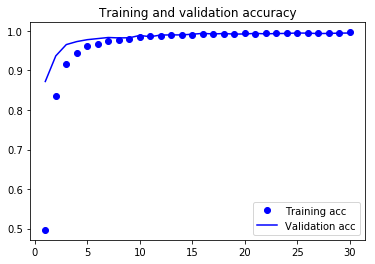

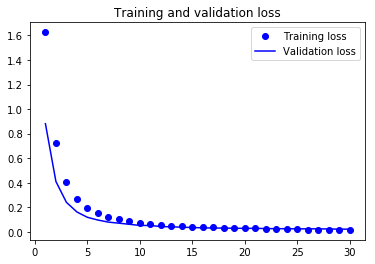

In [127]:
import matplotlib.pyplot as plt
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)
plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show();

In [128]:
#use pretrained model technique
#FAST FEATURE EXTRACTION WITH DATA AUGMENTATION
#Extracting features using the pretrained convolutional base

In [129]:
#Adding a densely connected classifier on top of the convolutional base

In [130]:
from keras import models
from keras import layers
model = models.Sequential()
model.add(conv_base)
model.add(layers.Flatten())
model.add(layers.Dense(256, activation='relu'))
model.add(layers.Dense(10, activation='softmax'))

In [131]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 4, 4, 512)         14714688  
_________________________________________________________________
flatten_1 (Flatten)          (None, 8192)              0         
_________________________________________________________________
dense_5 (Dense)              (None, 256)               2097408   
_________________________________________________________________
dense_6 (Dense)              (None, 10)                2570      
Total params: 16,814,666
Trainable params: 16,814,666
Non-trainable params: 0
_________________________________________________________________


In [132]:
#freeze convutional base

In [142]:
print('This is the number of trainable weights '
'before freezing the conv base:', len(model.trainable_weights))

This is the number of trainable weights before freezing the conv base: 4


In [143]:
conv_base.trainable = False

In [144]:
print('This is the number of trainable weights '
'after freezing the conv base:', len(model.trainable_weights))

This is the number of trainable weights after freezing the conv base: 4


In [146]:
#try with less number of images

In [147]:
train_dir="D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\imgs\\train_sample\\"
#test_dir="D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\imgs\\test\\"
validation_dir = "D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\imgs\\validation_sample\\"

In [148]:
#Training the model end to end with a frozen convolutional base

In [149]:
from keras.preprocessing.image import ImageDataGenerator
from keras import optimizers
train_datagen = ImageDataGenerator(
rescale=1./255,
rotation_range=40,
width_shift_range=0.2,
height_shift_range=0.2,
shear_range=0.2,
zoom_range=0.2,
horizontal_flip=True,
fill_mode='nearest')
test_datagen = ImageDataGenerator(rescale=1./255)

In [150]:
train_generator = train_datagen.flow_from_directory(
train_dir,
target_size=(150, 150),
batch_size=20,
class_mode='categorical')

Found 5076 images belonging to 10 classes.


In [151]:
validation_generator = test_datagen.flow_from_directory(
validation_dir,
target_size=(150, 150),
batch_size=20,
class_mode='categorical')

Found 853 images belonging to 10 classes.


In [152]:
model.compile(loss='categorical_crossentropy',
optimizer=optimizers.RMSprop(lr=2e-5),
metrics=['acc'])

In [153]:
history = model.fit_generator(
train_generator,
steps_per_epoch=100,
epochs=30,
validation_data=validation_generator,
validation_steps=50)

Epoch 1/30
100/100 [==============================] - 2003s 20s/step - loss: 1.4014 - acc: 0.5750 - val_loss: 1.0441 - val_acc: 0.7292
Epoch 2/30
100/100 [==============================] - 1993s 20s/step - loss: 1.4004 - acc: 0.5707 - val_loss: 0.9970 - val_acc: 0.7503
Epoch 3/30
100/100 [==============================] - 2096s 21s/step - loss: 1.3739 - acc: 0.5846 - val_loss: 0.9911 - val_acc: 0.7667
Epoch 4/30
100/100 [==============================] - 2047s 20s/step - loss: 1.3617 - acc: 0.5795 - val_loss: 0.9606 - val_acc: 0.7632
Epoch 5/30
100/100 [==============================] - 1974s 20s/step - loss: 1.3388 - acc: 0.5840 - val_loss: 0.9580 - val_acc: 0.7538
Epoch 6/30
100/100 [==============================] - 1998s 20s/step - loss: 1.3438 - acc: 0.5815 - val_loss: 0.9397 - val_acc: 0.7819
Epoch 7/30
100/100 [==============================] - 1988s 20s/step - loss: 1.3194 - acc: 0.5925 - val_loss: 0.9520 - val_acc: 0.7620
Epoch 8/30
100/100 [==============================] - 2

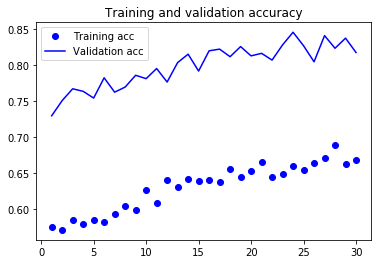

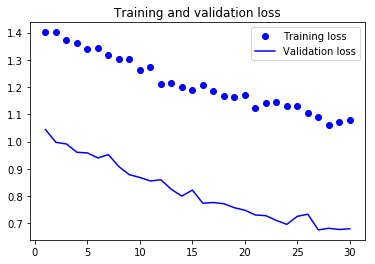

In [154]:
#display curves of loss and accuracy during training
import matplotlib.pyplot as plt
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)
plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show();

In [156]:
model_json = model.to_json()
with open("D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\pretrained_dataaug_model.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model.save_weights("D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\pretrained_dataaug_model.h5")
print("Saved model to disk")

Saved model to disk


In [157]:
#fine tuning

In [160]:
train_dir="D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\imgs\\train_sample\\"
#test_dir="D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\imgs\\test\\"
validation_dir = "D:\\datasets\\DeepLearning\\state-farm-distracted-driver-detection\\imgs\\validation_sample\\"

In [158]:
#Freezing all layers up to a specific one
conv_base.trainable = True
set_trainable = False
for layer in conv_base.layers:
    if layer.name == 'block5_conv1':
        set_trainable = True
    if set_trainable:
        layer.trainable = True
    else:
        layer.trainable = False

In [161]:
from keras.preprocessing.image import ImageDataGenerator
from keras import optimizers
train_datagen = ImageDataGenerator(
rescale=1./255,
rotation_range=40,
width_shift_range=0.2,
height_shift_range=0.2,
shear_range=0.2,
zoom_range=0.2,
horizontal_flip=True,
fill_mode='nearest')
test_datagen = ImageDataGenerator(rescale=1./255)

In [162]:
train_generator = train_datagen.flow_from_directory(
train_dir,
target_size=(150, 150),
batch_size=20,
class_mode='categorical')

Found 3102 images belonging to 10 classes.


In [163]:
model.compile(loss='categorical_crossentropy',
optimizer=optimizers.RMSprop(lr=2e-5),
metrics=['acc'])

In [164]:
model.compile(loss='categorical_crossentropy',
            optimizer=optimizers.RMSprop(lr=1e-5),
            metrics=['acc'])

In [165]:
history = model.fit_generator(
train_generator,
steps_per_epoch=100,
epochs=100,
validation_data=validation_generator,
validation_steps=50)

Epoch 1/100
100/100 [==============================] - 2222s 22s/step - loss: 0.9867 - acc: 0.6631 - val_loss: 0.4569 - val_acc: 0.8699
Epoch 2/100
100/100 [==============================] - 2363s 24s/step - loss: 0.8663 - acc: 0.7125 - val_loss: 0.4654 - val_acc: 0.8441
Epoch 3/100
100/100 [==============================] - 2356s 24s/step - loss: 0.7816 - acc: 0.7350 - val_loss: 0.3833 - val_acc: 0.8617
Epoch 4/100
100/100 [==============================] - 2346s 23s/step - loss: 0.7282 - acc: 0.7525 - val_loss: 0.3792 - val_acc: 0.8722
Epoch 5/100
100/100 [==============================] - 2367s 24s/step - loss: 0.6675 - acc: 0.7770 - val_loss: 0.3197 - val_acc: 0.8992
Epoch 6/100
100/100 [==============================] - 2350s 23s/step - loss: 0.6333 - acc: 0.7940 - val_loss: 0.3518 - val_acc: 0.8757
Epoch 7/100
100/100 [==============================] - 22534s 225s/step - loss: 0.5960 - acc: 0.7950 - val_loss: 0.2618 - val_acc: 0.9156
Epoch 8/100
100/100 [=========================

KeyboardInterrupt: 

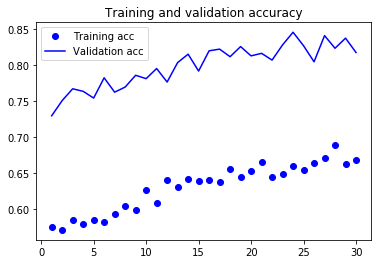

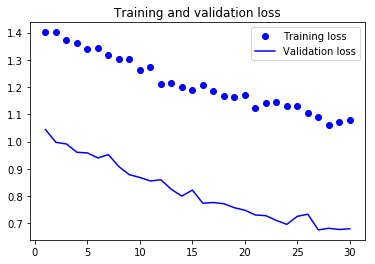

In [166]:
#display curves of loss and accuracy during training
import matplotlib.pyplot as plt
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)
plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show();